In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[9276, 3799, 2569, 5958, 8367, 5188, 1706, 8062, 5751, 5510, 8057, 4187, 8177, 8325, 5239, 832, 2119, 470, 1759, 8850]
log initialized
Average similarity between family members is 0.975552943360599 at temperature -1
Average similarity between family and home is 0.9998422750837177 at temperature -1
Average similarity between students and their classroom is 0.9657796759257604 at temperature -1
Average classroom occupancy is 1.7543859649122806 and number classrooms is 171
Average similarity between workers is 0.9595294893913712 at temperature -1
Average office occupancy is 3.5722222222222224 and number offices is 180
Average friend similarity for adults: 0.8544408875384382 for kids: 0.7562672301185351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.7059092967432075
avg restaurant similarity 0.599913453968264
avg restaurant similarity 0.6381462030123469
avg restaurant similarity 0.7073042978468167
avg restaurant similarity 0.6874426354028231
avg restaurant similarity 0.6771183884553379
avg restaurant similarity 0.6868360720775977
avg restaurant similarity 0.6539798608663372
avg restaurant similarity 0.6159521844574104
avg restaurant similarity 0.5861954203816407
avg restaurant similarity 0.7372759132012021
avg restaurant similarity 0.6213255996119317
avg restaurant similarity 0.6666411659472553
avg restaurant similarity 0.6414754620615996
avg restaurant similarity 0.673756675069175
avg restaurant similarity 0.6180112609136399
avg restaurant similarity 0.6345157925337196
avg restaurant similarity 0.6901747583429287
avg restaurant similarity 0.6518402445517311
avg restaurant similarity 0.6383036028380764
avg restaurant similarity 0.6971484033250719
avg restaurant similarity 0.6664871271795961
avg restaura

avg restaurant similarity 0.7067639975129284
avg restaurant similarity 0.6285993259390082
avg restaurant similarity 0.6459901466444873
avg restaurant similarity 0.6189849599303091
avg restaurant similarity 0.6258815747111077
avg restaurant similarity 0.657848603381234
avg restaurant similarity 0.6889590943357052
avg restaurant similarity 0.5989574791443609
avg restaurant similarity 0.6292321122943784
avg restaurant similarity 0.6410547460438534
avg restaurant similarity 0.6325036656033319
avg restaurant similarity 0.6675472710562802
avg restaurant similarity 0.6294310081877215
avg restaurant similarity 0.6742433134292714
avg restaurant similarity 0.6119784442974365
avg restaurant similarity 0.6900334170253366
avg restaurant similarity 0.7005995999514514
avg restaurant similarity 0.6324767577710331
avg restaurant similarity 0.5886272479717873
avg restaurant similarity 0.6019772333422382
avg restaurant similarity 0.6429869747164442
avg restaurant similarity 0.6337415579199583
avg restaur

Average similarity between workers is 0.9769695645865077 at temperature -1
Average office occupancy is 3.5513513513513515 and number offices is 185
Average friend similarity for adults: 0.8698337288357182 for kids: 0.7489801882086536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.6651302655818553
avg restaurant similarity 0.6873991748962571
avg restaurant similarity 0.621200673094858
avg restaurant similarity 0.6510773454129353
avg restaurant similarity 0.7054317673326747
avg restaurant similarity 0.6909235389267783
avg restaurant similarity 0.6730573230898104
avg restaurant similarity 0.7065579371452713
avg restaurant similarity 0.6643965049674349
avg restaurant similarity 0.692117552589468
avg restaurant similarity 0.6838371296544046
avg restaurant similarity 0.6771762483767971
avg restaurant similarity 0.6423802965455009
avg restaurant similarity 0.6794307224267827
avg restaurant similarity 0.6934301658569195
avg restaurant similarity 0.6691617174507731
avg restaurant similarity 0.6569978985855192
avg restaurant similarity 0.6619555941609864
avg restaurant similarity 0.6726440276946087
avg restaurant similarity 0.6415216857748306
avg restaurant similarity 0.6762711025555358
avg restaurant similarity 0.6481022816325522
avg restaura

avg restaurant similarity 0.6671309726683678
avg restaurant similarity 0.6887004960988083
avg restaurant similarity 0.6440365585522999
avg restaurant similarity 0.6893865868926491
avg restaurant similarity 0.5902501989013174
avg restaurant similarity 0.6947994854857376
avg restaurant similarity 0.647496843107098
avg restaurant similarity 0.7175483314513705
avg restaurant similarity 0.6332586564517937
avg restaurant similarity 0.6709090609056406
avg restaurant similarity 0.707927987582834
avg restaurant similarity 0.6595927019263877
avg restaurant similarity 0.6551104659703143
avg restaurant similarity 0.6485238242998007
avg restaurant similarity 0.6833518419958287
avg restaurant similarity 0.653291933554973
avg restaurant similarity 0.6968145962061533
avg restaurant similarity 0.6746728503194348
avg restaurant similarity 0.7062784345793713
avg restaurant similarity 0.6619974721003146
avg restaurant similarity 0.6520152238664731
avg restaurant similarity 0.6813386916017886
avg restauran

Average similarity between workers is 0.9539388615510177 at temperature -1
Average office occupancy is 3.5081967213114753 and number offices is 183
Average friend similarity for adults: 0.8698547552393201 for kids: 0.7476339789068754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.7046000860076932
avg restaurant similarity 0.676150397542338
avg restaurant similarity 0.6769200182764914
avg restaurant similarity 0.7194028323935492
avg restaurant similarity 0.7233438368509084
avg restaurant similarity 0.6733606826947177
avg restaurant similarity 0.644334015638344
avg restaurant similarity 0.6509330037435315
avg restaurant similarity 0.6452995695697276
avg restaurant similarity 0.6997829655891292
avg restaurant similarity 0.7274216971065834
avg restaurant similarity 0.6969186374394171
avg restaurant similarity 0.6996134166597232
avg restaurant similarity 0.7149582839797068
avg restaurant similarity 0.6286871645037071
avg restaurant similarity 0.655155425269832
avg restaurant similarity 0.7356822190136698
avg restaurant similarity 0.7139565906389421
avg restaurant similarity 0.6511213324125256
avg restaurant similarity 0.73885615857814
avg restaurant similarity 0.7070439014456457
avg restaurant similarity 0.6961084593171878
avg restaurant 

avg restaurant similarity 0.7411013357513475
avg restaurant similarity 0.7558217564882261
avg restaurant similarity 0.6720627985318902
avg restaurant similarity 0.7140783291118348
avg restaurant similarity 0.6941324690181279
avg restaurant similarity 0.7158417614664802
avg restaurant similarity 0.6672306623929205
avg restaurant similarity 0.6558820148757147
avg restaurant similarity 0.7494938297916767
avg restaurant similarity 0.7459019561787216
avg restaurant similarity 0.6910735164095592
avg restaurant similarity 0.7005633482662579
avg restaurant similarity 0.6609192268865343
avg restaurant similarity 0.6717660620026726
avg restaurant similarity 0.6816179686757645
avg restaurant similarity 0.6864313553805592
avg restaurant similarity 0.7038995428413436
avg restaurant similarity 0.7127944946158189
avg restaurant similarity 0.7203111065959793
avg restaurant similarity 0.6688395027468199
avg restaurant similarity 0.6976313955942512
avg restaurant similarity 0.6983709718116238
avg restau

Average similarity between workers is 0.9723270132261703 at temperature -1
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.8596336761279039 for kids: 0.7433585655249272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6926996291960056
avg restaurant similarity 0.6956176739718971
avg restaurant similarity 0.678534663048914
avg restaurant similarity 0.6476844422289972
avg restaurant similarity 0.7133890808290542
avg restaurant similarity 0.7221161236663632
avg restaurant similarity 0.690077542822686
avg restaurant similarity 0.6934827731715117
avg restaurant similarity 0.6591619467211178
avg restaurant similarity 0.6819780614642752
avg restaurant similarity 0.6896205515829776
avg restaurant similarity 0.6616122804757677
avg restaurant similarity 0.6917904806703542
avg restaurant similarity 0.7094495303229115
avg restaurant similarity 0.6755102429467005
avg restaurant similarity 0.7104355520576753
avg restaurant similarity 0.6916240224175404
avg restaurant similarity 0.6847292348697631
avg restaurant similarity 0.7255978000004264
avg restaurant similarity 0.6226862044911177
avg restaurant similarity 0.7387359766924164
avg restaurant similarity 0.7372200095977213
avg restaura

avg restaurant similarity 0.7142072010142944
avg restaurant similarity 0.6943449464425449
avg restaurant similarity 0.6683199641487729
avg restaurant similarity 0.6822909785059375
avg restaurant similarity 0.6756738047142664
avg restaurant similarity 0.6905119437786024
avg restaurant similarity 0.672667184725524
avg restaurant similarity 0.6907180292347346
avg restaurant similarity 0.6785159495138314
avg restaurant similarity 0.6626686092323456
avg restaurant similarity 0.6560430240376652
avg restaurant similarity 0.6677349427838492
avg restaurant similarity 0.668596104015241
avg restaurant similarity 0.6554864867344558
avg restaurant similarity 0.716845189118332
avg restaurant similarity 0.6240308258755549
avg restaurant similarity 0.6450586549433742
avg restaurant similarity 0.7059300840088008
avg restaurant similarity 0.6821510503314803
avg restaurant similarity 0.6713135132558208
avg restaurant similarity 0.7321712384809711
avg restaurant similarity 0.7241329594463262
avg restauran

Average similarity between workers is 0.9762671816654566 at temperature -1
Average office occupancy is 3.390374331550802 and number offices is 187
Average friend similarity for adults: 0.8486828814522593 for kids: 0.7400827003429944
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6583156909248143
avg restaurant similarity 0.70979324337554
avg restaurant similarity 0.7020867063823589
avg restaurant similarity 0.6711033646296481
avg restaurant similarity 0.6392924715690135
avg restaurant similarity 0.6554755636386128
avg restaurant similarity 0.674802954043044
avg restaurant similarity 0.687804866672555
avg restaurant similarity 0.6732961116794719
avg restaurant similarity 0.6605908779769777
avg restaurant similarity 0.6913766066606094
avg restaurant similarity 0.6839719160241198
avg restaurant similarity 0.7019415673787739
avg restaurant similarity 0.6792288780048812
avg restaurant similarity 0.6745518713284212
avg restaurant similarity 0.6720531834716118
avg restaurant similarity 0.6858583595409772
avg restaurant similarity 0.7061253973157077
avg restaurant similarity 0.6743120855106596
avg restaurant similarity 0.7054339071919737
avg restaurant similarity 0.6831627140376818
avg restaurant similarity 0.6611820614032227
avg restaurant

avg restaurant similarity 0.6778189460174419
avg restaurant similarity 0.6437890141951862
avg restaurant similarity 0.6729844235684427
avg restaurant similarity 0.6957062957353785
avg restaurant similarity 0.6194592720627374
avg restaurant similarity 0.6566733838611131
avg restaurant similarity 0.6324325665402668
avg restaurant similarity 0.6900160288721676
avg restaurant similarity 0.649760772764621
avg restaurant similarity 0.6435221583886971
avg restaurant similarity 0.6871935862999416
avg restaurant similarity 0.6940781868330297
avg restaurant similarity 0.7215264780427227
avg restaurant similarity 0.6587541874949987
avg restaurant similarity 0.6767833788228441
avg restaurant similarity 0.667156770848307
avg restaurant similarity 0.6996667243115189
avg restaurant similarity 0.6622153659063957
avg restaurant similarity 0.6479676960130345
avg restaurant similarity 0.6671107279619777
avg restaurant similarity 0.6668083240438771
avg restaurant similarity 0.7280652786355889
avg restaura

Average similarity between workers is 0.982815647605751 at temperature -1
Average office occupancy is 3.6519337016574585 and number offices is 181
Average friend similarity for adults: 0.8600037858654832 for kids: 0.7357911863681967
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people

avg restaurant similarity 0.5627780953174368
avg restaurant similarity 0.6324677497076037
avg restaurant similarity 0.6272004986471682
avg restaurant similarity 0.6226252556460804
avg restaurant similarity 0.559408284293707
avg restaurant similarity 0.6650639605481768
avg restaurant similarity 0.6509787910379432
avg restaurant similarity 0.62088836153169
avg restaurant similarity 0.6296020766873726
avg restaurant similarity 0.6064236316012603
avg restaurant similarity 0.6382795350808436
avg restaurant similarity 0.6314016305501703
avg restaurant similarity 0.6385654297250886
avg restaurant similarity 0.6289398889822971
avg restaurant similarity 0.664365384361678
avg restaurant similarity 0.6959443858356085
avg restaurant similarity 0.6657579059907064
avg restaurant similarity 0.6151393380692844
avg restaurant similarity 0.6410099856139277
avg restaurant similarity 0.6580317254148337
avg restaurant similarity 0.6352362397933409
avg restaurant similarity 0.6614164880237146
avg restaurant

avg restaurant similarity 0.6171975709007756
avg restaurant similarity 0.5942365118040289
avg restaurant similarity 0.6408369477929307
avg restaurant similarity 0.6435486332503434
avg restaurant similarity 0.6580622090615681
avg restaurant similarity 0.6444041482447275
avg restaurant similarity 0.6583506222014138
avg restaurant similarity 0.6638552897665726
avg restaurant similarity 0.6356277364544997
avg restaurant similarity 0.656662087557599
avg restaurant similarity 0.6323107716353524
avg restaurant similarity 0.627246844300826
avg restaurant similarity 0.5628669255342947
avg restaurant similarity 0.6560110867533177
avg restaurant similarity 0.606624527470067
avg restaurant similarity 0.6462282900641946
avg restaurant similarity 0.6124355295093009
avg restaurant similarity 0.6035191057005971
avg restaurant similarity 0.6215831514300687
avg restaurant similarity 0.6012426522414377
avg restaurant similarity 0.6175414169433734
avg restaurant similarity 0.6652723118274019
avg restauran

Average similarity between workers is 0.9749032532303975 at temperature -1
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8496869475447281 for kids: 0.7275155049029294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6625794390348113
avg restaurant similarity 0.6808132620764735
avg restaurant similarity 0.680799114484561
avg restaurant similarity 0.6511998389065178
avg restaurant similarity 0.6450147141793439
avg restaurant similarity 0.6814118293641293
avg restaurant similarity 0.6248384736077827
avg restaurant similarity 0.657296115546208
avg restaurant similarity 0.6583865499067717
avg restaurant similarity 0.6423870180005359
avg restaurant similarity 0.6471141672176248
avg restaurant similarity 0.687175428082759
avg restaurant similarity 0.7242750990397304
avg restaurant similarity 0.7277912787806113
avg restaurant similarity 0.6463259417070343
avg restaurant similarity 0.652041155628716
avg restaurant similarity 0.6452958507264391
avg restaurant similarity 0.6777527693643923
avg restaurant similarity 0.6936910411089219
avg restaurant similarity 0.6617881721066144
avg restaurant similarity 0.6660375107757622
avg restaurant similarity 0.6684341786866128
avg restaurant

avg restaurant similarity 0.6918093909249555
avg restaurant similarity 0.6760269278285715
avg restaurant similarity 0.6596900450598115
avg restaurant similarity 0.6733729480644869
avg restaurant similarity 0.6669348427650585
avg restaurant similarity 0.6729980702369296
avg restaurant similarity 0.7057821329702929
avg restaurant similarity 0.6890752017897459
avg restaurant similarity 0.6703601656725525
avg restaurant similarity 0.6504334084227676
avg restaurant similarity 0.6405550374829845
avg restaurant similarity 0.6466562228380943
avg restaurant similarity 0.6391199591144063
avg restaurant similarity 0.675053417476985
avg restaurant similarity 0.650801751672494
avg restaurant similarity 0.6790412604244391
avg restaurant similarity 0.6719189511981064
avg restaurant similarity 0.6329641772999149
avg restaurant similarity 0.6515490968421725
avg restaurant similarity 0.594638861739936
avg restaurant similarity 0.6506927387574336
avg restaurant similarity 0.6615699362981295
avg restauran

Average similarity between workers is 0.9596221037008764 at temperature -1
Average office occupancy is 3.455026455026455 and number offices is 189
Average friend similarity for adults: 0.8629237203358369 for kids: 0.7464416579729289
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 peop

avg restaurant similarity 0.7040847972950439
avg restaurant similarity 0.6373986693371732
avg restaurant similarity 0.6276310803427182
avg restaurant similarity 0.6525745130478063
avg restaurant similarity 0.7016591838941707
avg restaurant similarity 0.6709690609161906
avg restaurant similarity 0.6121257960457089
avg restaurant similarity 0.6440920875721898
avg restaurant similarity 0.6869525215920105
avg restaurant similarity 0.6459173306684957
avg restaurant similarity 0.701221781323974
avg restaurant similarity 0.6839784808521775
avg restaurant similarity 0.6111463476434831
avg restaurant similarity 0.624693446868928
avg restaurant similarity 0.6943007809246894
avg restaurant similarity 0.6976750945196116
avg restaurant similarity 0.6911853275622494
avg restaurant similarity 0.5946103550772176
avg restaurant similarity 0.6894045340210234
avg restaurant similarity 0.7125094500514145
avg restaurant similarity 0.6705852702425863
avg restaurant similarity 0.6573821385847987
avg restaura

avg restaurant similarity 0.6276827803825388
avg restaurant similarity 0.6853194799285723
avg restaurant similarity 0.6679331801672175
avg restaurant similarity 0.6786742845123568
avg restaurant similarity 0.6576552376668039
avg restaurant similarity 0.6132479231793658
avg restaurant similarity 0.7066857698346749
avg restaurant similarity 0.6690372464200719
avg restaurant similarity 0.7165676963314105
avg restaurant similarity 0.6769182843800983
avg restaurant similarity 0.6812670698659525
avg restaurant similarity 0.641352139832081
avg restaurant similarity 0.7314097162365301
avg restaurant similarity 0.672258040919314
avg restaurant similarity 0.6654275880719347
avg restaurant similarity 0.6011175466591459
avg restaurant similarity 0.6435700895625535
avg restaurant similarity 0.6912432478051402
avg restaurant similarity 0.7148047999782045
avg restaurant similarity 0.688884829044161
avg restaurant similarity 0.6907871064914917
avg restaurant similarity 0.7045117898765455
avg restauran

Average similarity between workers is 0.9656273253019884 at temperature -1
Average office occupancy is 3.5591397849462365 and number offices is 186
Average friend similarity for adults: 0.8585890412321813 for kids: 0.7416479286291595
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6872843031065566
avg restaurant similarity 0.6526587159349186
avg restaurant similarity 0.6960078053567234
avg restaurant similarity 0.6902462144973691
avg restaurant similarity 0.6925924140639976
avg restaurant similarity 0.6828335472513388
avg restaurant similarity 0.7210875421845555
avg restaurant similarity 0.6770233382115068
avg restaurant similarity 0.7026956363586012
avg restaurant similarity 0.6505433657527774
avg restaurant similarity 0.7258048626721538
avg restaurant similarity 0.6701717032721355
avg restaurant similarity 0.6933166968355434
avg restaurant similarity 0.6481437874635501
avg restaurant similarity 0.6535995951303856
avg restaurant similarity 0.6950562981908368
avg restaurant similarity 0.682645805003555
avg restaurant similarity 0.6587676373934581
avg restaurant similarity 0.6788209744097723
avg restaurant similarity 0.6616899213794762
avg restaurant similarity 0.6512619753478774
avg restaurant similarity 0.6551477738252871
avg restaur

avg restaurant similarity 0.6996429679392105
avg restaurant similarity 0.707863157481688
avg restaurant similarity 0.6699762283471515
avg restaurant similarity 0.6977141150557701
avg restaurant similarity 0.6842439351795051
avg restaurant similarity 0.688857043734955
avg restaurant similarity 0.676817444891355
avg restaurant similarity 0.6684591453341436
avg restaurant similarity 0.7339688627849104
avg restaurant similarity 0.6796811078587219
avg restaurant similarity 0.7397557973641666
avg restaurant similarity 0.6918604757912082
avg restaurant similarity 0.6857199128424823
avg restaurant similarity 0.6906766006557901
avg restaurant similarity 0.6640818201904254
avg restaurant similarity 0.6626035320373816
avg restaurant similarity 0.692991026336949
avg restaurant similarity 0.69133510434548
avg restaurant similarity 0.6492329903063722
avg restaurant similarity 0.6830499037240203
avg restaurant similarity 0.6906812617415036
avg restaurant similarity 0.7038091745344803
avg restaurant s

Average similarity between workers is 0.956803285625443 at temperature -1
Average office occupancy is 3.588235294117647 and number offices is 187
Average friend similarity for adults: 0.8645001020069167 for kids: 0.7511454573404215
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 peo

avg restaurant similarity 0.6489457249903814
avg restaurant similarity 0.7081842482916443
avg restaurant similarity 0.6549574668831534
avg restaurant similarity 0.6949979026166273
avg restaurant similarity 0.6466711953735171
avg restaurant similarity 0.6464764379909076
avg restaurant similarity 0.6546841513569813
avg restaurant similarity 0.6810356285046721
avg restaurant similarity 0.6587505992346349
avg restaurant similarity 0.6702633818512315
avg restaurant similarity 0.7136633798488436
avg restaurant similarity 0.6787083657051214
avg restaurant similarity 0.6538036583969129
avg restaurant similarity 0.624964508190091
avg restaurant similarity 0.5981709119207673
avg restaurant similarity 0.6564822639831245
avg restaurant similarity 0.6924425203672211
avg restaurant similarity 0.6758099447501233
avg restaurant similarity 0.6467211743366317
avg restaurant similarity 0.6591036978940433
avg restaurant similarity 0.6551329484759686
avg restaurant similarity 0.6320248888053093
avg restaur

avg restaurant similarity 0.6335016692105118
avg restaurant similarity 0.6471660540298003
avg restaurant similarity 0.645867110063839
avg restaurant similarity 0.6921080811040922
avg restaurant similarity 0.6163753741400813
avg restaurant similarity 0.652335741285637
avg restaurant similarity 0.6620650677217533
avg restaurant similarity 0.6599456352386032
avg restaurant similarity 0.6746929124265042
avg restaurant similarity 0.6459273211489032
avg restaurant similarity 0.6481281450580743
avg restaurant similarity 0.6217044542508654
avg restaurant similarity 0.6350185985347251
avg restaurant similarity 0.6329256698988888
avg restaurant similarity 0.634563725631734
avg restaurant similarity 0.6831741397551667
avg restaurant similarity 0.6793891078534829
avg restaurant similarity 0.631778417318079
avg restaurant similarity 0.6400855873060425
avg restaurant similarity 0.6425706289784392
avg restaurant similarity 0.6402656977554747
avg restaurant similarity 0.6668438542029655
avg restaurant

Average similarity between workers is 0.9648371934772785 at temperature -1
Average office occupancy is 3.43979057591623 and number offices is 191
Average friend similarity for adults: 0.8576049673804388 for kids: 0.7306455797290958
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6581546511700791
avg restaurant similarity 0.674490632807241
avg restaurant similarity 0.6718429450788643
avg restaurant similarity 0.6527385800808551
avg restaurant similarity 0.6403845387194222
avg restaurant similarity 0.6884877284608346
avg restaurant similarity 0.671148640657849
avg restaurant similarity 0.6605642808937037
avg restaurant similarity 0.7244844889547245
avg restaurant similarity 0.6951508115597862
avg restaurant similarity 0.6937756628356118
avg restaurant similarity 0.6709070700257279
avg restaurant similarity 0.6442660335027592
avg restaurant similarity 0.61700147898003
avg restaurant similarity 0.6845126323775813
avg restaurant similarity 0.584008510860157
avg restaurant similarity 0.6719670064788037
avg restaurant similarity 0.6955426642773199
avg restaurant similarity 0.6255341570212513
avg restaurant similarity 0.6811658221258861
avg restaurant similarity 0.6697491728278586
avg restaurant similarity 0.6691091877081485
avg restaurant 

avg restaurant similarity 0.6698187073764084
avg restaurant similarity 0.6374191892337667
avg restaurant similarity 0.6720292139428371
avg restaurant similarity 0.6624650831697564
avg restaurant similarity 0.5944414491212361
avg restaurant similarity 0.6187311207538745
avg restaurant similarity 0.6527133948053581
avg restaurant similarity 0.646218216998062
avg restaurant similarity 0.637313490346724
avg restaurant similarity 0.603584160861194
avg restaurant similarity 0.6544840716656802
avg restaurant similarity 0.6720329354940011
avg restaurant similarity 0.6568075794453244
avg restaurant similarity 0.6544744347202934
avg restaurant similarity 0.6719445604470722
avg restaurant similarity 0.6336998275000311
avg restaurant similarity 0.6397923357537094
avg restaurant similarity 0.6591233084312559
avg restaurant similarity 0.6325061855890419
avg restaurant similarity 0.6736860412172831
avg restaurant similarity 0.6664607977917592
avg restaurant similarity 0.6613427396047079
avg restauran

Average similarity between workers is 0.9649325278645197 at temperature -1
Average office occupancy is 3.4708994708994707 and number offices is 189
Average friend similarity for adults: 0.8641122471841692 for kids: 0.7546220335209103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.7044229020018808
avg restaurant similarity 0.6882154404836618
avg restaurant similarity 0.6727259054156496
avg restaurant similarity 0.7090022621035278
avg restaurant similarity 0.6979217297661757
avg restaurant similarity 0.6849087212016649
avg restaurant similarity 0.6973107264012156
avg restaurant similarity 0.724109655077956
avg restaurant similarity 0.6884860627467
avg restaurant similarity 0.6707522500838311
avg restaurant similarity 0.6847422856849841
avg restaurant similarity 0.7180402114815017
avg restaurant similarity 0.7117022633058881
avg restaurant similarity 0.6831158006720416
avg restaurant similarity 0.6930512492741164
avg restaurant similarity 0.6998686227219633
avg restaurant similarity 0.6629859786066294
avg restaurant similarity 0.6394765399773773
avg restaurant similarity 0.6929690600181488
avg restaurant similarity 0.723815651436387
avg restaurant similarity 0.6291794478431857
avg restaurant similarity 0.6979271502066202
avg restaurant 

avg restaurant similarity 0.7554915697747596
avg restaurant similarity 0.6730057752354257
avg restaurant similarity 0.6924985261921307
avg restaurant similarity 0.6694955660803023
avg restaurant similarity 0.737046236142855
avg restaurant similarity 0.672967824346527
avg restaurant similarity 0.6898015743231729
avg restaurant similarity 0.7483805637204882
avg restaurant similarity 0.70339325669479
avg restaurant similarity 0.708973821912696
avg restaurant similarity 0.6834541338104925
avg restaurant similarity 0.7040512483693355
avg restaurant similarity 0.7320134323768446
avg restaurant similarity 0.674248966429926
avg restaurant similarity 0.6679235460303066
avg restaurant similarity 0.7486447500226927
avg restaurant similarity 0.7043700519469104
avg restaurant similarity 0.6159072893614361
avg restaurant similarity 0.7073247878102158
avg restaurant similarity 0.6497963455091053
avg restaurant similarity 0.7056402916127172
avg restaurant similarity 0.7298229103405375
avg restaurant s

Average similarity between workers is 0.9690808501402801 at temperature -1
Average office occupancy is 3.6408839779005526 and number offices is 181
Average friend similarity for adults: 0.8588701308487505 for kids: 0.7388013331149351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6638571651709133
avg restaurant similarity 0.7131939432412313
avg restaurant similarity 0.6845410225295847
avg restaurant similarity 0.656126307694975
avg restaurant similarity 0.673232836056432
avg restaurant similarity 0.7175258551396794
avg restaurant similarity 0.6827424504950196
avg restaurant similarity 0.697467614934483
avg restaurant similarity 0.6617970013303668
avg restaurant similarity 0.6504590437161195
avg restaurant similarity 0.7248582786771691
avg restaurant similarity 0.6942346346486643
avg restaurant similarity 0.694282120995303
avg restaurant similarity 0.6902414909889835
avg restaurant similarity 0.6921181960154101
avg restaurant similarity 0.7073109438176438
avg restaurant similarity 0.6956284940669326
avg restaurant similarity 0.6914582158931681
avg restaurant similarity 0.7158311807432114
avg restaurant similarity 0.7061777594620483
avg restaurant similarity 0.6712667599639272
avg restaurant similarity 0.6796535212419847
avg restaurant

avg restaurant similarity 0.6894971397863553
avg restaurant similarity 0.6690052859034978
avg restaurant similarity 0.6935867591881559
avg restaurant similarity 0.6511867231380184
avg restaurant similarity 0.6886294756891111
avg restaurant similarity 0.6818974569424858
avg restaurant similarity 0.6817271598870874
avg restaurant similarity 0.6751867261920618
avg restaurant similarity 0.6889295002776258
avg restaurant similarity 0.690816260020652
avg restaurant similarity 0.6784911287498536
avg restaurant similarity 0.6671657643235872
avg restaurant similarity 0.6752003296039653
avg restaurant similarity 0.6596012108415639
avg restaurant similarity 0.6642717971176327
avg restaurant similarity 0.7007011932872081
avg restaurant similarity 0.6911983653050073
avg restaurant similarity 0.691987924082518
avg restaurant similarity 0.6928561351493407
avg restaurant similarity 0.6342528180273274
avg restaurant similarity 0.7121166015905417
avg restaurant similarity 0.7134779425943024
avg restaura

Average similarity between workers is 0.9611712716356697 at temperature -1
Average office occupancy is 3.5054945054945055 and number offices is 182
Average friend similarity for adults: 0.8475162563202763 for kids: 0.744838252902909
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people

avg restaurant similarity 0.6716578914156778
avg restaurant similarity 0.6375555422747519
avg restaurant similarity 0.6536329430667562
avg restaurant similarity 0.6366698282008958
avg restaurant similarity 0.631566958657633
avg restaurant similarity 0.6379182919779683
avg restaurant similarity 0.6603303969657032
avg restaurant similarity 0.7021819167373615
avg restaurant similarity 0.6893798682745724
avg restaurant similarity 0.6464012213791482
avg restaurant similarity 0.6406306475197336
avg restaurant similarity 0.6498283753664567
avg restaurant similarity 0.6563183571915263
avg restaurant similarity 0.6667036172715122
avg restaurant similarity 0.6663655788906379
avg restaurant similarity 0.6635421668373701
avg restaurant similarity 0.6742272108280485
avg restaurant similarity 0.6616132586640878
avg restaurant similarity 0.6560255771442925
avg restaurant similarity 0.6902683202936909
avg restaurant similarity 0.6547756682713656
avg restaurant similarity 0.6942807315804865
avg restaur

avg restaurant similarity 0.5878076649793017
avg restaurant similarity 0.6503007270940981
avg restaurant similarity 0.6727448063148351
avg restaurant similarity 0.5908444654065708
avg restaurant similarity 0.7064541825760903
avg restaurant similarity 0.6145907373461865
avg restaurant similarity 0.6818720851953277
avg restaurant similarity 0.6543662701831718
avg restaurant similarity 0.6479280592763597
avg restaurant similarity 0.6322227496366836
avg restaurant similarity 0.6241747039670802
avg restaurant similarity 0.5719767563929831
avg restaurant similarity 0.6206252784155113
avg restaurant similarity 0.638203563911955
avg restaurant similarity 0.6383002392452893
avg restaurant similarity 0.6153817194266057
avg restaurant similarity 0.6299026451487739
avg restaurant similarity 0.6227945615303693
avg restaurant similarity 0.6225373426103644
avg restaurant similarity 0.688500214951604
avg restaurant similarity 0.6749259047325133
avg restaurant similarity 0.6407907282293043
avg restaura

Average similarity between workers is 0.959599918780421 at temperature -1
Average office occupancy is 3.5597826086956523 and number offices is 184
Average friend similarity for adults: 0.8625625365348132 for kids: 0.7484127394938782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people

avg restaurant similarity 0.6480769862928886
avg restaurant similarity 0.6366131040280535
avg restaurant similarity 0.6145228878821977
avg restaurant similarity 0.6658310528556919
avg restaurant similarity 0.6047634352016636
avg restaurant similarity 0.6815183755353487
avg restaurant similarity 0.6671485592299922
avg restaurant similarity 0.5990816463307528
avg restaurant similarity 0.7036942344441974
avg restaurant similarity 0.7232924788004446
avg restaurant similarity 0.6460145734607928
avg restaurant similarity 0.6468926087530364
avg restaurant similarity 0.679125977570493
avg restaurant similarity 0.6263802586509856
avg restaurant similarity 0.680267531860288
avg restaurant similarity 0.6029810707612555
avg restaurant similarity 0.6450203145516458
avg restaurant similarity 0.6490223014482088
avg restaurant similarity 0.6450186373467669
avg restaurant similarity 0.6518259747143565
avg restaurant similarity 0.666448011939154
avg restaurant similarity 0.6973601026622738
avg restauran

avg restaurant similarity 0.6062117522772948
avg restaurant similarity 0.6657894013581638
avg restaurant similarity 0.6285311971621403
avg restaurant similarity 0.6874325701119933
avg restaurant similarity 0.6586664085573499
avg restaurant similarity 0.6692331520518955
avg restaurant similarity 0.6297481448924782
avg restaurant similarity 0.6179770730168938
avg restaurant similarity 0.6199676232746536
avg restaurant similarity 0.6013332261978188
avg restaurant similarity 0.6578012314825988
avg restaurant similarity 0.6756541397704203
avg restaurant similarity 0.6709252633388196
avg restaurant similarity 0.6473343176897904
avg restaurant similarity 0.6597573138609152
avg restaurant similarity 0.6223335056471585
avg restaurant similarity 0.6546349933538491
avg restaurant similarity 0.6683321895305109
avg restaurant similarity 0.6091035897002056
avg restaurant similarity 0.6028871372152144
avg restaurant similarity 0.650659067942313
avg restaurant similarity 0.6465482970137422
avg restaur

Average similarity between workers is 0.9502334326458716 at temperature -1
Average office occupancy is 3.4456521739130435 and number offices is 184
Average friend similarity for adults: 0.8562133578106955 for kids: 0.7465166135194006
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6337739512508624
avg restaurant similarity 0.6727483594125844
avg restaurant similarity 0.6833520093435402
avg restaurant similarity 0.659338633496998
avg restaurant similarity 0.6464928543480163
avg restaurant similarity 0.6195094339487799
avg restaurant similarity 0.645329070836473
avg restaurant similarity 0.644324607787592
avg restaurant similarity 0.5992571209020223
avg restaurant similarity 0.6435249307509288
avg restaurant similarity 0.6295844995185494
avg restaurant similarity 0.6768510042668738
avg restaurant similarity 0.6528832339365717
avg restaurant similarity 0.7248205791816622
avg restaurant similarity 0.5956289756538233
avg restaurant similarity 0.6220046166261273
avg restaurant similarity 0.6563385010994839
avg restaurant similarity 0.6092768526968998
avg restaurant similarity 0.666364751452419
avg restaurant similarity 0.6320736254336083
avg restaurant similarity 0.6587058363833012
avg restaurant similarity 0.6344434318526101
avg restaurant

avg restaurant similarity 0.671329039036684
avg restaurant similarity 0.6336013880314628
avg restaurant similarity 0.6230798893216247
avg restaurant similarity 0.6721110852468494
avg restaurant similarity 0.6419242635570692
avg restaurant similarity 0.6363136181274359
avg restaurant similarity 0.6279564410583062
avg restaurant similarity 0.6811476858405221
avg restaurant similarity 0.6216813195368657
avg restaurant similarity 0.6707660186468304
avg restaurant similarity 0.6444405767035398
avg restaurant similarity 0.6780762362465718
avg restaurant similarity 0.74475479129723
avg restaurant similarity 0.6322472804240669
avg restaurant similarity 0.6679781195603844
avg restaurant similarity 0.7024774874426847
avg restaurant similarity 0.7153038065685755
avg restaurant similarity 0.6679246782304057
avg restaurant similarity 0.7219343786886506
avg restaurant similarity 0.6959641639064951
avg restaurant similarity 0.6465715265612055
avg restaurant similarity 0.6291077985352087
avg restauran

Average similarity between workers is 0.945924910649586 at temperature -1
Average office occupancy is 3.672222222222222 and number offices is 180
Average friend similarity for adults: 0.8721709550275933 for kids: 0.7351634094091504
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.6522225461340955
avg restaurant similarity 0.6056250941223071
avg restaurant similarity 0.645962410436315
avg restaurant similarity 0.720568617991257
avg restaurant similarity 0.6684174629565869
avg restaurant similarity 0.6526484848983766
avg restaurant similarity 0.6385643716294067
avg restaurant similarity 0.6911960641666798
avg restaurant similarity 0.6555034055098188
avg restaurant similarity 0.6522401921974175
avg restaurant similarity 0.64200540431187
avg restaurant similarity 0.6153883233410196
avg restaurant similarity 0.6666728129824601
avg restaurant similarity 0.6549785056248175
avg restaurant similarity 0.6688774015837211
avg restaurant similarity 0.645740835902125
avg restaurant similarity 0.6651776998457539
avg restaurant similarity 0.7200016140717649
avg restaurant similarity 0.7071991501618861
avg restaurant similarity 0.6752234221460794
avg restaurant similarity 0.6440991817686147
avg restaurant similarity 0.6960863716059102
avg restaurant 

avg restaurant similarity 0.6329235878097943
avg restaurant similarity 0.6732436649347405
avg restaurant similarity 0.6521075610816326
avg restaurant similarity 0.6569382669862577
avg restaurant similarity 0.6549158408506313
avg restaurant similarity 0.660623132484344
avg restaurant similarity 0.6461984855107739
avg restaurant similarity 0.6282411971215511
avg restaurant similarity 0.6615567943146591
avg restaurant similarity 0.6573733028135347
avg restaurant similarity 0.6888442010937822
avg restaurant similarity 0.6267138135242463
avg restaurant similarity 0.6579111355119115
avg restaurant similarity 0.6311226387759339
avg restaurant similarity 0.6543361480653705
avg restaurant similarity 0.6890259499530332
avg restaurant similarity 0.6453615052709878
avg restaurant similarity 0.7229312425763392
avg restaurant similarity 0.5909002918860735
avg restaurant similarity 0.6524307170126846
avg restaurant similarity 0.6305938314371768
avg restaurant similarity 0.6673293987857204
avg restaur

Average similarity between workers is 0.9604854206729325 at temperature -1
Average office occupancy is 3.5789473684210527 and number offices is 190
Average friend similarity for adults: 0.8632908159729887 for kids: 0.7383687709369997
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6560472362761194
avg restaurant similarity 0.6994239606351053
avg restaurant similarity 0.6677425961123302
avg restaurant similarity 0.6638954831711364
avg restaurant similarity 0.7161687143721892
avg restaurant similarity 0.7221503850867115
avg restaurant similarity 0.6634474952222253
avg restaurant similarity 0.659393946513834
avg restaurant similarity 0.6378442653836512
avg restaurant similarity 0.6635457061452262
avg restaurant similarity 0.6749780697018308
avg restaurant similarity 0.7163325241817939
avg restaurant similarity 0.6629133662821022
avg restaurant similarity 0.7284564828514504
avg restaurant similarity 0.7030961058612563
avg restaurant similarity 0.6192619154695029
avg restaurant similarity 0.6868311521898742
avg restaurant similarity 0.6673987986139867
avg restaurant similarity 0.69024120417937
avg restaurant similarity 0.6456855242943248
avg restaurant similarity 0.7120550509418964
avg restaurant similarity 0.6972146160972207
avg restauran

avg restaurant similarity 0.7195403225675944
avg restaurant similarity 0.7031980647281265
avg restaurant similarity 0.6851668971217997
avg restaurant similarity 0.7024940991687
avg restaurant similarity 0.710595670516602
avg restaurant similarity 0.6771720832764971
avg restaurant similarity 0.6716016398642806
avg restaurant similarity 0.6759520165138229
avg restaurant similarity 0.7437660669082438
avg restaurant similarity 0.6798082846364465
avg restaurant similarity 0.7138068296317409
avg restaurant similarity 0.6753106180328239
avg restaurant similarity 0.736713203071114
avg restaurant similarity 0.7092797533728199
avg restaurant similarity 0.7287073481244347
avg restaurant similarity 0.6780789271499204
avg restaurant similarity 0.7137627852941675
avg restaurant similarity 0.7041611999588466
avg restaurant similarity 0.6833888312175561
avg restaurant similarity 0.6490212912984954
avg restaurant similarity 0.7037764805536458
avg restaurant similarity 0.6909959764601019
avg restaurant 

Average similarity between workers is 0.9652288905204285 at temperature -1
Average office occupancy is 3.597826086956522 and number offices is 184
Average friend similarity for adults: 0.8530468679256791 for kids: 0.7288703431436016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.6915529337802918
avg restaurant similarity 0.6190860827923683
avg restaurant similarity 0.6494208967862906
avg restaurant similarity 0.616935252535191
avg restaurant similarity 0.6574832485556016
avg restaurant similarity 0.6148046533776607
avg restaurant similarity 0.6627340063946009
avg restaurant similarity 0.6491203743501195
avg restaurant similarity 0.6352808332918572
avg restaurant similarity 0.6153030700421914
avg restaurant similarity 0.6581500110906207
avg restaurant similarity 0.626072833252331
avg restaurant similarity 0.6339502645403764
avg restaurant similarity 0.6005684626475195
avg restaurant similarity 0.6291715240329069
avg restaurant similarity 0.5901188744132737
avg restaurant similarity 0.6176931787386825
avg restaurant similarity 0.6397596465160459
avg restaurant similarity 0.6177663704941965
avg restaurant similarity 0.6070942936570903
avg restaurant similarity 0.6645470051548794
avg restaurant similarity 0.616024748684048
avg restauran

avg restaurant similarity 0.6126453770255631
avg restaurant similarity 0.589503177290073
avg restaurant similarity 0.610818129916174
avg restaurant similarity 0.6662473541711246
avg restaurant similarity 0.6462256602419576
avg restaurant similarity 0.63932029659653
avg restaurant similarity 0.6550895792995293
avg restaurant similarity 0.6316406792184055
avg restaurant similarity 0.6499721559587752
avg restaurant similarity 0.6171178571986087
avg restaurant similarity 0.6516717766727422
avg restaurant similarity 0.625772115787308
avg restaurant similarity 0.6634346035208233
avg restaurant similarity 0.6565333790203114
avg restaurant similarity 0.589051884391267
avg restaurant similarity 0.6198562517800185
avg restaurant similarity 0.6438959217748295
avg restaurant similarity 0.6080897149537037
avg restaurant similarity 0.5936079066301853
avg restaurant similarity 0.590545742558292
avg restaurant similarity 0.6415380692724061
avg restaurant similarity 0.6412268564405667
avg restaurant si

Average similarity between workers is 0.9694835281642094 at temperature -1
Average office occupancy is 3.2473684210526317 and number offices is 190
Average friend similarity for adults: 0.8515378040822577 for kids: 0.7492537676768679
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6793169000300416
avg restaurant similarity 0.7367760339783501
avg restaurant similarity 0.673067052351779
avg restaurant similarity 0.6811409037125497
avg restaurant similarity 0.6757524311002974
avg restaurant similarity 0.6412193692341852
avg restaurant similarity 0.6661313615607657
avg restaurant similarity 0.6739248925428821
avg restaurant similarity 0.6774101783637526
avg restaurant similarity 0.6311168618532169
avg restaurant similarity 0.6951184867490646
avg restaurant similarity 0.6955442014012237
avg restaurant similarity 0.682653598168938
avg restaurant similarity 0.6475582451044937
avg restaurant similarity 0.6390497320026031
avg restaurant similarity 0.6837737718598096
avg restaurant similarity 0.6469078666491604
avg restaurant similarity 0.6488267093901381
avg restaurant similarity 0.6796121563621856
avg restaurant similarity 0.6668692539985631
avg restaurant similarity 0.7009348608944241
avg restaurant similarity 0.6980116522379577
avg restaura

avg restaurant similarity 0.6675299999902092
avg restaurant similarity 0.6491019545552453
avg restaurant similarity 0.6504729800070941
avg restaurant similarity 0.6930556742870349
avg restaurant similarity 0.6935266132195355
avg restaurant similarity 0.6303386338162802
avg restaurant similarity 0.6722081482048772
avg restaurant similarity 0.6412491716550353
avg restaurant similarity 0.6195150093198118
avg restaurant similarity 0.6806929938719367
avg restaurant similarity 0.7047144042097582
avg restaurant similarity 0.6630112865325535
avg restaurant similarity 0.6175511787753283
avg restaurant similarity 0.6894506865817637
avg restaurant similarity 0.6652635773486939
avg restaurant similarity 0.6829702942586158
avg restaurant similarity 0.6715978755490024
avg restaurant similarity 0.663814410321991
avg restaurant similarity 0.6651768372961949
avg restaurant similarity 0.6819207915713006
avg restaurant similarity 0.7093742335364498
avg restaurant similarity 0.7305803851168979
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

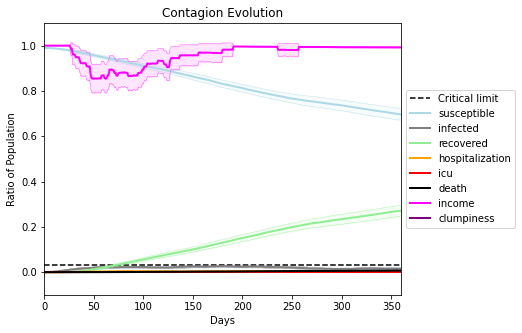

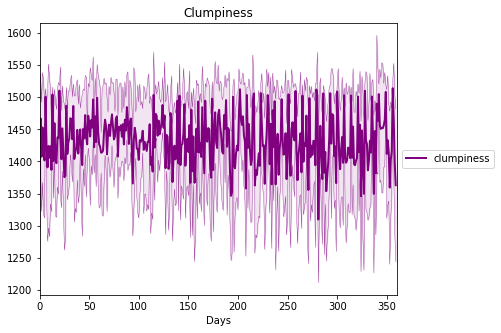

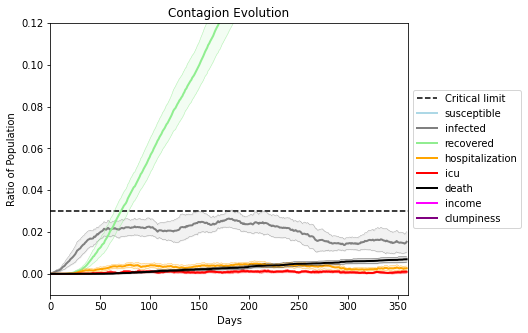

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8170, 7946, 6130, 8674, 1792, 5970, 385, 7961, 1595, 1492, 6893, 5019, 5906, 2800, 9214, 5101, 7547, 1506, 5804, 2031]
Average similarity between family members is 0.9718341653692518 at temperature -0.999
Average similarity between family and home is 0.9998425452981441 at temperature -1
Average similarity between students and their classroom is 0.9582961217307858 at temperature -0.999
Average classroom occupancy is 1.7341772151898733 and number classrooms is 158
Average similarity between workers is 0.9690518550336837 at temperature -0.999
Average office occupancy is 3.718232044198895 and number offices is 181
Average friend similarity for adults: 0.8577459735122516 for kids: 0.7265968739532418
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6940561238135099
avg restaurant similarity 0.6907330853309199
avg restaurant similarity 0.6663083845778109
avg restaurant similarity 0.6988300034037457
avg restaurant similarity 0.6854132569349709
avg restaurant similarity 0.663373452006201
avg restaurant similarity 0.6783324096076615
avg restaurant similarity 0.6479110536226508
avg restaurant similarity 0.6770222266719049
avg restaurant similarity 0.6921394545037624
avg restaurant similarity 0.6637834212053165
avg restaurant similarity 0.7290081627617377
avg restaurant similarity 0.6345903127068799
avg restaurant similarity 0.6720369284651354
avg restaurant similarity 0.6609584496659974
avg restaurant similarity 0.6738373842020307
avg restaurant similarity 0.6679154476100988
avg restaurant similarity 0.6765291598610316
avg restaurant similarity 0.716359106381185
avg restaurant similarity 0.6916597563941878
avg restaurant similarity 0.6767875441050623
avg restaurant similarity 0.6856855505683056
avg restaura

avg restaurant similarity 0.6787087725866737
avg restaurant similarity 0.6519521623474043
avg restaurant similarity 0.6473875178035308
avg restaurant similarity 0.6583097835865601
avg restaurant similarity 0.6909461581761531
avg restaurant similarity 0.675116697633346
avg restaurant similarity 0.649739107314402
avg restaurant similarity 0.6733347595696084
avg restaurant similarity 0.7138103670565903
avg restaurant similarity 0.6665615200168289
avg restaurant similarity 0.6848571950292394
avg restaurant similarity 0.6343921573461299
avg restaurant similarity 0.6567992494129208
avg restaurant similarity 0.6394581837631195
avg restaurant similarity 0.6870052021916279
avg restaurant similarity 0.7035008999126572
avg restaurant similarity 0.7017471738768364
avg restaurant similarity 0.7064146853417564
avg restaurant similarity 0.7066114701226731
avg restaurant similarity 0.6667930978238247
avg restaurant similarity 0.6819277031976055
avg restaurant similarity 0.6799653023558694
avg restaura

Average similarity between workers is 0.9558232148005279 at temperature -0.999
Average office occupancy is 3.8181818181818183 and number offices is 176
Average friend similarity for adults: 0.8607972139308104 for kids: 0.7430353995405573
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6539035377334956
avg restaurant similarity 0.6413765766860932
avg restaurant similarity 0.6596155994880422
avg restaurant similarity 0.6783497551073071
avg restaurant similarity 0.6418226748477522
avg restaurant similarity 0.6742230944393713
avg restaurant similarity 0.6837672524502286
avg restaurant similarity 0.6659566566368419
avg restaurant similarity 0.6537494220355206
avg restaurant similarity 0.6254908241100412
avg restaurant similarity 0.6912271501219172
avg restaurant similarity 0.6598278530130532
avg restaurant similarity 0.6809072699346063
avg restaurant similarity 0.7037091314703722
avg restaurant similarity 0.65580864774196
avg restaurant similarity 0.6706680608357617
avg restaurant similarity 0.6312664657852164
avg restaurant similarity 0.6715495126166606
avg restaurant similarity 0.6838676729718159
avg restaurant similarity 0.6526119707695852
avg restaurant similarity 0.6309397261463687
avg restaurant similarity 0.6779883268079364
avg restaura

avg restaurant similarity 0.6345418874998073
avg restaurant similarity 0.6635374141918373
avg restaurant similarity 0.6611225312859031
avg restaurant similarity 0.672295948474504
avg restaurant similarity 0.6756988768688568
avg restaurant similarity 0.6537599474578478
avg restaurant similarity 0.667677284402999
avg restaurant similarity 0.6788419788920822
avg restaurant similarity 0.6878271165810547
avg restaurant similarity 0.6794672660422056
avg restaurant similarity 0.6492117527343378
avg restaurant similarity 0.6226101764004571
avg restaurant similarity 0.6341227287437179
avg restaurant similarity 0.6519081446651299
avg restaurant similarity 0.6297978905361709
avg restaurant similarity 0.6711864980015236
avg restaurant similarity 0.6708670513957731
avg restaurant similarity 0.6880459291122113
avg restaurant similarity 0.6408440005990904
avg restaurant similarity 0.642307780336772
avg restaurant similarity 0.6501831444040582
avg restaurant similarity 0.6126463335072561
avg restauran

Average similarity between workers is 0.9718834390145903 at temperature -0.999
Average office occupancy is 3.489247311827957 and number offices is 186
Average friend similarity for adults: 0.8625439650284785 for kids: 0.7434033529319964
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.6900679452585402
avg restaurant similarity 0.7079697434671711
avg restaurant similarity 0.708308432321235
avg restaurant similarity 0.678370235826277
avg restaurant similarity 0.6888363019135904
avg restaurant similarity 0.660862267713559
avg restaurant similarity 0.6703378081599105
avg restaurant similarity 0.7217158424142294
avg restaurant similarity 0.6862229858920355
avg restaurant similarity 0.6982513040066269
avg restaurant similarity 0.7004217117873957
avg restaurant similarity 0.6651924788818161
avg restaurant similarity 0.6660573794291449
avg restaurant similarity 0.6958644497273933
avg restaurant similarity 0.7111274573429787
avg restaurant similarity 0.6760433243383973
avg restaurant similarity 0.6964282468401085
avg restaurant similarity 0.7394005635616239
avg restaurant similarity 0.7211075759898744
avg restaurant similarity 0.6660167314612035
avg restaurant similarity 0.7147395282774548
avg restaurant similarity 0.6670951797402573
avg restauran

avg restaurant similarity 0.7154668358014118
avg restaurant similarity 0.6860514479735134
avg restaurant similarity 0.6592683163759442
avg restaurant similarity 0.6982473819048163
avg restaurant similarity 0.7068530633053428
avg restaurant similarity 0.6927513535092652
avg restaurant similarity 0.6803460443592605
avg restaurant similarity 0.7178363430550728
avg restaurant similarity 0.6926741517887363
avg restaurant similarity 0.6845790634083782
avg restaurant similarity 0.7047782966218207
avg restaurant similarity 0.6581275809791104
avg restaurant similarity 0.7013745213183605
avg restaurant similarity 0.7067391215878648
avg restaurant similarity 0.6561179068480515
avg restaurant similarity 0.6980806141045082
avg restaurant similarity 0.6516651031989686
avg restaurant similarity 0.6695994413671664
avg restaurant similarity 0.6655990619789413
avg restaurant similarity 0.7039560421711839
avg restaurant similarity 0.6953575269878276
avg restaurant similarity 0.6831867921563725
avg restau

Average similarity between workers is 0.9693276458284227 at temperature -0.999
Average office occupancy is 3.4479166666666665 and number offices is 192
Average friend similarity for adults: 0.8619030892256717 for kids: 0.7252353602580953
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6183976328206549
avg restaurant similarity 0.5894716672871166
avg restaurant similarity 0.6088198765914795
avg restaurant similarity 0.6487476160915472
avg restaurant similarity 0.6413109107779175
avg restaurant similarity 0.6237002609969032
avg restaurant similarity 0.6435949239829972
avg restaurant similarity 0.6417641386993164
avg restaurant similarity 0.6135744791481224
avg restaurant similarity 0.6476894716482685
avg restaurant similarity 0.6478318488586249
avg restaurant similarity 0.6236032471479371
avg restaurant similarity 0.6055263489409198
avg restaurant similarity 0.6405903282819445
avg restaurant similarity 0.6286968816351888
avg restaurant similarity 0.6116691867775965
avg restaurant similarity 0.6595260139583016
avg restaurant similarity 0.6306780352170213
avg restaurant similarity 0.6327266597244963
avg restaurant similarity 0.6690834606362248
avg restaurant similarity 0.6003741128027832
avg restaurant similarity 0.6340841945737579
avg restau

avg restaurant similarity 0.6516885148530736
avg restaurant similarity 0.654217990709476
avg restaurant similarity 0.5699546240566502
avg restaurant similarity 0.6512019710366893
avg restaurant similarity 0.6378079455168364
avg restaurant similarity 0.6237394306194796
avg restaurant similarity 0.6286934116091041
avg restaurant similarity 0.6024146238484904
avg restaurant similarity 0.5392361009801769
avg restaurant similarity 0.598009677924255
avg restaurant similarity 0.6217056063479619
avg restaurant similarity 0.6306638083130872
avg restaurant similarity 0.6583391552178303
avg restaurant similarity 0.6520737124220108
avg restaurant similarity 0.5996416213249648
avg restaurant similarity 0.6347477218859654
avg restaurant similarity 0.6539785637632897
avg restaurant similarity 0.6297766504136111
avg restaurant similarity 0.6410582716810816
avg restaurant similarity 0.5753839899806908
avg restaurant similarity 0.6506555835844061
avg restaurant similarity 0.6093044153380447
avg restaura

Average similarity between workers is 0.9677470627666819 at temperature -0.999
Average office occupancy is 3.75 and number offices is 184
Average friend similarity for adults: 0.8619960960522796 for kids: 0.7228955657616194
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allo

avg restaurant similarity 0.6551076630445876
avg restaurant similarity 0.7061271818470332
avg restaurant similarity 0.6295765543674404
avg restaurant similarity 0.6336332220151697
avg restaurant similarity 0.6548004424215659
avg restaurant similarity 0.6753918729313693
avg restaurant similarity 0.6752610372831778
avg restaurant similarity 0.62710432112956
avg restaurant similarity 0.6159651443723742
avg restaurant similarity 0.6151452746587797
avg restaurant similarity 0.666497690513537
avg restaurant similarity 0.7161307713626425
avg restaurant similarity 0.6489433497871644
avg restaurant similarity 0.6144423575885706
avg restaurant similarity 0.6555976721165024
avg restaurant similarity 0.6927729192820031
avg restaurant similarity 0.6257397426127371
avg restaurant similarity 0.6357443230996616
avg restaurant similarity 0.6894953281972394
avg restaurant similarity 0.6756623942878538
avg restaurant similarity 0.656472075109431
avg restaurant similarity 0.68113441718089
avg restaurant s

avg restaurant similarity 0.6821548412895091
avg restaurant similarity 0.6193246328067277
avg restaurant similarity 0.6371701319321562
avg restaurant similarity 0.6759413795718859
avg restaurant similarity 0.6548579210989853
avg restaurant similarity 0.6251001602585767
avg restaurant similarity 0.6547578070929925
avg restaurant similarity 0.6036531636692417
avg restaurant similarity 0.6389735001691551
avg restaurant similarity 0.7096195807017923
avg restaurant similarity 0.6956168514523199
avg restaurant similarity 0.6554588544471827
avg restaurant similarity 0.6822032873678869
avg restaurant similarity 0.6407594146663403
avg restaurant similarity 0.6727913885329553
avg restaurant similarity 0.6179842380581132
avg restaurant similarity 0.5798923277793229
avg restaurant similarity 0.6587287323197835
avg restaurant similarity 0.6870700695265051
avg restaurant similarity 0.6905014976740216
avg restaurant similarity 0.6382859853791575
avg restaurant similarity 0.6497354936469654
avg restau

Average similarity between workers is 0.9657582048484342 at temperature -0.999
Average office occupancy is 3.5714285714285716 and number offices is 182
Average friend similarity for adults: 0.8549464062822355 for kids: 0.7476662674731901
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6598442472959777
avg restaurant similarity 0.6320083640652532
avg restaurant similarity 0.6729944493675892
avg restaurant similarity 0.7285378936338165
avg restaurant similarity 0.7142953226644793
avg restaurant similarity 0.6598495375554493
avg restaurant similarity 0.6799451075480674
avg restaurant similarity 0.6780661183801105
avg restaurant similarity 0.7666289147189231
avg restaurant similarity 0.7478470620195939
avg restaurant similarity 0.6788460259013478
avg restaurant similarity 0.7043559625755501
avg restaurant similarity 0.6134624986838219
avg restaurant similarity 0.6686393079765092
avg restaurant similarity 0.720403151602909
avg restaurant similarity 0.6826008258960401
avg restaurant similarity 0.7000252336544475
avg restaurant similarity 0.7369773443424582
avg restaurant similarity 0.7056979098639735
avg restaurant similarity 0.685188155479918
avg restaurant similarity 0.687193427122094
avg restaurant similarity 0.7665517514254331
avg restauran

avg restaurant similarity 0.6979966519362247
avg restaurant similarity 0.6437083277909288
avg restaurant similarity 0.6742413485738085
avg restaurant similarity 0.715457912840144
avg restaurant similarity 0.6731225313987689
avg restaurant similarity 0.7009925629991626
avg restaurant similarity 0.6722378038270144
avg restaurant similarity 0.6971846109578419
avg restaurant similarity 0.644882167113741
avg restaurant similarity 0.6999501477828562
avg restaurant similarity 0.7242376121502911
avg restaurant similarity 0.7324832343188579
avg restaurant similarity 0.6995096418082585
avg restaurant similarity 0.6345550250158059
avg restaurant similarity 0.7186376156997251
avg restaurant similarity 0.6814395021771295
avg restaurant similarity 0.6845474360864682
avg restaurant similarity 0.72703676974444
avg restaurant similarity 0.6873763855199242
avg restaurant similarity 0.6297054549281128
avg restaurant similarity 0.6816379905027657
avg restaurant similarity 0.6666607017975273
avg restaurant

Average similarity between workers is 0.9740467057825871 at temperature -0.999
Average office occupancy is 3.708108108108108 and number offices is 185
Average friend similarity for adults: 0.8742493566591324 for kids: 0.731590435388874
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.7145538184791496
avg restaurant similarity 0.6854859484269429
avg restaurant similarity 0.693364510397897
avg restaurant similarity 0.7217927646196766
avg restaurant similarity 0.7080912602991576
avg restaurant similarity 0.71720668509537
avg restaurant similarity 0.7113437505706474
avg restaurant similarity 0.6905884587674395
avg restaurant similarity 0.7062839952117828
avg restaurant similarity 0.6691958004421642
avg restaurant similarity 0.690297847170293
avg restaurant similarity 0.7208658157464468
avg restaurant similarity 0.7103201913038826
avg restaurant similarity 0.7163306235343142
avg restaurant similarity 0.701948672559439
avg restaurant similarity 0.6909807089901127
avg restaurant similarity 0.7220710538443303
avg restaurant similarity 0.7204407097952671
avg restaurant similarity 0.7116690830827715
avg restaurant similarity 0.7025064943101025
avg restaurant similarity 0.664252416816876
avg restaurant similarity 0.7048943281530754
avg restaurant s

avg restaurant similarity 0.7136541505744577
avg restaurant similarity 0.6776310417730037
avg restaurant similarity 0.7282942239859519
avg restaurant similarity 0.7305744498293522
avg restaurant similarity 0.7077064385014806
avg restaurant similarity 0.7227037638451285
avg restaurant similarity 0.6943999367672499
avg restaurant similarity 0.7142946000017629
avg restaurant similarity 0.677988852516965
avg restaurant similarity 0.7245761825722621
avg restaurant similarity 0.7275039116710446
avg restaurant similarity 0.707480035310917
avg restaurant similarity 0.7109487456032892
avg restaurant similarity 0.685265763189747
avg restaurant similarity 0.7363673264888908
avg restaurant similarity 0.669585011633179
avg restaurant similarity 0.7492068830728417
avg restaurant similarity 0.7421112190086315
avg restaurant similarity 0.7061890934392347
avg restaurant similarity 0.6615431283565335
avg restaurant similarity 0.734189724568654
avg restaurant similarity 0.7271119238023435
avg restaurant 

Average similarity between workers is 0.9798148989571589 at temperature -0.999
Average office occupancy is 3.5454545454545454 and number offices is 187
Average friend similarity for adults: 0.8595042331526752 for kids: 0.731915300929699
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.6566428460384107
avg restaurant similarity 0.6820437135089106
avg restaurant similarity 0.6513039607801516
avg restaurant similarity 0.6471647657879348
avg restaurant similarity 0.6475925295799733
avg restaurant similarity 0.5991441762085146
avg restaurant similarity 0.6448214685475214
avg restaurant similarity 0.6746997095773838
avg restaurant similarity 0.6500016847110052
avg restaurant similarity 0.6122120857131952
avg restaurant similarity 0.6885973561625479
avg restaurant similarity 0.6256735748273402
avg restaurant similarity 0.6534316397510315
avg restaurant similarity 0.6507637889608376
avg restaurant similarity 0.6262611115152432
avg restaurant similarity 0.6659449528353434
avg restaurant similarity 0.6459582961141397
avg restaurant similarity 0.6363388004118755
avg restaurant similarity 0.6854635433151186
avg restaurant similarity 0.6545171315077972
avg restaurant similarity 0.6612482468550787
avg restaurant similarity 0.6932208600560944
avg restau

avg restaurant similarity 0.6609953224769468
avg restaurant similarity 0.6672445763594361
avg restaurant similarity 0.6453912229312949
avg restaurant similarity 0.6742157322409572
avg restaurant similarity 0.6612602045744087
avg restaurant similarity 0.6614806929734591
avg restaurant similarity 0.6262799236078844
avg restaurant similarity 0.6076250550457388
avg restaurant similarity 0.6586049080866592
avg restaurant similarity 0.6212728072936982
avg restaurant similarity 0.6611529588578815
avg restaurant similarity 0.6810355698070443
avg restaurant similarity 0.639668010184266
avg restaurant similarity 0.6145320314645198
avg restaurant similarity 0.7090545794159129
avg restaurant similarity 0.6377467681312665
avg restaurant similarity 0.6539649188326191
avg restaurant similarity 0.671050081129132
avg restaurant similarity 0.6409147398816872
avg restaurant similarity 0.7168736826574126
avg restaurant similarity 0.6410883666398252
avg restaurant similarity 0.6505936070308912
avg restaura

Average similarity between workers is 0.9711377468665763 at temperature -0.999
Average office occupancy is 3.50531914893617 and number offices is 188
Average friend similarity for adults: 0.8558833207457701 for kids: 0.7398445208205746
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6651801816540852
avg restaurant similarity 0.6950678049223058
avg restaurant similarity 0.6727717707707844
avg restaurant similarity 0.6770656203829651
avg restaurant similarity 0.6374247105485974
avg restaurant similarity 0.7032128993774698
avg restaurant similarity 0.6127822679735447
avg restaurant similarity 0.6186638558528611
avg restaurant similarity 0.6244020050892437
avg restaurant similarity 0.6885072581120105
avg restaurant similarity 0.6923231612550221
avg restaurant similarity 0.6550179691331
avg restaurant similarity 0.654431504384299
avg restaurant similarity 0.6735684574190356
avg restaurant similarity 0.6974130076438859
avg restaurant similarity 0.6660110321708168
avg restaurant similarity 0.6048597703546422
avg restaurant similarity 0.6106462845361301
avg restaurant similarity 0.6568170300224223
avg restaurant similarity 0.663304940062387
avg restaurant similarity 0.651410359492142
avg restaurant similarity 0.6018684124273065
avg restaurant s

avg restaurant similarity 0.6965971449434039
avg restaurant similarity 0.6690728553725707
avg restaurant similarity 0.6602902084123494
avg restaurant similarity 0.644810503255612
avg restaurant similarity 0.6343044998048568
avg restaurant similarity 0.6209062092666698
avg restaurant similarity 0.6587613229321689
avg restaurant similarity 0.5989378513529456
avg restaurant similarity 0.6454633070820786
avg restaurant similarity 0.653365763609519
avg restaurant similarity 0.6273294502977372
avg restaurant similarity 0.6618820379796373
avg restaurant similarity 0.6763891738654259
avg restaurant similarity 0.619853531342863
avg restaurant similarity 0.6701189587014704
avg restaurant similarity 0.6585122440119554
avg restaurant similarity 0.6958418979971951
avg restaurant similarity 0.6804685991317357
avg restaurant similarity 0.650643512878395
avg restaurant similarity 0.6376563813725054
avg restaurant similarity 0.7165606362534092
avg restaurant similarity 0.6164531023755477
avg restaurant

Average similarity between workers is 0.9646461949103637 at temperature -0.999
Average office occupancy is 3.5245901639344264 and number offices is 183
Average friend similarity for adults: 0.8606358626078825 for kids: 0.7425797267643562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6726155479956425
avg restaurant similarity 0.6135755587137743
avg restaurant similarity 0.6503397677977016
avg restaurant similarity 0.6598319588594261
avg restaurant similarity 0.6739976119658239
avg restaurant similarity 0.664659751936464
avg restaurant similarity 0.6898785041113644
avg restaurant similarity 0.7370180748175471
avg restaurant similarity 0.6573298170978094
avg restaurant similarity 0.6576551335033278
avg restaurant similarity 0.6060908857673465
avg restaurant similarity 0.6415723733006643
avg restaurant similarity 0.6720965699781598
avg restaurant similarity 0.6256753234190741
avg restaurant similarity 0.7092484531807863
avg restaurant similarity 0.66818746827495
avg restaurant similarity 0.6569557492839063
avg restaurant similarity 0.6885935437168611
avg restaurant similarity 0.6187871640674336
avg restaurant similarity 0.650192481789789
avg restaurant similarity 0.6807437317395124
avg restaurant similarity 0.6889487498350483
avg restaurant

avg restaurant similarity 0.6986751342464274
avg restaurant similarity 0.6420881789905912
avg restaurant similarity 0.6555890446382708
avg restaurant similarity 0.6782080074610048
avg restaurant similarity 0.6213383699898702
avg restaurant similarity 0.6666327303021459
avg restaurant similarity 0.6787724626572367
avg restaurant similarity 0.6586225492747002
avg restaurant similarity 0.6834255307191286
avg restaurant similarity 0.6832371691204968
avg restaurant similarity 0.6285069436377078
avg restaurant similarity 0.690271004536723
avg restaurant similarity 0.6659336416194477
avg restaurant similarity 0.6742211371274682
avg restaurant similarity 0.6282330447560686
avg restaurant similarity 0.6710335546651912
avg restaurant similarity 0.6043621120535887
avg restaurant similarity 0.6588774756399144
avg restaurant similarity 0.662717040154459
avg restaurant similarity 0.65796392630508
avg restaurant similarity 0.6096665865130527
avg restaurant similarity 0.6687342536777194
avg restaurant

Average similarity between workers is 0.962290033290795 at temperature -0.999
Average office occupancy is 3.591160220994475 and number offices is 181
Average friend similarity for adults: 0.8659162223620779 for kids: 0.7546513213550567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6584751192429675
avg restaurant similarity 0.6666326224415465
avg restaurant similarity 0.7053524011659563
avg restaurant similarity 0.6778066408218356
avg restaurant similarity 0.7001290840745961
avg restaurant similarity 0.6732077789685263
avg restaurant similarity 0.7331391054686149
avg restaurant similarity 0.6428466558575694
avg restaurant similarity 0.7146613447176343
avg restaurant similarity 0.6742876659410355
avg restaurant similarity 0.7090531240862805
avg restaurant similarity 0.7049567735687133
avg restaurant similarity 0.7148398423313079
avg restaurant similarity 0.697335295642692
avg restaurant similarity 0.7008184670339068
avg restaurant similarity 0.6560249207984153
avg restaurant similarity 0.7214808293859323
avg restaurant similarity 0.633036233974544
avg restaurant similarity 0.6501158485241141
avg restaurant similarity 0.6839967485237659
avg restaurant similarity 0.7144620132755706
avg restaurant similarity 0.7154955065631095
avg restaura

avg restaurant similarity 0.6786824560424807
avg restaurant similarity 0.676541429292557
avg restaurant similarity 0.692178212398635
avg restaurant similarity 0.665415332678499
avg restaurant similarity 0.6806913277322624
avg restaurant similarity 0.7172962502865007
avg restaurant similarity 0.6807294469446313
avg restaurant similarity 0.6687429432871201
avg restaurant similarity 0.6934471456503434
avg restaurant similarity 0.6819715587483965
avg restaurant similarity 0.7171396568723203
avg restaurant similarity 0.7271176231914159
avg restaurant similarity 0.6634181337122039
avg restaurant similarity 0.7438887058694331
avg restaurant similarity 0.7188170793527382
avg restaurant similarity 0.6541143469312687
avg restaurant similarity 0.6672382507224667
avg restaurant similarity 0.6820150513251463
avg restaurant similarity 0.6601524759816667
avg restaurant similarity 0.6710445019055304
avg restaurant similarity 0.6563776382904728
avg restaurant similarity 0.6544290247195133
avg restauran

Average similarity between workers is 0.972285994365469 at temperature -0.999
Average office occupancy is 3.613756613756614 and number offices is 189
Average friend similarity for adults: 0.8676167004820763 for kids: 0.743369214969844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6063827548691468
avg restaurant similarity 0.6349435806788841
avg restaurant similarity 0.6060730053660189
avg restaurant similarity 0.6207518493863914
avg restaurant similarity 0.6047648150480867
avg restaurant similarity 0.633920728661748
avg restaurant similarity 0.6280171933912284
avg restaurant similarity 0.6471464675126873
avg restaurant similarity 0.629342538009994
avg restaurant similarity 0.6178409611672002
avg restaurant similarity 0.6384428376982594
avg restaurant similarity 0.6075530208286553
avg restaurant similarity 0.609135746439526
avg restaurant similarity 0.6661785016709955
avg restaurant similarity 0.6244737543927458
avg restaurant similarity 0.6359619902761343
avg restaurant similarity 0.6562284990572715
avg restaurant similarity 0.6661348881451606
avg restaurant similarity 0.67623528630998
avg restaurant similarity 0.6485290180859452
avg restaurant similarity 0.645359109201636
avg restaurant similarity 0.6422538779387574
avg restaurant s

avg restaurant similarity 0.6541007212948262
avg restaurant similarity 0.6601886802000202
avg restaurant similarity 0.5959082128928643
avg restaurant similarity 0.633976958155758
avg restaurant similarity 0.6440781451980656
avg restaurant similarity 0.6626161125404032
avg restaurant similarity 0.6347876732430594
avg restaurant similarity 0.6820411665180321
avg restaurant similarity 0.6533896937053059
avg restaurant similarity 0.6310113597734182
avg restaurant similarity 0.6107813424878
avg restaurant similarity 0.6357442884707936
avg restaurant similarity 0.6257093887836376
avg restaurant similarity 0.6273642284570786
avg restaurant similarity 0.6240791239545647
avg restaurant similarity 0.6567652879462266
avg restaurant similarity 0.6609238972083228
avg restaurant similarity 0.6535349528256597
avg restaurant similarity 0.6193564306190111
avg restaurant similarity 0.6070866035519527
avg restaurant similarity 0.6298597142149863
avg restaurant similarity 0.657789752499916
avg restaurant 

Average similarity between workers is 0.9700549290735891 at temperature -0.999
Average office occupancy is 3.5355191256830603 and number offices is 183
Average friend similarity for adults: 0.8467714145312749 for kids: 0.7347263663044664
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.6874093972445178
avg restaurant similarity 0.666084440563565
avg restaurant similarity 0.7129514881630039
avg restaurant similarity 0.6440482987259147
avg restaurant similarity 0.6551211384941017
avg restaurant similarity 0.6913349122461474
avg restaurant similarity 0.6748008148772326
avg restaurant similarity 0.663564087910928
avg restaurant similarity 0.6761583677569533
avg restaurant similarity 0.6698221076576458
avg restaurant similarity 0.6631300888562567
avg restaurant similarity 0.6761011801917529
avg restaurant similarity 0.6983313840552758
avg restaurant similarity 0.6894015474464972
avg restaurant similarity 0.6364314765740975
avg restaurant similarity 0.68053480902543
avg restaurant similarity 0.6755715037826291
avg restaurant similarity 0.6593165533484858
avg restaurant similarity 0.6808334933374056
avg restaurant similarity 0.6298189342746451
avg restaurant similarity 0.6833929166144718
avg restaurant similarity 0.6402236368582499
avg restaurant

avg restaurant similarity 0.6723259394487902
avg restaurant similarity 0.6575282007737405
avg restaurant similarity 0.696934556463539
avg restaurant similarity 0.6788357662511458
avg restaurant similarity 0.6672536165843506
avg restaurant similarity 0.6382788335937344
avg restaurant similarity 0.6146553635242689
avg restaurant similarity 0.6321033207140707
avg restaurant similarity 0.6901673108536832
avg restaurant similarity 0.7020328279155522
avg restaurant similarity 0.670667701115944
avg restaurant similarity 0.721524577858762
avg restaurant similarity 0.6895083309296453
avg restaurant similarity 0.6518123056167767
avg restaurant similarity 0.6726195574587631
avg restaurant similarity 0.6043884051834283
avg restaurant similarity 0.6885079887301734
avg restaurant similarity 0.6610015348420909
avg restaurant similarity 0.6617542488360698
avg restaurant similarity 0.6603327095626763
avg restaurant similarity 0.6636725182474614
avg restaurant similarity 0.676003837919931
avg restaurant

Average friend similarity for adults: 0.8559861387485223 for kids: 0.7556015749031696
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.6758518024702677
avg restaurant similarity 0.6327493156953233
avg restaurant similarity 0.6759403002740256
avg restaurant similarity 0.7365358195313885
avg restaurant similarity 0.7318476788023971
avg restaurant similarity 0.6972840350541316
avg restaurant similarity 0.7207546041402706
avg restaurant similarity 0.7168036018202374
avg restaurant similarity 0.7422414243083881
avg restaurant similarity 0.6307953335974618
avg restaurant similarity 0.71099100503438
avg restaurant similarity 0.7822966581362751
avg restaurant similarity 0.6816878309176607
avg restaurant similarity 0.6949765863307754
avg restaurant similarity 0.6708981157752053
avg restaurant similarity 0.7149423663031103
avg restaurant similarity 0.706375441777928
avg restaurant similarity 0.6467719587791294
avg restaurant similarity 0.665109768869226
avg restaurant similarity 0.6936149342934143
avg restaurant similarity 0.6594350477424092
avg restaurant similarity 0.6910601034556372
avg restaurant

avg restaurant similarity 0.6998112093462744
avg restaurant similarity 0.6576992358600151
avg restaurant similarity 0.677967196326435
avg restaurant similarity 0.7003539282133671
avg restaurant similarity 0.7089367890303804
avg restaurant similarity 0.6568608336347265
avg restaurant similarity 0.7063682145624416
avg restaurant similarity 0.7488959332560632
avg restaurant similarity 0.6891260047567859
avg restaurant similarity 0.6993861412502589
avg restaurant similarity 0.7072868215844751
avg restaurant similarity 0.6939575479815386
avg restaurant similarity 0.6904588451655131
avg restaurant similarity 0.6975155093664112
avg restaurant similarity 0.7190706248007062
avg restaurant similarity 0.6646866423304407
avg restaurant similarity 0.6244487731619721
avg restaurant similarity 0.7116704505491802
avg restaurant similarity 0.6863251934421949
avg restaurant similarity 0.6830623873727416
avg restaurant similarity 0.7207904243277965
avg restaurant similarity 0.724602904116926
avg restaura

Average similarity between workers is 0.9705840945234208 at temperature -0.999
Average office occupancy is 3.677248677248677 and number offices is 189
Average friend similarity for adults: 0.8649831170470551 for kids: 0.7248425930860848
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6251608562912866
avg restaurant similarity 0.6793548524529992
avg restaurant similarity 0.6627771552381052
avg restaurant similarity 0.6766518120173362
avg restaurant similarity 0.6452490179095238
avg restaurant similarity 0.7013212289151248
avg restaurant similarity 0.6548854242212627
avg restaurant similarity 0.6016213731953852
avg restaurant similarity 0.6082714000554447
avg restaurant similarity 0.6730244264010179
avg restaurant similarity 0.7122322689876583
avg restaurant similarity 0.6779378306488953
avg restaurant similarity 0.6923087348053003
avg restaurant similarity 0.6375377614474638
avg restaurant similarity 0.6582012255889369
avg restaurant similarity 0.5891699635466456
avg restaurant similarity 0.698115925453964
avg restaurant similarity 0.6199113445982843
avg restaurant similarity 0.6813052649621608
avg restaurant similarity 0.652886505857177
avg restaurant similarity 0.633662763918757
avg restaurant similarity 0.667847612986378
avg restaurant

avg restaurant similarity 0.6185721526527748
avg restaurant similarity 0.6252649165657048
avg restaurant similarity 0.6841423804398129
avg restaurant similarity 0.6739846165581318
avg restaurant similarity 0.6968273702522739
avg restaurant similarity 0.6664153396600738
avg restaurant similarity 0.6922298311359965
avg restaurant similarity 0.6461404603420947
avg restaurant similarity 0.6322169844792237
avg restaurant similarity 0.6353914101797381
avg restaurant similarity 0.6455949698836806
avg restaurant similarity 0.6820413290550082
avg restaurant similarity 0.6472196888429276
avg restaurant similarity 0.6326762183544578
avg restaurant similarity 0.6150465394264599
avg restaurant similarity 0.6126563783904969
avg restaurant similarity 0.6649868883451912
avg restaurant similarity 0.6031523387132944
avg restaurant similarity 0.6050721211248823
avg restaurant similarity 0.6747897903167819
avg restaurant similarity 0.6265600561446777
avg restaurant similarity 0.6272439434289471
avg restau

Average similarity between workers is 0.9650696297533863 at temperature -0.999
Average office occupancy is 3.5319148936170213 and number offices is 188
Average friend similarity for adults: 0.8525435486908081 for kids: 0.7397696236643968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6537728709913475
avg restaurant similarity 0.6428158086480363
avg restaurant similarity 0.7373324924388112
avg restaurant similarity 0.6502877986015303
avg restaurant similarity 0.6598160165335928
avg restaurant similarity 0.6795434506263439
avg restaurant similarity 0.6105261932853961
avg restaurant similarity 0.6093270324532253
avg restaurant similarity 0.6153060909600147
avg restaurant similarity 0.644419868225933
avg restaurant similarity 0.6709647484843911
avg restaurant similarity 0.6184501674036657
avg restaurant similarity 0.6407246482591731
avg restaurant similarity 0.6305626678459184
avg restaurant similarity 0.6314994132575185
avg restaurant similarity 0.6740431527098166
avg restaurant similarity 0.6667891160096231
avg restaurant similarity 0.6070944742837094
avg restaurant similarity 0.6300116317044048
avg restaurant similarity 0.6166922058169665
avg restaurant similarity 0.6126487050016385
avg restaurant similarity 0.6630680277983194
avg restaur

avg restaurant similarity 0.6777802291865201
avg restaurant similarity 0.6419212700671463
avg restaurant similarity 0.6434423922558
avg restaurant similarity 0.6745775408485805
avg restaurant similarity 0.65266192434507
avg restaurant similarity 0.622366281232538
avg restaurant similarity 0.626024711220297
avg restaurant similarity 0.6467602028956746
avg restaurant similarity 0.6664076885071837
avg restaurant similarity 0.6440832741469052
avg restaurant similarity 0.6322070842666617
avg restaurant similarity 0.6264171839741758
avg restaurant similarity 0.6897737021071004
avg restaurant similarity 0.6377856622229329
avg restaurant similarity 0.6397957493907289
avg restaurant similarity 0.6482180520518792
avg restaurant similarity 0.6225107790251816
avg restaurant similarity 0.6400609215998799
avg restaurant similarity 0.6768487417475052
avg restaurant similarity 0.6267995570146419
avg restaurant similarity 0.6483450760751813
avg restaurant similarity 0.6706972560775709
avg restaurant si

Average similarity between workers is 0.9898243277347903 at temperature -0.999
Average office occupancy is 3.6538461538461537 and number offices is 182
Average friend similarity for adults: 0.8597277738235205 for kids: 0.7377093880870089
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.7059878751326387
avg restaurant similarity 0.7372601535770041
avg restaurant similarity 0.6481327642229796
avg restaurant similarity 0.6505957391370704
avg restaurant similarity 0.6888352580543279
avg restaurant similarity 0.7395897228530116
avg restaurant similarity 0.7225244826765287
avg restaurant similarity 0.7567146788378486
avg restaurant similarity 0.7358237609294491
avg restaurant similarity 0.7081915925933531
avg restaurant similarity 0.7279625689732503
avg restaurant similarity 0.6978041115971597
avg restaurant similarity 0.6563834393557432
avg restaurant similarity 0.727929341024115
avg restaurant similarity 0.6789813297406134
avg restaurant similarity 0.6617430613348824
avg restaurant similarity 0.611913014313308
avg restaurant similarity 0.7242514854697987
avg restaurant similarity 0.6872374763187491
avg restaurant similarity 0.665498503368
avg restaurant similarity 0.696779705029293
avg restaurant similarity 0.663946271878736
avg restaurant sim

avg restaurant similarity 0.7278386003780598
avg restaurant similarity 0.7494781897064768
avg restaurant similarity 0.7132989480035473
avg restaurant similarity 0.7255469756392914
avg restaurant similarity 0.7418097552878633
avg restaurant similarity 0.7731341565981763
avg restaurant similarity 0.6830022979698781
avg restaurant similarity 0.781590976380434
avg restaurant similarity 0.7578534621185028
avg restaurant similarity 0.7617933023416761
avg restaurant similarity 0.683544138055484
avg restaurant similarity 0.7168420273614243
avg restaurant similarity 0.7676617577459398
avg restaurant similarity 0.7280171560681937
avg restaurant similarity 0.7115927543296292
avg restaurant similarity 0.7172375414615617
avg restaurant similarity 0.6692409155321404
avg restaurant similarity 0.7562421750409525
avg restaurant similarity 0.7425319053249128
avg restaurant similarity 0.7122610298220946
avg restaurant similarity 0.7074851517297883
avg restaurant similarity 0.6715854121128337
avg restaura

Average friend similarity for adults: 0.859044623066962 for kids: 0.7400845484472243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.6511499717769128
avg restaurant similarity 0.6566373865017511
avg restaurant similarity 0.732467749135962
avg restaurant similarity 0.6602953481014248
avg restaurant similarity 0.72393668167284
avg restaurant similarity 0.6764776337518571
avg restaurant similarity 0.6774107371936597
avg restaurant similarity 0.6605805652691774
avg restaurant similarity 0.7011020370245683
avg restaurant similarity 0.6929379063701465
avg restaurant similarity 0.7124434911802273
avg restaurant similarity 0.6544061218241469
avg restaurant similarity 0.686801373408192
avg restaurant similarity 0.6932907648779632
avg restaurant similarity 0.6845234812592781
avg restaurant similarity 0.6775803001076083
avg restaurant similarity 0.6960829602927248
avg restaurant similarity 0.7050791697523578
avg restaurant similarity 0.6944847479630476
avg restaurant similarity 0.6720747194138493
avg restaurant similarity 0.6787360757820009
avg restaurant similarity 0.6384160735768977
avg restaurant

avg restaurant similarity 0.5853606740060795
avg restaurant similarity 0.636028910416596
avg restaurant similarity 0.6796038660088978
avg restaurant similarity 0.6555302928013846
avg restaurant similarity 0.6674074116762234
avg restaurant similarity 0.657826020278234
avg restaurant similarity 0.7221444947740578
avg restaurant similarity 0.7350032847151357
avg restaurant similarity 0.7407938417755537
avg restaurant similarity 0.6379658834960461
avg restaurant similarity 0.6709973103296822
avg restaurant similarity 0.6798088160463182
avg restaurant similarity 0.6631128165032484
avg restaurant similarity 0.636932796379224
avg restaurant similarity 0.684012223884599
avg restaurant similarity 0.6910973252777229
avg restaurant similarity 0.6412464382419626
avg restaurant similarity 0.7055506554996177
avg restaurant similarity 0.6492396275272424
avg restaurant similarity 0.6279635339645737
avg restaurant similarity 0.6640068738305154
avg restaurant similarity 0.6730227056683581
avg restaurant

Average friend similarity for adults: 0.8557090915995019 for kids: 0.7295487030783984
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.6521652532455776
avg restaurant similarity 0.6774671782019258
avg restaurant similarity 0.6413056512419019
avg restaurant similarity 0.6331085405642736
avg restaurant similarity 0.6549361870924811
avg restaurant similarity 0.650558094009084
avg restaurant similarity 0.6282908142174077
avg restaurant similarity 0.6252317484727407
avg restaurant similarity 0.6537031036549523
avg restaurant similarity 0.6828276493449323
avg restaurant similarity 0.6291283152470034
avg restaurant similarity 0.5937149259054155
avg restaurant similarity 0.6292821955337665
avg restaurant similarity 0.6047811908847553
avg restaurant similarity 0.6250173775605102
avg restaurant similarity 0.6681114607733387
avg restaurant similarity 0.6423723334475515
avg restaurant similarity 0.6196587321231076
avg restaurant similarity 0.6329239812859622
avg restaurant similarity 0.657164581451518
avg restaurant similarity 0.6293807200146337
avg restaurant similarity 0.6048943865219468
avg restaura

avg restaurant similarity 0.6310030791533107
avg restaurant similarity 0.6890069613962848
avg restaurant similarity 0.6321428405369554
avg restaurant similarity 0.6305854083824999
avg restaurant similarity 0.6541225366093882
avg restaurant similarity 0.6100781795189539
avg restaurant similarity 0.6696581927724472
avg restaurant similarity 0.6260458953100243
avg restaurant similarity 0.6461433763457389
avg restaurant similarity 0.6620434408621041
avg restaurant similarity 0.6637530426379638
avg restaurant similarity 0.669711255118327
avg restaurant similarity 0.6500675823529751
avg restaurant similarity 0.6345354504893802
avg restaurant similarity 0.6280767307643474
avg restaurant similarity 0.6230212388298637
avg restaurant similarity 0.6348835718790766
avg restaurant similarity 0.6051146336034667
avg restaurant similarity 0.6415682955280169
avg restaurant similarity 0.6528008598206612
avg restaurant similarity 0.6299623870397839
avg restaurant similarity 0.62191069864307
avg restauran

Average similarity between workers is 0.9622464369988373 at temperature -0.999
Average office occupancy is 3.5668449197860963 and number offices is 187
Average friend similarity for adults: 0.8561493578459206 for kids: 0.7304086203203647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.606006161529786
avg restaurant similarity 0.6327929618324807
avg restaurant similarity 0.6783712917857254
avg restaurant similarity 0.6199671195046841
avg restaurant similarity 0.6510894222511737
avg restaurant similarity 0.6417786672546535
avg restaurant similarity 0.5990641557615356
avg restaurant similarity 0.5960082279170785
avg restaurant similarity 0.6328024781310613
avg restaurant similarity 0.6314861388455932
avg restaurant similarity 0.6597979607743482
avg restaurant similarity 0.607791106936893
avg restaurant similarity 0.6301653634944296
avg restaurant similarity 0.6132972075582181
avg restaurant similarity 0.6036742107219165
avg restaurant similarity 0.6511242584376503
avg restaurant similarity 0.700994892593221
avg restaurant similarity 0.6810706261643347
avg restaurant similarity 0.6185020510370896
avg restaurant similarity 0.6482921848129184
avg restaurant similarity 0.616845670493938
avg restaurant similarity 0.6501514455001215
avg restaurant

avg restaurant similarity 0.6205692110353083
avg restaurant similarity 0.5822713110778353
avg restaurant similarity 0.6383301469824032
avg restaurant similarity 0.6088841553176663
avg restaurant similarity 0.6398557056271708
avg restaurant similarity 0.6088032048591467
avg restaurant similarity 0.618760855396398
avg restaurant similarity 0.6153935055040827
avg restaurant similarity 0.6575947148551023
avg restaurant similarity 0.6198487738822913
avg restaurant similarity 0.5946612954158085
avg restaurant similarity 0.5999109710054167
avg restaurant similarity 0.6303210317333288
avg restaurant similarity 0.5975074394658794
avg restaurant similarity 0.5685018255054716
avg restaurant similarity 0.605275594280333
avg restaurant similarity 0.6153420359072426
avg restaurant similarity 0.6354105925386095
avg restaurant similarity 0.5937744689978525
avg restaurant similarity 0.5984249484020933
avg restaurant similarity 0.6058569036058158
avg restaurant similarity 0.5695489612281823
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

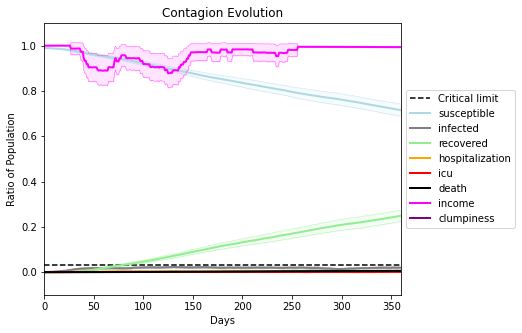

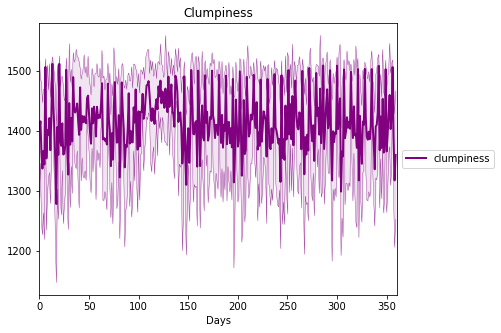

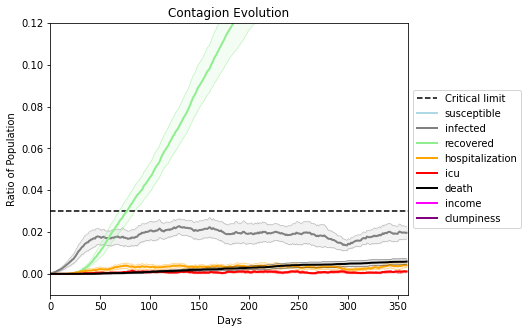

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6195, 8936, 7645, 6072, 4648, 7316, 5990, 1596, 6447, 1525, 6485, 6649, 2735, 2707, 3888, 3155, 6440, 5132, 4582, 2018]
Average similarity between family members is 0.9740359641963108 at temperature -0.998
Average similarity between family and home is 0.9998580754580128 at temperature -1
Average similarity between students and their classroom is 0.9640652136214973 at temperature -0.998
Average classroom occupancy is 1.6211180124223603 and number classrooms is 161
Average similarity between workers is 0.9584254017106977 at temperature -0.998
Average office occupancy is 3.6956521739130435 and number offices is 184
Average friend similarity for adults: 0.8564908293986299 for kids: 0.7321405287826798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.624645982591786
avg restaurant similarity 0.6219675762746316
avg restaurant similarity 0.6869623238720014
avg restaurant similarity 0.6101040445499121
avg restaurant similarity 0.6838830818615991
avg restaurant similarity 0.6196266226308516
avg restaurant similarity 0.6879750201668055
avg restaurant similarity 0.6230701754478402
avg restaurant similarity 0.6735451042279544
avg restaurant similarity 0.6508213018542336
avg restaurant similarity 0.621951019919572
avg restaurant similarity 0.6486681515447908
avg restaurant similarity 0.6563445580679563
avg restaurant similarity 0.6186236091933675
avg restaurant similarity 0.6236361948199297
avg restaurant similarity 0.594851285401054
avg restaurant similarity 0.625464845632095
avg restaurant similarity 0.6461725347402921
avg restaurant similarity 0.6923328508364396
avg restaurant similarity 0.6224512318486392
avg restaurant similarity 0.6016287326543058
avg restaurant similarity 0.6192070494100612
avg restaurant

avg restaurant similarity 0.6816891431480199
avg restaurant similarity 0.6808164040609538
avg restaurant similarity 0.6167855059245787
avg restaurant similarity 0.6341055393700912
avg restaurant similarity 0.6299342469338465
avg restaurant similarity 0.6139809160562859
avg restaurant similarity 0.6485098168105058
avg restaurant similarity 0.6612268292624243
avg restaurant similarity 0.6829774585603061
avg restaurant similarity 0.6869281279692261
avg restaurant similarity 0.6238478671500545
avg restaurant similarity 0.6183208100352885
avg restaurant similarity 0.666870757402386
avg restaurant similarity 0.5948128085350085
avg restaurant similarity 0.6470770756276409
avg restaurant similarity 0.6508259632121187
avg restaurant similarity 0.6542723722958619
avg restaurant similarity 0.6400884386948873
avg restaurant similarity 0.657682697428238
avg restaurant similarity 0.6634080352127565
avg restaurant similarity 0.602901626680859
avg restaurant similarity 0.6259808979103377
avg restauran

Average friend similarity for adults: 0.8499741074728242 for kids: 0.7168449296279243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.6286589817558279
avg restaurant similarity 0.659250497990454
avg restaurant similarity 0.6394395837300149
avg restaurant similarity 0.7194509858682323
avg restaurant similarity 0.653883834904789
avg restaurant similarity 0.6378353852283862
avg restaurant similarity 0.6592962724586093
avg restaurant similarity 0.7334868049268649
avg restaurant similarity 0.5997592590682047
avg restaurant similarity 0.6645419873894287
avg restaurant similarity 0.6864247735407741
avg restaurant similarity 0.6809551093048576
avg restaurant similarity 0.6806117743231008
avg restaurant similarity 0.6514646749623607
avg restaurant similarity 0.6145238948083354
avg restaurant similarity 0.6429376871843075
avg restaurant similarity 0.6601854670376422
avg restaurant similarity 0.6705752884752346
avg restaurant similarity 0.6773601609144915
avg restaurant similarity 0.6241317399881551
avg restaurant similarity 0.6641069165144491
avg restaurant similarity 0.6442679403601188
avg restaura

avg restaurant similarity 0.6610295867231883
avg restaurant similarity 0.6400590257891291
avg restaurant similarity 0.6454522306098958
avg restaurant similarity 0.6380548402765818
avg restaurant similarity 0.6301507699096985
avg restaurant similarity 0.660135226087998
avg restaurant similarity 0.6605948338870228
avg restaurant similarity 0.6470548266609163
avg restaurant similarity 0.6418661896279251
avg restaurant similarity 0.6706926038525026
avg restaurant similarity 0.6966578758637306
avg restaurant similarity 0.635771822626118
avg restaurant similarity 0.7203638280564173
avg restaurant similarity 0.6901361062822476
avg restaurant similarity 0.6817133573719701
avg restaurant similarity 0.6573838302761217
avg restaurant similarity 0.7055979902927584
avg restaurant similarity 0.6248324311080437
avg restaurant similarity 0.6434178933309758
avg restaurant similarity 0.6534305085167662
avg restaurant similarity 0.6464315674225118
avg restaurant similarity 0.659294854142117
avg restauran

Average similarity between workers is 0.970560511916905 at temperature -0.998
Average office occupancy is 3.543010752688172 and number offices is 186
Average friend similarity for adults: 0.8635803861983529 for kids: 0.7492905058893743
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6564889892582391
avg restaurant similarity 0.6800858588582203
avg restaurant similarity 0.6374992972367057
avg restaurant similarity 0.691525178794581
avg restaurant similarity 0.6662333917463557
avg restaurant similarity 0.6726829095245189
avg restaurant similarity 0.6294206765360713
avg restaurant similarity 0.6494994163709031
avg restaurant similarity 0.6038784863921512
avg restaurant similarity 0.6447615417305403
avg restaurant similarity 0.6482747178266888
avg restaurant similarity 0.6543852937196999
avg restaurant similarity 0.6428252095644537
avg restaurant similarity 0.6232424215060417
avg restaurant similarity 0.6651585671822978
avg restaurant similarity 0.6731042747434288
avg restaurant similarity 0.6673673828204916
avg restaurant similarity 0.6598772637111571
avg restaurant similarity 0.6210736814801393
avg restaurant similarity 0.6812392898950617
avg restaurant similarity 0.677357716118528
avg restaurant similarity 0.5936546231773203
avg restaura

avg restaurant similarity 0.6652674877087296
avg restaurant similarity 0.6654037336638318
avg restaurant similarity 0.6341480520207695
avg restaurant similarity 0.6176053789388198
avg restaurant similarity 0.6545102440515451
avg restaurant similarity 0.6358658473794714
avg restaurant similarity 0.6481936977290773
avg restaurant similarity 0.64687866236396
avg restaurant similarity 0.639717947707795
avg restaurant similarity 0.6571100257801403
avg restaurant similarity 0.6548056304071532
avg restaurant similarity 0.6487521539909785
avg restaurant similarity 0.6624795097237031
avg restaurant similarity 0.620922151702893
avg restaurant similarity 0.6641311925911072
avg restaurant similarity 0.6158258779945622
avg restaurant similarity 0.6419991433559786
avg restaurant similarity 0.6811367148518236
avg restaurant similarity 0.6367654809428065
avg restaurant similarity 0.6355572129858945
avg restaurant similarity 0.6158780100555845
avg restaurant similarity 0.663250258939295
avg restaurant 

Average friend similarity for adults: 0.8497478027969613 for kids: 0.7211902294407077
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.6826006249815535
avg restaurant similarity 0.7159594612986798
avg restaurant similarity 0.6447840947596638
avg restaurant similarity 0.6829679763574399
avg restaurant similarity 0.5923238654267062
avg restaurant similarity 0.6613274608203328
avg restaurant similarity 0.634466629099174
avg restaurant similarity 0.680280526380329
avg restaurant similarity 0.6276670188954597
avg restaurant similarity 0.6855592653726689
avg restaurant similarity 0.7392123777778603
avg restaurant similarity 0.708704947563708
avg restaurant similarity 0.6614178023280401
avg restaurant similarity 0.6512679567743492
avg restaurant similarity 0.6804278579563783
avg restaurant similarity 0.6635510537225031
avg restaurant similarity 0.6801768479035412
avg restaurant similarity 0.6295968624093418
avg restaurant similarity 0.6641355289436285
avg restaurant similarity 0.6616318448368338
avg restaurant similarity 0.6028565733509924
avg restaurant similarity 0.6975254864007374
avg restauran

avg restaurant similarity 0.6529773695025832
avg restaurant similarity 0.6588124590644374
avg restaurant similarity 0.7077081504921015
avg restaurant similarity 0.6428170923154062
avg restaurant similarity 0.6446456871707995
avg restaurant similarity 0.6388491762865592
avg restaurant similarity 0.6838757666920394
avg restaurant similarity 0.6878433023666253
avg restaurant similarity 0.7106933416845032
avg restaurant similarity 0.7410434334200314
avg restaurant similarity 0.6353167240127093
avg restaurant similarity 0.6771616789356805
avg restaurant similarity 0.7320221562110092
avg restaurant similarity 0.6866581585164766
avg restaurant similarity 0.6834487553205285
avg restaurant similarity 0.6455252371158512
avg restaurant similarity 0.6729076717937201
avg restaurant similarity 0.6937375750669046
avg restaurant similarity 0.6908886788912801
avg restaurant similarity 0.6256324086800406
avg restaurant similarity 0.6696985804115201
avg restaurant similarity 0.6865414774658148
avg restau

Average similarity between workers is 0.9708767203384612 at temperature -0.998
Average office occupancy is 3.6557377049180326 and number offices is 183
Average friend similarity for adults: 0.8593784348524465 for kids: 0.7395857329715929
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6519035098411748
avg restaurant similarity 0.7193945420854055
avg restaurant similarity 0.6661382119010716
avg restaurant similarity 0.6571610118729542
avg restaurant similarity 0.6238288026204147
avg restaurant similarity 0.6134598819337721
avg restaurant similarity 0.6089256810525698
avg restaurant similarity 0.6277708706811337
avg restaurant similarity 0.647733651725288
avg restaurant similarity 0.6672418709358547
avg restaurant similarity 0.6626454367508582
avg restaurant similarity 0.6452045523491604
avg restaurant similarity 0.7172845590546902
avg restaurant similarity 0.6637421941995421
avg restaurant similarity 0.6463384726520011
avg restaurant similarity 0.6461946744331359
avg restaurant similarity 0.7062451288828245
avg restaurant similarity 0.6629493178748429
avg restaurant similarity 0.6312607781738897
avg restaurant similarity 0.702089514838048
avg restaurant similarity 0.7142159587434548
avg restaurant similarity 0.6806007645330081
avg restaura

avg restaurant similarity 0.6790530600797544
avg restaurant similarity 0.6193299239676121
avg restaurant similarity 0.6438878479910786
avg restaurant similarity 0.638271296373535
avg restaurant similarity 0.6777840960796662
avg restaurant similarity 0.6174452362499285
avg restaurant similarity 0.5843763895530097
avg restaurant similarity 0.7286754025344356
avg restaurant similarity 0.6674983612630037
avg restaurant similarity 0.6700564466918048
avg restaurant similarity 0.6350414108402332
avg restaurant similarity 0.6343522506249406
avg restaurant similarity 0.595812069621356
avg restaurant similarity 0.6743276602078869
avg restaurant similarity 0.6214171371962254
avg restaurant similarity 0.5804242674768395
avg restaurant similarity 0.6285366399948672
avg restaurant similarity 0.645329067870427
avg restaurant similarity 0.6067749256908453
avg restaurant similarity 0.6677608120463956
avg restaurant similarity 0.6461542906770569
avg restaurant similarity 0.6647437394280769
avg restauran

Average similarity between workers is 0.9587435147280396 at temperature -0.998
Average office occupancy is 3.5185185185185186 and number offices is 189
Average friend similarity for adults: 0.857763834551787 for kids: 0.7283559193063404
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6496554264013079
avg restaurant similarity 0.6421066767765025
avg restaurant similarity 0.634213402495783
avg restaurant similarity 0.6666782433968009
avg restaurant similarity 0.6350542237357512
avg restaurant similarity 0.6268687767317025
avg restaurant similarity 0.6548307887613035
avg restaurant similarity 0.636354874518837
avg restaurant similarity 0.6362511344419968
avg restaurant similarity 0.6361919868031496
avg restaurant similarity 0.6146864794799092
avg restaurant similarity 0.6916829710457695
avg restaurant similarity 0.6758494090388637
avg restaurant similarity 0.6070871727826058
avg restaurant similarity 0.6781534923463659
avg restaurant similarity 0.6667386127978595
avg restaurant similarity 0.6828837211908986
avg restaurant similarity 0.641989072116652
avg restaurant similarity 0.6136582110016331
avg restaurant similarity 0.7024168534764412
avg restaurant similarity 0.6844815683481466
avg restaurant similarity 0.619293621374851
avg restaurant

avg restaurant similarity 0.6290005276706843
avg restaurant similarity 0.6599741914325592
avg restaurant similarity 0.6546250231460304
avg restaurant similarity 0.6519753788254424
avg restaurant similarity 0.6549667865112192
avg restaurant similarity 0.6886845538098927
avg restaurant similarity 0.607338610111703
avg restaurant similarity 0.7107072716368135
avg restaurant similarity 0.629415807130944
avg restaurant similarity 0.6335031042612054
avg restaurant similarity 0.6004794561893069
avg restaurant similarity 0.6590269588453636
avg restaurant similarity 0.6295609902347186
avg restaurant similarity 0.6289921963442952
avg restaurant similarity 0.617846313065713
avg restaurant similarity 0.6350467488984929
avg restaurant similarity 0.6491171011423866
avg restaurant similarity 0.6092156094498834
avg restaurant similarity 0.6807448833530034
avg restaurant similarity 0.6345363965842974
avg restaurant similarity 0.5849332172805564
avg restaurant similarity 0.6274204160643502
avg restauran

Average similarity between workers is 0.9611831027014616 at temperature -0.998
Average office occupancy is 3.6448087431693987 and number offices is 183
Average friend similarity for adults: 0.8590182566632284 for kids: 0.7468040615870538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.7046711458147987
avg restaurant similarity 0.6617872759488372
avg restaurant similarity 0.699307153146036
avg restaurant similarity 0.6521396016099474
avg restaurant similarity 0.7196125802295672
avg restaurant similarity 0.7301610799570647
avg restaurant similarity 0.6789221553196735
avg restaurant similarity 0.6906015184475934
avg restaurant similarity 0.6820073729869833
avg restaurant similarity 0.6769223808957161
avg restaurant similarity 0.6955060218815804
avg restaurant similarity 0.7248361278573298
avg restaurant similarity 0.6809449614461118
avg restaurant similarity 0.7109900509765145
avg restaurant similarity 0.6971451621837463
avg restaurant similarity 0.7029131482710297
avg restaurant similarity 0.7630273931910755
avg restaurant similarity 0.6487020050930188
avg restaurant similarity 0.6921179844029788
avg restaurant similarity 0.7147678703525453
avg restaurant similarity 0.6382769368558043
avg restaurant similarity 0.6830284992310106
avg restaur

avg restaurant similarity 0.6417165981993207
avg restaurant similarity 0.747543563014334
avg restaurant similarity 0.6889671286618962
avg restaurant similarity 0.6691385696137194
avg restaurant similarity 0.7269995635739549
avg restaurant similarity 0.6891885002701397
avg restaurant similarity 0.7209882801985056
avg restaurant similarity 0.6962195433671283
avg restaurant similarity 0.7289869544168793
avg restaurant similarity 0.6777279598127199
avg restaurant similarity 0.7028400635715442
avg restaurant similarity 0.6963348052018374
avg restaurant similarity 0.6912823950152941
avg restaurant similarity 0.7160596615325469
avg restaurant similarity 0.6751320063400686
avg restaurant similarity 0.6513303074299001
avg restaurant similarity 0.6748563524254043
avg restaurant similarity 0.6944545375501182
avg restaurant similarity 0.6664009639818423
avg restaurant similarity 0.6749846853450928
avg restaurant similarity 0.6993712221985637
avg restaurant similarity 0.6997109824043373
avg restaur

Average similarity between workers is 0.9582225051401781 at temperature -0.998
Average office occupancy is 3.405263157894737 and number offices is 190
Average friend similarity for adults: 0.8543529603705755 for kids: 0.7350545260962025
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.673645475393722
avg restaurant similarity 0.7311831017039079
avg restaurant similarity 0.649717071776071
avg restaurant similarity 0.6953720160156466
avg restaurant similarity 0.6829155266752883
avg restaurant similarity 0.6719553214252569
avg restaurant similarity 0.6794363964064543
avg restaurant similarity 0.6408378940483025
avg restaurant similarity 0.6567150665584526
avg restaurant similarity 0.7217989039884841
avg restaurant similarity 0.6452625598030679
avg restaurant similarity 0.674957958591435
avg restaurant similarity 0.7065106574036308
avg restaurant similarity 0.6710895303761149
avg restaurant similarity 0.6947639163160658
avg restaurant similarity 0.7083252651737273
avg restaurant similarity 0.6540232161003311
avg restaurant similarity 0.6954125143377647
avg restaurant similarity 0.7038657884114359
avg restaurant similarity 0.6497938925612513
avg restaurant similarity 0.7038862426476972
avg restaurant similarity 0.6850770680779537
avg restauran

avg restaurant similarity 0.6670165870450112
avg restaurant similarity 0.6608130278478781
avg restaurant similarity 0.6874995939049154
avg restaurant similarity 0.7037573255120905
avg restaurant similarity 0.7047444326140081
avg restaurant similarity 0.7301308095628363
avg restaurant similarity 0.6594727573244928
avg restaurant similarity 0.6225079749189696
avg restaurant similarity 0.6622762145289415
avg restaurant similarity 0.6421675869295916
avg restaurant similarity 0.699210095270212
avg restaurant similarity 0.6785552327263631
avg restaurant similarity 0.6942594420847504
avg restaurant similarity 0.7055339613635931
avg restaurant similarity 0.7263138478018726
avg restaurant similarity 0.661671593673615
avg restaurant similarity 0.731891634959065
avg restaurant similarity 0.674808710561255
avg restaurant similarity 0.6928983987931053
avg restaurant similarity 0.6805153881716908
avg restaurant similarity 0.6969724490662185
avg restaurant similarity 0.6738855207191853
avg restaurant

Average similarity between workers is 0.9709690415814332 at temperature -0.998
Average office occupancy is 3.473404255319149 and number offices is 188
Average friend similarity for adults: 0.8556697024068742 for kids: 0.7334745883462688
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.5729323039473262
avg restaurant similarity 0.6736243766429317
avg restaurant similarity 0.5739860309782265
avg restaurant similarity 0.6431657113444252
avg restaurant similarity 0.7016660367942317
avg restaurant similarity 0.6500072578891175
avg restaurant similarity 0.640814375126391
avg restaurant similarity 0.6780524014664779
avg restaurant similarity 0.6603885580985801
avg restaurant similarity 0.7050129258311764
avg restaurant similarity 0.6290776047527397
avg restaurant similarity 0.6925358018854945
avg restaurant similarity 0.6262154603348552
avg restaurant similarity 0.612298548711813
avg restaurant similarity 0.6217054050855847
avg restaurant similarity 0.617431343735531
avg restaurant similarity 0.6337973644436236
avg restaurant similarity 0.6260892943893704
avg restaurant similarity 0.7429795969508364
avg restaurant similarity 0.6179888918917394
avg restaurant similarity 0.6390879475577435
avg restaurant similarity 0.6342893432176019
avg restauran

avg restaurant similarity 0.6117248452169444
avg restaurant similarity 0.6850205795475033
avg restaurant similarity 0.6522431304290376
avg restaurant similarity 0.6355205739040308
avg restaurant similarity 0.622093602126731
avg restaurant similarity 0.6326331156657163
avg restaurant similarity 0.6792472889886289
avg restaurant similarity 0.6455063705169412
avg restaurant similarity 0.6802701860735689
avg restaurant similarity 0.6389735637455067
avg restaurant similarity 0.6595427172832102
avg restaurant similarity 0.672282387680115
avg restaurant similarity 0.6407175965515155
avg restaurant similarity 0.6283222375679698
avg restaurant similarity 0.7068748475278774
avg restaurant similarity 0.5964445045531397
avg restaurant similarity 0.7054296237066741
avg restaurant similarity 0.6670294499469794
avg restaurant similarity 0.6384186911457485
avg restaurant similarity 0.6363370320386006
avg restaurant similarity 0.6448292869574708
avg restaurant similarity 0.6128713584083414
avg restaura

Average similarity between workers is 0.9670464857179701 at temperature -0.998
Average office occupancy is 3.5297297297297296 and number offices is 185
Average friend similarity for adults: 0.8550459729510649 for kids: 0.7384930404162512
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6488475211942775
avg restaurant similarity 0.6762088799235004
avg restaurant similarity 0.6991668026072699
avg restaurant similarity 0.6764848234326806
avg restaurant similarity 0.6556093033321277
avg restaurant similarity 0.6808293084873773
avg restaurant similarity 0.6956205131841933
avg restaurant similarity 0.6874417206340736
avg restaurant similarity 0.6652656244267021
avg restaurant similarity 0.6748577783666246
avg restaurant similarity 0.7010278492951064
avg restaurant similarity 0.6976822029133173
avg restaurant similarity 0.6793023449927557
avg restaurant similarity 0.6701801230974643
avg restaurant similarity 0.7271790990167353
avg restaurant similarity 0.6541266125344517
avg restaurant similarity 0.6465330822765151
avg restaurant similarity 0.6872627269607563
avg restaurant similarity 0.6876601584810323
avg restaurant similarity 0.673692242240801
avg restaurant similarity 0.6697272903643766
avg restaurant similarity 0.6802912782968713
avg restaur

avg restaurant similarity 0.6436862512146277
avg restaurant similarity 0.6570275962953669
avg restaurant similarity 0.6708147673327619
avg restaurant similarity 0.6405221423844547
avg restaurant similarity 0.6904801633292249
avg restaurant similarity 0.604267779133762
avg restaurant similarity 0.6511860407076219
avg restaurant similarity 0.709552475762791
avg restaurant similarity 0.6532206304495315
avg restaurant similarity 0.6209334102776317
avg restaurant similarity 0.6814034830119684
avg restaurant similarity 0.6517394579745656
avg restaurant similarity 0.6918997449944734
avg restaurant similarity 0.6843944263443213
avg restaurant similarity 0.6770345370494564
avg restaurant similarity 0.6093859757904109
avg restaurant similarity 0.7144408988163575
avg restaurant similarity 0.6730285566371761
avg restaurant similarity 0.6787615012495563
avg restaurant similarity 0.6277054056570496
avg restaurant similarity 0.6548400684186357
avg restaurant similarity 0.6902773979444365
avg restaura

Average similarity between workers is 0.9676400792382153 at temperature -0.998
Average office occupancy is 3.5904255319148937 and number offices is 188
Average friend similarity for adults: 0.8581266959861436 for kids: 0.7197397187775937
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6471851287844296
avg restaurant similarity 0.6233617405480565
avg restaurant similarity 0.6358425844705907
avg restaurant similarity 0.5902902163051025
avg restaurant similarity 0.5834380459154862
avg restaurant similarity 0.6703482515951856
avg restaurant similarity 0.5859858597436379
avg restaurant similarity 0.6151191442165233
avg restaurant similarity 0.6492416221844098
avg restaurant similarity 0.6084723450772008
avg restaurant similarity 0.612954045813823
avg restaurant similarity 0.6003405229724166
avg restaurant similarity 0.6681460998562808
avg restaurant similarity 0.5734339400699724
avg restaurant similarity 0.6911718743033356
avg restaurant similarity 0.6274770677606867
avg restaurant similarity 0.690970142445791
avg restaurant similarity 0.6422512884771546
avg restaurant similarity 0.6617301635891103
avg restaurant similarity 0.6065805566768676
avg restaurant similarity 0.6001720366140261
avg restaurant similarity 0.631064530698007
avg restauran

avg restaurant similarity 0.5592544917013237
avg restaurant similarity 0.6093780507097132
avg restaurant similarity 0.6359850821029022
avg restaurant similarity 0.5901482225871607
avg restaurant similarity 0.6897882206975718
avg restaurant similarity 0.6164038729517181
avg restaurant similarity 0.6737326351078219
avg restaurant similarity 0.5704604711031257
avg restaurant similarity 0.6526117276219909
avg restaurant similarity 0.6456180166942279
avg restaurant similarity 0.6263636470791919
avg restaurant similarity 0.6489087699414048
avg restaurant similarity 0.6241315655283475
avg restaurant similarity 0.651641656844602
avg restaurant similarity 0.6655383188900859
avg restaurant similarity 0.636908471326874
avg restaurant similarity 0.6153442624444864
avg restaurant similarity 0.6678283735043243
avg restaurant similarity 0.6482714325172922
avg restaurant similarity 0.6590486354515173
avg restaurant similarity 0.6616422547418062
avg restaurant similarity 0.643892963990849
avg restauran

Average similarity between workers is 0.9611063678680768 at temperature -0.998
Average office occupancy is 3.4656084656084656 and number offices is 189
Average friend similarity for adults: 0.860103158861481 for kids: 0.7511924066159106
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6916374003282132
avg restaurant similarity 0.6670152171246331
avg restaurant similarity 0.7045463667745042
avg restaurant similarity 0.7174322728994547
avg restaurant similarity 0.7117363645180702
avg restaurant similarity 0.669334436897516
avg restaurant similarity 0.722323090593194
avg restaurant similarity 0.6807339580028068
avg restaurant similarity 0.6995845302610821
avg restaurant similarity 0.7076082557263568
avg restaurant similarity 0.6671207187014585
avg restaurant similarity 0.7023725028863276
avg restaurant similarity 0.6995964832147522
avg restaurant similarity 0.7119410110314809
avg restaurant similarity 0.7063172928662873
avg restaurant similarity 0.7020660765061534
avg restaurant similarity 0.7070235577242305
avg restaurant similarity 0.6884624846275681
avg restaurant similarity 0.7106226214953338
avg restaurant similarity 0.6905337654922421
avg restaurant similarity 0.6648383299688262
avg restaurant similarity 0.6831306832715218
avg restaura

avg restaurant similarity 0.7085339665842083
avg restaurant similarity 0.7587690461750307
avg restaurant similarity 0.7240626353012166
avg restaurant similarity 0.6853006749321261
avg restaurant similarity 0.6754253179793589
avg restaurant similarity 0.7239002115578491
avg restaurant similarity 0.692292829520005
avg restaurant similarity 0.7023803947742858
avg restaurant similarity 0.7030656651938889
avg restaurant similarity 0.6871813971698392
avg restaurant similarity 0.7206441718753959
avg restaurant similarity 0.7116633963482648
avg restaurant similarity 0.6892572058577873
avg restaurant similarity 0.6894311607437904
avg restaurant similarity 0.765251646270077
avg restaurant similarity 0.7289396071967911
avg restaurant similarity 0.7096836571995017
avg restaurant similarity 0.6821980722443871
avg restaurant similarity 0.6820704077311511
avg restaurant similarity 0.7166070983068236
avg restaurant similarity 0.7091279509385584
avg restaurant similarity 0.6756703296169266
avg restaura

Average similarity between workers is 0.9693911916718073 at temperature -0.998
Average office occupancy is 3.5106382978723403 and number offices is 188
Average friend similarity for adults: 0.8646500818441257 for kids: 0.7409743838518844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6784243053683737
avg restaurant similarity 0.6597344855824469
avg restaurant similarity 0.6784059353508873
avg restaurant similarity 0.7230967062382261
avg restaurant similarity 0.6869995150965926
avg restaurant similarity 0.7117455667414262
avg restaurant similarity 0.6658629784199874
avg restaurant similarity 0.6237365168661778
avg restaurant similarity 0.7095116583623113
avg restaurant similarity 0.6673015390181248
avg restaurant similarity 0.7338410974520739
avg restaurant similarity 0.7152199170860817
avg restaurant similarity 0.6874575024838172
avg restaurant similarity 0.6955568024649377
avg restaurant similarity 0.6861123716177965
avg restaurant similarity 0.6902609573550471
avg restaurant similarity 0.70896640454324
avg restaurant similarity 0.7049120316181109
avg restaurant similarity 0.6977473894643077
avg restaurant similarity 0.671081837061422
avg restaurant similarity 0.6896709741460008
avg restaurant similarity 0.7163078216527863
avg restauran

avg restaurant similarity 0.6695064051727764
avg restaurant similarity 0.6715242003006515
avg restaurant similarity 0.6682580798519947
avg restaurant similarity 0.6484041474174622
avg restaurant similarity 0.6883187984464874
avg restaurant similarity 0.6579860009784604
avg restaurant similarity 0.6715130287829865
avg restaurant similarity 0.6862183689328915
avg restaurant similarity 0.6690544218075998
avg restaurant similarity 0.7247948501750814
avg restaurant similarity 0.7027993360917907
avg restaurant similarity 0.6987400765277856
avg restaurant similarity 0.6837095531019436
avg restaurant similarity 0.6759487845119865
avg restaurant similarity 0.6948673069336575
avg restaurant similarity 0.6819980905835777
avg restaurant similarity 0.7114328688355532
avg restaurant similarity 0.7328827651208601
avg restaurant similarity 0.687893656790507
avg restaurant similarity 0.6880061792914935
avg restaurant similarity 0.6650370524464063
avg restaurant similarity 0.6899169982291748
avg restaur

Average similarity between workers is 0.969566874691823 at temperature -0.998
Average office occupancy is 3.8 and number offices is 180
Average friend similarity for adults: 0.8587534957444652 for kids: 0.7294603060430854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocate

avg restaurant similarity 0.6475521844264451
avg restaurant similarity 0.6366991867254209
avg restaurant similarity 0.6883433191021793
avg restaurant similarity 0.653955901179923
avg restaurant similarity 0.6059747887441767
avg restaurant similarity 0.6154328010218465
avg restaurant similarity 0.6452388642790462
avg restaurant similarity 0.665802443693949
avg restaurant similarity 0.6296792679563997
avg restaurant similarity 0.697255238537538
avg restaurant similarity 0.6687952083581072
avg restaurant similarity 0.6529656456191544
avg restaurant similarity 0.6569787108164398
avg restaurant similarity 0.6896977099588986
avg restaurant similarity 0.6962125895533463
avg restaurant similarity 0.6910448039810644
avg restaurant similarity 0.6873651533523357
avg restaurant similarity 0.7143860846222371
avg restaurant similarity 0.6435975724596263
avg restaurant similarity 0.6763160568204144
avg restaurant similarity 0.6952295276240663
avg restaurant similarity 0.6488872816975414
avg restauran

avg restaurant similarity 0.735749039593189
avg restaurant similarity 0.6307812366259506
avg restaurant similarity 0.6919914568791284
avg restaurant similarity 0.6781174817241282
avg restaurant similarity 0.6682959453238934
avg restaurant similarity 0.6383629077239935
avg restaurant similarity 0.647439325317063
avg restaurant similarity 0.6795459501747354
avg restaurant similarity 0.6904970992886845
avg restaurant similarity 0.6584202100314969
avg restaurant similarity 0.5691316852899615
avg restaurant similarity 0.6288893828094897
avg restaurant similarity 0.6746339436774245
avg restaurant similarity 0.662287656018507
avg restaurant similarity 0.6575467805156956
avg restaurant similarity 0.6997624118585706
avg restaurant similarity 0.6625655996171247
avg restaurant similarity 0.6888164940177762
avg restaurant similarity 0.6408616844883984
avg restaurant similarity 0.6382728005668069
avg restaurant similarity 0.6279851234293385
avg restaurant similarity 0.6707322238531618
avg restauran

Average similarity between workers is 0.9648048583635659 at temperature -0.998
Average office occupancy is 3.672043010752688 and number offices is 186
Average friend similarity for adults: 0.8626210190255424 for kids: 0.7232942065744326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.7470375735392867
avg restaurant similarity 0.6804830124960383
avg restaurant similarity 0.6547730711658745
avg restaurant similarity 0.6826365339018112
avg restaurant similarity 0.7177413665175115
avg restaurant similarity 0.6931059355753465
avg restaurant similarity 0.709654413022938
avg restaurant similarity 0.7001968759803417
avg restaurant similarity 0.7288809926981029
avg restaurant similarity 0.6411548979150178
avg restaurant similarity 0.709431952355743
avg restaurant similarity 0.6645517247853416
avg restaurant similarity 0.7180898380656839
avg restaurant similarity 0.6716643448391624
avg restaurant similarity 0.7442619512979607
avg restaurant similarity 0.6574614846677427
avg restaurant similarity 0.7119633566758444
avg restaurant similarity 0.7471087103047678
avg restaurant similarity 0.677774034044664
avg restaurant similarity 0.7112635665394719
avg restaurant similarity 0.6629189403914808
avg restaurant similarity 0.6980712891430759
avg restauran

avg restaurant similarity 0.6867196700881892
avg restaurant similarity 0.6826310511624465
avg restaurant similarity 0.6781091321950635
avg restaurant similarity 0.6921457918228291
avg restaurant similarity 0.6836930729089938
avg restaurant similarity 0.6911944194563284
avg restaurant similarity 0.7027042032742705
avg restaurant similarity 0.6941361946782034
avg restaurant similarity 0.6335105350655684
avg restaurant similarity 0.7051762012964308
avg restaurant similarity 0.7157110827163069
avg restaurant similarity 0.6729997174130412
avg restaurant similarity 0.7405885059754759
avg restaurant similarity 0.6790381768520145
avg restaurant similarity 0.6804432531584735
avg restaurant similarity 0.7314513376269397
avg restaurant similarity 0.706205206110655
avg restaurant similarity 0.6885096827035878
avg restaurant similarity 0.6816489105099203
avg restaurant similarity 0.7269334408320816
avg restaurant similarity 0.7147568955625594
avg restaurant similarity 0.6992462323094304
avg restaur

Average similarity between workers is 0.9646731304957438 at temperature -0.998
Average office occupancy is 3.442105263157895 and number offices is 190
Average friend similarity for adults: 0.8592687434524818 for kids: 0.7318166716451211
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.6528169953015351
avg restaurant similarity 0.7015636701498981
avg restaurant similarity 0.6910167423411745
avg restaurant similarity 0.7188933792103679
avg restaurant similarity 0.6810547636404013
avg restaurant similarity 0.7078386093951782
avg restaurant similarity 0.7074026045540646
avg restaurant similarity 0.6943219486772645
avg restaurant similarity 0.7014221798520323
avg restaurant similarity 0.6814488201647386
avg restaurant similarity 0.6533202956059707
avg restaurant similarity 0.6756176844096248
avg restaurant similarity 0.6824244020015499
avg restaurant similarity 0.6750632865746006
avg restaurant similarity 0.6622570048039446
avg restaurant similarity 0.6553308368313618
avg restaurant similarity 0.6968437499179095
avg restaurant similarity 0.6845075568775278
avg restaurant similarity 0.6590192597430666
avg restaurant similarity 0.6781486802963765
avg restaurant similarity 0.6371769347974935
avg restaurant similarity 0.6821531671401065
avg restau

avg restaurant similarity 0.6953684586701815
avg restaurant similarity 0.62644844141034
avg restaurant similarity 0.67547954413965
avg restaurant similarity 0.6979931305166619
avg restaurant similarity 0.6572052109781211
avg restaurant similarity 0.6446013587650994
avg restaurant similarity 0.6217425711692126
avg restaurant similarity 0.6330966454802697
avg restaurant similarity 0.6416511873728464
avg restaurant similarity 0.6861598132594126
avg restaurant similarity 0.6871969275265009
avg restaurant similarity 0.6524395438807552
avg restaurant similarity 0.6431719722794903
avg restaurant similarity 0.6371127830058942
avg restaurant similarity 0.6312607251298625
avg restaurant similarity 0.6906199801721142
avg restaurant similarity 0.6813934678981945
avg restaurant similarity 0.6890883519760113
avg restaurant similarity 0.6556223379908647
avg restaurant similarity 0.6682952275085722
avg restaurant similarity 0.6635247358577036
avg restaurant similarity 0.6589516044465041
avg restaurant

Average similarity between workers is 0.9616102825032778 at temperature -0.998
Average office occupancy is 3.5722222222222224 and number offices is 180
Average friend similarity for adults: 0.8487150646296949 for kids: 0.7380428574167383
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.61220715369698
avg restaurant similarity 0.6703297744537502
avg restaurant similarity 0.5949507739592599
avg restaurant similarity 0.6042662639884886
avg restaurant similarity 0.6729291498618445
avg restaurant similarity 0.6123985079078331
avg restaurant similarity 0.5835300517005111
avg restaurant similarity 0.6479172970970279
avg restaurant similarity 0.594772205525425
avg restaurant similarity 0.7058902628254675
avg restaurant similarity 0.6061959959253141
avg restaurant similarity 0.6521005569005228
avg restaurant similarity 0.6481203680726562
avg restaurant similarity 0.581877971407298
avg restaurant similarity 0.6694659311625644
avg restaurant similarity 0.690976798784457
avg restaurant similarity 0.660397172334793
avg restaurant similarity 0.6460175494144922
avg restaurant similarity 0.6020135720627668
avg restaurant similarity 0.6292646135296776
avg restaurant similarity 0.6454868078950914
avg restaurant similarity 0.6327334378685306
avg restaurant s

avg restaurant similarity 0.5965437849693845
avg restaurant similarity 0.6177688697529967
avg restaurant similarity 0.5810418827398894
avg restaurant similarity 0.6420753481460127
avg restaurant similarity 0.6555602747984521
avg restaurant similarity 0.6352997195156965
avg restaurant similarity 0.6029603391043984
avg restaurant similarity 0.6143279973471892
avg restaurant similarity 0.6169858371355149
avg restaurant similarity 0.6412665051614584
avg restaurant similarity 0.6534488864682221
avg restaurant similarity 0.5944270236943565
avg restaurant similarity 0.6651504725068849
avg restaurant similarity 0.640809282367797
avg restaurant similarity 0.6096221423541102
avg restaurant similarity 0.6411389738906293
avg restaurant similarity 0.6328418314266885
avg restaurant similarity 0.6282337254514888
avg restaurant similarity 0.6356346767051461
avg restaurant similarity 0.6309650536831635
avg restaurant similarity 0.6281899792171318
avg restaurant similarity 0.646507435035479
avg restaura

Average similarity between workers is 0.9655441230733692 at temperature -0.998
Average office occupancy is 3.5580110497237567 and number offices is 181
Average friend similarity for adults: 0.8594091076986744 for kids: 0.7412804480417567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.6761610819362655
avg restaurant similarity 0.7106215491513276
avg restaurant similarity 0.6725313120513184
avg restaurant similarity 0.7049127382690232
avg restaurant similarity 0.6912986364395716
avg restaurant similarity 0.6543669530546598
avg restaurant similarity 0.6618897824376323
avg restaurant similarity 0.6367758268548245
avg restaurant similarity 0.6164288820573484
avg restaurant similarity 0.6847704040678149
avg restaurant similarity 0.6325268266672793
avg restaurant similarity 0.6934988486555698
avg restaurant similarity 0.7087885051952216
avg restaurant similarity 0.6741144951980809
avg restaurant similarity 0.6805545777972345
avg restaurant similarity 0.6270586057872738
avg restaurant similarity 0.66732133355349
avg restaurant similarity 0.6640295697624458
avg restaurant similarity 0.6713005915729301
avg restaurant similarity 0.6819819348340007
avg restaurant similarity 0.6426039264347706
avg restaurant similarity 0.6933639976881946
avg restaura

avg restaurant similarity 0.6026414897736588
avg restaurant similarity 0.6254349257706303
avg restaurant similarity 0.6815322999503239
avg restaurant similarity 0.6828020932921731
avg restaurant similarity 0.6799195696441068
avg restaurant similarity 0.7022543880438278
avg restaurant similarity 0.6899356655690841
avg restaurant similarity 0.6611635836597259
avg restaurant similarity 0.6155268662505659
avg restaurant similarity 0.6775940726577787
avg restaurant similarity 0.6511278020313858
avg restaurant similarity 0.7144619063178687
avg restaurant similarity 0.6833621080866427
avg restaurant similarity 0.6706897410609994
avg restaurant similarity 0.6382680531390739
avg restaurant similarity 0.6396100187480912
avg restaurant similarity 0.6292207804742556
avg restaurant similarity 0.626022856733619
avg restaurant similarity 0.60551906165762
avg restaurant similarity 0.6932606532907858
avg restaurant similarity 0.6402174162890235
avg restaurant similarity 0.7019236969889968
avg restauran

Average similarity between workers is 0.960957663435932 at temperature -0.998
Average office occupancy is 3.564516129032258 and number offices is 186
Average friend similarity for adults: 0.8581044415103886 for kids: 0.7313652822778167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.622513287066423
avg restaurant similarity 0.6205972612908468
avg restaurant similarity 0.6599454632257473
avg restaurant similarity 0.6546925176718229
avg restaurant similarity 0.6373535839595202
avg restaurant similarity 0.644657972780085
avg restaurant similarity 0.6788677827913844
avg restaurant similarity 0.6624337124000229
avg restaurant similarity 0.6295260968717936
avg restaurant similarity 0.6475434946740798
avg restaurant similarity 0.6294409585923935
avg restaurant similarity 0.6441302527669391
avg restaurant similarity 0.637965038032081
avg restaurant similarity 0.6463386143248946
avg restaurant similarity 0.6620567921201346
avg restaurant similarity 0.7087513741529897
avg restaurant similarity 0.6302540418835347
avg restaurant similarity 0.6750206934283794
avg restaurant similarity 0.6825604027061866
avg restaurant similarity 0.6865732256925692
avg restaurant similarity 0.6465790992830005
avg restaurant similarity 0.6652942427144167
avg restauran

avg restaurant similarity 0.6361377757757452
avg restaurant similarity 0.6672285757070905
avg restaurant similarity 0.6470654169201203
avg restaurant similarity 0.6604533167199963
avg restaurant similarity 0.6844921286058224
avg restaurant similarity 0.6556602556217979
avg restaurant similarity 0.6753958423497486
avg restaurant similarity 0.6393186811642002
avg restaurant similarity 0.6093655806129443
avg restaurant similarity 0.6478728302180436
avg restaurant similarity 0.6297030902229872
avg restaurant similarity 0.6456122211038924
avg restaurant similarity 0.6290305255355364
avg restaurant similarity 0.6350455038844428
avg restaurant similarity 0.6543459864376535
avg restaurant similarity 0.629493424731033
avg restaurant similarity 0.620965299449473
avg restaurant similarity 0.6576987776554657
avg restaurant similarity 0.633211942486736
avg restaurant similarity 0.6409391486777297
avg restaurant similarity 0.6250989105260917
avg restaurant similarity 0.6578854970336637
avg restauran

Average similarity between workers is 0.972476529126277 at temperature -0.998
Average office occupancy is 3.564516129032258 and number offices is 186
Average friend similarity for adults: 0.8647341399745185 for kids: 0.7386097983867608
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.7381316275744557
avg restaurant similarity 0.7256306350532623
avg restaurant similarity 0.6911022364086095
avg restaurant similarity 0.6593716357931076
avg restaurant similarity 0.6759867976673083
avg restaurant similarity 0.7607518106317048
avg restaurant similarity 0.7599493464925108
avg restaurant similarity 0.7008082288222715
avg restaurant similarity 0.6585212134293159
avg restaurant similarity 0.7160150360569825
avg restaurant similarity 0.7380902798340218
avg restaurant similarity 0.733152103415008
avg restaurant similarity 0.6793647117970314
avg restaurant similarity 0.737781279568863
avg restaurant similarity 0.6907408711793761
avg restaurant similarity 0.7049249717863395
avg restaurant similarity 0.7339585550194994
avg restaurant similarity 0.6776883067866944
avg restaurant similarity 0.6669009873360197
avg restaurant similarity 0.7300666859826216
avg restaurant similarity 0.6720262929130831
avg restaurant similarity 0.6706884675150551
avg restaura

avg restaurant similarity 0.6824668794562513
avg restaurant similarity 0.67723023481058
avg restaurant similarity 0.7254448001175513
avg restaurant similarity 0.7072400101419266
avg restaurant similarity 0.6975277939317002
avg restaurant similarity 0.7293017650847083
avg restaurant similarity 0.7039687478964556
avg restaurant similarity 0.6503420306625382
avg restaurant similarity 0.6900485027800866
avg restaurant similarity 0.6471532063443689
avg restaurant similarity 0.7294746242854653
avg restaurant similarity 0.7011913786432421
avg restaurant similarity 0.7145788635313467
avg restaurant similarity 0.7307967354266892
avg restaurant similarity 0.7149154665241293
avg restaurant similarity 0.7098212711036752
avg restaurant similarity 0.7080807824372113
avg restaurant similarity 0.703274803533349
avg restaurant similarity 0.7161443654800349
avg restaurant similarity 0.7112200782941245
avg restaurant similarity 0.6679511791636576
avg restaurant similarity 0.7413001334461893
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

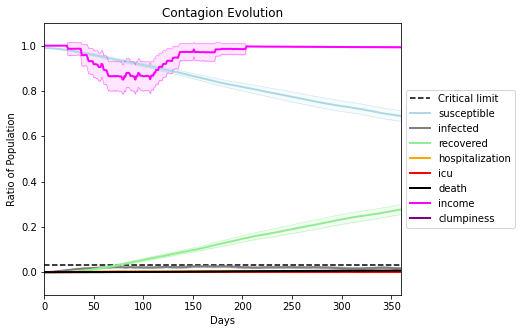

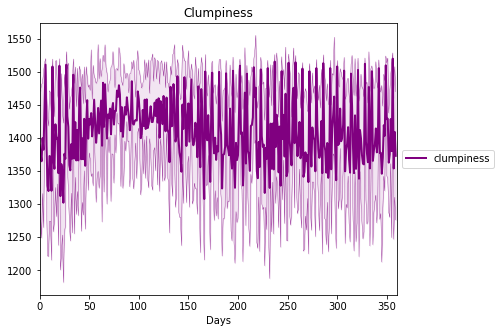

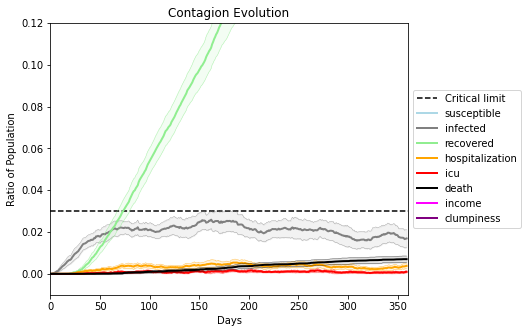

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3030, 2481, 2715, 3799, 9306, 7441, 857, 8666, 5226, 9236, 6818, 2782, 8726, 1189, 4219, 2127, 5853, 7776, 7459, 3368]
Average similarity between family members is 0.9577639367069344 at temperature -0.9975
Average similarity between family and home is 0.9998553781971723 at temperature -1
Average similarity between students and their classroom is 0.9440418660469704 at temperature -0.9975
Average classroom occupancy is 1.735632183908046 and number classrooms is 174
Average similarity between workers is 0.9410654522060646 at temperature -0.9975
Average office occupancy is 3.345549738219895 and number offices is 191
Average friend similarity for adults: 0.8574028385863446 for kids: 0.7498485915455116
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.6302391987281822
avg restaurant similarity 0.6045668521147107
avg restaurant similarity 0.6560083470958658
avg restaurant similarity 0.6092126330928834
avg restaurant similarity 0.660931941543215
avg restaurant similarity 0.6247295776536516
avg restaurant similarity 0.628638538492682
avg restaurant similarity 0.5683440502596764
avg restaurant similarity 0.5857672575102257
avg restaurant similarity 0.5903375594834303
avg restaurant similarity 0.5981260180023165
avg restaurant similarity 0.5869791374990077
avg restaurant similarity 0.6301264336382065
avg restaurant similarity 0.5843078461984357
avg restaurant similarity 0.614537981451124
avg restaurant similarity 0.6501940233007674
avg restaurant similarity 0.6231941073044466
avg restaurant similarity 0.6218623154327857
avg restaurant similarity 0.6146967207012926
avg restaurant similarity 0.6375755129333199
avg restaurant similarity 0.6206954714723992
avg restaurant similarity 0.6481024576239154
avg restauran

avg restaurant similarity 0.6402652588852289
avg restaurant similarity 0.5679727438403541
avg restaurant similarity 0.6436281755664045
avg restaurant similarity 0.6010604881385583
avg restaurant similarity 0.5938196041986886
avg restaurant similarity 0.6138225456988439
avg restaurant similarity 0.6209694890966686
avg restaurant similarity 0.6464026012955819
avg restaurant similarity 0.5907777154950451
avg restaurant similarity 0.6252967714727554
avg restaurant similarity 0.60130360760985
avg restaurant similarity 0.5945419850985345
avg restaurant similarity 0.6262826795453021
avg restaurant similarity 0.5846248547261638
avg restaurant similarity 0.5889162005768173
avg restaurant similarity 0.6469112318189143
avg restaurant similarity 0.5663943503363176
avg restaurant similarity 0.643418244424554
avg restaurant similarity 0.6339449833667485
avg restaurant similarity 0.6217147063833106
avg restaurant similarity 0.6584870084135389
avg restaurant similarity 0.5742702380998301
avg restauran

Average similarity between workers is 0.9469273679914171 at temperature -0.9975
Average office occupancy is 3.4345549738219896 and number offices is 191
Average friend similarity for adults: 0.867175087383615 for kids: 0.7428850045699409
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.6975259887820989
avg restaurant similarity 0.6978848850393352
avg restaurant similarity 0.6825615572772765
avg restaurant similarity 0.6610778849900738
avg restaurant similarity 0.6931893271372637
avg restaurant similarity 0.6819169260413469
avg restaurant similarity 0.6622371755362055
avg restaurant similarity 0.669614397173551
avg restaurant similarity 0.679849823590459
avg restaurant similarity 0.7099667837577419
avg restaurant similarity 0.7073651777486287
avg restaurant similarity 0.6724173221023235
avg restaurant similarity 0.6164827240218337
avg restaurant similarity 0.6913880685844164
avg restaurant similarity 0.6058018725352734
avg restaurant similarity 0.655081166940748
avg restaurant similarity 0.6457220321065961
avg restaurant similarity 0.5944845048074254
avg restaurant similarity 0.6886353713313096
avg restaurant similarity 0.6475309820627129
avg restaurant similarity 0.6863388263965966
avg restaurant similarity 0.6408934528789771
avg restauran

avg restaurant similarity 0.6768323043611179
avg restaurant similarity 0.658134423420946
avg restaurant similarity 0.6554727614671577
avg restaurant similarity 0.6268611836072878
avg restaurant similarity 0.6460768982127385
avg restaurant similarity 0.6182162346117002
avg restaurant similarity 0.6518255402564055
avg restaurant similarity 0.6626337696896819
avg restaurant similarity 0.6644066504858431
avg restaurant similarity 0.6350772270053339
avg restaurant similarity 0.6123445416804965
avg restaurant similarity 0.6693093309746246
avg restaurant similarity 0.6856462991494102
avg restaurant similarity 0.646090856836865
avg restaurant similarity 0.6938373980046741
avg restaurant similarity 0.6583978929221435
avg restaurant similarity 0.6264477587516435
avg restaurant similarity 0.7206300703753372
avg restaurant similarity 0.656416792600715
avg restaurant similarity 0.6382486956750691
avg restaurant similarity 0.6994767874952578
avg restaurant similarity 0.6466370052057122
avg restauran

Average similarity between workers is 0.9398320036818117 at temperature -0.9975
Average office occupancy is 3.4345549738219896 and number offices is 191
Average friend similarity for adults: 0.8588223640287536 for kids: 0.737362314209302
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.66133181639138
avg restaurant similarity 0.646508207039085
avg restaurant similarity 0.6238643142601028
avg restaurant similarity 0.6567729568359619
avg restaurant similarity 0.6285125718668715
avg restaurant similarity 0.6288573960413725
avg restaurant similarity 0.6590783598981097
avg restaurant similarity 0.6232585224738914
avg restaurant similarity 0.6068838161762666
avg restaurant similarity 0.626838219471359
avg restaurant similarity 0.6746300158955697
avg restaurant similarity 0.6601053936728831
avg restaurant similarity 0.6408128218928811
avg restaurant similarity 0.6717134384000423
avg restaurant similarity 0.6707378191558799
avg restaurant similarity 0.6074759663285436
avg restaurant similarity 0.6688104436967977
avg restaurant similarity 0.6633860900330039
avg restaurant similarity 0.6215419515509757
avg restaurant similarity 0.634837573241823
avg restaurant similarity 0.6671483936032717
avg restaurant similarity 0.6802841902129453
avg restaurant 

avg restaurant similarity 0.6375928450819768
avg restaurant similarity 0.6403349331490562
avg restaurant similarity 0.6486027741515245
avg restaurant similarity 0.6594881084953466
avg restaurant similarity 0.6433294135948543
avg restaurant similarity 0.6286397106444725
avg restaurant similarity 0.6596307050163828
avg restaurant similarity 0.6598030537196192
avg restaurant similarity 0.610434409717431
avg restaurant similarity 0.6559598177938349
avg restaurant similarity 0.6584784753747362
avg restaurant similarity 0.6495046855389697
avg restaurant similarity 0.6352619460924583
avg restaurant similarity 0.6106944806204911
avg restaurant similarity 0.6647454394084391
avg restaurant similarity 0.6349091297464837
avg restaurant similarity 0.6297724547775297
avg restaurant similarity 0.6963323763236982
avg restaurant similarity 0.6315961149658912
avg restaurant similarity 0.6344637559579751
avg restaurant similarity 0.659434890096363
avg restaurant similarity 0.6713911473970141
avg restaura

Average similarity between workers is 0.9475659998782577 at temperature -0.9975
Average office occupancy is 3.43979057591623 and number offices is 191
Average friend similarity for adults: 0.8661190498070986 for kids: 0.7366874068340402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6138959538991665
avg restaurant similarity 0.583687303502315
avg restaurant similarity 0.6154289468746442
avg restaurant similarity 0.6224708890334483
avg restaurant similarity 0.6506271463855056
avg restaurant similarity 0.5766260278744598
avg restaurant similarity 0.6286943843615724
avg restaurant similarity 0.5901650376824522
avg restaurant similarity 0.5704587410917288
avg restaurant similarity 0.6205241999534418
avg restaurant similarity 0.5990933890116563
avg restaurant similarity 0.6359942712306591
avg restaurant similarity 0.6121833581002689
avg restaurant similarity 0.6169084419664973
avg restaurant similarity 0.6030227166701146
avg restaurant similarity 0.6073059870890377
avg restaurant similarity 0.5940368292855019
avg restaurant similarity 0.6805808203268947
avg restaurant similarity 0.6303058847946539
avg restaurant similarity 0.5803503918119528
avg restaurant similarity 0.629823461535559
avg restaurant similarity 0.6446305070056443
avg restaura

avg restaurant similarity 0.6447998995092967
avg restaurant similarity 0.6190690921378095
avg restaurant similarity 0.6138872360816466
avg restaurant similarity 0.5954182743335354
avg restaurant similarity 0.6468545081684398
avg restaurant similarity 0.5981019600307407
avg restaurant similarity 0.587613316416177
avg restaurant similarity 0.6262391458944451
avg restaurant similarity 0.5977715814438354
avg restaurant similarity 0.6524425851054286
avg restaurant similarity 0.7136629389669243
avg restaurant similarity 0.6116735718723892
avg restaurant similarity 0.6340667404916038
avg restaurant similarity 0.628431276903255
avg restaurant similarity 0.597993463093152
avg restaurant similarity 0.6427219375011404
avg restaurant similarity 0.6407113658230004
avg restaurant similarity 0.6136240554358616
avg restaurant similarity 0.6321878633859358
avg restaurant similarity 0.6327177135971653
avg restaurant similarity 0.631253155945565
avg restaurant similarity 0.6383289781567087
avg restaurant

Average similarity between workers is 0.9384474851655839 at temperature -0.9975
Average office occupancy is 3.283505154639175 and number offices is 194
Average friend similarity for adults: 0.8603215056046737 for kids: 0.7536331621762994
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6867446447235507
avg restaurant similarity 0.6030585388131575
avg restaurant similarity 0.6198009170198796
avg restaurant similarity 0.6161892885428617
avg restaurant similarity 0.6684945520717356
avg restaurant similarity 0.6364479857170947
avg restaurant similarity 0.6833396061797116
avg restaurant similarity 0.6459245899263405
avg restaurant similarity 0.6374926021852855
avg restaurant similarity 0.6413262294224651
avg restaurant similarity 0.6592848254749276
avg restaurant similarity 0.6506124076380445
avg restaurant similarity 0.6338234627531291
avg restaurant similarity 0.6735474563420429
avg restaurant similarity 0.6293577127160082
avg restaurant similarity 0.6283568862427242
avg restaurant similarity 0.6322028709881513
avg restaurant similarity 0.6928739893089328
avg restaurant similarity 0.6741488155574796
avg restaurant similarity 0.6490997490372482
avg restaurant similarity 0.6550459000322323
avg restaurant similarity 0.6605294030818498
avg restau

avg restaurant similarity 0.704307184650846
avg restaurant similarity 0.6509964993141409
avg restaurant similarity 0.6089774102700586
avg restaurant similarity 0.6531289517784665
avg restaurant similarity 0.6470664946995472
avg restaurant similarity 0.620313041352859
avg restaurant similarity 0.6421104326567745
avg restaurant similarity 0.6504828373061935
avg restaurant similarity 0.6220900846110708
avg restaurant similarity 0.6722672360716613
avg restaurant similarity 0.6219723327783786
avg restaurant similarity 0.6745765896815805
avg restaurant similarity 0.5955836573908369
avg restaurant similarity 0.6150849668194283
avg restaurant similarity 0.650919829749832
avg restaurant similarity 0.6306445543406205
avg restaurant similarity 0.5723056895354967
avg restaurant similarity 0.6743080506252936
avg restaurant similarity 0.6011092972838573
avg restaurant similarity 0.6469135246790666
avg restaurant similarity 0.6408113924041664
avg restaurant similarity 0.6628674892067227
avg restauran

Average similarity between workers is 0.943211171377653 at temperature -0.9975
Average office occupancy is 3.624338624338624 and number offices is 189
Average friend similarity for adults: 0.8677346664556181 for kids: 0.7216324668506863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.6710782145022766
avg restaurant similarity 0.6419780419502908
avg restaurant similarity 0.6757768146999968
avg restaurant similarity 0.5922331336707398
avg restaurant similarity 0.5901688951980346
avg restaurant similarity 0.6588636469656929
avg restaurant similarity 0.6490259802664873
avg restaurant similarity 0.6164161836173576
avg restaurant similarity 0.6208109352006118
avg restaurant similarity 0.6324347352102468
avg restaurant similarity 0.6340714751391477
avg restaurant similarity 0.6851887327600401
avg restaurant similarity 0.6369373686175018
avg restaurant similarity 0.6186690973904037
avg restaurant similarity 0.60937296187486
avg restaurant similarity 0.653419765101511
avg restaurant similarity 0.6373327207523978
avg restaurant similarity 0.6224112432386353
avg restaurant similarity 0.6418509996939301
avg restaurant similarity 0.6299455844762448
avg restaurant similarity 0.6154592580846981
avg restaurant similarity 0.63375169994678
avg restaurant 

avg restaurant similarity 0.5836187453335183
avg restaurant similarity 0.6284029513100303
avg restaurant similarity 0.5946048901476971
avg restaurant similarity 0.6563689820967038
avg restaurant similarity 0.635931570540261
avg restaurant similarity 0.6494035820223798
avg restaurant similarity 0.6275426950657822
avg restaurant similarity 0.6337266368946611
avg restaurant similarity 0.6094798909176538
avg restaurant similarity 0.6220409574433553
avg restaurant similarity 0.6068852963017988
avg restaurant similarity 0.6750112219839752
avg restaurant similarity 0.5792482287314356
avg restaurant similarity 0.6323220554164769
avg restaurant similarity 0.6409746220009749
avg restaurant similarity 0.6461300905040978
avg restaurant similarity 0.6610947006661287
avg restaurant similarity 0.5881118718411451
avg restaurant similarity 0.5997103833023192
avg restaurant similarity 0.6245116705091485
avg restaurant similarity 0.6125204005623642
avg restaurant similarity 0.6274682626249436
avg restaur

Average similarity between workers is 0.930059742889408 at temperature -0.9975
Average office occupancy is 3.516304347826087 and number offices is 184
Average friend similarity for adults: 0.8581781900501748 for kids: 0.7415007305872513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6526686529755834
avg restaurant similarity 0.5854069939396644
avg restaurant similarity 0.5945253935752506
avg restaurant similarity 0.6499486778979926
avg restaurant similarity 0.6061466298013143
avg restaurant similarity 0.6218393902055779
avg restaurant similarity 0.6196176287632117
avg restaurant similarity 0.5706138584246967
avg restaurant similarity 0.6346241976288503
avg restaurant similarity 0.6253623592499777
avg restaurant similarity 0.6184527274277006
avg restaurant similarity 0.6411418240603918
avg restaurant similarity 0.573466454656315
avg restaurant similarity 0.6634082024607091
avg restaurant similarity 0.6332123663103072
avg restaurant similarity 0.604569261645848
avg restaurant similarity 0.6517946362409144
avg restaurant similarity 0.6359442481743608
avg restaurant similarity 0.6050174598305261
avg restaurant similarity 0.6364108592118859
avg restaurant similarity 0.5958050208145227
avg restaurant similarity 0.5956093331012611
avg restaura

avg restaurant similarity 0.615094101107829
avg restaurant similarity 0.5993906820739047
avg restaurant similarity 0.6043923352988574
avg restaurant similarity 0.6683553021882847
avg restaurant similarity 0.5855687182599338
avg restaurant similarity 0.6426965938841059
avg restaurant similarity 0.59644290851628
avg restaurant similarity 0.6313742910639898
avg restaurant similarity 0.6092186610647078
avg restaurant similarity 0.6448139034038206
avg restaurant similarity 0.6473598798279526
avg restaurant similarity 0.5809832457276652
avg restaurant similarity 0.5966385728038723
avg restaurant similarity 0.599976244184819
avg restaurant similarity 0.6055265062472912
avg restaurant similarity 0.5955186457854118
avg restaurant similarity 0.6149298890250031
avg restaurant similarity 0.6348297680309675
avg restaurant similarity 0.6452243615024901
avg restaurant similarity 0.6273357602600143
avg restaurant similarity 0.6138629402822925
avg restaurant similarity 0.5955941610507626
avg restaurant

Average similarity between workers is 0.9461828491024451 at temperature -0.9975
Average office occupancy is 3.436548223350254 and number offices is 197
Average friend similarity for adults: 0.8578739580030401 for kids: 0.7266299643248589
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6673488262912921
avg restaurant similarity 0.6650565744286431
avg restaurant similarity 0.6617456286084954
avg restaurant similarity 0.6600891670239869
avg restaurant similarity 0.6590678228173109
avg restaurant similarity 0.6738390769005831
avg restaurant similarity 0.6450002285830952
avg restaurant similarity 0.6723674882167203
avg restaurant similarity 0.6606594108922226
avg restaurant similarity 0.6755055471960443
avg restaurant similarity 0.6261364355890632
avg restaurant similarity 0.6148359996223282
avg restaurant similarity 0.5996214986636367
avg restaurant similarity 0.652461138071756
avg restaurant similarity 0.6568878393396914
avg restaurant similarity 0.5864495695368644
avg restaurant similarity 0.6755178671584389
avg restaurant similarity 0.7201067641972654
avg restaurant similarity 0.6740866678009663
avg restaurant similarity 0.5763421082922825
avg restaurant similarity 0.6629613575884312
avg restaurant similarity 0.6148392279226232
avg restaur

avg restaurant similarity 0.6297767199757738
avg restaurant similarity 0.6541995359370066
avg restaurant similarity 0.6605070123504174
avg restaurant similarity 0.6507243903596468
avg restaurant similarity 0.620529499769643
avg restaurant similarity 0.6195630584735544
avg restaurant similarity 0.6784496631894832
avg restaurant similarity 0.6494632656196504
avg restaurant similarity 0.621519263956698
avg restaurant similarity 0.588738605034039
avg restaurant similarity 0.6901765562431246
avg restaurant similarity 0.5801445714928134
avg restaurant similarity 0.6292466196580414
avg restaurant similarity 0.6535262873248984
avg restaurant similarity 0.6378264417284779
avg restaurant similarity 0.6600201641758867
avg restaurant similarity 0.642769697321656
avg restaurant similarity 0.6688227244105162
avg restaurant similarity 0.643534437841078
avg restaurant similarity 0.6406460952974453
avg restaurant similarity 0.6126292026703344
avg restaurant similarity 0.6310359385793133
avg restaurant 

Average similarity between workers is 0.928297874980578 at temperature -0.9975
Average office occupancy is 3.5913978494623655 and number offices is 186
Average friend similarity for adults: 0.8530064024711427 for kids: 0.7356823189683857
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.6364159256561479
avg restaurant similarity 0.6389934808718293
avg restaurant similarity 0.6694613077432443
avg restaurant similarity 0.6790883199334554
avg restaurant similarity 0.6106161516111311
avg restaurant similarity 0.6922444024962294
avg restaurant similarity 0.6704485636793053
avg restaurant similarity 0.6331823436200126
avg restaurant similarity 0.6681439901883526
avg restaurant similarity 0.6357902684660334
avg restaurant similarity 0.5993521886447403
avg restaurant similarity 0.606071138305003
avg restaurant similarity 0.6194390425341875
avg restaurant similarity 0.668200988299052
avg restaurant similarity 0.662381561824714
avg restaurant similarity 0.6130096555706371
avg restaurant similarity 0.5912700830527724
avg restaurant similarity 0.6619769724666049
avg restaurant similarity 0.6738081447006998
avg restaurant similarity 0.6291205863875944
avg restaurant similarity 0.619335999522319
avg restaurant similarity 0.6283648559009782
avg restaurant

avg restaurant similarity 0.629864936939935
avg restaurant similarity 0.6464262686180738
avg restaurant similarity 0.6645416664815602
avg restaurant similarity 0.6594827574186607
avg restaurant similarity 0.623703679837769
avg restaurant similarity 0.6336404810663371
avg restaurant similarity 0.6454211784640247
avg restaurant similarity 0.5512021317177237
avg restaurant similarity 0.6547792761925799
avg restaurant similarity 0.617758367149774
avg restaurant similarity 0.6588133349012318
avg restaurant similarity 0.6342672815749567
avg restaurant similarity 0.6664176626101117
avg restaurant similarity 0.6706088322690316
avg restaurant similarity 0.6821165955329375
avg restaurant similarity 0.6168588137373822
avg restaurant similarity 0.6438186392518706
avg restaurant similarity 0.6544914078518392
avg restaurant similarity 0.6798024077075686
avg restaurant similarity 0.6719907361073039
avg restaurant similarity 0.6500639632335137
avg restaurant similarity 0.5845162039986168
avg restauran

Average similarity between workers is 0.9344080632668682 at temperature -0.9975
Average office occupancy is 3.566137566137566 and number offices is 189
Average friend similarity for adults: 0.8613272550775056 for kids: 0.7372188564587984
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.608338221705668
avg restaurant similarity 0.6230749283502793
avg restaurant similarity 0.6192540981964472
avg restaurant similarity 0.6188894706204894
avg restaurant similarity 0.6297820416567014
avg restaurant similarity 0.595668106409359
avg restaurant similarity 0.6296400038474823
avg restaurant similarity 0.5898388837859831
avg restaurant similarity 0.5758068034674203
avg restaurant similarity 0.6212265361003533
avg restaurant similarity 0.6009607930372274
avg restaurant similarity 0.591415191527344
avg restaurant similarity 0.5794237893096054
avg restaurant similarity 0.586695135061181
avg restaurant similarity 0.6455036808125815
avg restaurant similarity 0.6026867696460846
avg restaurant similarity 0.6136390034253184
avg restaurant similarity 0.5389549479385014
avg restaurant similarity 0.6498998626128402
avg restaurant similarity 0.5331614864278948
avg restaurant similarity 0.6078111987219826
avg restaurant similarity 0.6324614280324676
avg restaurant

avg restaurant similarity 0.6029833627310501
avg restaurant similarity 0.6398914782579326
avg restaurant similarity 0.6008366400984443
avg restaurant similarity 0.6374348952839628
avg restaurant similarity 0.6098609957370364
avg restaurant similarity 0.6322029455120807
avg restaurant similarity 0.6281651325252553
avg restaurant similarity 0.5855532771045517
avg restaurant similarity 0.5575897963232409
avg restaurant similarity 0.5809220918019941
avg restaurant similarity 0.602294987221732
avg restaurant similarity 0.5948636883589108
avg restaurant similarity 0.6249321042453845
avg restaurant similarity 0.5910947027589635
avg restaurant similarity 0.616938830135758
avg restaurant similarity 0.6281188460748618
avg restaurant similarity 0.5854252298614644
avg restaurant similarity 0.6719469667772183
avg restaurant similarity 0.6056958909915228
avg restaurant similarity 0.5489954138237183
avg restaurant similarity 0.6162622014204999
avg restaurant similarity 0.5879812374605433
avg restaura

Average similarity between workers is 0.9480936221032997 at temperature -0.9975
Average office occupancy is 3.3526315789473684 and number offices is 190
Average friend similarity for adults: 0.8460939347480154 for kids: 0.7377921509168338
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total 

avg restaurant similarity 0.6555803954630862
avg restaurant similarity 0.6400897502753161
avg restaurant similarity 0.5940136705578096
avg restaurant similarity 0.6771064100719024
avg restaurant similarity 0.6486466737104007
avg restaurant similarity 0.6498018026494892
avg restaurant similarity 0.6529751615035551
avg restaurant similarity 0.6173086258999424
avg restaurant similarity 0.7254774060387937
avg restaurant similarity 0.6159017848970594
avg restaurant similarity 0.6725363195346271
avg restaurant similarity 0.6739781942409232
avg restaurant similarity 0.6253725821613497
avg restaurant similarity 0.6450545978382534
avg restaurant similarity 0.677953775499535
avg restaurant similarity 0.7059436123100361
avg restaurant similarity 0.6831575157624346
avg restaurant similarity 0.7146170754984471
avg restaurant similarity 0.6978722341595388
avg restaurant similarity 0.638693396722121
avg restaurant similarity 0.7165749650689255
avg restaurant similarity 0.6451884652929362
avg restaura

avg restaurant similarity 0.6117899905737231
avg restaurant similarity 0.6557087053496268
avg restaurant similarity 0.6564344296008823
avg restaurant similarity 0.6552420833810387
avg restaurant similarity 0.6842354814469731
avg restaurant similarity 0.6761070651207675
avg restaurant similarity 0.7173589363169556
avg restaurant similarity 0.5924454027770584
avg restaurant similarity 0.6261142788979015
avg restaurant similarity 0.6234311403773893
avg restaurant similarity 0.6406979921339163
avg restaurant similarity 0.6450595387068099
avg restaurant similarity 0.6871574268351751
avg restaurant similarity 0.677310562838079
avg restaurant similarity 0.5999683578898811
avg restaurant similarity 0.6499111268138719
avg restaurant similarity 0.6402876620138848
avg restaurant similarity 0.6726046595806772
avg restaurant similarity 0.6485488380083635
avg restaurant similarity 0.6254839495476588
avg restaurant similarity 0.6427804709740255
avg restaurant similarity 0.6499734495280552
avg restaur

Average similarity between workers is 0.9398947057514305 at temperature -0.9975
Average office occupancy is 3.484375 and number offices is 192
Average friend similarity for adults: 0.8614711856868904 for kids: 0.7224693422436089
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peop

avg restaurant similarity 0.6174002334380058
avg restaurant similarity 0.6404356169042599
avg restaurant similarity 0.6323006020232169
avg restaurant similarity 0.6272110266624433
avg restaurant similarity 0.6039634233186555
avg restaurant similarity 0.6587059873345865
avg restaurant similarity 0.6218084923054344
avg restaurant similarity 0.6236601300449489
avg restaurant similarity 0.5951916699466441
avg restaurant similarity 0.5795539683999068
avg restaurant similarity 0.5765795513408397
avg restaurant similarity 0.599678702316743
avg restaurant similarity 0.6456343021035476
avg restaurant similarity 0.6397180734961052
avg restaurant similarity 0.5780073617139379
avg restaurant similarity 0.6473197331724644
avg restaurant similarity 0.5634633725983748
avg restaurant similarity 0.5785273539810448
avg restaurant similarity 0.615012423640715
avg restaurant similarity 0.6194719964105567
avg restaurant similarity 0.6213575557727471
avg restaurant similarity 0.6205320853627074
avg restaura

avg restaurant similarity 0.6332823390959117
avg restaurant similarity 0.6453574591709141
avg restaurant similarity 0.6766532441070313
avg restaurant similarity 0.6225870683252056
avg restaurant similarity 0.6322771815973892
avg restaurant similarity 0.5979338977398382
avg restaurant similarity 0.6541778742520235
avg restaurant similarity 0.6300450533796671
avg restaurant similarity 0.665564972264071
avg restaurant similarity 0.5784646477495824
avg restaurant similarity 0.5653409615053854
avg restaurant similarity 0.618786189267258
avg restaurant similarity 0.5489159277721373
avg restaurant similarity 0.6127397094492922
avg restaurant similarity 0.6026822555703896
avg restaurant similarity 0.639558761562468
avg restaurant similarity 0.6371046413221055
avg restaurant similarity 0.6180969331910514
avg restaurant similarity 0.6222905335672332
avg restaurant similarity 0.6412751938863006
avg restaurant similarity 0.6371265020834533
avg restaurant similarity 0.6251416790442781
avg restauran

Average similarity between workers is 0.9298210804413329 at temperature -0.9975
Average office occupancy is 3.383419689119171 and number offices is 193
Average friend similarity for adults: 0.8540739154079989 for kids: 0.7260619799115431
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.6489991709168171
avg restaurant similarity 0.6267429244277185
avg restaurant similarity 0.6177739128918164
avg restaurant similarity 0.7171927538222814
avg restaurant similarity 0.6954833845032784
avg restaurant similarity 0.6806422511783706
avg restaurant similarity 0.6778472858744186
avg restaurant similarity 0.6624457930875756
avg restaurant similarity 0.6389395884131183
avg restaurant similarity 0.6095064530560242
avg restaurant similarity 0.6587479055830047
avg restaurant similarity 0.6216076565540447
avg restaurant similarity 0.6258968232059257
avg restaurant similarity 0.627150230604732
avg restaurant similarity 0.636661452324247
avg restaurant similarity 0.6727375220350412
avg restaurant similarity 0.6836706295111393
avg restaurant similarity 0.6988957524423699
avg restaurant similarity 0.7200892102573488
avg restaurant similarity 0.674548399250494
avg restaurant similarity 0.6585668958615222
avg restaurant similarity 0.7120710337402568
avg restauran

avg restaurant similarity 0.6073880424322359
avg restaurant similarity 0.6206416882697613
avg restaurant similarity 0.6557607899460052
avg restaurant similarity 0.6432923206791044
avg restaurant similarity 0.6444971513594858
avg restaurant similarity 0.6177274083884182
avg restaurant similarity 0.7063474076583891
avg restaurant similarity 0.6650213541753861
avg restaurant similarity 0.6405672200154139
avg restaurant similarity 0.636096989717553
avg restaurant similarity 0.6225500349925605
avg restaurant similarity 0.6375797987057438
avg restaurant similarity 0.6791192502166058
avg restaurant similarity 0.7069078849990744
avg restaurant similarity 0.5693694025901911
avg restaurant similarity 0.6474463437917785
avg restaurant similarity 0.6517588434244179
avg restaurant similarity 0.6545443111407215
avg restaurant similarity 0.6428376588570461
avg restaurant similarity 0.6535865070124851
avg restaurant similarity 0.6558830937883243
avg restaurant similarity 0.6257120751399718
avg restaur

Average similarity between workers is 0.9483548132339125 at temperature -0.9975
Average office occupancy is 3.3350515463917527 and number offices is 194
Average friend similarity for adults: 0.8497664196249531 for kids: 0.7462585969343122
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total o

avg restaurant similarity 0.6046761665015796
avg restaurant similarity 0.6438015464610515
avg restaurant similarity 0.6259874777364054
avg restaurant similarity 0.6334447820045296
avg restaurant similarity 0.6412204003477497
avg restaurant similarity 0.6019818258668844
avg restaurant similarity 0.6418825405561249
avg restaurant similarity 0.6419544555547462
avg restaurant similarity 0.607319819826429
avg restaurant similarity 0.6136496710384288
avg restaurant similarity 0.675639537678673
avg restaurant similarity 0.588137518968465
avg restaurant similarity 0.6152102976298817
avg restaurant similarity 0.6448630766015169
avg restaurant similarity 0.6681590127285433
avg restaurant similarity 0.6049454700645049
avg restaurant similarity 0.5755129376666281
avg restaurant similarity 0.5793444583294509
avg restaurant similarity 0.6414050697188775
avg restaurant similarity 0.6426208251964115
avg restaurant similarity 0.6616897634195346
avg restaurant similarity 0.6511828224241124
avg restauran

avg restaurant similarity 0.6481264708585591
avg restaurant similarity 0.6974073520562988
avg restaurant similarity 0.6683326437607973
avg restaurant similarity 0.600000630650523
avg restaurant similarity 0.6036198116119101
avg restaurant similarity 0.5741329909493091
avg restaurant similarity 0.5984645361617512
avg restaurant similarity 0.6860212416006032
avg restaurant similarity 0.6111634392967258
avg restaurant similarity 0.6088915259700106
avg restaurant similarity 0.6131919166606675
avg restaurant similarity 0.5394196715379764
avg restaurant similarity 0.5996853048719155
avg restaurant similarity 0.6281909503124419
avg restaurant similarity 0.6706725511706826
avg restaurant similarity 0.6614655425602028
avg restaurant similarity 0.6300848344757956
avg restaurant similarity 0.6441567520014008
avg restaurant similarity 0.5948624860682477
avg restaurant similarity 0.6225265460520065
avg restaurant similarity 0.613111205809546
avg restaurant similarity 0.656080095862354
avg restauran

Average similarity between workers is 0.9461149595532413 at temperature -0.9975
Average office occupancy is 3.4324324324324325 and number offices is 185
Average friend similarity for adults: 0.8575597889264176 for kids: 0.7374952988593679
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6459335325966412
avg restaurant similarity 0.5875791247884891
avg restaurant similarity 0.6222801208288977
avg restaurant similarity 0.6122540770668645
avg restaurant similarity 0.6249919191032427
avg restaurant similarity 0.6348774402146826
avg restaurant similarity 0.6692191864474599
avg restaurant similarity 0.6299993561454011
avg restaurant similarity 0.6220892540447542
avg restaurant similarity 0.6331795351206128
avg restaurant similarity 0.6519494932595563
avg restaurant similarity 0.60914046958918
avg restaurant similarity 0.6813704406960104
avg restaurant similarity 0.6400440456081729
avg restaurant similarity 0.7073776789822142
avg restaurant similarity 0.603465212804244
avg restaurant similarity 0.6326737499999548
avg restaurant similarity 0.6188178659410708
avg restaurant similarity 0.614771928992742
avg restaurant similarity 0.6296246797508468
avg restaurant similarity 0.6325643351783431
avg restaurant similarity 0.6426349275383899
avg restaurant

avg restaurant similarity 0.6760585971367912
avg restaurant similarity 0.6111433963780937
avg restaurant similarity 0.7158907661778104
avg restaurant similarity 0.7008308661542589
avg restaurant similarity 0.6410443318175356
avg restaurant similarity 0.648473625183517
avg restaurant similarity 0.560853224889278
avg restaurant similarity 0.6747436787356387
avg restaurant similarity 0.627567432310544
avg restaurant similarity 0.6626404695512103
avg restaurant similarity 0.6004485656275539
avg restaurant similarity 0.6976618033089733
avg restaurant similarity 0.5933383740075865
avg restaurant similarity 0.6203355659807923
avg restaurant similarity 0.6427034549587987
avg restaurant similarity 0.6637001958538254
avg restaurant similarity 0.6411231736572913
avg restaurant similarity 0.6770708252376605
avg restaurant similarity 0.6399320134423033
avg restaurant similarity 0.5890928172817709
avg restaurant similarity 0.6132526183185026
avg restaurant similarity 0.6232991428001741
avg restauran

Average similarity between workers is 0.9148833715066212 at temperature -0.9975
Average office occupancy is 3.5319148936170213 and number offices is 188
Average friend similarity for adults: 0.8645788538049355 for kids: 0.7533106093894834
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total o

avg restaurant similarity 0.6013701932826672
avg restaurant similarity 0.6084759339261021
avg restaurant similarity 0.5657173701777757
avg restaurant similarity 0.6485076495501997
avg restaurant similarity 0.625634745044198
avg restaurant similarity 0.6422259048641827
avg restaurant similarity 0.6690699841243793
avg restaurant similarity 0.6271879540144697
avg restaurant similarity 0.6209324812739665
avg restaurant similarity 0.5476858118628389
avg restaurant similarity 0.6066173103862293
avg restaurant similarity 0.6016734520962677
avg restaurant similarity 0.6483283248618403
avg restaurant similarity 0.6688576377369095
avg restaurant similarity 0.6220374873230619
avg restaurant similarity 0.6244048174927039
avg restaurant similarity 0.5731196324370724
avg restaurant similarity 0.6404869621855818
avg restaurant similarity 0.6469853006572679
avg restaurant similarity 0.6220064575095848
avg restaurant similarity 0.5406165213176525
avg restaurant similarity 0.6113208449001826
avg restaur

avg restaurant similarity 0.6754407720295255
avg restaurant similarity 0.6209114440726322
avg restaurant similarity 0.6459257616167426
avg restaurant similarity 0.6264457799837563
avg restaurant similarity 0.6629295192488416
avg restaurant similarity 0.5793818977692353
avg restaurant similarity 0.6451194803061059
avg restaurant similarity 0.6902369342867741
avg restaurant similarity 0.6522248246330838
avg restaurant similarity 0.6620054402137582
avg restaurant similarity 0.5987976426332937
avg restaurant similarity 0.5884778766756393
avg restaurant similarity 0.6305047841923627
avg restaurant similarity 0.5802360059479732
avg restaurant similarity 0.6597407788431631
avg restaurant similarity 0.6251164629458271
avg restaurant similarity 0.6340205405747092
avg restaurant similarity 0.6810656969873488
avg restaurant similarity 0.5977886853358625
avg restaurant similarity 0.6570238025772073
avg restaurant similarity 0.6768176532931839
avg restaurant similarity 0.6126269467757399
avg restau

Average similarity between workers is 0.9420964765042965 at temperature -0.9975
Average office occupancy is 3.435233160621762 and number offices is 193
Average friend similarity for adults: 0.8671755427310501 for kids: 0.7382437099276801
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.697065360971384
avg restaurant similarity 0.6262034152457584
avg restaurant similarity 0.6347702022590809
avg restaurant similarity 0.6583720620933567
avg restaurant similarity 0.6524378866582102
avg restaurant similarity 0.6624559266298031
avg restaurant similarity 0.6178426321934389
avg restaurant similarity 0.6938297849041151
avg restaurant similarity 0.6424906774518596
avg restaurant similarity 0.6575891810692479
avg restaurant similarity 0.6765843313553693
avg restaurant similarity 0.6606262755884957
avg restaurant similarity 0.646778080158377
avg restaurant similarity 0.654155714771097
avg restaurant similarity 0.6808914192052437
avg restaurant similarity 0.606260619182913
avg restaurant similarity 0.6208230206994086
avg restaurant similarity 0.647332350945939
avg restaurant similarity 0.6961615767767474
avg restaurant similarity 0.6284418292105096
avg restaurant similarity 0.6555131984361255
avg restaurant similarity 0.7192671725080665
avg restaurant 

avg restaurant similarity 0.6833145447849022
avg restaurant similarity 0.6888099068909352
avg restaurant similarity 0.663766706021356
avg restaurant similarity 0.6720845670796111
avg restaurant similarity 0.6505314539847558
avg restaurant similarity 0.6429288330254805
avg restaurant similarity 0.5876800275021846
avg restaurant similarity 0.7020225600034917
avg restaurant similarity 0.6018911924571102
avg restaurant similarity 0.7080785870550617
avg restaurant similarity 0.6779720561685877
avg restaurant similarity 0.6433634634711948
avg restaurant similarity 0.6555791536871677
avg restaurant similarity 0.6131328044885777
avg restaurant similarity 0.6580816465517412
avg restaurant similarity 0.6023959091002853
avg restaurant similarity 0.6695339041162132
avg restaurant similarity 0.6925537904050599
avg restaurant similarity 0.6223906721316271
avg restaurant similarity 0.6757875381890716
avg restaurant similarity 0.6615278567292571
avg restaurant similarity 0.6524282089063229
avg restaur

Average similarity between workers is 0.9251050405581845 at temperature -0.9975
Average office occupancy is 3.5520833333333335 and number offices is 192
Average friend similarity for adults: 0.8601499454477364 for kids: 0.7212729852924186
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6405687377738974
avg restaurant similarity 0.6143878736900275
avg restaurant similarity 0.6496633198062238
avg restaurant similarity 0.6364071306380149
avg restaurant similarity 0.6334498509972623
avg restaurant similarity 0.6218796801224913
avg restaurant similarity 0.6370054537563046
avg restaurant similarity 0.6257676279518658
avg restaurant similarity 0.6256821859792145
avg restaurant similarity 0.6020126140693759
avg restaurant similarity 0.6103081512623374
avg restaurant similarity 0.6054614186322366
avg restaurant similarity 0.6226535612604813
avg restaurant similarity 0.6369516819402969
avg restaurant similarity 0.6371519993120053
avg restaurant similarity 0.6320566628956279
avg restaurant similarity 0.6105944827450771
avg restaurant similarity 0.5753508672225933
avg restaurant similarity 0.6116115194364243
avg restaurant similarity 0.5726487209891391
avg restaurant similarity 0.5894446278872523
avg restaurant similarity 0.5907923294776493
avg restau

avg restaurant similarity 0.6066102278863791
avg restaurant similarity 0.6429929412103442
avg restaurant similarity 0.6180309448435107
avg restaurant similarity 0.5732572132806772
avg restaurant similarity 0.6179875988823414
avg restaurant similarity 0.5966589864806128
avg restaurant similarity 0.6208796865154314
avg restaurant similarity 0.6180161973575854
avg restaurant similarity 0.6291216684636843
avg restaurant similarity 0.5707797902169846
avg restaurant similarity 0.6199393016567885
avg restaurant similarity 0.6327645664495922
avg restaurant similarity 0.6393447949541025
avg restaurant similarity 0.6363747117320365
avg restaurant similarity 0.6214706437204557
avg restaurant similarity 0.5905910154163629
avg restaurant similarity 0.5983209842160551
avg restaurant similarity 0.6385758005618921
avg restaurant similarity 0.6261447594917173
avg restaurant similarity 0.6067341277319207
avg restaurant similarity 0.5809690175138341
avg restaurant similarity 0.6367830284708377
avg restau

Average similarity between workers is 0.940409119191379 at temperature -0.9975
Average office occupancy is 3.3350515463917527 and number offices is 194
Average friend similarity for adults: 0.8535855943141902 for kids: 0.7279296089852035
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6444500889005333
avg restaurant similarity 0.6303349555854026
avg restaurant similarity 0.6673893297099428
avg restaurant similarity 0.6615770681872609
avg restaurant similarity 0.6153477651353723
avg restaurant similarity 0.702978371082054
avg restaurant similarity 0.5989766898765161
avg restaurant similarity 0.7003257784216087
avg restaurant similarity 0.7132496546353219
avg restaurant similarity 0.6711980375375151
avg restaurant similarity 0.6462249428371791
avg restaurant similarity 0.6191135665632828
avg restaurant similarity 0.6877719551024366
avg restaurant similarity 0.6451341078868023
avg restaurant similarity 0.6796919789951541
avg restaurant similarity 0.676945103922314
avg restaurant similarity 0.6550930525825645
avg restaurant similarity 0.6618998753647056
avg restaurant similarity 0.6306466726527736
avg restaurant similarity 0.7001939687561339
avg restaurant similarity 0.7227331878556028
avg restaurant similarity 0.6085724244807015
avg restaura

avg restaurant similarity 0.6752648221219938
avg restaurant similarity 0.6594053971007656
avg restaurant similarity 0.6095454341273808
avg restaurant similarity 0.5733107921680463
avg restaurant similarity 0.7155707806484911
avg restaurant similarity 0.6361533699067146
avg restaurant similarity 0.7116566702291409
avg restaurant similarity 0.6457580214849103
avg restaurant similarity 0.686831927311168
avg restaurant similarity 0.6455610794371478
avg restaurant similarity 0.6684178019544557
avg restaurant similarity 0.6495376079632836
avg restaurant similarity 0.7085692788599753
avg restaurant similarity 0.7086397646968219
avg restaurant similarity 0.6890502546127037
avg restaurant similarity 0.591397025490581
avg restaurant similarity 0.6434812666982813
avg restaurant similarity 0.5940743629181464
avg restaurant similarity 0.6884245812247787
avg restaurant similarity 0.6375865583680552
avg restaurant similarity 0.5578364054654122
avg restaurant similarity 0.6526271506551492
avg restaura

Average similarity between workers is 0.9360588213194242 at temperature -0.9975
Average office occupancy is 3.3789473684210525 and number offices is 190
Average friend similarity for adults: 0.8582560264097538 for kids: 0.7499382956930271
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total o

avg restaurant similarity 0.6469657272424953
avg restaurant similarity 0.6845349501091254
avg restaurant similarity 0.6871294429038209
avg restaurant similarity 0.6503685454027877
avg restaurant similarity 0.644148810278536
avg restaurant similarity 0.6836888072480941
avg restaurant similarity 0.663807809465642
avg restaurant similarity 0.6578092049981084
avg restaurant similarity 0.6890469522856548
avg restaurant similarity 0.7161860741745035
avg restaurant similarity 0.6170919704746479
avg restaurant similarity 0.6731769127134618
avg restaurant similarity 0.6748799047838958
avg restaurant similarity 0.6521372867132077
avg restaurant similarity 0.6787271360262015
avg restaurant similarity 0.6737496735013312
avg restaurant similarity 0.7079650724893478
avg restaurant similarity 0.6245630136157904
avg restaurant similarity 0.678251379554666
avg restaurant similarity 0.6210818195738803
avg restaurant similarity 0.6432684731500817
avg restaurant similarity 0.6961237565175455
avg restauran

avg restaurant similarity 0.6180086434581977
avg restaurant similarity 0.6371761372922243
avg restaurant similarity 0.6112754069989579
avg restaurant similarity 0.6456124858352366
avg restaurant similarity 0.6872174659648883
avg restaurant similarity 0.6518187786120085
avg restaurant similarity 0.6490122364054459
avg restaurant similarity 0.679514759519879
avg restaurant similarity 0.7092443580696552
avg restaurant similarity 0.6595346985974693
avg restaurant similarity 0.6568971771462075
avg restaurant similarity 0.6671607187507677
avg restaurant similarity 0.6294374670949291
avg restaurant similarity 0.6421408755673425
avg restaurant similarity 0.6306896366600547
avg restaurant similarity 0.6739660794441928
avg restaurant similarity 0.655506481472456
avg restaurant similarity 0.6882257328960364
avg restaurant similarity 0.6786007234368163
avg restaurant similarity 0.657235645843132
avg restaurant similarity 0.6714339483894076
avg restaurant similarity 0.6341622346770468
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

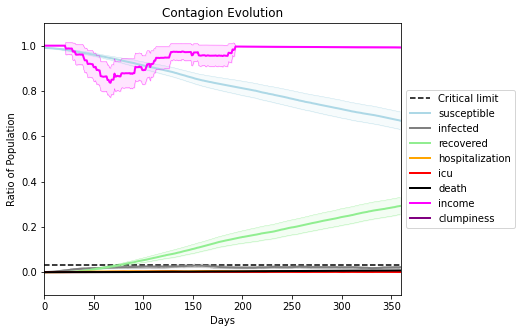

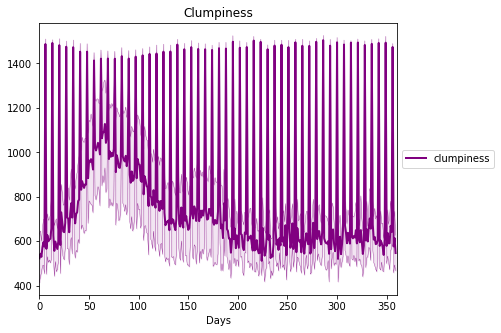

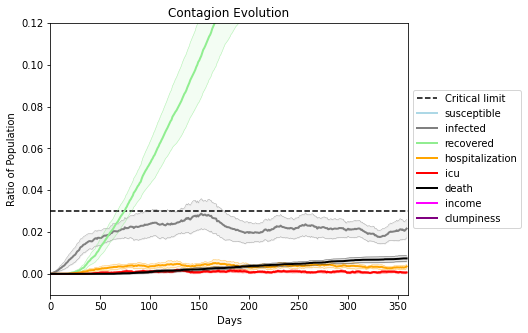

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1192, 2320, 8443, 5931, 6482, 9562, 3176, 5129, 5278, 8694, 7004, 4509, 7958, 6250, 5173, 8168, 7537, 8795, 2892, 9901]
Average similarity between family members is 0.9545960948785472 at temperature -0.997
Average similarity between family and home is 0.9998579941706194 at temperature -1
Average similarity between students and their classroom is 0.9146092198977923 at temperature -0.997
Average classroom occupancy is 1.6287425149700598 and number classrooms is 167
Average similarity between workers is 0.9274608417589512 at temperature -0.997
Average office occupancy is 3.4842105263157896 and number offices is 190
Average friend similarity for adults: 0.8655055782774 for kids: 0.7410912340896267
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.645903116291211
avg restaurant similarity 0.6670079906238212
avg restaurant similarity 0.6775180172877894
avg restaurant similarity 0.6822580119497151
avg restaurant similarity 0.6883689368254591
avg restaurant similarity 0.6304102073176705
avg restaurant similarity 0.6540458078422813
avg restaurant similarity 0.6064131238665428
avg restaurant similarity 0.6230815437047643
avg restaurant similarity 0.6346850792109392
avg restaurant similarity 0.638092729376492
avg restaurant similarity 0.6434100131810987
avg restaurant similarity 0.6769538152804481
avg restaurant similarity 0.6883531933069895
avg restaurant similarity 0.5702782528203897
avg restaurant similarity 0.5876671679911151
avg restaurant similarity 0.6503158793580249
avg restaurant similarity 0.6026414452823438
avg restaurant similarity 0.6093667876645957
avg restaurant similarity 0.6664288676888404
avg restaurant similarity 0.5679599871457659
avg restaurant similarity 0.6065377623473113
avg restaura

avg restaurant similarity 0.6923227557319412
avg restaurant similarity 0.603126037097193
avg restaurant similarity 0.5921603690454148
avg restaurant similarity 0.5856940399848558
avg restaurant similarity 0.622169512335776
avg restaurant similarity 0.6105062388580361
avg restaurant similarity 0.6165281651573029
avg restaurant similarity 0.5755483839877618
avg restaurant similarity 0.5587580277969993
avg restaurant similarity 0.6481337849288621
avg restaurant similarity 0.6389252223859234
avg restaurant similarity 0.6638549338103265
avg restaurant similarity 0.6268442025978476
avg restaurant similarity 0.6418036284998504
avg restaurant similarity 0.6864608104031703
avg restaurant similarity 0.6868350005082028
avg restaurant similarity 0.6271030415798208
avg restaurant similarity 0.646014028543602
avg restaurant similarity 0.620546661706348
avg restaurant similarity 0.6111395382622683
avg restaurant similarity 0.5774448408463262
avg restaurant similarity 0.6127395146664472
avg restaurant

Average similarity between workers is 0.9286747125736696 at temperature -0.997
Average office occupancy is 3.5714285714285716 and number offices is 189
Average friend similarity for adults: 0.8592249391590837 for kids: 0.7074411387358236
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6219419723443793
avg restaurant similarity 0.6404858371193793
avg restaurant similarity 0.7131065509852116
avg restaurant similarity 0.6726519264589172
avg restaurant similarity 0.6279930647766823
avg restaurant similarity 0.6133301992828913
avg restaurant similarity 0.648483138040072
avg restaurant similarity 0.6735362395718704
avg restaurant similarity 0.6403439992853712
avg restaurant similarity 0.6081824617318615
avg restaurant similarity 0.6532879288131044
avg restaurant similarity 0.6454133208429096
avg restaurant similarity 0.6734207986123883
avg restaurant similarity 0.6783214117722886
avg restaurant similarity 0.6510047846746122
avg restaurant similarity 0.6713458794114331
avg restaurant similarity 0.6304213394009535
avg restaurant similarity 0.6406128805318443
avg restaurant similarity 0.6727112095512549
avg restaurant similarity 0.6323436347590081
avg restaurant similarity 0.6089394438230278
avg restaurant similarity 0.6683694465122881
avg restaur

avg restaurant similarity 0.6590093151142337
avg restaurant similarity 0.6546249582391795
avg restaurant similarity 0.6229375728122302
avg restaurant similarity 0.6168327694847899
avg restaurant similarity 0.6537527292765236
avg restaurant similarity 0.6248736716659098
avg restaurant similarity 0.6276956846685151
avg restaurant similarity 0.6452081046972032
avg restaurant similarity 0.6816240853439016
avg restaurant similarity 0.6511719602961364
avg restaurant similarity 0.6180994235681789
avg restaurant similarity 0.6518069872137883
avg restaurant similarity 0.6185911999853472
avg restaurant similarity 0.6079172936236495
avg restaurant similarity 0.6435525379191834
avg restaurant similarity 0.6309945205505764
avg restaurant similarity 0.6872642518295455
avg restaurant similarity 0.6704642938631785
avg restaurant similarity 0.6517786134158527
avg restaurant similarity 0.638048688411645
avg restaurant similarity 0.6419651577643403
avg restaurant similarity 0.6923280763616447
avg restaur

Average similarity between workers is 0.9273499774276943 at temperature -0.997
Average office occupancy is 3.312820512820513 and number offices is 195
Average friend similarity for adults: 0.8493125144787472 for kids: 0.7350465388507531
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5953022713465599
avg restaurant similarity 0.6412588468755313
avg restaurant similarity 0.6296901846683781
avg restaurant similarity 0.6021804829298252
avg restaurant similarity 0.6227890965201256
avg restaurant similarity 0.6064634043453536
avg restaurant similarity 0.6585573007027874
avg restaurant similarity 0.5611709678240088
avg restaurant similarity 0.6111144734215865
avg restaurant similarity 0.6312909781677618
avg restaurant similarity 0.6075593155200112
avg restaurant similarity 0.6574667686192234
avg restaurant similarity 0.629346640955303
avg restaurant similarity 0.6121072695397805
avg restaurant similarity 0.6629898953642729
avg restaurant similarity 0.636249503771095
avg restaurant similarity 0.5933055211233512
avg restaurant similarity 0.63589459113307
avg restaurant similarity 0.5968214299105592
avg restaurant similarity 0.6225771505514651
avg restaurant similarity 0.6328895213499253
avg restaurant similarity 0.6324986850810016
avg restaurant

avg restaurant similarity 0.598412863936452
avg restaurant similarity 0.6428159459565318
avg restaurant similarity 0.6199711338729615
avg restaurant similarity 0.5951585696046993
avg restaurant similarity 0.6615247663818482
avg restaurant similarity 0.6037534244683636
avg restaurant similarity 0.5490070263358722
avg restaurant similarity 0.6511516174129403
avg restaurant similarity 0.6327045029439782
avg restaurant similarity 0.6200528896453089
avg restaurant similarity 0.5845326259668522
avg restaurant similarity 0.629673134049839
avg restaurant similarity 0.6517865216348541
avg restaurant similarity 0.6150624900013547
avg restaurant similarity 0.642825512520255
avg restaurant similarity 0.6163752339925291
avg restaurant similarity 0.5606029660087024
avg restaurant similarity 0.6513554566043733
avg restaurant similarity 0.6410563066506043
avg restaurant similarity 0.6008073634241473
avg restaurant similarity 0.6764014376755493
avg restaurant similarity 0.6317652308596943
avg restauran

Average similarity between workers is 0.9339438692724236 at temperature -0.997
Average office occupancy is 3.34375 and number offices is 192
Average friend similarity for adults: 0.854451483284019 for kids: 0.7330398842370078
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people 

avg restaurant similarity 0.577813617974407
avg restaurant similarity 0.6495158557522361
avg restaurant similarity 0.6479123512959395
avg restaurant similarity 0.6599660561415879
avg restaurant similarity 0.6732715003991331
avg restaurant similarity 0.6262608654009737
avg restaurant similarity 0.6195362583273083
avg restaurant similarity 0.6852831963535875
avg restaurant similarity 0.5762085382724106
avg restaurant similarity 0.6801400750662975
avg restaurant similarity 0.6870976295604413
avg restaurant similarity 0.6713559293265524
avg restaurant similarity 0.6052518090206089
avg restaurant similarity 0.6334475027505329
avg restaurant similarity 0.6385218978041888
avg restaurant similarity 0.6694055294338621
avg restaurant similarity 0.6169320097879509
avg restaurant similarity 0.6470181965976972
avg restaurant similarity 0.6744466745407068
avg restaurant similarity 0.6509638358736394
avg restaurant similarity 0.648770860549167
avg restaurant similarity 0.6825428414163862
avg restaura

avg restaurant similarity 0.66183067464799
avg restaurant similarity 0.5922957316083611
avg restaurant similarity 0.6648612851414152
avg restaurant similarity 0.6656500104754334
avg restaurant similarity 0.6658404303594563
avg restaurant similarity 0.657590346580715
avg restaurant similarity 0.5926739531485185
avg restaurant similarity 0.6622215169315139
avg restaurant similarity 0.690567997049373
avg restaurant similarity 0.6178786818264655
avg restaurant similarity 0.6274945962245649
avg restaurant similarity 0.6301344995258148
avg restaurant similarity 0.687145191492431
avg restaurant similarity 0.6317382373846818
avg restaurant similarity 0.6060410036240746
avg restaurant similarity 0.5953684868000765
avg restaurant similarity 0.653588316073833
avg restaurant similarity 0.6263652282752269
avg restaurant similarity 0.6373351274397432
avg restaurant similarity 0.623028117973668
avg restaurant similarity 0.6289552340225482
avg restaurant similarity 0.6047326893565798
avg restaurant si

Average similarity between workers is 0.9249019878478474 at temperature -0.997
Average office occupancy is 3.2615384615384615 and number offices is 195
Average friend similarity for adults: 0.852705376167463 for kids: 0.7392861045502883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6394622274859322
avg restaurant similarity 0.5983849095894604
avg restaurant similarity 0.6001412732354635
avg restaurant similarity 0.6600669455502775
avg restaurant similarity 0.6100709449443726
avg restaurant similarity 0.6391752614969103
avg restaurant similarity 0.5945247400785773
avg restaurant similarity 0.6445800753683019
avg restaurant similarity 0.6394018038672167
avg restaurant similarity 0.5894459406196437
avg restaurant similarity 0.6190370953682802
avg restaurant similarity 0.6271484939894769
avg restaurant similarity 0.5744793857824662
avg restaurant similarity 0.6021705183451198
avg restaurant similarity 0.6276763606469312
avg restaurant similarity 0.5872063314263931
avg restaurant similarity 0.6080030466501146
avg restaurant similarity 0.6107148529735403
avg restaurant similarity 0.5672681032471198
avg restaurant similarity 0.6216755081076047
avg restaurant similarity 0.584637411540733
avg restaurant similarity 0.5795434326328357
avg restaur

avg restaurant similarity 0.6239473864611976
avg restaurant similarity 0.6337135016712947
avg restaurant similarity 0.6111895252121373
avg restaurant similarity 0.6013655440564681
avg restaurant similarity 0.5709158006663315
avg restaurant similarity 0.6251830134137615
avg restaurant similarity 0.5923795757107443
avg restaurant similarity 0.6232428494183331
avg restaurant similarity 0.6082573925733761
avg restaurant similarity 0.66146969705198
avg restaurant similarity 0.633556838514938
avg restaurant similarity 0.6124383861448355
avg restaurant similarity 0.6403650983612331
avg restaurant similarity 0.6267980894670083
avg restaurant similarity 0.6416157805697068
avg restaurant similarity 0.6238422385466632
avg restaurant similarity 0.6157216632787901
avg restaurant similarity 0.6031172439445392
avg restaurant similarity 0.6030632765607084
avg restaurant similarity 0.5905582579316944
avg restaurant similarity 0.6267990906890366
avg restaurant similarity 0.6179674572996677
avg restauran

Average similarity between workers is 0.9217427427667433 at temperature -0.997
Average office occupancy is 3.38860103626943 and number offices is 193
Average friend similarity for adults: 0.8610433683668793 for kids: 0.7391561716698271
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6155363756477906
avg restaurant similarity 0.6393535904345471
avg restaurant similarity 0.5878595823187135
avg restaurant similarity 0.6461089701430413
avg restaurant similarity 0.6306497729909533
avg restaurant similarity 0.6972979410677898
avg restaurant similarity 0.5921676900146833
avg restaurant similarity 0.620092196481466
avg restaurant similarity 0.5986646549330836
avg restaurant similarity 0.6484539603794771
avg restaurant similarity 0.6072674256687475
avg restaurant similarity 0.6703938250394332
avg restaurant similarity 0.6611641340530297
avg restaurant similarity 0.618694597854416
avg restaurant similarity 0.6355209738491214
avg restaurant similarity 0.5924499523624894
avg restaurant similarity 0.6473616970654577
avg restaurant similarity 0.5844141289832652
avg restaurant similarity 0.600381448699445
avg restaurant similarity 0.5787116417104583
avg restaurant similarity 0.5691060899882769
avg restaurant similarity 0.6212381804598669
avg restauran

avg restaurant similarity 0.6445219984359515
avg restaurant similarity 0.6414319428044836
avg restaurant similarity 0.6511783506841058
avg restaurant similarity 0.6111836409735192
avg restaurant similarity 0.5896397862111059
avg restaurant similarity 0.6311960102965612
avg restaurant similarity 0.6511092345686549
avg restaurant similarity 0.6311061387274056
avg restaurant similarity 0.6301447659654381
avg restaurant similarity 0.59506648262567
avg restaurant similarity 0.6168062540148519
avg restaurant similarity 0.6449875427351346
avg restaurant similarity 0.6027158757017784
avg restaurant similarity 0.6029066333513701
avg restaurant similarity 0.6326634594446844
avg restaurant similarity 0.6353909708356691
avg restaurant similarity 0.5700415836017778
avg restaurant similarity 0.5635183468158277
avg restaurant similarity 0.6510732283942402
avg restaurant similarity 0.5791869776984837
avg restaurant similarity 0.55732156049692
avg restaurant similarity 0.5788140225627206
avg restaurant

Average similarity between workers is 0.9255435833104783 at temperature -0.997
Average office occupancy is 3.5625 and number offices is 192
Average friend similarity for adults: 0.8611161672452339 for kids: 0.7274508705859499
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allo

avg restaurant similarity 0.590950856409522
avg restaurant similarity 0.7052250822850175
avg restaurant similarity 0.6591465551488399
avg restaurant similarity 0.6048664228974799
avg restaurant similarity 0.6531889980938692
avg restaurant similarity 0.6586512660067418
avg restaurant similarity 0.6697025423877118
avg restaurant similarity 0.6782292554673207
avg restaurant similarity 0.6653044268094093
avg restaurant similarity 0.6542687754635492
avg restaurant similarity 0.639055904619009
avg restaurant similarity 0.645754577616505
avg restaurant similarity 0.6366295997584155
avg restaurant similarity 0.6442642061325677
avg restaurant similarity 0.6062525803138258
avg restaurant similarity 0.6342099443196653
avg restaurant similarity 0.6510951360022987
avg restaurant similarity 0.608807424883418
avg restaurant similarity 0.6114721151713441
avg restaurant similarity 0.6669799760740429
avg restaurant similarity 0.6268308638551879
avg restaurant similarity 0.6553039602221838
avg restaurant

avg restaurant similarity 0.6424442360057612
avg restaurant similarity 0.5919842983330741
avg restaurant similarity 0.6790975442922003
avg restaurant similarity 0.6437996732859816
avg restaurant similarity 0.6422386716195919
avg restaurant similarity 0.6529057841223194
avg restaurant similarity 0.7075208812290121
avg restaurant similarity 0.6690615893644403
avg restaurant similarity 0.6465670097031897
avg restaurant similarity 0.6713644166695215
avg restaurant similarity 0.5865260252516299
avg restaurant similarity 0.6536394874150132
avg restaurant similarity 0.6404409735091527
avg restaurant similarity 0.6516367786074482
avg restaurant similarity 0.6420049080021333
avg restaurant similarity 0.6054606104355466
avg restaurant similarity 0.6093828272661707
avg restaurant similarity 0.6593073209152075
avg restaurant similarity 0.6624012310093659
avg restaurant similarity 0.621426152606206
avg restaurant similarity 0.645420433464814
avg restaurant similarity 0.5966382416857423
avg restaura

Average similarity between workers is 0.9272383672197608 at temperature -0.997
Average office occupancy is 3.38860103626943 and number offices is 193
Average friend similarity for adults: 0.8546351561612228 for kids: 0.7361977304066394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.661651097144118
avg restaurant similarity 0.5516139298904779
avg restaurant similarity 0.6112540416435251
avg restaurant similarity 0.6296898137650832
avg restaurant similarity 0.6310285676194256
avg restaurant similarity 0.6284323053937089
avg restaurant similarity 0.5773249387341326
avg restaurant similarity 0.6014464367930022
avg restaurant similarity 0.5627265484915119
avg restaurant similarity 0.6367503311256104
avg restaurant similarity 0.5765682388208812
avg restaurant similarity 0.6072211779817643
avg restaurant similarity 0.621193716387748
avg restaurant similarity 0.6286665948886271
avg restaurant similarity 0.6294100414231539
avg restaurant similarity 0.6365786976718236
avg restaurant similarity 0.6369616952370571
avg restaurant similarity 0.6467954998473359
avg restaurant similarity 0.666708924988715
avg restaurant similarity 0.6092880337921707
avg restaurant similarity 0.6013852886062735
avg restaurant similarity 0.6020548146230321
avg restauran

avg restaurant similarity 0.6434386721234937
avg restaurant similarity 0.5865611513314514
avg restaurant similarity 0.5696969405219955
avg restaurant similarity 0.6208552673052007
avg restaurant similarity 0.6142480111319917
avg restaurant similarity 0.6073634809887117
avg restaurant similarity 0.6040664586021133
avg restaurant similarity 0.5857699184124799
avg restaurant similarity 0.5878570677919112
avg restaurant similarity 0.6524421058277612
avg restaurant similarity 0.566487905852113
avg restaurant similarity 0.5816037615573285
avg restaurant similarity 0.6441791782997576
avg restaurant similarity 0.6116155481875151
avg restaurant similarity 0.6657195855664296
avg restaurant similarity 0.6181774484295126
avg restaurant similarity 0.6280042952252073
avg restaurant similarity 0.5874987619002124
avg restaurant similarity 0.590765225827039
avg restaurant similarity 0.5565813572067262
avg restaurant similarity 0.593690683085468
avg restaurant similarity 0.6638614816787708
avg restauran

Average similarity between workers is 0.9234966169978371 at temperature -0.997
Average office occupancy is 3.290155440414508 and number offices is 193
Average friend similarity for adults: 0.8464533898104919 for kids: 0.7252676539906092
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6346529087384271
avg restaurant similarity 0.6630626183052514
avg restaurant similarity 0.6270246714549763
avg restaurant similarity 0.6574648416392346
avg restaurant similarity 0.652581982373046
avg restaurant similarity 0.6589469271814674
avg restaurant similarity 0.6421713955159207
avg restaurant similarity 0.6977685374344728
avg restaurant similarity 0.6395484029920592
avg restaurant similarity 0.6252241508387072
avg restaurant similarity 0.6165890420383349
avg restaurant similarity 0.5936197592689582
avg restaurant similarity 0.6305874161326512
avg restaurant similarity 0.6547817109077798
avg restaurant similarity 0.6462137116379495
avg restaurant similarity 0.6589516710603571
avg restaurant similarity 0.6354494514342724
avg restaurant similarity 0.6269909707418032
avg restaurant similarity 0.6405744920152532
avg restaurant similarity 0.6339656200536768
avg restaurant similarity 0.6421791373364972
avg restaurant similarity 0.6709113700170208
avg restaur

avg restaurant similarity 0.6210428494505303
avg restaurant similarity 0.6685562673539609
avg restaurant similarity 0.6880023680508235
avg restaurant similarity 0.6319360959497152
avg restaurant similarity 0.6743753169589339
avg restaurant similarity 0.6134368683266532
avg restaurant similarity 0.606099413962952
avg restaurant similarity 0.6524991846417252
avg restaurant similarity 0.6063214634791074
avg restaurant similarity 0.6037044001758138
avg restaurant similarity 0.6850450268827377
avg restaurant similarity 0.649084002653875
avg restaurant similarity 0.6371386378047575
avg restaurant similarity 0.6509199238395901
avg restaurant similarity 0.6222476291516478
avg restaurant similarity 0.6560555631108497
avg restaurant similarity 0.6427404185528618
avg restaurant similarity 0.6385319721416427
avg restaurant similarity 0.6185641153783882
avg restaurant similarity 0.6388783246353764
avg restaurant similarity 0.6183058758117383
avg restaurant similarity 0.6483342398751702
avg restaura

Average similarity between workers is 0.9239506035293868 at temperature -0.997
Average office occupancy is 3.365079365079365 and number offices is 189
Average friend similarity for adults: 0.8607217573620533 for kids: 0.7597623953749909
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6156970477087792
avg restaurant similarity 0.6611708248401886
avg restaurant similarity 0.6288078735287345
avg restaurant similarity 0.6799963473857059
avg restaurant similarity 0.6107099495462333
avg restaurant similarity 0.6408956684027501
avg restaurant similarity 0.6882386504795819
avg restaurant similarity 0.6675934667960973
avg restaurant similarity 0.6716459013250895
avg restaurant similarity 0.6187073385335022
avg restaurant similarity 0.6592249315946598
avg restaurant similarity 0.6387553549765543
avg restaurant similarity 0.6240812398514834
avg restaurant similarity 0.6592085258736688
avg restaurant similarity 0.6223939667679841
avg restaurant similarity 0.6046501657422928
avg restaurant similarity 0.6017342222318017
avg restaurant similarity 0.5922303531344677
avg restaurant similarity 0.6447698855756813
avg restaurant similarity 0.6201730146310934
avg restaurant similarity 0.6921407560473112
avg restaurant similarity 0.599987371249856
avg restaur

avg restaurant similarity 0.6287783069688778
avg restaurant similarity 0.5964884210667758
avg restaurant similarity 0.6654636484552533
avg restaurant similarity 0.6188100189924658
avg restaurant similarity 0.580852885134837
avg restaurant similarity 0.6105301665015402
avg restaurant similarity 0.638440633405903
avg restaurant similarity 0.5924277413296247
avg restaurant similarity 0.5922082265129596
avg restaurant similarity 0.5945289227997583
avg restaurant similarity 0.6404229145232828
avg restaurant similarity 0.6152276719599908
avg restaurant similarity 0.633931919063181
avg restaurant similarity 0.5871283842866171
avg restaurant similarity 0.6056465846973041
avg restaurant similarity 0.6530862513965835
avg restaurant similarity 0.6230858014003353
avg restaurant similarity 0.5986898827131023
avg restaurant similarity 0.6854044715669294
avg restaurant similarity 0.5971763628006328
avg restaurant similarity 0.6703144899826754
avg restaurant similarity 0.601996815846384
avg restaurant

Average similarity between workers is 0.9234214939672464 at temperature -0.997
Average office occupancy is 3.560846560846561 and number offices is 189
Average friend similarity for adults: 0.8591006654346034 for kids: 0.7278499040486002
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6715987986827068
avg restaurant similarity 0.6167492803886234
avg restaurant similarity 0.6592262027078205
avg restaurant similarity 0.6081492945390383
avg restaurant similarity 0.6324476286612182
avg restaurant similarity 0.6611977059572243
avg restaurant similarity 0.5861440367399026
avg restaurant similarity 0.6216084025049498
avg restaurant similarity 0.6174755747964158
avg restaurant similarity 0.5861321738420988
avg restaurant similarity 0.6251504831146416
avg restaurant similarity 0.6413575531760632
avg restaurant similarity 0.5792641278940658
avg restaurant similarity 0.6377450035587355
avg restaurant similarity 0.6778750840676323
avg restaurant similarity 0.5955570183864878
avg restaurant similarity 0.6050018578081251
avg restaurant similarity 0.6043344697653333
avg restaurant similarity 0.6476776736958411
avg restaurant similarity 0.6611247461163932
avg restaurant similarity 0.6173083428379732
avg restaurant similarity 0.5957238197306928
avg restau

avg restaurant similarity 0.6109583323964668
avg restaurant similarity 0.6142056249239712
avg restaurant similarity 0.6282059769540829
avg restaurant similarity 0.6428265476232479
avg restaurant similarity 0.6333160595929039
avg restaurant similarity 0.6711316088941787
avg restaurant similarity 0.6047772515319733
avg restaurant similarity 0.6129049646392335
avg restaurant similarity 0.6845382327404865
avg restaurant similarity 0.6068821224244665
avg restaurant similarity 0.6041284137990691
avg restaurant similarity 0.6219846381702856
avg restaurant similarity 0.6586928922401554
avg restaurant similarity 0.604183182279233
avg restaurant similarity 0.6519706867287195
avg restaurant similarity 0.6570694688893018
avg restaurant similarity 0.5901355105755158
avg restaurant similarity 0.6335751713405039
avg restaurant similarity 0.6167262887623653
avg restaurant similarity 0.647377547447616
avg restaurant similarity 0.6364274690312504
avg restaurant similarity 0.6787076817474799
avg restaura

Average similarity between workers is 0.9362314414892362 at temperature -0.997
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.8563695529448588 for kids: 0.736406383312044
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6205594907173012
avg restaurant similarity 0.6614478584399879
avg restaurant similarity 0.5921916972635615
avg restaurant similarity 0.611968833210733
avg restaurant similarity 0.6602889709102843
avg restaurant similarity 0.5964245036442399
avg restaurant similarity 0.585928078944159
avg restaurant similarity 0.5961293374753834
avg restaurant similarity 0.613000986381795
avg restaurant similarity 0.6172957381224031
avg restaurant similarity 0.6458431062540575
avg restaurant similarity 0.5988723773234947
avg restaurant similarity 0.653994024416429
avg restaurant similarity 0.6556720992648705
avg restaurant similarity 0.6225382499058639
avg restaurant similarity 0.5853728777197688
avg restaurant similarity 0.5908414967729343
avg restaurant similarity 0.6094652522572633
avg restaurant similarity 0.6337714549063999
avg restaurant similarity 0.6371091916541295
avg restaurant similarity 0.635358337289252
avg restaurant similarity 0.6428103493084473
avg restaurant 

avg restaurant similarity 0.5995481674714961
avg restaurant similarity 0.6754269085987828
avg restaurant similarity 0.6123131798218957
avg restaurant similarity 0.5936046647249594
avg restaurant similarity 0.5725168514293277
avg restaurant similarity 0.6106350635216479
avg restaurant similarity 0.6407931911268626
avg restaurant similarity 0.5905641020126504
avg restaurant similarity 0.6393114577190971
avg restaurant similarity 0.6330125302952212
avg restaurant similarity 0.6147111969467787
avg restaurant similarity 0.6180413547493704
avg restaurant similarity 0.5675873249573941
avg restaurant similarity 0.5862988765734111
avg restaurant similarity 0.6575467203392458
avg restaurant similarity 0.6713047704145301
avg restaurant similarity 0.5957246557692628
avg restaurant similarity 0.6484037723397761
avg restaurant similarity 0.6293912407410878
avg restaurant similarity 0.5601506078583126
avg restaurant similarity 0.6155342659808629
avg restaurant similarity 0.5996478973998345
avg restau

Average similarity between workers is 0.946638570019171 at temperature -0.997
Average office occupancy is 3.39 and number offices is 200
Average friend similarity for adults: 0.859726532488548 for kids: 0.7242504991928339
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allo

avg restaurant similarity 0.6285941974401725
avg restaurant similarity 0.6111360086016792
avg restaurant similarity 0.5723052280858267
avg restaurant similarity 0.6454588961479725
avg restaurant similarity 0.6366297896895277
avg restaurant similarity 0.6362348207734623
avg restaurant similarity 0.6003947048827003
avg restaurant similarity 0.6785473466837311
avg restaurant similarity 0.6537368610018996
avg restaurant similarity 0.6721378809882297
avg restaurant similarity 0.6830252444972168
avg restaurant similarity 0.6257410585359156
avg restaurant similarity 0.6690676103668045
avg restaurant similarity 0.6462538842977898
avg restaurant similarity 0.6220283217260816
avg restaurant similarity 0.704772276694784
avg restaurant similarity 0.590051193181407
avg restaurant similarity 0.6297863568836217
avg restaurant similarity 0.6322655032979743
avg restaurant similarity 0.6328123349189538
avg restaurant similarity 0.6316978586896022
avg restaurant similarity 0.6329315715321665
avg restaura

avg restaurant similarity 0.549026486643973
avg restaurant similarity 0.6870901180457184
avg restaurant similarity 0.6328813489281675
avg restaurant similarity 0.6289730597703336
avg restaurant similarity 0.6088795167344119
avg restaurant similarity 0.6367680417258865
avg restaurant similarity 0.6288008123687379
avg restaurant similarity 0.5876933727232048
avg restaurant similarity 0.6797577367364421
avg restaurant similarity 0.6482478444353527
avg restaurant similarity 0.6750809429515628
avg restaurant similarity 0.5930865587062175
avg restaurant similarity 0.616719269606859
avg restaurant similarity 0.602316657993332
avg restaurant similarity 0.6222549195152178
avg restaurant similarity 0.6600758798300187
avg restaurant similarity 0.5955171636086217
avg restaurant similarity 0.630689043197308
avg restaurant similarity 0.6359222955254522
avg restaurant similarity 0.6451718856579843
avg restaurant similarity 0.5959339171020145
avg restaurant similarity 0.5554233764812654
avg restaurant

Average similarity between workers is 0.9174534349535369 at temperature -0.997
Average office occupancy is 3.4791666666666665 and number offices is 192
Average friend similarity for adults: 0.8615640350938982 for kids: 0.7226981812054363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5539602358439234
avg restaurant similarity 0.6422077585551739
avg restaurant similarity 0.5954518751145745
avg restaurant similarity 0.5982682456591208
avg restaurant similarity 0.6301823021342613
avg restaurant similarity 0.6085977343707091
avg restaurant similarity 0.6086489029570586
avg restaurant similarity 0.5849400237526222
avg restaurant similarity 0.6069924854904902
avg restaurant similarity 0.6417795276856803
avg restaurant similarity 0.6122850052548338
avg restaurant similarity 0.5865057321872366
avg restaurant similarity 0.6137240557436772
avg restaurant similarity 0.6067309778761464
avg restaurant similarity 0.6673771673284088
avg restaurant similarity 0.6272642451050261
avg restaurant similarity 0.6315911517027788
avg restaurant similarity 0.6254473503672761
avg restaurant similarity 0.6571820548133042
avg restaurant similarity 0.6066545630742775
avg restaurant similarity 0.6153602164784172
avg restaurant similarity 0.6198788308074802
avg restau

avg restaurant similarity 0.6052991153391187
avg restaurant similarity 0.567969919860517
avg restaurant similarity 0.6097477977391593
avg restaurant similarity 0.6450205850478529
avg restaurant similarity 0.6504334359579363
avg restaurant similarity 0.606911410717014
avg restaurant similarity 0.5705859887939708
avg restaurant similarity 0.5584599835983838
avg restaurant similarity 0.6164072510130719
avg restaurant similarity 0.592718269625376
avg restaurant similarity 0.6263572750643184
avg restaurant similarity 0.6102883903684165
avg restaurant similarity 0.6335681715409028
avg restaurant similarity 0.6041801313457604
avg restaurant similarity 0.5919938169500243
avg restaurant similarity 0.6618216107213595
avg restaurant similarity 0.5513499188103287
avg restaurant similarity 0.6125635283090659
avg restaurant similarity 0.6239341071967104
avg restaurant similarity 0.6474384194629974
avg restaurant similarity 0.6112939942139185
avg restaurant similarity 0.6129195013083294
avg restauran

Average similarity between workers is 0.9320857493935498 at temperature -0.997
Average office occupancy is 3.3958333333333335 and number offices is 192
Average friend similarity for adults: 0.8600281965472635 for kids: 0.7426098489227064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.6303011209017501
avg restaurant similarity 0.5685982392621689
avg restaurant similarity 0.5682418579365608
avg restaurant similarity 0.525773998297617
avg restaurant similarity 0.5704186612212053
avg restaurant similarity 0.5844270534294747
avg restaurant similarity 0.5830397541743719
avg restaurant similarity 0.5769796589701954
avg restaurant similarity 0.5684240866690142
avg restaurant similarity 0.5811399929357256
avg restaurant similarity 0.5848116355450765
avg restaurant similarity 0.633458362716083
avg restaurant similarity 0.5894054114184194
avg restaurant similarity 0.5836407807720876
avg restaurant similarity 0.5434570016466287
avg restaurant similarity 0.5284059264241854
avg restaurant similarity 0.6313764647525353
avg restaurant similarity 0.6001977754910423
avg restaurant similarity 0.5765535339202665
avg restaurant similarity 0.6211424787602311
avg restaurant similarity 0.5564614777503393
avg restaurant similarity 0.6112053982695635
avg restaura

avg restaurant similarity 0.6056885378766846
avg restaurant similarity 0.5400075154039596
avg restaurant similarity 0.5814796011787065
avg restaurant similarity 0.634217104597108
avg restaurant similarity 0.5871923198500052
avg restaurant similarity 0.6008599830710033
avg restaurant similarity 0.6021574878313851
avg restaurant similarity 0.5876627328735576
avg restaurant similarity 0.5607819793517428
avg restaurant similarity 0.5981773682876059
avg restaurant similarity 0.5875305871549565
avg restaurant similarity 0.5978354227166386
avg restaurant similarity 0.5776729579671722
avg restaurant similarity 0.6075291087107142
avg restaurant similarity 0.561836625227285
avg restaurant similarity 0.5570633893564017
avg restaurant similarity 0.569455497384391
avg restaurant similarity 0.5333329202003577
avg restaurant similarity 0.5623639578037885
avg restaurant similarity 0.5481903898083976
avg restaurant similarity 0.5894485442357542
avg restaurant similarity 0.5347412231639304
avg restauran

Average similarity between workers is 0.92957804711605 at temperature -0.997
Average office occupancy is 3.435233160621762 and number offices is 193
Average friend similarity for adults: 0.8611971134690954 for kids: 0.7241017793867728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.6404060516343967
avg restaurant similarity 0.5996476905419642
avg restaurant similarity 0.629438592213774
avg restaurant similarity 0.6189047415203937
avg restaurant similarity 0.5793586255980344
avg restaurant similarity 0.6303916521149655
avg restaurant similarity 0.6236512492056634
avg restaurant similarity 0.5921970037874045
avg restaurant similarity 0.6142116923421567
avg restaurant similarity 0.5797083306046759
avg restaurant similarity 0.6384278996336542
avg restaurant similarity 0.6187820986118703
avg restaurant similarity 0.5561206622385959
avg restaurant similarity 0.5902433986629293
avg restaurant similarity 0.5978735962711009
avg restaurant similarity 0.6506911737072647
avg restaurant similarity 0.5872248974525686
avg restaurant similarity 0.5872183674121793
avg restaurant similarity 0.6258238691435871
avg restaurant similarity 0.6523231531036675
avg restaurant similarity 0.6151457776874804
avg restaurant similarity 0.6366680588065036
avg restaur

avg restaurant similarity 0.6122325373375724
avg restaurant similarity 0.6152794186573591
avg restaurant similarity 0.6148543925100924
avg restaurant similarity 0.6310329648865907
avg restaurant similarity 0.5929559737535885
avg restaurant similarity 0.6378236535118784
avg restaurant similarity 0.5829488936888524
avg restaurant similarity 0.6197328418198151
avg restaurant similarity 0.5857055216890271
avg restaurant similarity 0.6069138836957899
avg restaurant similarity 0.6462397558896694
avg restaurant similarity 0.625540056182927
avg restaurant similarity 0.5422178521977286
avg restaurant similarity 0.5849076116262522
avg restaurant similarity 0.6676546527702807
avg restaurant similarity 0.5890744221410927
avg restaurant similarity 0.6366844025903441
avg restaurant similarity 0.6172834485064277
avg restaurant similarity 0.5772694448147465
avg restaurant similarity 0.5895721178132488
avg restaurant similarity 0.642666099978022
avg restaurant similarity 0.5790981287178941
avg restaura

Average similarity between workers is 0.9273412301363133 at temperature -0.997
Average office occupancy is 3.40625 and number offices is 192
Average friend similarity for adults: 0.8560665627036584 for kids: 0.7344309089147661
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people all

avg restaurant similarity 0.6519688598730407
avg restaurant similarity 0.6373597830290838
avg restaurant similarity 0.6084220701454207
avg restaurant similarity 0.6893567082622681
avg restaurant similarity 0.6101500504646273
avg restaurant similarity 0.6639135705061483
avg restaurant similarity 0.6571078262566284
avg restaurant similarity 0.5881590428407308
avg restaurant similarity 0.6771747625615255
avg restaurant similarity 0.6097921416220335
avg restaurant similarity 0.6317248961269217
avg restaurant similarity 0.684298326793719
avg restaurant similarity 0.6589999486723078
avg restaurant similarity 0.6427750865523871
avg restaurant similarity 0.6772848903246396
avg restaurant similarity 0.6855090092752285
avg restaurant similarity 0.6227643754655008
avg restaurant similarity 0.6383070486427866
avg restaurant similarity 0.6500922141445042
avg restaurant similarity 0.6509567019229082
avg restaurant similarity 0.643521539709318
avg restaurant similarity 0.6659161229096426
avg restaura

avg restaurant similarity 0.6408569395847438
avg restaurant similarity 0.6524212392052243
avg restaurant similarity 0.6097894201828082
avg restaurant similarity 0.6145128824954131
avg restaurant similarity 0.662954785792592
avg restaurant similarity 0.6722407406164406
avg restaurant similarity 0.6580762053064628
avg restaurant similarity 0.6339030246160287
avg restaurant similarity 0.605921268128016
avg restaurant similarity 0.603391099129134
avg restaurant similarity 0.7077489387717965
avg restaurant similarity 0.6559601040651942
avg restaurant similarity 0.7001866064934006
avg restaurant similarity 0.630388890440936
avg restaurant similarity 0.7048130798686175
avg restaurant similarity 0.6330448607617152
avg restaurant similarity 0.6224339370070959
avg restaurant similarity 0.7178525117647404
avg restaurant similarity 0.6336943387491132
avg restaurant similarity 0.6645942325750895
avg restaurant similarity 0.6138702850865717
avg restaurant similarity 0.6359969001768987
avg restaurant

Average similarity between workers is 0.9354758623416767 at temperature -0.997
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.8532247437312749 for kids: 0.7328821329604405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6301240302155151
avg restaurant similarity 0.6268432461318737
avg restaurant similarity 0.6358486951594239
avg restaurant similarity 0.5825184440299025
avg restaurant similarity 0.661536710627942
avg restaurant similarity 0.6263491990289796
avg restaurant similarity 0.5896498188000956
avg restaurant similarity 0.6108807652104551
avg restaurant similarity 0.6278851669446586
avg restaurant similarity 0.6039177324569812
avg restaurant similarity 0.6333828700562877
avg restaurant similarity 0.6619027375334176
avg restaurant similarity 0.6198937777109034
avg restaurant similarity 0.6471327568509618
avg restaurant similarity 0.6292351157608912
avg restaurant similarity 0.6328355562260664
avg restaurant similarity 0.6769755273144924
avg restaurant similarity 0.6510318533732107
avg restaurant similarity 0.6363871448794443
avg restaurant similarity 0.6542587492485241
avg restaurant similarity 0.5769308835645657
avg restaurant similarity 0.6581082770605787
avg restaur

avg restaurant similarity 0.6166591598503279
avg restaurant similarity 0.6217683778836071
avg restaurant similarity 0.6279546750796057
avg restaurant similarity 0.7022505035327113
avg restaurant similarity 0.6420269014823143
avg restaurant similarity 0.6729715420163838
avg restaurant similarity 0.6577221810301661
avg restaurant similarity 0.6614579983070337
avg restaurant similarity 0.6608145007305644
avg restaurant similarity 0.6475635888927466
avg restaurant similarity 0.6153166893278794
avg restaurant similarity 0.6436390551430641
avg restaurant similarity 0.6696793245794129
avg restaurant similarity 0.6547296572572342
avg restaurant similarity 0.6135052691518365
avg restaurant similarity 0.6580393526453808
avg restaurant similarity 0.5773418564081565
avg restaurant similarity 0.6233039854336908
avg restaurant similarity 0.6677980215496856
avg restaurant similarity 0.645713495758536
avg restaurant similarity 0.6152321550682989
avg restaurant similarity 0.6048957785164868
avg restaur

Average similarity between workers is 0.9237004674796354 at temperature -0.997
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.8621309264294821 for kids: 0.7351897066965142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6436381579243445
avg restaurant similarity 0.6303526860885469
avg restaurant similarity 0.633776862708931
avg restaurant similarity 0.6927654494270381
avg restaurant similarity 0.6417010580884436
avg restaurant similarity 0.649222309207304
avg restaurant similarity 0.6232776139423895
avg restaurant similarity 0.6795504206631976
avg restaurant similarity 0.6332949898655238
avg restaurant similarity 0.637041155429352
avg restaurant similarity 0.641358247453767
avg restaurant similarity 0.6618667823234883
avg restaurant similarity 0.6496333037464816
avg restaurant similarity 0.6628836798786699
avg restaurant similarity 0.681189555983699
avg restaurant similarity 0.6382446416677946
avg restaurant similarity 0.6693103402654822
avg restaurant similarity 0.5946334506658518
avg restaurant similarity 0.6666920232874257
avg restaurant similarity 0.6243191024848189
avg restaurant similarity 0.64215308133183
avg restaurant similarity 0.6718320490863752
avg restaurant si

avg restaurant similarity 0.6536427556601139
avg restaurant similarity 0.6779962020424859
avg restaurant similarity 0.6432161809347811
avg restaurant similarity 0.6058533843565578
avg restaurant similarity 0.6745809239491346
avg restaurant similarity 0.6114100652997132
avg restaurant similarity 0.6426541418359302
avg restaurant similarity 0.6191820310093812
avg restaurant similarity 0.6592264174711991
avg restaurant similarity 0.5753416890616173
avg restaurant similarity 0.6343690801942552
avg restaurant similarity 0.6824552957437008
avg restaurant similarity 0.6381808472582111
avg restaurant similarity 0.5769893622177806
avg restaurant similarity 0.6257666554507849
avg restaurant similarity 0.6634595890460538
avg restaurant similarity 0.6163652584068982
avg restaurant similarity 0.6414722596258254
avg restaurant similarity 0.6419137094613614
avg restaurant similarity 0.5953144021728455
avg restaurant similarity 0.6923700795982837
avg restaurant similarity 0.635426076167429
avg restaur

Average similarity between workers is 0.9183945080456294 at temperature -0.997
Average office occupancy is 3.467741935483871 and number offices is 186
Average friend similarity for adults: 0.8497169032571887 for kids: 0.7436544731496076
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.6557938915599125
avg restaurant similarity 0.5748977033282656
avg restaurant similarity 0.5960269276798142
avg restaurant similarity 0.6029054722505887
avg restaurant similarity 0.6492399023411466
avg restaurant similarity 0.6283977105905844
avg restaurant similarity 0.5987243602009036
avg restaurant similarity 0.6277506238529661
avg restaurant similarity 0.652312422816933
avg restaurant similarity 0.629369961583684
avg restaurant similarity 0.6475295466874482
avg restaurant similarity 0.6032854614008357
avg restaurant similarity 0.6186888978958784
avg restaurant similarity 0.5804657509151353
avg restaurant similarity 0.5946011888490098
avg restaurant similarity 0.6048134647424869
avg restaurant similarity 0.5801667800031551
avg restaurant similarity 0.6270431553033226
avg restaurant similarity 0.5920155362847496
avg restaurant similarity 0.6113202832883733
avg restaurant similarity 0.5994907954216985
avg restaurant similarity 0.6255602314713097
avg restaura

avg restaurant similarity 0.6011867773821553
avg restaurant similarity 0.6270815585604583
avg restaurant similarity 0.6495068738242442
avg restaurant similarity 0.6843291720980231
avg restaurant similarity 0.5627459329562228
avg restaurant similarity 0.6118973928656829
avg restaurant similarity 0.6373471697400924
avg restaurant similarity 0.5661476152897094
avg restaurant similarity 0.5634581159546699
avg restaurant similarity 0.6331570130816312
avg restaurant similarity 0.5896563402971494
avg restaurant similarity 0.600856139692107
avg restaurant similarity 0.5626316239295803
avg restaurant similarity 0.6581169384552275
avg restaurant similarity 0.6021221175142342
avg restaurant similarity 0.582681685192146
avg restaurant similarity 0.5817103865033945
avg restaurant similarity 0.625592628346141
avg restaurant similarity 0.5981016779676626
avg restaurant similarity 0.5850549791473632
avg restaurant similarity 0.5921109226484653
avg restaurant similarity 0.591930457444722
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

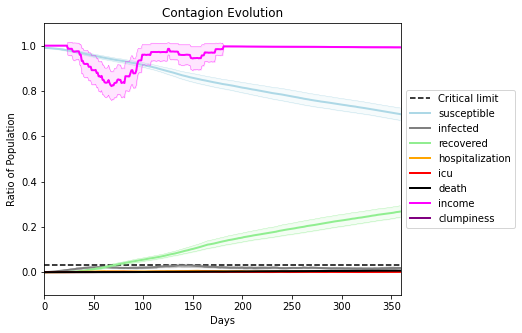

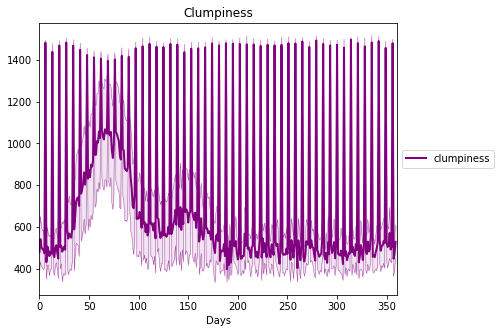

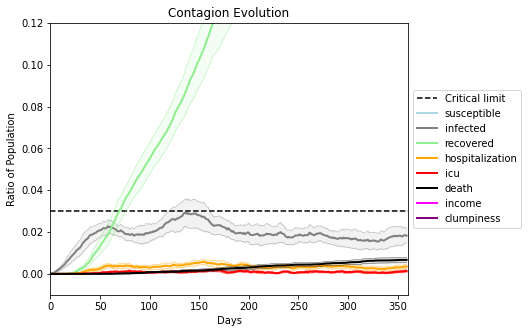

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3456, 3069, 8880, 10, 1075, 7877, 5858, 8545, 6329, 4591, 9625, 9282, 9993, 4606, 712, 3023, 1680, 7292, 9466, 4306]
Average similarity between family members is 0.9458475274434448 at temperature -0.996
Average similarity between family and home is 0.9998587214465664 at temperature -1
Average similarity between students and their classroom is 0.9135851960972722 at temperature -0.996
Average classroom occupancy is 1.6290322580645162 and number classrooms is 186
Average similarity between workers is 0.9196267564018022 at temperature -0.996
Average office occupancy is 3.3230769230769233 and number offices is 195
Average friend similarity for adults: 0.8514727890039773 for kids: 0.729017533418313
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5901860676821953
avg restaurant similarity 0.6129264137109168
avg restaurant similarity 0.6078953387762218
avg restaurant similarity 0.6023603854852985
avg restaurant similarity 0.6632992647834933
avg restaurant similarity 0.639869265367066
avg restaurant similarity 0.6230675717742008
avg restaurant similarity 0.6838789557690548
avg restaurant similarity 0.6421952496311355
avg restaurant similarity 0.6402964284407526
avg restaurant similarity 0.664618065514485
avg restaurant similarity 0.6105681604139723
avg restaurant similarity 0.654609496773168
avg restaurant similarity 0.6039550345098756
avg restaurant similarity 0.6430802265181381
avg restaurant similarity 0.6023794873520812
avg restaurant similarity 0.628061578655999
avg restaurant similarity 0.6351952010339271
avg restaurant similarity 0.6246365234600589
avg restaurant similarity 0.63693739965284
avg restaurant similarity 0.6470599401056104
avg restaurant similarity 0.6344602709856618
avg restaurant s

avg restaurant similarity 0.6314581948285101
avg restaurant similarity 0.6362623036171603
avg restaurant similarity 0.6087149533598653
avg restaurant similarity 0.6448886065034318
avg restaurant similarity 0.6868485790064436
avg restaurant similarity 0.5756520833660681
avg restaurant similarity 0.6517326561472833
avg restaurant similarity 0.623669980694189
avg restaurant similarity 0.633579649694471
avg restaurant similarity 0.5906523904510766
avg restaurant similarity 0.6845158627073793
avg restaurant similarity 0.6955050995881722
avg restaurant similarity 0.6601987785843614
avg restaurant similarity 0.65308808206472
avg restaurant similarity 0.6177276383566713
avg restaurant similarity 0.6593544433333915
avg restaurant similarity 0.6482751220998357
avg restaurant similarity 0.638075933670856
avg restaurant similarity 0.6312574414042015
avg restaurant similarity 0.6736748546648496
avg restaurant similarity 0.6402722184755658
avg restaurant similarity 0.6276927046255993
avg restaurant 

Average similarity between workers is 0.9378846712082076 at temperature -0.996
Average office occupancy is 3.358974358974359 and number offices is 195
Average friend similarity for adults: 0.8526651413952493 for kids: 0.7183997857266409
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6746569359727318
avg restaurant similarity 0.6128810757346508
avg restaurant similarity 0.6138963770775703
avg restaurant similarity 0.6266559145711853
avg restaurant similarity 0.5809231155280432
avg restaurant similarity 0.6578750546820127
avg restaurant similarity 0.6582621625868196
avg restaurant similarity 0.6744752182518227
avg restaurant similarity 0.597024470048349
avg restaurant similarity 0.6223465719131652
avg restaurant similarity 0.5836391298652716
avg restaurant similarity 0.6740130724647031
avg restaurant similarity 0.6476164825221389
avg restaurant similarity 0.5920653927126764
avg restaurant similarity 0.5892384882924036
avg restaurant similarity 0.611589105149935
avg restaurant similarity 0.6233900576981323
avg restaurant similarity 0.6039063311853151
avg restaurant similarity 0.6365062314561695
avg restaurant similarity 0.6397138132035396
avg restaurant similarity 0.6573688209387278
avg restaurant similarity 0.6098947913255806
avg restaura

avg restaurant similarity 0.5672387644558557
avg restaurant similarity 0.5834760491677332
avg restaurant similarity 0.6257259033905712
avg restaurant similarity 0.626010712521922
avg restaurant similarity 0.6227740368652215
avg restaurant similarity 0.6632989417166483
avg restaurant similarity 0.6304132230331302
avg restaurant similarity 0.6417104117068461
avg restaurant similarity 0.6436691212204679
avg restaurant similarity 0.617970466711935
avg restaurant similarity 0.5861847345886594
avg restaurant similarity 0.6018062614531976
avg restaurant similarity 0.6336716193847047
avg restaurant similarity 0.5623417345262711
avg restaurant similarity 0.6360514561196882
avg restaurant similarity 0.6279179364965294
avg restaurant similarity 0.6426737930779316
avg restaurant similarity 0.6326276538254277
avg restaurant similarity 0.6113636847234067
avg restaurant similarity 0.6184385312145244
avg restaurant similarity 0.5468770658385853
avg restaurant similarity 0.6200910815207313
avg restaura

Average similarity between workers is 0.922792768813086 at temperature -0.996
Average office occupancy is 3.398936170212766 and number offices is 188
Average friend similarity for adults: 0.8536538075631089 for kids: 0.7479083248011041
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6326311481883499
avg restaurant similarity 0.6071222035113987
avg restaurant similarity 0.5595661398432552
avg restaurant similarity 0.6376825702389366
avg restaurant similarity 0.6566904820535823
avg restaurant similarity 0.6159593322981737
avg restaurant similarity 0.616556250154241
avg restaurant similarity 0.6572641384155269
avg restaurant similarity 0.6465210199860226
avg restaurant similarity 0.6002389511350252
avg restaurant similarity 0.5968796627518976
avg restaurant similarity 0.6032488102063631
avg restaurant similarity 0.6152989300924498
avg restaurant similarity 0.6457765856457583
avg restaurant similarity 0.5770424627029983
avg restaurant similarity 0.6267065406840425
avg restaurant similarity 0.6181352048467416
avg restaurant similarity 0.5971770801155754
avg restaurant similarity 0.659246716172654
avg restaurant similarity 0.6255212989668104
avg restaurant similarity 0.620536671448654
avg restaurant similarity 0.6170834588733746
avg restauran

avg restaurant similarity 0.6591357653858417
avg restaurant similarity 0.6020850919919479
avg restaurant similarity 0.6571201944180896
avg restaurant similarity 0.6088577204210127
avg restaurant similarity 0.5929091578062425
avg restaurant similarity 0.6131850137615759
avg restaurant similarity 0.6028932559714161
avg restaurant similarity 0.5403679648563768
avg restaurant similarity 0.6191492480510541
avg restaurant similarity 0.6226719305555982
avg restaurant similarity 0.5364371041298067
avg restaurant similarity 0.5662923808308995
avg restaurant similarity 0.6154653842925951
avg restaurant similarity 0.5748377762513164
avg restaurant similarity 0.6145770068946622
avg restaurant similarity 0.642837097777312
avg restaurant similarity 0.6065666101950804
avg restaurant similarity 0.6344404062827493
avg restaurant similarity 0.5904226285155393
avg restaurant similarity 0.5989472661133881
avg restaurant similarity 0.5821594556012867
avg restaurant similarity 0.6185707667693144
avg restaur

Average similarity between workers is 0.9239889096096632 at temperature -0.996
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8505811577395616 for kids: 0.7324266235004081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.6255187633255267
avg restaurant similarity 0.5593811377629159
avg restaurant similarity 0.5691010967035588
avg restaurant similarity 0.581650570474062
avg restaurant similarity 0.639620476003892
avg restaurant similarity 0.6246268305814893
avg restaurant similarity 0.6073862684078416
avg restaurant similarity 0.5821458880071211
avg restaurant similarity 0.5690065221159328
avg restaurant similarity 0.6433201851700752
avg restaurant similarity 0.6545886677617386
avg restaurant similarity 0.5914473357288365
avg restaurant similarity 0.5893530825238479
avg restaurant similarity 0.6085255598579806
avg restaurant similarity 0.6372432350993453
avg restaurant similarity 0.5648896647966445
avg restaurant similarity 0.5908782280979298
avg restaurant similarity 0.6334992689863395
avg restaurant similarity 0.635971395383222
avg restaurant similarity 0.5728338210454026
avg restaurant similarity 0.5478623454231784
avg restaurant similarity 0.65012786015143
avg restaurant 

avg restaurant similarity 0.6198490326911246
avg restaurant similarity 0.6337278190838642
avg restaurant similarity 0.642356471543824
avg restaurant similarity 0.5976915476410866
avg restaurant similarity 0.6411024000324875
avg restaurant similarity 0.586580285730473
avg restaurant similarity 0.5945817373471788
avg restaurant similarity 0.6005121407784907
avg restaurant similarity 0.5708822910070707
avg restaurant similarity 0.5791705736677116
avg restaurant similarity 0.5874716019325421
avg restaurant similarity 0.6279128533238749
avg restaurant similarity 0.5979678048268973
avg restaurant similarity 0.5987759089728998
avg restaurant similarity 0.5632561279635776
avg restaurant similarity 0.600780440445107
avg restaurant similarity 0.5887010670263788
avg restaurant similarity 0.5778438417762045
avg restaurant similarity 0.6267931480710366
avg restaurant similarity 0.5774672342720141
avg restaurant similarity 0.6423560221302126
avg restaurant similarity 0.6635127013184289
avg restauran

Average similarity between workers is 0.9373975697207899 at temperature -0.996
Average office occupancy is 3.393782383419689 and number offices is 193
Average friend similarity for adults: 0.8556887646690392 for kids: 0.7266992917791857
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6422893798605785
avg restaurant similarity 0.6122763841957268
avg restaurant similarity 0.6140707839778253
avg restaurant similarity 0.5542245184407348
avg restaurant similarity 0.581635148071027
avg restaurant similarity 0.603379070522318
avg restaurant similarity 0.621917806865912
avg restaurant similarity 0.6170604710755316
avg restaurant similarity 0.5983311892524148
avg restaurant similarity 0.6173816475298826
avg restaurant similarity 0.5744517727545677
avg restaurant similarity 0.5914883140496487
avg restaurant similarity 0.567249840431561
avg restaurant similarity 0.6184378381519203
avg restaurant similarity 0.5949403159121223
avg restaurant similarity 0.602040708231327
avg restaurant similarity 0.6502975448400906
avg restaurant similarity 0.6332063701981853
avg restaurant similarity 0.5897668010323313
avg restaurant similarity 0.6466740375048006
avg restaurant similarity 0.6427484474537691
avg restaurant similarity 0.5935857062864811
avg restaurant 

avg restaurant similarity 0.6043572483622487
avg restaurant similarity 0.5803881555749246
avg restaurant similarity 0.604231536736477
avg restaurant similarity 0.6254552804530602
avg restaurant similarity 0.5698116614703493
avg restaurant similarity 0.6151104222235803
avg restaurant similarity 0.6083398926234215
avg restaurant similarity 0.6477201892947848
avg restaurant similarity 0.5681698991720368
avg restaurant similarity 0.6144908947622616
avg restaurant similarity 0.5923683415361238
avg restaurant similarity 0.5948928932584391
avg restaurant similarity 0.6051977668922139
avg restaurant similarity 0.5797513009548101
avg restaurant similarity 0.6034529132859409
avg restaurant similarity 0.6132422695147526
avg restaurant similarity 0.566923411222131
avg restaurant similarity 0.6203458817527542
avg restaurant similarity 0.6652792243032035
avg restaurant similarity 0.589901076670974
avg restaurant similarity 0.5640385081223994
avg restaurant similarity 0.5951939015195294
avg restauran

Average similarity between workers is 0.9135834382766127 at temperature -0.996
Average office occupancy is 3.5105263157894737 and number offices is 190
Average friend similarity for adults: 0.8572607527498206 for kids: 0.7335989277250378
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5903004425067425
avg restaurant similarity 0.592273319418919
avg restaurant similarity 0.6491967390553168
avg restaurant similarity 0.6248417077128922
avg restaurant similarity 0.5905875527206247
avg restaurant similarity 0.5966128078394739
avg restaurant similarity 0.5949422914957869
avg restaurant similarity 0.6334674597797263
avg restaurant similarity 0.5611799832041473
avg restaurant similarity 0.6300376423515286
avg restaurant similarity 0.587394416567048
avg restaurant similarity 0.6437911414220874
avg restaurant similarity 0.5992637435570902
avg restaurant similarity 0.5847592133931114
avg restaurant similarity 0.625497610900032
avg restaurant similarity 0.6321514911585576
avg restaurant similarity 0.6190493174072241
avg restaurant similarity 0.6059956548860244
avg restaurant similarity 0.6064967041317584
avg restaurant similarity 0.6291863919796035
avg restaurant similarity 0.6067613797064103
avg restaurant similarity 0.6509801844840128
avg restauran

avg restaurant similarity 0.6084985803097738
avg restaurant similarity 0.5866311029300821
avg restaurant similarity 0.6419642281414513
avg restaurant similarity 0.6233287218456747
avg restaurant similarity 0.6392658878263534
avg restaurant similarity 0.6129292052571407
avg restaurant similarity 0.623964332290646
avg restaurant similarity 0.6569661746654639
avg restaurant similarity 0.6153757035296635
avg restaurant similarity 0.6305487479214581
avg restaurant similarity 0.5917595004927844
avg restaurant similarity 0.6172592944280375
avg restaurant similarity 0.6214678358304991
avg restaurant similarity 0.6527990074737066
avg restaurant similarity 0.6181428747730235
avg restaurant similarity 0.6238623273305733
avg restaurant similarity 0.6630289858767531
avg restaurant similarity 0.6103247601505113
avg restaurant similarity 0.6409228131951383
avg restaurant similarity 0.6743521882239313
avg restaurant similarity 0.6281574698141241
avg restaurant similarity 0.5942077529900335
avg restaur

Average similarity between workers is 0.937673456890153 at temperature -0.996
Average office occupancy is 3.4293193717277486 and number offices is 191
Average friend similarity for adults: 0.8646175420407478 for kids: 0.7404393732564649
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6697529351086742
avg restaurant similarity 0.6301224078464114
avg restaurant similarity 0.6029536716897234
avg restaurant similarity 0.6294365050014324
avg restaurant similarity 0.600765383315466
avg restaurant similarity 0.6740729825147982
avg restaurant similarity 0.6438640263648747
avg restaurant similarity 0.6176674320523677
avg restaurant similarity 0.6652621651271188
avg restaurant similarity 0.5912460502485318
avg restaurant similarity 0.6276752279644724
avg restaurant similarity 0.6330791825991353
avg restaurant similarity 0.682353726586997
avg restaurant similarity 0.7022336402804105
avg restaurant similarity 0.6684370859328004
avg restaurant similarity 0.6169159724977474
avg restaurant similarity 0.6572976154788949
avg restaurant similarity 0.7043291705206963
avg restaurant similarity 0.6449611755545015
avg restaurant similarity 0.6792435128002156
avg restaurant similarity 0.6181688254322899
avg restaurant similarity 0.6647332623855574
avg restaura

avg restaurant similarity 0.620833689786447
avg restaurant similarity 0.6770308999688648
avg restaurant similarity 0.6767189110060776
avg restaurant similarity 0.683922257896628
avg restaurant similarity 0.658282160810572
avg restaurant similarity 0.606468839796026
avg restaurant similarity 0.6015118251123474
avg restaurant similarity 0.5946232225386677
avg restaurant similarity 0.5933137689315495
avg restaurant similarity 0.6457266376933913
avg restaurant similarity 0.6195262019989921
avg restaurant similarity 0.6643508868367696
avg restaurant similarity 0.6141440739191681
avg restaurant similarity 0.6565600766152443
avg restaurant similarity 0.627817991632964
avg restaurant similarity 0.6414123581051687
avg restaurant similarity 0.6452130036137788
avg restaurant similarity 0.5956386224942339
avg restaurant similarity 0.6066724993417482
avg restaurant similarity 0.624184944955628
avg restaurant similarity 0.6096501721386745
avg restaurant similarity 0.5849647880434349
avg restaurant s

Average similarity between workers is 0.9282153298964596 at temperature -0.996
Average office occupancy is 3.3385416666666665 and number offices is 192
Average friend similarity for adults: 0.8446980485705695 for kids: 0.7323940447807
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5930659772391992
avg restaurant similarity 0.6708778682834556
avg restaurant similarity 0.6601975017430016
avg restaurant similarity 0.6208621338809086
avg restaurant similarity 0.6360128483163061
avg restaurant similarity 0.5978684171186877
avg restaurant similarity 0.6308134059520873
avg restaurant similarity 0.6112853306721051
avg restaurant similarity 0.6412521676721941
avg restaurant similarity 0.6351452562583887
avg restaurant similarity 0.6266289777312449
avg restaurant similarity 0.641460006175549
avg restaurant similarity 0.6291443867781881
avg restaurant similarity 0.6250433630242227
avg restaurant similarity 0.6485991400239113
avg restaurant similarity 0.6096409668467304
avg restaurant similarity 0.5862146271488593
avg restaurant similarity 0.6133354381517822
avg restaurant similarity 0.6239779370140958
avg restaurant similarity 0.5854283227126409
avg restaurant similarity 0.6214055163223996
avg restaurant similarity 0.6329945599489428
avg restaur

avg restaurant similarity 0.6718217748786756
avg restaurant similarity 0.6506056296572796
avg restaurant similarity 0.6687257555910086
avg restaurant similarity 0.5707211248323747
avg restaurant similarity 0.5761210687589071
avg restaurant similarity 0.6163262293980536
avg restaurant similarity 0.587583414565109
avg restaurant similarity 0.6351083966203329
avg restaurant similarity 0.6362730380015568
avg restaurant similarity 0.6903445607490492
avg restaurant similarity 0.61879669263296
avg restaurant similarity 0.6169057122402413
avg restaurant similarity 0.6289275005911665
avg restaurant similarity 0.6565193835089154
avg restaurant similarity 0.5707490380613681
avg restaurant similarity 0.6460204989096854
avg restaurant similarity 0.6553582754128386
avg restaurant similarity 0.6224033171035495
avg restaurant similarity 0.625162878020029
avg restaurant similarity 0.6313625181427056
avg restaurant similarity 0.6270345644781435
avg restaurant similarity 0.6104511069292264
avg restaurant

Average similarity between workers is 0.9257629548791576 at temperature -0.996
Average office occupancy is 3.4607329842931938 and number offices is 191
Average friend similarity for adults: 0.8622517522405965 for kids: 0.7313429983506022
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5931140902073806
avg restaurant similarity 0.5931388622578176
avg restaurant similarity 0.6132225959834884
avg restaurant similarity 0.6274937904801527
avg restaurant similarity 0.6162888130364318
avg restaurant similarity 0.638523722243916
avg restaurant similarity 0.588624857274769
avg restaurant similarity 0.559867786894697
avg restaurant similarity 0.5714254384119436
avg restaurant similarity 0.5911652274589023
avg restaurant similarity 0.5607995556698638
avg restaurant similarity 0.57602618302708
avg restaurant similarity 0.5912930760945007
avg restaurant similarity 0.6160425982273494
avg restaurant similarity 0.5935430045292909
avg restaurant similarity 0.5587368591093178
avg restaurant similarity 0.5634238808338242
avg restaurant similarity 0.5968394352453453
avg restaurant similarity 0.5788509351036696
avg restaurant similarity 0.5825486704731726
avg restaurant similarity 0.5889911585953413
avg restaurant similarity 0.5965689706011119
avg restaurant 

avg restaurant similarity 0.6374988362268967
avg restaurant similarity 0.584704347755975
avg restaurant similarity 0.589557177804551
avg restaurant similarity 0.5818510372872615
avg restaurant similarity 0.5619752730291986
avg restaurant similarity 0.5909029108857783
avg restaurant similarity 0.6617033163055227
avg restaurant similarity 0.6223260554695441
avg restaurant similarity 0.5540066232306012
avg restaurant similarity 0.6088697847907977
avg restaurant similarity 0.5814647436068264
avg restaurant similarity 0.5866346922856268
avg restaurant similarity 0.576250149047766
avg restaurant similarity 0.5963279075452582
avg restaurant similarity 0.5638879018487618
avg restaurant similarity 0.5431157672930286
avg restaurant similarity 0.5973885154077427
avg restaurant similarity 0.5528755919305817
avg restaurant similarity 0.6286953818989747
avg restaurant similarity 0.5862640904158003
avg restaurant similarity 0.5826331735021668
avg restaurant similarity 0.5871673418057455
avg restauran

Average similarity between workers is 0.9231406650459255 at temperature -0.996
Average office occupancy is 3.423469387755102 and number offices is 196
Average friend similarity for adults: 0.8641849067981614 for kids: 0.7490426625148124
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.6670868613079388
avg restaurant similarity 0.5779863495561074
avg restaurant similarity 0.598861494650607
avg restaurant similarity 0.6462935668960599
avg restaurant similarity 0.6163579619435762
avg restaurant similarity 0.6266115421038826
avg restaurant similarity 0.6622845109592697
avg restaurant similarity 0.6248295377056038
avg restaurant similarity 0.6176445380096063
avg restaurant similarity 0.61521602686345
avg restaurant similarity 0.6381130221372808
avg restaurant similarity 0.5923804999378226
avg restaurant similarity 0.7133355684405599
avg restaurant similarity 0.6208616448470404
avg restaurant similarity 0.6088434981669149
avg restaurant similarity 0.6563273468475157
avg restaurant similarity 0.6487724401304678
avg restaurant similarity 0.6236441866651836
avg restaurant similarity 0.6001363867164659
avg restaurant similarity 0.6703726838954365
avg restaurant similarity 0.6683636935945452
avg restaurant similarity 0.674406948604144
avg restaurant

avg restaurant similarity 0.7048292166461378
avg restaurant similarity 0.6912183364650588
avg restaurant similarity 0.6459019121429566
avg restaurant similarity 0.6595942835233533
avg restaurant similarity 0.5892506114802688
avg restaurant similarity 0.6771785547451631
avg restaurant similarity 0.6073615422101966
avg restaurant similarity 0.637280527045353
avg restaurant similarity 0.6413062884947742
avg restaurant similarity 0.6477130890788099
avg restaurant similarity 0.6432737831976532
avg restaurant similarity 0.6028004217562244
avg restaurant similarity 0.671815177455979
avg restaurant similarity 0.6321224384706905
avg restaurant similarity 0.6936243232490619
avg restaurant similarity 0.6812032178700771
avg restaurant similarity 0.6484239752723081
avg restaurant similarity 0.6106290289642178
avg restaurant similarity 0.6483173994081601
avg restaurant similarity 0.6388076916868255
avg restaurant similarity 0.6618152047410321
avg restaurant similarity 0.5602678590281226
avg restaura

Average similarity between workers is 0.9347077396823209 at temperature -0.996
Average office occupancy is 3.358974358974359 and number offices is 195
Average friend similarity for adults: 0.8466582417776134 for kids: 0.7316254786767935
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5435442091074613
avg restaurant similarity 0.602091034654881
avg restaurant similarity 0.5928951304185754
avg restaurant similarity 0.6567574707533591
avg restaurant similarity 0.5604655028752643
avg restaurant similarity 0.5517794407617952
avg restaurant similarity 0.5903484050566755
avg restaurant similarity 0.6091556038646571
avg restaurant similarity 0.5855138238127023
avg restaurant similarity 0.6064067706674896
avg restaurant similarity 0.5571120690017395
avg restaurant similarity 0.5873810907921144
avg restaurant similarity 0.5926876383358727
avg restaurant similarity 0.5527311536268736
avg restaurant similarity 0.5953428766500172
avg restaurant similarity 0.5767048001637988
avg restaurant similarity 0.5989037261507536
avg restaurant similarity 0.5635685396701264
avg restaurant similarity 0.6111386769711461
avg restaurant similarity 0.5827372415232076
avg restaurant similarity 0.6128278163493505
avg restaurant similarity 0.5343697989936674
avg restaur

avg restaurant similarity 0.5970710688770551
avg restaurant similarity 0.6135605224484799
avg restaurant similarity 0.5408734536700094
avg restaurant similarity 0.5806071175017019
avg restaurant similarity 0.5610594494271403
avg restaurant similarity 0.5306120924520311
avg restaurant similarity 0.5192539586487241
avg restaurant similarity 0.5476532095114242
avg restaurant similarity 0.6296809934679004
avg restaurant similarity 0.5920180628757857
avg restaurant similarity 0.5562910518541195
avg restaurant similarity 0.6559748977320963
avg restaurant similarity 0.6108694691265535
avg restaurant similarity 0.5490908425510159
avg restaurant similarity 0.6002428308497272
avg restaurant similarity 0.5847146710408878
avg restaurant similarity 0.5971940236707194
avg restaurant similarity 0.5958125136173192
avg restaurant similarity 0.5946053379186842
avg restaurant similarity 0.6706260524209636
avg restaurant similarity 0.609508831923948
avg restaurant similarity 0.6030806945762883
avg restaur

Average similarity between workers is 0.9230221435332012 at temperature -0.996
Average office occupancy is 3.413612565445026 and number offices is 191
Average friend similarity for adults: 0.8500039928331982 for kids: 0.7257088624004309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5309636905737636
avg restaurant similarity 0.5419179122890831
avg restaurant similarity 0.5231059553486419
avg restaurant similarity 0.5629704938432938
avg restaurant similarity 0.6374434406302366
avg restaurant similarity 0.6676060609613061
avg restaurant similarity 0.5918472188596714
avg restaurant similarity 0.620187164102845
avg restaurant similarity 0.6114294120621561
avg restaurant similarity 0.645048174823128
avg restaurant similarity 0.6063564367915569
avg restaurant similarity 0.6290647114192919
avg restaurant similarity 0.5886106877839021
avg restaurant similarity 0.6504768516513215
avg restaurant similarity 0.6242817703749732
avg restaurant similarity 0.5789548060014607
avg restaurant similarity 0.6385885602056384
avg restaurant similarity 0.5793973635200106
avg restaurant similarity 0.6368684384378867
avg restaurant similarity 0.569454081354809
avg restaurant similarity 0.5920219683286766
avg restaurant similarity 0.5757291165543893
avg restauran

avg restaurant similarity 0.572493614606747
avg restaurant similarity 0.682546804239937
avg restaurant similarity 0.5927614813709895
avg restaurant similarity 0.6434452719417487
avg restaurant similarity 0.5825760567016454
avg restaurant similarity 0.5811612937206194
avg restaurant similarity 0.6201417833525821
avg restaurant similarity 0.6062478917293112
avg restaurant similarity 0.6236364930361346
avg restaurant similarity 0.6203725132063379
avg restaurant similarity 0.665969024050327
avg restaurant similarity 0.6022204644129694
avg restaurant similarity 0.6194434460294326
avg restaurant similarity 0.6330160084641316
avg restaurant similarity 0.6030539696889088
avg restaurant similarity 0.5859060401171011
avg restaurant similarity 0.5671860540329127
avg restaurant similarity 0.5276134791633691
avg restaurant similarity 0.5301112225517781
avg restaurant similarity 0.5400656317329169
avg restaurant similarity 0.608948749573301
avg restaurant similarity 0.5661958315386327
avg restaurant

Average similarity between workers is 0.9221255918813783 at temperature -0.996
Average office occupancy is 3.6 and number offices is 190
Average friend similarity for adults: 0.8616457987135314 for kids: 0.7126762592706885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people alloc

avg restaurant similarity 0.6416155172530311
avg restaurant similarity 0.6554976562634605
avg restaurant similarity 0.6706798798706289
avg restaurant similarity 0.6440439564623922
avg restaurant similarity 0.6537546487882588
avg restaurant similarity 0.6179937373972836
avg restaurant similarity 0.6430694478455231
avg restaurant similarity 0.685161125550625
avg restaurant similarity 0.5882871487164512
avg restaurant similarity 0.6239253883414642
avg restaurant similarity 0.6449995483370754
avg restaurant similarity 0.6290354662473299
avg restaurant similarity 0.6163264281028853
avg restaurant similarity 0.6706690002430289
avg restaurant similarity 0.6192713894834664
avg restaurant similarity 0.6525165011228751
avg restaurant similarity 0.6597375223452993
avg restaurant similarity 0.6141958349295439
avg restaurant similarity 0.60635265574246
avg restaurant similarity 0.6540665439248626
avg restaurant similarity 0.6542958118012563
avg restaurant similarity 0.6349182750013749
avg restauran

avg restaurant similarity 0.6087876276672455
avg restaurant similarity 0.5706498348825442
avg restaurant similarity 0.6496394649847068
avg restaurant similarity 0.6342392569355567
avg restaurant similarity 0.6140776136817115
avg restaurant similarity 0.6348303916150054
avg restaurant similarity 0.6284725776063803
avg restaurant similarity 0.6103167471856754
avg restaurant similarity 0.6358513888921291
avg restaurant similarity 0.6289152354044977
avg restaurant similarity 0.6042023300552247
avg restaurant similarity 0.6016772817045035
avg restaurant similarity 0.59136641604663
avg restaurant similarity 0.6004487206779843
avg restaurant similarity 0.6296649930492277
avg restaurant similarity 0.623654253311133
avg restaurant similarity 0.5981852002417295
avg restaurant similarity 0.5998845330445541
avg restaurant similarity 0.587621324711361
avg restaurant similarity 0.5894371056614978
avg restaurant similarity 0.6710618589500051
avg restaurant similarity 0.6531331648448935
avg restaurant

Average similarity between workers is 0.922951896113978 at temperature -0.996
Average office occupancy is 3.5157894736842104 and number offices is 190
Average friend similarity for adults: 0.8593142243973729 for kids: 0.7212089379872375
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of

avg restaurant similarity 0.6387770364640462
avg restaurant similarity 0.5973123809154077
avg restaurant similarity 0.5921616523766493
avg restaurant similarity 0.6035841912523744
avg restaurant similarity 0.5890534938488626
avg restaurant similarity 0.6921843618817851
avg restaurant similarity 0.6290039016774354
avg restaurant similarity 0.6233188266382518
avg restaurant similarity 0.6432814779180172
avg restaurant similarity 0.5883144764680299
avg restaurant similarity 0.6324793295905514
avg restaurant similarity 0.6795166740947638
avg restaurant similarity 0.6656849539264406
avg restaurant similarity 0.6230941848887224
avg restaurant similarity 0.6450912904431815
avg restaurant similarity 0.629120712734381
avg restaurant similarity 0.5988311060670233
avg restaurant similarity 0.5907475589359645
avg restaurant similarity 0.6661258758255229
avg restaurant similarity 0.5858959815096157
avg restaurant similarity 0.6530964221284239
avg restaurant similarity 0.6141380354160683
avg restaur

avg restaurant similarity 0.6306993323176007
avg restaurant similarity 0.6347267817712718
avg restaurant similarity 0.5959588660576414
avg restaurant similarity 0.5928868400706091
avg restaurant similarity 0.639585334848503
avg restaurant similarity 0.6174600525668394
avg restaurant similarity 0.6593398277649777
avg restaurant similarity 0.6745822601953935
avg restaurant similarity 0.6110651233764812
avg restaurant similarity 0.6623606225048813
avg restaurant similarity 0.6614273229932329
avg restaurant similarity 0.621899642883399
avg restaurant similarity 0.5680744921534959
avg restaurant similarity 0.6237545104601848
avg restaurant similarity 0.5973955862383531
avg restaurant similarity 0.6461394484313217
avg restaurant similarity 0.6680199744928145
avg restaurant similarity 0.6451443761879098
avg restaurant similarity 0.5944458705499045
avg restaurant similarity 0.655691667418654
avg restaurant similarity 0.6963496531872453
avg restaurant similarity 0.6250032020261168
avg restauran

Average similarity between workers is 0.9209881194054171 at temperature -0.996
Average office occupancy is 3.3769633507853403 and number offices is 191
Average friend similarity for adults: 0.8501856864545803 for kids: 0.7350546006189275
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5921294574529699
avg restaurant similarity 0.6120980850613916
avg restaurant similarity 0.6050546636846589
avg restaurant similarity 0.6184590863093619
avg restaurant similarity 0.5585425051464669
avg restaurant similarity 0.5358443937326254
avg restaurant similarity 0.5253662195166613
avg restaurant similarity 0.5531851536349337
avg restaurant similarity 0.5519872748036484
avg restaurant similarity 0.5374094626320072
avg restaurant similarity 0.546337868787418
avg restaurant similarity 0.6105251696920295
avg restaurant similarity 0.6179989787614029
avg restaurant similarity 0.5275117477973165
avg restaurant similarity 0.5758511289786765
avg restaurant similarity 0.5219379398574436
avg restaurant similarity 0.5020126635029896
avg restaurant similarity 0.5402729174064588
avg restaurant similarity 0.5204525765560998
avg restaurant similarity 0.5353716607762308
avg restaurant similarity 0.6306940237040587
avg restaurant similarity 0.4913483115399487
avg restaur

avg restaurant similarity 0.6031818017678728
avg restaurant similarity 0.5169564505542301
avg restaurant similarity 0.5107828435997969
avg restaurant similarity 0.5640318980164936
avg restaurant similarity 0.6240757577702458
avg restaurant similarity 0.5516192823818411
avg restaurant similarity 0.6160142194610271
avg restaurant similarity 0.48869757879553194
avg restaurant similarity 0.5581292335186524
avg restaurant similarity 0.45670049349340963
avg restaurant similarity 0.4877783826035437
avg restaurant similarity 0.5394785586014976
avg restaurant similarity 0.6101407671879032
avg restaurant similarity 0.493357893928457
avg restaurant similarity 0.5599536515955915
avg restaurant similarity 0.6091089131102821
avg restaurant similarity 0.5667821280097257
avg restaurant similarity 0.5706666961113501
avg restaurant similarity 0.522220980279318
avg restaurant similarity 0.5521134098367125
avg restaurant similarity 0.52941621922193
avg restaurant similarity 0.5293287978571931
avg restaura

Average similarity between workers is 0.9310454076781441 at temperature -0.996
Average office occupancy is 3.287179487179487 and number offices is 195
Average friend similarity for adults: 0.8457633823651245 for kids: 0.7260027417244987
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5850471039424472
avg restaurant similarity 0.6152946489925224
avg restaurant similarity 0.5973069192105311
avg restaurant similarity 0.6351682578743373
avg restaurant similarity 0.6393713657628921
avg restaurant similarity 0.6176364239251199
avg restaurant similarity 0.6062338889079634
avg restaurant similarity 0.6095400464048952
avg restaurant similarity 0.6403561543430359
avg restaurant similarity 0.5982939585798639
avg restaurant similarity 0.5939511974398651
avg restaurant similarity 0.5915418702682652
avg restaurant similarity 0.5986393156304572
avg restaurant similarity 0.6362038092118854
avg restaurant similarity 0.6065903579158783
avg restaurant similarity 0.6406185686517057
avg restaurant similarity 0.5952028729197496
avg restaurant similarity 0.6011372567822317
avg restaurant similarity 0.5699165939837016
avg restaurant similarity 0.6341635362979998
avg restaurant similarity 0.5801197668860444
avg restaurant similarity 0.5605818072780991
avg restau

avg restaurant similarity 0.6493076898741846
avg restaurant similarity 0.6580695469066054
avg restaurant similarity 0.5951136853729233
avg restaurant similarity 0.6165912469171279
avg restaurant similarity 0.6421572641977377
avg restaurant similarity 0.6033494525916342
avg restaurant similarity 0.5818564511669864
avg restaurant similarity 0.6058335117799505
avg restaurant similarity 0.6001101672091697
avg restaurant similarity 0.6511842300875329
avg restaurant similarity 0.5898895214576543
avg restaurant similarity 0.5860193047579623
avg restaurant similarity 0.6086018923621485
avg restaurant similarity 0.6395815259238219
avg restaurant similarity 0.6102962732249136
avg restaurant similarity 0.6013525944249183
avg restaurant similarity 0.576481132700157
avg restaurant similarity 0.6180342484984009
avg restaurant similarity 0.6021847404955651
avg restaurant similarity 0.6072020276988853
avg restaurant similarity 0.678833348459812
avg restaurant similarity 0.6930710903137928
avg restaura

Average similarity between workers is 0.9395601453229054 at temperature -0.996
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8581730230784337 for kids: 0.7495558604209469
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6226434587152989
avg restaurant similarity 0.5735934896246192
avg restaurant similarity 0.6595191587150475
avg restaurant similarity 0.6523263860880893
avg restaurant similarity 0.6310249198740507
avg restaurant similarity 0.6094771393929576
avg restaurant similarity 0.6673211312581017
avg restaurant similarity 0.6370452404086705
avg restaurant similarity 0.6491744199019476
avg restaurant similarity 0.6627498200437956
avg restaurant similarity 0.6023890812570608
avg restaurant similarity 0.6457995238608351
avg restaurant similarity 0.6067118145277404
avg restaurant similarity 0.6113053821141731
avg restaurant similarity 0.5850821094590813
avg restaurant similarity 0.6154626172464339
avg restaurant similarity 0.638153413108202
avg restaurant similarity 0.6431874686501886
avg restaurant similarity 0.6602057339238847
avg restaurant similarity 0.5809103452512937
avg restaurant similarity 0.6318852118968012
avg restaurant similarity 0.6135098833405005
avg restaur

avg restaurant similarity 0.5443092016259
avg restaurant similarity 0.6082907806431885
avg restaurant similarity 0.5795629032630488
avg restaurant similarity 0.6211613013174474
avg restaurant similarity 0.6269836432747238
avg restaurant similarity 0.5551254362855206
avg restaurant similarity 0.6203110692026891
avg restaurant similarity 0.6885928613817838
avg restaurant similarity 0.6307554349698437
avg restaurant similarity 0.6012501076503538
avg restaurant similarity 0.5619955717276252
avg restaurant similarity 0.6542263983789361
avg restaurant similarity 0.6594019875125621
avg restaurant similarity 0.5766221810050172
avg restaurant similarity 0.6186221847666286
avg restaurant similarity 0.5808498621443583
avg restaurant similarity 0.6357141306736752
avg restaurant similarity 0.6306697235211104
avg restaurant similarity 0.6327331618005536
avg restaurant similarity 0.6225228618296974
avg restaurant similarity 0.662316655058506
avg restaurant similarity 0.634729281726765
avg restaurant 

Average similarity between workers is 0.9245485926149168 at temperature -0.996
Average office occupancy is 3.357894736842105 and number offices is 190
Average friend similarity for adults: 0.8533002478805518 for kids: 0.744705713214728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6274402213136125
avg restaurant similarity 0.6941586437983007
avg restaurant similarity 0.6021214236098994
avg restaurant similarity 0.678632026614319
avg restaurant similarity 0.6922523168309095
avg restaurant similarity 0.6428509675956938
avg restaurant similarity 0.6677760853509594
avg restaurant similarity 0.6552180958229084
avg restaurant similarity 0.6864517454412867
avg restaurant similarity 0.682829207291216
avg restaurant similarity 0.7201106892272572
avg restaurant similarity 0.6654419743245139
avg restaurant similarity 0.6319723929281191
avg restaurant similarity 0.6210744874005691
avg restaurant similarity 0.6964945296562599
avg restaurant similarity 0.6447806848244206
avg restaurant similarity 0.7267264839822871
avg restaurant similarity 0.6784995605791104
avg restaurant similarity 0.6862424574024002
avg restaurant similarity 0.6829221465463137
avg restaurant similarity 0.6946038618725953
avg restaurant similarity 0.6728387183316635
avg restaura

avg restaurant similarity 0.6798385823574776
avg restaurant similarity 0.6853614282932955
avg restaurant similarity 0.7098425941421208
avg restaurant similarity 0.6414883212171457
avg restaurant similarity 0.6706088603828851
avg restaurant similarity 0.6907993204621041
avg restaurant similarity 0.6731012255403308
avg restaurant similarity 0.664125885758784
avg restaurant similarity 0.676315048727176
avg restaurant similarity 0.6918419125095311
avg restaurant similarity 0.6707998087224566
avg restaurant similarity 0.7178158614654789
avg restaurant similarity 0.6555787430456252
avg restaurant similarity 0.6463480773549923
avg restaurant similarity 0.6489100306547346
avg restaurant similarity 0.606781987453743
avg restaurant similarity 0.7069296140832203
avg restaurant similarity 0.7157326779428569
avg restaurant similarity 0.6682152849328159
avg restaurant similarity 0.6317943221077236
avg restaurant similarity 0.6920250320936941
avg restaurant similarity 0.6488547215388363
avg restauran

Average similarity between workers is 0.9395790512122875 at temperature -0.996
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.8579546239159527 for kids: 0.728952816127524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6403916003490603
avg restaurant similarity 0.6577440587303399
avg restaurant similarity 0.5654230209263587
avg restaurant similarity 0.5950793293540046
avg restaurant similarity 0.586425456493832
avg restaurant similarity 0.6046928143267974
avg restaurant similarity 0.5741053818888696
avg restaurant similarity 0.615136099136649
avg restaurant similarity 0.6215253271447573
avg restaurant similarity 0.6740067218072925
avg restaurant similarity 0.5373050861365154
avg restaurant similarity 0.5410552171746875
avg restaurant similarity 0.6265322992938704
avg restaurant similarity 0.6242734040628084
avg restaurant similarity 0.6040042861578729
avg restaurant similarity 0.6032642665891579
avg restaurant similarity 0.6119032996121828
avg restaurant similarity 0.6016866986112145
avg restaurant similarity 0.591603411995336
avg restaurant similarity 0.5628456481775987
avg restaurant similarity 0.5562035813280066
avg restaurant similarity 0.6175638543472516
avg restauran

avg restaurant similarity 0.686209810771623
avg restaurant similarity 0.6104263167676942
avg restaurant similarity 0.6872921322544776
avg restaurant similarity 0.6216968267998428
avg restaurant similarity 0.6597527544795033
avg restaurant similarity 0.6232270557351386
avg restaurant similarity 0.6260975030948712
avg restaurant similarity 0.6013577967840497
avg restaurant similarity 0.6113831322134925
avg restaurant similarity 0.6727198834939125
avg restaurant similarity 0.5859650014172588
avg restaurant similarity 0.6277221125216979
avg restaurant similarity 0.6474704315368232
avg restaurant similarity 0.6090291427708029
avg restaurant similarity 0.6151934549514195
avg restaurant similarity 0.6175891823367188
avg restaurant similarity 0.6148126007267171
avg restaurant similarity 0.5987755298931595
avg restaurant similarity 0.6187555460522788
avg restaurant similarity 0.6566112516755307
avg restaurant similarity 0.5627457997345997
avg restaurant similarity 0.6025227883223496
avg restaur

Average similarity between workers is 0.9159866758635357 at temperature -0.996
Average office occupancy is 3.3678756476683938 and number offices is 193
Average friend similarity for adults: 0.8501429519661192 for kids: 0.7223337783095578
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total o

avg restaurant similarity 0.5957006019486376
avg restaurant similarity 0.6324542821896824
avg restaurant similarity 0.583212149488843
avg restaurant similarity 0.579628674974001
avg restaurant similarity 0.5994748591366537
avg restaurant similarity 0.6328004342939607
avg restaurant similarity 0.5776675885184661
avg restaurant similarity 0.6174741603877799
avg restaurant similarity 0.6132575067865125
avg restaurant similarity 0.5552613575307687
avg restaurant similarity 0.646110749104217
avg restaurant similarity 0.5681471140809231
avg restaurant similarity 0.6072185451006334
avg restaurant similarity 0.6281172972916061
avg restaurant similarity 0.6190667630843792
avg restaurant similarity 0.643279826518217
avg restaurant similarity 0.6100906617801278
avg restaurant similarity 0.6579187904385561
avg restaurant similarity 0.6086845791319511
avg restaurant similarity 0.6476783715901095
avg restaurant similarity 0.6282503985995231
avg restaurant similarity 0.5827369359637586
avg restaurant

avg restaurant similarity 0.5659570783071871
avg restaurant similarity 0.6033557565908875
avg restaurant similarity 0.5273479463337072
avg restaurant similarity 0.623099311817792
avg restaurant similarity 0.6467877037010435
avg restaurant similarity 0.6389599164518992
avg restaurant similarity 0.6430735038008777
avg restaurant similarity 0.5883485425125421
avg restaurant similarity 0.6147128633060831
avg restaurant similarity 0.6042070369052744
avg restaurant similarity 0.5869208707265213
avg restaurant similarity 0.6088938657963899
avg restaurant similarity 0.5796082892758754
avg restaurant similarity 0.5850589649218169
avg restaurant similarity 0.6635533291898077
avg restaurant similarity 0.5930009587890998
avg restaurant similarity 0.6057468818740469
avg restaurant similarity 0.6173611171537923
avg restaurant similarity 0.5860544628657732
avg restaurant similarity 0.5844890400805238
avg restaurant similarity 0.5610882673873744
avg restaurant similarity 0.6115005723258409
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

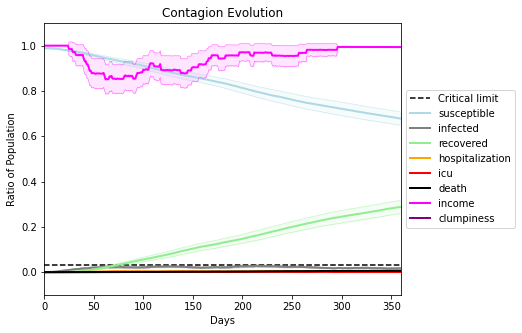

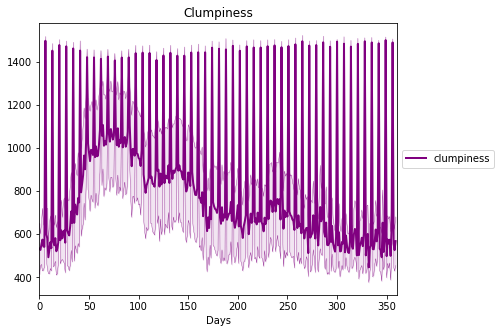

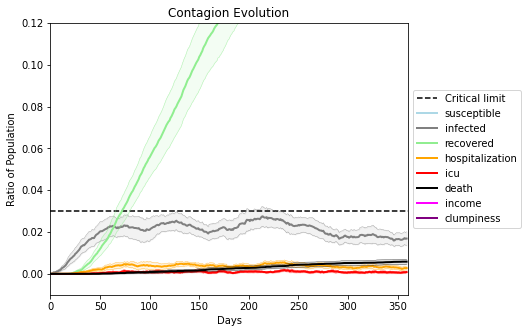

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7876, 2216, 5042, 8610, 2792, 8528, 8680, 5311, 6468, 1681, 5772, 4013, 3125, 2268, 7201, 864, 7205, 6976, 8354, 9025]
Average similarity between family members is 0.937544130028062 at temperature -0.995
Average similarity between family and home is 0.9998604755871522 at temperature -1
Average similarity between students and their classroom is 0.8719900533558562 at temperature -0.995
Average classroom occupancy is 1.7028571428571428 and number classrooms is 175
Average similarity between workers is 0.8903441648729625 at temperature -0.995
Average office occupancy is 3.4114583333333335 and number offices is 192
Average friend similarity for adults: 0.8486664257310884 for kids: 0.725156739767395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5855700706235658
avg restaurant similarity 0.535279178117166
avg restaurant similarity 0.540187316264017
avg restaurant similarity 0.580032357540835
avg restaurant similarity 0.4960500644010669
avg restaurant similarity 0.5543810093240713
avg restaurant similarity 0.5914897445715921
avg restaurant similarity 0.5714539617976178
avg restaurant similarity 0.5632032058222974
avg restaurant similarity 0.5781820951716404
avg restaurant similarity 0.5249133166446023
avg restaurant similarity 0.5723835488605216
avg restaurant similarity 0.5701357179811324
avg restaurant similarity 0.5470318779908867
avg restaurant similarity 0.5659531799556499
avg restaurant similarity 0.5773854052346473
avg restaurant similarity 0.5659811310529062
avg restaurant similarity 0.5806260587800381
avg restaurant similarity 0.5219880664151335
avg restaurant similarity 0.5193418483827109
avg restaurant similarity 0.5160121390169564
avg restaurant similarity 0.5810448749954406
avg restauran

avg restaurant similarity 0.5375546985241334
avg restaurant similarity 0.5965405068892791
avg restaurant similarity 0.5583439354488076
avg restaurant similarity 0.538922996989818
avg restaurant similarity 0.5448059062967608
avg restaurant similarity 0.549266627203563
avg restaurant similarity 0.5923446055102227
avg restaurant similarity 0.5759759993910607
avg restaurant similarity 0.5376289049795682
avg restaurant similarity 0.5801907372045396
avg restaurant similarity 0.5631421259655497
avg restaurant similarity 0.5669922017128002
avg restaurant similarity 0.5752153854695002
avg restaurant similarity 0.5813540295210776
avg restaurant similarity 0.5085360389024034
avg restaurant similarity 0.5130361350868164
avg restaurant similarity 0.5632192638068753
avg restaurant similarity 0.5243611103503892
avg restaurant similarity 0.537966150489073
avg restaurant similarity 0.5565146515138553
avg restaurant similarity 0.5982974810427956
avg restaurant similarity 0.5741168313005819
avg restauran

Average similarity between workers is 0.8959911249670991 at temperature -0.995
Average office occupancy is 3.4536082474226806 and number offices is 194
Average friend similarity for adults: 0.8496189108830029 for kids: 0.7256480199293112
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5707911532509622
avg restaurant similarity 0.6016702207164455
avg restaurant similarity 0.6027836869853073
avg restaurant similarity 0.6097271124814605
avg restaurant similarity 0.619082572330831
avg restaurant similarity 0.5692973465259468
avg restaurant similarity 0.5749315552890797
avg restaurant similarity 0.577496655300675
avg restaurant similarity 0.5857893629654408
avg restaurant similarity 0.604974181760235
avg restaurant similarity 0.5283841760553575
avg restaurant similarity 0.6011748712868966
avg restaurant similarity 0.5676381066026667
avg restaurant similarity 0.5839863977086569
avg restaurant similarity 0.5731047953633935
avg restaurant similarity 0.6015910626724882
avg restaurant similarity 0.5665024735386892
avg restaurant similarity 0.5519796198377869
avg restaurant similarity 0.6435396002780591
avg restaurant similarity 0.5809964436109087
avg restaurant similarity 0.5556425199326868
avg restaurant similarity 0.5483284196745775
avg restauran

avg restaurant similarity 0.6001418752804185
avg restaurant similarity 0.5624468978105087
avg restaurant similarity 0.5760554867752383
avg restaurant similarity 0.6198292853767633
avg restaurant similarity 0.5662407650087034
avg restaurant similarity 0.5579472107568098
avg restaurant similarity 0.5536508362067073
avg restaurant similarity 0.5464861962628549
avg restaurant similarity 0.5889833850021418
avg restaurant similarity 0.5737108382547047
avg restaurant similarity 0.5546862850024123
avg restaurant similarity 0.6047999324307493
avg restaurant similarity 0.5480961656415613
avg restaurant similarity 0.5688450074565684
avg restaurant similarity 0.5762280994230516
avg restaurant similarity 0.5546946149991862
avg restaurant similarity 0.6155907894949585
avg restaurant similarity 0.6096445042242834
avg restaurant similarity 0.5852027076733658
avg restaurant similarity 0.5608927292083878
avg restaurant similarity 0.5752489745881906
avg restaurant similarity 0.576524725730318
avg restaur

Average similarity between workers is 0.898660156118023 at temperature -0.995
Average office occupancy is 3.4123711340206184 and number offices is 194
Average friend similarity for adults: 0.8533841167362562 for kids: 0.7182925449376936
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.6411106318403533
avg restaurant similarity 0.5615221773005452
avg restaurant similarity 0.5998229083118157
avg restaurant similarity 0.5396959170864505
avg restaurant similarity 0.587266953740445
avg restaurant similarity 0.5740589974044589
avg restaurant similarity 0.5823792346751274
avg restaurant similarity 0.5656297684462614
avg restaurant similarity 0.5875116688424203
avg restaurant similarity 0.6454754655596118
avg restaurant similarity 0.6352710335398004
avg restaurant similarity 0.5802752032375025
avg restaurant similarity 0.6358892673904526
avg restaurant similarity 0.5750115387560878
avg restaurant similarity 0.5936678660853697
avg restaurant similarity 0.6323057833377872
avg restaurant similarity 0.5937434581434442
avg restaurant similarity 0.6055317112564893
avg restaurant similarity 0.6438949814013087
avg restaurant similarity 0.5900272701959285
avg restaurant similarity 0.5969129490005364
avg restaurant similarity 0.5979418191905487
avg restaur

avg restaurant similarity 0.6008572171805269
avg restaurant similarity 0.5949641779114365
avg restaurant similarity 0.6045991377782692
avg restaurant similarity 0.5711304153558746
avg restaurant similarity 0.6271210874265389
avg restaurant similarity 0.6582860458132882
avg restaurant similarity 0.6030476598448955
avg restaurant similarity 0.5754487146073658
avg restaurant similarity 0.5939974890522994
avg restaurant similarity 0.6261375501070053
avg restaurant similarity 0.6029619031593879
avg restaurant similarity 0.6063396269524486
avg restaurant similarity 0.6111980320678632
avg restaurant similarity 0.5634581942331148
avg restaurant similarity 0.6155633633218041
avg restaurant similarity 0.6014016309960791
avg restaurant similarity 0.6257721215093801
avg restaurant similarity 0.5956185789345748
avg restaurant similarity 0.5904766381878147
avg restaurant similarity 0.5743587590431048
avg restaurant similarity 0.6771538795066762
avg restaurant similarity 0.5710815904960629
avg restau

Average similarity between workers is 0.8868445451883673 at temperature -0.995
Average office occupancy is 3.49468085106383 and number offices is 188
Average friend similarity for adults: 0.8541458311487504 for kids: 0.7241339092106509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5852547661592437
avg restaurant similarity 0.5689920172082713
avg restaurant similarity 0.570323604071113
avg restaurant similarity 0.599169712945994
avg restaurant similarity 0.5958208438013071
avg restaurant similarity 0.5860888980050775
avg restaurant similarity 0.6002528190924524
avg restaurant similarity 0.5709863729987318
avg restaurant similarity 0.5686832048929312
avg restaurant similarity 0.5588505914063522
avg restaurant similarity 0.5935439125550106
avg restaurant similarity 0.5778537857523968
avg restaurant similarity 0.630633556420769
avg restaurant similarity 0.6463117288172923
avg restaurant similarity 0.5991938976163093
avg restaurant similarity 0.5844047407830963
avg restaurant similarity 0.5758074221260818
avg restaurant similarity 0.5835216429810062
avg restaurant similarity 0.5635979567237744
avg restaurant similarity 0.593777379548272
avg restaurant similarity 0.5912677822026557
avg restaurant similarity 0.5684501506117579
avg restaurant

avg restaurant similarity 0.565536970552345
avg restaurant similarity 0.5611992153875202
avg restaurant similarity 0.5862054251559489
avg restaurant similarity 0.5779696482732719
avg restaurant similarity 0.5883981926831008
avg restaurant similarity 0.6223103508094393
avg restaurant similarity 0.5814984880574731
avg restaurant similarity 0.5883732424791538
avg restaurant similarity 0.584253337295558
avg restaurant similarity 0.5581831108571695
avg restaurant similarity 0.5528950013256653
avg restaurant similarity 0.5206726311226745
avg restaurant similarity 0.6006082342369397
avg restaurant similarity 0.61157184136287
avg restaurant similarity 0.5730065025562834
avg restaurant similarity 0.5687547947254451
avg restaurant similarity 0.5773231659407864
avg restaurant similarity 0.5645307283768913
avg restaurant similarity 0.5866334583923071
avg restaurant similarity 0.5516297894307425
avg restaurant similarity 0.6073148672762603
avg restaurant similarity 0.6372297839614764
avg restaurant

Average similarity between workers is 0.8984179725866247 at temperature -0.995
Average office occupancy is 3.3645833333333335 and number offices is 192
Average friend similarity for adults: 0.8540687697693079 for kids: 0.7477001437192814
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6867497808698124
avg restaurant similarity 0.6715781842259834
avg restaurant similarity 0.6285332637783879
avg restaurant similarity 0.6161713942567285
avg restaurant similarity 0.6346071447893048
avg restaurant similarity 0.6669586745716857
avg restaurant similarity 0.6042086202623128
avg restaurant similarity 0.5876423499203625
avg restaurant similarity 0.6630621975405433
avg restaurant similarity 0.5823433195772165
avg restaurant similarity 0.6427506539613838
avg restaurant similarity 0.6178439732705409
avg restaurant similarity 0.6512955903554735
avg restaurant similarity 0.6312703395112732
avg restaurant similarity 0.6026792395132052
avg restaurant similarity 0.5803177951125381
avg restaurant similarity 0.6019225087417117
avg restaurant similarity 0.6084702353459555
avg restaurant similarity 0.5859007902288488
avg restaurant similarity 0.6088501492999696
avg restaurant similarity 0.6652959613093525
avg restaurant similarity 0.6277018380764914
avg restau

avg restaurant similarity 0.611050707535737
avg restaurant similarity 0.5917152024463428
avg restaurant similarity 0.602133471087223
avg restaurant similarity 0.6110567501948024
avg restaurant similarity 0.5673657103304037
avg restaurant similarity 0.6562629739973893
avg restaurant similarity 0.6381428439509383
avg restaurant similarity 0.6309302110963456
avg restaurant similarity 0.6305406610660943
avg restaurant similarity 0.6817781858807996
avg restaurant similarity 0.598308348102018
avg restaurant similarity 0.6456333607595933
avg restaurant similarity 0.6193752630502465
avg restaurant similarity 0.5973394123776371
avg restaurant similarity 0.6219252960667404
avg restaurant similarity 0.6525196605871822
avg restaurant similarity 0.6349841396418612
avg restaurant similarity 0.6302738586633201
avg restaurant similarity 0.616605962917966
avg restaurant similarity 0.6586299535183399
avg restaurant similarity 0.6561123115114604
avg restaurant similarity 0.6572685088268141
avg restaurant

Average similarity between workers is 0.9020968499528264 at temperature -0.995
Average office occupancy is 3.418848167539267 and number offices is 191
Average friend similarity for adults: 0.8570421030459162 for kids: 0.7418325813843158
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6155907061644714
avg restaurant similarity 0.5862589535343812
avg restaurant similarity 0.5890160734247545
avg restaurant similarity 0.5816246363471599
avg restaurant similarity 0.6133042153989506
avg restaurant similarity 0.6037945697682933
avg restaurant similarity 0.6178225734724483
avg restaurant similarity 0.6003384627098876
avg restaurant similarity 0.623132956486201
avg restaurant similarity 0.5671758083249246
avg restaurant similarity 0.5862411247129928
avg restaurant similarity 0.6072599151730609
avg restaurant similarity 0.5814158641521759
avg restaurant similarity 0.6080642405259046
avg restaurant similarity 0.5952498068384885
avg restaurant similarity 0.5788469658789819
avg restaurant similarity 0.5742660842386235
avg restaurant similarity 0.5825836634412207
avg restaurant similarity 0.5691359334161279
avg restaurant similarity 0.6057785451494412
avg restaurant similarity 0.5889106144368929
avg restaurant similarity 0.6169271236155152
avg restaur

avg restaurant similarity 0.5596668187269138
avg restaurant similarity 0.5402617034610973
avg restaurant similarity 0.6142024773279443
avg restaurant similarity 0.5679348073707062
avg restaurant similarity 0.5785816890187366
avg restaurant similarity 0.5668248312897
avg restaurant similarity 0.5623259093741754
avg restaurant similarity 0.5972749223035708
avg restaurant similarity 0.5730105966661811
avg restaurant similarity 0.5662614070284525
avg restaurant similarity 0.5866236172324344
avg restaurant similarity 0.4877520946695343
avg restaurant similarity 0.5684910015534763
avg restaurant similarity 0.6082917644972977
avg restaurant similarity 0.6239580280013167
avg restaurant similarity 0.5922777369161794
avg restaurant similarity 0.5502027463327118
avg restaurant similarity 0.6171255706211106
avg restaurant similarity 0.556909663620206
avg restaurant similarity 0.5845030146368951
avg restaurant similarity 0.5752762468292937
avg restaurant similarity 0.547811821532385
avg restaurant 

Average similarity between workers is 0.8926661546873929 at temperature -0.995
Average office occupancy is 3.49746192893401 and number offices is 197
Average friend similarity for adults: 0.8520541797555337 for kids: 0.7129252441161547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5822227002560669
avg restaurant similarity 0.5431665327806058
avg restaurant similarity 0.5753267922635519
avg restaurant similarity 0.6177018610374547
avg restaurant similarity 0.591141591225211
avg restaurant similarity 0.5594386343835995
avg restaurant similarity 0.6040893997349113
avg restaurant similarity 0.6355427370558796
avg restaurant similarity 0.6245529497324156
avg restaurant similarity 0.5670188199267029
avg restaurant similarity 0.5564699519692906
avg restaurant similarity 0.6230677090256685
avg restaurant similarity 0.6112143046734013
avg restaurant similarity 0.5945083490410791
avg restaurant similarity 0.5535354936513718
avg restaurant similarity 0.6377324575952357
avg restaurant similarity 0.575095687088755
avg restaurant similarity 0.6412748202685643
avg restaurant similarity 0.5987837579344241
avg restaurant similarity 0.5801045203900178
avg restaurant similarity 0.5846206472041684
avg restaurant similarity 0.5540966322584848
avg restaura

avg restaurant similarity 0.5824013794404022
avg restaurant similarity 0.6057734656860836
avg restaurant similarity 0.5930354277274485
avg restaurant similarity 0.5749496469656051
avg restaurant similarity 0.5655356084250117
avg restaurant similarity 0.558531599590827
avg restaurant similarity 0.5774354727164914
avg restaurant similarity 0.6431820615866114
avg restaurant similarity 0.584245894556972
avg restaurant similarity 0.597853663595912
avg restaurant similarity 0.5561086875986873
avg restaurant similarity 0.610441310502387
avg restaurant similarity 0.6074817682376588
avg restaurant similarity 0.549041356802059
avg restaurant similarity 0.5637314963552783
avg restaurant similarity 0.5676808528128138
avg restaurant similarity 0.5707215016872705
avg restaurant similarity 0.5855169804612068
avg restaurant similarity 0.5978586259598636
avg restaurant similarity 0.5670317869865487
avg restaurant similarity 0.5764301221258837
avg restaurant similarity 0.5497551776548832
avg restaurant 

Average similarity between workers is 0.8966934641711922 at temperature -0.995
Average office occupancy is 3.3636363636363638 and number offices is 198
Average friend similarity for adults: 0.847879782372545 for kids: 0.7359699043248878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.611450845136827
avg restaurant similarity 0.5928154752297705
avg restaurant similarity 0.6123002596023862
avg restaurant similarity 0.5945188722988338
avg restaurant similarity 0.635883853791008
avg restaurant similarity 0.5935619243380393
avg restaurant similarity 0.6558242759636741
avg restaurant similarity 0.6171457141801747
avg restaurant similarity 0.5836807526123643
avg restaurant similarity 0.656572527768158
avg restaurant similarity 0.5744852375447397
avg restaurant similarity 0.6135959464906922
avg restaurant similarity 0.5983575954463797
avg restaurant similarity 0.6078155612256274
avg restaurant similarity 0.5958476117530884
avg restaurant similarity 0.5956674391955757
avg restaurant similarity 0.5812539213839997
avg restaurant similarity 0.6024208797144682
avg restaurant similarity 0.6193525752732536
avg restaurant similarity 0.6050596800792892
avg restaurant similarity 0.6120455040909664
avg restaurant similarity 0.5933476900722076
avg restauran

avg restaurant similarity 0.5549637697239495
avg restaurant similarity 0.6077745217770748
avg restaurant similarity 0.5944229346019172
avg restaurant similarity 0.6141914866603542
avg restaurant similarity 0.5904875814515317
avg restaurant similarity 0.581702588766913
avg restaurant similarity 0.6014687548184715
avg restaurant similarity 0.6101191007774135
avg restaurant similarity 0.5819339803227764
avg restaurant similarity 0.62582753735027
avg restaurant similarity 0.6067296750489093
avg restaurant similarity 0.5744858774484402
avg restaurant similarity 0.583680961357046
avg restaurant similarity 0.5818171893216884
avg restaurant similarity 0.615509080484299
avg restaurant similarity 0.6232181820651918
avg restaurant similarity 0.6194388758937373
avg restaurant similarity 0.5936002085511679
avg restaurant similarity 0.6105259541010166
avg restaurant similarity 0.6544440832382804
avg restaurant similarity 0.602890951995141
avg restaurant similarity 0.6605902732105339
avg restaurant s

Average similarity between workers is 0.8843989371413636 at temperature -0.995
Average office occupancy is 3.4489795918367347 and number offices is 196
Average friend similarity for adults: 0.8534330655209497 for kids: 0.7200267388304475
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6137823405230465
avg restaurant similarity 0.5864681054915948
avg restaurant similarity 0.6151183687863038
avg restaurant similarity 0.6052246526366705
avg restaurant similarity 0.561438801641782
avg restaurant similarity 0.551140067190164
avg restaurant similarity 0.5803038226580665
avg restaurant similarity 0.5660155082795799
avg restaurant similarity 0.5709015652620191
avg restaurant similarity 0.5865284288536393
avg restaurant similarity 0.6023117200460196
avg restaurant similarity 0.535847279511291
avg restaurant similarity 0.5556744780158824
avg restaurant similarity 0.6089241205024231
avg restaurant similarity 0.6103645676572368
avg restaurant similarity 0.6048684438950185
avg restaurant similarity 0.5797009982708896
avg restaurant similarity 0.5660493450401742
avg restaurant similarity 0.6246123120555681
avg restaurant similarity 0.6287474957018715
avg restaurant similarity 0.5958174170483177
avg restaurant similarity 0.5720055352987466
avg restauran

avg restaurant similarity 0.56878507053432
avg restaurant similarity 0.6411742905784162
avg restaurant similarity 0.5894703248675178
avg restaurant similarity 0.5963503296096299
avg restaurant similarity 0.6172825470901732
avg restaurant similarity 0.6485879842113047
avg restaurant similarity 0.5509109282895579
avg restaurant similarity 0.606726357611363
avg restaurant similarity 0.540750148999936
avg restaurant similarity 0.5800197678068999
avg restaurant similarity 0.6052546644814616
avg restaurant similarity 0.5946128450245555
avg restaurant similarity 0.6560909945889667
avg restaurant similarity 0.5940882258076553
avg restaurant similarity 0.5801790831887897
avg restaurant similarity 0.545782167156202
avg restaurant similarity 0.5841842457654264
avg restaurant similarity 0.6123864167520658
avg restaurant similarity 0.5542165443364229
avg restaurant similarity 0.5881659309254738
avg restaurant similarity 0.6210802973279955
avg restaurant similarity 0.5939202004799466
avg restaurant 

Average similarity between workers is 0.8952558931667274 at temperature -0.995
Average office occupancy is 3.304123711340206 and number offices is 194
Average friend similarity for adults: 0.8479394570760742 for kids: 0.7398228890919288
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.588304071494739
avg restaurant similarity 0.5659258800648164
avg restaurant similarity 0.5818479517250451
avg restaurant similarity 0.64524176189216
avg restaurant similarity 0.6798743281783297
avg restaurant similarity 0.6124270728609211
avg restaurant similarity 0.6150736133722886
avg restaurant similarity 0.5815879142541226
avg restaurant similarity 0.6569658024477769
avg restaurant similarity 0.5911120728309099
avg restaurant similarity 0.5945582237801068
avg restaurant similarity 0.5845090814865066
avg restaurant similarity 0.5868095747788491
avg restaurant similarity 0.6156769324492948
avg restaurant similarity 0.6256088977945804
avg restaurant similarity 0.6014057426166938
avg restaurant similarity 0.6236022188862487
avg restaurant similarity 0.5912496649020228
avg restaurant similarity 0.6355789781502503
avg restaurant similarity 0.5911691898237492
avg restaurant similarity 0.6299170648148446
avg restaurant similarity 0.5779044940644691
avg restauran

avg restaurant similarity 0.5355217423970867
avg restaurant similarity 0.56709550651842
avg restaurant similarity 0.603843018199908
avg restaurant similarity 0.5774610423213639
avg restaurant similarity 0.5943177418352467
avg restaurant similarity 0.6168982587338256
avg restaurant similarity 0.552046743950199
avg restaurant similarity 0.538144133863893
avg restaurant similarity 0.6285169962283935
avg restaurant similarity 0.6531966899191829
avg restaurant similarity 0.5555744260661872
avg restaurant similarity 0.6077626682867863
avg restaurant similarity 0.6334453396392643
avg restaurant similarity 0.6191354378505364
avg restaurant similarity 0.6319472116454266
avg restaurant similarity 0.5893441994688462
avg restaurant similarity 0.6447040304025025
avg restaurant similarity 0.5870225474717073
avg restaurant similarity 0.6024480473796637
avg restaurant similarity 0.6248954935996133
avg restaurant similarity 0.5995509866379254
avg restaurant similarity 0.6047833089482314
avg restaurant 

Average similarity between workers is 0.9031296262122278 at temperature -0.995
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.8579279907989332 for kids: 0.743354071600141
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people alloc

avg restaurant similarity 0.606106508668532
avg restaurant similarity 0.608075631688145
avg restaurant similarity 0.636081583674403
avg restaurant similarity 0.597030047658783
avg restaurant similarity 0.6626763016580643
avg restaurant similarity 0.5639459312323419
avg restaurant similarity 0.5971796486817912
avg restaurant similarity 0.6204448900535997
avg restaurant similarity 0.604524132489337
avg restaurant similarity 0.5826541230120144
avg restaurant similarity 0.5641393119423281
avg restaurant similarity 0.6012403119201953
avg restaurant similarity 0.5614697756638947
avg restaurant similarity 0.6709595512101302
avg restaurant similarity 0.647932536291359
avg restaurant similarity 0.5602966034994501
avg restaurant similarity 0.5534328672733132
avg restaurant similarity 0.6202428435802599
avg restaurant similarity 0.5505245547080987
avg restaurant similarity 0.6017269344302485
avg restaurant similarity 0.6571342183279674
avg restaurant similarity 0.5358079665578669
avg restaurant s

avg restaurant similarity 0.589695392719456
avg restaurant similarity 0.6030674988983689
avg restaurant similarity 0.6317264119212245
avg restaurant similarity 0.5970476330536415
avg restaurant similarity 0.5767505877269927
avg restaurant similarity 0.5520371157242124
avg restaurant similarity 0.5564265504338984
avg restaurant similarity 0.607647553603649
avg restaurant similarity 0.6007816649326544
avg restaurant similarity 0.5934901328329957
avg restaurant similarity 0.59139275027017
avg restaurant similarity 0.5948020015214994
avg restaurant similarity 0.5803855192278721
avg restaurant similarity 0.5912391918787849
avg restaurant similarity 0.6505948572943411
avg restaurant similarity 0.5182012551308206
avg restaurant similarity 0.5665616836590183
avg restaurant similarity 0.5773217609383046
avg restaurant similarity 0.5865467563267777
avg restaurant similarity 0.6214492096699823
avg restaurant similarity 0.6234666127395793
avg restaurant similarity 0.6091203826244125
avg restaurant

Average similarity between workers is 0.9179640348174779 at temperature -0.995
Average office occupancy is 3.3802083333333335 and number offices is 192
Average friend similarity for adults: 0.8575409208467092 for kids: 0.744421378412746
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 1

avg restaurant similarity 0.5345332275270074
avg restaurant similarity 0.5903033837699877
avg restaurant similarity 0.5533969975411135
avg restaurant similarity 0.5585605876244893
avg restaurant similarity 0.5651177354105039
avg restaurant similarity 0.5847837127936037
avg restaurant similarity 0.6224444451781839
avg restaurant similarity 0.6012023221124175
avg restaurant similarity 0.5804850730337848
avg restaurant similarity 0.614371513797112
avg restaurant similarity 0.6188779085028928
avg restaurant similarity 0.6233849321186787
avg restaurant similarity 0.5552751142133451
avg restaurant similarity 0.5981898394532598
avg restaurant similarity 0.5969374190175133
avg restaurant similarity 0.5587727835525353
avg restaurant similarity 0.5818295581638253
avg restaurant similarity 0.5485176903354222
avg restaurant similarity 0.597369826829396
avg restaurant similarity 0.5810431246280392
avg restaurant similarity 0.5717212424826278
avg restaurant similarity 0.5723240456459259
avg restaura

avg restaurant similarity 0.5953794906892149
avg restaurant similarity 0.5986995280085639
avg restaurant similarity 0.5672422272704982
avg restaurant similarity 0.536456777606976
avg restaurant similarity 0.5238742050842538
avg restaurant similarity 0.6232102257693791
avg restaurant similarity 0.5767163103674215
avg restaurant similarity 0.504574507293063
avg restaurant similarity 0.5903940353560987
avg restaurant similarity 0.5830200596028949
avg restaurant similarity 0.6131136632118657
avg restaurant similarity 0.5843576509901153
avg restaurant similarity 0.5761565235757233
avg restaurant similarity 0.5944314628985016
avg restaurant similarity 0.5817001617897262
avg restaurant similarity 0.5597231004524253
avg restaurant similarity 0.5893436725797704
avg restaurant similarity 0.6202880485255936
avg restaurant similarity 0.5943962035198707
avg restaurant similarity 0.6063866467421667
avg restaurant similarity 0.6158472235507241
avg restaurant similarity 0.6105402710817948
avg restaura

Average similarity between workers is 0.891110933671064 at temperature -0.995
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.8556765751634374 for kids: 0.7346035155711237
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5330047941839896
avg restaurant similarity 0.5854472801486492
avg restaurant similarity 0.5429138940306207
avg restaurant similarity 0.5362335006265324
avg restaurant similarity 0.6123553872684012
avg restaurant similarity 0.630252407076862
avg restaurant similarity 0.5998789257045655
avg restaurant similarity 0.5625147626301265
avg restaurant similarity 0.6364764077267534
avg restaurant similarity 0.6247997342768511
avg restaurant similarity 0.6184808832162573
avg restaurant similarity 0.6483695832793851
avg restaurant similarity 0.6318296831595593
avg restaurant similarity 0.5631904249073999
avg restaurant similarity 0.6016739645885455
avg restaurant similarity 0.5711940537368639
avg restaurant similarity 0.544993640619949
avg restaurant similarity 0.5303025240593113
avg restaurant similarity 0.5843067076552957
avg restaurant similarity 0.5599420677440206
avg restaurant similarity 0.5600323547840874
avg restaurant similarity 0.6088222579111446
avg restaura

avg restaurant similarity 0.623296551630222
avg restaurant similarity 0.5649368923360728
avg restaurant similarity 0.5557668554112787
avg restaurant similarity 0.5797354997023575
avg restaurant similarity 0.5855608382890606
avg restaurant similarity 0.5739938454660259
avg restaurant similarity 0.5550044478416848
avg restaurant similarity 0.5816962182492805
avg restaurant similarity 0.6159357726055223
avg restaurant similarity 0.6022352719008836
avg restaurant similarity 0.572331169448807
avg restaurant similarity 0.5765371091629536
avg restaurant similarity 0.5494965927347971
avg restaurant similarity 0.5896229494326054
avg restaurant similarity 0.635640616211278
avg restaurant similarity 0.5836444448918064
avg restaurant similarity 0.6145448719748977
avg restaurant similarity 0.5549233384322445
avg restaurant similarity 0.5810683713099397
avg restaurant similarity 0.5696093800440547
avg restaurant similarity 0.6143926444255935
avg restaurant similarity 0.5707033647125669
avg restauran

Average similarity between workers is 0.8957102245822753 at temperature -0.995
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.850729071542273 for kids: 0.7370537160536296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.5797352260909214
avg restaurant similarity 0.577640040938211
avg restaurant similarity 0.5982163437078285
avg restaurant similarity 0.6278735264353303
avg restaurant similarity 0.6066888080807381
avg restaurant similarity 0.596029406317123
avg restaurant similarity 0.5217868772469556
avg restaurant similarity 0.528359719061457
avg restaurant similarity 0.6157609377995329
avg restaurant similarity 0.5886279710170262
avg restaurant similarity 0.6097214077152887
avg restaurant similarity 0.5690845363338259
avg restaurant similarity 0.5924933022298522
avg restaurant similarity 0.5531851625278247
avg restaurant similarity 0.581174418718629
avg restaurant similarity 0.6203944887773034
avg restaurant similarity 0.5858811099132296
avg restaurant similarity 0.6355720002713261
avg restaurant similarity 0.5716529793546514
avg restaurant similarity 0.5930427937809445
avg restaurant similarity 0.5756829411429544
avg restaurant similarity 0.5306947625754233
avg restaurant

avg restaurant similarity 0.5360420402395929
avg restaurant similarity 0.5263882334087852
avg restaurant similarity 0.557897214761491
avg restaurant similarity 0.6125992184459788
avg restaurant similarity 0.5511624277658889
avg restaurant similarity 0.5740477367198844
avg restaurant similarity 0.5768285915039717
avg restaurant similarity 0.6034909964017354
avg restaurant similarity 0.5143302927819361
avg restaurant similarity 0.606768296822874
avg restaurant similarity 0.6200756282561799
avg restaurant similarity 0.5341070601292647
avg restaurant similarity 0.527860952911633
avg restaurant similarity 0.5901698132441554
avg restaurant similarity 0.5467349269230345
avg restaurant similarity 0.6262348074442621
avg restaurant similarity 0.5480467156957503
avg restaurant similarity 0.4960502089913769
avg restaurant similarity 0.5631394677328242
avg restaurant similarity 0.508747207411409
avg restaurant similarity 0.5553064933845496
avg restaurant similarity 0.5318729818203096
avg restaurant

Average similarity between workers is 0.8957570279575876 at temperature -0.995
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8499628036480821 for kids: 0.7353752189932392
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.6295440605601175
avg restaurant similarity 0.5767299388044329
avg restaurant similarity 0.5827060980559091
avg restaurant similarity 0.59289262593972
avg restaurant similarity 0.581688474323738
avg restaurant similarity 0.5957310208266513
avg restaurant similarity 0.6214468589406326
avg restaurant similarity 0.5471362105347918
avg restaurant similarity 0.6049282246393051
avg restaurant similarity 0.6045209547509867
avg restaurant similarity 0.573459317539257
avg restaurant similarity 0.6402373875995935
avg restaurant similarity 0.599277320454107
avg restaurant similarity 0.5824623278794199
avg restaurant similarity 0.5697729324643703
avg restaurant similarity 0.6502642144826505
avg restaurant similarity 0.6038583033207701
avg restaurant similarity 0.5888991256670871
avg restaurant similarity 0.597290515241086
avg restaurant similarity 0.6224217176546591
avg restaurant similarity 0.6079101540104453
avg restaurant similarity 0.5965453217048572
avg restaurant s

avg restaurant similarity 0.6045232062597584
avg restaurant similarity 0.56143239610071
avg restaurant similarity 0.5746601498494835
avg restaurant similarity 0.5999195107240146
avg restaurant similarity 0.6032216693454244
avg restaurant similarity 0.5611625752247783
avg restaurant similarity 0.5907828709639369
avg restaurant similarity 0.5166499610650869
avg restaurant similarity 0.5121165827896376
avg restaurant similarity 0.5477229286934904
avg restaurant similarity 0.6053640256028918
avg restaurant similarity 0.6148048007038657
avg restaurant similarity 0.5547872914223705
avg restaurant similarity 0.5668353495145587
avg restaurant similarity 0.6018030121048186
avg restaurant similarity 0.564782757349751
avg restaurant similarity 0.6151930667735641
avg restaurant similarity 0.6120046019994763
avg restaurant similarity 0.6243972877886795
avg restaurant similarity 0.6232499881617364
avg restaurant similarity 0.5549507531636682
avg restaurant similarity 0.5771744099593555
avg restauran

Average similarity between workers is 0.8936048462942878 at temperature -0.995
Average office occupancy is 3.423469387755102 and number offices is 196
Average friend similarity for adults: 0.8622588715989474 for kids: 0.7322553585220379
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5971967501521346
avg restaurant similarity 0.5673120013778363
avg restaurant similarity 0.598548080935442
avg restaurant similarity 0.6325654510146183
avg restaurant similarity 0.5891199394177428
avg restaurant similarity 0.6458874529873465
avg restaurant similarity 0.6135788926884543
avg restaurant similarity 0.5940191908755171
avg restaurant similarity 0.5652609934120687
avg restaurant similarity 0.5649516984918924
avg restaurant similarity 0.6182877095815527
avg restaurant similarity 0.62446329255348
avg restaurant similarity 0.6449426676026778
avg restaurant similarity 0.6107926296430339
avg restaurant similarity 0.6155501761357458
avg restaurant similarity 0.5552401867667711
avg restaurant similarity 0.5407003426949921
avg restaurant similarity 0.6435497334178266
avg restaurant similarity 0.6035622896349137
avg restaurant similarity 0.6412328330067887
avg restaurant similarity 0.5797404379937452
avg restaurant similarity 0.552710915603713
avg restaurant

avg restaurant similarity 0.5727599552614533
avg restaurant similarity 0.5950328259632924
avg restaurant similarity 0.5615786726819157
avg restaurant similarity 0.5628978638536514
avg restaurant similarity 0.5692080493393972
avg restaurant similarity 0.5722731855495123
avg restaurant similarity 0.5419020389316246
avg restaurant similarity 0.588288639091871
avg restaurant similarity 0.5673257858055151
avg restaurant similarity 0.5995223507267501
avg restaurant similarity 0.586892777397653
avg restaurant similarity 0.6644465845909658
avg restaurant similarity 0.6271868258864794
avg restaurant similarity 0.5423974769712558
avg restaurant similarity 0.5919312148863869
avg restaurant similarity 0.612074564767894
avg restaurant similarity 0.5974931366011682
avg restaurant similarity 0.5972438349360721
avg restaurant similarity 0.5664468974958927
avg restaurant similarity 0.568157482617366
avg restaurant similarity 0.5608799799434455
avg restaurant similarity 0.6171514250426898
avg restaurant

Average similarity between workers is 0.9080933735561454 at temperature -0.995
Average office occupancy is 3.2908163265306123 and number offices is 196
Average friend similarity for adults: 0.8607413593623332 for kids: 0.7447767935357941
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.5564847637277124
avg restaurant similarity 0.6233373573613016
avg restaurant similarity 0.5377446478574293
avg restaurant similarity 0.5593505314626033
avg restaurant similarity 0.6942287137686114
avg restaurant similarity 0.6074815944976705
avg restaurant similarity 0.6528388510379044
avg restaurant similarity 0.6389056040960928
avg restaurant similarity 0.5940582715581005
avg restaurant similarity 0.6053480445054661
avg restaurant similarity 0.5733016100755061
avg restaurant similarity 0.6136533187976269
avg restaurant similarity 0.5455831922828706
avg restaurant similarity 0.5658288028752423
avg restaurant similarity 0.574978849849074
avg restaurant similarity 0.6179244252102845
avg restaurant similarity 0.557363769127057
avg restaurant similarity 0.6593710016770243
avg restaurant similarity 0.6452113605365936
avg restaurant similarity 0.6445300086221084
avg restaurant similarity 0.5570878080588374
avg restaurant similarity 0.5872942678844251
avg restaura

avg restaurant similarity 0.5836085929144798
avg restaurant similarity 0.6291754844740056
avg restaurant similarity 0.5735680105043189
avg restaurant similarity 0.5420196462767478
avg restaurant similarity 0.5992516151372809
avg restaurant similarity 0.5358036932424214
avg restaurant similarity 0.5743206676391133
avg restaurant similarity 0.6044093512095396
avg restaurant similarity 0.6049287644720363
avg restaurant similarity 0.5858164172665081
avg restaurant similarity 0.6054416109880936
avg restaurant similarity 0.6286849475472517
avg restaurant similarity 0.5878301564313464
avg restaurant similarity 0.5896367516996968
avg restaurant similarity 0.6039868701023917
avg restaurant similarity 0.6046043639906494
avg restaurant similarity 0.5917809769180231
avg restaurant similarity 0.572240563024971
avg restaurant similarity 0.6107422964705758
avg restaurant similarity 0.580874333074699
avg restaurant similarity 0.6418133837532188
avg restaurant similarity 0.6902590488023254
avg restaura

Average similarity between workers is 0.8895226447574162 at temperature -0.995
Average office occupancy is 3.3248730964467006 and number offices is 197
Average friend similarity for adults: 0.844640366127349 for kids: 0.7177175365819077
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6091914540226498
avg restaurant similarity 0.6284868293801298
avg restaurant similarity 0.561632720697706
avg restaurant similarity 0.5742427869342726
avg restaurant similarity 0.5858856681059685
avg restaurant similarity 0.5947291376244164
avg restaurant similarity 0.6302901628630017
avg restaurant similarity 0.5888612947304147
avg restaurant similarity 0.6511838220424493
avg restaurant similarity 0.6605830213091833
avg restaurant similarity 0.6169186818269713
avg restaurant similarity 0.6334519914715832
avg restaurant similarity 0.5160551695054102
avg restaurant similarity 0.6255277534572005
avg restaurant similarity 0.6221046065505677
avg restaurant similarity 0.6292145541504841
avg restaurant similarity 0.5859800700485588
avg restaurant similarity 0.5736528106844545
avg restaurant similarity 0.6370186294785218
avg restaurant similarity 0.6366409671246299
avg restaurant similarity 0.5983363967570661
avg restaurant similarity 0.6221319738823795
avg restaur

avg restaurant similarity 0.6110963424249496
avg restaurant similarity 0.5830033930230045
avg restaurant similarity 0.6448937852506776
avg restaurant similarity 0.6537143067174871
avg restaurant similarity 0.6237725447971717
avg restaurant similarity 0.6093466180335775
avg restaurant similarity 0.5915786421940705
avg restaurant similarity 0.5051962925908055
avg restaurant similarity 0.603986003232815
avg restaurant similarity 0.6265062310024536
avg restaurant similarity 0.5754507838212455
avg restaurant similarity 0.6393422102141975
avg restaurant similarity 0.5330296743754451
avg restaurant similarity 0.5924257545481052
avg restaurant similarity 0.5518723869819449
avg restaurant similarity 0.6301429398805476
avg restaurant similarity 0.630508098664294
avg restaurant similarity 0.6203776099978582
avg restaurant similarity 0.6150112202468103
avg restaurant similarity 0.5544292330205949
avg restaurant similarity 0.590893953070142
avg restaurant similarity 0.5304901304846532
avg restauran

Average similarity between workers is 0.8997637761584564 at temperature -0.995
Average office occupancy is 3.5425531914893615 and number offices is 188
Average friend similarity for adults: 0.8542910524988648 for kids: 0.7351442198937292
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6096771297014282
avg restaurant similarity 0.635534398024684
avg restaurant similarity 0.6135657396138056
avg restaurant similarity 0.652101021040587
avg restaurant similarity 0.5931270888421615
avg restaurant similarity 0.6058967227276704
avg restaurant similarity 0.6531035690961196
avg restaurant similarity 0.6102540452932075
avg restaurant similarity 0.6409485370986228
avg restaurant similarity 0.6491911606335833
avg restaurant similarity 0.6527718653169219
avg restaurant similarity 0.5663310240518034
avg restaurant similarity 0.6154674902457764
avg restaurant similarity 0.5731485531181771
avg restaurant similarity 0.6080258938508047
avg restaurant similarity 0.6424466328741497
avg restaurant similarity 0.6700867564916873
avg restaurant similarity 0.6518481339151526
avg restaurant similarity 0.6204438235044445
avg restaurant similarity 0.6816060087990116
avg restaurant similarity 0.6050137449295778
avg restaurant similarity 0.6113970241666199
avg restaura

avg restaurant similarity 0.6338964455897045
avg restaurant similarity 0.6597843311699446
avg restaurant similarity 0.6452799553530235
avg restaurant similarity 0.60407920338018
avg restaurant similarity 0.6687648944433512
avg restaurant similarity 0.6188022957581867
avg restaurant similarity 0.5880285139460664
avg restaurant similarity 0.622460953700079
avg restaurant similarity 0.6247892797960952
avg restaurant similarity 0.6163873418305243
avg restaurant similarity 0.5875349166353268
avg restaurant similarity 0.6166358143971533
avg restaurant similarity 0.5990036403869622
avg restaurant similarity 0.6410241274480082
avg restaurant similarity 0.6228982819183518
avg restaurant similarity 0.6078880266776282
avg restaurant similarity 0.595066217120907
avg restaurant similarity 0.6368330072838204
avg restaurant similarity 0.5905615189419446
avg restaurant similarity 0.6189726083913321
avg restaurant similarity 0.6397877754510072
avg restaurant similarity 0.6195977581184701
avg restaurant

Average similarity between workers is 0.8960787236200086 at temperature -0.995
Average office occupancy is 3.523316062176166 and number offices is 193
Average friend similarity for adults: 0.8547224519004231 for kids: 0.735030974409952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5415384068294188
avg restaurant similarity 0.5908336294095282
avg restaurant similarity 0.5623191215857595
avg restaurant similarity 0.588334538014539
avg restaurant similarity 0.5672284028133958
avg restaurant similarity 0.6063812386450088
avg restaurant similarity 0.5708661216711671
avg restaurant similarity 0.6147576937065568
avg restaurant similarity 0.6303333692925335
avg restaurant similarity 0.5905559632194158
avg restaurant similarity 0.5589556012911634
avg restaurant similarity 0.587583843637604
avg restaurant similarity 0.5657139073498225
avg restaurant similarity 0.583480896030299
avg restaurant similarity 0.6120888417441539
avg restaurant similarity 0.5953599966788394
avg restaurant similarity 0.546162822975461
avg restaurant similarity 0.5290502794526539
avg restaurant similarity 0.5429137264199715
avg restaurant similarity 0.6065563597777669
avg restaurant similarity 0.5510374490861549
avg restaurant similarity 0.5603620008786953
avg restaurant

avg restaurant similarity 0.6611863727416047
avg restaurant similarity 0.6079546782718895
avg restaurant similarity 0.5623946320440585
avg restaurant similarity 0.5820495844141285
avg restaurant similarity 0.5599500726921767
avg restaurant similarity 0.6119588273428828
avg restaurant similarity 0.5955975184898121
avg restaurant similarity 0.5465612550229827
avg restaurant similarity 0.5452524979752226
avg restaurant similarity 0.5732766552810346
avg restaurant similarity 0.526271635484545
avg restaurant similarity 0.5992896078423217
avg restaurant similarity 0.5936509902729172
avg restaurant similarity 0.5957178978071594
avg restaurant similarity 0.5960619120352539
avg restaurant similarity 0.5923785276182538
avg restaurant similarity 0.6025667789498269
avg restaurant similarity 0.5848368322318912
avg restaurant similarity 0.6309174913969273
avg restaurant similarity 0.5678858194903228
avg restaurant similarity 0.5292782144293515
avg restaurant similarity 0.5924532776254953
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

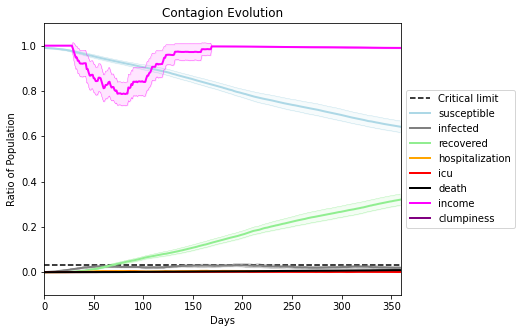

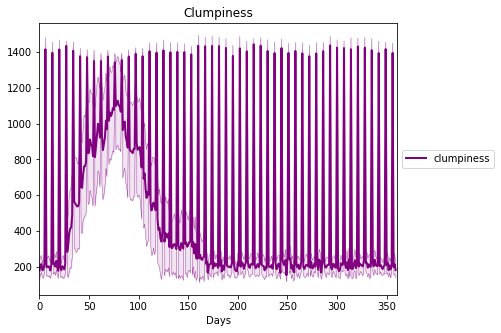

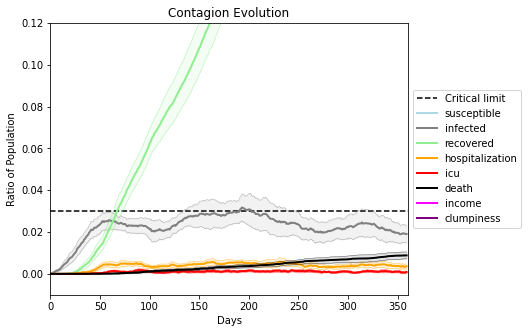

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1059, 7648, 3176, 4825, 2429, 2190, 4242, 5753, 2423, 5518, 4804, 1054, 8234, 8464, 2641, 1494, 7127, 1495, 101, 9543]
Average similarity between family members is 0.94135283072253 at temperature -0.994
Average similarity between family and home is 0.9998472733751066 at temperature -1
Average similarity between students and their classroom is 0.8895298027039001 at temperature -0.994
Average classroom occupancy is 1.6491228070175439 and number classrooms is 171
Average similarity between workers is 0.8916020869262572 at temperature -0.994
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.849658925463831 for kids: 0.7341586670296629
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.5571146068963709
avg restaurant similarity 0.5595135470120466
avg restaurant similarity 0.5540820853021088
avg restaurant similarity 0.5415508434514567
avg restaurant similarity 0.523417698716519
avg restaurant similarity 0.547080410598849
avg restaurant similarity 0.5607088857519407
avg restaurant similarity 0.5733406197252792
avg restaurant similarity 0.5785564057426432
avg restaurant similarity 0.6047945951722447
avg restaurant similarity 0.5438464226494
avg restaurant similarity 0.5814203031769564
avg restaurant similarity 0.5596105855263256
avg restaurant similarity 0.5874391203177953
avg restaurant similarity 0.5425853388524258
avg restaurant similarity 0.546252100800481
avg restaurant similarity 0.5613014042193829
avg restaurant similarity 0.5346427366945675
avg restaurant similarity 0.49754629179447496
avg restaurant similarity 0.5611051008138523
avg restaurant similarity 0.5264207011548733
avg restaurant similarity 0.5601466135307637
avg restaurant 

avg restaurant similarity 0.5511016671817103
avg restaurant similarity 0.6059570834661966
avg restaurant similarity 0.5557372892026636
avg restaurant similarity 0.5226471999425438
avg restaurant similarity 0.5214079664867897
avg restaurant similarity 0.528134224816483
avg restaurant similarity 0.625175311608674
avg restaurant similarity 0.4810027508189404
avg restaurant similarity 0.5725328165749917
avg restaurant similarity 0.5615175234928552
avg restaurant similarity 0.538666035111247
avg restaurant similarity 0.5637733160263183
avg restaurant similarity 0.5700038244101467
avg restaurant similarity 0.5395744578298899
avg restaurant similarity 0.5905355881432736
avg restaurant similarity 0.5481960854350293
avg restaurant similarity 0.5718631610705992
avg restaurant similarity 0.5362002981649734
avg restaurant similarity 0.5801536745091798
avg restaurant similarity 0.5804758319526508
avg restaurant similarity 0.5977420701645813
avg restaurant similarity 0.5341989851453134
avg restauran

Average similarity between workers is 0.8996430133593998 at temperature -0.994
Average office occupancy is 3.2974358974358973 and number offices is 195
Average friend similarity for adults: 0.8475876766350611 for kids: 0.7447760617552157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6662547137145505
avg restaurant similarity 0.6506899852459469
avg restaurant similarity 0.6226248168312003
avg restaurant similarity 0.5891005647001646
avg restaurant similarity 0.6227206187550072
avg restaurant similarity 0.5868088300814891
avg restaurant similarity 0.6151363042701224
avg restaurant similarity 0.5839674513047319
avg restaurant similarity 0.5912705284252648
avg restaurant similarity 0.5869164026763557
avg restaurant similarity 0.6394467788419747
avg restaurant similarity 0.598441451292887
avg restaurant similarity 0.5581731589522644
avg restaurant similarity 0.5594924793910712
avg restaurant similarity 0.6001408480102286
avg restaurant similarity 0.5559990829102776
avg restaurant similarity 0.597333432519362
avg restaurant similarity 0.6054380809088464
avg restaurant similarity 0.6095759508805855
avg restaurant similarity 0.6058495092829765
avg restaurant similarity 0.6240733116514968
avg restaurant similarity 0.5882399013011242
avg restaura

avg restaurant similarity 0.5488890300379822
avg restaurant similarity 0.5529916407227793
avg restaurant similarity 0.6237955410924776
avg restaurant similarity 0.5973044474563267
avg restaurant similarity 0.5940579275012127
avg restaurant similarity 0.6022003372840588
avg restaurant similarity 0.6038271285296111
avg restaurant similarity 0.615249222017871
avg restaurant similarity 0.5831979158042743
avg restaurant similarity 0.5823669550969959
avg restaurant similarity 0.6229336306329654
avg restaurant similarity 0.5651610030818486
avg restaurant similarity 0.5720098719976242
avg restaurant similarity 0.5928052266070517
avg restaurant similarity 0.6152102945120266
avg restaurant similarity 0.610646946492494
avg restaurant similarity 0.6240399877509306
avg restaurant similarity 0.5908499432255253
avg restaurant similarity 0.5922033344051569
avg restaurant similarity 0.5643242211007901
avg restaurant similarity 0.5782538826795817
avg restaurant similarity 0.5771985011784554
avg restaura

Average similarity between workers is 0.8807204366821755 at temperature -0.994
Average office occupancy is 3.5257731958762886 and number offices is 194
Average friend similarity for adults: 0.8557158013673761 for kids: 0.7206354102269749
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5330906120119635
avg restaurant similarity 0.5353720926369222
avg restaurant similarity 0.560331605017109
avg restaurant similarity 0.5785415684598808
avg restaurant similarity 0.5655274522039482
avg restaurant similarity 0.5868971473455429
avg restaurant similarity 0.5618980297220857
avg restaurant similarity 0.5927334232334838
avg restaurant similarity 0.561146700714525
avg restaurant similarity 0.5493416296579565
avg restaurant similarity 0.5745492865883564
avg restaurant similarity 0.5822626680540824
avg restaurant similarity 0.5743502040160867
avg restaurant similarity 0.5483902466284412
avg restaurant similarity 0.5836271568944071
avg restaurant similarity 0.561153128980007
avg restaurant similarity 0.5520856823348114
avg restaurant similarity 0.5650160478165318
avg restaurant similarity 0.580804842311371
avg restaurant similarity 0.5822615425113342
avg restaurant similarity 0.5500267129011062
avg restaurant similarity 0.5892029720830504
avg restaurant

avg restaurant similarity 0.596329804453366
avg restaurant similarity 0.5429138706119135
avg restaurant similarity 0.5723763893831217
avg restaurant similarity 0.5889058860797964
avg restaurant similarity 0.5320961324305453
avg restaurant similarity 0.5469670472157709
avg restaurant similarity 0.5633518354631551
avg restaurant similarity 0.5778750894458023
avg restaurant similarity 0.5705069605689359
avg restaurant similarity 0.5760943517615136
avg restaurant similarity 0.5443877480904636
avg restaurant similarity 0.5272180175937172
avg restaurant similarity 0.5470039662752814
avg restaurant similarity 0.5886373641423246
avg restaurant similarity 0.560676592015685
avg restaurant similarity 0.6300895476662736
avg restaurant similarity 0.5423620275543738
avg restaurant similarity 0.541024861969423
avg restaurant similarity 0.5470192022058639
avg restaurant similarity 0.5821205107335009
avg restaurant similarity 0.5274693673800166
avg restaurant similarity 0.5805610039239192
avg restauran

Average similarity between workers is 0.8715965624817914 at temperature -0.994
Average office occupancy is 3.531578947368421 and number offices is 190
Average friend similarity for adults: 0.8478642561932815 for kids: 0.6987689064449376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5651816838385824
avg restaurant similarity 0.609074721953248
avg restaurant similarity 0.5398705297165817
avg restaurant similarity 0.537731858033922
avg restaurant similarity 0.5663911437724924
avg restaurant similarity 0.5175635170429624
avg restaurant similarity 0.6195445813543591
avg restaurant similarity 0.6195244623537003
avg restaurant similarity 0.5314727355792807
avg restaurant similarity 0.5555949499454261
avg restaurant similarity 0.5786413155698042
avg restaurant similarity 0.6271913807845124
avg restaurant similarity 0.5938891819866473
avg restaurant similarity 0.5727958024806427
avg restaurant similarity 0.5693014851047613
avg restaurant similarity 0.6365482898877687
avg restaurant similarity 0.5593583570793177
avg restaurant similarity 0.5401699375392556
avg restaurant similarity 0.5598364072720959
avg restaurant similarity 0.5839617508364953
avg restaurant similarity 0.5473261750101703
avg restaurant similarity 0.5673370276343671
avg restaura

avg restaurant similarity 0.5784620404159304
avg restaurant similarity 0.5102144538444155
avg restaurant similarity 0.5995362907447281
avg restaurant similarity 0.5397503429197432
avg restaurant similarity 0.6127696112223462
avg restaurant similarity 0.5636492553742759
avg restaurant similarity 0.569188475792871
avg restaurant similarity 0.546991700149321
avg restaurant similarity 0.5584845271165503
avg restaurant similarity 0.5854143733881317
avg restaurant similarity 0.5436655076926197
avg restaurant similarity 0.5903910972879198
avg restaurant similarity 0.5839439680817756
avg restaurant similarity 0.5367240885174904
avg restaurant similarity 0.5623476593344537
avg restaurant similarity 0.5600825254872538
avg restaurant similarity 0.5236870811454062
avg restaurant similarity 0.5257810230593238
avg restaurant similarity 0.5910598096196445
avg restaurant similarity 0.5418808366700352
avg restaurant similarity 0.6074627383218079
avg restaurant similarity 0.5615336756280495
avg restaura

Average similarity between workers is 0.8942898670795736 at temperature -0.994
Average office occupancy is 3.287179487179487 and number offices is 195
Average friend similarity for adults: 0.8485125060114781 for kids: 0.7209709598377602
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5461713706902339
avg restaurant similarity 0.5557163898003101
avg restaurant similarity 0.5491093851107163
avg restaurant similarity 0.5883549480330087
avg restaurant similarity 0.5851450295041531
avg restaurant similarity 0.5490575653721594
avg restaurant similarity 0.5663553079766829
avg restaurant similarity 0.5558024657585398
avg restaurant similarity 0.5774495782712773
avg restaurant similarity 0.5318498376660691
avg restaurant similarity 0.4589615570574654
avg restaurant similarity 0.5438941934733454
avg restaurant similarity 0.5253933042560329
avg restaurant similarity 0.5514568019205395
avg restaurant similarity 0.5110436531486345
avg restaurant similarity 0.5625338176445941
avg restaurant similarity 0.5636863736891843
avg restaurant similarity 0.5386938198973459
avg restaurant similarity 0.5528866156787906
avg restaurant similarity 0.5632414534008724
avg restaurant similarity 0.5181338161711887
avg restaurant similarity 0.6013803331243833
avg restau

avg restaurant similarity 0.544339817703899
avg restaurant similarity 0.5359181290005296
avg restaurant similarity 0.5135559368120463
avg restaurant similarity 0.5354925412080201
avg restaurant similarity 0.49481030224798694
avg restaurant similarity 0.5432215145280425
avg restaurant similarity 0.5269675014368079
avg restaurant similarity 0.5668518436415818
avg restaurant similarity 0.5630111904758749
avg restaurant similarity 0.5779906024634256
avg restaurant similarity 0.5518392133243115
avg restaurant similarity 0.5229175257792169
avg restaurant similarity 0.5690809057093844
avg restaurant similarity 0.5442283453375079
avg restaurant similarity 0.5365587235019803
avg restaurant similarity 0.47037566991286467
avg restaurant similarity 0.5515830432639803
avg restaurant similarity 0.49982249152790814
avg restaurant similarity 0.5551747544888368
avg restaurant similarity 0.481595261774991
avg restaurant similarity 0.5470783029873135
avg restaurant similarity 0.5326103171668322
avg resta

Average similarity between workers is 0.8911389660380608 at temperature -0.994
Average office occupancy is 3.2857142857142856 and number offices is 196
Average friend similarity for adults: 0.8504169917377093 for kids: 0.7387965110447173
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6097362866087602
avg restaurant similarity 0.5655070701039885
avg restaurant similarity 0.5896586892435925
avg restaurant similarity 0.5639527152956159
avg restaurant similarity 0.6158719754331488
avg restaurant similarity 0.5890903177716998
avg restaurant similarity 0.5971359724904678
avg restaurant similarity 0.6124202271958642
avg restaurant similarity 0.6386917970683998
avg restaurant similarity 0.6239419298182565
avg restaurant similarity 0.6021372132203417
avg restaurant similarity 0.5151219210203526
avg restaurant similarity 0.6394043772506622
avg restaurant similarity 0.6191434692066149
avg restaurant similarity 0.5628899253583795
avg restaurant similarity 0.5642843268021386
avg restaurant similarity 0.5886412225955523
avg restaurant similarity 0.616437126774822
avg restaurant similarity 0.6233933770579594
avg restaurant similarity 0.6141994062499756
avg restaurant similarity 0.6238808070997482
avg restaurant similarity 0.589641374865974
avg restaura

avg restaurant similarity 0.6662024919943615
avg restaurant similarity 0.60551939289655
avg restaurant similarity 0.6102076468400637
avg restaurant similarity 0.6035568462927666
avg restaurant similarity 0.6101917932214161
avg restaurant similarity 0.5319121217065802
avg restaurant similarity 0.5780654627628422
avg restaurant similarity 0.6228486313449203
avg restaurant similarity 0.6561598214967971
avg restaurant similarity 0.6169784286261153
avg restaurant similarity 0.5633861654067719
avg restaurant similarity 0.5441547921139277
avg restaurant similarity 0.5872414577460807
avg restaurant similarity 0.5831052666142769
avg restaurant similarity 0.5881157737876352
avg restaurant similarity 0.6497351124482171
avg restaurant similarity 0.5508869088162973
avg restaurant similarity 0.5564482628147682
avg restaurant similarity 0.6176515093154669
avg restaurant similarity 0.57855243868292
avg restaurant similarity 0.5575623530260185
avg restaurant similarity 0.5790665690321919
avg restaurant

Average similarity between workers is 0.879509561188507 at temperature -0.994
Average office occupancy is 3.21 and number offices is 200
Average friend similarity for adults: 0.835108743132269 for kids: 0.728998940587209
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocat

avg restaurant similarity 0.5803638004759966
avg restaurant similarity 0.5792229430475409
avg restaurant similarity 0.6201204250492923
avg restaurant similarity 0.5916114009804516
avg restaurant similarity 0.6000164560614196
avg restaurant similarity 0.5614545195769907
avg restaurant similarity 0.5872919498448141
avg restaurant similarity 0.5636649015754023
avg restaurant similarity 0.6150647390830377
avg restaurant similarity 0.6109506160155771
avg restaurant similarity 0.6200248240895804
avg restaurant similarity 0.5353119749323995
avg restaurant similarity 0.6365581061149258
avg restaurant similarity 0.6083662312598315
avg restaurant similarity 0.6304326099838858
avg restaurant similarity 0.54522181112913
avg restaurant similarity 0.5788782103521373
avg restaurant similarity 0.5793316166515345
avg restaurant similarity 0.5636929491775681
avg restaurant similarity 0.5882190936997713
avg restaurant similarity 0.5016801238511239
avg restaurant similarity 0.618834229233578
avg restauran

avg restaurant similarity 0.5855036990434543
avg restaurant similarity 0.5688966092237041
avg restaurant similarity 0.6507966402408647
avg restaurant similarity 0.5079588397810132
avg restaurant similarity 0.5751120734189445
avg restaurant similarity 0.5828528896281221
avg restaurant similarity 0.5885623299952316
avg restaurant similarity 0.5758974613838612
avg restaurant similarity 0.5619859405636829
avg restaurant similarity 0.5186419086878487
avg restaurant similarity 0.49741677902405385
avg restaurant similarity 0.5410008143401235
avg restaurant similarity 0.6007195345850126
avg restaurant similarity 0.5126259153174427
avg restaurant similarity 0.5595671943925172
avg restaurant similarity 0.5744328103571289
avg restaurant similarity 0.5311501537289177
avg restaurant similarity 0.5789582257839555
avg restaurant similarity 0.6609937742819726
avg restaurant similarity 0.5335356949306053
avg restaurant similarity 0.583466730831437
avg restaurant similarity 0.5789530704374805
avg restau

Average similarity between workers is 0.8858306277292668 at temperature -0.994
Average office occupancy is 3.3915343915343916 and number offices is 189
Average friend similarity for adults: 0.8390490056519457 for kids: 0.7281147781317233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.5840856683213109
avg restaurant similarity 0.5530403075745893
avg restaurant similarity 0.5350337842111174
avg restaurant similarity 0.5467457367566704
avg restaurant similarity 0.6137702087247358
avg restaurant similarity 0.6063798478382152
avg restaurant similarity 0.5558517825584229
avg restaurant similarity 0.6045176822890831
avg restaurant similarity 0.5578396153527869
avg restaurant similarity 0.612759405098178
avg restaurant similarity 0.5669714607714226
avg restaurant similarity 0.5881239764194469
avg restaurant similarity 0.5638046231464998
avg restaurant similarity 0.5719994127097235
avg restaurant similarity 0.5844143359586134
avg restaurant similarity 0.5693726842544304
avg restaurant similarity 0.5936586792172678
avg restaurant similarity 0.5766518421421145
avg restaurant similarity 0.583305411426128
avg restaurant similarity 0.5717456677131083
avg restaurant similarity 0.5586460095319098
avg restaurant similarity 0.5699852545957279
avg restaura

avg restaurant similarity 0.5623217217046705
avg restaurant similarity 0.5340715869427892
avg restaurant similarity 0.5934531819744255
avg restaurant similarity 0.5515370514059171
avg restaurant similarity 0.591832301451106
avg restaurant similarity 0.5447508031046965
avg restaurant similarity 0.5759141646599394
avg restaurant similarity 0.581374171605762
avg restaurant similarity 0.6117140198552511
avg restaurant similarity 0.5656045633544649
avg restaurant similarity 0.5453696487828245
avg restaurant similarity 0.5362970867569083
avg restaurant similarity 0.5597451656894169
avg restaurant similarity 0.5999308846907256
avg restaurant similarity 0.5640260790212387
avg restaurant similarity 0.5238047506550031
avg restaurant similarity 0.548419515732087
avg restaurant similarity 0.5889641007584666
avg restaurant similarity 0.5145120232510091
avg restaurant similarity 0.5192269305713526
avg restaurant similarity 0.5370685037228623
avg restaurant similarity 0.5283180456971551
avg restauran

Average similarity between workers is 0.8925961955205254 at temperature -0.994
Average office occupancy is 3.284974093264249 and number offices is 193
Average friend similarity for adults: 0.846227421908533 for kids: 0.7463426642905072
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5638212251260117
avg restaurant similarity 0.5613014116176716
avg restaurant similarity 0.5751162723715303
avg restaurant similarity 0.5770667915268124
avg restaurant similarity 0.623331975811753
avg restaurant similarity 0.5323068136194931
avg restaurant similarity 0.5607402113610339
avg restaurant similarity 0.5736976669609029
avg restaurant similarity 0.528371231215528
avg restaurant similarity 0.5824235780868215
avg restaurant similarity 0.5135727148072333
avg restaurant similarity 0.5246098972005682
avg restaurant similarity 0.568670806508738
avg restaurant similarity 0.5515723696993777
avg restaurant similarity 0.5260795545019538
avg restaurant similarity 0.5793931740466857
avg restaurant similarity 0.5524721961542083
avg restaurant similarity 0.567242922756123
avg restaurant similarity 0.5958815764134638
avg restaurant similarity 0.5171668908755176
avg restaurant similarity 0.5419003489129264
avg restaurant similarity 0.6052740523584883
avg restaurant

avg restaurant similarity 0.49664708835744165
avg restaurant similarity 0.5881978167677182
avg restaurant similarity 0.5574543920852546
avg restaurant similarity 0.529197217216811
avg restaurant similarity 0.5554983020192293
avg restaurant similarity 0.5903473702198914
avg restaurant similarity 0.5515965559363443
avg restaurant similarity 0.5022158442400775
avg restaurant similarity 0.5698228562873926
avg restaurant similarity 0.5639133576554535
avg restaurant similarity 0.5235676194791999
avg restaurant similarity 0.5479262143469004
avg restaurant similarity 0.569771647653637
avg restaurant similarity 0.5697270886836139
avg restaurant similarity 0.5357328684837518
avg restaurant similarity 0.593370841915752
avg restaurant similarity 0.5606446563789523
avg restaurant similarity 0.5753555120739354
avg restaurant similarity 0.5503116550743993
avg restaurant similarity 0.525426319810544
avg restaurant similarity 0.5274168622649293
avg restaurant similarity 0.5813127605383437
avg restauran

Average similarity between workers is 0.8844957059027336 at temperature -0.994
Average office occupancy is 3.213197969543147 and number offices is 197
Average friend similarity for adults: 0.8375863479186417 for kids: 0.7245148912821392
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 

avg restaurant similarity 0.5238308418271055
avg restaurant similarity 0.5484117732581822
avg restaurant similarity 0.5522632943832392
avg restaurant similarity 0.5221726858431747
avg restaurant similarity 0.5859036818606089
avg restaurant similarity 0.5257305114310994
avg restaurant similarity 0.5298439745797444
avg restaurant similarity 0.5508642111957595
avg restaurant similarity 0.529166433366777
avg restaurant similarity 0.5584831018699001
avg restaurant similarity 0.5619677188598485
avg restaurant similarity 0.5262224754388286
avg restaurant similarity 0.557896930390148
avg restaurant similarity 0.6321339380136588
avg restaurant similarity 0.5303982427243219
avg restaurant similarity 0.5347944542039366
avg restaurant similarity 0.5395675788296486
avg restaurant similarity 0.5707181917894143
avg restaurant similarity 0.575164757915786
avg restaurant similarity 0.5171280171505102
avg restaurant similarity 0.584095996767343
avg restaurant similarity 0.5622656610571738
avg restaurant

avg restaurant similarity 0.5165996792248827
avg restaurant similarity 0.6200820981922548
avg restaurant similarity 0.6387720840170132
avg restaurant similarity 0.5389936278909173
avg restaurant similarity 0.580042014211472
avg restaurant similarity 0.5460221145481965
avg restaurant similarity 0.5150963523518304
avg restaurant similarity 0.5185550616421765
avg restaurant similarity 0.5697701358263352
avg restaurant similarity 0.6365703647992682
avg restaurant similarity 0.5933637288679052
avg restaurant similarity 0.5483458108305731
avg restaurant similarity 0.6327820593271041
avg restaurant similarity 0.5444052123987967
avg restaurant similarity 0.5674163500502489
avg restaurant similarity 0.5370476048807592
avg restaurant similarity 0.4984493384284763
avg restaurant similarity 0.4920337994950486
avg restaurant similarity 0.5619185479523657
avg restaurant similarity 0.5876308172386626
avg restaurant similarity 0.5011852564871435
avg restaurant similarity 0.49053614537913837
avg restau

Average similarity between workers is 0.8920905761598896 at temperature -0.994
Average office occupancy is 3.199004975124378 and number offices is 201
Average friend similarity for adults: 0.8489544265904403 for kids: 0.7348274773127929
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 pe

avg restaurant similarity 0.5732137101666727
avg restaurant similarity 0.5592541896952536
avg restaurant similarity 0.57071805646671
avg restaurant similarity 0.6025487885417538
avg restaurant similarity 0.5407316698881278
avg restaurant similarity 0.5929626148283547
avg restaurant similarity 0.6162390772412168
avg restaurant similarity 0.6089725117312659
avg restaurant similarity 0.6212723999772091
avg restaurant similarity 0.5713288107807231
avg restaurant similarity 0.6065843291977175
avg restaurant similarity 0.5585025507399657
avg restaurant similarity 0.6048662020729799
avg restaurant similarity 0.5748872159778138
avg restaurant similarity 0.600534194274928
avg restaurant similarity 0.5986012051348637
avg restaurant similarity 0.5657526880369119
avg restaurant similarity 0.5588703552313788
avg restaurant similarity 0.5536059005940567
avg restaurant similarity 0.5456172136182503
avg restaurant similarity 0.6174531184179091
avg restaurant similarity 0.5623645937359699
avg restauran

avg restaurant similarity 0.6121643744404041
avg restaurant similarity 0.5890129384738011
avg restaurant similarity 0.5955663497083369
avg restaurant similarity 0.555046176709119
avg restaurant similarity 0.5865031954549578
avg restaurant similarity 0.5250082281980138
avg restaurant similarity 0.5345520770742024
avg restaurant similarity 0.5877849070668488
avg restaurant similarity 0.6112434909874125
avg restaurant similarity 0.5339158445159298
avg restaurant similarity 0.6192501152007742
avg restaurant similarity 0.542206198874531
avg restaurant similarity 0.6111547575007115
avg restaurant similarity 0.5377886531904833
avg restaurant similarity 0.557026904244184
avg restaurant similarity 0.5546478923086564
avg restaurant similarity 0.5622964735630541
avg restaurant similarity 0.5547140023658808
avg restaurant similarity 0.5655409144829318
avg restaurant similarity 0.5548595808676826
avg restaurant similarity 0.5377257803706698
avg restaurant similarity 0.6204397128461826
avg restauran

Average similarity between workers is 0.8933676401155789 at temperature -0.994
Average office occupancy is 3.416243654822335 and number offices is 197
Average friend similarity for adults: 0.856759666447263 for kids: 0.7156481260687827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5644792574739765
avg restaurant similarity 0.6280065830956715
avg restaurant similarity 0.5997347028275434
avg restaurant similarity 0.6354805085508209
avg restaurant similarity 0.5703102129861243
avg restaurant similarity 0.564452105991914
avg restaurant similarity 0.590942479875619
avg restaurant similarity 0.5797444576031068
avg restaurant similarity 0.6075458017923732
avg restaurant similarity 0.7086025483856995
avg restaurant similarity 0.5657815052628866
avg restaurant similarity 0.5948853473925159
avg restaurant similarity 0.6164038364038558
avg restaurant similarity 0.5866202708717684
avg restaurant similarity 0.578797690971173
avg restaurant similarity 0.5243795459170748
avg restaurant similarity 0.5736516042013576
avg restaurant similarity 0.598704372208474
avg restaurant similarity 0.5303761680464839
avg restaurant similarity 0.5997211551503281
avg restaurant similarity 0.6206627392015774
avg restaurant similarity 0.6415430997460606
avg restaurant

avg restaurant similarity 0.6102367359744428
avg restaurant similarity 0.5498964590397476
avg restaurant similarity 0.5810195972929364
avg restaurant similarity 0.592858950638236
avg restaurant similarity 0.5611039308201711
avg restaurant similarity 0.5659856200555885
avg restaurant similarity 0.6204258911702207
avg restaurant similarity 0.4957723746909622
avg restaurant similarity 0.5172286193325883
avg restaurant similarity 0.5760852469815676
avg restaurant similarity 0.5617859840138663
avg restaurant similarity 0.5416789985144138
avg restaurant similarity 0.5982155983131556
avg restaurant similarity 0.6213406268629609
avg restaurant similarity 0.510254509802618
avg restaurant similarity 0.5620336876299892
avg restaurant similarity 0.6504614186391272
avg restaurant similarity 0.6420962202945545
avg restaurant similarity 0.6176477461836405
avg restaurant similarity 0.6023405402185246
avg restaurant similarity 0.6560916584219156
avg restaurant similarity 0.5532230019322535
avg restaura

Average similarity between workers is 0.889711884993736 at temperature -0.994
Average office occupancy is 3.270408163265306 and number offices is 196
Average friend similarity for adults: 0.851997505450583 for kids: 0.72933599690342
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.6195440755969785
avg restaurant similarity 0.5980880076054255
avg restaurant similarity 0.5694720567731856
avg restaurant similarity 0.554095080634218
avg restaurant similarity 0.6060408904098248
avg restaurant similarity 0.5862516021306898
avg restaurant similarity 0.6074839749035278
avg restaurant similarity 0.5671100567708349
avg restaurant similarity 0.5363097078944078
avg restaurant similarity 0.6799131648202301
avg restaurant similarity 0.65067520715658
avg restaurant similarity 0.5911028109945878
avg restaurant similarity 0.5296951634949846
avg restaurant similarity 0.6458096253658862
avg restaurant similarity 0.5997149761226035
avg restaurant similarity 0.6336179150026143
avg restaurant similarity 0.5359222441129506
avg restaurant similarity 0.6214855667877137
avg restaurant similarity 0.5994029543694436
avg restaurant similarity 0.604215091691963
avg restaurant similarity 0.5299245981091769
avg restaurant similarity 0.579458104659913
avg restaurant 

avg restaurant similarity 0.5789621408594071
avg restaurant similarity 0.631150430180988
avg restaurant similarity 0.5634128108512003
avg restaurant similarity 0.6095197005088214
avg restaurant similarity 0.5829642015293265
avg restaurant similarity 0.5571972517655148
avg restaurant similarity 0.5531256102450898
avg restaurant similarity 0.5849100576137285
avg restaurant similarity 0.5843880635754548
avg restaurant similarity 0.5617900380651604
avg restaurant similarity 0.5885699147191716
avg restaurant similarity 0.5395121991919615
avg restaurant similarity 0.5955159230317465
avg restaurant similarity 0.5876278666403068
avg restaurant similarity 0.584173284731372
avg restaurant similarity 0.5843732366557219
avg restaurant similarity 0.5803077419644844
avg restaurant similarity 0.47118754851759276
avg restaurant similarity 0.5899092000254782
avg restaurant similarity 0.5493580445572196
avg restaurant similarity 0.6467174290989727
avg restaurant similarity 0.5727244144166759
avg restaur

Average similarity between workers is 0.9034150913038718 at temperature -0.994
Average office occupancy is 3.383084577114428 and number offices is 201
Average friend similarity for adults: 0.8584422699537086 for kids: 0.7293136830342767
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5841082751774066
avg restaurant similarity 0.6247586921244785
avg restaurant similarity 0.5908139146705392
avg restaurant similarity 0.5908686179839258
avg restaurant similarity 0.6481384652297971
avg restaurant similarity 0.6574328734202454
avg restaurant similarity 0.6418178672369608
avg restaurant similarity 0.6014620367453535
avg restaurant similarity 0.6525205174003998
avg restaurant similarity 0.5875540500905995
avg restaurant similarity 0.6351130639494226
avg restaurant similarity 0.5642835254234464
avg restaurant similarity 0.5972398525246558
avg restaurant similarity 0.6110775735918484
avg restaurant similarity 0.6190372626408914
avg restaurant similarity 0.6141843915927252
avg restaurant similarity 0.6368561757359151
avg restaurant similarity 0.6381404269957432
avg restaurant similarity 0.6636574109092043
avg restaurant similarity 0.5708860715356567
avg restaurant similarity 0.6306799167644557
avg restaurant similarity 0.5716969329706743
avg restau

avg restaurant similarity 0.5696046000492858
avg restaurant similarity 0.5809423103128074
avg restaurant similarity 0.6274482918352158
avg restaurant similarity 0.6643720012830724
avg restaurant similarity 0.613800716478217
avg restaurant similarity 0.621224884917491
avg restaurant similarity 0.6001762078047361
avg restaurant similarity 0.5684331779258704
avg restaurant similarity 0.646642925195501
avg restaurant similarity 0.6965070305793644
avg restaurant similarity 0.598850747451813
avg restaurant similarity 0.5835984205779902
avg restaurant similarity 0.5393860970700495
avg restaurant similarity 0.6000089793925386
avg restaurant similarity 0.6495607067252857
avg restaurant similarity 0.6064054646063246
avg restaurant similarity 0.6403766994259736
avg restaurant similarity 0.6011403732202762
avg restaurant similarity 0.6067759493196402
avg restaurant similarity 0.6248394233067681
avg restaurant similarity 0.6235985423019133
avg restaurant similarity 0.5377234288156877
avg restaurant

Average similarity between workers is 0.8809521389965448 at temperature -0.994
Average office occupancy is 3.5487179487179485 and number offices is 195
Average friend similarity for adults: 0.8550098739526172 for kids: 0.7251958322826707
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5502193040933596
avg restaurant similarity 0.5838722638176159
avg restaurant similarity 0.6012660723846855
avg restaurant similarity 0.5958221313506175
avg restaurant similarity 0.601157677803749
avg restaurant similarity 0.5990133536318734
avg restaurant similarity 0.5889822468079964
avg restaurant similarity 0.570424740189124
avg restaurant similarity 0.5885012981303676
avg restaurant similarity 0.6120809631393153
avg restaurant similarity 0.5711357390175202
avg restaurant similarity 0.5682036785603528
avg restaurant similarity 0.5993603377556094
avg restaurant similarity 0.5420693226418972
avg restaurant similarity 0.5905440817532157
avg restaurant similarity 0.5931303183872337
avg restaurant similarity 0.5914094441605412
avg restaurant similarity 0.5854202600551321
avg restaurant similarity 0.5796270499051887
avg restaurant similarity 0.5418509590070992
avg restaurant similarity 0.5949709756440877
avg restaurant similarity 0.5649882233359415
avg restaura

avg restaurant similarity 0.5516431956947015
avg restaurant similarity 0.5912103911391007
avg restaurant similarity 0.5526684185695714
avg restaurant similarity 0.5735175226815794
avg restaurant similarity 0.5381832682320489
avg restaurant similarity 0.5303083677177276
avg restaurant similarity 0.539197818497296
avg restaurant similarity 0.5884468648603843
avg restaurant similarity 0.6081106074100789
avg restaurant similarity 0.5602047378314079
avg restaurant similarity 0.5619083821849059
avg restaurant similarity 0.5697464681653589
avg restaurant similarity 0.5978653957537611
avg restaurant similarity 0.6193112803649722
avg restaurant similarity 0.5523527754775039
avg restaurant similarity 0.5553836855712367
avg restaurant similarity 0.5373341430699606
avg restaurant similarity 0.5217242755160146
avg restaurant similarity 0.5475693455082442
avg restaurant similarity 0.634144790463345
avg restaurant similarity 0.5783927936534596
avg restaurant similarity 0.5995892334054114
avg restaura

Average similarity between workers is 0.8878015891102417 at temperature -0.994
Average office occupancy is 3.53125 and number offices is 192
Average friend similarity for adults: 0.8556062860971814 for kids: 0.7372491844204438
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people a

avg restaurant similarity 0.6254113629019867
avg restaurant similarity 0.6290182201601573
avg restaurant similarity 0.683784514290675
avg restaurant similarity 0.6414830176204122
avg restaurant similarity 0.6041437510997609
avg restaurant similarity 0.6329462515962124
avg restaurant similarity 0.6129709082519726
avg restaurant similarity 0.5802903296744596
avg restaurant similarity 0.5853120723298816
avg restaurant similarity 0.6571980365461647
avg restaurant similarity 0.5774297239229861
avg restaurant similarity 0.6386367729410762
avg restaurant similarity 0.5966839875269516
avg restaurant similarity 0.6190510978517414
avg restaurant similarity 0.5385565625637911
avg restaurant similarity 0.6015410811080494
avg restaurant similarity 0.6060389031345722
avg restaurant similarity 0.6396040691563123
avg restaurant similarity 0.654405588035667
avg restaurant similarity 0.5926123645331866
avg restaurant similarity 0.6221060305431648
avg restaurant similarity 0.6213254985536655
avg restaura

avg restaurant similarity 0.601478327561961
avg restaurant similarity 0.5594440050516143
avg restaurant similarity 0.6010279142267814
avg restaurant similarity 0.5876957925645555
avg restaurant similarity 0.6411186035933878
avg restaurant similarity 0.6307572439878839
avg restaurant similarity 0.6118292802371516
avg restaurant similarity 0.6338206293489966
avg restaurant similarity 0.5808276126469689
avg restaurant similarity 0.6408769319461692
avg restaurant similarity 0.6033282325447702
avg restaurant similarity 0.6694720578124491
avg restaurant similarity 0.598488436580394
avg restaurant similarity 0.5444999766340396
avg restaurant similarity 0.6219502836878517
avg restaurant similarity 0.5614190013006193
avg restaurant similarity 0.6015688468677529
avg restaurant similarity 0.624887694674028
avg restaurant similarity 0.6243439651489483
avg restaurant similarity 0.5924114053014413
avg restaurant similarity 0.5906138970141114
avg restaurant similarity 0.6226613674204639
avg restauran

Average similarity between workers is 0.8845341682222342 at temperature -0.994
Average office occupancy is 3.3125 and number offices is 192
Average friend similarity for adults: 0.8433563870987849 for kids: 0.7338047338950846
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people 

avg restaurant similarity 0.5936846726465008
avg restaurant similarity 0.6172054356902312
avg restaurant similarity 0.5413915930403902
avg restaurant similarity 0.5166144337508003
avg restaurant similarity 0.4975315403138202
avg restaurant similarity 0.5341103904063099
avg restaurant similarity 0.5124873732631581
avg restaurant similarity 0.5524993324543269
avg restaurant similarity 0.5479026975157975
avg restaurant similarity 0.5329251775227701
avg restaurant similarity 0.5436292252370831
avg restaurant similarity 0.5789455887389232
avg restaurant similarity 0.5784992732594793
avg restaurant similarity 0.5224907783687376
avg restaurant similarity 0.6252655295339682
avg restaurant similarity 0.5000367955218908
avg restaurant similarity 0.5246011768351191
avg restaurant similarity 0.5866136701835387
avg restaurant similarity 0.5743266603945331
avg restaurant similarity 0.5319993730732373
avg restaurant similarity 0.6001631854238254
avg restaurant similarity 0.5572970331228295
avg restau

avg restaurant similarity 0.5594923262163325
avg restaurant similarity 0.5473326802003986
avg restaurant similarity 0.5606262827747223
avg restaurant similarity 0.5325111137135394
avg restaurant similarity 0.554182152788145
avg restaurant similarity 0.5619975464487044
avg restaurant similarity 0.5174649082487762
avg restaurant similarity 0.5348704906637248
avg restaurant similarity 0.5760092971819166
avg restaurant similarity 0.599769244898402
avg restaurant similarity 0.5419897748453798
avg restaurant similarity 0.5937393704262525
avg restaurant similarity 0.5248053652230776
avg restaurant similarity 0.5488317533029158
avg restaurant similarity 0.5501264925580188
avg restaurant similarity 0.5444603201158135
avg restaurant similarity 0.5391851098635899
avg restaurant similarity 0.5397399871286104
avg restaurant similarity 0.5796933799243024
avg restaurant similarity 0.562205821191029
avg restaurant similarity 0.5585963750221997
avg restaurant similarity 0.5446251452918426
avg restauran

Average similarity between workers is 0.8790643759025136 at temperature -0.994
Average office occupancy is 3.212121212121212 and number offices is 198
Average friend similarity for adults: 0.8407111795893153 for kids: 0.7348582502173202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5990893394960555
avg restaurant similarity 0.5632958615131951
avg restaurant similarity 0.5725404252448754
avg restaurant similarity 0.5780971372433238
avg restaurant similarity 0.5883506242465776
avg restaurant similarity 0.5479709515852461
avg restaurant similarity 0.580643016002198
avg restaurant similarity 0.5595017335620999
avg restaurant similarity 0.5618941567022584
avg restaurant similarity 0.5306245618138314
avg restaurant similarity 0.5669820247902672
avg restaurant similarity 0.5786719496223117
avg restaurant similarity 0.5871808752303799
avg restaurant similarity 0.5914286472182625
avg restaurant similarity 0.5659981368338566
avg restaurant similarity 0.6051530263274534
avg restaurant similarity 0.5379389937060933
avg restaurant similarity 0.5970695593077948
avg restaurant similarity 0.6020993742042313
avg restaurant similarity 0.5753807138915653
avg restaurant similarity 0.5224428701283781
avg restaurant similarity 0.5853174873383991
avg restaur

avg restaurant similarity 0.6034942162797194
avg restaurant similarity 0.5709825547669298
avg restaurant similarity 0.6180408246773714
avg restaurant similarity 0.5370693419824474
avg restaurant similarity 0.5850530089797787
avg restaurant similarity 0.5950089616356062
avg restaurant similarity 0.560602316243705
avg restaurant similarity 0.5951647943219842
avg restaurant similarity 0.5584260154250289
avg restaurant similarity 0.5842777773550386
avg restaurant similarity 0.5569171316609813
avg restaurant similarity 0.5102095602356337
avg restaurant similarity 0.5952101388695631
avg restaurant similarity 0.5214351494986679
avg restaurant similarity 0.5753229966961293
avg restaurant similarity 0.5827965428722283
avg restaurant similarity 0.5298287267519088
avg restaurant similarity 0.5295899036609225
avg restaurant similarity 0.553608159297418
avg restaurant similarity 0.5328330426067539
avg restaurant similarity 0.5656300811167292
avg restaurant similarity 0.5130611285732141
avg restaura

Average similarity between workers is 0.8787883766231241 at temperature -0.994
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.8476830657384801 for kids: 0.7172169402528079
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 

avg restaurant similarity 0.5647638190482929
avg restaurant similarity 0.52686795158593
avg restaurant similarity 0.5501809469882509
avg restaurant similarity 0.5342161715703206
avg restaurant similarity 0.5490658474527941
avg restaurant similarity 0.5414645225636584
avg restaurant similarity 0.5459016353243943
avg restaurant similarity 0.5636702970011043
avg restaurant similarity 0.536650552164181
avg restaurant similarity 0.5659830678709677
avg restaurant similarity 0.5351405796631207
avg restaurant similarity 0.6007640123397038
avg restaurant similarity 0.5359160775399653
avg restaurant similarity 0.5368216573728474
avg restaurant similarity 0.5507408454596332
avg restaurant similarity 0.5288068435806549
avg restaurant similarity 0.5972442541327306
avg restaurant similarity 0.5825519493046011
avg restaurant similarity 0.5466818151003686
avg restaurant similarity 0.5704235989930444
avg restaurant similarity 0.5397192777926845
avg restaurant similarity 0.5561826948309178
avg restauran

avg restaurant similarity 0.5756183987439243
avg restaurant similarity 0.5317989049320767
avg restaurant similarity 0.5379182154338502
avg restaurant similarity 0.56632266854335
avg restaurant similarity 0.5862069269895182
avg restaurant similarity 0.5745204510328996
avg restaurant similarity 0.5364716445846659
avg restaurant similarity 0.5539566239004133
avg restaurant similarity 0.5863717783656461
avg restaurant similarity 0.5585983663545524
avg restaurant similarity 0.5598029018032947
avg restaurant similarity 0.5551872875517596
avg restaurant similarity 0.6013347106094359
avg restaurant similarity 0.5228844047844675
avg restaurant similarity 0.5828244019582143
avg restaurant similarity 0.5629491241514264
avg restaurant similarity 0.5538291351707485
avg restaurant similarity 0.596296150459683
avg restaurant similarity 0.5399668779651834
avg restaurant similarity 0.5441576452334254
avg restaurant similarity 0.5505242652228243
avg restaurant similarity 0.5853306582637864
avg restauran

Average similarity between workers is 0.8848093584866282 at temperature -0.994
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.8536321243442848 for kids: 0.7382140601184513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5952889497772965
avg restaurant similarity 0.6092592858861411
avg restaurant similarity 0.6030188425928079
avg restaurant similarity 0.6206889356795378
avg restaurant similarity 0.5533281951202326
avg restaurant similarity 0.6246790746110317
avg restaurant similarity 0.5668357411848859
avg restaurant similarity 0.5909677510591069
avg restaurant similarity 0.5632632443547165
avg restaurant similarity 0.6564854392321148
avg restaurant similarity 0.5867505421829445
avg restaurant similarity 0.5696253658317594
avg restaurant similarity 0.5798743742817525
avg restaurant similarity 0.6554306551774092
avg restaurant similarity 0.5977583421052011
avg restaurant similarity 0.620501382505161
avg restaurant similarity 0.6409541840567106
avg restaurant similarity 0.5753138146286184
avg restaurant similarity 0.6160365247598935
avg restaurant similarity 0.5909844541166752
avg restaurant similarity 0.5984810381811326
avg restaurant similarity 0.5872138161263041
avg restaur

avg restaurant similarity 0.5869266007193931
avg restaurant similarity 0.6601450823306202
avg restaurant similarity 0.5769923559053625
avg restaurant similarity 0.5751096304479151
avg restaurant similarity 0.5929025911365712
avg restaurant similarity 0.5795093519789797
avg restaurant similarity 0.5673756295559576
avg restaurant similarity 0.5861791114279844
avg restaurant similarity 0.6349809311898666
avg restaurant similarity 0.5812928686668539
avg restaurant similarity 0.6102239056564873
avg restaurant similarity 0.6127905471311839
avg restaurant similarity 0.5975729806813964
avg restaurant similarity 0.5994808118236764
avg restaurant similarity 0.5471372030573644
avg restaurant similarity 0.5671076972509855
avg restaurant similarity 0.5765838412771837
avg restaurant similarity 0.5968201081528606
avg restaurant similarity 0.6479975710280611
avg restaurant similarity 0.6236401448107208
avg restaurant similarity 0.5878532706670758
avg restaurant similarity 0.5683392614788733
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

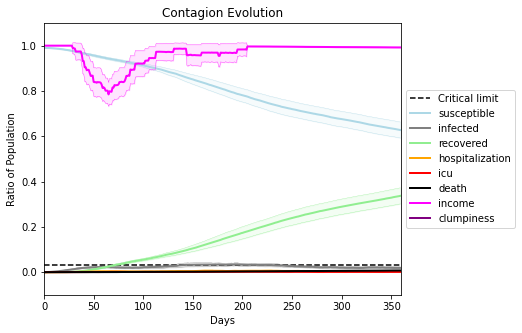

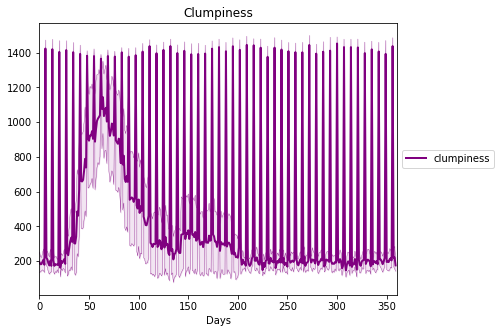

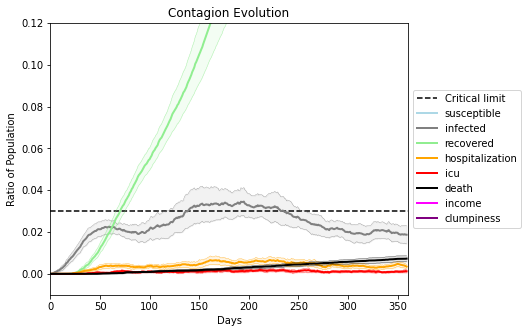

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6780, 9336, 6162, 1328, 8078, 1339, 4930, 8396, 5277, 8518, 1610, 3969, 7490, 9126, 5555, 6840, 2641, 6036, 9033, 1966]
Average similarity between family members is 0.9240726666149351 at temperature -0.993
Average similarity between family and home is 0.9998536490218864 at temperature -1
Average similarity between students and their classroom is 0.8405282554495686 at temperature -0.993
Average classroom occupancy is 1.5642458100558658 and number classrooms is 179
Average similarity between workers is 0.8773921481065556 at temperature -0.993
Average office occupancy is 3.36 and number offices is 200
Average friend similarity for adults: 0.8485511831456694 for kids: 0.7158846429753164
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.5496910075835175
avg restaurant similarity 0.5632187629622076
avg restaurant similarity 0.5564716321835738
avg restaurant similarity 0.5306556781633202
avg restaurant similarity 0.5196076435271376
avg restaurant similarity 0.5919692477958641
avg restaurant similarity 0.5645373706907141
avg restaurant similarity 0.5606293131790485
avg restaurant similarity 0.5746010602094758
avg restaurant similarity 0.5365010753442324
avg restaurant similarity 0.6198015263389764
avg restaurant similarity 0.5517042439307214
avg restaurant similarity 0.5340481929583489
avg restaurant similarity 0.5198460133787774
avg restaurant similarity 0.5263305291563164
avg restaurant similarity 0.5720538517880945
avg restaurant similarity 0.536793692367307
avg restaurant similarity 0.5686773454220311
avg restaurant similarity 0.6224780813404831
avg restaurant similarity 0.5239488650350402
avg restaurant similarity 0.5626930829614638
avg restaurant similarity 0.47173001560544997
avg restau

avg restaurant similarity 0.5792539162844275
avg restaurant similarity 0.5858298227867187
avg restaurant similarity 0.5666479754025053
avg restaurant similarity 0.6017873501958115
avg restaurant similarity 0.5616931117136781
avg restaurant similarity 0.5531193060178713
avg restaurant similarity 0.5835872113117446
avg restaurant similarity 0.6004895879252918
avg restaurant similarity 0.5569314213757423
avg restaurant similarity 0.555656124574564
avg restaurant similarity 0.5770639167208003
avg restaurant similarity 0.5531707093570916
avg restaurant similarity 0.5436206342835928
avg restaurant similarity 0.5596971792342661
avg restaurant similarity 0.5253328129014897
avg restaurant similarity 0.5720814326195752
avg restaurant similarity 0.5065357142190166
avg restaurant similarity 0.5099487934901504
avg restaurant similarity 0.5142250199348055
avg restaurant similarity 0.5592597528040572
avg restaurant similarity 0.5526314469800246
avg restaurant similarity 0.5497192700312028
avg restaur

Average similarity between workers is 0.8731116465063969 at temperature -0.993
Average office occupancy is 3.3177083333333335 and number offices is 192
Average friend similarity for adults: 0.8373819248514794 for kids: 0.7279134405025076
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5039968839954547
avg restaurant similarity 0.5181860041496577
avg restaurant similarity 0.49635916126186164
avg restaurant similarity 0.582227420361578
avg restaurant similarity 0.5750311905772705
avg restaurant similarity 0.5637089602779888
avg restaurant similarity 0.5689642172224784
avg restaurant similarity 0.5429088638753612
avg restaurant similarity 0.5432418749976384
avg restaurant similarity 0.5596351985211484
avg restaurant similarity 0.5534183170706728
avg restaurant similarity 0.5473963499809799
avg restaurant similarity 0.5578837683037523
avg restaurant similarity 0.5690805874028289
avg restaurant similarity 0.5739279779554233
avg restaurant similarity 0.6049046064374883
avg restaurant similarity 0.589046503526545
avg restaurant similarity 0.5057355803189587
avg restaurant similarity 0.5802555973933147
avg restaurant similarity 0.5474851745643753
avg restaurant similarity 0.571330293134172
avg restaurant similarity 0.5220568468579296
avg restaura

avg restaurant similarity 0.5573954111488273
avg restaurant similarity 0.5729341798697724
avg restaurant similarity 0.5629235770335532
avg restaurant similarity 0.5722455075853494
avg restaurant similarity 0.5606700088615068
avg restaurant similarity 0.5501831518017476
avg restaurant similarity 0.576115950239933
avg restaurant similarity 0.5926685830924487
avg restaurant similarity 0.519198503689449
avg restaurant similarity 0.5312241090064979
avg restaurant similarity 0.5765385375733832
avg restaurant similarity 0.5567938387404697
avg restaurant similarity 0.5864059620511889
avg restaurant similarity 0.5552697746351982
avg restaurant similarity 0.5874854963636931
avg restaurant similarity 0.5479497174252435
avg restaurant similarity 0.5272865934176995
avg restaurant similarity 0.5437730353828419
avg restaurant similarity 0.6196867050185056
avg restaurant similarity 0.5771549295297373
avg restaurant similarity 0.5284321060743067
avg restaurant similarity 0.6004700460264104
avg restaura

Average similarity between workers is 0.8744316736609774 at temperature -0.993
Average office occupancy is 3.3838383838383836 and number offices is 198
Average friend similarity for adults: 0.8567737501723922 for kids: 0.7315724747525452
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6087565364606181
avg restaurant similarity 0.5955293704756244
avg restaurant similarity 0.5596717952568583
avg restaurant similarity 0.5692272984553189
avg restaurant similarity 0.6084188117491652
avg restaurant similarity 0.6447154603841267
avg restaurant similarity 0.5450193370766642
avg restaurant similarity 0.5825864841824476
avg restaurant similarity 0.5870827699188571
avg restaurant similarity 0.6014319982134398
avg restaurant similarity 0.6376261802541539
avg restaurant similarity 0.573664606023237
avg restaurant similarity 0.6238054920970021
avg restaurant similarity 0.6164493933167307
avg restaurant similarity 0.5871833163313565
avg restaurant similarity 0.582698456435361
avg restaurant similarity 0.6207617062464038
avg restaurant similarity 0.6303241321004656
avg restaurant similarity 0.5480019518620504
avg restaurant similarity 0.6536545433337004
avg restaurant similarity 0.5748007131167933
avg restaurant similarity 0.5552007762302488
avg restaura

avg restaurant similarity 0.5752666705529504
avg restaurant similarity 0.5829483264977163
avg restaurant similarity 0.6027439517365781
avg restaurant similarity 0.5564863679114379
avg restaurant similarity 0.6062472323003518
avg restaurant similarity 0.6132076303079886
avg restaurant similarity 0.6038435652887764
avg restaurant similarity 0.6020733130795769
avg restaurant similarity 0.5734457687551888
avg restaurant similarity 0.5494892782701293
avg restaurant similarity 0.6377939333961181
avg restaurant similarity 0.6201193290944655
avg restaurant similarity 0.6273509972507796
avg restaurant similarity 0.6204813518452432
avg restaurant similarity 0.5732209930454195
avg restaurant similarity 0.5966796412409087
avg restaurant similarity 0.5515114249685671
avg restaurant similarity 0.6145642452283366
avg restaurant similarity 0.5825687816058595
avg restaurant similarity 0.5962437193270195
avg restaurant similarity 0.5372270317681942
avg restaurant similarity 0.5872103399711278
avg restau

Average similarity between workers is 0.8705556983735259 at temperature -0.993
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.8401796207631168 for kids: 0.7296412809061514
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5709298984008276
avg restaurant similarity 0.5223524492729174
avg restaurant similarity 0.48900858150012644
avg restaurant similarity 0.5564110626838499
avg restaurant similarity 0.4943116796896233
avg restaurant similarity 0.5528072025828626
avg restaurant similarity 0.5617818047890142
avg restaurant similarity 0.5832347569710564
avg restaurant similarity 0.5681891469173268
avg restaurant similarity 0.5262741408529472
avg restaurant similarity 0.5637492852993519
avg restaurant similarity 0.5341840883857056
avg restaurant similarity 0.49947836743174195
avg restaurant similarity 0.536989580428879
avg restaurant similarity 0.5919926180539861
avg restaurant similarity 0.5140818091459205
avg restaurant similarity 0.5167907772701357
avg restaurant similarity 0.6095066289782557
avg restaurant similarity 0.5215283100906762
avg restaurant similarity 0.5793107233743454
avg restaurant similarity 0.5778646428447938
avg restaurant similarity 0.5140397517982777
avg resta

avg restaurant similarity 0.5321587017911269
avg restaurant similarity 0.5634089565626216
avg restaurant similarity 0.5657808793582331
avg restaurant similarity 0.5704545457557545
avg restaurant similarity 0.5514422217691631
avg restaurant similarity 0.5598977865001425
avg restaurant similarity 0.5304195631203347
avg restaurant similarity 0.5892258885747658
avg restaurant similarity 0.5818047846706407
avg restaurant similarity 0.574695331165025
avg restaurant similarity 0.5284584492629711
avg restaurant similarity 0.5625504141302687
avg restaurant similarity 0.5831755279599785
avg restaurant similarity 0.5591709811596676
avg restaurant similarity 0.5641725748202757
avg restaurant similarity 0.5984833282498029
avg restaurant similarity 0.5121543148695137
avg restaurant similarity 0.6086602441979405
avg restaurant similarity 0.602459584992531
avg restaurant similarity 0.53444327395108
avg restaurant similarity 0.5460621374016419
avg restaurant similarity 0.5446449934787322
avg restaurant

Average similarity between workers is 0.8738217193978769 at temperature -0.993
Average office occupancy is 3.2525252525252526 and number offices is 198
Average friend similarity for adults: 0.8349750401366786 for kids: 0.7226369508346214
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5265766569067378
avg restaurant similarity 0.5420468392843723
avg restaurant similarity 0.5914728098516459
avg restaurant similarity 0.565770435014564
avg restaurant similarity 0.5259304014810269
avg restaurant similarity 0.5638474324527124
avg restaurant similarity 0.5424896499092008
avg restaurant similarity 0.542153395635039
avg restaurant similarity 0.5372053312289543
avg restaurant similarity 0.5332461867817165
avg restaurant similarity 0.582060384875607
avg restaurant similarity 0.5596341238218081
avg restaurant similarity 0.5637763301935308
avg restaurant similarity 0.545869021917095
avg restaurant similarity 0.533682717983777
avg restaurant similarity 0.5668512930083673
avg restaurant similarity 0.5865176016298497
avg restaurant similarity 0.5688982994209368
avg restaurant similarity 0.5795847889409167
avg restaurant similarity 0.5125532940671035
avg restaurant similarity 0.5616210118436108
avg restaurant similarity 0.5015843081031075
avg restaurant 

avg restaurant similarity 0.5431892610959964
avg restaurant similarity 0.5354799543577541
avg restaurant similarity 0.5481321570689577
avg restaurant similarity 0.5762277544369404
avg restaurant similarity 0.6043116513639092
avg restaurant similarity 0.5728127761331864
avg restaurant similarity 0.5781751527967919
avg restaurant similarity 0.5535321574179881
avg restaurant similarity 0.552522956882739
avg restaurant similarity 0.523757534035297
avg restaurant similarity 0.5576048302507837
avg restaurant similarity 0.5760304779741987
avg restaurant similarity 0.562047113938553
avg restaurant similarity 0.5528414658073365
avg restaurant similarity 0.547316923130045
avg restaurant similarity 0.5055975945802766
avg restaurant similarity 0.569041288524435
avg restaurant similarity 0.5719076589067144
avg restaurant similarity 0.5773114114423573
avg restaurant similarity 0.601424565640266
avg restaurant similarity 0.541568918868543
avg restaurant similarity 0.5782609299403455
avg restaurant si

Average similarity between workers is 0.862863555594607 at temperature -0.993
Average office occupancy is 3.4455958549222796 and number offices is 193
Average friend similarity for adults: 0.8462596246861067 for kids: 0.7235210524143604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5456294425898628
avg restaurant similarity 0.5422027232919163
avg restaurant similarity 0.6242245070820639
avg restaurant similarity 0.5621112057199175
avg restaurant similarity 0.4857211029567046
avg restaurant similarity 0.5535180719706094
avg restaurant similarity 0.5462888558143819
avg restaurant similarity 0.5969680955599541
avg restaurant similarity 0.5306891729938803
avg restaurant similarity 0.577613137320171
avg restaurant similarity 0.587489012197353
avg restaurant similarity 0.5299452693070267
avg restaurant similarity 0.5595911556187451
avg restaurant similarity 0.5477611210322136
avg restaurant similarity 0.5393490586755981
avg restaurant similarity 0.5339418187448703
avg restaurant similarity 0.5523636508114842
avg restaurant similarity 0.644885320763135
avg restaurant similarity 0.5702210513730338
avg restaurant similarity 0.5806594490672997
avg restaurant similarity 0.5947463320226372
avg restaurant similarity 0.5739139914708522
avg restauran

avg restaurant similarity 0.556333782910298
avg restaurant similarity 0.5448981375541276
avg restaurant similarity 0.56199909744139
avg restaurant similarity 0.5488807330974032
avg restaurant similarity 0.5836467417540362
avg restaurant similarity 0.5862606492208771
avg restaurant similarity 0.5921446924146513
avg restaurant similarity 0.6228383450168308
avg restaurant similarity 0.631503308049499
avg restaurant similarity 0.5979052882215538
avg restaurant similarity 0.5357036558021027
avg restaurant similarity 0.5986918140713064
avg restaurant similarity 0.5496852344196094
avg restaurant similarity 0.5499684166273345
avg restaurant similarity 0.575295508940376
avg restaurant similarity 0.5648415844792481
avg restaurant similarity 0.5362194521641783
avg restaurant similarity 0.5920853040189039
avg restaurant similarity 0.6011574168236075
avg restaurant similarity 0.5823324578148436
avg restaurant similarity 0.5966123986029167
avg restaurant similarity 0.5924450374881711
avg restaurant 

Average similarity between students and their classroom is 0.8267758482861611 at temperature -0.993
Average classroom occupancy is 1.6021505376344085 and number classrooms is 186
Average similarity between workers is 0.8654071757259341 at temperature -0.993
Average office occupancy is 3.4083769633507854 and number offices is 191
Average friend similarity for adults: 0.8464377992879074 for kids: 0.7308481451644318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated 

avg restaurant similarity 0.5064816051931078
avg restaurant similarity 0.5930709778890928
avg restaurant similarity 0.5644223646520902
avg restaurant similarity 0.6126622983702301
avg restaurant similarity 0.5779411132665133
avg restaurant similarity 0.5625978384921414
avg restaurant similarity 0.5557478239286113
avg restaurant similarity 0.5244914293099515
avg restaurant similarity 0.527753289093516
avg restaurant similarity 0.5914409314046822
avg restaurant similarity 0.5691236230131324
avg restaurant similarity 0.5630078214502156
avg restaurant similarity 0.5661509114240593
avg restaurant similarity 0.5669938018217503
avg restaurant similarity 0.6323162594789222
avg restaurant similarity 0.6002741551812036
avg restaurant similarity 0.5644430400078146
avg restaurant similarity 0.5742152110408829
avg restaurant similarity 0.5651901469349677
avg restaurant similarity 0.5851376120317516
avg restaurant similarity 0.5518490487252831
avg restaurant similarity 0.5325658531743456
avg restaur

avg restaurant similarity 0.5907531620730951
avg restaurant similarity 0.5671113369806761
avg restaurant similarity 0.5691146206480163
avg restaurant similarity 0.5555600657473277
avg restaurant similarity 0.6068256968771067
avg restaurant similarity 0.5518455505136542
avg restaurant similarity 0.5806029792166896
avg restaurant similarity 0.5191306732018358
avg restaurant similarity 0.5475935903919357
avg restaurant similarity 0.5862331721198766
avg restaurant similarity 0.5691670904423314
avg restaurant similarity 0.5349778413138214
avg restaurant similarity 0.5400574056779278
avg restaurant similarity 0.5804061039553219
avg restaurant similarity 0.540252648738279
avg restaurant similarity 0.5872279774558448
avg restaurant similarity 0.5501051272855599
avg restaurant similarity 0.5987387789506808
avg restaurant similarity 0.6124253974112887
avg restaurant similarity 0.6051264935269751
avg restaurant similarity 0.5290692397213338
avg restaurant similarity 0.5876134885164541
avg restaur

Average similarity between workers is 0.8724407700927852 at temperature -0.993
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8420620030184163 for kids: 0.7360102063597747
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5248323727948874
avg restaurant similarity 0.5853177678247368
avg restaurant similarity 0.5293231411244722
avg restaurant similarity 0.5874087446564985
avg restaurant similarity 0.6267650068503965
avg restaurant similarity 0.5195056025516471
avg restaurant similarity 0.5927148493410171
avg restaurant similarity 0.5969711518256625
avg restaurant similarity 0.5782513913928433
avg restaurant similarity 0.5706877389442903
avg restaurant similarity 0.6329536220879607
avg restaurant similarity 0.6209912273359017
avg restaurant similarity 0.5108315421628747
avg restaurant similarity 0.5937608235006133
avg restaurant similarity 0.5620218946349722
avg restaurant similarity 0.563355144698778
avg restaurant similarity 0.6014243197927652
avg restaurant similarity 0.5298473565018639
avg restaurant similarity 0.5575710952381853
avg restaurant similarity 0.4759499132578675
avg restaurant similarity 0.5928429931183992
avg restaurant similarity 0.568594110725857
avg restaura

avg restaurant similarity 0.6088968429185861
avg restaurant similarity 0.5325112642276376
avg restaurant similarity 0.5926658484053097
avg restaurant similarity 0.5668580187247425
avg restaurant similarity 0.5916827833855528
avg restaurant similarity 0.5351593454565726
avg restaurant similarity 0.49044204668766966
avg restaurant similarity 0.5434547442785708
avg restaurant similarity 0.5201571729849183
avg restaurant similarity 0.5409913787333566
avg restaurant similarity 0.6092553018534292
avg restaurant similarity 0.6063471160271817
avg restaurant similarity 0.5739003629045492
avg restaurant similarity 0.5320419348132062
avg restaurant similarity 0.5057041527001265
avg restaurant similarity 0.5823843433819784
avg restaurant similarity 0.5037273227915667
avg restaurant similarity 0.5718454921696454
avg restaurant similarity 0.485381674937119
avg restaurant similarity 0.559127475309701
avg restaurant similarity 0.5644554149770796
avg restaurant similarity 0.5508043712679037
avg restaur

Average similarity between workers is 0.8743241855384383 at temperature -0.993
Average office occupancy is 3.3186274509803924 and number offices is 204
Average friend similarity for adults: 0.8502830313072783 for kids: 0.7249696343145
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5807399151636853
avg restaurant similarity 0.5962740233027789
avg restaurant similarity 0.4767609085081776
avg restaurant similarity 0.5340111851793466
avg restaurant similarity 0.6087514001713423
avg restaurant similarity 0.5179392045023402
avg restaurant similarity 0.6454275489325862
avg restaurant similarity 0.5883558991935129
avg restaurant similarity 0.5964926030508331
avg restaurant similarity 0.584489157035627
avg restaurant similarity 0.5835848171812318
avg restaurant similarity 0.5906318570759703
avg restaurant similarity 0.5253295708894073
avg restaurant similarity 0.6062676180339633
avg restaurant similarity 0.5115489615584905
avg restaurant similarity 0.5101710201218512
avg restaurant similarity 0.5693365410370061
avg restaurant similarity 0.5015277878098636
avg restaurant similarity 0.5729911589105172
avg restaurant similarity 0.6053316589517042
avg restaurant similarity 0.5812558178729084
avg restaurant similarity 0.6226337549434912
avg restaur

avg restaurant similarity 0.611394211118906
avg restaurant similarity 0.49990187774786843
avg restaurant similarity 0.5839050194232035
avg restaurant similarity 0.6465313545245731
avg restaurant similarity 0.5344776917879299
avg restaurant similarity 0.6117092238794828
avg restaurant similarity 0.5569256425674641
avg restaurant similarity 0.5937985662765792
avg restaurant similarity 0.5485639496770524
avg restaurant similarity 0.5669080195424963
avg restaurant similarity 0.6118130178724123
avg restaurant similarity 0.5167223572257479
avg restaurant similarity 0.5363751065666714
avg restaurant similarity 0.570573345720849
avg restaurant similarity 0.5623780819513623
avg restaurant similarity 0.5453418132694379
avg restaurant similarity 0.5459213589923665
avg restaurant similarity 0.5722376058730175
avg restaurant similarity 0.5584033068747352
avg restaurant similarity 0.5092369688370486
avg restaurant similarity 0.5844130425281724
avg restaurant similarity 0.5547882231633156
avg restaur

Average similarity between workers is 0.8603922139239975 at temperature -0.993
Average office occupancy is 3.365079365079365 and number offices is 189
Average friend similarity for adults: 0.8396279910483192 for kids: 0.7386599659463154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.48990508049565457
avg restaurant similarity 0.590445745102947
avg restaurant similarity 0.46964353111180857
avg restaurant similarity 0.5395906824760349
avg restaurant similarity 0.5325520941092491
avg restaurant similarity 0.4914886699014949
avg restaurant similarity 0.5684689435246635
avg restaurant similarity 0.5827464846372626
avg restaurant similarity 0.5066410789087952
avg restaurant similarity 0.512483602074974
avg restaurant similarity 0.4953489267808927
avg restaurant similarity 0.5747060283791822
avg restaurant similarity 0.5534178582744913
avg restaurant similarity 0.5257921896974129
avg restaurant similarity 0.48510522001373585
avg restaurant similarity 0.535725197568925
avg restaurant similarity 0.5532035338842346
avg restaurant similarity 0.5471350470275098
avg restaurant similarity 0.522452724799799
avg restaurant similarity 0.5383996326245467
avg restaurant similarity 0.5193314841871606
avg restaurant similarity 0.5179190385283922
avg restaur

avg restaurant similarity 0.555994526703316
avg restaurant similarity 0.519975344119148
avg restaurant similarity 0.5355930399105524
avg restaurant similarity 0.43756468906513923
avg restaurant similarity 0.5077134056021598
avg restaurant similarity 0.6263279694339182
avg restaurant similarity 0.5610511905516407
avg restaurant similarity 0.5766551395792394
avg restaurant similarity 0.5697584551083378
avg restaurant similarity 0.48642020799550617
avg restaurant similarity 0.5372112767855712
avg restaurant similarity 0.49155401469677085
avg restaurant similarity 0.511680482487347
avg restaurant similarity 0.49956384598415793
avg restaurant similarity 0.5526822467169608
avg restaurant similarity 0.49242087017441133
avg restaurant similarity 0.5439638122928815
avg restaurant similarity 0.4689314048754517
avg restaurant similarity 0.46712166159516905
avg restaurant similarity 0.5209600437541347
avg restaurant similarity 0.5443180351170964
avg restaurant similarity 0.48727705799337145
avg re

Average similarity between workers is 0.8742375295987831 at temperature -0.993
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.8484909475052191 for kids: 0.7338556477678488
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5933691318430951
avg restaurant similarity 0.5983739721145379
avg restaurant similarity 0.5685494205213166
avg restaurant similarity 0.5583584977312657
avg restaurant similarity 0.5108955772735593
avg restaurant similarity 0.5733011378853684
avg restaurant similarity 0.5947641082605557
avg restaurant similarity 0.6319726072303727
avg restaurant similarity 0.5891595235032765
avg restaurant similarity 0.6353053670462678
avg restaurant similarity 0.6472735618049893
avg restaurant similarity 0.5578412479482372
avg restaurant similarity 0.5758994451345116
avg restaurant similarity 0.5775272263623381
avg restaurant similarity 0.5632623949771481
avg restaurant similarity 0.5981720589344802
avg restaurant similarity 0.6137814953178595
avg restaurant similarity 0.5923962440944137
avg restaurant similarity 0.5755289764613066
avg restaurant similarity 0.6030388040054204
avg restaurant similarity 0.6561289782045815
avg restaurant similarity 0.6013836367466087
avg restau

avg restaurant similarity 0.5388360942849111
avg restaurant similarity 0.5517637621041075
avg restaurant similarity 0.5995200257791078
avg restaurant similarity 0.5923395784763282
avg restaurant similarity 0.5653857938295661
avg restaurant similarity 0.5496120237441581
avg restaurant similarity 0.5835180192142355
avg restaurant similarity 0.5977808226874152
avg restaurant similarity 0.5873043894910325
avg restaurant similarity 0.6137412404306615
avg restaurant similarity 0.595220405868392
avg restaurant similarity 0.5415195299690099
avg restaurant similarity 0.618946618513899
avg restaurant similarity 0.6212353772689552
avg restaurant similarity 0.6131828610720342
avg restaurant similarity 0.5492358838104551
avg restaurant similarity 0.5316661822526793
avg restaurant similarity 0.5710905044533816
avg restaurant similarity 0.5657514836545465
avg restaurant similarity 0.563768911934102
avg restaurant similarity 0.6130032803316856
avg restaurant similarity 0.5538974371061075
avg restauran

Average similarity between workers is 0.8638134584431425 at temperature -0.993
Average office occupancy is 3.3025641025641024 and number offices is 195
Average friend similarity for adults: 0.8399909760082885 for kids: 0.7282764062310741
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.605159130092697
avg restaurant similarity 0.5432065229486995
avg restaurant similarity 0.5762853892850209
avg restaurant similarity 0.569141545655063
avg restaurant similarity 0.5603899187181316
avg restaurant similarity 0.5597194694250455
avg restaurant similarity 0.5644650917449408
avg restaurant similarity 0.6057553524775906
avg restaurant similarity 0.5823475356291875
avg restaurant similarity 0.5857164743665947
avg restaurant similarity 0.5521158706439108
avg restaurant similarity 0.574481041973747
avg restaurant similarity 0.5233240205950355
avg restaurant similarity 0.592316155415382
avg restaurant similarity 0.5571012184178968
avg restaurant similarity 0.5452465712280683
avg restaurant similarity 0.5541168734293976
avg restaurant similarity 0.5986798456361497
avg restaurant similarity 0.5934127831281232
avg restaurant similarity 0.5708193805470717
avg restaurant similarity 0.6355761923666149
avg restaurant similarity 0.5818676250357392
avg restaurant

avg restaurant similarity 0.5513805383904992
avg restaurant similarity 0.5656686834900575
avg restaurant similarity 0.5253528872004394
avg restaurant similarity 0.5849209853525394
avg restaurant similarity 0.5625641688967195
avg restaurant similarity 0.5561139114981395
avg restaurant similarity 0.5364684424353267
avg restaurant similarity 0.5292175833951451
avg restaurant similarity 0.5735498971043737
avg restaurant similarity 0.5905777429356484
avg restaurant similarity 0.5543048250333898
avg restaurant similarity 0.4556439772319016
avg restaurant similarity 0.5474076717936855
avg restaurant similarity 0.5806046142758182
avg restaurant similarity 0.569599603527941
avg restaurant similarity 0.5685478266275773
avg restaurant similarity 0.5650107126378598
avg restaurant similarity 0.5065124528340662
avg restaurant similarity 0.5482742640894903
avg restaurant similarity 0.5611937273724174
avg restaurant similarity 0.546895135609729
avg restaurant similarity 0.5617717500298924
avg restaura

Average similarity between workers is 0.8610478451584995 at temperature -0.993
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.8388439529722912 for kids: 0.7235921308909052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5480026952697272
avg restaurant similarity 0.5336848759636984
avg restaurant similarity 0.5832186362927919
avg restaurant similarity 0.5278272723558423
avg restaurant similarity 0.5339678797014585
avg restaurant similarity 0.5448784210201666
avg restaurant similarity 0.5734078869774416
avg restaurant similarity 0.4774279289303898
avg restaurant similarity 0.5666868599676234
avg restaurant similarity 0.5762317296159525
avg restaurant similarity 0.5658604565218281
avg restaurant similarity 0.5476381103499544
avg restaurant similarity 0.5587727920395988
avg restaurant similarity 0.5970455618313641
avg restaurant similarity 0.558601861413755
avg restaurant similarity 0.5562832114440086
avg restaurant similarity 0.5466144078509144
avg restaurant similarity 0.5136110872122245
avg restaurant similarity 0.5951932424301488
avg restaurant similarity 0.5083356949230994
avg restaurant similarity 0.5501896734109952
avg restaurant similarity 0.5327575232944741
avg restaur

avg restaurant similarity 0.5363004299433437
avg restaurant similarity 0.5448057719527928
avg restaurant similarity 0.5666981433016324
avg restaurant similarity 0.5257560059688404
avg restaurant similarity 0.5683113429583321
avg restaurant similarity 0.5935520993868809
avg restaurant similarity 0.5687068427897454
avg restaurant similarity 0.5249559040711658
avg restaurant similarity 0.524732836243361
avg restaurant similarity 0.5083392504363563
avg restaurant similarity 0.5736241572607632
avg restaurant similarity 0.543752836883265
avg restaurant similarity 0.4160809613220389
avg restaurant similarity 0.617610849622479
avg restaurant similarity 0.5817442955606067
avg restaurant similarity 0.5567088794963051
avg restaurant similarity 0.5782618669405203
avg restaurant similarity 0.5970770608838445
avg restaurant similarity 0.6421805948869449
avg restaurant similarity 0.5421376779425919
avg restaurant similarity 0.5577269459798421
avg restaurant similarity 0.5366511097553953
avg restauran

Average similarity between workers is 0.8600058129516654 at temperature -0.993
Average office occupancy is 3.5736040609137056 and number offices is 197
Average friend similarity for adults: 0.8528564122148808 for kids: 0.7105499725553119
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5241011824250081
avg restaurant similarity 0.6029230777560467
avg restaurant similarity 0.6186386944597183
avg restaurant similarity 0.5069752339829632
avg restaurant similarity 0.5077412163477496
avg restaurant similarity 0.5327478318099217
avg restaurant similarity 0.5977619272901966
avg restaurant similarity 0.5359843148117918
avg restaurant similarity 0.5000969041411886
avg restaurant similarity 0.5632965123669381
avg restaurant similarity 0.5519702017635869
avg restaurant similarity 0.6166198240313135
avg restaurant similarity 0.5137698982042249
avg restaurant similarity 0.537574503029188
avg restaurant similarity 0.5513543313819284
avg restaurant similarity 0.5920880980462598
avg restaurant similarity 0.5532061553976808
avg restaurant similarity 0.5405119014389986
avg restaurant similarity 0.5807797631768653
avg restaurant similarity 0.5312687808174181
avg restaurant similarity 0.5313219720304915
avg restaurant similarity 0.5321840115264536
avg restaur

avg restaurant similarity 0.5251921941308222
avg restaurant similarity 0.5632125176258773
avg restaurant similarity 0.522135983785944
avg restaurant similarity 0.5137078335678152
avg restaurant similarity 0.5714544809566039
avg restaurant similarity 0.5898396971638161
avg restaurant similarity 0.5362740542161664
avg restaurant similarity 0.5679090047868753
avg restaurant similarity 0.5782789017920122
avg restaurant similarity 0.5720282772508445
avg restaurant similarity 0.5294542628844138
avg restaurant similarity 0.5336723261061083
avg restaurant similarity 0.5513965543789963
avg restaurant similarity 0.5474415561570732
avg restaurant similarity 0.5520551461936666
avg restaurant similarity 0.5387743950956017
avg restaurant similarity 0.5002273935196007
avg restaurant similarity 0.587062126313396
avg restaurant similarity 0.55869067107924
avg restaurant similarity 0.5593568027354326
avg restaurant similarity 0.5888562919853623
avg restaurant similarity 0.49850037289731053
avg restauran

Average similarity between workers is 0.8716414256417977 at temperature -0.993
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.8437442014592789 for kids: 0.720225387787133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated

avg restaurant similarity 0.5781184805672277
avg restaurant similarity 0.5848581223694197
avg restaurant similarity 0.5838377418760304
avg restaurant similarity 0.5742481303747909
avg restaurant similarity 0.5673576429184247
avg restaurant similarity 0.554595381804248
avg restaurant similarity 0.5334040525294774
avg restaurant similarity 0.5353087132138955
avg restaurant similarity 0.5581622845849089
avg restaurant similarity 0.5693762059457326
avg restaurant similarity 0.599485853849212
avg restaurant similarity 0.5829738800036713
avg restaurant similarity 0.5456894622399571
avg restaurant similarity 0.5408689417866944
avg restaurant similarity 0.5419556008072978
avg restaurant similarity 0.5581530077949772
avg restaurant similarity 0.5549227188585001
avg restaurant similarity 0.5019333510414646
avg restaurant similarity 0.5535097520555781
avg restaurant similarity 0.6189130771569761
avg restaurant similarity 0.5819892257299778
avg restaurant similarity 0.5937080242456205
avg restaura

avg restaurant similarity 0.601011018909568
avg restaurant similarity 0.5307986890770385
avg restaurant similarity 0.6154884953383759
avg restaurant similarity 0.5804703199723151
avg restaurant similarity 0.5931372675049686
avg restaurant similarity 0.526464611297427
avg restaurant similarity 0.5055960331904529
avg restaurant similarity 0.538681887363063
avg restaurant similarity 0.5259261827390577
avg restaurant similarity 0.606449896667517
avg restaurant similarity 0.5689760348293269
avg restaurant similarity 0.5696981227066108
avg restaurant similarity 0.5737187058364638
avg restaurant similarity 0.5904891119165281
avg restaurant similarity 0.5377294535383768
avg restaurant similarity 0.5969598821388855
avg restaurant similarity 0.5415989893341169
avg restaurant similarity 0.5309982914761945
avg restaurant similarity 0.573697123766289
avg restaurant similarity 0.5547226997437613
avg restaurant similarity 0.5830207195732262
avg restaurant similarity 0.5328310370468554
avg restaurant 

Average similarity between workers is 0.8794553370161093 at temperature -0.993
Average office occupancy is 3.378238341968912 and number offices is 193
Average friend similarity for adults: 0.8505205797189269 for kids: 0.7247466537746085
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5845337433862329
avg restaurant similarity 0.5113664529860363
avg restaurant similarity 0.5167162219747284
avg restaurant similarity 0.5876544438930099
avg restaurant similarity 0.5606844849521068
avg restaurant similarity 0.5600804782893571
avg restaurant similarity 0.5491707006461348
avg restaurant similarity 0.5253602568255076
avg restaurant similarity 0.5160359423186865
avg restaurant similarity 0.6037863947058689
avg restaurant similarity 0.6009247638736609
avg restaurant similarity 0.6330810283464382
avg restaurant similarity 0.6275541075035421
avg restaurant similarity 0.5821265108089912
avg restaurant similarity 0.5418441021740544
avg restaurant similarity 0.6271612582310997
avg restaurant similarity 0.6482192391225982
avg restaurant similarity 0.632481632994058
avg restaurant similarity 0.6123881607523695
avg restaurant similarity 0.5607201579316008
avg restaurant similarity 0.5809927798447724
avg restaurant similarity 0.5924139443180905
avg restaur

avg restaurant similarity 0.6120260541891981
avg restaurant similarity 0.5665564517443235
avg restaurant similarity 0.5845453509152868
avg restaurant similarity 0.570796480714915
avg restaurant similarity 0.6137191309507383
avg restaurant similarity 0.6400705737231511
avg restaurant similarity 0.5771468863387202
avg restaurant similarity 0.5845152216583436
avg restaurant similarity 0.5864334054631731
avg restaurant similarity 0.6451362324317798
avg restaurant similarity 0.5509019391589391
avg restaurant similarity 0.579216986806149
avg restaurant similarity 0.6099041103382522
avg restaurant similarity 0.581119283559597
avg restaurant similarity 0.5728956196039696
avg restaurant similarity 0.5478993392800975
avg restaurant similarity 0.5787612568624626
avg restaurant similarity 0.5868622966776521
avg restaurant similarity 0.5439986697425704
avg restaurant similarity 0.577166655850732
avg restaurant similarity 0.5795498621916562
avg restaurant similarity 0.5746814647323276
avg restaurant

Average similarity between workers is 0.8597082498105622 at temperature -0.993
Average office occupancy is 3.512690355329949 and number offices is 197
Average friend similarity for adults: 0.8543286520269632 for kids: 0.7281799876208691
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5993291906650555
avg restaurant similarity 0.6199371612504951
avg restaurant similarity 0.6091111940916525
avg restaurant similarity 0.5271814196529574
avg restaurant similarity 0.5482159406125021
avg restaurant similarity 0.5547786529656253
avg restaurant similarity 0.5399204909244211
avg restaurant similarity 0.5166576611710553
avg restaurant similarity 0.5419656214874575
avg restaurant similarity 0.5802565271526817
avg restaurant similarity 0.5441992230467295
avg restaurant similarity 0.5855417972713661
avg restaurant similarity 0.5606639815032679
avg restaurant similarity 0.5581891173556716
avg restaurant similarity 0.5696485831366412
avg restaurant similarity 0.5574977621595999
avg restaurant similarity 0.5506063929170437
avg restaurant similarity 0.5298002164612456
avg restaurant similarity 0.5589208749909661
avg restaurant similarity 0.5218397471410978
avg restaurant similarity 0.5633238420557753
avg restaurant similarity 0.5743869402704531
avg restau

avg restaurant similarity 0.518123049568682
avg restaurant similarity 0.5718626056889955
avg restaurant similarity 0.567939699842126
avg restaurant similarity 0.6325805145185363
avg restaurant similarity 0.5088460630800216
avg restaurant similarity 0.5739188205654766
avg restaurant similarity 0.5249537223192936
avg restaurant similarity 0.6555154399771699
avg restaurant similarity 0.5556561490528663
avg restaurant similarity 0.5499606790714585
avg restaurant similarity 0.5858657271721291
avg restaurant similarity 0.5886306089624823
avg restaurant similarity 0.5200492229236964
avg restaurant similarity 0.544737268255251
avg restaurant similarity 0.547314975109258
avg restaurant similarity 0.5714922028575312
avg restaurant similarity 0.5423992947436153
avg restaurant similarity 0.5959826498769106
avg restaurant similarity 0.5496506786568267
avg restaurant similarity 0.5800468373740305
avg restaurant similarity 0.5631459989700689
avg restaurant similarity 0.5986288966224569
avg restaurant

Average similarity between workers is 0.86594515259462 at temperature -0.993
Average office occupancy is 3.461139896373057 and number offices is 193
Average friend similarity for adults: 0.8482209557626463 for kids: 0.731191158135609
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.5074608792688196
avg restaurant similarity 0.5071735938358931
avg restaurant similarity 0.5284952520261053
avg restaurant similarity 0.5222228674820483
avg restaurant similarity 0.4851819469783002
avg restaurant similarity 0.515047153510709
avg restaurant similarity 0.5290683212977226
avg restaurant similarity 0.5970767429762112
avg restaurant similarity 0.5535942856512049
avg restaurant similarity 0.500278668448844
avg restaurant similarity 0.5650368422655734
avg restaurant similarity 0.5539564532279027
avg restaurant similarity 0.5602178997701542
avg restaurant similarity 0.5255446253418309
avg restaurant similarity 0.5156677491616662
avg restaurant similarity 0.5445680239891307
avg restaurant similarity 0.5893009788819378
avg restaurant similarity 0.5831229390752098
avg restaurant similarity 0.49815897595635195
avg restaurant similarity 0.4986010786551218
avg restaurant similarity 0.49138534896225583
avg restaurant similarity 0.5016676777888682
avg restau

avg restaurant similarity 0.516399155101914
avg restaurant similarity 0.5276006446567111
avg restaurant similarity 0.4972086223957356
avg restaurant similarity 0.5419123517017924
avg restaurant similarity 0.5317698293794034
avg restaurant similarity 0.5257476139527237
avg restaurant similarity 0.4873605303705691
avg restaurant similarity 0.5317914085166986
avg restaurant similarity 0.508777146596018
avg restaurant similarity 0.527126344819275
avg restaurant similarity 0.5304885201584086
avg restaurant similarity 0.5294006864794729
avg restaurant similarity 0.5559342816831752
avg restaurant similarity 0.538913699921227
avg restaurant similarity 0.4982082057142653
avg restaurant similarity 0.4993754746616916
avg restaurant similarity 0.5020327686478296
avg restaurant similarity 0.5300060538200676
avg restaurant similarity 0.5109643200834421
avg restaurant similarity 0.5070474999319967
avg restaurant similarity 0.4644594454349427
avg restaurant similarity 0.536668466920663
avg restaurant 

Average similarity between workers is 0.8748421775805925 at temperature -0.993
Average office occupancy is 3.4329896907216493 and number offices is 194
Average friend similarity for adults: 0.8443363929441886 for kids: 0.7114480540028503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.47748391032936344
avg restaurant similarity 0.5064574925793732
avg restaurant similarity 0.5597277142396679
avg restaurant similarity 0.5967424253231353
avg restaurant similarity 0.5500795419535857
avg restaurant similarity 0.5180276492763568
avg restaurant similarity 0.4875184004008222
avg restaurant similarity 0.5489912889134513
avg restaurant similarity 0.5425380917541927
avg restaurant similarity 0.4855051445297653
avg restaurant similarity 0.5609830446744095
avg restaurant similarity 0.5284836194388369
avg restaurant similarity 0.5087598063044771
avg restaurant similarity 0.5256433759798144
avg restaurant similarity 0.5246052980608412
avg restaurant similarity 0.5360497874842653
avg restaurant similarity 0.5447944448893
avg restaurant similarity 0.5635938233197867
avg restaurant similarity 0.5235703903021307
avg restaurant similarity 0.5296991711946565
avg restaurant similarity 0.5598453342819856
avg restaurant similarity 0.5432078227661958
avg restaura

avg restaurant similarity 0.49671151308417033
avg restaurant similarity 0.572226928449358
avg restaurant similarity 0.5298090382588029
avg restaurant similarity 0.5652855080497599
avg restaurant similarity 0.5189904652876183
avg restaurant similarity 0.5343583962984663
avg restaurant similarity 0.5405376130742151
avg restaurant similarity 0.5532230133986638
avg restaurant similarity 0.5225890973271587
avg restaurant similarity 0.4780380129526116
avg restaurant similarity 0.5133123055344505
avg restaurant similarity 0.5526702420835019
avg restaurant similarity 0.5037503326602174
avg restaurant similarity 0.5130453161033935
avg restaurant similarity 0.5353731825901594
avg restaurant similarity 0.5861960679848297
avg restaurant similarity 0.5588225538698463
avg restaurant similarity 0.5692859805044039
avg restaurant similarity 0.5055260639852933
avg restaurant similarity 0.5478990372668684
avg restaurant similarity 0.5833605158683924
avg restaurant similarity 0.5354446662354421
avg restau

Average similarity between workers is 0.8659678945938817 at temperature -0.993
Average office occupancy is 3.397905759162304 and number offices is 191
Average friend similarity for adults: 0.8471835155328643 for kids: 0.7429017643555753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.583996683868763
avg restaurant similarity 0.5530304084917633
avg restaurant similarity 0.5439043908077817
avg restaurant similarity 0.557490350723428
avg restaurant similarity 0.5633236255437095
avg restaurant similarity 0.571301989675158
avg restaurant similarity 0.6265716222957006
avg restaurant similarity 0.5630945055765445
avg restaurant similarity 0.5654415821318324
avg restaurant similarity 0.5708070411002696
avg restaurant similarity 0.5646788249040668
avg restaurant similarity 0.6135886459730573
avg restaurant similarity 0.5803506243555302
avg restaurant similarity 0.5607585228752184
avg restaurant similarity 0.5488396364662423
avg restaurant similarity 0.5554805235136451
avg restaurant similarity 0.575691057230521
avg restaurant similarity 0.5438585762714377
avg restaurant similarity 0.5576065928080387
avg restaurant similarity 0.5610822643477723
avg restaurant similarity 0.5459307563596473
avg restaurant similarity 0.5574705883379847
avg restaurant

avg restaurant similarity 0.540349445983319
avg restaurant similarity 0.5971467292433662
avg restaurant similarity 0.5576685549028494
avg restaurant similarity 0.5434908677018738
avg restaurant similarity 0.5626587344879183
avg restaurant similarity 0.5592114152706893
avg restaurant similarity 0.5571710063004602
avg restaurant similarity 0.5945119867902523
avg restaurant similarity 0.597825472798672
avg restaurant similarity 0.5730923642257503
avg restaurant similarity 0.5678758229187452
avg restaurant similarity 0.5497917089396543
avg restaurant similarity 0.47425028504309713
avg restaurant similarity 0.5935488092007699
avg restaurant similarity 0.5850956462194077
avg restaurant similarity 0.5797605914586165
avg restaurant similarity 0.5132854184645126
avg restaurant similarity 0.5550754103513138
avg restaurant similarity 0.5577903888596288
avg restaurant similarity 0.5589617606732594
avg restaurant similarity 0.5916345443954624
avg restaurant similarity 0.5436571475734563
avg restaur

0.07084751815633154
mean:
0.32622092837371996
median:
0.3318371558650721
95% confidence interval for the mean:
(0.29220188787357987,0.36023996887386006)
using peak of time series:
stats on hospitalization:
data: [0.011, 0.00897308075772682, 0.007, 0.011, 0.011, 0.012, 0.013, 0.01098901098901099, 0.01, 0.011988011988011988, 0.007, 0.017, 0.013, 0.01, 0.007, 0.009, 0.015, 0.011, 0.016, 0.013]
min:
0.007
max:
0.017
std:
0.0027190027005528704
mean:
0.011247505186737491
median:
0.011
95% confidence interval for the mean:
(0.009941914456149111,0.012553095917325872)
using peak of time series:
stats on icu:
data: [0.006, 0.0029910269192422734, 0.004, 0.005, 0.004, 0.003, 0.005, 0.004995004995004995, 0.004, 0.006993006993006993, 0.003, 0.005, 0.005, 0.004, 0.004, 0.006, 0.006, 0.005, 0.004, 0.006]
min:
0.0029910269192422734
max:
0.006993006993006993
std:
0.0010998971779089392
mean:
0.004698951945362714
median:
0.0049975024975024976
95% confidence interval for the mean:
(0.004170811403322709,0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

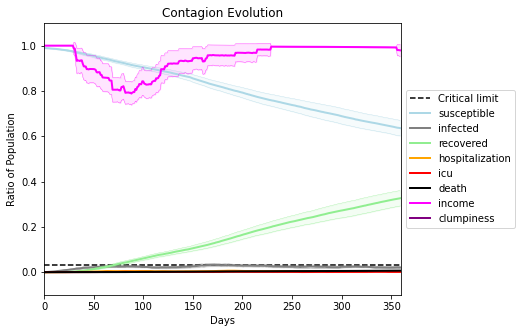

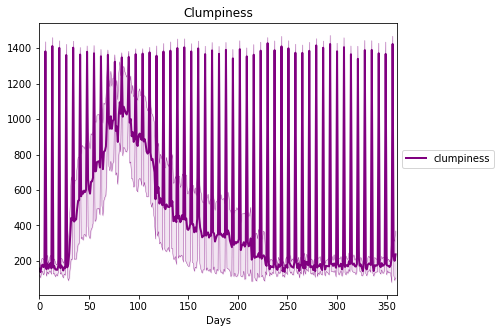

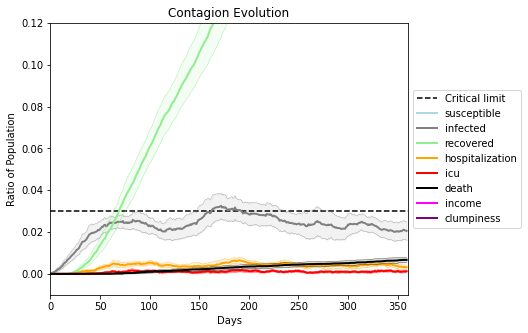

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[793, 7107, 4672, 9316, 5371, 4905, 1868, 1789, 6698, 2413, 5986, 3638, 7053, 8157, 9226, 8829, 5586, 1541, 1008, 8578]
Average similarity between family members is 0.9271477785413286 at temperature -0.992
Average similarity between family and home is 0.9998569729291477 at temperature -1
Average similarity between students and their classroom is 0.818228668907277 at temperature -0.992
Average classroom occupancy is 1.7116564417177915 and number classrooms is 163
Average similarity between workers is 0.8519073641609813 at temperature -0.992
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.8450776313529134 for kids: 0.7163067200135405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5468319148350798
avg restaurant similarity 0.5651443920089699
avg restaurant similarity 0.5773980791792231
avg restaurant similarity 0.5319483557586008
avg restaurant similarity 0.5593405784199715
avg restaurant similarity 0.568108877107578
avg restaurant similarity 0.5116116562527336
avg restaurant similarity 0.5397114414652883
avg restaurant similarity 0.5495357789941014
avg restaurant similarity 0.538367445776956
avg restaurant similarity 0.5572522259268246
avg restaurant similarity 0.5272520010939171
avg restaurant similarity 0.5636197174109654
avg restaurant similarity 0.5169794860459536
avg restaurant similarity 0.513840873053507
avg restaurant similarity 0.5065584086114622
avg restaurant similarity 0.590954403785687
avg restaurant similarity 0.5283197052890118
avg restaurant similarity 0.5560676395186824
avg restaurant similarity 0.5449183713501242
avg restaurant similarity 0.5003940046514586
avg restaurant similarity 0.5317309145220758
avg restaurant

avg restaurant similarity 0.4907741887316139
avg restaurant similarity 0.5396656455102105
avg restaurant similarity 0.5345854878210108
avg restaurant similarity 0.5762018909457701
avg restaurant similarity 0.4954389416438603
avg restaurant similarity 0.5248528469934863
avg restaurant similarity 0.521766147506219
avg restaurant similarity 0.5100028448418018
avg restaurant similarity 0.5294368231351638
avg restaurant similarity 0.5191183424005117
avg restaurant similarity 0.4595519347927116
avg restaurant similarity 0.47321419949700694
avg restaurant similarity 0.5160443968689368
avg restaurant similarity 0.5304855227901328
avg restaurant similarity 0.5166515317578738
avg restaurant similarity 0.5590814925728076
avg restaurant similarity 0.5198380321712448
avg restaurant similarity 0.48968619247139306
avg restaurant similarity 0.5358374537643419
avg restaurant similarity 0.5360105683439986
avg restaurant similarity 0.49732856063403913
avg restaurant similarity 0.5827105930397672
avg rest

Average similarity between workers is 0.8506145416640954 at temperature -0.992
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.8449766346398632 for kids: 0.7315975549117663
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allo

avg restaurant similarity 0.5288073484460204
avg restaurant similarity 0.4925921143999598
avg restaurant similarity 0.5873866700417226
avg restaurant similarity 0.5307513111079074
avg restaurant similarity 0.5159325869765825
avg restaurant similarity 0.5713545212805704
avg restaurant similarity 0.5716238740017948
avg restaurant similarity 0.539503407129664
avg restaurant similarity 0.5480608675708181
avg restaurant similarity 0.5607583061645839
avg restaurant similarity 0.5654912767693386
avg restaurant similarity 0.555279330244244
avg restaurant similarity 0.5537295958596029
avg restaurant similarity 0.587681659444922
avg restaurant similarity 0.5196194293711515
avg restaurant similarity 0.49605940525025516
avg restaurant similarity 0.5356332903717242
avg restaurant similarity 0.5462257354604193
avg restaurant similarity 0.5214761831937871
avg restaurant similarity 0.5551290497128429
avg restaurant similarity 0.4800788054470136
avg restaurant similarity 0.5494913386306747
avg restaura

avg restaurant similarity 0.5071278498529663
avg restaurant similarity 0.5026463892300291
avg restaurant similarity 0.5194069311971756
avg restaurant similarity 0.5121523400667476
avg restaurant similarity 0.5017270016736026
avg restaurant similarity 0.46406946583077585
avg restaurant similarity 0.5727106128071783
avg restaurant similarity 0.5650442856436
avg restaurant similarity 0.49247034441572957
avg restaurant similarity 0.5321975687503602
avg restaurant similarity 0.5029520937344331
avg restaurant similarity 0.5637003628797375
avg restaurant similarity 0.5135281201227427
avg restaurant similarity 0.5430950465455627
avg restaurant similarity 0.5339067293307759
avg restaurant similarity 0.5388918592316323
avg restaurant similarity 0.5545305216358488
avg restaurant similarity 0.5302221798481892
avg restaurant similarity 0.5551474618434711
avg restaurant similarity 0.5990286204459533
avg restaurant similarity 0.5011347945766549
avg restaurant similarity 0.4961021101672522
avg restaur

Average similarity between workers is 0.8569756928701117 at temperature -0.992
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.8420680993572282 for kids: 0.7272759296851438
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.5417182033308124
avg restaurant similarity 0.5959988328227666
avg restaurant similarity 0.5527810327840443
avg restaurant similarity 0.5466827135852957
avg restaurant similarity 0.5321440800022108
avg restaurant similarity 0.5674607316985074
avg restaurant similarity 0.5381357064367013
avg restaurant similarity 0.5502879666733438
avg restaurant similarity 0.5331916018612917
avg restaurant similarity 0.5777111771318522
avg restaurant similarity 0.5647349541314161
avg restaurant similarity 0.61282832856653
avg restaurant similarity 0.5622776141324296
avg restaurant similarity 0.5161603215765447
avg restaurant similarity 0.5667794436839586
avg restaurant similarity 0.5515144902145679
avg restaurant similarity 0.5508167483376883
avg restaurant similarity 0.5629544271673157
avg restaurant similarity 0.5829675299949036
avg restaurant similarity 0.5543107574727311
avg restaurant similarity 0.5455715789602542
avg restaurant similarity 0.5301653233845199
avg restaura

avg restaurant similarity 0.5677173554214308
avg restaurant similarity 0.5724948922339327
avg restaurant similarity 0.5250534194699362
avg restaurant similarity 0.558428715113187
avg restaurant similarity 0.5607053330551711
avg restaurant similarity 0.5865843576618597
avg restaurant similarity 0.5280003027828892
avg restaurant similarity 0.5678682583761937
avg restaurant similarity 0.6212448647085125
avg restaurant similarity 0.5765327597949407
avg restaurant similarity 0.5680893856853763
avg restaurant similarity 0.5876076844401479
avg restaurant similarity 0.5894202224457757
avg restaurant similarity 0.5895957741762726
avg restaurant similarity 0.6026117281237815
avg restaurant similarity 0.6032884527211345
avg restaurant similarity 0.5626423981516068
avg restaurant similarity 0.5492229898922181
avg restaurant similarity 0.5488979223852718
avg restaurant similarity 0.5899795117528437
avg restaurant similarity 0.5904872386081452
avg restaurant similarity 0.4899395152117434
avg restaur

Average similarity between workers is 0.8540303898622282 at temperature -0.992
Average office occupancy is 3.246153846153846 and number offices is 195
Average friend similarity for adults: 0.8301198534904679 for kids: 0.7278339547040029
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5091046020083583
avg restaurant similarity 0.5133363972698225
avg restaurant similarity 0.4902562606445516
avg restaurant similarity 0.5144580323067662
avg restaurant similarity 0.4872619483573245
avg restaurant similarity 0.5223458716975571
avg restaurant similarity 0.5269713140308457
avg restaurant similarity 0.5436666273220258
avg restaurant similarity 0.5474508686946347
avg restaurant similarity 0.5141244993786912
avg restaurant similarity 0.5495961852311642
avg restaurant similarity 0.5482048282221685
avg restaurant similarity 0.547549041882681
avg restaurant similarity 0.5036264989342747
avg restaurant similarity 0.5097474471655636
avg restaurant similarity 0.5124232933284684
avg restaurant similarity 0.5319460172235377
avg restaurant similarity 0.4680272100186955
avg restaurant similarity 0.4881436958646544
avg restaurant similarity 0.5302788348564265
avg restaurant similarity 0.4794319241960941
avg restaurant similarity 0.5189113998051839
avg restaur

avg restaurant similarity 0.4767060484121728
avg restaurant similarity 0.5248344442911109
avg restaurant similarity 0.5632561642725843
avg restaurant similarity 0.4852487042095403
avg restaurant similarity 0.5281842873505583
avg restaurant similarity 0.5145226720179079
avg restaurant similarity 0.4997714082938396
avg restaurant similarity 0.5030039451239794
avg restaurant similarity 0.4624927370598835
avg restaurant similarity 0.4959550683761267
avg restaurant similarity 0.4767233894753607
avg restaurant similarity 0.511613098233724
avg restaurant similarity 0.5069179074676459
avg restaurant similarity 0.4818035042897687
avg restaurant similarity 0.49487713818809437
avg restaurant similarity 0.5339633084589683
avg restaurant similarity 0.4658580371905269
avg restaurant similarity 0.5178953534511541
avg restaurant similarity 0.4955027722619304
avg restaurant similarity 0.48296872455197765
avg restaurant similarity 0.49799665381283037
avg restaurant similarity 0.4676804989463837
avg rest

Average similarity between workers is 0.8502216103417399 at temperature -0.992
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.8497883739548755 for kids: 0.7308644542811344
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5284130445454233
avg restaurant similarity 0.5464879884981472
avg restaurant similarity 0.5271533566922173
avg restaurant similarity 0.5194412105155106
avg restaurant similarity 0.5565939419403475
avg restaurant similarity 0.5342118891837699
avg restaurant similarity 0.503968187584692
avg restaurant similarity 0.6090680639963977
avg restaurant similarity 0.5550938694448168
avg restaurant similarity 0.5368378152990356
avg restaurant similarity 0.5746332157681524
avg restaurant similarity 0.5852822709820208
avg restaurant similarity 0.5819285463197017
avg restaurant similarity 0.5528125832561467
avg restaurant similarity 0.5765314412315448
avg restaurant similarity 0.5750409336520591
avg restaurant similarity 0.5782847431704385
avg restaurant similarity 0.5008693396541425
avg restaurant similarity 0.5501279341871965
avg restaurant similarity 0.5113732568126383
avg restaurant similarity 0.5523306082479376
avg restaurant similarity 0.5876260523700446
avg restaur

avg restaurant similarity 0.5055954638756345
avg restaurant similarity 0.5046532632014037
avg restaurant similarity 0.5257537118516844
avg restaurant similarity 0.4926046901610617
avg restaurant similarity 0.5247995824189251
avg restaurant similarity 0.539190567829482
avg restaurant similarity 0.5054251919990049
avg restaurant similarity 0.5626632732701305
avg restaurant similarity 0.5450677751729781
avg restaurant similarity 0.5361187934299991
avg restaurant similarity 0.5415478142224825
avg restaurant similarity 0.5371061642820656
avg restaurant similarity 0.5674558586977911
avg restaurant similarity 0.4763832749898215
avg restaurant similarity 0.5691435190465975
avg restaurant similarity 0.5034195248048225
avg restaurant similarity 0.5430137792389228
avg restaurant similarity 0.5282871888834626
avg restaurant similarity 0.4948584405941989
avg restaurant similarity 0.5038632690349577
avg restaurant similarity 0.5393843906361158
avg restaurant similarity 0.5095788692564185
avg restaur

Average similarity between workers is 0.8412986970338857 at temperature -0.992
Average office occupancy is 3.4489795918367347 and number offices is 196
Average friend similarity for adults: 0.840213870512634 for kids: 0.7038585369552414
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.460744696796765
avg restaurant similarity 0.5443542684381552
avg restaurant similarity 0.4878713722847205
avg restaurant similarity 0.48223634698393214
avg restaurant similarity 0.561276401125541
avg restaurant similarity 0.5260414637284236
avg restaurant similarity 0.5163503540679643
avg restaurant similarity 0.5136624070648479
avg restaurant similarity 0.5548228635702109
avg restaurant similarity 0.5767846297483612
avg restaurant similarity 0.6108295102304947
avg restaurant similarity 0.5448529684346399
avg restaurant similarity 0.5377807221236164
avg restaurant similarity 0.5635474899108861
avg restaurant similarity 0.4833131958713616
avg restaurant similarity 0.5603985618912511
avg restaurant similarity 0.5318860342949127
avg restaurant similarity 0.5863412012869875
avg restaurant similarity 0.5393048211879452
avg restaurant similarity 0.558860607907351
avg restaurant similarity 0.5252409584469742
avg restaurant similarity 0.5264615393194808
avg restaura

avg restaurant similarity 0.5240407866094062
avg restaurant similarity 0.5708076169403454
avg restaurant similarity 0.5368939521800953
avg restaurant similarity 0.5732233528981228
avg restaurant similarity 0.5740818718232811
avg restaurant similarity 0.4659670533009276
avg restaurant similarity 0.5324210304241919
avg restaurant similarity 0.4997352429424841
avg restaurant similarity 0.5535013275454984
avg restaurant similarity 0.4922864338245522
avg restaurant similarity 0.5635657051034395
avg restaurant similarity 0.48114066573189923
avg restaurant similarity 0.5661235832228667
avg restaurant similarity 0.49698113201415844
avg restaurant similarity 0.5384109819596977
avg restaurant similarity 0.5660056247068684
avg restaurant similarity 0.5358272963489163
avg restaurant similarity 0.5257761926866614
avg restaurant similarity 0.5397635815270243
avg restaurant similarity 0.5173596877785624
avg restaurant similarity 0.559868581475116
avg restaurant similarity 0.5353646284421892
avg resta

Average similarity between workers is 0.8641644076376558 at temperature -0.992
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8486696623963307 for kids: 0.7310365290675387
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6002550738242519
avg restaurant similarity 0.5417625337433852
avg restaurant similarity 0.5584903584715939
avg restaurant similarity 0.5424869468460509
avg restaurant similarity 0.5170680566902596
avg restaurant similarity 0.45442344613279567
avg restaurant similarity 0.5650347503078458
avg restaurant similarity 0.5430223138268749
avg restaurant similarity 0.5940300562885891
avg restaurant similarity 0.5355715126563676
avg restaurant similarity 0.5551793984244229
avg restaurant similarity 0.5707405188517822
avg restaurant similarity 0.5730935449902287
avg restaurant similarity 0.5687466081406474
avg restaurant similarity 0.5382965562748457
avg restaurant similarity 0.5274456499277573
avg restaurant similarity 0.5563890543111436
avg restaurant similarity 0.5265450771772865
avg restaurant similarity 0.5865232375485973
avg restaurant similarity 0.5103492387496498
avg restaurant similarity 0.5855327726489227
avg restaurant similarity 0.5266596537634891
avg resta

avg restaurant similarity 0.5024350566070651
avg restaurant similarity 0.607481729486564
avg restaurant similarity 0.49104511480434754
avg restaurant similarity 0.5224364883143435
avg restaurant similarity 0.5361732567685469
avg restaurant similarity 0.5227095324114509
avg restaurant similarity 0.5860527307057778
avg restaurant similarity 0.5138876214892113
avg restaurant similarity 0.5014490149934232
avg restaurant similarity 0.48279234065261656
avg restaurant similarity 0.5750121151488974
avg restaurant similarity 0.5773274487764579
avg restaurant similarity 0.5140546371644654
avg restaurant similarity 0.5937754683280221
avg restaurant similarity 0.5449898226010021
avg restaurant similarity 0.5387320485330449
avg restaurant similarity 0.5427424394744255
avg restaurant similarity 0.5073611029711266
avg restaurant similarity 0.49281173865384925
avg restaurant similarity 0.5207128603239054
avg restaurant similarity 0.5851429987298976
avg restaurant similarity 0.5287740272387965
avg rest

Average similarity between workers is 0.8453401153000232 at temperature -0.992
Average office occupancy is 3.3541666666666665 and number offices is 192
Average friend similarity for adults: 0.8332817017100138 for kids: 0.7342002776127464
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5343732928850653
avg restaurant similarity 0.4567715255041604
avg restaurant similarity 0.5964010508511757
avg restaurant similarity 0.5219839323443172
avg restaurant similarity 0.5278187384008222
avg restaurant similarity 0.558409192008924
avg restaurant similarity 0.5150150116884579
avg restaurant similarity 0.5332013354592061
avg restaurant similarity 0.5127119428441933
avg restaurant similarity 0.4891792568224145
avg restaurant similarity 0.5042607925572389
avg restaurant similarity 0.5663391740217162
avg restaurant similarity 0.509256971623258
avg restaurant similarity 0.4564977190985744
avg restaurant similarity 0.5549321388210935
avg restaurant similarity 0.5474264457709914
avg restaurant similarity 0.5804763502169362
avg restaurant similarity 0.5306206691004338
avg restaurant similarity 0.533880779338417
avg restaurant similarity 0.5194467948530039
avg restaurant similarity 0.5297983348037174
avg restaurant similarity 0.5490666267714827
avg restauran

avg restaurant similarity 0.5672285402076978
avg restaurant similarity 0.5677399421006896
avg restaurant similarity 0.5135205995073827
avg restaurant similarity 0.5276034055543777
avg restaurant similarity 0.513178575307723
avg restaurant similarity 0.5676717076056467
avg restaurant similarity 0.5434387040407667
avg restaurant similarity 0.5127714256207381
avg restaurant similarity 0.5734458449987831
avg restaurant similarity 0.5647353320380679
avg restaurant similarity 0.4928724022628664
avg restaurant similarity 0.5077503932973115
avg restaurant similarity 0.5125813618928433
avg restaurant similarity 0.5307766157950826
avg restaurant similarity 0.5760585032368098
avg restaurant similarity 0.5167832495414411
avg restaurant similarity 0.5217333050466421
avg restaurant similarity 0.5949596270544949
avg restaurant similarity 0.5170677937797405
avg restaurant similarity 0.5207056101631173
avg restaurant similarity 0.48059966812837535
avg restaurant similarity 0.5921889142331492
avg restau

Average similarity between workers is 0.8495104548338461 at temperature -0.992
Average office occupancy is 3.4381443298969074 and number offices is 194
Average friend similarity for adults: 0.8415419333264471 for kids: 0.723914201131041
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.5636293390357182
avg restaurant similarity 0.5013415842367466
avg restaurant similarity 0.5235086578682407
avg restaurant similarity 0.4748009177181447
avg restaurant similarity 0.5396976332749738
avg restaurant similarity 0.5424168514593315
avg restaurant similarity 0.5115036259977901
avg restaurant similarity 0.5022644734829241
avg restaurant similarity 0.5446022494724639
avg restaurant similarity 0.5795868878072897
avg restaurant similarity 0.5141598424296243
avg restaurant similarity 0.5244067261792508
avg restaurant similarity 0.4762341081526447
avg restaurant similarity 0.5384942503614685
avg restaurant similarity 0.5316705275010221
avg restaurant similarity 0.5178166117654519
avg restaurant similarity 0.4854163550709119
avg restaurant similarity 0.5009235387737656
avg restaurant similarity 0.4908063994725009
avg restaurant similarity 0.5009036061264402
avg restaurant similarity 0.5579152370646215
avg restaurant similarity 0.5380538044893777
avg restau

avg restaurant similarity 0.5579491091022011
avg restaurant similarity 0.5130744695867807
avg restaurant similarity 0.49607508808813616
avg restaurant similarity 0.5141363032964315
avg restaurant similarity 0.5245951188557051
avg restaurant similarity 0.6239793132640774
avg restaurant similarity 0.5705796130810498
avg restaurant similarity 0.5223323629944232
avg restaurant similarity 0.5129789542587461
avg restaurant similarity 0.5583294706436223
avg restaurant similarity 0.560865226202081
avg restaurant similarity 0.47908793981047026
avg restaurant similarity 0.4864732618732037
avg restaurant similarity 0.5079954329910729
avg restaurant similarity 0.47673541815925863
avg restaurant similarity 0.5610914844760555
avg restaurant similarity 0.5217689055323508
avg restaurant similarity 0.47732027135098765
avg restaurant similarity 0.5072249197188438
avg restaurant similarity 0.500223288978854
avg restaurant similarity 0.5341639725035726
avg restaurant similarity 0.5016388707814126
avg rest

Average similarity between workers is 0.8372082877642016 at temperature -0.992
Average office occupancy is 3.4183673469387754 and number offices is 196
Average friend similarity for adults: 0.8432062641457623 for kids: 0.7209193349905231
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.5713767487386678
avg restaurant similarity 0.5872266744346379
avg restaurant similarity 0.6247498010106909
avg restaurant similarity 0.5657851009545809
avg restaurant similarity 0.552521629595837
avg restaurant similarity 0.5418691248542289
avg restaurant similarity 0.4782249504331701
avg restaurant similarity 0.5333142753371832
avg restaurant similarity 0.5472172546510515
avg restaurant similarity 0.5243134374085031
avg restaurant similarity 0.5224624418132053
avg restaurant similarity 0.48885012905299197
avg restaurant similarity 0.5796039727001226
avg restaurant similarity 0.570664833685229
avg restaurant similarity 0.5163597354803957
avg restaurant similarity 0.5291381149429698
avg restaurant similarity 0.5453934104494605
avg restaurant similarity 0.5140096106694803
avg restaurant similarity 0.544961233227493
avg restaurant similarity 0.588987574266929
avg restaurant similarity 0.5457017188464757
avg restaurant similarity 0.47668165761588355
avg restaura

avg restaurant similarity 0.5599072808629937
avg restaurant similarity 0.5577898701399027
avg restaurant similarity 0.5433390233619091
avg restaurant similarity 0.5576111955154388
avg restaurant similarity 0.554916382431774
avg restaurant similarity 0.5367837998387492
avg restaurant similarity 0.5311654794558957
avg restaurant similarity 0.5353227593171095
avg restaurant similarity 0.48812658436904793
avg restaurant similarity 0.5269248276351475
avg restaurant similarity 0.49044700285984916
avg restaurant similarity 0.5488200203466128
avg restaurant similarity 0.5288260578747865
avg restaurant similarity 0.5454652149121261
avg restaurant similarity 0.4915969592161052
avg restaurant similarity 0.557507990910907
avg restaurant similarity 0.5271462934815246
avg restaurant similarity 0.5210876593254382
avg restaurant similarity 0.5225972306765838
avg restaurant similarity 0.6027125086789297
avg restaurant similarity 0.5346356810442792
avg restaurant similarity 0.5267363600869207
avg restau

Average similarity between workers is 0.8595237630071074 at temperature -0.992
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8314404711803745 for kids: 0.7062386175184951
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5106009677602532
avg restaurant similarity 0.45144577623992593
avg restaurant similarity 0.47101378361130497
avg restaurant similarity 0.5051676069551427
avg restaurant similarity 0.4799161559625798
avg restaurant similarity 0.4930538989655537
avg restaurant similarity 0.5105889024747173
avg restaurant similarity 0.489396899726308
avg restaurant similarity 0.5330336336308794
avg restaurant similarity 0.5333508460733616
avg restaurant similarity 0.5788367304372791
avg restaurant similarity 0.531773779684305
avg restaurant similarity 0.5210694756984517
avg restaurant similarity 0.5439626253614877
avg restaurant similarity 0.5561326473149228
avg restaurant similarity 0.5368880114422219
avg restaurant similarity 0.5119665622571538
avg restaurant similarity 0.5075467540487125
avg restaurant similarity 0.46386841070245055
avg restaurant similarity 0.5286153253431708
avg restaurant similarity 0.5689384098438071
avg restaurant similarity 0.5010431311407533
avg resta

avg restaurant similarity 0.5264312867618609
avg restaurant similarity 0.5042565524021267
avg restaurant similarity 0.5357106623316663
avg restaurant similarity 0.5074425243356632
avg restaurant similarity 0.5176711831065625
avg restaurant similarity 0.5388237411745913
avg restaurant similarity 0.45711361307592324
avg restaurant similarity 0.5758548083084349
avg restaurant similarity 0.5310739304101819
avg restaurant similarity 0.564540831895242
avg restaurant similarity 0.5470240846546541
avg restaurant similarity 0.4950327369248563
avg restaurant similarity 0.494183753619057
avg restaurant similarity 0.510934622833021
avg restaurant similarity 0.49233016591563056
avg restaurant similarity 0.5313213168289433
avg restaurant similarity 0.5271041766388519
avg restaurant similarity 0.4900769395387893
avg restaurant similarity 0.48190567057632777
avg restaurant similarity 0.5571897844770922
avg restaurant similarity 0.5020342531684708
avg restaurant similarity 0.4907916259171898
avg restau

Average similarity between workers is 0.8594106308701835 at temperature -0.992
Average office occupancy is 3.484375 and number offices is 192
Average friend similarity for adults: 0.8517701886493712 for kids: 0.7310819582335331
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people 

avg restaurant similarity 0.48861928935997734
avg restaurant similarity 0.5466643272831299
avg restaurant similarity 0.46566873077360915
avg restaurant similarity 0.5269191072634456
avg restaurant similarity 0.5858383157592929
avg restaurant similarity 0.5186299623079955
avg restaurant similarity 0.5723315515224576
avg restaurant similarity 0.5181391980989407
avg restaurant similarity 0.5700853667481686
avg restaurant similarity 0.5583047478148263
avg restaurant similarity 0.5431678076528408
avg restaurant similarity 0.5152472452383668
avg restaurant similarity 0.5658712873226943
avg restaurant similarity 0.5678602569311924
avg restaurant similarity 0.5461364082058614
avg restaurant similarity 0.5068642581800341
avg restaurant similarity 0.5670523935653169
avg restaurant similarity 0.5613035464602376
avg restaurant similarity 0.572610330594087
avg restaurant similarity 0.49571020408780425
avg restaurant similarity 0.5594171747344012
avg restaurant similarity 0.5196156434105181
avg rest

avg restaurant similarity 0.5115722168299961
avg restaurant similarity 0.554420194227634
avg restaurant similarity 0.5905883098624769
avg restaurant similarity 0.5396890107825206
avg restaurant similarity 0.5356917400540435
avg restaurant similarity 0.5189523250629205
avg restaurant similarity 0.550876987274432
avg restaurant similarity 0.5511828218861733
avg restaurant similarity 0.6007117966649572
avg restaurant similarity 0.6074787835913897
avg restaurant similarity 0.558950964521568
avg restaurant similarity 0.5691779906867439
avg restaurant similarity 0.5313292404253239
avg restaurant similarity 0.5555607912066282
avg restaurant similarity 0.5248754918009872
avg restaurant similarity 0.519904950213584
avg restaurant similarity 0.46574684158664714
avg restaurant similarity 0.4830624865326443
avg restaurant similarity 0.520232623906104
avg restaurant similarity 0.5250095513791229
avg restaurant similarity 0.5926542006948967
avg restaurant similarity 0.5111548320457365
avg restaurant

Average similarity between workers is 0.8524985625202404 at temperature -0.992
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.8473115256225253 for kids: 0.7209864202559713
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allo

avg restaurant similarity 0.5271131309887072
avg restaurant similarity 0.5495242233060907
avg restaurant similarity 0.579575640278226
avg restaurant similarity 0.548834142491194
avg restaurant similarity 0.5447107760076836
avg restaurant similarity 0.5636473215841342
avg restaurant similarity 0.5391255559121603
avg restaurant similarity 0.5294566422332304
avg restaurant similarity 0.5819944265558566
avg restaurant similarity 0.5579022014712717
avg restaurant similarity 0.5773424786098866
avg restaurant similarity 0.565942455139162
avg restaurant similarity 0.540557848015433
avg restaurant similarity 0.5713316426466248
avg restaurant similarity 0.5624728350034323
avg restaurant similarity 0.5147200530058174
avg restaurant similarity 0.5664066224956346
avg restaurant similarity 0.5175472206572802
avg restaurant similarity 0.5701363104701052
avg restaurant similarity 0.5225124565297822
avg restaurant similarity 0.5474872595112823
avg restaurant similarity 0.5524252276575586
avg restaurant

avg restaurant similarity 0.5583909266052659
avg restaurant similarity 0.5289222698873435
avg restaurant similarity 0.5019087285413204
avg restaurant similarity 0.5739693039311924
avg restaurant similarity 0.5415746898756891
avg restaurant similarity 0.5739885618212748
avg restaurant similarity 0.5811304711020697
avg restaurant similarity 0.5632923909153779
avg restaurant similarity 0.5687310406681153
avg restaurant similarity 0.5754204230829724
avg restaurant similarity 0.5577890542256143
avg restaurant similarity 0.5818937337320073
avg restaurant similarity 0.5479010507931884
avg restaurant similarity 0.5456685409229786
avg restaurant similarity 0.5191766902366886
avg restaurant similarity 0.5326215247265509
avg restaurant similarity 0.49309976378173415
avg restaurant similarity 0.5352037917473129
avg restaurant similarity 0.5839302104290551
avg restaurant similarity 0.5701501322884844
avg restaurant similarity 0.5663648202841033
avg restaurant similarity 0.6019676695313665
avg resta

Average similarity between workers is 0.8546687944448731 at temperature -0.992
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.8423565212132545 for kids: 0.7271610997991974
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5469068276042587
avg restaurant similarity 0.5758588526220885
avg restaurant similarity 0.510799012181793
avg restaurant similarity 0.4895159378384985
avg restaurant similarity 0.5304759541650742
avg restaurant similarity 0.542253770215816
avg restaurant similarity 0.5127884342975041
avg restaurant similarity 0.5267087125440325
avg restaurant similarity 0.5210292370021029
avg restaurant similarity 0.53910364900713
avg restaurant similarity 0.529095935975576
avg restaurant similarity 0.4971189955585507
avg restaurant similarity 0.5437518498656354
avg restaurant similarity 0.5826451830357618
avg restaurant similarity 0.5753114187103537
avg restaurant similarity 0.515977043170253
avg restaurant similarity 0.5479510464425729
avg restaurant similarity 0.5452824585899295
avg restaurant similarity 0.5776219852331078
avg restaurant similarity 0.5589238985514091
avg restaurant similarity 0.5721179511602438
avg restaurant similarity 0.5390082861846595
avg restaurant s

avg restaurant similarity 0.5233060659582316
avg restaurant similarity 0.5218173161696931
avg restaurant similarity 0.5116744128063216
avg restaurant similarity 0.5129023142351927
avg restaurant similarity 0.5656139896715775
avg restaurant similarity 0.5252094987683904
avg restaurant similarity 0.5406255862309857
avg restaurant similarity 0.5417162996771238
avg restaurant similarity 0.5499015001013887
avg restaurant similarity 0.5287194255571349
avg restaurant similarity 0.5368501758791874
avg restaurant similarity 0.5686455291014427
avg restaurant similarity 0.5544050598743208
avg restaurant similarity 0.5380044287110974
avg restaurant similarity 0.6146840146863525
avg restaurant similarity 0.48136950998712175
avg restaurant similarity 0.5658805902073226
avg restaurant similarity 0.5678645956330108
avg restaurant similarity 0.5462185018741131
avg restaurant similarity 0.557214379891317
avg restaurant similarity 0.5127541022510298
avg restaurant similarity 0.5728855405783211
avg restau

Average similarity between workers is 0.840456152659732 at temperature -0.992
Average office occupancy is 3.3526315789473684 and number offices is 190
Average friend similarity for adults: 0.8384021695446481 for kids: 0.7326443060253359
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5123801940373558
avg restaurant similarity 0.5289157886144819
avg restaurant similarity 0.5022587500112543
avg restaurant similarity 0.5512853080134064
avg restaurant similarity 0.5191602101224929
avg restaurant similarity 0.49959049566049635
avg restaurant similarity 0.49588036966857574
avg restaurant similarity 0.5266107581685443
avg restaurant similarity 0.5773780243789668
avg restaurant similarity 0.5485329380197548
avg restaurant similarity 0.5289203974902758
avg restaurant similarity 0.5269282916386919
avg restaurant similarity 0.5479763114699127
avg restaurant similarity 0.4836857326031073
avg restaurant similarity 0.5228604463544819
avg restaurant similarity 0.5082898037542334
avg restaurant similarity 0.5222674727024609
avg restaurant similarity 0.5471735279259975
avg restaurant similarity 0.5359362744838018
avg restaurant similarity 0.4865298876870013
avg restaurant similarity 0.5713683894587971
avg restaurant similarity 0.5027079368546263
avg rest

avg restaurant similarity 0.5226458924953138
avg restaurant similarity 0.5383044914443109
avg restaurant similarity 0.5348836789916221
avg restaurant similarity 0.5237642308430261
avg restaurant similarity 0.5193745399328566
avg restaurant similarity 0.49175328812677666
avg restaurant similarity 0.5561164048836088
avg restaurant similarity 0.5239044309118454
avg restaurant similarity 0.5600113054054561
avg restaurant similarity 0.5374254502672688
avg restaurant similarity 0.5595926223021513
avg restaurant similarity 0.5317360790913123
avg restaurant similarity 0.5714190766692445
avg restaurant similarity 0.5135836561373995
avg restaurant similarity 0.554130496420189
avg restaurant similarity 0.5606652963551635
avg restaurant similarity 0.5288698443039058
avg restaurant similarity 0.5426646512227467
avg restaurant similarity 0.5328012916178468
avg restaurant similarity 0.5491074073570876
avg restaurant similarity 0.5637842709568115
avg restaurant similarity 0.5386730630259066
avg restau

Average similarity between workers is 0.8626496787372626 at temperature -0.992
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8543872878004116 for kids: 0.7429832915689882
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5103843222858029
avg restaurant similarity 0.5005391939044681
avg restaurant similarity 0.4894999053631045
avg restaurant similarity 0.5267107174983283
avg restaurant similarity 0.5079498343420144
avg restaurant similarity 0.5254102978122741
avg restaurant similarity 0.4849730567139492
avg restaurant similarity 0.4942885712593766
avg restaurant similarity 0.532403389771955
avg restaurant similarity 0.5087227753445723
avg restaurant similarity 0.5145697092199368
avg restaurant similarity 0.5125688285945117
avg restaurant similarity 0.49058542851422354
avg restaurant similarity 0.5078356640282304
avg restaurant similarity 0.526676599027187
avg restaurant similarity 0.5410832061526352
avg restaurant similarity 0.5588829128816458
avg restaurant similarity 0.5151108695082296
avg restaurant similarity 0.554306982580814
avg restaurant similarity 0.5363551616281813
avg restaurant similarity 0.4852452276970673
avg restaurant similarity 0.5304203791720866
avg restaura

avg restaurant similarity 0.5517158238579222
avg restaurant similarity 0.49412343377252643
avg restaurant similarity 0.45918599970692153
avg restaurant similarity 0.5270940469867046
avg restaurant similarity 0.5438363803871767
avg restaurant similarity 0.5339152737864363
avg restaurant similarity 0.48299145180241954
avg restaurant similarity 0.5324670032761494
avg restaurant similarity 0.46156798665746873
avg restaurant similarity 0.5253699417001141
avg restaurant similarity 0.5036688474332482
avg restaurant similarity 0.5212360988151553
avg restaurant similarity 0.5548999813952613
avg restaurant similarity 0.5268762916715626
avg restaurant similarity 0.5142045707098786
avg restaurant similarity 0.4957959362272745
avg restaurant similarity 0.5075700514713242
avg restaurant similarity 0.5371645390772719
avg restaurant similarity 0.49935604412589685
avg restaurant similarity 0.5346821578266672
avg restaurant similarity 0.48150458587033385
avg restaurant similarity 0.547953941343154
avg r

Average similarity between workers is 0.8489666524210258 at temperature -0.992
Average office occupancy is 3.4030612244897958 and number offices is 196
Average friend similarity for adults: 0.8487852230397666 for kids: 0.725022650440988
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6056583941962079
avg restaurant similarity 0.5717061549370781
avg restaurant similarity 0.518354731895391
avg restaurant similarity 0.5562709382198814
avg restaurant similarity 0.5205905259078616
avg restaurant similarity 0.5352256801055484
avg restaurant similarity 0.55966507059828
avg restaurant similarity 0.5538517693918968
avg restaurant similarity 0.5515697266396976
avg restaurant similarity 0.48605093209226163
avg restaurant similarity 0.5353809221942122
avg restaurant similarity 0.5962867669916847
avg restaurant similarity 0.5109503744321068
avg restaurant similarity 0.5528309212875813
avg restaurant similarity 0.5225527888715126
avg restaurant similarity 0.589666781284869
avg restaurant similarity 0.515086992341024
avg restaurant similarity 0.525702131775796
avg restaurant similarity 0.4876635175125965
avg restaurant similarity 0.5409521653460068
avg restaurant similarity 0.518301700268191
avg restaurant similarity 0.5572219813413283
avg restaurant s

avg restaurant similarity 0.5297533048889536
avg restaurant similarity 0.5649645603948549
avg restaurant similarity 0.5355893348768473
avg restaurant similarity 0.5186411518247926
avg restaurant similarity 0.5488732844620444
avg restaurant similarity 0.5659534215654481
avg restaurant similarity 0.5589602389478122
avg restaurant similarity 0.5077712384154455
avg restaurant similarity 0.5025536914777998
avg restaurant similarity 0.5484114567369867
avg restaurant similarity 0.5353153381239328
avg restaurant similarity 0.4801847920340198
avg restaurant similarity 0.5667929699966748
avg restaurant similarity 0.5267319103849575
avg restaurant similarity 0.5077902355601059
avg restaurant similarity 0.49981179158613437
avg restaurant similarity 0.5624094483076367
avg restaurant similarity 0.5322283190923608
avg restaurant similarity 0.4999187494265399
avg restaurant similarity 0.5849325311751782
avg restaurant similarity 0.5220819897119646
avg restaurant similarity 0.5162312118979749
avg resta

Average similarity between workers is 0.8467390662221721 at temperature -0.992
Average office occupancy is 3.4343434343434343 and number offices is 198
Average friend similarity for adults: 0.8326348842846288 for kids: 0.7051636162262649
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.4938381597472858
avg restaurant similarity 0.4491365358191724
avg restaurant similarity 0.5388506754948991
avg restaurant similarity 0.5366613499080541
avg restaurant similarity 0.49164837535065486
avg restaurant similarity 0.43984379110656574
avg restaurant similarity 0.5063681180654295
avg restaurant similarity 0.49833904015077984
avg restaurant similarity 0.5086841400459926
avg restaurant similarity 0.5020044549179287
avg restaurant similarity 0.4623415323487182
avg restaurant similarity 0.5102301393162374
avg restaurant similarity 0.4989257248802004
avg restaurant similarity 0.5145062456993856
avg restaurant similarity 0.5517200634214572
avg restaurant similarity 0.4627588053791002
avg restaurant similarity 0.453314139704997
avg restaurant similarity 0.5144136079535874
avg restaurant similarity 0.5148961443997481
avg restaurant similarity 0.534295106347021
avg restaurant similarity 0.4859612000486618
avg restaurant similarity 0.45749788948093484
avg rest

avg restaurant similarity 0.5286887537511574
avg restaurant similarity 0.5196252881464128
avg restaurant similarity 0.5036416802150695
avg restaurant similarity 0.48650569948473366
avg restaurant similarity 0.49983354888233067
avg restaurant similarity 0.4745332666015443
avg restaurant similarity 0.4992374410814857
avg restaurant similarity 0.49534615977686186
avg restaurant similarity 0.5249180169438513
avg restaurant similarity 0.4993845412107486
avg restaurant similarity 0.4947270403959294
avg restaurant similarity 0.5314680533448188
avg restaurant similarity 0.4729780380704051
avg restaurant similarity 0.510765579373588
avg restaurant similarity 0.4985599445638935
avg restaurant similarity 0.4937913774858449
avg restaurant similarity 0.4908528443463767
avg restaurant similarity 0.497203397206903
avg restaurant similarity 0.5386902255051319
avg restaurant similarity 0.5055962569841912
avg restaurant similarity 0.5128340439154208
avg restaurant similarity 0.547142303980251
avg restau

Average similarity between workers is 0.860891043612118 at temperature -0.992
Average office occupancy is 3.2741116751269037 and number offices is 197
Average friend similarity for adults: 0.8448944515740725 for kids: 0.724543798857539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5257688623837431
avg restaurant similarity 0.5423181520618604
avg restaurant similarity 0.4683609133041528
avg restaurant similarity 0.512011485676178
avg restaurant similarity 0.4864254311235374
avg restaurant similarity 0.5874096664271787
avg restaurant similarity 0.5325532509018338
avg restaurant similarity 0.5431850517557838
avg restaurant similarity 0.5585882911272921
avg restaurant similarity 0.5355551482813389
avg restaurant similarity 0.4559293234400314
avg restaurant similarity 0.5764833196315393
avg restaurant similarity 0.5125496928179663
avg restaurant similarity 0.5527328160087488
avg restaurant similarity 0.5526579182370154
avg restaurant similarity 0.5329655530076769
avg restaurant similarity 0.4723382268177303
avg restaurant similarity 0.4837559236521135
avg restaurant similarity 0.5668742252088855
avg restaurant similarity 0.5019838357753753
avg restaurant similarity 0.4699827985533039
avg restaurant similarity 0.5349870944656475
avg restaur

avg restaurant similarity 0.5245650074226016
avg restaurant similarity 0.5060228098733927
avg restaurant similarity 0.5640613611408835
avg restaurant similarity 0.5243237017960884
avg restaurant similarity 0.5275749309131122
avg restaurant similarity 0.47248632733583734
avg restaurant similarity 0.5064927486631192
avg restaurant similarity 0.4878620119662121
avg restaurant similarity 0.5185641853433773
avg restaurant similarity 0.5421674792913319
avg restaurant similarity 0.4843335949846869
avg restaurant similarity 0.510161267746191
avg restaurant similarity 0.4761128210047187
avg restaurant similarity 0.5431368950153349
avg restaurant similarity 0.5300393147771618
avg restaurant similarity 0.5477450291106893
avg restaurant similarity 0.5359807204942493
avg restaurant similarity 0.575328089335444
avg restaurant similarity 0.519702128167088
avg restaurant similarity 0.5036267179468457
avg restaurant similarity 0.5383213298393074
avg restaurant similarity 0.5403469293849935
avg restaura

Average similarity between workers is 0.840973727163085 at temperature -0.992
Average office occupancy is 3.4329896907216493 and number offices is 194
Average friend similarity for adults: 0.8441551816325755 for kids: 0.7018376624044004
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5539248343741316
avg restaurant similarity 0.5385915771249803
avg restaurant similarity 0.5325395154272486
avg restaurant similarity 0.5277834207617446
avg restaurant similarity 0.5730444478383487
avg restaurant similarity 0.5671302776671828
avg restaurant similarity 0.5300261703504701
avg restaurant similarity 0.5454364510445985
avg restaurant similarity 0.5503373728803131
avg restaurant similarity 0.555424036614961
avg restaurant similarity 0.5451200162966461
avg restaurant similarity 0.5881739608587859
avg restaurant similarity 0.5227135477954032
avg restaurant similarity 0.496546867676366
avg restaurant similarity 0.5372554845936964
avg restaurant similarity 0.5317032190497479
avg restaurant similarity 0.5403585210077095
avg restaurant similarity 0.597318765545613
avg restaurant similarity 0.5252766551068835
avg restaurant similarity 0.5825363826667168
avg restaurant similarity 0.55045181731106
avg restaurant similarity 0.5744351177809826
avg restaurant 

avg restaurant similarity 0.5446061091877731
avg restaurant similarity 0.507867148758031
avg restaurant similarity 0.5763412733698371
avg restaurant similarity 0.5518626760343777
avg restaurant similarity 0.5279667640741132
avg restaurant similarity 0.5153674582316979
avg restaurant similarity 0.5866963471851862
avg restaurant similarity 0.5729753769713456
avg restaurant similarity 0.4799318853666582
avg restaurant similarity 0.5593233506284251
avg restaurant similarity 0.5626910883785993
avg restaurant similarity 0.6056186333406564
avg restaurant similarity 0.5549140261987694
avg restaurant similarity 0.5425916297297387
avg restaurant similarity 0.5737724622910984
avg restaurant similarity 0.63119380679555
avg restaurant similarity 0.522111419997876
avg restaurant similarity 0.5469566749647229
avg restaurant similarity 0.524510527235658
avg restaurant similarity 0.5486645122635085
avg restaurant similarity 0.5845578781077957
avg restaurant similarity 0.5357881665818904
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

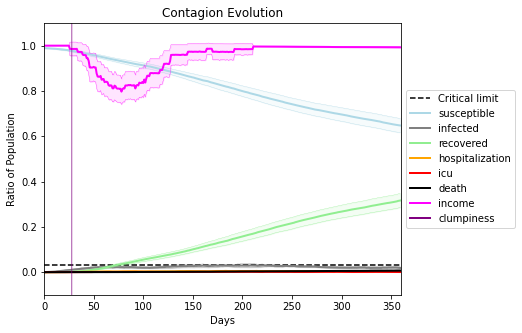

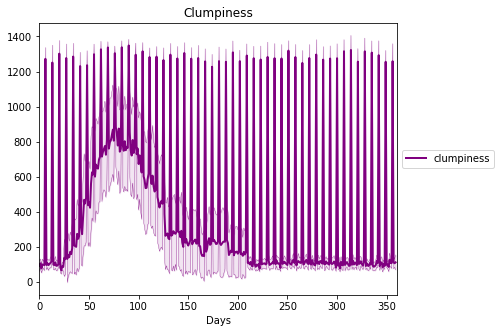

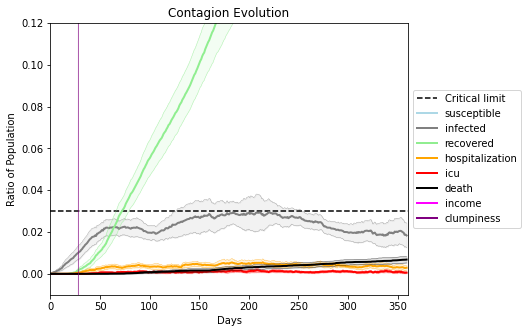

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1799, 3793, 8387, 1324, 6395, 4866, 957, 6959, 6286, 7939, 4605, 5377, 5933, 5828, 2147, 8150, 9401, 1912, 2832, 2315]
Average similarity between family members is 0.9094240804991376 at temperature -0.991
Average similarity between family and home is 0.9998525334977136 at temperature -1
Average similarity between students and their classroom is 0.8147423489125383 at temperature -0.991
Average classroom occupancy is 1.6473988439306357 and number classrooms is 173
Average similarity between workers is 0.8331180633594787 at temperature -0.991
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.8387342259451706 for kids: 0.7208860642743525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.4955786873983065
avg restaurant similarity 0.5118484410770177
avg restaurant similarity 0.5133147640533225
avg restaurant similarity 0.5031667916108903
avg restaurant similarity 0.4995357708423104
avg restaurant similarity 0.4929105936024417
avg restaurant similarity 0.5462159524445922
avg restaurant similarity 0.4454595037108541
avg restaurant similarity 0.512905226237597
avg restaurant similarity 0.4907120652129716
avg restaurant similarity 0.5110589181618893
avg restaurant similarity 0.6100114283635053
avg restaurant similarity 0.5516772909652432
avg restaurant similarity 0.5280288036683718
avg restaurant similarity 0.45396773110330296
avg restaurant similarity 0.5263890197985136
avg restaurant similarity 0.48822317027175755
avg restaurant similarity 0.5029047410186225
avg restaurant similarity 0.5293904073274552
avg restaurant similarity 0.4889555274785458
avg restaurant similarity 0.479038905399318
avg restaurant similarity 0.5618329029084909
avg restau

avg restaurant similarity 0.5128819548878923
avg restaurant similarity 0.5294216285825349
avg restaurant similarity 0.5370897420466495
avg restaurant similarity 0.48001882350024144
avg restaurant similarity 0.48814073838560745
avg restaurant similarity 0.48778791076775535
avg restaurant similarity 0.5240953154602928
avg restaurant similarity 0.5458947742637035
avg restaurant similarity 0.5437363004450934
avg restaurant similarity 0.4960245832333493
avg restaurant similarity 0.47571207537313337
avg restaurant similarity 0.5322744794753741
avg restaurant similarity 0.4806600060543813
avg restaurant similarity 0.5257289424144895
avg restaurant similarity 0.5583207268248629
avg restaurant similarity 0.5188871202435493
avg restaurant similarity 0.5492317923573369
avg restaurant similarity 0.5194168583804114
avg restaurant similarity 0.49507710017728396
avg restaurant similarity 0.5116665467522532
avg restaurant similarity 0.5267913339576047
avg restaurant similarity 0.4992220834187182
avg r

Average similarity between workers is 0.8309567989990863 at temperature -0.991
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8347784937128905 for kids: 0.7158620785012797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.5885531456796959
avg restaurant similarity 0.4607993893039663
avg restaurant similarity 0.4397452585441379
avg restaurant similarity 0.5106851684229997
avg restaurant similarity 0.4856641845607504
avg restaurant similarity 0.5217859952934162
avg restaurant similarity 0.5105295263269041
avg restaurant similarity 0.5237112895261455
avg restaurant similarity 0.4937520686101958
avg restaurant similarity 0.5472264561404833
avg restaurant similarity 0.48066885351711625
avg restaurant similarity 0.5188738639740005
avg restaurant similarity 0.4984910602251743
avg restaurant similarity 0.44934905484833654
avg restaurant similarity 0.5800959296445009
avg restaurant similarity 0.508383887689686
avg restaurant similarity 0.49892068410539414
avg restaurant similarity 0.5509180191314808
avg restaurant similarity 0.5360837463900934
avg restaurant similarity 0.5670066902370369
avg restaurant similarity 0.44292715594959836
avg restaurant similarity 0.49715926017544715
avg re

avg restaurant similarity 0.4898256600951093
avg restaurant similarity 0.49294199105625647
avg restaurant similarity 0.5227266822197705
avg restaurant similarity 0.5054924474233737
avg restaurant similarity 0.4403790258526573
avg restaurant similarity 0.5485766172802885
avg restaurant similarity 0.5307114353197298
avg restaurant similarity 0.5512131974378582
avg restaurant similarity 0.5050931754168329
avg restaurant similarity 0.5246004814105552
avg restaurant similarity 0.44432677165508866
avg restaurant similarity 0.5172190973684662
avg restaurant similarity 0.49030142953039435
avg restaurant similarity 0.5449991497046945
avg restaurant similarity 0.5308469007434942
avg restaurant similarity 0.497633775033895
avg restaurant similarity 0.4913622384568721
avg restaurant similarity 0.5761565041737523
avg restaurant similarity 0.45387485023256885
avg restaurant similarity 0.5221936823688741
avg restaurant similarity 0.5153188035793338
avg restaurant similarity 0.4629337693048961
avg res

Average similarity between workers is 0.8415568545029481 at temperature -0.991
Average office occupancy is 3.359375 and number offices is 192
Average friend similarity for adults: 0.8433734858226015 for kids: 0.7262395696867463
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people 

avg restaurant similarity 0.4963706798872663
avg restaurant similarity 0.4978978591171442
avg restaurant similarity 0.5158494204263644
avg restaurant similarity 0.45670496870522226
avg restaurant similarity 0.5289478024385699
avg restaurant similarity 0.5268023274463023
avg restaurant similarity 0.5276111539275333
avg restaurant similarity 0.5109854112241848
avg restaurant similarity 0.524294109262278
avg restaurant similarity 0.5460586410079875
avg restaurant similarity 0.5434920418966207
avg restaurant similarity 0.5394216911514199
avg restaurant similarity 0.5176370113616671
avg restaurant similarity 0.5137194115588346
avg restaurant similarity 0.5166976092386387
avg restaurant similarity 0.4853762655912282
avg restaurant similarity 0.5169409072644093
avg restaurant similarity 0.5118018873304486
avg restaurant similarity 0.4695643214034388
avg restaurant similarity 0.4829744020060344
avg restaurant similarity 0.5788066147790857
avg restaurant similarity 0.47779087257901026
avg resta

avg restaurant similarity 0.5009268057650716
avg restaurant similarity 0.5273146137376062
avg restaurant similarity 0.5228333864813343
avg restaurant similarity 0.49381643090345545
avg restaurant similarity 0.4784167245870702
avg restaurant similarity 0.5284222717359061
avg restaurant similarity 0.5281221377167342
avg restaurant similarity 0.45910862682012243
avg restaurant similarity 0.49290530619472617
avg restaurant similarity 0.5007418955572055
avg restaurant similarity 0.4925374701532655
avg restaurant similarity 0.5420289697137468
avg restaurant similarity 0.504755776123388
avg restaurant similarity 0.4512650586130382
avg restaurant similarity 0.5238619581865167
avg restaurant similarity 0.4827401401567536
avg restaurant similarity 0.5051179247300581
avg restaurant similarity 0.5086399540068103
avg restaurant similarity 0.5085713764130146
avg restaurant similarity 0.5596609343903375
avg restaurant similarity 0.512085489909978
avg restaurant similarity 0.48557132541177395
avg rest

Average similarity between workers is 0.8564419438094875 at temperature -0.991
Average office occupancy is 3.3402061855670104 and number offices is 194
Average friend similarity for adults: 0.840325932309373 for kids: 0.7274943649719823
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5857739611170678
avg restaurant similarity 0.5466863289741927
avg restaurant similarity 0.5478052512028933
avg restaurant similarity 0.4934261857318871
avg restaurant similarity 0.5018523472841463
avg restaurant similarity 0.5612649142384447
avg restaurant similarity 0.5416983568766877
avg restaurant similarity 0.5614119040802931
avg restaurant similarity 0.5079568472120345
avg restaurant similarity 0.5915332066316923
avg restaurant similarity 0.5370003297885368
avg restaurant similarity 0.5985326151893539
avg restaurant similarity 0.5717191052643836
avg restaurant similarity 0.5068405289002922
avg restaurant similarity 0.472959352113862
avg restaurant similarity 0.5383373343007737
avg restaurant similarity 0.53794832612797
avg restaurant similarity 0.5633385694831462
avg restaurant similarity 0.5632986436090902
avg restaurant similarity 0.5827627258447544
avg restaurant similarity 0.5233136619545132
avg restaurant similarity 0.5295197328190294
avg restauran

avg restaurant similarity 0.5358737422085093
avg restaurant similarity 0.5504057399875768
avg restaurant similarity 0.5098808154689927
avg restaurant similarity 0.5929397305667283
avg restaurant similarity 0.47701236464695046
avg restaurant similarity 0.5780780366605363
avg restaurant similarity 0.5769915099194
avg restaurant similarity 0.5418621823407811
avg restaurant similarity 0.5225253402220688
avg restaurant similarity 0.5403606094740792
avg restaurant similarity 0.5460312955673141
avg restaurant similarity 0.48947128803959683
avg restaurant similarity 0.5381509495531797
avg restaurant similarity 0.5104250901758367
avg restaurant similarity 0.49546862959273935
avg restaurant similarity 0.5378882672839524
avg restaurant similarity 0.5402471694018307
avg restaurant similarity 0.5273818996369584
avg restaurant similarity 0.5330222088455546
avg restaurant similarity 0.5438797493086212
avg restaurant similarity 0.5500463607998572
avg restaurant similarity 0.5178684732405457
avg restau

Average similarity between workers is 0.8317412943461983 at temperature -0.991
Average office occupancy is 3.416243654822335 and number offices is 197
Average friend similarity for adults: 0.8410034257579891 for kids: 0.7181594115776616
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.4469827339398215
avg restaurant similarity 0.519768415062669
avg restaurant similarity 0.4926213591774946
avg restaurant similarity 0.5129955175095995
avg restaurant similarity 0.5015055850454457
avg restaurant similarity 0.4889919457340476
avg restaurant similarity 0.5203074333754045
avg restaurant similarity 0.4667843814845584
avg restaurant similarity 0.4416566065882564
avg restaurant similarity 0.4860078939971342
avg restaurant similarity 0.4708565226144297
avg restaurant similarity 0.4495345945689563
avg restaurant similarity 0.42220304731427855
avg restaurant similarity 0.5688104962813612
avg restaurant similarity 0.43882937313961934
avg restaurant similarity 0.4833698648101493
avg restaurant similarity 0.5242692228438859
avg restaurant similarity 0.5088532865179155
avg restaurant similarity 0.47236733590501806
avg restaurant similarity 0.524685276663046
avg restaurant similarity 0.5083116475651943
avg restaurant similarity 0.4944325801013516
avg resta

avg restaurant similarity 0.47207387934192657
avg restaurant similarity 0.5170430368317684
avg restaurant similarity 0.5495260002091102
avg restaurant similarity 0.5471420548813307
avg restaurant similarity 0.44932548219196394
avg restaurant similarity 0.5167168350422213
avg restaurant similarity 0.47745693776000536
avg restaurant similarity 0.44195060779945206
avg restaurant similarity 0.5096957036813423
avg restaurant similarity 0.5166769253488599
avg restaurant similarity 0.5669130404595532
avg restaurant similarity 0.49872181523017534
avg restaurant similarity 0.5093699236447525
avg restaurant similarity 0.5647303315283599
avg restaurant similarity 0.4426995630618362
avg restaurant similarity 0.4894006242707638
avg restaurant similarity 0.4996637048274501
avg restaurant similarity 0.4798710019481276
avg restaurant similarity 0.5321595392508175
avg restaurant similarity 0.48705885975598723
avg restaurant similarity 0.46733356190049957
avg restaurant similarity 0.522286614679504
avg 

Average similarity between workers is 0.8426582315530716 at temperature -0.991
Average office occupancy is 3.4764397905759163 and number offices is 191
Average friend similarity for adults: 0.8513470618741644 for kids: 0.724844472283956
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 peop

avg restaurant similarity 0.5464166423126742
avg restaurant similarity 0.54910241624785
avg restaurant similarity 0.5760180041906523
avg restaurant similarity 0.5115827842294135
avg restaurant similarity 0.5223340715782373
avg restaurant similarity 0.5598503842840226
avg restaurant similarity 0.5090938461774691
avg restaurant similarity 0.5850391998293369
avg restaurant similarity 0.5348836928072491
avg restaurant similarity 0.5324952571079048
avg restaurant similarity 0.5452995557369359
avg restaurant similarity 0.5419395898678246
avg restaurant similarity 0.5092255347137903
avg restaurant similarity 0.5887269570278624
avg restaurant similarity 0.5344487859572022
avg restaurant similarity 0.5430513626583068
avg restaurant similarity 0.5537366102921016
avg restaurant similarity 0.4924871500929439
avg restaurant similarity 0.5237038545917619
avg restaurant similarity 0.5363648612371769
avg restaurant similarity 0.5587799236461415
avg restaurant similarity 0.5942623951897871
avg restaura

avg restaurant similarity 0.47931026199597454
avg restaurant similarity 0.547302267246979
avg restaurant similarity 0.537478608191447
avg restaurant similarity 0.5868046068167948
avg restaurant similarity 0.5648261516628953
avg restaurant similarity 0.5738262287941135
avg restaurant similarity 0.5615962311153544
avg restaurant similarity 0.5390343121980761
avg restaurant similarity 0.4923160919207534
avg restaurant similarity 0.5769664557458943
avg restaurant similarity 0.5399052638263514
avg restaurant similarity 0.5640790961744081
avg restaurant similarity 0.5572386976717063
avg restaurant similarity 0.5629544910440908
avg restaurant similarity 0.5371319432839864
avg restaurant similarity 0.5889175559501755
avg restaurant similarity 0.5771902288010753
avg restaurant similarity 0.5290807799447055
avg restaurant similarity 0.5016200522865639
avg restaurant similarity 0.5624137509211748
avg restaurant similarity 0.5556619007509777
avg restaurant similarity 0.4698703663033714
avg restaur

Average similarity between workers is 0.8340300241951546 at temperature -0.991
Average office occupancy is 3.315 and number offices is 200
Average friend similarity for adults: 0.8327618989665052 for kids: 0.7253520443827068
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people all

avg restaurant similarity 0.42373533615436215
avg restaurant similarity 0.5296809448099875
avg restaurant similarity 0.5604403528070042
avg restaurant similarity 0.5390245289087799
avg restaurant similarity 0.45978531647649834
avg restaurant similarity 0.5331984246385978
avg restaurant similarity 0.4540284304221577
avg restaurant similarity 0.4530872175067591
avg restaurant similarity 0.5466588811785194
avg restaurant similarity 0.5466569990739388
avg restaurant similarity 0.5004167354054597
avg restaurant similarity 0.5170099212834058
avg restaurant similarity 0.5202629634068613
avg restaurant similarity 0.4438775524616628
avg restaurant similarity 0.47538614196236717
avg restaurant similarity 0.497478215531098
avg restaurant similarity 0.4816385314940974
avg restaurant similarity 0.4881997605243366
avg restaurant similarity 0.5123358689665993
avg restaurant similarity 0.5053437347469957
avg restaurant similarity 0.4928901784803005
avg restaurant similarity 0.4915789710626839
avg rest

avg restaurant similarity 0.5022140853890212
avg restaurant similarity 0.5229926277233451
avg restaurant similarity 0.47949854843700546
avg restaurant similarity 0.4939818830573296
avg restaurant similarity 0.4999065898500637
avg restaurant similarity 0.5175434480519742
avg restaurant similarity 0.5133259324888376
avg restaurant similarity 0.532570239188662
avg restaurant similarity 0.48214442122005224
avg restaurant similarity 0.4888018942672026
avg restaurant similarity 0.5306787873472162
avg restaurant similarity 0.4820682828778654
avg restaurant similarity 0.5331876919263346
avg restaurant similarity 0.4578358254613731
avg restaurant similarity 0.4759765410938405
avg restaurant similarity 0.47745436616264614
avg restaurant similarity 0.5231130173272209
avg restaurant similarity 0.5639647391810149
avg restaurant similarity 0.4919664955672587
avg restaurant similarity 0.5399551685472855
avg restaurant similarity 0.5144335908944179
avg restaurant similarity 0.559996415275597
avg resta

Average similarity between workers is 0.8398926639874265 at temperature -0.991
Average office occupancy is 3.3195876288659796 and number offices is 194
Average friend similarity for adults: 0.8376387129366618 for kids: 0.7296185032292125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5125848959381876
avg restaurant similarity 0.5122428019983292
avg restaurant similarity 0.5160279845038727
avg restaurant similarity 0.4816206274453805
avg restaurant similarity 0.5678018656314502
avg restaurant similarity 0.5512754666656688
avg restaurant similarity 0.5343642941128255
avg restaurant similarity 0.4871256733693517
avg restaurant similarity 0.564998519427546
avg restaurant similarity 0.5240841034905293
avg restaurant similarity 0.5220722014723188
avg restaurant similarity 0.4895543053443738
avg restaurant similarity 0.47074356008183077
avg restaurant similarity 0.5510677594736936
avg restaurant similarity 0.5385051627013228
avg restaurant similarity 0.516864345580929
avg restaurant similarity 0.5091600287223585
avg restaurant similarity 0.5160070416942769
avg restaurant similarity 0.5158594533752194
avg restaurant similarity 0.557792749286946
avg restaurant similarity 0.556693911406196
avg restaurant similarity 0.5345338499057607
avg restauran

avg restaurant similarity 0.5093483914071419
avg restaurant similarity 0.5442187175517758
avg restaurant similarity 0.5222085317923872
avg restaurant similarity 0.5268745485676399
avg restaurant similarity 0.5406843337633724
avg restaurant similarity 0.5257398855770921
avg restaurant similarity 0.5251577929740431
avg restaurant similarity 0.5060585046226446
avg restaurant similarity 0.5486189058540265
avg restaurant similarity 0.4606930237755518
avg restaurant similarity 0.5513374649350545
avg restaurant similarity 0.5383922833227098
avg restaurant similarity 0.4979460534339218
avg restaurant similarity 0.5329616278624746
avg restaurant similarity 0.5558824851364822
avg restaurant similarity 0.5297499710296086
avg restaurant similarity 0.49360324142685524
avg restaurant similarity 0.5037089526974566
avg restaurant similarity 0.5829332485943463
avg restaurant similarity 0.5109642854760373
avg restaurant similarity 0.5318881699864186
avg restaurant similarity 0.5381960730239346
avg resta

Average similarity between workers is 0.8337798301081548 at temperature -0.991
Average office occupancy is 3.5751295336787563 and number offices is 193
Average friend similarity for adults: 0.8411290730455384 for kids: 0.7121821487086902
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.517344490165352
avg restaurant similarity 0.5642784955966291
avg restaurant similarity 0.5439170702810451
avg restaurant similarity 0.5712827550339229
avg restaurant similarity 0.5225154949724302
avg restaurant similarity 0.478272391438656
avg restaurant similarity 0.49878850798213886
avg restaurant similarity 0.5315489928716148
avg restaurant similarity 0.5614461362094232
avg restaurant similarity 0.5621717760680802
avg restaurant similarity 0.507814468446178
avg restaurant similarity 0.5226788242934863
avg restaurant similarity 0.5171983659538284
avg restaurant similarity 0.48541993045615356
avg restaurant similarity 0.5222940520429767
avg restaurant similarity 0.5266305938168775
avg restaurant similarity 0.5316892666006305
avg restaurant similarity 0.5535768213624861
avg restaurant similarity 0.5079925185727595
avg restaurant similarity 0.4937122390759251
avg restaurant similarity 0.5276363796089429
avg restaurant similarity 0.5537933770075399
avg restaur

avg restaurant similarity 0.5215986670990916
avg restaurant similarity 0.5291052527009716
avg restaurant similarity 0.5092948507402999
avg restaurant similarity 0.5266356106288679
avg restaurant similarity 0.5215929344526006
avg restaurant similarity 0.49094029519296595
avg restaurant similarity 0.5187332203425573
avg restaurant similarity 0.5091165180191835
avg restaurant similarity 0.5292376275228736
avg restaurant similarity 0.5907405099618599
avg restaurant similarity 0.5488394839278851
avg restaurant similarity 0.5049516247632624
avg restaurant similarity 0.5389655710801797
avg restaurant similarity 0.5202341947724848
avg restaurant similarity 0.49892718387695806
avg restaurant similarity 0.558228282271297
avg restaurant similarity 0.5084550850692746
avg restaurant similarity 0.4986723711966298
avg restaurant similarity 0.5063320419148547
avg restaurant similarity 0.4977723318469951
avg restaurant similarity 0.5747900775742985
avg restaurant similarity 0.5656907597544164
avg resta

Average similarity between workers is 0.8344124761566775 at temperature -0.991
Average office occupancy is 3.5678391959798996 and number offices is 199
Average friend similarity for adults: 0.838260649989189 for kids: 0.6874094874043314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5187477565934834
avg restaurant similarity 0.5104327895537883
avg restaurant similarity 0.5679167649984452
avg restaurant similarity 0.49401209779404404
avg restaurant similarity 0.5029331019210189
avg restaurant similarity 0.5200789455616283
avg restaurant similarity 0.5328087692587704
avg restaurant similarity 0.5334328659312465
avg restaurant similarity 0.5035145733446605
avg restaurant similarity 0.5689525657869238
avg restaurant similarity 0.4990004165748611
avg restaurant similarity 0.5211663028444298
avg restaurant similarity 0.5176811608034764
avg restaurant similarity 0.5162485165728682
avg restaurant similarity 0.5149823430824816
avg restaurant similarity 0.5103331442848057
avg restaurant similarity 0.5259531756605309
avg restaurant similarity 0.5109714598550906
avg restaurant similarity 0.551606725200063
avg restaurant similarity 0.5218267797818775
avg restaurant similarity 0.5071126694251812
avg restaurant similarity 0.49127211059315956
avg resta

avg restaurant similarity 0.5499773026980264
avg restaurant similarity 0.47175913443920725
avg restaurant similarity 0.5089559081350231
avg restaurant similarity 0.5232963501352095
avg restaurant similarity 0.49733850005
avg restaurant similarity 0.5285470038588764
avg restaurant similarity 0.5078639875285955
avg restaurant similarity 0.45745125293048383
avg restaurant similarity 0.4978897984554696
avg restaurant similarity 0.5443253441321754
avg restaurant similarity 0.5451147589338746
avg restaurant similarity 0.5823259969951137
avg restaurant similarity 0.5644740074818565
avg restaurant similarity 0.5157955271879554
avg restaurant similarity 0.5095943312520131
avg restaurant similarity 0.512019543208909
avg restaurant similarity 0.5418042903511536
avg restaurant similarity 0.5535219723300201
avg restaurant similarity 0.5632055908669091
avg restaurant similarity 0.49569705949948284
avg restaurant similarity 0.5464201513755733
avg restaurant similarity 0.5770511967288356
avg restauran

Average similarity between workers is 0.8382071707096947 at temperature -0.991
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.825705089310165 for kids: 0.7278631221929045
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.5359746854850858
avg restaurant similarity 0.530325502150724
avg restaurant similarity 0.552731167600597
avg restaurant similarity 0.53306659814811
avg restaurant similarity 0.4988287259207356
avg restaurant similarity 0.525333048538367
avg restaurant similarity 0.46364851428846277
avg restaurant similarity 0.5128174380653533
avg restaurant similarity 0.5562370762316224
avg restaurant similarity 0.5226416303679102
avg restaurant similarity 0.4766800113987491
avg restaurant similarity 0.5311598739374758
avg restaurant similarity 0.5147502206475038
avg restaurant similarity 0.47047279455955293
avg restaurant similarity 0.5266143444149589
avg restaurant similarity 0.4755715038990405
avg restaurant similarity 0.5256243249051685
avg restaurant similarity 0.5447984884707967
avg restaurant similarity 0.5328021195336189
avg restaurant similarity 0.5529419598993197
avg restaurant similarity 0.5535278127888793
avg restaurant similarity 0.44380581702027344
avg restaura

avg restaurant similarity 0.5515679918826976
avg restaurant similarity 0.5040509021962462
avg restaurant similarity 0.519571379219778
avg restaurant similarity 0.5472938844794215
avg restaurant similarity 0.5052998373638731
avg restaurant similarity 0.47650181691194343
avg restaurant similarity 0.5586694227368905
avg restaurant similarity 0.4609131983156027
avg restaurant similarity 0.5513451531773091
avg restaurant similarity 0.5874324839810147
avg restaurant similarity 0.5663004334642798
avg restaurant similarity 0.5004300428411166
avg restaurant similarity 0.5297223113502981
avg restaurant similarity 0.5652756210616643
avg restaurant similarity 0.4787319759538994
avg restaurant similarity 0.5507905957176769
avg restaurant similarity 0.49781792940826797
avg restaurant similarity 0.4382524112385905
avg restaurant similarity 0.49350429969732057
avg restaurant similarity 0.4826896895854322
avg restaurant similarity 0.5718921640873572
avg restaurant similarity 0.4343965911883477
avg rest

Average similarity between workers is 0.8367454297040569 at temperature -0.991
Average office occupancy is 3.238578680203046 and number offices is 197
Average friend similarity for adults: 0.8330531370186409 for kids: 0.7335689496273888
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.558194704295097
avg restaurant similarity 0.5293003151996201
avg restaurant similarity 0.5444044075345517
avg restaurant similarity 0.5592285601771219
avg restaurant similarity 0.5205477501016569
avg restaurant similarity 0.5587337384255289
avg restaurant similarity 0.5560466185639634
avg restaurant similarity 0.5401384869376457
avg restaurant similarity 0.5231159662309586
avg restaurant similarity 0.5459419057296342
avg restaurant similarity 0.48914256542394063
avg restaurant similarity 0.5784174290301655
avg restaurant similarity 0.5319486264449916
avg restaurant similarity 0.5184241360953642
avg restaurant similarity 0.5194933078320911
avg restaurant similarity 0.5170877803313485
avg restaurant similarity 0.5404960340880576
avg restaurant similarity 0.5662448031299518
avg restaurant similarity 0.5507743065216547
avg restaurant similarity 0.5637558223075431
avg restaurant similarity 0.5008580987720327
avg restaurant similarity 0.5276111689910855
avg restau

avg restaurant similarity 0.5119025659981209
avg restaurant similarity 0.6081114758671758
avg restaurant similarity 0.5075762495358019
avg restaurant similarity 0.5737922106315562
avg restaurant similarity 0.5290751125585551
avg restaurant similarity 0.5257972091381686
avg restaurant similarity 0.5529259719507827
avg restaurant similarity 0.5269314541666552
avg restaurant similarity 0.5468389966864996
avg restaurant similarity 0.5368188988674858
avg restaurant similarity 0.5413890392892303
avg restaurant similarity 0.554279740527066
avg restaurant similarity 0.5084436732205014
avg restaurant similarity 0.5579966708461133
avg restaurant similarity 0.5226351350649856
avg restaurant similarity 0.5088404561336448
avg restaurant similarity 0.5603909199253413
avg restaurant similarity 0.5650015154059512
avg restaurant similarity 0.522266770927607
avg restaurant similarity 0.5940797970378484
avg restaurant similarity 0.5389454560658391
avg restaurant similarity 0.5381438181370255
avg restaura

Average similarity between workers is 0.8438577013079093 at temperature -0.991
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8459222834804114 for kids: 0.7295199215689143
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5735276140720406
avg restaurant similarity 0.4819513504253306
avg restaurant similarity 0.516704779974232
avg restaurant similarity 0.526475622851497
avg restaurant similarity 0.6376306927256534
avg restaurant similarity 0.5277066035961613
avg restaurant similarity 0.6125690286160748
avg restaurant similarity 0.5688191313396487
avg restaurant similarity 0.5461407138118809
avg restaurant similarity 0.6416266227453806
avg restaurant similarity 0.5891150707916614
avg restaurant similarity 0.5416122653803862
avg restaurant similarity 0.5451482827845852
avg restaurant similarity 0.5541044998167448
avg restaurant similarity 0.6139622886809464
avg restaurant similarity 0.57661373091539
avg restaurant similarity 0.5986898034345611
avg restaurant similarity 0.4982195546441621
avg restaurant similarity 0.5507542399688784
avg restaurant similarity 0.5210543402197152
avg restaurant similarity 0.5675087639836757
avg restaurant similarity 0.5518890923335964
avg restaurant

avg restaurant similarity 0.5459024211713573
avg restaurant similarity 0.5196573805651625
avg restaurant similarity 0.5128713805555652
avg restaurant similarity 0.5676470691230356
avg restaurant similarity 0.5818458355632954
avg restaurant similarity 0.6103236194556969
avg restaurant similarity 0.581911688492688
avg restaurant similarity 0.5302938229627375
avg restaurant similarity 0.5637341449839147
avg restaurant similarity 0.6319897533578
avg restaurant similarity 0.5885303045339514
avg restaurant similarity 0.5500125073693409
avg restaurant similarity 0.6030986579126992
avg restaurant similarity 0.6255963536327898
avg restaurant similarity 0.597106136960027
avg restaurant similarity 0.5545589802245396
avg restaurant similarity 0.5126090760164252
avg restaurant similarity 0.5582892607838029
avg restaurant similarity 0.5261065600005447
avg restaurant similarity 0.576133567335734
avg restaurant similarity 0.5492357003453595
avg restaurant similarity 0.4811118935662123
avg restaurant s

Average similarity between workers is 0.8331926498853091 at temperature -0.991
Average office occupancy is 3.414141414141414 and number offices is 198
Average friend similarity for adults: 0.834960685471693 for kids: 0.7092541113333343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5561912044044689
avg restaurant similarity 0.5481663056216365
avg restaurant similarity 0.5123346502138304
avg restaurant similarity 0.5559189594755906
avg restaurant similarity 0.533964647389358
avg restaurant similarity 0.547779708339449
avg restaurant similarity 0.552317266527973
avg restaurant similarity 0.4846647130609222
avg restaurant similarity 0.546935254103323
avg restaurant similarity 0.5433763187401578
avg restaurant similarity 0.48144647325764106
avg restaurant similarity 0.5003270105094547
avg restaurant similarity 0.4760619526398262
avg restaurant similarity 0.5532978053518879
avg restaurant similarity 0.54710355237498
avg restaurant similarity 0.5298255963958377
avg restaurant similarity 0.5200537943925625
avg restaurant similarity 0.5309310403015146
avg restaurant similarity 0.5430141254862227
avg restaurant similarity 0.5009957976669972
avg restaurant similarity 0.5534243590376444
avg restaurant similarity 0.5363579440751562
avg restaurant 

avg restaurant similarity 0.5290968221589138
avg restaurant similarity 0.49111805373400763
avg restaurant similarity 0.5733430878760157
avg restaurant similarity 0.47372480917014187
avg restaurant similarity 0.5283364276219135
avg restaurant similarity 0.5260300160452548
avg restaurant similarity 0.5259946004885991
avg restaurant similarity 0.4948949460113762
avg restaurant similarity 0.532537192869005
avg restaurant similarity 0.5020713699739977
avg restaurant similarity 0.5179413020313918
avg restaurant similarity 0.54469550570155
avg restaurant similarity 0.49904273349669376
avg restaurant similarity 0.5099164195384611
avg restaurant similarity 0.5661767545610191
avg restaurant similarity 0.49710727219501727
avg restaurant similarity 0.5508574369216118
avg restaurant similarity 0.5371028822612016
avg restaurant similarity 0.548553935556587
avg restaurant similarity 0.517827127046554
avg restaurant similarity 0.5087464688511258
avg restaurant similarity 0.5277869044866956
avg restaur

Average similarity between workers is 0.8325677024101238 at temperature -0.991
Average office occupancy is 3.414141414141414 and number offices is 198
Average friend similarity for adults: 0.8400079849343159 for kids: 0.7372944038710206
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.5858632856459882
avg restaurant similarity 0.47629233050696596
avg restaurant similarity 0.5662240606447201
avg restaurant similarity 0.5264478241061353
avg restaurant similarity 0.5587567792032984
avg restaurant similarity 0.5486920787427334
avg restaurant similarity 0.5750899937502867
avg restaurant similarity 0.5502378874527412
avg restaurant similarity 0.5198140310367636
avg restaurant similarity 0.48681206896308354
avg restaurant similarity 0.5731148827363948
avg restaurant similarity 0.4858794349974512
avg restaurant similarity 0.5273981317562147
avg restaurant similarity 0.544148441811422
avg restaurant similarity 0.4923035230039991
avg restaurant similarity 0.5312655284680868
avg restaurant similarity 0.5032598063179663
avg restaurant similarity 0.5068110189296269
avg restaurant similarity 0.5303464809586388
avg restaurant similarity 0.5524374813490345
avg restaurant similarity 0.5625093671323701
avg restaurant similarity 0.5599042693300696
avg resta

avg restaurant similarity 0.5194912487557334
avg restaurant similarity 0.5278557793990374
avg restaurant similarity 0.522601722659834
avg restaurant similarity 0.5601341738911819
avg restaurant similarity 0.5255005889763338
avg restaurant similarity 0.5211747993553549
avg restaurant similarity 0.5262409465229891
avg restaurant similarity 0.5388019124145288
avg restaurant similarity 0.5301706661909884
avg restaurant similarity 0.5191929712461852
avg restaurant similarity 0.5232902044446914
avg restaurant similarity 0.5460913580462068
avg restaurant similarity 0.49246432847888155
avg restaurant similarity 0.5485325735010689
avg restaurant similarity 0.5184037073571881
avg restaurant similarity 0.54401365907235
avg restaurant similarity 0.5378537736440878
avg restaurant similarity 0.5565534557455586
avg restaurant similarity 0.5516413534794617
avg restaurant similarity 0.4709625476682177
avg restaurant similarity 0.5289936150695039
avg restaurant similarity 0.5038415172197525
avg restaura

Average similarity between workers is 0.8309492915453661 at temperature -0.991
Average office occupancy is 3.3366336633663365 and number offices is 202
Average friend similarity for adults: 0.8444813334228993 for kids: 0.7271954281247586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.5689416401904362
avg restaurant similarity 0.5126467829734088
avg restaurant similarity 0.5080418206847821
avg restaurant similarity 0.5440498280682816
avg restaurant similarity 0.5529126454226369
avg restaurant similarity 0.48670841714689617
avg restaurant similarity 0.5053975823360306
avg restaurant similarity 0.5247596866637505
avg restaurant similarity 0.5721029450563716
avg restaurant similarity 0.5157159382699839
avg restaurant similarity 0.4961803094674375
avg restaurant similarity 0.4845958550075159
avg restaurant similarity 0.4686892856973844
avg restaurant similarity 0.49205730894430827
avg restaurant similarity 0.48743610669391846
avg restaurant similarity 0.5137469112931504
avg restaurant similarity 0.5162130120754612
avg restaurant similarity 0.577459903744912
avg restaurant similarity 0.4767818816691004
avg restaurant similarity 0.5259889789117782
avg restaurant similarity 0.4966398728364034
avg restaurant similarity 0.4624843883690029
avg rest

avg restaurant similarity 0.564396413487639
avg restaurant similarity 0.5331411123300737
avg restaurant similarity 0.48138808236290215
avg restaurant similarity 0.48139914378097703
avg restaurant similarity 0.5113574106376527
avg restaurant similarity 0.4819106368576318
avg restaurant similarity 0.5169200405093061
avg restaurant similarity 0.5133388639811189
avg restaurant similarity 0.5437362874303836
avg restaurant similarity 0.5389087372330185
avg restaurant similarity 0.4928447692238016
avg restaurant similarity 0.48826811733669584
avg restaurant similarity 0.5162621086177992
avg restaurant similarity 0.5461177405589375
avg restaurant similarity 0.5261251120856344
avg restaurant similarity 0.4757211198216626
avg restaurant similarity 0.45820023655163045
avg restaurant similarity 0.5226175611571058
avg restaurant similarity 0.5127963031813348
avg restaurant similarity 0.519888373669453
avg restaurant similarity 0.50117649752064
avg restaurant similarity 0.4459843698330151
avg restau

Average similarity between workers is 0.8330467584557677 at temperature -0.991
Average office occupancy is 3.436548223350254 and number offices is 197
Average friend similarity for adults: 0.8420998569298739 for kids: 0.728793361481898
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peo

avg restaurant similarity 0.5107803554676184
avg restaurant similarity 0.5653578397181366
avg restaurant similarity 0.4987525083279656
avg restaurant similarity 0.46568270481775714
avg restaurant similarity 0.5104596007303985
avg restaurant similarity 0.5200414286570073
avg restaurant similarity 0.469700406481133
avg restaurant similarity 0.4875054264639467
avg restaurant similarity 0.47849069466030375
avg restaurant similarity 0.5616517233102678
avg restaurant similarity 0.5031111302615573
avg restaurant similarity 0.5309533627118923
avg restaurant similarity 0.5175760259690889
avg restaurant similarity 0.4889595043324234
avg restaurant similarity 0.531754670326993
avg restaurant similarity 0.5642843555923145
avg restaurant similarity 0.5268370577272218
avg restaurant similarity 0.5271624165044588
avg restaurant similarity 0.5290429389904685
avg restaurant similarity 0.5040709688398016
avg restaurant similarity 0.5230940311836667
avg restaurant similarity 0.554005519648716
avg restaur

avg restaurant similarity 0.5858540988475663
avg restaurant similarity 0.5620481634122755
avg restaurant similarity 0.5150956243422598
avg restaurant similarity 0.5524585650380525
avg restaurant similarity 0.4778508177448642
avg restaurant similarity 0.4787285478954222
avg restaurant similarity 0.4826920920323241
avg restaurant similarity 0.5702981840506945
avg restaurant similarity 0.49966638439192523
avg restaurant similarity 0.5293686338722364
avg restaurant similarity 0.5460295426472829
avg restaurant similarity 0.48877558881926864
avg restaurant similarity 0.5449290289570522
avg restaurant similarity 0.5503445136328572
avg restaurant similarity 0.5366716576849165
avg restaurant similarity 0.4765333447985317
avg restaurant similarity 0.553435089845717
avg restaurant similarity 0.5157346027484955
avg restaurant similarity 0.5394348988906308
avg restaurant similarity 0.5617782260812539
avg restaurant similarity 0.5375698172415673
avg restaurant similarity 0.49456465230053104
avg rest

Average similarity between workers is 0.8375944665760342 at temperature -0.991
Average office occupancy is 3.566137566137566 and number offices is 189
Average friend similarity for adults: 0.840361178161021 for kids: 0.7284962638451198
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.48962371823640943
avg restaurant similarity 0.5889819851999375
avg restaurant similarity 0.5593682809089111
avg restaurant similarity 0.4707619883446355
avg restaurant similarity 0.5267498160866381
avg restaurant similarity 0.4973877227141617
avg restaurant similarity 0.49380183073528494
avg restaurant similarity 0.5345526773845248
avg restaurant similarity 0.5435053174481633
avg restaurant similarity 0.5687287105724584
avg restaurant similarity 0.5154415953255356
avg restaurant similarity 0.49787136275026267
avg restaurant similarity 0.5965067138109914
avg restaurant similarity 0.5169909227532223
avg restaurant similarity 0.5020986494341086
avg restaurant similarity 0.5512703747532485
avg restaurant similarity 0.5364838169012998
avg restaurant similarity 0.5327832441109327
avg restaurant similarity 0.5783328885292122
avg restaurant similarity 0.5691180532723932
avg restaurant similarity 0.4920863865748592
avg restaurant similarity 0.5354727632463971
avg res

avg restaurant similarity 0.5533343219649971
avg restaurant similarity 0.5298522956893461
avg restaurant similarity 0.555522047640141
avg restaurant similarity 0.5957375016155679
avg restaurant similarity 0.5408514590526347
avg restaurant similarity 0.4807416917485865
avg restaurant similarity 0.5334172183524478
avg restaurant similarity 0.5263185895681615
avg restaurant similarity 0.5223782311714298
avg restaurant similarity 0.4908248489638952
avg restaurant similarity 0.5974146809759499
avg restaurant similarity 0.5259732860817672
avg restaurant similarity 0.5368310825932442
avg restaurant similarity 0.5821185144403623
avg restaurant similarity 0.4899391084599463
avg restaurant similarity 0.5920734853281507
avg restaurant similarity 0.603778259181821
avg restaurant similarity 0.4951689983110571
avg restaurant similarity 0.518640485427051
avg restaurant similarity 0.5265317376049395
avg restaurant similarity 0.5039177785901321
avg restaurant similarity 0.5126960451015149
avg restauran

Average similarity between workers is 0.8320925638871731 at temperature -0.991
Average office occupancy is 3.383419689119171 and number offices is 193
Average friend similarity for adults: 0.8343423754738045 for kids: 0.7079292394187782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.4688427061171627
avg restaurant similarity 0.528178886458678
avg restaurant similarity 0.5077157901491343
avg restaurant similarity 0.5133962955780257
avg restaurant similarity 0.543875196993158
avg restaurant similarity 0.46434544988910115
avg restaurant similarity 0.4794360727417018
avg restaurant similarity 0.48928462109297927
avg restaurant similarity 0.510259004162346
avg restaurant similarity 0.523667873499783
avg restaurant similarity 0.47573661566460157
avg restaurant similarity 0.5540350845701104
avg restaurant similarity 0.5026833890989302
avg restaurant similarity 0.46557224702977895
avg restaurant similarity 0.48564033037280685
avg restaurant similarity 0.5058380354750529
avg restaurant similarity 0.4946438338522616
avg restaurant similarity 0.5041336749597798
avg restaurant similarity 0.47924437327796976
avg restaurant similarity 0.5251947682384532
avg restaurant similarity 0.4988809134431255
avg restaurant similarity 0.5313623725068444
avg rest

avg restaurant similarity 0.4527506804870167
avg restaurant similarity 0.48573478451188556
avg restaurant similarity 0.5157995711321453
avg restaurant similarity 0.5239907428058539
avg restaurant similarity 0.5533116065635632
avg restaurant similarity 0.5334399193602465
avg restaurant similarity 0.5029776018237064
avg restaurant similarity 0.5611991356350863
avg restaurant similarity 0.5181162854336108
avg restaurant similarity 0.552995194267864
avg restaurant similarity 0.4974181494625556
avg restaurant similarity 0.5207866724193166
avg restaurant similarity 0.5599116215634294
avg restaurant similarity 0.4881530289668407
avg restaurant similarity 0.500363092743177
avg restaurant similarity 0.5557727840402406
avg restaurant similarity 0.5103643725175111
avg restaurant similarity 0.5098316026176893
avg restaurant similarity 0.5285249168642822
avg restaurant similarity 0.503673040543086
avg restaurant similarity 0.5096682620009131
avg restaurant similarity 0.48889432546185724
avg restaur

Average similarity between workers is 0.833591542432617 at temperature -0.991
Average office occupancy is 3.435233160621762 and number offices is 193
Average friend similarity for adults: 0.8307092624188605 for kids: 0.7180557146981555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.48503976349179706
avg restaurant similarity 0.5009006881356322
avg restaurant similarity 0.4886153779962755
avg restaurant similarity 0.48692684624590027
avg restaurant similarity 0.4713331020900367
avg restaurant similarity 0.5198588438730839
avg restaurant similarity 0.48912248786289947
avg restaurant similarity 0.5075330577915157
avg restaurant similarity 0.4706865525902657
avg restaurant similarity 0.5321500048419242
avg restaurant similarity 0.4860031842617909
avg restaurant similarity 0.5040694053889015
avg restaurant similarity 0.5369695724709673
avg restaurant similarity 0.4820745995894066
avg restaurant similarity 0.47754466096588094
avg restaurant similarity 0.5013949644732768
avg restaurant similarity 0.4991551567678704
avg restaurant similarity 0.46449026333345006
avg restaurant similarity 0.4870272134594589
avg restaurant similarity 0.46210409116867435
avg restaurant similarity 0.5114737739786824
avg restaurant similarity 0.4683398755331203
avg 

avg restaurant similarity 0.5321063416628722
avg restaurant similarity 0.5578761530296702
avg restaurant similarity 0.4662035821531137
avg restaurant similarity 0.5174290967254953
avg restaurant similarity 0.4455031681331297
avg restaurant similarity 0.4505775288353789
avg restaurant similarity 0.4783494922677624
avg restaurant similarity 0.40381404994081865
avg restaurant similarity 0.4917031024023847
avg restaurant similarity 0.5086995175972833
avg restaurant similarity 0.49047896658121676
avg restaurant similarity 0.5235673267587793
avg restaurant similarity 0.48542008254081376
avg restaurant similarity 0.49567934321506185
avg restaurant similarity 0.4482165015140125
avg restaurant similarity 0.48885224474704997
avg restaurant similarity 0.44563804487914865
avg restaurant similarity 0.4627115685483642
avg restaurant similarity 0.5017491370280305
avg restaurant similarity 0.478441146831301
avg restaurant similarity 0.47843748949280446
avg restaurant similarity 0.4771355188831548
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

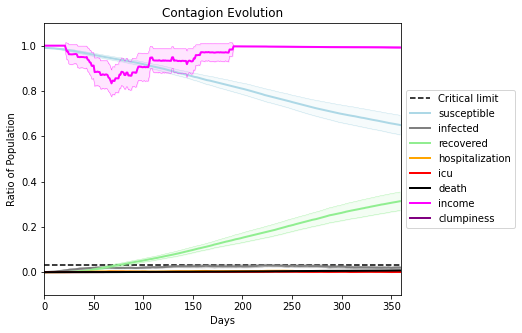

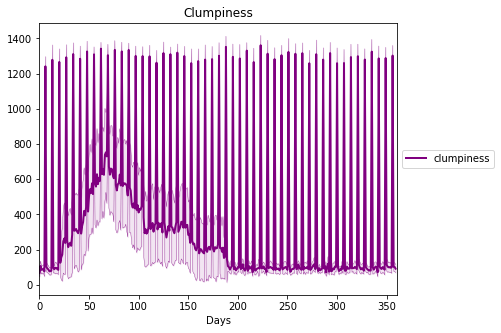

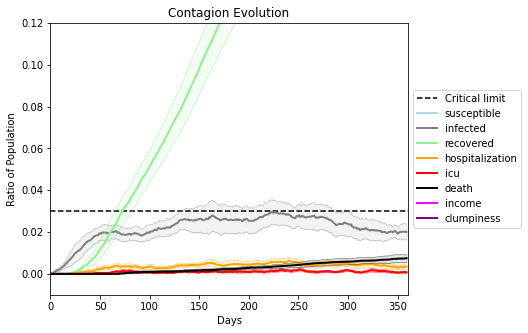

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2531, 8235, 4763, 2028, 2670, 1630, 1865, 625, 9993, 6845, 6350, 5821, 6530, 6345, 654, 4162, 6156, 7692, 188, 4811]
Average similarity between family members is 0.9026849847057143 at temperature -0.99
Average similarity between family and home is 0.999839576016633 at temperature -1
Average similarity between students and their classroom is 0.7900632380929974 at temperature -0.99
Average classroom occupancy is 1.6363636363636365 and number classrooms is 187
Average similarity between workers is 0.8120626767773078 at temperature -0.99
Average office occupancy is 3.4331550802139037 and number offices is 187
Average friend similarity for adults: 0.8198776878946601 for kids: 0.7049225440194415
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.4537580478806814
avg restaurant similarity 0.42876245870540025
avg restaurant similarity 0.5351479865851717
avg restaurant similarity 0.5233538787431006
avg restaurant similarity 0.49705994523834784
avg restaurant similarity 0.4439266540530864
avg restaurant similarity 0.4815273186377491
avg restaurant similarity 0.4488783674581362
avg restaurant similarity 0.45996033438092404
avg restaurant similarity 0.4363144674973727
avg restaurant similarity 0.44939613668626816
avg restaurant similarity 0.5415426522523622
avg restaurant similarity 0.4520581190243992
avg restaurant similarity 0.4505512733512328
avg restaurant similarity 0.4634566736145607
avg restaurant similarity 0.48265762068054613
avg restaurant similarity 0.45209382927450903
avg restaurant similarity 0.46974734920110667
avg restaurant similarity 0.46641422401108756
avg restaurant similarity 0.5088210879897257
avg restaurant similarity 0.45500884557632004
avg restaurant similarity 0.47316559285811716


avg restaurant similarity 0.46143439929813007
avg restaurant similarity 0.4774969332587166
avg restaurant similarity 0.47609129651068294
avg restaurant similarity 0.4927194304949957
avg restaurant similarity 0.48588240388252973
avg restaurant similarity 0.4559337377872579
avg restaurant similarity 0.525478734350432
avg restaurant similarity 0.4335101004272434
avg restaurant similarity 0.5111166496518926
avg restaurant similarity 0.4586227544070881
avg restaurant similarity 0.4340972979325878
avg restaurant similarity 0.44991808772276287
avg restaurant similarity 0.5033267064773334
avg restaurant similarity 0.4909101283003916
avg restaurant similarity 0.4985667487547193
avg restaurant similarity 0.4846633241828875
avg restaurant similarity 0.48931249857823134
avg restaurant similarity 0.43823753605068383
avg restaurant similarity 0.4875167656990519
avg restaurant similarity 0.5111300199264421
avg restaurant similarity 0.4526287921298269
avg restaurant similarity 0.5252651762092487
avg r

Average similarity between workers is 0.8148760992906394 at temperature -0.99
Average office occupancy is 3.5210526315789474 and number offices is 190
Average friend similarity for adults: 0.8256702895801054 for kids: 0.7159906396242585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.3915443502871353
avg restaurant similarity 0.46720972329745575
avg restaurant similarity 0.4996405776436715
avg restaurant similarity 0.47322957017522477
avg restaurant similarity 0.5194499645648698
avg restaurant similarity 0.5104412262214721
avg restaurant similarity 0.43640741624905516
avg restaurant similarity 0.47012868293559273
avg restaurant similarity 0.44309497198616543
avg restaurant similarity 0.49107299519615805
avg restaurant similarity 0.46732095305356197
avg restaurant similarity 0.5149749949816593
avg restaurant similarity 0.4489039515146469
avg restaurant similarity 0.474142513671636
avg restaurant similarity 0.44996175508143205
avg restaurant similarity 0.4394423083875065
avg restaurant similarity 0.4535631672618012
avg restaurant similarity 0.43668230211838643
avg restaurant similarity 0.46979146287159385
avg restaurant similarity 0.5002656011785368
avg restaurant similarity 0.5117878346472422
avg restaurant similarity 0.4545472673660841
a

avg restaurant similarity 0.46480524442041854
avg restaurant similarity 0.4700260120731178
avg restaurant similarity 0.46366450125104997
avg restaurant similarity 0.44760058179319995
avg restaurant similarity 0.43715339159767713
avg restaurant similarity 0.4916485193278686
avg restaurant similarity 0.46516053459817364
avg restaurant similarity 0.4989981941574091
avg restaurant similarity 0.40878879520248884
avg restaurant similarity 0.4800956493431634
avg restaurant similarity 0.42540471123432444
avg restaurant similarity 0.4612923994307724
avg restaurant similarity 0.4882281136536016
avg restaurant similarity 0.4667877816600107
avg restaurant similarity 0.41288880342457807
avg restaurant similarity 0.5259699952864944
avg restaurant similarity 0.43674423734189
avg restaurant similarity 0.4779961918794247
avg restaurant similarity 0.4744676033758961
avg restaurant similarity 0.43132341648156275
avg restaurant similarity 0.46485055372543116
avg restaurant similarity 0.49015427502087194
a

Average similarity between family and home is 0.9998472773033766 at temperature -1
Average similarity between students and their classroom is 0.80232566772465 at temperature -0.99
Average classroom occupancy is 1.5942857142857143 and number classrooms is 175
Average similarity between workers is 0.8125158442867598 at temperature -0.99
Average office occupancy is 3.4583333333333335 and number offices is 192
Average friend similarity for adults: 0.8328291155295519 for kids: 0.7142437206257417
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.4732845424964223
avg restaurant similarity 0.513783871333729
avg restaurant similarity 0.5130782214481006
avg restaurant similarity 0.5151365978882957
avg restaurant similarity 0.572267240667301
avg restaurant similarity 0.4741885568467623
avg restaurant similarity 0.5472933274202822
avg restaurant similarity 0.5244045437277525
avg restaurant similarity 0.5203951955885319
avg restaurant similarity 0.5096122600641879
avg restaurant similarity 0.5755062537485933
avg restaurant similarity 0.4943360670354241
avg restaurant similarity 0.504117769095488
avg restaurant similarity 0.5758134218610677
avg restaurant similarity 0.4981087016770131
avg restaurant similarity 0.5065530357087513
avg restaurant similarity 0.518720526012139
avg restaurant similarity 0.550104883072201
avg restaurant similarity 0.5349576838372286
avg restaurant similarity 0.5581475298067783
avg restaurant similarity 0.5386778510601122
avg restaurant similarity 0.5033771807468231
avg restaurant 

avg restaurant similarity 0.4946919274091723
avg restaurant similarity 0.5028328403614093
avg restaurant similarity 0.46988634044448196
avg restaurant similarity 0.5273263036819815
avg restaurant similarity 0.5301651924576561
avg restaurant similarity 0.48472826636782756
avg restaurant similarity 0.48132463254519053
avg restaurant similarity 0.5120843264683461
avg restaurant similarity 0.5131980399286318
avg restaurant similarity 0.48127234457945595
avg restaurant similarity 0.5490029723968407
avg restaurant similarity 0.48815810595759745
avg restaurant similarity 0.507873618507628
avg restaurant similarity 0.44499407323330203
avg restaurant similarity 0.4880903510594465
avg restaurant similarity 0.5238577959237631
avg restaurant similarity 0.4990553500587842
avg restaurant similarity 0.5279217229759258
avg restaurant similarity 0.5227427882937495
avg restaurant similarity 0.5590111331726647
avg restaurant similarity 0.5151177479739087
avg restaurant similarity 0.5251626772972551
avg r

Average similarity between workers is 0.8151277186086151 at temperature -0.99
Average office occupancy is 3.2741116751269037 and number offices is 197
Average friend similarity for adults: 0.821974256344064 for kids: 0.7146435172061162
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.4909699011463078
avg restaurant similarity 0.4570728195051489
avg restaurant similarity 0.5140965899710961
avg restaurant similarity 0.5167987565644013
avg restaurant similarity 0.5452437546613137
avg restaurant similarity 0.44035005189777715
avg restaurant similarity 0.48588735865980004
avg restaurant similarity 0.5037266963785311
avg restaurant similarity 0.4751052852083812
avg restaurant similarity 0.49226031598906406
avg restaurant similarity 0.4944163222509409
avg restaurant similarity 0.5827331014479376
avg restaurant similarity 0.5311567382215207
avg restaurant similarity 0.45096716253506475
avg restaurant similarity 0.5012038419041219
avg restaurant similarity 0.4837349020962764
avg restaurant similarity 0.4908835915389801
avg restaurant similarity 0.4847851991227511
avg restaurant similarity 0.4808639811154871
avg restaurant similarity 0.5247571340296013
avg restaurant similarity 0.46975372632581114
avg restaurant similarity 0.46958779184908767
avg 

avg restaurant similarity 0.4949850650426185
avg restaurant similarity 0.48784197089930414
avg restaurant similarity 0.47269286614559275
avg restaurant similarity 0.5124185438929841
avg restaurant similarity 0.5097343507659203
avg restaurant similarity 0.4960376840423959
avg restaurant similarity 0.5013856321677125
avg restaurant similarity 0.42036289290109313
avg restaurant similarity 0.48071579277978166
avg restaurant similarity 0.5265192767303838
avg restaurant similarity 0.541067817204678
avg restaurant similarity 0.5014860652747727
avg restaurant similarity 0.48889415716725143
avg restaurant similarity 0.4854472103035546
avg restaurant similarity 0.4875266485977558
avg restaurant similarity 0.4955470671730862
avg restaurant similarity 0.4731137683102868
avg restaurant similarity 0.462815842325757
avg restaurant similarity 0.4901669916343528
avg restaurant similarity 0.5362133246123131
avg restaurant similarity 0.5137779466944037
avg restaurant similarity 0.5132481014007172
avg res

Average similarity between workers is 0.8253364294004661 at temperature -0.99
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.8296635790679847 for kids: 0.7197553226551596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.49784277819878464
avg restaurant similarity 0.4718746295410076
avg restaurant similarity 0.4871459504359092
avg restaurant similarity 0.519775141206417
avg restaurant similarity 0.4792130647292777
avg restaurant similarity 0.48661058521818934
avg restaurant similarity 0.5234191904508589
avg restaurant similarity 0.48837324950901256
avg restaurant similarity 0.45770012730638415
avg restaurant similarity 0.47217192325457225
avg restaurant similarity 0.45024439773203245
avg restaurant similarity 0.5027482757510242
avg restaurant similarity 0.5206735527882087
avg restaurant similarity 0.48818389152217495
avg restaurant similarity 0.4494001290970508
avg restaurant similarity 0.47624864743295225
avg restaurant similarity 0.5200855117213753
avg restaurant similarity 0.48095158938485344
avg restaurant similarity 0.5096525453753326
avg restaurant similarity 0.4981347456470263
avg restaurant similarity 0.5258817719632117
avg restaurant similarity 0.5121049361739657
av

avg restaurant similarity 0.4819985514869359
avg restaurant similarity 0.5326193015553544
avg restaurant similarity 0.5290247051815273
avg restaurant similarity 0.511010161685343
avg restaurant similarity 0.4684498783727305
avg restaurant similarity 0.552256916636483
avg restaurant similarity 0.4869701380510141
avg restaurant similarity 0.47638140869203094
avg restaurant similarity 0.5231156592049279
avg restaurant similarity 0.5276963514464703
avg restaurant similarity 0.4942321436530571
avg restaurant similarity 0.505427870775334
avg restaurant similarity 0.5574232830392823
avg restaurant similarity 0.5253279368743627
avg restaurant similarity 0.49593275712878776
avg restaurant similarity 0.5491751963145687
avg restaurant similarity 0.5260808374432826
avg restaurant similarity 0.5239676297379754
avg restaurant similarity 0.5139766865502899
avg restaurant similarity 0.4833491071965827
avg restaurant similarity 0.5403562057344788
avg restaurant similarity 0.5300665714959956
avg restaur

Average similarity between workers is 0.8275201271885713 at temperature -0.99
Average office occupancy is 3.4263959390862944 and number offices is 197
Average friend similarity for adults: 0.8372540509554676 for kids: 0.717620924681604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.48221846447073907
avg restaurant similarity 0.46734305532738285
avg restaurant similarity 0.5221534322058379
avg restaurant similarity 0.4816148669588333
avg restaurant similarity 0.5465981455825326
avg restaurant similarity 0.45143105398124855
avg restaurant similarity 0.48497156934999297
avg restaurant similarity 0.46912807203602414
avg restaurant similarity 0.4873517626501053
avg restaurant similarity 0.4794148635747082
avg restaurant similarity 0.4307930424822057
avg restaurant similarity 0.44878944678794497
avg restaurant similarity 0.502166256740117
avg restaurant similarity 0.49628410724823147
avg restaurant similarity 0.5018352720963768
avg restaurant similarity 0.48453913240869884
avg restaurant similarity 0.47577745449212944
avg restaurant similarity 0.5762581865219076
avg restaurant similarity 0.5395781934113213
avg restaurant similarity 0.5220929843643994
avg restaurant similarity 0.49906355228881943
avg restaurant similarity 0.47520432082823083


avg restaurant similarity 0.5336151489048394
avg restaurant similarity 0.5179845223206452
avg restaurant similarity 0.5103005051601825
avg restaurant similarity 0.5303564834428157
avg restaurant similarity 0.49453323084630346
avg restaurant similarity 0.49139568231211583
avg restaurant similarity 0.4610761427347913
avg restaurant similarity 0.47287656077204415
avg restaurant similarity 0.47729391779226216
avg restaurant similarity 0.4901124026362017
avg restaurant similarity 0.49197555564443357
avg restaurant similarity 0.4862011190794605
avg restaurant similarity 0.5210235122780242
avg restaurant similarity 0.46939851082340206
avg restaurant similarity 0.530903150105311
avg restaurant similarity 0.4879957796830727
avg restaurant similarity 0.5252388093981646
avg restaurant similarity 0.48507877594057097
avg restaurant similarity 0.4576090368137932
avg restaurant similarity 0.4820344306630465
avg restaurant similarity 0.4955826499505677
avg restaurant similarity 0.5139536941681458
avg 

Average similarity between students and their classroom is 0.7781842478779566 at temperature -0.99
Average classroom occupancy is 1.7087912087912087 and number classrooms is 182
Average similarity between workers is 0.8263386711470341 at temperature -0.99
Average office occupancy is 3.3697916666666665 and number offices is 192
Average friend similarity for adults: 0.8325532419812156 for kids: 0.7249326661271694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated 

avg restaurant similarity 0.4778803516941377
avg restaurant similarity 0.39849515544407377
avg restaurant similarity 0.43170127560345123
avg restaurant similarity 0.4246802278607431
avg restaurant similarity 0.42361913358298375
avg restaurant similarity 0.5310563692614483
avg restaurant similarity 0.4144563279231125
avg restaurant similarity 0.4800023090642628
avg restaurant similarity 0.4682748082118482
avg restaurant similarity 0.46323677550152165
avg restaurant similarity 0.480908201469558
avg restaurant similarity 0.47853712791457265
avg restaurant similarity 0.4579910301991946
avg restaurant similarity 0.4559253066257003
avg restaurant similarity 0.47069271651626476
avg restaurant similarity 0.44371508556807415
avg restaurant similarity 0.45367303193874653
avg restaurant similarity 0.4622400333910024
avg restaurant similarity 0.49720752755179487
avg restaurant similarity 0.4373762307749768
avg restaurant similarity 0.4980448755329828
avg restaurant similarity 0.47607735729374484
a

avg restaurant similarity 0.4755936828511047
avg restaurant similarity 0.4653964949476966
avg restaurant similarity 0.4597468990817057
avg restaurant similarity 0.4676470520015801
avg restaurant similarity 0.4858172163660367
avg restaurant similarity 0.4850923129461923
avg restaurant similarity 0.4904312211694283
avg restaurant similarity 0.41687946164909595
avg restaurant similarity 0.43188508745210785
avg restaurant similarity 0.52908287276969
avg restaurant similarity 0.5392783678537996
avg restaurant similarity 0.39166682415099613
avg restaurant similarity 0.36833074331731075
avg restaurant similarity 0.4994040673066294
avg restaurant similarity 0.4780552860119977
avg restaurant similarity 0.5069825330980826
avg restaurant similarity 0.4254898747308078
avg restaurant similarity 0.42480520529883437
avg restaurant similarity 0.4803750287822078
avg restaurant similarity 0.48737778447392155
avg restaurant similarity 0.4327695015446606
avg restaurant similarity 0.489500762080607
avg res

Average similarity between workers is 0.8153519287664133 at temperature -0.99
Average office occupancy is 3.5 and number offices is 192
Average friend similarity for adults: 0.8285055572766077 for kids: 0.7161418580488182
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocate

avg restaurant similarity 0.5124928998249195
avg restaurant similarity 0.46737655699066055
avg restaurant similarity 0.49753075993835005
avg restaurant similarity 0.43511986468866626
avg restaurant similarity 0.4329784848020375
avg restaurant similarity 0.48646665871141337
avg restaurant similarity 0.47499500778977294
avg restaurant similarity 0.4933587456784449
avg restaurant similarity 0.5220846965686314
avg restaurant similarity 0.49460035426379206
avg restaurant similarity 0.5004517238714128
avg restaurant similarity 0.4616522550205382
avg restaurant similarity 0.48294919768796246
avg restaurant similarity 0.44729502586157804
avg restaurant similarity 0.4768911907107081
avg restaurant similarity 0.48422627160889
avg restaurant similarity 0.4579679375349557
avg restaurant similarity 0.46224442119669
avg restaurant similarity 0.5214429634706996
avg restaurant similarity 0.4471294574422763
avg restaurant similarity 0.4709932641798372
avg restaurant similarity 0.455076673131767
avg res

avg restaurant similarity 0.4695644598072512
avg restaurant similarity 0.45082987054275825
avg restaurant similarity 0.4975975606452186
avg restaurant similarity 0.5055071323805089
avg restaurant similarity 0.452799893844468
avg restaurant similarity 0.46713729917647673
avg restaurant similarity 0.5199792292803165
avg restaurant similarity 0.4077018063815103
avg restaurant similarity 0.4637205806482389
avg restaurant similarity 0.5150062273786947
avg restaurant similarity 0.47524992635297164
avg restaurant similarity 0.4736271028015873
avg restaurant similarity 0.46359670343369286
avg restaurant similarity 0.5350610209207606
avg restaurant similarity 0.5034930414473636
avg restaurant similarity 0.41276118001425555
avg restaurant similarity 0.4870137839198481
avg restaurant similarity 0.4687538118597331
avg restaurant similarity 0.44030527002347547
avg restaurant similarity 0.43663819951886546
avg restaurant similarity 0.48603814777140175
avg restaurant similarity 0.42697276497829195
av

Average similarity between workers is 0.8139784053848177 at temperature -0.99
Average office occupancy is 3.472081218274112 and number offices is 197
Average friend similarity for adults: 0.834798725606541 for kids: 0.6863742785673314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.4932777151266873
avg restaurant similarity 0.48863410851806216
avg restaurant similarity 0.5079253841723141
avg restaurant similarity 0.485587578347057
avg restaurant similarity 0.514540663609297
avg restaurant similarity 0.51018836289485
avg restaurant similarity 0.5312472835841797
avg restaurant similarity 0.5334836580126577
avg restaurant similarity 0.4971131566831885
avg restaurant similarity 0.5178626538114216
avg restaurant similarity 0.4699152494512961
avg restaurant similarity 0.4047780949828235
avg restaurant similarity 0.4956331173237705
avg restaurant similarity 0.4832274927973814
avg restaurant similarity 0.4576466660245433
avg restaurant similarity 0.46646778939892175
avg restaurant similarity 0.4236760939819818
avg restaurant similarity 0.4382675505728267
avg restaurant similarity 0.5114763193629671
avg restaurant similarity 0.5048586315282004
avg restaurant similarity 0.49894088789755464
avg restaurant similarity 0.4575571663974106
avg restaur

avg restaurant similarity 0.4510088750565105
avg restaurant similarity 0.5113489472984273
avg restaurant similarity 0.5475916056044975
avg restaurant similarity 0.47922919902535255
avg restaurant similarity 0.4154476582227331
avg restaurant similarity 0.41581390674761576
avg restaurant similarity 0.49411153366462535
avg restaurant similarity 0.4481319293545121
avg restaurant similarity 0.49607340092870184
avg restaurant similarity 0.48283378472832866
avg restaurant similarity 0.4982109563164361
avg restaurant similarity 0.4510183188588664
avg restaurant similarity 0.39925197689945074
avg restaurant similarity 0.4683803622758642
avg restaurant similarity 0.5391294275456557
avg restaurant similarity 0.4805004846247894
avg restaurant similarity 0.47977823596444835
avg restaurant similarity 0.44332138904418394
avg restaurant similarity 0.4844518170488611
avg restaurant similarity 0.4526191711384932
avg restaurant similarity 0.4494287360225709
avg restaurant similarity 0.5075443175053843
av

Average similarity between workers is 0.8187983146980317 at temperature -0.99
Average office occupancy is 3.3645833333333335 and number offices is 192
Average friend similarity for adults: 0.8237337070000005 for kids: 0.7237667483221497
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.450877302867633
avg restaurant similarity 0.5235750356806944
avg restaurant similarity 0.49105430883963264
avg restaurant similarity 0.5017017647060822
avg restaurant similarity 0.4674781465477666
avg restaurant similarity 0.49480399133396946
avg restaurant similarity 0.5260046546559285
avg restaurant similarity 0.4800569808979279
avg restaurant similarity 0.47023506395865877
avg restaurant similarity 0.46624520149281184
avg restaurant similarity 0.5383667058419667
avg restaurant similarity 0.48263285491938634
avg restaurant similarity 0.5105196108400658
avg restaurant similarity 0.5196618312013795
avg restaurant similarity 0.4411145971579032
avg restaurant similarity 0.515690463674507
avg restaurant similarity 0.5532239235631122
avg restaurant similarity 0.47462532524554324
avg restaurant similarity 0.5066743110494969
avg restaurant similarity 0.4876925343027002
avg restaurant similarity 0.5086845404202238
avg restaurant similarity 0.4715725867178864
avg re

avg restaurant similarity 0.4296817565113639
avg restaurant similarity 0.5272745462322065
avg restaurant similarity 0.5020411872183372
avg restaurant similarity 0.5238496540128448
avg restaurant similarity 0.5262782891635351
avg restaurant similarity 0.47448654069331325
avg restaurant similarity 0.43380110848793696
avg restaurant similarity 0.5013326192802002
avg restaurant similarity 0.4663343991952268
avg restaurant similarity 0.49505189394399063
avg restaurant similarity 0.45594543687351863
avg restaurant similarity 0.45399216161565886
avg restaurant similarity 0.4628959356032872
avg restaurant similarity 0.4318015613346867
avg restaurant similarity 0.4971740970167025
avg restaurant similarity 0.45140572930658646
avg restaurant similarity 0.4856096702770706
avg restaurant similarity 0.46097986693684084
avg restaurant similarity 0.5002879533594744
avg restaurant similarity 0.5024276700360247
avg restaurant similarity 0.5028064964284064
avg restaurant similarity 0.5281173113402247
avg

Average similarity between workers is 0.8070031459492562 at temperature -0.99
Average office occupancy is 3.3917525773195876 and number offices is 194
Average friend similarity for adults: 0.8221288554186226 for kids: 0.7071305064747356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5209684178436
avg restaurant similarity 0.5007521271503905
avg restaurant similarity 0.5211612588643115
avg restaurant similarity 0.4749982236943237
avg restaurant similarity 0.5263894837659685
avg restaurant similarity 0.49549779862163484
avg restaurant similarity 0.5471274994672761
avg restaurant similarity 0.4754159230419153
avg restaurant similarity 0.5584715239931801
avg restaurant similarity 0.5301714025819853
avg restaurant similarity 0.47276072178754375
avg restaurant similarity 0.5007127806224992
avg restaurant similarity 0.5052285019661737
avg restaurant similarity 0.481674448764538
avg restaurant similarity 0.5249172809894521
avg restaurant similarity 0.5046707748674937
avg restaurant similarity 0.5153158125697382
avg restaurant similarity 0.5069207903586224
avg restaurant similarity 0.4940849296810177
avg restaurant similarity 0.4972782207061017
avg restaurant similarity 0.5214442945832358
avg restaurant similarity 0.5168036751556638
avg restaura

avg restaurant similarity 0.4837508168278128
avg restaurant similarity 0.5056171126378081
avg restaurant similarity 0.45935134549154444
avg restaurant similarity 0.5176726154569525
avg restaurant similarity 0.49968315495304405
avg restaurant similarity 0.5312153458688434
avg restaurant similarity 0.5035033386675787
avg restaurant similarity 0.5400421971086327
avg restaurant similarity 0.4890275117067273
avg restaurant similarity 0.520692350307645
avg restaurant similarity 0.5142171570313288
avg restaurant similarity 0.5371217741018255
avg restaurant similarity 0.5017915681028466
avg restaurant similarity 0.5249440508347324
avg restaurant similarity 0.4950485269490762
avg restaurant similarity 0.4825807225670022
avg restaurant similarity 0.5077152532002989
avg restaurant similarity 0.4599606269608757
avg restaurant similarity 0.5030379011750321
avg restaurant similarity 0.5426174248641612
avg restaurant similarity 0.5470678816343121
avg restaurant similarity 0.557622983402852
avg restau

Average similarity between workers is 0.8079672167100626 at temperature -0.99
Average office occupancy is 3.381443298969072 and number offices is 194
Average friend similarity for adults: 0.826990358040691 for kids: 0.7080977740547646
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 pe

avg restaurant similarity 0.49146059227907063
avg restaurant similarity 0.4574403676529696
avg restaurant similarity 0.44282415324174534
avg restaurant similarity 0.45308926253302073
avg restaurant similarity 0.4821056024956019
avg restaurant similarity 0.5364387975692685
avg restaurant similarity 0.4980416515029379
avg restaurant similarity 0.4409041763207532
avg restaurant similarity 0.4233358816352608
avg restaurant similarity 0.4702810743651737
avg restaurant similarity 0.4855142309829895
avg restaurant similarity 0.5021438157551416
avg restaurant similarity 0.4951906305150956
avg restaurant similarity 0.44068336362878646
avg restaurant similarity 0.4519119998632523
avg restaurant similarity 0.5156459950817694
avg restaurant similarity 0.44259716606180677
avg restaurant similarity 0.4716921017316908
avg restaurant similarity 0.48324367427741244
avg restaurant similarity 0.48186080023576294
avg restaurant similarity 0.5053288715020897
avg restaurant similarity 0.49623176173844413
av

avg restaurant similarity 0.45428936008694387
avg restaurant similarity 0.48874994769723984
avg restaurant similarity 0.4567999761810972
avg restaurant similarity 0.4552115815637373
avg restaurant similarity 0.49621639500853837
avg restaurant similarity 0.4390011797326942
avg restaurant similarity 0.47843826187786115
avg restaurant similarity 0.42674622784357186
avg restaurant similarity 0.4731863334050511
avg restaurant similarity 0.4930071964944474
avg restaurant similarity 0.4660311402783188
avg restaurant similarity 0.47578539277714366
avg restaurant similarity 0.48286824462237593
avg restaurant similarity 0.4988888357178499
avg restaurant similarity 0.44092366155787827
avg restaurant similarity 0.42509374386150117
avg restaurant similarity 0.4749079319643683
avg restaurant similarity 0.515734320465806
avg restaurant similarity 0.5003558956403049
avg restaurant similarity 0.45793217449616963
avg restaurant similarity 0.526995065274732
avg restaurant similarity 0.45425939007550564
a

Average similarity between workers is 0.8121284869033725 at temperature -0.99
Average office occupancy is 3.4343434343434343 and number offices is 198
Average friend similarity for adults: 0.8303049699841261 for kids: 0.6992713789079344
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.4726305267123934
avg restaurant similarity 0.5002294125805119
avg restaurant similarity 0.4551036815619681
avg restaurant similarity 0.4628883902475969
avg restaurant similarity 0.49824103192247604
avg restaurant similarity 0.49263410521161694
avg restaurant similarity 0.4608647352411524
avg restaurant similarity 0.4729050492318945
avg restaurant similarity 0.4900600250110351
avg restaurant similarity 0.42747368917822315
avg restaurant similarity 0.4849353352823697
avg restaurant similarity 0.4910350369452292
avg restaurant similarity 0.4481068528025096
avg restaurant similarity 0.4924782865843386
avg restaurant similarity 0.42993368844808316
avg restaurant similarity 0.4529016438097684
avg restaurant similarity 0.515667608908611
avg restaurant similarity 0.5061714849646718
avg restaurant similarity 0.4751703696757785
avg restaurant similarity 0.46723661827232865
avg restaurant similarity 0.4704277808939124
avg restaurant similarity 0.4531361476738051
avg re

avg restaurant similarity 0.5398605030049831
avg restaurant similarity 0.476057304639256
avg restaurant similarity 0.45242682357277253
avg restaurant similarity 0.4599028847393065
avg restaurant similarity 0.451806495681914
avg restaurant similarity 0.48875668054962823
avg restaurant similarity 0.4580194426942041
avg restaurant similarity 0.46172370906589305
avg restaurant similarity 0.453150772280175
avg restaurant similarity 0.49142662026371486
avg restaurant similarity 0.5012390768728608
avg restaurant similarity 0.43576531339851327
avg restaurant similarity 0.4994674173876865
avg restaurant similarity 0.46980676469087473
avg restaurant similarity 0.4908733387408239
avg restaurant similarity 0.4327787988797559
avg restaurant similarity 0.4845864824393836
avg restaurant similarity 0.5242367087102477
avg restaurant similarity 0.5212953339761776
avg restaurant similarity 0.5057928921986444
avg restaurant similarity 0.4506507765702126
avg restaurant similarity 0.45546246767818876
avg re

Average similarity between family and home is 0.9998569457412637 at temperature -1
Average similarity between students and their classroom is 0.767653015040356 at temperature -0.99
Average classroom occupancy is 1.755952380952381 and number classrooms is 168
Average similarity between workers is 0.8249527122395357 at temperature -0.99
Average office occupancy is 3.3711340206185567 and number offices is 194
Average friend similarity for adults: 0.8241059093509419 for kids: 0.7153222528106394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.45794752900196045
avg restaurant similarity 0.47855072280723443
avg restaurant similarity 0.5632106832846604
avg restaurant similarity 0.5473910996461432
avg restaurant similarity 0.5305017088718152
avg restaurant similarity 0.5246479908803149
avg restaurant similarity 0.5394583854546978
avg restaurant similarity 0.5546113376389776
avg restaurant similarity 0.4811243096298311
avg restaurant similarity 0.4828952447892029
avg restaurant similarity 0.5523273413760799
avg restaurant similarity 0.528135285439009
avg restaurant similarity 0.5755523937167666
avg restaurant similarity 0.5528656080353347
avg restaurant similarity 0.43520255451054113
avg restaurant similarity 0.6212187747325079
avg restaurant similarity 0.534849888063003
avg restaurant similarity 0.46561337190401353
avg restaurant similarity 0.523244999076689
avg restaurant similarity 0.45721250856468015
avg restaurant similarity 0.556353315783933
avg restaurant similarity 0.5312848036015044
avg resta

avg restaurant similarity 0.4548311467427601
avg restaurant similarity 0.46534187698865165
avg restaurant similarity 0.5456587593054588
avg restaurant similarity 0.44658722359870107
avg restaurant similarity 0.4218369372823745
avg restaurant similarity 0.49395597757401766
avg restaurant similarity 0.5004364238378762
avg restaurant similarity 0.41676870410710537
avg restaurant similarity 0.43541214593026945
avg restaurant similarity 0.5733146665725405
avg restaurant similarity 0.5907951052626733
avg restaurant similarity 0.44076097672971565
avg restaurant similarity 0.5999812970314697
avg restaurant similarity 0.48468313706216865
avg restaurant similarity 0.5608674412250829
avg restaurant similarity 0.4661969998759389
avg restaurant similarity 0.45836638773983523
avg restaurant similarity 0.41518665021656914
avg restaurant similarity 0.49463848621039774
avg restaurant similarity 0.4817087841705401
avg restaurant similarity 0.4526822786054759
avg restaurant similarity 0.5461615753517143


Average similarity between workers is 0.8178200271199824 at temperature -0.99
Average office occupancy is 3.4322916666666665 and number offices is 192
Average friend similarity for adults: 0.8255880427935148 for kids: 0.7204314871306202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 1

avg restaurant similarity 0.48885968748533765
avg restaurant similarity 0.5273171448364512
avg restaurant similarity 0.5100789446586195
avg restaurant similarity 0.4376733100502848
avg restaurant similarity 0.44761071203583297
avg restaurant similarity 0.49749448009286795
avg restaurant similarity 0.5236647582278317
avg restaurant similarity 0.5220093265900283
avg restaurant similarity 0.49977153270522656
avg restaurant similarity 0.4965843795238777
avg restaurant similarity 0.538915990617759
avg restaurant similarity 0.5074822869105586
avg restaurant similarity 0.5504342646339847
avg restaurant similarity 0.44789666458953586
avg restaurant similarity 0.5192248587419235
avg restaurant similarity 0.5377195446488474
avg restaurant similarity 0.5253368051437527
avg restaurant similarity 0.47822196760044294
avg restaurant similarity 0.5668096982177283
avg restaurant similarity 0.5081091510924384
avg restaurant similarity 0.5165998737282478
avg restaurant similarity 0.46810559466653523
avg 

avg restaurant similarity 0.5181175135345727
avg restaurant similarity 0.5010422241807242
avg restaurant similarity 0.5358858364817357
avg restaurant similarity 0.5650084056247597
avg restaurant similarity 0.5108977365226893
avg restaurant similarity 0.5455977640658046
avg restaurant similarity 0.4834366698313053
avg restaurant similarity 0.4731137655393062
avg restaurant similarity 0.5935268624588923
avg restaurant similarity 0.5072202964594397
avg restaurant similarity 0.543756098827819
avg restaurant similarity 0.5046814634519776
avg restaurant similarity 0.5103878217194876
avg restaurant similarity 0.5374524341633629
avg restaurant similarity 0.5175002719998615
avg restaurant similarity 0.5051185945737214
avg restaurant similarity 0.4966950452411356
avg restaurant similarity 0.5436752200769402
avg restaurant similarity 0.4954875139105686
avg restaurant similarity 0.46512574569267645
avg restaurant similarity 0.4802891675923431
avg restaurant similarity 0.5262935727048236
avg restau

Average similarity between workers is 0.8246850940301371 at temperature -0.99
Average office occupancy is 3.3664921465968587 and number offices is 191
Average friend similarity for adults: 0.8328679714649528 for kids: 0.7212358494831406
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5723897212184289
avg restaurant similarity 0.6004267506805029
avg restaurant similarity 0.49699971836481266
avg restaurant similarity 0.5097351710837248
avg restaurant similarity 0.58090572852997
avg restaurant similarity 0.5215579668133867
avg restaurant similarity 0.5513906475066619
avg restaurant similarity 0.4805048504340042
avg restaurant similarity 0.5259881220092107
avg restaurant similarity 0.5130377003714401
avg restaurant similarity 0.5331846956078632
avg restaurant similarity 0.558303966291741
avg restaurant similarity 0.5508937869234078
avg restaurant similarity 0.5040465027122731
avg restaurant similarity 0.5181921830368599
avg restaurant similarity 0.5291730524744834
avg restaurant similarity 0.5496836620102626
avg restaurant similarity 0.47541780176993614
avg restaurant similarity 0.5315544402613579
avg restaurant similarity 0.49073157873541334
avg restaurant similarity 0.5284248291251095
avg restaurant similarity 0.48234263204729
avg restaura

avg restaurant similarity 0.5172869238162849
avg restaurant similarity 0.5598282333071342
avg restaurant similarity 0.5153857460627591
avg restaurant similarity 0.5383838614375108
avg restaurant similarity 0.49067332681674697
avg restaurant similarity 0.5235479606742278
avg restaurant similarity 0.5497382567510144
avg restaurant similarity 0.5350735760800899
avg restaurant similarity 0.5304779354846403
avg restaurant similarity 0.5217223065670791
avg restaurant similarity 0.5086840977308905
avg restaurant similarity 0.5112012259441485
avg restaurant similarity 0.5066797673563971
avg restaurant similarity 0.4787451084543559
avg restaurant similarity 0.5322907693702156
avg restaurant similarity 0.48721590627333067
avg restaurant similarity 0.5342536922994999
avg restaurant similarity 0.4963442211006397
avg restaurant similarity 0.4762416486009401
avg restaurant similarity 0.5428706665047982
avg restaurant similarity 0.5627413246761014
avg restaurant similarity 0.568566613009958
avg resta

Average similarity between workers is 0.8293124962725357 at temperature -0.99
Average office occupancy is 3.3612565445026177 and number offices is 191
Average friend similarity for adults: 0.8336835554795267 for kids: 0.7291689535151833
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5268422956905436
avg restaurant similarity 0.44125909795594953
avg restaurant similarity 0.4965767875434472
avg restaurant similarity 0.5273550467358759
avg restaurant similarity 0.46828147389369834
avg restaurant similarity 0.5130434757357978
avg restaurant similarity 0.4963374930387914
avg restaurant similarity 0.42646206867567765
avg restaurant similarity 0.48416135798297466
avg restaurant similarity 0.43756682141387704
avg restaurant similarity 0.49953671792665466
avg restaurant similarity 0.4826077830322788
avg restaurant similarity 0.4908289972644269
avg restaurant similarity 0.47847762670794236
avg restaurant similarity 0.4959870796022749
avg restaurant similarity 0.4721367249012119
avg restaurant similarity 0.4553968764537782
avg restaurant similarity 0.49223686923430404
avg restaurant similarity 0.477832472822498
avg restaurant similarity 0.470345069576132
avg restaurant similarity 0.5322930411646015
avg restaurant similarity 0.5609718500971537
avg 

avg restaurant similarity 0.5013825826606217
avg restaurant similarity 0.5105766786751647
avg restaurant similarity 0.4921105338568877
avg restaurant similarity 0.4527554818376864
avg restaurant similarity 0.49329746776289024
avg restaurant similarity 0.4420264306704543
avg restaurant similarity 0.46094958923948864
avg restaurant similarity 0.461403841676118
avg restaurant similarity 0.5076069715467907
avg restaurant similarity 0.44265994822326477
avg restaurant similarity 0.5035022081377881
avg restaurant similarity 0.49596258508899965
avg restaurant similarity 0.5068014628921592
avg restaurant similarity 0.49870801827854366
avg restaurant similarity 0.47415115918246
avg restaurant similarity 0.46061763057807237
avg restaurant similarity 0.4844040591131958
avg restaurant similarity 0.48513837876788873
avg restaurant similarity 0.5475392704522823
avg restaurant similarity 0.48748996902348274
avg restaurant similarity 0.4581740402131032
avg restaurant similarity 0.47718738195465754
avg 

Average similarity between workers is 0.8147762358543631 at temperature -0.99
Average office occupancy is 3.405128205128205 and number offices is 195
Average friend similarity for adults: 0.8231576089316253 for kids: 0.7126965078858247
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 peo

avg restaurant similarity 0.48998191020955106
avg restaurant similarity 0.4483817788972284
avg restaurant similarity 0.44934635976641457
avg restaurant similarity 0.49013640788424057
avg restaurant similarity 0.5318773071770204
avg restaurant similarity 0.4569983141373914
avg restaurant similarity 0.5349925078353558
avg restaurant similarity 0.5343809007969659
avg restaurant similarity 0.4216823496136459
avg restaurant similarity 0.4627658506133932
avg restaurant similarity 0.5022728211472828
avg restaurant similarity 0.4649007747750817
avg restaurant similarity 0.47986558036535354
avg restaurant similarity 0.47846103693986164
avg restaurant similarity 0.48362505999891797
avg restaurant similarity 0.49143389566238666
avg restaurant similarity 0.4919687680932561
avg restaurant similarity 0.5174700501929516
avg restaurant similarity 0.48188954148224433
avg restaurant similarity 0.5832083961776875
avg restaurant similarity 0.4986814899084993
avg restaurant similarity 0.4757536220910239
av

avg restaurant similarity 0.4451393977863911
avg restaurant similarity 0.43473016510879653
avg restaurant similarity 0.449342765025051
avg restaurant similarity 0.4423613073570303
avg restaurant similarity 0.4577041603484486
avg restaurant similarity 0.49296459661590186
avg restaurant similarity 0.499827384960333
avg restaurant similarity 0.5209436002013067
avg restaurant similarity 0.47170359966233866
avg restaurant similarity 0.47729564219925497
avg restaurant similarity 0.5021255350949876
avg restaurant similarity 0.5259447986883887
avg restaurant similarity 0.4970853606360717
avg restaurant similarity 0.5627048556586149
avg restaurant similarity 0.465495865080331
avg restaurant similarity 0.47621931641261017
avg restaurant similarity 0.480474434024106
avg restaurant similarity 0.5275705508773042
avg restaurant similarity 0.49395316657530747
avg restaurant similarity 0.5029594348170155
avg restaurant similarity 0.48640469255683455
avg restaurant similarity 0.5178774213642956
avg res

Average similarity between students and their classroom is 0.8035936958174499 at temperature -0.99
Average classroom occupancy is 1.6685393258426966 and number classrooms is 178
Average similarity between workers is 0.8078074482552888 at temperature -0.99
Average office occupancy is 3.3523316062176165 and number offices is 193
Average friend similarity for adults: 0.828307627417185 for kids: 0.7200251096665843
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated i

avg restaurant similarity 0.45816118871969236
avg restaurant similarity 0.5159086202081263
avg restaurant similarity 0.5389739578156821
avg restaurant similarity 0.5459406954319005
avg restaurant similarity 0.46837288676255034
avg restaurant similarity 0.5286190452119066
avg restaurant similarity 0.6274094000643731
avg restaurant similarity 0.5217080433115541
avg restaurant similarity 0.46875127725182814
avg restaurant similarity 0.511635106437271
avg restaurant similarity 0.4893382884698563
avg restaurant similarity 0.46853120584744873
avg restaurant similarity 0.5563731782027938
avg restaurant similarity 0.5321644394831152
avg restaurant similarity 0.5194454260603739
avg restaurant similarity 0.5011540496169915
avg restaurant similarity 0.5357190105643876
avg restaurant similarity 0.5549412416020423
avg restaurant similarity 0.48140644295151597
avg restaurant similarity 0.5506337122168304
avg restaurant similarity 0.5102968505064052
avg restaurant similarity 0.5244669411809472
avg re

avg restaurant similarity 0.5261936565178754
avg restaurant similarity 0.5591931973419089
avg restaurant similarity 0.5576786967948874
avg restaurant similarity 0.5230450533536367
avg restaurant similarity 0.4632196860904287
avg restaurant similarity 0.5160754675511862
avg restaurant similarity 0.5492316157441547
avg restaurant similarity 0.4876646520441268
avg restaurant similarity 0.5081798857384998
avg restaurant similarity 0.5458604390934415
avg restaurant similarity 0.5116920656559221
avg restaurant similarity 0.48857036821112004
avg restaurant similarity 0.5099001873932613
avg restaurant similarity 0.48110713379945097
avg restaurant similarity 0.5199154378822493
avg restaurant similarity 0.5093709853345381
avg restaurant similarity 0.5028770580104589
avg restaurant similarity 0.5556986048952375
avg restaurant similarity 0.5359856150170659
avg restaurant similarity 0.5285220823999262
avg restaurant similarity 0.48135235127547804
avg restaurant similarity 0.5085885079904021
avg res

Average similarity between workers is 0.8105386590710535 at temperature -0.99
Average office occupancy is 3.4536082474226806 and number offices is 194
Average friend similarity for adults: 0.8283452843791582 for kids: 0.7146156837803055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.5086714959906021
avg restaurant similarity 0.5055168864704342
avg restaurant similarity 0.5269377642667612
avg restaurant similarity 0.5273888175789403
avg restaurant similarity 0.47240125896200064
avg restaurant similarity 0.47970778679598103
avg restaurant similarity 0.4688049964400635
avg restaurant similarity 0.5010262009333096
avg restaurant similarity 0.5585885794480647
avg restaurant similarity 0.4884482086989371
avg restaurant similarity 0.5406743130513503
avg restaurant similarity 0.5548117913915754
avg restaurant similarity 0.4826129391105282
avg restaurant similarity 0.4902018563346747
avg restaurant similarity 0.5174706497214394
avg restaurant similarity 0.4876735226785789
avg restaurant similarity 0.5376547258188301
avg restaurant similarity 0.48895552647843393
avg restaurant similarity 0.5237166855504416
avg restaurant similarity 0.4922898088273186
avg restaurant similarity 0.5220195208046179
avg restaurant similarity 0.5033215794758054
avg res

avg restaurant similarity 0.5289851968789193
avg restaurant similarity 0.5375643013295612
avg restaurant similarity 0.5310759225929433
avg restaurant similarity 0.49026420706217533
avg restaurant similarity 0.4824701595095384
avg restaurant similarity 0.5008678143535816
avg restaurant similarity 0.4846531046612749
avg restaurant similarity 0.47491299445144963
avg restaurant similarity 0.4911068147064232
avg restaurant similarity 0.4650164488462619
avg restaurant similarity 0.479720916490714
avg restaurant similarity 0.46882211468276547
avg restaurant similarity 0.49174370868939576
avg restaurant similarity 0.504226825421434
avg restaurant similarity 0.517181676510798
avg restaurant similarity 0.5098759246220818
avg restaurant similarity 0.5837590304385598
avg restaurant similarity 0.5259320464664649
avg restaurant similarity 0.5411639458391119
avg restaurant similarity 0.5706724072534509
avg restaurant similarity 0.5128793633229213
avg restaurant similarity 0.5484184562035568
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

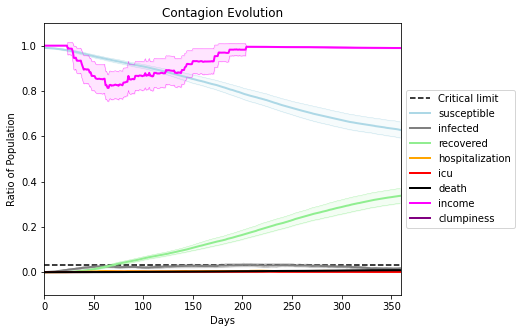

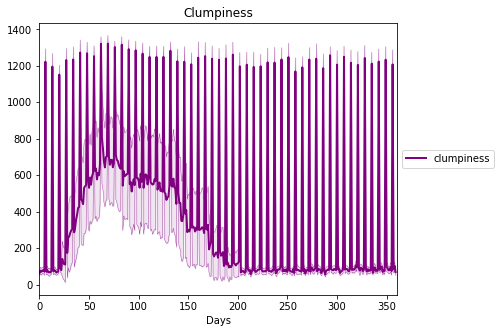

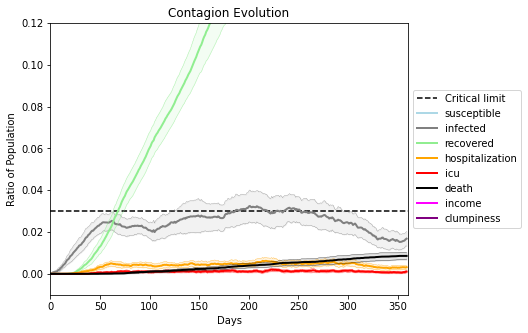

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[2957, 605, 5785, 9593, 1786, 3580, 2512, 370, 7316, 6391, 1578, 1511, 7570, 8545, 8311, 5466, 8289, 1768, 2412, 6028]
Average similarity between family members is 0.5334670821724826 at temperature -0.9
Average similarity between family and home is 0.9998479254205371 at temperature -1
Average similarity between students and their classroom is 0.18777935003467072 at temperature -0.9
Average classroom occupancy is 1.6046511627906976 and number classrooms is 172
Average similarity between workers is 0.44790615326427335 at temperature -0.9
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.5914866264203352 for kids: 0.48133319688207094
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.03504040289003781
avg restaurant similarity 0.18170267500276813
avg restaurant similarity 0.1289242548859904
avg restaurant similarity 0.16032093888012755
avg restaurant similarity 0.12396861064926057
avg restaurant similarity 0.09056411215755313
avg restaurant similarity 0.11967723465555673
avg restaurant similarity 0.11352248855848013
avg restaurant similarity 0.0774066343266152
avg restaurant similarity 0.20393812732486827
avg restaurant similarity 0.12141074652875007
avg restaurant similarity 0.06788346534285589
avg restaurant similarity 0.12458444936695122
avg restaurant similarity 0.1261454325110095
avg restaurant similarity 0.04932451706080468
avg restaurant similarity 0.12887215509157407
avg restaurant similarity 0.08385223096250947
avg restaurant similarity 0.10236192013136691
avg restaurant similarity 0.12248779256622028
avg restaurant similarity 0.11163134248102957
avg restaurant similarity 0.07066814156069627
avg restaurant similarity 0.101329807

avg restaurant similarity 0.07333103697215956
avg restaurant similarity 0.09707102288272045
avg restaurant similarity 0.09749433701558917
avg restaurant similarity 0.077426511523479
avg restaurant similarity 0.15749637850295267
avg restaurant similarity 0.08791842663674439
avg restaurant similarity 0.14113695987196823
avg restaurant similarity 0.06689371980613386
avg restaurant similarity 0.10505912813998536
avg restaurant similarity 0.14876210958972633
avg restaurant similarity 0.087514062616336
avg restaurant similarity 0.09547470629687428
avg restaurant similarity 0.16092733340732293
avg restaurant similarity 0.05200469084237767
avg restaurant similarity 0.03277849362802893
avg restaurant similarity 0.1299780670236645
avg restaurant similarity 0.11732629900563356
avg restaurant similarity 0.10361822862759203
avg restaurant similarity 0.0962771647520535
avg restaurant similarity 0.13615247444307146
avg restaurant similarity 0.05343978009839052
avg restaurant similarity 0.108000544849

avg restaurant similarity 0.06271892485308966
avg restaurant similarity 0.0902783900884077
Average similarity between family members is 0.5428420971586845 at temperature -0.9
Average similarity between family and home is 0.9998607110395993 at temperature -1
Average similarity between students and their classroom is 0.25822583623272877 at temperature -0.9
Average classroom occupancy is 1.6722222222222223 and number classrooms is 180
Average similarity between workers is 0.45009764840024435 at temperature -0.9
Average office occupancy is 3.2717948717948717 and number offices is 195
Average friend similarity for adults: 0.5979075260688946 for kids: 0.5084660576750928
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.08086448477888795
avg restaurant similarity 0.04937268020944225
avg restaurant similarity 0.1144862336157992
avg restaurant similarity 0.16337582934219785
avg restaurant similarity 0.1818903961635263
avg restaurant similarity 0.10642757177904558
avg restaurant similarity 0.09269200717410972
avg restaurant similarity 0.11264186875851191
avg restaurant similarity 0.1355542364350995
avg restaurant similarity 0.11509327936628244
avg restaurant similarity 0.18097039399764986
avg restaurant similarity 0.12776199323737847
avg restaurant similarity 0.1253536549035788
avg restaurant similarity 0.1411575220447545
avg restaurant similarity 0.10210359313532619
avg restaurant similarity 0.12302987788990342
avg restaurant similarity 0.1678925229018826
avg restaurant similarity 0.09560804215860354
avg restaurant similarity 0.11456653048869414
avg restaurant similarity 0.09749188928674571
avg restaurant similarity 0.14244690125944331
avg restaurant similarity 0.157251866522

avg restaurant similarity 0.14864057570301994
avg restaurant similarity 0.14884251847248753
avg restaurant similarity 0.12531349588154556
avg restaurant similarity 0.0702697798347092
avg restaurant similarity 0.10166695887978552
avg restaurant similarity 0.11579344058052532
avg restaurant similarity 0.11455424404170204
avg restaurant similarity 0.033761777293270664
avg restaurant similarity 0.06621234534080954
avg restaurant similarity 0.14084092725639127
avg restaurant similarity 0.10575643635759219
avg restaurant similarity 0.16939201028033687
avg restaurant similarity 0.09381746023358635
avg restaurant similarity 0.07081984960305206
avg restaurant similarity 0.09947246235998701
avg restaurant similarity 0.07142419852299944
avg restaurant similarity 0.07507388158205613
avg restaurant similarity 0.13187887716690785
avg restaurant similarity 0.15498574024489173
avg restaurant similarity 0.08752151445136919
avg restaurant similarity 0.06873674286817268
avg restaurant similarity 0.108864

avg restaurant similarity 0.14549156590315718
avg restaurant similarity 0.1591627209975567
Average similarity between family members is 0.5395304800996087 at temperature -0.9
Average similarity between family and home is 0.9998611479588485 at temperature -1
Average similarity between students and their classroom is 0.23804727608580922 at temperature -0.9
Average classroom occupancy is 1.5393939393939393 and number classrooms is 165
Average similarity between workers is 0.4533384187610913 at temperature -0.9
Average office occupancy is 3.462686567164179 and number offices is 201
Average friend similarity for adults: 0.6112281576436944 for kids: 0.48255112182282867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.15028247994492364
avg restaurant similarity 0.11821479381628815
avg restaurant similarity 0.10574503781060446
avg restaurant similarity 0.024561189811727783
avg restaurant similarity 0.08452017248476744
avg restaurant similarity 0.17524788788982865
avg restaurant similarity 0.1488545498526115
avg restaurant similarity 0.07386335233201505
avg restaurant similarity 0.10733542507535865
avg restaurant similarity 0.14826317998643346
avg restaurant similarity 0.11181714107887299
avg restaurant similarity 0.1274826415202152
avg restaurant similarity 0.08982302717356692
avg restaurant similarity 0.1369978334495773
avg restaurant similarity 0.0800535900285907
avg restaurant similarity 0.086155551697063
avg restaurant similarity 0.010599239944500117
avg restaurant similarity 0.057344783466336834
avg restaurant similarity 0.007668618475719866
avg restaurant similarity 0.12948650713483234
avg restaurant similarity 0.03958479815075872
avg restaurant similarity 0.07604353

avg restaurant similarity 0.0967118702135832
avg restaurant similarity 0.07135019008533425
avg restaurant similarity 0.05542175751702292
avg restaurant similarity 0.08005497447055944
avg restaurant similarity 0.013729918888180894
avg restaurant similarity 0.08261939359869336
avg restaurant similarity 0.008774434615839372
avg restaurant similarity 0.07316766007887393
avg restaurant similarity 0.06653032409074434
avg restaurant similarity 0.11859907001118652
avg restaurant similarity 0.07929469940845212
avg restaurant similarity 0.05193756983852433
avg restaurant similarity 0.07206863264002192
avg restaurant similarity 0.1254495545603254
avg restaurant similarity 0.0852270208863421
avg restaurant similarity 0.11303575307931692
avg restaurant similarity 0.06534426366054646
avg restaurant similarity 0.049684671891639214
avg restaurant similarity 0.2007664057577726
avg restaurant similarity 0.11740683674764829
avg restaurant similarity 0.088413666290963
avg restaurant similarity 0.085067920

avg restaurant similarity 0.15036972506778054
avg restaurant similarity 0.02778862019213096
Average similarity between family members is 0.5486999433661918 at temperature -0.9
Average similarity between family and home is 0.9998679667705337 at temperature -1
Average similarity between students and their classroom is 0.21808878136720847 at temperature -0.9
Average classroom occupancy is 1.5561497326203209 and number classrooms is 187
Average similarity between workers is 0.43579205561523315 at temperature -0.9
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.6047800554769086 for kids: 0.4897633163707251
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.05300017533920493
avg restaurant similarity 0.057776919287322516
avg restaurant similarity 0.06848150278980016
avg restaurant similarity 0.035695148244634704
avg restaurant similarity 0.05844683530665689
avg restaurant similarity 0.08018369077717229
avg restaurant similarity 0.017952619310347112
avg restaurant similarity 0.12342179163002201
avg restaurant similarity 0.05086614829660785
avg restaurant similarity 0.06223801153723722
avg restaurant similarity 0.09017079211850333
avg restaurant similarity 0.05661172260435061
avg restaurant similarity 0.11808231293356328
avg restaurant similarity 0.04914182484408486
avg restaurant similarity 0.04933519169544992
avg restaurant similarity 0.08489925938023958
avg restaurant similarity 0.070273957715598
avg restaurant similarity 0.09140367753996505
avg restaurant similarity 0.07269411484079304
avg restaurant similarity 0.019965257780119483
avg restaurant similarity 0.11035752383652325
avg restaurant similarity 0.1156

avg restaurant similarity 0.04752222586880269
avg restaurant similarity 0.028744802098004733
avg restaurant similarity 0.13474378940879184
avg restaurant similarity 0.08344853542904718
avg restaurant similarity 0.035580310839971194
avg restaurant similarity 0.052510863547327556
avg restaurant similarity 0.1162980551228524
avg restaurant similarity 0.11286430247358775
avg restaurant similarity 0.13864940536478398
avg restaurant similarity 0.06679482937172522
avg restaurant similarity 0.07940971593175207
avg restaurant similarity 0.10404057627989491
avg restaurant similarity 0.12475411608959232
avg restaurant similarity 0.12727737825156163
avg restaurant similarity 0.09369380071335666
avg restaurant similarity 0.07777238679679815
avg restaurant similarity 0.05383928427509461
avg restaurant similarity 0.05644826373525168
avg restaurant similarity 0.09672732514376066
avg restaurant similarity 0.03641411211307842
avg restaurant similarity 0.10579616015653033
avg restaurant similarity 0.1524

avg restaurant similarity 0.06383467994012641
avg restaurant similarity 0.06823984673466728
avg restaurant similarity 0.1413227128210805
Average similarity between family members is 0.547306638283205 at temperature -0.9
Average similarity between family and home is 0.9998507603910911 at temperature -1
Average similarity between students and their classroom is 0.23441453438851906 at temperature -0.9
Average classroom occupancy is 1.6236559139784945 and number classrooms is 186
Average similarity between workers is 0.443303282214701 at temperature -0.9
Average office occupancy is 3.201005025125628 and number offices is 199
Average friend similarity for adults: 0.5929567710736797 for kids: 0.5000311213600827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.1751777107553326
avg restaurant similarity 0.09941233045482427
avg restaurant similarity 0.11900329144013513
avg restaurant similarity 0.14708862494386316
avg restaurant similarity 0.2218314482577087
avg restaurant similarity 0.1640327079653909
avg restaurant similarity 0.047771189558956796
avg restaurant similarity 0.14226262861980202
avg restaurant similarity 0.1437591202981172
avg restaurant similarity 0.1369649876750264
avg restaurant similarity 0.18606257686949054
avg restaurant similarity 0.05149729439052865
avg restaurant similarity 0.07258992565360939
avg restaurant similarity 0.14406064305111077
avg restaurant similarity 0.04658162036854081
avg restaurant similarity 0.14457012596598698
avg restaurant similarity 0.1551505947206154
avg restaurant similarity 0.0036617464299968272
avg restaurant similarity 0.15986659287000113
avg restaurant similarity 0.08162776416232656
avg restaurant similarity 0.15353166964873816
avg restaurant similarity 0.101094677

avg restaurant similarity 0.19666416872638254
avg restaurant similarity 0.09796182205135172
avg restaurant similarity 0.09905673544445218
avg restaurant similarity 0.17248804454207378
avg restaurant similarity 0.18541614057847922
avg restaurant similarity 0.1247455352420938
avg restaurant similarity 0.15742887813282952
avg restaurant similarity 0.14797458972726538
avg restaurant similarity 0.08646812137451787
avg restaurant similarity 0.15180718231844165
avg restaurant similarity 0.18655633031276142
avg restaurant similarity 0.0634032168020059
avg restaurant similarity 0.18684486857413177
avg restaurant similarity 0.12790391314690938
avg restaurant similarity 0.14006952042164844
avg restaurant similarity 0.1841181200842599
avg restaurant similarity 0.2046565088772677
avg restaurant similarity 0.03517232872483311
avg restaurant similarity 0.08674093191685721
avg restaurant similarity 0.2083468611009842
avg restaurant similarity 0.14884549502887012
avg restaurant similarity 0.10595930705

avg restaurant similarity 0.16538055588912667
avg restaurant similarity 0.1983017004893916
Average similarity between family members is 0.5434600851466075 at temperature -0.9
Average similarity between family and home is 0.999859528058245 at temperature -1
Average similarity between students and their classroom is 0.2509559334496393 at temperature -0.9
Average classroom occupancy is 1.6167664670658684 and number classrooms is 167
Average similarity between workers is 0.45633963514657416 at temperature -0.9
Average office occupancy is 3.3564356435643563 and number offices is 202
Average friend similarity for adults: 0.6049588620470838 for kids: 0.498939578557717
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated unit

avg restaurant similarity 0.044954856235034424
avg restaurant similarity 0.04704418364617685
avg restaurant similarity 0.1293502638953986
avg restaurant similarity 0.1625521430656583
avg restaurant similarity 0.028630125254580373
avg restaurant similarity 0.03746471071505118
avg restaurant similarity 0.14490628062859295
avg restaurant similarity 0.0391545757942108
avg restaurant similarity 0.11093072200523364
avg restaurant similarity 0.21099536700241012
avg restaurant similarity 0.05421167268480324
avg restaurant similarity 0.1381351605372695
avg restaurant similarity 0.048524075693713614
avg restaurant similarity 0.08379686885977197
avg restaurant similarity 0.09647446742112827
avg restaurant similarity 0.09013191515320938
avg restaurant similarity 0.09767002515761564
avg restaurant similarity 0.03763892573190824
avg restaurant similarity 0.11343039738046838
avg restaurant similarity 0.041409275511215524
avg restaurant similarity 0.07628538247228603
avg restaurant similarity 0.066037

avg restaurant similarity 0.06206944397884399
avg restaurant similarity 0.13686213797430385
avg restaurant similarity 0.026300729987729636
avg restaurant similarity 0.07879775689719476
avg restaurant similarity 0.02858687245945033
avg restaurant similarity -0.01897605463913195
avg restaurant similarity 0.09548142304555485
avg restaurant similarity 0.10034862307523632
avg restaurant similarity 0.0069624706995619345
avg restaurant similarity 0.023956494169971004
avg restaurant similarity 0.11364238344300594
avg restaurant similarity 0.11087163653435049
avg restaurant similarity 0.06388350936978401
avg restaurant similarity 0.013863047240067693
avg restaurant similarity 0.11803106371247482
avg restaurant similarity 0.07714154033333909
avg restaurant similarity 0.09526462313837127
avg restaurant similarity 0.11073756710248593
avg restaurant similarity 0.057530930491812106
avg restaurant similarity 0.1548588691880896
avg restaurant similarity 0.14811148962778548
avg restaurant similarity 0.

avg restaurant similarity 0.07232546090209635
avg restaurant similarity 0.08464398290570693
avg restaurant similarity 0.05777829474349419
avg restaurant similarity 0.06447777649615954
Average similarity between family members is 0.5570153504536629 at temperature -0.9
Average similarity between family and home is 0.9998536239641491 at temperature -1
Average similarity between students and their classroom is 0.23960076381885295 at temperature -0.9
Average classroom occupancy is 1.5116279069767442 and number classrooms is 172
Average similarity between workers is 0.45344977851976315 at temperature -0.9
Average office occupancy is 3.2572815533980584 and number offices is 206
Average friend similarity for adults: 0.5978234968331124 for kids: 0.4882035695006415
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.12468643114615739
avg restaurant similarity 0.14145398843676524
avg restaurant similarity 0.1349860773144376
avg restaurant similarity 0.16464006005344323
avg restaurant similarity 0.1558879483558768
avg restaurant similarity 0.12979144667193634
avg restaurant similarity 0.125150528167148
avg restaurant similarity 0.12327952270774475
avg restaurant similarity 0.07958385606102476
avg restaurant similarity 0.08427062612666311
avg restaurant similarity 0.1497455380850373
avg restaurant similarity 0.19161364595897518
avg restaurant similarity 0.1458039333019004
avg restaurant similarity 0.19371828588503145
avg restaurant similarity 0.16395313098297754
avg restaurant similarity 0.13138649355609133
avg restaurant similarity 0.08142304846658338
avg restaurant similarity 0.07326145988806987
avg restaurant similarity 0.11143496695257211
avg restaurant similarity 0.12955500438298803
avg restaurant similarity 0.13356737560852888
avg restaurant similarity 0.131181593789

avg restaurant similarity 0.13062389523350576
avg restaurant similarity 0.10856239337695672
avg restaurant similarity 0.13391357212672145
avg restaurant similarity 0.12817821789459807
avg restaurant similarity 0.13907770733371178
avg restaurant similarity 0.10486674391751342
avg restaurant similarity 0.1447704541619651
avg restaurant similarity 0.16646358956271012
avg restaurant similarity 0.08956019438927444
avg restaurant similarity 0.15609299972944396
avg restaurant similarity 0.17677368230007198
avg restaurant similarity 0.12509675372161239
avg restaurant similarity 0.1046749932792246
avg restaurant similarity 0.15734908818743426
avg restaurant similarity 0.12950316897970524
avg restaurant similarity 0.048753057900327
avg restaurant similarity 0.1599901958055837
avg restaurant similarity 0.162103093749685
avg restaurant similarity 0.12343059310711807
avg restaurant similarity 0.06137274732548085
avg restaurant similarity 0.1382007831609869
avg restaurant similarity 0.16788375049907

avg restaurant similarity 0.1794796802860785
Average similarity between family members is 0.5556890094570068 at temperature -0.9
Average similarity between family and home is 0.9998626976235838 at temperature -1
Average similarity between students and their classroom is 0.23875637492464374 at temperature -0.9
Average classroom occupancy is 1.541237113402062 and number classrooms is 194
Average similarity between workers is 0.4522596684908984 at temperature -0.9
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.6034573075294902 for kids: 0.5253041311023189
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.08927200927391062
avg restaurant similarity 0.08564592928393999
avg restaurant similarity 0.14179540322686487
avg restaurant similarity 0.10096159166817723
avg restaurant similarity 0.14377795079921157
avg restaurant similarity 0.14194335524734594
avg restaurant similarity 0.05031561430286463
avg restaurant similarity 0.19745179837368235
avg restaurant similarity 0.06304579824183888
avg restaurant similarity 0.09808700587232047
avg restaurant similarity 0.16202228576615113
avg restaurant similarity 0.1322226143190453
avg restaurant similarity 0.1191691895335366
avg restaurant similarity 0.15992653106607746
avg restaurant similarity 0.1487641413153138
avg restaurant similarity 0.11235829332353844
avg restaurant similarity 0.13661728595875183
avg restaurant similarity 0.1533384141274599
avg restaurant similarity 0.07746054763865655
avg restaurant similarity 0.03620760180534765
avg restaurant similarity 0.11045210148769108
avg restaurant similarity 0.0948813272

avg restaurant similarity 0.05674805753145983
avg restaurant similarity 0.12095658108030995
avg restaurant similarity 0.14939270806676763
avg restaurant similarity 0.06918283578379
avg restaurant similarity 0.23603254530392018
avg restaurant similarity 0.1242723233352032
avg restaurant similarity 0.02568211922337965
avg restaurant similarity 0.050894531394350365
avg restaurant similarity 0.15299247456960427
avg restaurant similarity 0.023223529197653827
avg restaurant similarity 0.1511448088861107
avg restaurant similarity 0.1607170463653028
avg restaurant similarity 0.1548985236208916
avg restaurant similarity 0.18792830515535042
avg restaurant similarity 0.14716884788891282
avg restaurant similarity 0.017798673687606008
avg restaurant similarity 0.07177180985352938
avg restaurant similarity 0.1360256287227464
avg restaurant similarity 0.1212466940619782
avg restaurant similarity 0.23487548599084043
avg restaurant similarity 0.03133262738660726
avg restaurant similarity 0.141238066896

avg restaurant similarity 0.13465449530775067
avg restaurant similarity 0.1005387257953167
Average similarity between family members is 0.5631615228251685 at temperature -0.9
Average similarity between family and home is 0.9998518969367585 at temperature -1
Average similarity between students and their classroom is 0.24202555171039364 at temperature -0.9
Average classroom occupancy is 1.5494505494505495 and number classrooms is 182
Average similarity between workers is 0.46465074142303875 at temperature -0.9
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.6086836842476409 for kids: 0.5148608813839977
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.1278128739032173
avg restaurant similarity 0.05839825199801041
avg restaurant similarity 0.08000447125327242
avg restaurant similarity 0.14141348167274467
avg restaurant similarity 0.10429373870160732
avg restaurant similarity 0.07737915696998568
avg restaurant similarity 0.10682560545138511
avg restaurant similarity 0.1268930366263419
avg restaurant similarity 0.00542522832727613
avg restaurant similarity 0.09934848213239794
avg restaurant similarity 0.10052390577830704
avg restaurant similarity 0.13649902232026045
avg restaurant similarity 0.04828891585089375
avg restaurant similarity 0.12892537536498638
avg restaurant similarity 0.12940310553956824
avg restaurant similarity 0.08241200198974503
avg restaurant similarity 0.10146485724489746
avg restaurant similarity 0.07243010139485694
avg restaurant similarity 0.08439300309518298
avg restaurant similarity 0.15333640841461696
avg restaurant similarity 0.1252100184601396
avg restaurant similarity 0.048582466

avg restaurant similarity 0.15078366305795568
avg restaurant similarity 0.12708241246445837
avg restaurant similarity 0.15068430607706484
avg restaurant similarity 0.045126045380495645
avg restaurant similarity 0.06121489756170938
avg restaurant similarity 0.0422491636930682
avg restaurant similarity 0.09676860601601463
avg restaurant similarity 0.1530091898722324
avg restaurant similarity 0.12340765261941271
avg restaurant similarity 0.11679210947216943
avg restaurant similarity 0.11440751107601894
avg restaurant similarity 0.1224803229651063
avg restaurant similarity 0.17032871086259768
avg restaurant similarity 0.1252243469812496
avg restaurant similarity 0.058484231808029453
avg restaurant similarity 0.09078954681602393
avg restaurant similarity 0.10828209292488475
avg restaurant similarity 0.08532265984620943
avg restaurant similarity 0.10476123490146232
avg restaurant similarity 0.07652547559795284
avg restaurant similarity 0.10386454813773797
avg restaurant similarity 0.09970817

avg restaurant similarity 0.07782222942451301
avg restaurant similarity 0.12713739380498792
Average similarity between family members is 0.5746896772844436 at temperature -0.9
Average similarity between family and home is 0.9998398829354634 at temperature -1
Average similarity between students and their classroom is 0.21824562612114762 at temperature -0.9
Average classroom occupancy is 1.582857142857143 and number classrooms is 175
Average similarity between workers is 0.4664676800473522 at temperature -0.9
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.6249420556239337 for kids: 0.5068946804345427
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.15317665216277085
avg restaurant similarity 0.06577882346184363
avg restaurant similarity 0.11922132338400004
avg restaurant similarity 0.14636575059608273
avg restaurant similarity 0.13308317157506203
avg restaurant similarity 0.10779560464168582
avg restaurant similarity 0.11585545727917362
avg restaurant similarity 0.12645045936625024
avg restaurant similarity 0.10249960475389032
avg restaurant similarity 0.13727827337803847
avg restaurant similarity 0.15883053804242717
avg restaurant similarity 0.12117886694985477
avg restaurant similarity 0.07516953870476197
avg restaurant similarity 0.10631014479579297
avg restaurant similarity 0.13754787502892923
avg restaurant similarity 0.19852476886265422
avg restaurant similarity 0.15321685984572175
avg restaurant similarity 0.12491946671112426
avg restaurant similarity 0.15392039234542296
avg restaurant similarity 0.12454554353980798
avg restaurant similarity 0.13374432618578339
avg restaurant similarity 0.136376

avg restaurant similarity 0.10762011858974174
avg restaurant similarity 0.11474209188048375
avg restaurant similarity 0.16156163905340962
avg restaurant similarity 0.15590470450395935
avg restaurant similarity 0.11773934166490116
avg restaurant similarity 0.11720182668108975
avg restaurant similarity 0.10475825573997805
avg restaurant similarity 0.19013284529380567
avg restaurant similarity 0.16354659230641083
avg restaurant similarity 0.12396969450287836
avg restaurant similarity 0.14058261535155256
avg restaurant similarity 0.12297395035012683
avg restaurant similarity 0.13291590512711918
avg restaurant similarity 0.09709609037612081
avg restaurant similarity 0.049417726529092834
avg restaurant similarity 0.06003845201166608
avg restaurant similarity 0.13814146591468793
avg restaurant similarity 0.1303750826379079
avg restaurant similarity 0.08459069751342778
avg restaurant similarity 0.1347395547016185
avg restaurant similarity 0.10995089780016891
avg restaurant similarity 0.1221200

avg restaurant similarity 0.1425658288721089
Average similarity between family members is 0.5421321134916544 at temperature -0.9
Average similarity between family and home is 0.9998534424508277 at temperature -1
Average similarity between students and their classroom is 0.2581891453919795 at temperature -0.9
Average classroom occupancy is 1.6666666666666667 and number classrooms is 165
Average similarity between workers is 0.44396736653135815 at temperature -0.9
Average office occupancy is 3.3908629441624365 and number offices is 197
Average friend similarity for adults: 0.5907326562161346 for kids: 0.4939730273868782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 peopl

avg restaurant similarity 0.08406057875365971
avg restaurant similarity 0.08220901779902381
avg restaurant similarity 0.086224721600329
avg restaurant similarity 0.10570829315672986
avg restaurant similarity 0.09081728430423353
avg restaurant similarity 0.16305496241998577
avg restaurant similarity 0.04161090191874571
avg restaurant similarity 0.09915547086081582
avg restaurant similarity 0.033632409211204035
avg restaurant similarity 0.09741949535985847
avg restaurant similarity 0.1204838933763382
avg restaurant similarity 0.05664119308552953
avg restaurant similarity 0.09656832272297738
avg restaurant similarity -0.0022468945602451087
avg restaurant similarity 0.1289702552532745
avg restaurant similarity 0.12320572485579022
avg restaurant similarity 0.06242970068425017
avg restaurant similarity 0.10950930439541028
avg restaurant similarity 0.1489843325568209
avg restaurant similarity 0.12352562252517975
avg restaurant similarity 0.14438011666722644
avg restaurant similarity 0.1037442

avg restaurant similarity 0.039525787886891574
avg restaurant similarity 0.10362785956442405
avg restaurant similarity -0.01632889902510058
avg restaurant similarity 0.14260962645590153
avg restaurant similarity 0.05063314059694938
avg restaurant similarity 0.14851410491849776
avg restaurant similarity 0.08090918217674328
avg restaurant similarity 0.08785649637377453
avg restaurant similarity 0.14289753996422863
avg restaurant similarity 0.060879822645022355
avg restaurant similarity 0.12701089923306152
avg restaurant similarity 0.05120695837629307
avg restaurant similarity 0.13408524116827497
avg restaurant similarity 0.047689862681237746
avg restaurant similarity 0.16053722839755225
avg restaurant similarity 0.045510943098997426
avg restaurant similarity 0.06652816806465434
avg restaurant similarity 0.1593249985148646
avg restaurant similarity 0.040591547876418214
avg restaurant similarity 0.12723192270521463
avg restaurant similarity 0.13204333975156457
avg restaurant similarity 0.0

avg restaurant similarity 0.09887499360210326
avg restaurant similarity 0.1071298919358552
Average similarity between family members is 0.5642985984072801 at temperature -0.9
Average similarity between family and home is 0.9998516284005089 at temperature -1
Average similarity between students and their classroom is 0.21665110970250764 at temperature -0.9
Average classroom occupancy is 1.5691489361702127 and number classrooms is 188
Average similarity between workers is 0.4535157933076082 at temperature -0.9
Average office occupancy is 3.316062176165803 and number offices is 193
Average friend similarity for adults: 0.6011286612849825 for kids: 0.5064214694385362
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.16218061351153273
avg restaurant similarity 0.11831449454407107
avg restaurant similarity 0.11488466621682429
avg restaurant similarity 0.12087710623492205
avg restaurant similarity 0.07688997221434564
avg restaurant similarity 0.09116199359140613
avg restaurant similarity 0.02246242655877495
avg restaurant similarity 0.05959955908474803
avg restaurant similarity 0.0770231657484434
avg restaurant similarity 0.06392257917452036
avg restaurant similarity 0.0793034533753474
avg restaurant similarity 0.07994393575503457
avg restaurant similarity 0.07903912614207022
avg restaurant similarity 0.02179306441580519
avg restaurant similarity 0.059852327397551704
avg restaurant similarity 0.09681769410164257
avg restaurant similarity 0.10183832051906906
avg restaurant similarity 0.05759015935071935
avg restaurant similarity 0.13866759119183394
avg restaurant similarity 0.11737065561561438
avg restaurant similarity 0.10751680210262944
avg restaurant similarity 0.0776499

avg restaurant similarity 0.08679738230542587
avg restaurant similarity 0.06528330455560767
avg restaurant similarity 0.06124224078407294
avg restaurant similarity 0.08679790979134253
avg restaurant similarity 0.0768610801568205
avg restaurant similarity 0.09518509756593233
avg restaurant similarity 0.05398377314829677
avg restaurant similarity 0.11290467555180458
avg restaurant similarity 0.09809196801181555
avg restaurant similarity -0.018143713944846436
avg restaurant similarity 0.1454297123375805
avg restaurant similarity 0.13763664059537792
avg restaurant similarity 0.12435778505856038
avg restaurant similarity 0.12388980162138294
avg restaurant similarity 0.10799752228947158
avg restaurant similarity 0.12748020183589667
avg restaurant similarity 0.09965527045177662
avg restaurant similarity 0.11425090779447673
avg restaurant similarity 0.13867041338398572
avg restaurant similarity 0.137502520680655
avg restaurant similarity 0.09451214795343367
avg restaurant similarity 0.07613456

avg restaurant similarity 0.07004395981654364
avg restaurant similarity 0.08918895345641885
Average similarity between family members is 0.5558275514706589 at temperature -0.9
Average similarity between family and home is 0.9998595749668283 at temperature -1
Average similarity between students and their classroom is 0.24806960425971086 at temperature -0.9
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.45765405405268317 at temperature -0.9
Average office occupancy is 3.264705882352941 and number offices is 204
Average friend similarity for adults: 0.6144570730125722 for kids: 0.4997411902265016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated u

avg restaurant similarity 0.08746411150351836
avg restaurant similarity 0.10831766729784861
avg restaurant similarity 0.06511192115847399
avg restaurant similarity 0.07003588440374323
avg restaurant similarity 0.08758327349222897
avg restaurant similarity 0.19681301648124463
avg restaurant similarity 0.0209378821935682
avg restaurant similarity 0.03882363272502656
avg restaurant similarity 0.03088346415303439
avg restaurant similarity 0.13512275918651187
avg restaurant similarity 0.1339770984021308
avg restaurant similarity 0.1859163117142089
avg restaurant similarity 0.04194062188127449
avg restaurant similarity 0.10488162930166632
avg restaurant similarity 0.1323885478200363
avg restaurant similarity 0.10293304467922165
avg restaurant similarity 0.14824141849265157
avg restaurant similarity 0.08902154023071282
avg restaurant similarity 0.084768276527164
avg restaurant similarity 0.06777487235246817
avg restaurant similarity 0.05614618193782041
avg restaurant similarity 0.131068296301

avg restaurant similarity 0.05879668413784364
avg restaurant similarity 0.09577497222340321
avg restaurant similarity 0.08180947829530115
avg restaurant similarity 0.126331787523238
avg restaurant similarity 0.12412001956563552
avg restaurant similarity 0.14746342323401695
avg restaurant similarity 0.05800748262328126
avg restaurant similarity 0.11747220136287963
avg restaurant similarity 0.17681681219764808
avg restaurant similarity 0.17449645407417722
avg restaurant similarity 0.09824606075401196
avg restaurant similarity 0.0963320379625252
avg restaurant similarity 0.09765160403074896
avg restaurant similarity 0.04917488599392429
avg restaurant similarity 0.1041314925209309
avg restaurant similarity 0.04860838591228293
avg restaurant similarity 0.088647974910785
avg restaurant similarity 0.1347864865181659
avg restaurant similarity 0.11902538403298711
avg restaurant similarity 0.10574936362077757
avg restaurant similarity 0.13969376456023005
avg restaurant similarity 0.0606044619031

avg restaurant similarity 0.031919718542844235
avg restaurant similarity 0.11815963393697114
Average similarity between family members is 0.5480531665057294 at temperature -0.9
Average similarity between family and home is 0.999853105239888 at temperature -1
Average similarity between students and their classroom is 0.2583903682708646 at temperature -0.9
Average classroom occupancy is 1.6833333333333333 and number classrooms is 180
Average similarity between workers is 0.45776963910280777 at temperature -0.9
Average office occupancy is 3.189054726368159 and number offices is 201
Average friend similarity for adults: 0.5988383321853539 for kids: 0.5022175233758155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.16307916108959927
avg restaurant similarity 0.11261403178139345
avg restaurant similarity 0.11307662469745212
avg restaurant similarity 0.07059622800112442
avg restaurant similarity 0.07229564757002947
avg restaurant similarity 0.14854912282660432
avg restaurant similarity 0.08885417543338973
avg restaurant similarity 0.06040200815350291
avg restaurant similarity 0.13061506262364592
avg restaurant similarity 0.15800262683197555
avg restaurant similarity 0.08598986040132278
avg restaurant similarity 0.07874367548604091
avg restaurant similarity 0.1401254958841123
avg restaurant similarity 0.10500418059105039
avg restaurant similarity 0.1294564874765331
avg restaurant similarity 0.04165640484839702
avg restaurant similarity 0.1423084152561737
avg restaurant similarity 0.0858223196588203
avg restaurant similarity 0.10790609410059285
avg restaurant similarity 0.094017332027623
avg restaurant similarity 0.09142840480951613
avg restaurant similarity 0.112592667654

avg restaurant similarity 0.05714420517522269
avg restaurant similarity 0.08082686056572745
avg restaurant similarity 0.12536646852467684
avg restaurant similarity 0.07385140699813926
avg restaurant similarity 0.11417125228334149
avg restaurant similarity 0.15963268846753587
avg restaurant similarity 0.08345849578546892
avg restaurant similarity 0.15470871474228956
avg restaurant similarity 0.11254799218687246
avg restaurant similarity 0.0709595593943003
avg restaurant similarity 0.16233304944822552
avg restaurant similarity 0.15263399593256372
avg restaurant similarity 0.09258306484851878
avg restaurant similarity 0.10664061691127942
avg restaurant similarity 0.11455877560865367
avg restaurant similarity 0.09301892565315062
avg restaurant similarity 0.06905617685101159
avg restaurant similarity 0.07681516997294374
avg restaurant similarity 0.09786581150471887
avg restaurant similarity 0.11935447609327506
avg restaurant similarity 0.1378177800199092
avg restaurant similarity 0.13570758

avg restaurant similarity 0.05167616589580448
avg restaurant similarity 0.12245042382154361
Average similarity between family members is 0.5597602385350688 at temperature -0.9
Average similarity between family and home is 0.9998479257955956 at temperature -1
Average similarity between students and their classroom is 0.2564925117008187 at temperature -0.9
Average classroom occupancy is 1.64 and number classrooms is 175
Average similarity between workers is 0.4586261661820307 at temperature -0.9
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.609145779560267 for kids: 0.5075923237320353
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total

avg restaurant similarity 0.08335693304412639
avg restaurant similarity 0.14669755108094476
avg restaurant similarity 0.10408372374557565
avg restaurant similarity 0.1280895532742402
avg restaurant similarity 0.07354659364776765
avg restaurant similarity 0.12482726176633199
avg restaurant similarity 0.10456839559509096
avg restaurant similarity 0.12083924224546418
avg restaurant similarity 0.07449514076716036
avg restaurant similarity 0.025997951909476052
avg restaurant similarity 0.11861723182946078
avg restaurant similarity 0.056601289670460735
avg restaurant similarity 0.13611398508768516
avg restaurant similarity 0.11954981605317848
avg restaurant similarity 0.09842988117718716
avg restaurant similarity 0.1210493838143054
avg restaurant similarity 0.15298841860671727
avg restaurant similarity 0.14125008050841134
avg restaurant similarity 0.10662264396920687
avg restaurant similarity 0.11828113004974203
avg restaurant similarity 0.14563368396512846
avg restaurant similarity 0.087489

avg restaurant similarity 0.16028918656631982
avg restaurant similarity 0.11525548662853878
avg restaurant similarity 0.13069655371078423
avg restaurant similarity 0.13950889507047762
avg restaurant similarity 0.16403086493156346
avg restaurant similarity 0.12490131338592865
avg restaurant similarity 0.09615388243491586
avg restaurant similarity 0.14153326742299405
avg restaurant similarity 0.13896098354160558
avg restaurant similarity 0.1100491444658098
avg restaurant similarity 0.13564351872881125
avg restaurant similarity 0.06753098288626377
avg restaurant similarity 0.09575749777070428
avg restaurant similarity 0.137187780069495
avg restaurant similarity 0.2288999758782991
avg restaurant similarity 0.10608222318900981
avg restaurant similarity 0.10529465577326426
avg restaurant similarity 0.1290868080079229
avg restaurant similarity 0.08602633755409066
avg restaurant similarity 0.09885103844870445
avg restaurant similarity 0.1527328348472716
avg restaurant similarity 0.078005007253

avg restaurant similarity 0.1030594239619206
avg restaurant similarity 0.08182150992231624
Average similarity between family members is 0.5765206149700589 at temperature -0.9
Average similarity between family and home is 0.9998716667070437 at temperature -1
Average similarity between students and their classroom is 0.22340522933708962 at temperature -0.9
Average classroom occupancy is 1.702247191011236 and number classrooms is 178
Average similarity between workers is 0.45338890770445345 at temperature -0.9
Average office occupancy is 3.2974358974358973 and number offices is 195
Average friend similarity for adults: 0.6008110505865771 for kids: 0.5080077596259409
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.04294092284144482
avg restaurant similarity 0.16540119279552878
avg restaurant similarity 0.17819847189227975
avg restaurant similarity 0.09309551209425317
avg restaurant similarity 0.10001416987506716
avg restaurant similarity 0.12798865865309994
avg restaurant similarity 0.12248868157902669
avg restaurant similarity 0.20224938104354262
avg restaurant similarity 0.0914614314232055
avg restaurant similarity 0.17855567732346528
avg restaurant similarity 0.140921478484884
avg restaurant similarity 0.11049593744181435
avg restaurant similarity 0.18579532536866938
avg restaurant similarity 0.1846319619229266
avg restaurant similarity 0.10232471076772325
avg restaurant similarity 0.09257020827435283
avg restaurant similarity 0.1348017202189555
avg restaurant similarity 0.04321710356643863
avg restaurant similarity 0.10287108167186552
avg restaurant similarity 0.16752988407572603
avg restaurant similarity 0.10863515286715635
avg restaurant similarity 0.09930858936

avg restaurant similarity 0.09648757632014751
avg restaurant similarity 0.150994807621727
avg restaurant similarity 0.10617193465881054
avg restaurant similarity 0.15861203662912715
avg restaurant similarity 0.13820418162881798
avg restaurant similarity 0.08269089909015151
avg restaurant similarity 0.09355220161200198
avg restaurant similarity 0.11678208193502461
avg restaurant similarity 0.1469512880180411
avg restaurant similarity 0.1417493174044635
avg restaurant similarity 0.11499907976866121
avg restaurant similarity 0.06388909604067543
avg restaurant similarity 0.11265904716311971
avg restaurant similarity 0.15989340640633173
avg restaurant similarity 0.14325713901122064
avg restaurant similarity 0.17736494009168108
avg restaurant similarity 0.14297260261255415
avg restaurant similarity -0.006270853829715929
avg restaurant similarity 0.15500853087285946
avg restaurant similarity 0.09609718575554617
avg restaurant similarity 0.11549765080107843
avg restaurant similarity 0.16570001

avg restaurant similarity 0.19812232012864545
Average similarity between family members is 0.568374245188452 at temperature -0.9
Average similarity between family and home is 0.9998470466886271 at temperature -1
Average similarity between students and their classroom is 0.2631070256503818 at temperature -0.9
Average classroom occupancy is 1.6136363636363635 and number classrooms is 176
Average similarity between workers is 0.454346930213827 at temperature -0.9
Average office occupancy is 3.4081632653061225 and number offices is 196
Average friend similarity for adults: 0.6098112281180057 for kids: 0.5081167595739174
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peopl

avg restaurant similarity 0.08301977488890604
avg restaurant similarity 0.11228740535348133
avg restaurant similarity 0.12934318758828015
avg restaurant similarity 0.09381824162195943
avg restaurant similarity 0.10943792523377585
avg restaurant similarity 0.11092352409153165
avg restaurant similarity 0.01542464616576875
avg restaurant similarity 0.15223184544125315
avg restaurant similarity 0.07207649445204865
avg restaurant similarity 0.11012279940027705
avg restaurant similarity 0.12127200530198144
avg restaurant similarity 0.21229153195112407
avg restaurant similarity 0.0692108856190415
avg restaurant similarity 0.14639264612450995
avg restaurant similarity 0.09097111884228207
avg restaurant similarity 0.15402167440401923
avg restaurant similarity 0.03586144492189891
avg restaurant similarity 0.08275095836718262
avg restaurant similarity 0.13990384032615524
avg restaurant similarity 0.12209100619297467
avg restaurant similarity 0.1673609423781913
avg restaurant similarity 0.11440027

avg restaurant similarity 0.08963053384473979
avg restaurant similarity 0.12394308766330736
avg restaurant similarity 0.09809876073299115
avg restaurant similarity 0.0941200002992676
avg restaurant similarity 0.16371443277033734
avg restaurant similarity 0.08059936066712177
avg restaurant similarity 0.18548902543591006
avg restaurant similarity 0.09824524577341741
avg restaurant similarity 0.10526587118157069
avg restaurant similarity 0.12378866376498796
avg restaurant similarity 0.16072343393658134
avg restaurant similarity 0.10380510021159783
avg restaurant similarity 0.1293199536431561
avg restaurant similarity 0.06266755435097622
avg restaurant similarity 0.044446253829470914
avg restaurant similarity 0.10324811419214432
avg restaurant similarity 0.15192138080093426
avg restaurant similarity 0.13570358603770863
avg restaurant similarity 0.13678811610265162
avg restaurant similarity 0.08473367975318916
avg restaurant similarity 0.18043075553236015
avg restaurant similarity 0.1434834

avg restaurant similarity 0.04107756798825414
avg restaurant similarity 0.18315474691413716
Average similarity between family members is 0.5604552774485442 at temperature -0.9
Average similarity between family and home is 0.9998585155286758 at temperature -1
Average similarity between students and their classroom is 0.28984743429678156 at temperature -0.9
Average classroom occupancy is 1.5930232558139534 and number classrooms is 172
Average similarity between workers is 0.46749483940479064 at temperature -0.9
Average office occupancy is 3.365 and number offices is 200
Average friend similarity for adults: 0.6149131725812726 for kids: 0.4972550872236058
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with 

avg restaurant similarity 0.07645348309794593
avg restaurant similarity 0.06882857118924873
avg restaurant similarity 0.10515253002593493
avg restaurant similarity 0.08508580665998873
avg restaurant similarity 0.1087617423713593
avg restaurant similarity 0.11510918449078908
avg restaurant similarity 0.17667085737219967
avg restaurant similarity 0.16721889765758388
avg restaurant similarity 0.0752518268109463
avg restaurant similarity 0.07387193777382682
avg restaurant similarity 0.08209539009437818
avg restaurant similarity 0.1289837152805295
avg restaurant similarity 0.1420274076213515
avg restaurant similarity 0.11275541071889746
avg restaurant similarity 0.09377490615294755
avg restaurant similarity 0.08407327058271379
avg restaurant similarity 0.10947184180329388
avg restaurant similarity 0.12498746882821882
avg restaurant similarity 0.12005820332354614
avg restaurant similarity 0.16288475457683732
avg restaurant similarity 0.13920692038678475
avg restaurant similarity 0.1488480507

avg restaurant similarity 0.17115105719961823
avg restaurant similarity 0.06803469363569085
avg restaurant similarity 0.10074921363306139
avg restaurant similarity 0.10022784243323285
avg restaurant similarity 0.05350099818986073
avg restaurant similarity 0.17810811327111384
avg restaurant similarity 0.10182618106334014
avg restaurant similarity 0.09190507586193587
avg restaurant similarity 0.11886572344283274
avg restaurant similarity 0.11312705408714893
avg restaurant similarity 0.16416141477932206
avg restaurant similarity 0.14648551694430442
avg restaurant similarity 0.10026668810336332
avg restaurant similarity 0.17079749371044411
avg restaurant similarity 0.10314829109077302
avg restaurant similarity 0.16289890640492527
avg restaurant similarity 0.17221776491153762
avg restaurant similarity 0.11561696076253909
avg restaurant similarity 0.10873652705369569
avg restaurant similarity 0.15371031171022115
avg restaurant similarity 0.08955639530849982
avg restaurant similarity 0.117803

avg restaurant similarity 0.042758414021556695
avg restaurant similarity 0.050756109382777526
Average similarity between family members is 0.5608541972043956 at temperature -0.9
Average similarity between family and home is 0.999854207229877 at temperature -1
Average similarity between students and their classroom is 0.2663748063763332 at temperature -0.9
Average classroom occupancy is 1.5968586387434556 and number classrooms is 191
Average similarity between workers is 0.44825977574788495 at temperature -0.9
Average office occupancy is 3.21 and number offices is 200
Average friend similarity for adults: 0.5971362409917417 for kids: 0.5158883939837116
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a t

avg restaurant similarity 0.044740637248659856
avg restaurant similarity 0.12133993283332549
avg restaurant similarity 0.09997004095968905
avg restaurant similarity 0.1060165860805142
avg restaurant similarity 0.16930698408443728
avg restaurant similarity 0.043395531176382764
avg restaurant similarity 0.09746665862210646
avg restaurant similarity 0.055704956991235455
avg restaurant similarity 0.05540412537850887
avg restaurant similarity 0.145457294492245
avg restaurant similarity 0.09156160549344214
avg restaurant similarity 0.09060211887383757
avg restaurant similarity 0.04874277037414205
avg restaurant similarity 0.05909913942551291
avg restaurant similarity 0.0973526822849519
avg restaurant similarity 0.11383585460286448
avg restaurant similarity 0.011026105909525581
avg restaurant similarity 0.0841526354518976
avg restaurant similarity 0.13156910147580286
avg restaurant similarity 0.15147184861931107
avg restaurant similarity 0.05724296118458041
avg restaurant similarity 0.1025135

avg restaurant similarity 0.03838098796639716
avg restaurant similarity 0.12905595101846146
avg restaurant similarity 0.11455287058440296
avg restaurant similarity 0.11786310488778567
avg restaurant similarity 0.048106971206500836
avg restaurant similarity 0.11902340872782345
avg restaurant similarity 0.0810222692325193
avg restaurant similarity 0.04590307768071921
avg restaurant similarity 0.11270730550237408
avg restaurant similarity 0.12886903917535736
avg restaurant similarity 0.16621150536940016
avg restaurant similarity 0.1079783601313393
avg restaurant similarity 0.11603366684281965
avg restaurant similarity 0.1465640361826632
avg restaurant similarity 0.040782357561841995
avg restaurant similarity 0.005936290251782175
avg restaurant similarity 0.07466896947892486
avg restaurant similarity 0.16336634043079967
avg restaurant similarity 0.13924922038318116
avg restaurant similarity 0.16246357798361147
avg restaurant similarity 0.09457998092774426
avg restaurant similarity 0.060353

avg restaurant similarity 0.06554411882870151
avg restaurant similarity 0.08786709697149399
Average similarity between family members is 0.5725746696195205 at temperature -0.9
Average similarity between family and home is 0.9998463944370891 at temperature -1
Average similarity between students and their classroom is 0.24947834540009045 at temperature -0.9
Average classroom occupancy is 1.6629213483146068 and number classrooms is 178
Average similarity between workers is 0.46981712152342203 at temperature -0.9
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.6160526057133168 for kids: 0.5122816465226
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated uni

avg restaurant similarity 0.16001083142163175
avg restaurant similarity 0.12668599957893578
avg restaurant similarity 0.14041038368999484
avg restaurant similarity 0.10208085954589102
avg restaurant similarity 0.06606807494656239
avg restaurant similarity 0.11263896730858278
avg restaurant similarity 0.14341152303326615
avg restaurant similarity 0.18235518436071324
avg restaurant similarity 0.11802670041424526
avg restaurant similarity 0.12172109645085524
avg restaurant similarity 0.035305657404788554
avg restaurant similarity 0.08538686186182991
avg restaurant similarity 0.0819439640725018
avg restaurant similarity 0.1168960280828914
avg restaurant similarity 0.1221683963073287
avg restaurant similarity 0.09359951512393531
avg restaurant similarity 0.09631297508272779
avg restaurant similarity 0.14099329802140004
avg restaurant similarity 0.09378791731379633
avg restaurant similarity 0.1355560523103637
avg restaurant similarity 0.08329084477240872
avg restaurant similarity 0.090467591

avg restaurant similarity 0.12084839601273124
avg restaurant similarity 0.11417959553834811
avg restaurant similarity 0.14343310047993166
avg restaurant similarity 0.16161337092236658
avg restaurant similarity 0.17504258217437788
avg restaurant similarity 0.10673407860839092
avg restaurant similarity 0.13223743074294086
avg restaurant similarity 0.13420463946787967
avg restaurant similarity 0.09828966603660287
avg restaurant similarity 0.10326836232572176
avg restaurant similarity 0.07685073454551246
avg restaurant similarity 0.09597256438592477
avg restaurant similarity 0.13350529345822876
avg restaurant similarity 0.15729575272688354
avg restaurant similarity 0.12061278684771225
avg restaurant similarity 0.1328100249300198
avg restaurant similarity 0.13719754038632512
avg restaurant similarity 0.20109699035172113
avg restaurant similarity 0.12729369208744762
avg restaurant similarity 0.1598554189174682
avg restaurant similarity -0.026847531427171275
avg restaurant similarity 0.103516

avg restaurant similarity 0.09430430442251005
avg restaurant similarity 0.13136907029631456
using average of time series:
stats on susceptible:
data: [0.8027861111111111, 0.8020999999999999, 0.8048166666666667, 0.7738777777777778, 0.8237583333333334, 0.898841206475937, 0.7832111111111112, 0.8844183594183593, 0.7601916666666666, 0.7529555555555556, 0.7594611111111111, 0.8352194444444444, 0.8736416666666665, 0.8201722222222224, 0.8144638888888889, 0.842461111111111, 0.7485612109115103, 0.8078194444444444, 0.7418777777777779, 0.834111111111111]
min:
0.7418777777777779
max:
0.898841206475937
std:
0.04408841360241639
mean:
0.8082372888402902
median:
0.8063180555555556
95% confidence interval for the mean:
(0.7870672384707348,0.8294073392098457)
using average of time series:
stats on infected:
data: [0.026105555555555555, 0.02546111111111111, 0.023649999999999997, 0.02691944444444444, 0.02431388888888889, 0.013168108227988466, 0.025808333333333336, 0.01446053946053946, 0.032425, 0.0331555555

mean:
0.34907603773472035
median:
0.35
95% confidence interval for the mean:
(0.3078412191768938,0.3903108562925469)
using peak of time series:
stats on hospitalization:
data: [0.02, 0.011, 0.012, 0.012, 0.013, 0.008982035928143712, 0.013, 0.005994005994005994, 0.023, 0.013, 0.021, 0.008, 0.009, 0.009, 0.012, 0.01, 0.011976047904191617, 0.011, 0.016, 0.009]
min:
0.005994005994005994
max:
0.023
std:
0.004331129467177129
mean:
0.012447604491317068
median:
0.011988023952095809
95% confidence interval for the mean:
(0.010367914579948151,0.014527294402685985)
using peak of time series:
stats on icu:
data: [0.007, 0.004, 0.006, 0.006, 0.006, 0.003992015968063872, 0.004, 0.002997002997002997, 0.008, 0.005, 0.009, 0.003, 0.004, 0.004, 0.006, 0.003, 0.005988023952095809, 0.005, 0.007, 0.004]
min:
0.002997002997002997
max:
0.009
std:
0.0016615260547809731
mean:
0.005198852145858135
median:
0.005
95% confidence interval for the mean:
(0.004401032778002403,0.005996671513713867)
using peak of time 

(<function dict.items>, <function dict.items>, <function dict.items>)

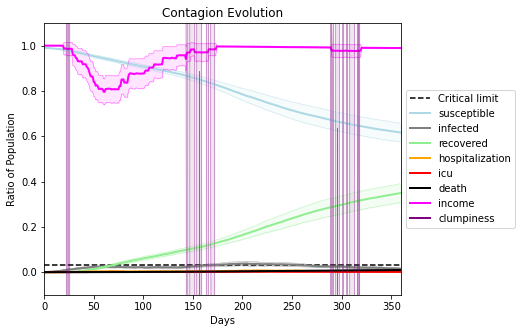

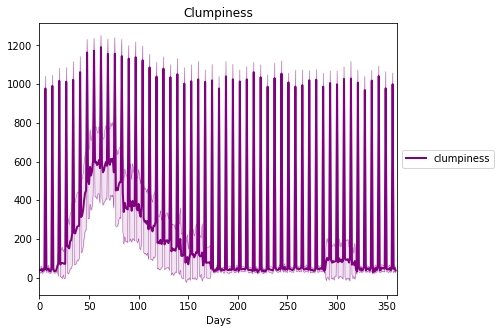

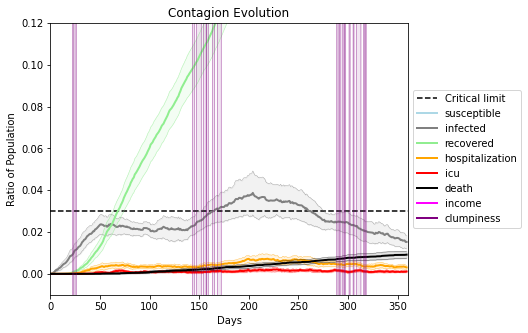

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8382, 3258, 4492, 1398, 7544, 2070, 5334, 4155, 8855, 7022, 4466, 9040, 3245, 5181, 1376, 9221, 7060, 1698, 7157, 3935]
Average similarity between family members is 0.4265823296038118 at temperature -0.8
Average similarity between family and home is 0.9998449744260751 at temperature -1
Average similarity between students and their classroom is 0.22812979211339585 at temperature -0.8
Average classroom occupancy is 1.5917159763313609 and number classrooms is 169
Average similarity between workers is 0.2785970321316304 at temperature -0.8
Average office occupancy is 3.45 and number offices is 200
Average friend similarity for adults: 0.49589940388424125 for kids: 0.37923049782370705
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneou

avg restaurant similarity 0.06860317060161503
avg restaurant similarity 0.08566366215762933
avg restaurant similarity 0.09876948876357483
avg restaurant similarity 0.08993945981739691
avg restaurant similarity 0.11202380799230839
avg restaurant similarity 0.11989230550065068
avg restaurant similarity 0.10782868141494086
avg restaurant similarity 0.13727002787641424
avg restaurant similarity 0.06478582900972452
avg restaurant similarity 0.07704133041265948
avg restaurant similarity 0.10809380563064937
avg restaurant similarity 0.03482893717289791
avg restaurant similarity 0.08881121249660472
avg restaurant similarity 0.06512047235863792
avg restaurant similarity 0.05336960122859617
avg restaurant similarity 0.08912401416304853
avg restaurant similarity 0.06951514593236126
avg restaurant similarity 0.04521664069590569
avg restaurant similarity 0.04330367103497224
avg restaurant similarity 0.06161200076344283
avg restaurant similarity 0.12958702435997665
avg restaurant similarity 0.118209

avg restaurant similarity 0.08259935020764142
avg restaurant similarity 0.05812372297123308
avg restaurant similarity 0.07579446365284094
avg restaurant similarity 0.07564596776285845
avg restaurant similarity 0.12597911758826288
avg restaurant similarity 0.08976447529641192
avg restaurant similarity 0.10132577125142431
avg restaurant similarity 0.021994351897181373
avg restaurant similarity 0.04744118697226078
avg restaurant similarity 0.09865800984986411
avg restaurant similarity 0.07324830439477188
avg restaurant similarity 0.0720544987469056
avg restaurant similarity 0.11394923669753204
avg restaurant similarity 0.10153576894220906
avg restaurant similarity 0.022453068754224967
avg restaurant similarity 0.04833920826805414
avg restaurant similarity 0.10856748294070528
avg restaurant similarity 0.08563498857168517
avg restaurant similarity 0.11081945641541534
avg restaurant similarity 0.07787016386725198
avg restaurant similarity 0.12439207709785467
avg restaurant similarity 0.12201

avg restaurant similarity 0.04663506494049412
avg restaurant similarity 0.02445124142627016
Average similarity between family members is 0.4122954660096419 at temperature -0.8
Average similarity between family and home is 0.9998498551538614 at temperature -1
Average similarity between students and their classroom is 0.15595590622005154 at temperature -0.8
Average classroom occupancy is 1.6702702702702703 and number classrooms is 185
Average similarity between workers is 0.2831279012450144 at temperature -0.8
Average office occupancy is 3.1989795918367347 and number offices is 196
Average friend similarity for adults: 0.4880713699261886 for kids: 0.385516912240111
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.07015277218223728
avg restaurant similarity 0.05346609354275288
avg restaurant similarity 0.1451616387954953
avg restaurant similarity 0.1210320006672245
avg restaurant similarity 0.11251336660742105
avg restaurant similarity 0.10594245191788129
avg restaurant similarity 0.06574981787367333
avg restaurant similarity 0.049502741729888985
avg restaurant similarity 0.08031198513681793
avg restaurant similarity 0.09915479174505178
avg restaurant similarity 0.09069235699168288
avg restaurant similarity 0.11853922786034024
avg restaurant similarity 0.11208393292624527
avg restaurant similarity 0.12690406969557505
avg restaurant similarity 0.09560186478937105
avg restaurant similarity 0.12513887998558978
avg restaurant similarity 0.05656243135213341
avg restaurant similarity 0.12164694183408978
avg restaurant similarity 0.1089968282699721
avg restaurant similarity 0.05766253389075253
avg restaurant similarity 0.17614752136777354
avg restaurant similarity 0.12929976

avg restaurant similarity 0.0742370442977838
avg restaurant similarity 0.14886876816438632
avg restaurant similarity 0.07523843178977599
avg restaurant similarity 0.09361103893889464
avg restaurant similarity 0.04402799877046309
avg restaurant similarity 0.1678405785000388
avg restaurant similarity 0.10523729271870456
avg restaurant similarity 0.11240617379051097
avg restaurant similarity 0.05728934281965497
avg restaurant similarity 0.10438914761315744
avg restaurant similarity 0.10454114477252134
avg restaurant similarity 0.12493794838834872
avg restaurant similarity 0.09998611676124616
avg restaurant similarity 0.08801917342639401
avg restaurant similarity 0.08723224551385815
avg restaurant similarity 0.10361148759998842
avg restaurant similarity 0.10537607056976779
avg restaurant similarity 0.09663664255555833
avg restaurant similarity 0.10482022302355531
avg restaurant similarity 0.13784690783989517
avg restaurant similarity 0.10100256297412608
avg restaurant similarity 0.11126153

avg restaurant similarity 0.0975970106297257
avg restaurant similarity 0.09057002984957963
Average similarity between family members is 0.4546936427103566 at temperature -0.8
Average similarity between family and home is 0.9998521234415697 at temperature -1
Average similarity between students and their classroom is 0.1788145347123896 at temperature -0.8
Average classroom occupancy is 1.572972972972973 and number classrooms is 185
Average similarity between workers is 0.3127526888228067 at temperature -0.8
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.5146021915796555 for kids: 0.400134833802992
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a tot

avg restaurant similarity 0.1477447814225239
avg restaurant similarity 0.12217258054751626
avg restaurant similarity 0.1521063424566219
avg restaurant similarity 0.10004103618867065
avg restaurant similarity 0.11899872829400351
avg restaurant similarity 0.11207374158565225
avg restaurant similarity 0.15361407564267537
avg restaurant similarity 0.12568886308883534
avg restaurant similarity 0.09027634678844397
avg restaurant similarity 0.13478664743281435
avg restaurant similarity 0.1960492533117847
avg restaurant similarity 0.11836041682057369
avg restaurant similarity 0.15014173135023987
avg restaurant similarity 0.18779227092460896
avg restaurant similarity 0.10898869603338589
avg restaurant similarity 0.09462724972753454
avg restaurant similarity 0.08760222705527108
avg restaurant similarity 0.13531314832821284
avg restaurant similarity 0.1278484096904762
avg restaurant similarity 0.15831527132309658
avg restaurant similarity 0.16390232389270967
avg restaurant similarity 0.1254726305

avg restaurant similarity 0.1296042333562151
avg restaurant similarity 0.15248902002689113
avg restaurant similarity 0.0769872026331823
avg restaurant similarity 0.0912159703734076
avg restaurant similarity 0.06619157985328693
avg restaurant similarity 0.12311540034378901
avg restaurant similarity 0.14189828726371856
avg restaurant similarity 0.08570684530345375
avg restaurant similarity 0.09532907074858683
avg restaurant similarity 0.09031513389233309
avg restaurant similarity 0.10741479625042179
avg restaurant similarity 0.10420270896509667
avg restaurant similarity 0.09986525808350925
avg restaurant similarity 0.14536961141357715
avg restaurant similarity 0.13915209079841867
avg restaurant similarity 0.12908886141389803
avg restaurant similarity 0.12638280630435894
avg restaurant similarity 0.10674804675419783
avg restaurant similarity 0.15287270137315256
avg restaurant similarity 0.1489775718683058
avg restaurant similarity 0.12086382597216945
avg restaurant similarity 0.1675239103

avg restaurant similarity 0.11925333884864739
avg restaurant similarity 0.03706447664522283
Average similarity between family members is 0.41988355018271817 at temperature -0.8
Average similarity between family and home is 0.9998496558163794 at temperature -1
Average similarity between students and their classroom is 0.15823889459242743 at temperature -0.8
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.2838126960612085 at temperature -0.8
Average office occupancy is 3.37 and number offices is 200
Average friend similarity for adults: 0.4934423727820974 for kids: 0.37193068680482133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.1031073154422493
avg restaurant similarity 0.06480909286913006
avg restaurant similarity 0.067657084076582
avg restaurant similarity 0.09266937668628418
avg restaurant similarity 0.06793311737649377
avg restaurant similarity 0.11986649891924557
avg restaurant similarity 0.043592532001362407
avg restaurant similarity 0.040773202904111
avg restaurant similarity 0.07740402326203281
avg restaurant similarity 0.056652470025850776
avg restaurant similarity 0.11028692024248285
avg restaurant similarity 0.08083170410961023
avg restaurant similarity 0.06574845627171538
avg restaurant similarity 0.08731579409209872
avg restaurant similarity 0.09883809832279034
avg restaurant similarity 0.046672644504056476
avg restaurant similarity 0.12178132053365898
avg restaurant similarity 0.11333166816277751
avg restaurant similarity 0.10575461377650618
avg restaurant similarity 0.04384619647573993
avg restaurant similarity 0.06859645251785858
avg restaurant similarity 0.05004002

avg restaurant similarity 0.0815928547250695
avg restaurant similarity 0.062062023087403204
avg restaurant similarity 0.0742515845125822
avg restaurant similarity 0.13154959108651793
avg restaurant similarity 0.05928359702483398
avg restaurant similarity 0.13815643849474632
avg restaurant similarity 0.1714574114388789
avg restaurant similarity -0.0008879295756903715
avg restaurant similarity 0.06439341729768759
avg restaurant similarity 0.14667238441501676
avg restaurant similarity 0.07551991852475284
avg restaurant similarity 0.13285291254460033
avg restaurant similarity 0.0929069868082302
avg restaurant similarity 0.11888026123095892
avg restaurant similarity 0.08571108399910185
avg restaurant similarity 0.090031074379013
avg restaurant similarity 0.08996713489829698
avg restaurant similarity 0.08717695974468631
avg restaurant similarity 0.04970734723679125
avg restaurant similarity 0.10925902733111559
avg restaurant similarity 0.09704767209027404
avg restaurant similarity 0.06440206

avg restaurant similarity 0.08081546500384838
avg restaurant similarity 0.08244575792325985
Average similarity between family members is 0.42152928827616415 at temperature -0.8
Average similarity between family and home is 0.9998585040409321 at temperature -1
Average similarity between students and their classroom is 0.16971165851142694 at temperature -0.8
Average classroom occupancy is 1.6555555555555554 and number classrooms is 180
Average similarity between workers is 0.2827699445921396 at temperature -0.8
Average office occupancy is 3.2857142857142856 and number offices is 196
Average friend similarity for adults: 0.48262604056003344 for kids: 0.38894956958541577
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.075022432399051
avg restaurant similarity 0.019372225586373106
avg restaurant similarity 0.06318800365860495
avg restaurant similarity 0.15771105965334029
avg restaurant similarity 0.04954908626756892
avg restaurant similarity 0.1317395794629578
avg restaurant similarity 0.007611145026990813
avg restaurant similarity 0.10652058545848753
avg restaurant similarity 0.12421744578288867
avg restaurant similarity 0.15883286105630165
avg restaurant similarity 0.08569523801971883
avg restaurant similarity 0.15293928370308116
avg restaurant similarity 0.04626970674850115
avg restaurant similarity 0.14979527467907372
avg restaurant similarity 0.12998751849739662
avg restaurant similarity 0.08578297555045375
avg restaurant similarity 0.1078141506693106
avg restaurant similarity 0.1162767542564121
avg restaurant similarity -0.031716879991340916
avg restaurant similarity 0.07593894811180005
avg restaurant similarity 0.09085777360202317
avg restaurant similarity 0.1047382

avg restaurant similarity 0.10224416661777912
avg restaurant similarity 0.08293577238393211
avg restaurant similarity 0.1278542565769863
avg restaurant similarity 0.10751816496488883
avg restaurant similarity 0.14770958914336316
avg restaurant similarity 0.15994427893224872
avg restaurant similarity 0.08212010205388824
avg restaurant similarity 0.11862166654701788
avg restaurant similarity -0.008534242777238361
avg restaurant similarity 0.17420514075601254
avg restaurant similarity 0.14412115493929173
avg restaurant similarity 0.028021379875864144
avg restaurant similarity 0.09798916549356193
avg restaurant similarity 0.11152647400948719
avg restaurant similarity 0.019065816256404015
avg restaurant similarity 0.07190742251808907
avg restaurant similarity 0.11421490146909606
avg restaurant similarity 0.11707830425191644
avg restaurant similarity 0.11420406778762957
avg restaurant similarity 0.10328628137938707
avg restaurant similarity 0.05463654788364926
avg restaurant similarity 0.112

avg restaurant similarity 0.08421075487428974
avg restaurant similarity 0.07059340664609413
avg restaurant similarity 0.1072705739734426
Average similarity between family members is 0.41605084594583125 at temperature -0.8
Average similarity between family and home is 0.9998454177793991 at temperature -1
Average similarity between students and their classroom is 0.19384542536508945 at temperature -0.8
Average classroom occupancy is 1.621761658031088 and number classrooms is 193
Average similarity between workers is 0.29076796674692273 at temperature -0.8
Average office occupancy is 3.130653266331658 and number offices is 199
Average friend similarity for adults: 0.47833702223375063 for kids: 0.3886404910117008
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.11535002129271277
avg restaurant similarity 0.13731802997781548
avg restaurant similarity 0.11150106904105378
avg restaurant similarity 0.11123006130765592
avg restaurant similarity 0.11748005391533067
avg restaurant similarity 0.12109068773353776
avg restaurant similarity 0.12160195573734674
avg restaurant similarity 0.03982158704016373
avg restaurant similarity 0.08278848591842372
avg restaurant similarity 0.091147419070807
avg restaurant similarity 0.09468974075737992
avg restaurant similarity 0.0857857136610015
avg restaurant similarity 0.12699471608039303
avg restaurant similarity 0.07601933022564517
avg restaurant similarity 0.10748524872014642
avg restaurant similarity 0.09347311658964863
avg restaurant similarity 0.13683677863745636
avg restaurant similarity 0.08686505452833783
avg restaurant similarity 0.09767407417999632
avg restaurant similarity 0.06274883305642441
avg restaurant similarity 0.09782506088222702
avg restaurant similarity 0.083285717

avg restaurant similarity 0.05497881667128324
avg restaurant similarity 0.14085759591671418
avg restaurant similarity 0.09988079782488445
avg restaurant similarity 0.08671726409235178
avg restaurant similarity 0.06064741856096875
avg restaurant similarity 0.04994946529261146
avg restaurant similarity 0.11182669185623957
avg restaurant similarity 0.11297486904126085
avg restaurant similarity 0.0906705126556233
avg restaurant similarity 0.08976476910140913
avg restaurant similarity 0.096194720477
avg restaurant similarity 0.09506933981056649
avg restaurant similarity 0.06368472334256292
avg restaurant similarity 0.08711914770369475
avg restaurant similarity 0.07183840818662274
avg restaurant similarity 0.0739356184318339
avg restaurant similarity 0.10246015321154134
avg restaurant similarity 0.11583926349366389
avg restaurant similarity 0.12515393837413047
avg restaurant similarity 0.09589915277862325
avg restaurant similarity 0.14373979855175384
avg restaurant similarity 0.0866538443505

avg restaurant similarity 0.06282476526813534
avg restaurant similarity 0.11471243094411188
Average similarity between family members is 0.42307452719740596 at temperature -0.8
Average similarity between family and home is 0.9998545151999193 at temperature -1
Average similarity between students and their classroom is 0.1684493930501561 at temperature -0.8
Average classroom occupancy is 1.6235955056179776 and number classrooms is 178
Average similarity between workers is 0.2832424149511887 at temperature -0.8
Average office occupancy is 3.2777777777777777 and number offices is 198
Average friend similarity for adults: 0.49763762523814875 for kids: 0.384773114168495
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.0913877902033068
avg restaurant similarity 0.036993365687998735
avg restaurant similarity 0.13390981538638236
avg restaurant similarity 0.07022039712732474
avg restaurant similarity 0.08775391191295327
avg restaurant similarity 0.1332992463236932
avg restaurant similarity 0.045385499114390285
avg restaurant similarity 0.01752559514741993
avg restaurant similarity 0.09523354285022713
avg restaurant similarity 0.08320276834037472
avg restaurant similarity 0.11388231474222828
avg restaurant similarity 0.09750962762682171
avg restaurant similarity 0.07859465129930512
avg restaurant similarity 0.07950796324199737
avg restaurant similarity 0.14112556804572202
avg restaurant similarity 0.08062405086066014
avg restaurant similarity 0.0754768287499886
avg restaurant similarity 0.06982864525409248
avg restaurant similarity 0.04590769619420525
avg restaurant similarity 0.07073006237295659
avg restaurant similarity 0.05135602313472278
avg restaurant similarity 0.0998558

avg restaurant similarity 0.09682008100422647
avg restaurant similarity 0.12429081605687871
avg restaurant similarity 0.10624683346195547
avg restaurant similarity 0.12272863538606339
avg restaurant similarity 0.09360392227269243
avg restaurant similarity 0.10603063736160492
avg restaurant similarity 0.06519574618379557
avg restaurant similarity 0.10711438022587413
avg restaurant similarity 0.09475375025030129
avg restaurant similarity 0.10414435237001766
avg restaurant similarity 0.08300315177186025
avg restaurant similarity 0.08006211962271027
avg restaurant similarity 0.07955065413171436
avg restaurant similarity 0.07626494669856396
avg restaurant similarity 0.022452181530026236
avg restaurant similarity 0.059905140479026765
avg restaurant similarity 0.08412380370564641
avg restaurant similarity 0.10084701343588542
avg restaurant similarity 0.0916266464401186
avg restaurant similarity 0.1338106663340484
avg restaurant similarity 0.020336974171134958
avg restaurant similarity 0.10007

avg restaurant similarity 0.08051292226399741
avg restaurant similarity 0.08099354960176502
Average similarity between family members is 0.41189063683002464 at temperature -0.8
Average similarity between family and home is 0.9998614606335049 at temperature -1
Average similarity between students and their classroom is 0.1367165076429593 at temperature -0.8
Average classroom occupancy is 1.691860465116279 and number classrooms is 172
Average similarity between workers is 0.28633852262239395 at temperature -0.8
Average office occupancy is 3.2663316582914574 and number offices is 199
Average friend similarity for adults: 0.4915912706320132 for kids: 0.3838997792949091
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.0592115377310934
avg restaurant similarity 0.07884829941697417
avg restaurant similarity 0.07025241703867643
avg restaurant similarity 0.11825121011165235
avg restaurant similarity 0.09982210067334553
avg restaurant similarity 0.06299768250285481
avg restaurant similarity 0.03478451725604436
avg restaurant similarity 0.12020495580983807
avg restaurant similarity 0.08704288074259695
avg restaurant similarity 0.11025046437387136
avg restaurant similarity 0.1658450847930013
avg restaurant similarity 0.08008545656525516
avg restaurant similarity 0.17212163893613308
avg restaurant similarity 0.11994343672704688
avg restaurant similarity 0.10619183759010208
avg restaurant similarity 0.05528466702694009
avg restaurant similarity 0.07667445670547651
avg restaurant similarity 0.1361454597853958
avg restaurant similarity 0.0839855371401591
avg restaurant similarity 0.11348877187789412
avg restaurant similarity 0.13534634379348767
avg restaurant similarity 0.1163124266

avg restaurant similarity 0.0737840386397967
avg restaurant similarity 0.13127315132620787
avg restaurant similarity 0.08403996232861057
avg restaurant similarity 0.1361102593661963
avg restaurant similarity 0.08119162332352974
avg restaurant similarity 0.028826359829286937
avg restaurant similarity 0.09906938660492415
avg restaurant similarity 0.09854468689477243
avg restaurant similarity 0.0727525063603237
avg restaurant similarity 0.11675212446170054
avg restaurant similarity 0.14711284192882826
avg restaurant similarity 0.0787959753582084
avg restaurant similarity 0.13037591332783643
avg restaurant similarity 0.10732572227282063
avg restaurant similarity 0.12664381068663458
avg restaurant similarity 0.12553996810580237
avg restaurant similarity 0.1089527352110935
avg restaurant similarity 0.07484857079768034
avg restaurant similarity 0.09690448946606034
avg restaurant similarity 0.11735833628040787
avg restaurant similarity 0.10367658695209303
avg restaurant similarity 0.1209420719

avg restaurant similarity 0.07059887842253941
avg restaurant similarity 0.08463901843825299
Average similarity between family members is 0.4391441028864509 at temperature -0.8
Average similarity between family and home is 0.9998415751527413 at temperature -1
Average similarity between students and their classroom is 0.1614964879449026 at temperature -0.8
Average classroom occupancy is 1.5738636363636365 and number classrooms is 176
Average similarity between workers is 0.3001481331121341 at temperature -0.8
Average office occupancy is 3.3317073170731706 and number offices is 205
Average friend similarity for adults: 0.5113845741693582 for kids: 0.3753577682505197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.028495534502384758
avg restaurant similarity 0.06464108077833901
avg restaurant similarity 0.07537165392627664
avg restaurant similarity 0.03446964717466532
avg restaurant similarity 0.14537826078144986
avg restaurant similarity 0.0028455831623356797
avg restaurant similarity 0.08016554884748345
avg restaurant similarity 0.15742170720686727
avg restaurant similarity -0.004670687197751297
avg restaurant similarity 0.10884132044006739
avg restaurant similarity 0.1022054464742936
avg restaurant similarity 0.06562623641878514
avg restaurant similarity 0.11662931699441147
avg restaurant similarity 0.064474229025072
avg restaurant similarity 0.10070794287316069
avg restaurant similarity 0.08239711610172737
avg restaurant similarity 0.10918391445754123
avg restaurant similarity 0.038809410188307455
avg restaurant similarity 0.0891788834611537
avg restaurant similarity 0.08116117749163218
avg restaurant similarity 0.1377667888546886
avg restaurant similarity 0.03835

avg restaurant similarity 0.11737320618558351
avg restaurant similarity 0.06497075246506809
avg restaurant similarity 0.130912586534221
avg restaurant similarity 0.07241613680446041
avg restaurant similarity 0.053986113857122306
avg restaurant similarity 0.06523663699820074
avg restaurant similarity 0.06316035905163683
avg restaurant similarity 0.07901896385847622
avg restaurant similarity 0.11895771055303134
avg restaurant similarity 0.13618026177250322
avg restaurant similarity 0.11618400378848108
avg restaurant similarity 0.11830062631485994
avg restaurant similarity 0.1000337785708279
avg restaurant similarity 0.13175503508504047
avg restaurant similarity 0.11192863987561649
avg restaurant similarity 0.060293023342223785
avg restaurant similarity 0.10306186585426119
avg restaurant similarity 0.011554143130076393
avg restaurant similarity 0.10119377235070147
avg restaurant similarity 0.10235525541986258
avg restaurant similarity 0.08964489199119638
avg restaurant similarity 0.086196

avg restaurant similarity 0.0942126590753694
avg restaurant similarity 0.10843788385134628
Average similarity between family members is 0.40263695283185913 at temperature -0.8
Average similarity between family and home is 0.9998595253921749 at temperature -1
Average similarity between students and their classroom is 0.15257812549176003 at temperature -0.8
Average classroom occupancy is 1.5348837209302326 and number classrooms is 172
Average similarity between workers is 0.28616396401554595 at temperature -0.8
Average office occupancy is 3.41 and number offices is 200
Average friend similarity for adults: 0.4859634001078583 for kids: 0.36804903108021125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.08597812752790027
avg restaurant similarity 0.023865543451541134
avg restaurant similarity 0.08264750208884472
avg restaurant similarity 0.08813767741941156
avg restaurant similarity 0.06735803866158611
avg restaurant similarity 0.09986432606563567
avg restaurant similarity 0.08624381541909984
avg restaurant similarity 0.10357334504115272
avg restaurant similarity 0.1078422812329883
avg restaurant similarity 0.09539646060030457
avg restaurant similarity 0.10300186817727688
avg restaurant similarity 0.10811191840044485
avg restaurant similarity 0.10259135318474168
avg restaurant similarity 0.08745147776242253
avg restaurant similarity 0.11119533393766132
avg restaurant similarity 0.10618362317857914
avg restaurant similarity 0.1063734333401553
avg restaurant similarity 0.11989831804571187
avg restaurant similarity 0.07431652436563732
avg restaurant similarity 0.09766038244611969
avg restaurant similarity 0.12161448507585547
avg restaurant similarity 0.1318114

avg restaurant similarity 0.11105392518732321
avg restaurant similarity 0.1047887917892818
avg restaurant similarity 0.08907246000815815
avg restaurant similarity 0.08727756782966373
avg restaurant similarity 0.10565637771501826
avg restaurant similarity 0.10678638768112753
avg restaurant similarity 0.1089973902158125
avg restaurant similarity 0.06880762736072651
avg restaurant similarity 0.07225162958767134
avg restaurant similarity 0.10044535917468954
avg restaurant similarity 0.1120151807956655
avg restaurant similarity 0.046174258566711084
avg restaurant similarity 0.13866617262978245
avg restaurant similarity 0.07315400653376546
avg restaurant similarity 0.04840055008602116
avg restaurant similarity 0.07809626055257765
avg restaurant similarity 0.09715106589207521
avg restaurant similarity 0.05246532000086299
avg restaurant similarity 0.07265866991773262
avg restaurant similarity 0.08983681904286517
avg restaurant similarity 0.09062676013067027
avg restaurant similarity 0.07010594

avg restaurant similarity 0.0937747908963999
avg restaurant similarity 0.11260531216031187
Average similarity between family members is 0.4180261359235671 at temperature -0.8
Average similarity between family and home is 0.9998451009534824 at temperature -1
Average similarity between students and their classroom is 0.22296050402510798 at temperature -0.8
Average classroom occupancy is 1.698224852071006 and number classrooms is 169
Average similarity between workers is 0.2966586618621732 at temperature -0.8
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.49642694838074425 for kids: 0.382299548900904
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a t

avg restaurant similarity 0.09199885225231777
avg restaurant similarity 0.13882612664998795
avg restaurant similarity 0.09636505444864765
avg restaurant similarity 0.12435081993852418
avg restaurant similarity 0.11180375708150271
avg restaurant similarity 0.13158703867954927
avg restaurant similarity 0.07730456867300736
avg restaurant similarity 0.06744013156646214
avg restaurant similarity 0.12167089803382547
avg restaurant similarity 0.054042254837893926
avg restaurant similarity 0.1278703350546546
avg restaurant similarity 0.0981882529108395
avg restaurant similarity 0.13116497037733468
avg restaurant similarity 0.11157250055000034
avg restaurant similarity 0.12001777949452615
avg restaurant similarity 0.07534082607302597
avg restaurant similarity 0.0788019065035851
avg restaurant similarity 0.10969129789470884
avg restaurant similarity 0.1302866277462206
avg restaurant similarity 0.06430990159518868
avg restaurant similarity 0.08748955740579074
avg restaurant similarity 0.096035608

avg restaurant similarity 0.154042098785415
avg restaurant similarity 0.16342579867252868
avg restaurant similarity 0.047227448703897563
avg restaurant similarity 0.13449136940105158
avg restaurant similarity 0.05921700228462481
avg restaurant similarity 0.18232422375512436
avg restaurant similarity 0.14009575723582168
avg restaurant similarity 0.07244083565766635
avg restaurant similarity 0.04415541876627053
avg restaurant similarity 0.024824870526839772
avg restaurant similarity 0.1414337704646693
avg restaurant similarity 0.12407856894463616
avg restaurant similarity 0.17338614632044697
avg restaurant similarity 0.09955176908033728
avg restaurant similarity 0.10647085619614918
avg restaurant similarity 0.17286226721474354
avg restaurant similarity 0.06424058452853519
avg restaurant similarity 0.10702960295687651
avg restaurant similarity 0.06196506683593622
avg restaurant similarity 0.16700213800410543
avg restaurant similarity 0.10521741437391537
avg restaurant similarity 0.1313899

avg restaurant similarity 0.11090505326315991
avg restaurant similarity 0.11826790894714852
Average similarity between family members is 0.425188838155634 at temperature -0.8
Average similarity between family and home is 0.9998551274401681 at temperature -1
Average similarity between students and their classroom is 0.22474335663948541 at temperature -0.8
Average classroom occupancy is 1.5945945945945945 and number classrooms is 185
Average similarity between workers is 0.28724242181577125 at temperature -0.8
Average office occupancy is 3.196078431372549 and number offices is 204
Average friend similarity for adults: 0.4987668808640149 for kids: 0.3892314513633978
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated un

avg restaurant similarity 0.10930434577671053
avg restaurant similarity 0.03751757546875741
avg restaurant similarity 0.07123631844385217
avg restaurant similarity 0.08704687661505167
avg restaurant similarity 0.101976801680087
avg restaurant similarity 0.10041429162350338
avg restaurant similarity 0.06306365982311118
avg restaurant similarity 0.011909293472547699
avg restaurant similarity 0.06805850667351951
avg restaurant similarity 0.06764875492497215
avg restaurant similarity 0.11658941864358514
avg restaurant similarity 0.11178132130650145
avg restaurant similarity 0.04302508893619921
avg restaurant similarity 0.08990323372012413
avg restaurant similarity 0.09784183683996828
avg restaurant similarity 0.07926918388807573
avg restaurant similarity 0.0834342679271041
avg restaurant similarity 0.10013982657830123
avg restaurant similarity 0.06983807530193566
avg restaurant similarity 0.09796188343776709
avg restaurant similarity 0.07609850138440563
avg restaurant similarity 0.06037381

avg restaurant similarity 0.08711282028062
avg restaurant similarity 0.0847869831436392
avg restaurant similarity 0.09800762703314926
avg restaurant similarity 0.09477441546854518
avg restaurant similarity 0.042760834897620593
avg restaurant similarity 0.10886476531502574
avg restaurant similarity 0.0645048866418413
avg restaurant similarity 0.08244459315579937
avg restaurant similarity 0.08654727981818823
avg restaurant similarity 0.0610831431013389
avg restaurant similarity 0.0936578473003331
avg restaurant similarity 0.14640902324761854
avg restaurant similarity 0.04115371062124393
avg restaurant similarity 0.08228588459428833
avg restaurant similarity 0.11010953454117287
avg restaurant similarity 0.08528465930109823
avg restaurant similarity 0.0895761189474925
avg restaurant similarity 0.030306522109919132
avg restaurant similarity 0.10480851697915043
avg restaurant similarity 0.04521682075044369
avg restaurant similarity 0.08151099761010257
avg restaurant similarity 0.073881117399

avg restaurant similarity 0.07934535109568487
avg restaurant similarity 0.04975639668227327
Average similarity between family members is 0.4253529279477497 at temperature -0.8
Average similarity between family and home is 0.9998405412917946 at temperature -1
Average similarity between students and their classroom is 0.13613917315240248 at temperature -0.8
Average classroom occupancy is 1.597938144329897 and number classrooms is 194
Average similarity between workers is 0.29088843067760967 at temperature -0.8
Average office occupancy is 3.2666666666666666 and number offices is 195
Average friend similarity for adults: 0.49650170677442335 for kids: 0.39672109879447154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocat

avg restaurant similarity 0.12433600607039365
avg restaurant similarity 0.023210452372518644
avg restaurant similarity 0.10007965739684645
avg restaurant similarity 0.13273424944897708
avg restaurant similarity 0.06767646105670598
avg restaurant similarity 0.018115429650200108
avg restaurant similarity 0.10810581224072918
avg restaurant similarity 0.09584195036951518
avg restaurant similarity 0.13274342845539397
avg restaurant similarity 0.02587843658689929
avg restaurant similarity 0.08553838152234661
avg restaurant similarity 0.05943414834536501
avg restaurant similarity 0.040845691272267254
avg restaurant similarity 0.04327998022836236
avg restaurant similarity 0.0022027790232631997
avg restaurant similarity 0.06644454647839115
avg restaurant similarity 0.0498969098581392
avg restaurant similarity 0.08341734248369372
avg restaurant similarity 0.035145635698605085
avg restaurant similarity 0.10903817584846649
avg restaurant similarity 0.050975232006289485
avg restaurant similarity 0.

avg restaurant similarity 0.11092146760264805
avg restaurant similarity 0.05628355641760375
avg restaurant similarity 0.07127459262629
avg restaurant similarity 0.07127788702015551
avg restaurant similarity 0.04587068796083017
avg restaurant similarity -0.01073842324890696
avg restaurant similarity 0.1307520563117545
avg restaurant similarity 0.10799176497946471
avg restaurant similarity 0.06416485845621894
avg restaurant similarity 0.08466335994380746
avg restaurant similarity 0.1003749153483253
avg restaurant similarity 0.050974827959955074
avg restaurant similarity 0.06873147633164554
avg restaurant similarity 0.06249460546211283
avg restaurant similarity 0.06611556400160432
avg restaurant similarity 0.11507558649737445
avg restaurant similarity 0.12658186768215773
avg restaurant similarity 0.06740678238954305
avg restaurant similarity 0.10686479281425736
avg restaurant similarity 0.0765795901669544
avg restaurant similarity 0.15152682958454625
avg restaurant similarity 0.0762669419

avg restaurant similarity 0.053228946768953005
avg restaurant similarity 0.03897680670603711
avg restaurant similarity 0.028861100063986136
Average similarity between family members is 0.43675834311413614 at temperature -0.8
Average similarity between family and home is 0.9998610290371746 at temperature -1
Average similarity between students and their classroom is 0.12345975089372595 at temperature -0.8
Average classroom occupancy is 1.6077348066298343 and number classrooms is 181
Average similarity between workers is 0.297967360532243 at temperature -0.8
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.4985860127006998 for kids: 0.37649899728556513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.10822781474379167
avg restaurant similarity 0.07853909968973131
avg restaurant similarity 0.026130260362944992
avg restaurant similarity 0.10907635486361413
avg restaurant similarity 0.022401929480334853
avg restaurant similarity 0.0825368366490636
avg restaurant similarity 0.09038045896106983
avg restaurant similarity 0.08307484923707069
avg restaurant similarity 0.09912457616487216
avg restaurant similarity 0.11332745268055257
avg restaurant similarity 0.08908177160382331
avg restaurant similarity 0.11605025280823221
avg restaurant similarity 0.05838075558754528
avg restaurant similarity 0.07275330636885197
avg restaurant similarity 0.05721105735082428
avg restaurant similarity 0.05528715329123927
avg restaurant similarity 0.04126066434991506
avg restaurant similarity 0.07488159111920113
avg restaurant similarity 0.09690238991759281
avg restaurant similarity 0.04212183814306497
avg restaurant similarity 0.1171781295582819
avg restaurant similarity 0.074756

avg restaurant similarity 0.12129073960625711
avg restaurant similarity 0.06644651508303134
avg restaurant similarity 0.08404612906548975
avg restaurant similarity 0.07680473377707144
avg restaurant similarity 0.0614051632711284
avg restaurant similarity 0.10704457413473209
avg restaurant similarity 0.09524787929078277
avg restaurant similarity 0.04634291404456131
avg restaurant similarity 0.06046374511607442
avg restaurant similarity 0.12681599494036708
avg restaurant similarity 0.1353437590137626
avg restaurant similarity 0.11646272024065056
avg restaurant similarity 0.06923418960458233
avg restaurant similarity 0.16136051856709796
avg restaurant similarity 0.0311667375620022
avg restaurant similarity 0.07171015463356548
avg restaurant similarity 0.0817611675694787
avg restaurant similarity 0.061240411497802044
avg restaurant similarity 0.011591391653062473
avg restaurant similarity 0.07806610368660535
avg restaurant similarity 0.07792169369273332
avg restaurant similarity 0.10545528

avg restaurant similarity 0.0910421889314535
avg restaurant similarity 0.08280150749401144
Average similarity between family members is 0.4196569914603842 at temperature -0.8
Average similarity between family and home is 0.9998543829200792 at temperature -1
Average similarity between students and their classroom is 0.15963112747478495 at temperature -0.8
Average classroom occupancy is 1.6416184971098267 and number classrooms is 173
Average similarity between workers is 0.3181335733022575 at temperature -0.8
Average office occupancy is 3.26 and number offices is 200
Average friend similarity for adults: 0.5056979027148524 for kids: 0.39027212338392286
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a 

avg restaurant similarity 0.07074180221861556
avg restaurant similarity 0.04231494731255513
avg restaurant similarity 0.05901198959346356
avg restaurant similarity 0.052959228524436165
avg restaurant similarity 0.1153239703408168
avg restaurant similarity 0.10478325116530597
avg restaurant similarity 0.14526984377765462
avg restaurant similarity 0.04550649600289389
avg restaurant similarity 0.10854524712410786
avg restaurant similarity 0.05922385192842482
avg restaurant similarity 0.06072613616962982
avg restaurant similarity 0.08518038087497372
avg restaurant similarity 0.16921012719460243
avg restaurant similarity 0.07223391932443393
avg restaurant similarity 0.12591207741046864
avg restaurant similarity 0.08374774489588932
avg restaurant similarity 0.10116674918627402
avg restaurant similarity 0.05296871862465632
avg restaurant similarity 0.0870366242941008
avg restaurant similarity 0.17034478044622253
avg restaurant similarity 0.0794909108673289
avg restaurant similarity 0.05186720

avg restaurant similarity 0.08567205838562925
avg restaurant similarity 0.07792977195142342
avg restaurant similarity 0.09761477843603218
avg restaurant similarity 0.03150062255835766
avg restaurant similarity 0.08519097435046563
avg restaurant similarity 0.0904055418661907
avg restaurant similarity 0.09829415722010976
avg restaurant similarity 9.596406454253023e-05
avg restaurant similarity 0.15066853692145785
avg restaurant similarity 0.07012423522149291
avg restaurant similarity 0.08524455102034514
avg restaurant similarity -0.051007070466555476
avg restaurant similarity 0.11638728280759254
avg restaurant similarity 0.05841444411329841
avg restaurant similarity 0.04240182112313242
avg restaurant similarity -0.012159262815098965
avg restaurant similarity 0.030817946520878697
avg restaurant similarity 0.1025131238412632
avg restaurant similarity 0.07336641644037055
avg restaurant similarity 0.10723581652469978
avg restaurant similarity 0.04586934443540924
avg restaurant similarity 0.0

avg restaurant similarity 0.04838830042008689
avg restaurant similarity 0.11163688706918222
avg restaurant similarity 0.12725525900064183
avg restaurant similarity 0.06480098929339649
Average similarity between family members is 0.42285131711454554 at temperature -0.8
Average similarity between family and home is 0.9998538532541654 at temperature -1
Average similarity between students and their classroom is 0.17136187118487575 at temperature -0.8
Average classroom occupancy is 1.6011560693641618 and number classrooms is 173
Average similarity between workers is 0.29809042572021405 at temperature -0.8
Average office occupancy is 3.2536585365853656 and number offices is 205
Average friend similarity for adults: 0.4932428328744793 for kids: 0.3702565198538038
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.038611788219508565
avg restaurant similarity 0.04962517142009267
avg restaurant similarity 0.009974120015766445
avg restaurant similarity 0.10432810697923053
avg restaurant similarity 0.019196351622872043
avg restaurant similarity 0.10313141143030191
avg restaurant similarity 0.044500036154384776
avg restaurant similarity 0.05119872430918032
avg restaurant similarity 0.11950029829027761
avg restaurant similarity 0.04367598094738642
avg restaurant similarity 0.10428240750560169
avg restaurant similarity 0.0611494907025839
avg restaurant similarity 0.07665720857704893
avg restaurant similarity 0.025859157169300838
avg restaurant similarity 0.09675556522373653
avg restaurant similarity 0.12047946772586098
avg restaurant similarity 0.1287581904670218
avg restaurant similarity 0.14138335957621856
avg restaurant similarity 0.07317079839912093
avg restaurant similarity 0.06304206974130536
avg restaurant similarity 0.02298090812203227
avg restaurant similarity 0.050

avg restaurant similarity 0.11579347455729451
avg restaurant similarity 0.060100875394964955
avg restaurant similarity 0.045445064843172525
avg restaurant similarity 0.03704682625989575
avg restaurant similarity 0.0041275682295678125
avg restaurant similarity 0.1429824379018073
avg restaurant similarity 0.08983681503237467
avg restaurant similarity 0.09308985261120288
avg restaurant similarity 0.10812727928860999
avg restaurant similarity 0.08489677315766414
avg restaurant similarity 0.07830523351533757
avg restaurant similarity 0.06098927213822289
avg restaurant similarity 0.069054080414826
avg restaurant similarity 0.0704645731500119
avg restaurant similarity 0.10268080476902375
avg restaurant similarity 0.10793033242510365
avg restaurant similarity 0.03957538654373668
avg restaurant similarity 0.09086476241216941
avg restaurant similarity 0.1586408215179373
avg restaurant similarity 0.12154369758122552
avg restaurant similarity 0.0612106789087872
avg restaurant similarity 0.06383588

avg restaurant similarity 0.07940637844212535
avg restaurant similarity 0.08714923173631886
avg restaurant similarity 0.01436883865692823
avg restaurant similarity 0.0985747018676194
Average similarity between family members is 0.43512959533810636 at temperature -0.8
Average similarity between family and home is 0.9998512786474594 at temperature -1
Average similarity between students and their classroom is 0.16224365356220957 at temperature -0.8
Average classroom occupancy is 1.598802395209581 and number classrooms is 167
Average similarity between workers is 0.28489935351790074 at temperature -0.8
Average office occupancy is 3.42 and number offices is 200
Average friend similarity for adults: 0.5023326466062817 for kids: 0.3799976083628873
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.12709678359056867
avg restaurant similarity 0.09159301646746554
avg restaurant similarity 0.055713543706183005
avg restaurant similarity 0.09526982112693781
avg restaurant similarity 0.09910985669674013
avg restaurant similarity 0.06715468938448328
avg restaurant similarity 0.046898192371944133
avg restaurant similarity 0.11950559189157846
avg restaurant similarity 0.12032157751682628
avg restaurant similarity 0.07213469085125912
avg restaurant similarity 0.05429169247882603
avg restaurant similarity 0.11172111675361755
avg restaurant similarity 0.08915257509490389
avg restaurant similarity 0.05045265213289115
avg restaurant similarity 0.08071656034337511
avg restaurant similarity 0.08412225777711169
avg restaurant similarity 0.07237009318537307
avg restaurant similarity 0.05205625424443167
avg restaurant similarity 0.14263947798730464
avg restaurant similarity 0.11410223594388405
avg restaurant similarity 0.09440278634815057
avg restaurant similarity 0.0503

avg restaurant similarity 0.0631983648057677
avg restaurant similarity 0.12096763695595057
avg restaurant similarity 0.07112681874505897
avg restaurant similarity 0.09805880661627221
avg restaurant similarity 0.07154248173646076
avg restaurant similarity 0.04446320600155797
avg restaurant similarity 0.06748539574121486
avg restaurant similarity 0.12342927488683335
avg restaurant similarity 0.03600342325819126
avg restaurant similarity 0.12804659696972473
avg restaurant similarity 0.09419717615541742
avg restaurant similarity 0.04715545594810513
avg restaurant similarity 0.1403500997735135
avg restaurant similarity 0.027407350938157347
avg restaurant similarity 0.14428674274394376
avg restaurant similarity 0.10004305790127979
avg restaurant similarity 0.18057397514623857
avg restaurant similarity 0.06890478058047511
avg restaurant similarity 0.04511422697125776
avg restaurant similarity 0.11310535907861134
avg restaurant similarity 0.05462189895862328
avg restaurant similarity 0.0358568

avg restaurant similarity 0.09218241741677922
avg restaurant similarity 0.12128383418056382
Average similarity between family members is 0.40790896396317583 at temperature -0.8
Average similarity between family and home is 0.9998526107500826 at temperature -1
Average similarity between students and their classroom is 0.17071615476764876 at temperature -0.8
Average classroom occupancy is 1.5797872340425532 and number classrooms is 188
Average similarity between workers is 0.2906925433409488 at temperature -0.8
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.4921671106837411 for kids: 0.37397563422053287
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.11055904297105575
avg restaurant similarity -0.019388563164939813
avg restaurant similarity 0.13865042934699368
avg restaurant similarity 0.07002616692480722
avg restaurant similarity 0.03486331592484165
avg restaurant similarity 0.12214738603573443
avg restaurant similarity 0.09051046776166753
avg restaurant similarity 0.06180949173243105
avg restaurant similarity 0.11320086066239983
avg restaurant similarity 0.011292018695707473
avg restaurant similarity 0.09991651450983513
avg restaurant similarity 0.06787531501514635
avg restaurant similarity 0.049176256881742236
avg restaurant similarity 0.08088199820088547
avg restaurant similarity 0.025664392662061344
avg restaurant similarity 0.07198155317184554
avg restaurant similarity 0.0011888909666197595
avg restaurant similarity 0.03486797866711238
avg restaurant similarity 0.10038378571533733
avg restaurant similarity 0.058872432678009796
avg restaurant similarity 0.13950087487051283
avg restaurant similarity 

avg restaurant similarity 0.09689608344169309
avg restaurant similarity 0.09499541454140223
avg restaurant similarity 0.0885240128681384
avg restaurant similarity 0.07593246871348613
avg restaurant similarity 0.04312268947903991
avg restaurant similarity 0.07692092325036358
avg restaurant similarity 0.05185594571513613
avg restaurant similarity 0.17926665032306827
avg restaurant similarity 0.04406537105550547
avg restaurant similarity 0.10269883941313337
avg restaurant similarity 0.14056251307427675
avg restaurant similarity 0.03877243734913974
avg restaurant similarity 0.10315967169829673
avg restaurant similarity 0.09961440738542363
avg restaurant similarity 0.048751726698775116
avg restaurant similarity 0.05068554752012357
avg restaurant similarity 0.05540841753294993
avg restaurant similarity 0.1102400873306079
avg restaurant similarity 0.08849652798209602
avg restaurant similarity 0.06784316714748523
avg restaurant similarity 0.10252955252110324
avg restaurant similarity 0.0888174

avg restaurant similarity 0.14559946002775492
avg restaurant similarity 0.12461790918436358
Average similarity between family members is 0.42309968322921265 at temperature -0.8
Average similarity between family and home is 0.9998524609544294 at temperature -1
Average similarity between students and their classroom is 0.16045736420077267 at temperature -0.8
Average classroom occupancy is 1.638036809815951 and number classrooms is 163
Average similarity between workers is 0.2768885789085048 at temperature -0.8
Average office occupancy is 3.2829268292682925 and number offices is 205
Average friend similarity for adults: 0.48677182997902646 for kids: 0.3659163655442928
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.058769217819705906
avg restaurant similarity 0.08532410493766662
avg restaurant similarity 0.10796002950973445
avg restaurant similarity 0.1322480382030289
avg restaurant similarity 0.03166816141975675
avg restaurant similarity 0.08125861214651305
avg restaurant similarity 0.08865777096509324
avg restaurant similarity 0.06812071591864935
avg restaurant similarity 0.09146305408065696
avg restaurant similarity 0.07928435240864667
avg restaurant similarity 0.11289371380097946
avg restaurant similarity 0.06449506705727427
avg restaurant similarity 0.09731564983726701
avg restaurant similarity 0.11765198290191103
avg restaurant similarity 0.136928957649019
avg restaurant similarity 0.09508217866842944
avg restaurant similarity 0.03551919448476953
avg restaurant similarity 0.11284868321081933
avg restaurant similarity 0.09389118393190421
avg restaurant similarity 0.15136807418153195
avg restaurant similarity 0.04212162258449662
avg restaurant similarity 0.14372619

avg restaurant similarity 0.0828752856441072
avg restaurant similarity 0.07037269455982481
avg restaurant similarity 0.062407057878295986
avg restaurant similarity 0.0839311021030692
avg restaurant similarity 0.08148094226273997
avg restaurant similarity 0.09051377244883456
avg restaurant similarity 0.03115808118560571
avg restaurant similarity 0.06209647814205875
avg restaurant similarity 0.11635173348581387
avg restaurant similarity 0.04470434304368081
avg restaurant similarity 0.02212556203445235
avg restaurant similarity 0.1311624737699981
avg restaurant similarity 0.08774391610716711
avg restaurant similarity 0.04289961301954648
avg restaurant similarity 0.08518541375831415
avg restaurant similarity 0.11293131122410142
avg restaurant similarity 0.07487536510500815
avg restaurant similarity 0.08575187098116976
avg restaurant similarity 0.07653491485391062
avg restaurant similarity 0.10620039976065174
avg restaurant similarity 0.06615760641076684
avg restaurant similarity 0.09695878

avg restaurant similarity 0.07705743417914436
avg restaurant similarity 0.12190753037029838
Average similarity between family members is 0.4403376456233323 at temperature -0.8
Average similarity between family and home is 0.9998603885665356 at temperature -1
Average similarity between students and their classroom is 0.18326543820317767 at temperature -0.8
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.29059728953468 at temperature -0.8
Average office occupancy is 3.2427184466019416 and number offices is 206
Average friend similarity for adults: 0.49477958079827766 for kids: 0.3848195461586888
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.12565160962686367
avg restaurant similarity 0.0687357742955751
avg restaurant similarity 0.08665158035619956
avg restaurant similarity 0.04586457484231832
avg restaurant similarity 0.058874627156691305
avg restaurant similarity 0.06013964224789973
avg restaurant similarity 0.08278400776719616
avg restaurant similarity 0.031520964325889196
avg restaurant similarity 0.06135629537900802
avg restaurant similarity 0.14036016223998413
avg restaurant similarity 0.10126578435814361
avg restaurant similarity 0.09376256054705392
avg restaurant similarity 0.025162822222784997
avg restaurant similarity 0.06407714405932474
avg restaurant similarity 0.11774564981190928
avg restaurant similarity 0.08629639095886901
avg restaurant similarity 0.04684702778915032
avg restaurant similarity 0.06170293733467079
avg restaurant similarity 0.10668943486939106
avg restaurant similarity 0.08021563251960699
avg restaurant similarity 0.10399493398381135
avg restaurant similarity 0.0904

avg restaurant similarity 0.02009370070559794
avg restaurant similarity 0.021851237741830058
avg restaurant similarity 0.07508446789603027
avg restaurant similarity 0.06643698326221273
avg restaurant similarity 0.06750323942880973
avg restaurant similarity 0.0750017114069357
avg restaurant similarity 0.08056558422363697
avg restaurant similarity 0.11838850438281831
avg restaurant similarity 0.08753330236183975
avg restaurant similarity 0.09893138177993592
avg restaurant similarity 0.08402172525159671
avg restaurant similarity 0.10177654081837463
avg restaurant similarity 0.089318665251296
avg restaurant similarity 0.14654756298874172
avg restaurant similarity 0.07685593129629145
avg restaurant similarity 0.07826220037311357
avg restaurant similarity 0.12992249756697039
avg restaurant similarity 0.10550986012677804
avg restaurant similarity 0.1172111175206305
avg restaurant similarity 0.057769021928039226
avg restaurant similarity 0.08754685904916591
avg restaurant similarity 0.07190920

avg restaurant similarity 0.05656613773426674
avg restaurant similarity 0.0840497818642845
using average of time series:
stats on susceptible:
data: [0.8157500000000001, 0.8099194444444445, 0.7853333333333332, 0.8468555555555554, 0.8285972222222221, 0.7939611111111111, 0.751931401931402, 0.7963333333333332, 0.8469030969030971, 0.8327138888888889, 0.8247527777777778, 0.7891138888888889, 0.8024416666666667, 0.8066111111111111, 0.7410666666666667, 0.7580833333333332, 0.8523833333333332, 0.7431679431679432, 0.8520805555555556, 0.8146444444444444]
min:
0.7410666666666667
max:
0.8523833333333332
std:
0.034415134320669234
mean:
0.8046322054334555
median:
0.8082652777777778
95% confidence interval for the mean:
(0.7881069992054942,0.8211574116614168)
using average of time series:
stats on infected:
data: [0.020952777777777782, 0.02401944444444445, 0.026805555555555558, 0.01795, 0.0213, 0.03232777777777778, 0.03367188367188367, 0.031013888888888886, 0.018586968586968587, 0.025436111111111118, 0

(<function dict.items>, <function dict.items>, <function dict.items>)

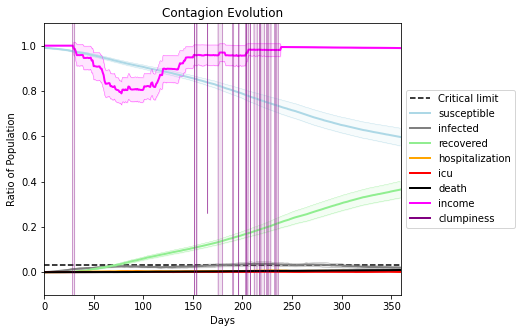

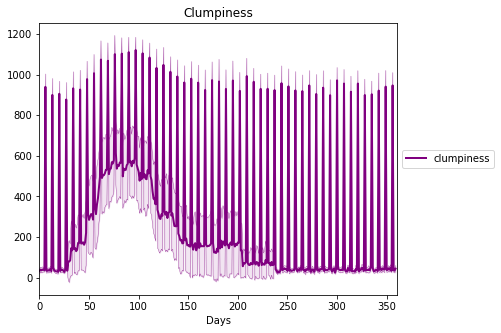

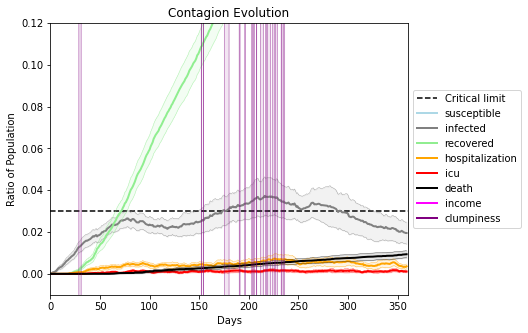

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9027, 8753, 9250, 6318, 7256, 9122, 6746, 2885, 65, 3865, 8068, 2487, 5648, 4720, 6357, 889, 930, 3630, 3427, 7529]
Average similarity between family members is 0.34284494293978024 at temperature -0.7
Average similarity between family and home is 0.9998595172201657 at temperature -1
Average similarity between students and their classroom is 0.17686209179948864 at temperature -0.7
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.17399177290286527 at temperature -0.7
Average office occupancy is 3.29064039408867 and number offices is 203
Average friend similarity for adults: 0.4215471063603241 for kids: 0.3060530186368305
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.06003304030894367
avg restaurant similarity 0.07837930265016457
avg restaurant similarity 0.08401832231950754
avg restaurant similarity 0.016758431693367944
avg restaurant similarity 0.06281294590559922
avg restaurant similarity 0.05159195068530194
avg restaurant similarity 0.08479321763122237
avg restaurant similarity 0.023344833566654857
avg restaurant similarity 0.04798772029444529
avg restaurant similarity 0.03807604791722371
avg restaurant similarity 0.019739453382393024
avg restaurant similarity 0.04751361527282786
avg restaurant similarity 0.06045321627218368
avg restaurant similarity 0.06337638301532306
avg restaurant similarity 0.04019534702406398
avg restaurant similarity 0.0509871278552647
avg restaurant similarity 0.07087177580097055
avg restaurant similarity 0.09049132152931814
avg restaurant similarity 0.051050489236446304
avg restaurant similarity 0.04964396588081773
avg restaurant similarity 0.06311877221598561
avg restaurant similarity 0.093

avg restaurant similarity 0.03340590657960647
avg restaurant similarity 0.027041561648314033
avg restaurant similarity 0.10991153188878504
avg restaurant similarity 0.1269722903104063
avg restaurant similarity 0.07682497045090142
avg restaurant similarity 0.05728824245458392
avg restaurant similarity 0.05104780588113581
avg restaurant similarity 0.08717889784448014
avg restaurant similarity 0.09738890031585581
avg restaurant similarity 0.057332775657129194
avg restaurant similarity 0.0848972951597908
avg restaurant similarity 0.07046951690622057
avg restaurant similarity 0.05571189017160986
avg restaurant similarity 0.04314890075228298
avg restaurant similarity 0.004602284660466278
avg restaurant similarity 0.07763011852062383
avg restaurant similarity 0.06423493155483496
avg restaurant similarity 0.04369998835642861
avg restaurant similarity 0.03702618000049703
avg restaurant similarity 0.06133746439768417
avg restaurant similarity 0.07278686240744527
avg restaurant similarity 0.08552

avg restaurant similarity 0.040264014222658365
avg restaurant similarity 0.08064339941725526
avg restaurant similarity 0.031059731954730718
avg restaurant similarity 0.10982040477516299
Average similarity between family members is 0.3558428068866436 at temperature -0.7
Average similarity between family and home is 0.9998489987905823 at temperature -1
Average similarity between students and their classroom is 0.18806766383645607 at temperature -0.7
Average classroom occupancy is 1.5657142857142856 and number classrooms is 175
Average similarity between workers is 0.17448933198235098 at temperature -0.7
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.43076353653439237 for kids: 0.28662949378299557
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0752699205115201
avg restaurant similarity 0.06833002488962024
avg restaurant similarity 0.12199084308523413
avg restaurant similarity 0.09127973418618955
avg restaurant similarity 0.06381406385096115
avg restaurant similarity 0.1373411703792391
avg restaurant similarity 0.10186309435593686
avg restaurant similarity 0.12646915072884307
avg restaurant similarity 0.09932025672237711
avg restaurant similarity 0.12387281009220671
avg restaurant similarity 0.0819063253208343
avg restaurant similarity 0.14282976245391643
avg restaurant similarity 0.10772983542016017
avg restaurant similarity 0.1039666303463556
avg restaurant similarity 0.04875116793857993
avg restaurant similarity 0.1437606110995051
avg restaurant similarity 0.07599034032879902
avg restaurant similarity 0.07699380474857738
avg restaurant similarity 0.11992648020269456
avg restaurant similarity 0.10623803661709187
avg restaurant similarity 0.04870716390433486
avg restaurant similarity 0.12497447735

avg restaurant similarity 0.11762070513769818
avg restaurant similarity 0.09766791617770954
avg restaurant similarity 0.10080403048049508
avg restaurant similarity 0.10747930758286368
avg restaurant similarity 0.0923666566094315
avg restaurant similarity 0.1319361545465126
avg restaurant similarity 0.10545901539514983
avg restaurant similarity 0.09625846716162231
avg restaurant similarity 0.11485664937858114
avg restaurant similarity 0.07097318475566435
avg restaurant similarity 0.08307903705392326
avg restaurant similarity 0.1526043581796916
avg restaurant similarity 0.08535916751769652
avg restaurant similarity 0.12194976258368827
avg restaurant similarity 0.035294763696026285
avg restaurant similarity 0.08924488842848556
avg restaurant similarity 0.11587590461564731
avg restaurant similarity 0.11529272993643876
avg restaurant similarity 0.1073641726229551
avg restaurant similarity 0.1096538263387996
avg restaurant similarity 0.0848221811583283
avg restaurant similarity 0.05673470142

avg restaurant similarity 0.07125797482838839
avg restaurant similarity 0.13108925541683966
Average similarity between family members is 0.3490500780945675 at temperature -0.7
Average similarity between family and home is 0.9998636728231413 at temperature -1
Average similarity between students and their classroom is 0.2076225369316799 at temperature -0.7
Average classroom occupancy is 1.6850828729281768 and number classrooms is 181
Average similarity between workers is 0.1792559043471401 at temperature -0.7
Average office occupancy is 3.1758793969849246 and number offices is 199
Average friend similarity for adults: 0.4168741467370857 for kids: 0.3100632600000966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated 

avg restaurant similarity 0.06870293464963605
avg restaurant similarity 0.10753701302691586
avg restaurant similarity 0.0678263174289295
avg restaurant similarity 0.09296334469084531
avg restaurant similarity 0.07322594740158801
avg restaurant similarity 0.11293435050860333
avg restaurant similarity 0.11351215853813214
avg restaurant similarity 0.05655097039198882
avg restaurant similarity 0.12925017125205748
avg restaurant similarity 0.08062286564203605
avg restaurant similarity 0.11940547051430343
avg restaurant similarity 0.10928182854209664
avg restaurant similarity 0.09112586006914068
avg restaurant similarity 0.11556787502378196
avg restaurant similarity 0.07599602632366426
avg restaurant similarity 0.12023387660576236
avg restaurant similarity 0.1147529344289961
avg restaurant similarity 0.1581003639672486
avg restaurant similarity 0.11191742495061931
avg restaurant similarity 0.11061916016401205
avg restaurant similarity 0.08583407165271464
avg restaurant similarity 0.064252329

avg restaurant similarity 0.04802159054978784
avg restaurant similarity 0.10374178973880593
avg restaurant similarity 0.10470904537519646
avg restaurant similarity 0.11697118486249891
avg restaurant similarity 0.0945425324336522
avg restaurant similarity 0.07034382700845898
avg restaurant similarity 0.058913378541897606
avg restaurant similarity 0.10664819155635608
avg restaurant similarity 0.05297980551785459
avg restaurant similarity 0.09140640810232858
avg restaurant similarity 0.08457758120315516
avg restaurant similarity 0.06982095349204208
avg restaurant similarity 0.12185546880442887
avg restaurant similarity 0.0821919160099004
avg restaurant similarity 0.08819201203821188
avg restaurant similarity 0.039468672052812424
avg restaurant similarity 0.09795308702156005
avg restaurant similarity 0.07197992179971201
avg restaurant similarity 0.06866922833619356
avg restaurant similarity 0.08273271120202706
avg restaurant similarity 0.08528608612384743
avg restaurant similarity 0.110678

avg restaurant similarity 0.09276459817725541
avg restaurant similarity 0.09211385819328129
Average similarity between family members is 0.3392485669568899 at temperature -0.7
Average similarity between family and home is 0.9998580226533411 at temperature -1
Average similarity between students and their classroom is 0.15984922479587865 at temperature -0.7
Average classroom occupancy is 1.615819209039548 and number classrooms is 177
Average similarity between workers is 0.1815609185729527 at temperature -0.7
Average office occupancy is 3.3451776649746194 and number offices is 197
Average friend similarity for adults: 0.423632344281534 for kids: 0.2787024928708423
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated uni

avg restaurant similarity 0.0904261405235603
avg restaurant similarity 0.06378982595325265
avg restaurant similarity 0.06720038688703509
avg restaurant similarity 0.10430132409773732
avg restaurant similarity 0.07210925937562601
avg restaurant similarity 0.10226127718905426
avg restaurant similarity 0.07572744137699713
avg restaurant similarity 0.06849331047826906
avg restaurant similarity 0.014078906887225524
avg restaurant similarity 0.06735477558594256
avg restaurant similarity 0.0828007737574466
avg restaurant similarity 0.033424499462973774
avg restaurant similarity 0.057205921200171636
avg restaurant similarity 0.09809628588881947
avg restaurant similarity 0.08632217826203134
avg restaurant similarity 0.030780919846520986
avg restaurant similarity 0.028750469556330517
avg restaurant similarity 0.04226270133705416
avg restaurant similarity 0.08600633850450816
avg restaurant similarity 0.07175629241537806
avg restaurant similarity 0.03109877193584941
avg restaurant similarity 0.089

avg restaurant similarity 0.093899959384232
avg restaurant similarity 0.07423461372294243
avg restaurant similarity 0.06405059230551816
avg restaurant similarity 0.06947151241136634
avg restaurant similarity 0.03860541073604923
avg restaurant similarity 0.12789330334094176
avg restaurant similarity 0.07750250813865174
avg restaurant similarity 0.09191176749219546
avg restaurant similarity 0.019110680255650447
avg restaurant similarity 0.07654588111218451
avg restaurant similarity 0.08022774358087033
avg restaurant similarity 0.0430526590050394
avg restaurant similarity 0.03740267020708747
avg restaurant similarity 0.08689975098067809
avg restaurant similarity 0.07382977054501391
avg restaurant similarity 0.12044628515309086
avg restaurant similarity 0.12454199694660757
avg restaurant similarity 0.12199577635435932
avg restaurant similarity 0.048257123970977575
avg restaurant similarity 0.09539497347809588
avg restaurant similarity 0.0378180343571551
avg restaurant similarity 0.03941266

avg restaurant similarity 0.06300196640145696
avg restaurant similarity 0.08827844719909235
avg restaurant similarity 0.05673534631111655
Average similarity between family members is 0.3695563980373159 at temperature -0.7
Average similarity between family and home is 0.9998469823756226 at temperature -1
Average similarity between students and their classroom is 0.1630021450292194 at temperature -0.7
Average classroom occupancy is 1.5957446808510638 and number classrooms is 188
Average similarity between workers is 0.19187940660114988 at temperature -0.7
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.43776296590826885 for kids: 0.312601889437987
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capac

avg restaurant similarity 0.10969531909986859
avg restaurant similarity 0.12983300128102793
avg restaurant similarity 0.14473166763538434
avg restaurant similarity 0.1509263498017848
avg restaurant similarity 0.08739525604209289
avg restaurant similarity 0.07870799653314572
avg restaurant similarity 0.09959245350468451
avg restaurant similarity 0.08789444953522299
avg restaurant similarity 0.12759961383302976
avg restaurant similarity 0.11809139253643908
avg restaurant similarity 0.12591038874940955
avg restaurant similarity 0.04664924461922346
avg restaurant similarity 0.14329524849731337
avg restaurant similarity 0.08464404410498047
avg restaurant similarity 0.12465754995294848
avg restaurant similarity 0.12017561432634338
avg restaurant similarity 0.0691793537765605
avg restaurant similarity 0.128539591343354
avg restaurant similarity 0.12367755311483677
avg restaurant similarity 0.08372769749906926
avg restaurant similarity 0.08189143322994671
avg restaurant similarity 0.1233536097

avg restaurant similarity 0.11052384132285563
avg restaurant similarity 0.07970576541824795
avg restaurant similarity 0.14742343711635736
avg restaurant similarity 0.09344577161615826
avg restaurant similarity 0.14748970564984612
avg restaurant similarity 0.10380598400783878
avg restaurant similarity 0.0867665491530703
avg restaurant similarity 0.11115490397388075
avg restaurant similarity 0.12973449396886022
avg restaurant similarity 0.1353452692680246
avg restaurant similarity 0.10866362826213606
avg restaurant similarity 0.15361703954948608
avg restaurant similarity 0.1194665639988885
avg restaurant similarity 0.10709434320598817
avg restaurant similarity 0.15949160889937777
avg restaurant similarity 0.11661598157747124
avg restaurant similarity 0.18344496107069794
avg restaurant similarity 0.14015801449809898
avg restaurant similarity 0.1547962623184863
avg restaurant similarity 0.07249620130163631
avg restaurant similarity 0.13666255309829334
avg restaurant similarity 0.1136345604

avg restaurant similarity 0.14722994034480583
avg restaurant similarity 0.10678180818497561
Average similarity between family members is 0.34625176237446376 at temperature -0.7
Average similarity between family and home is 0.9998385768469352 at temperature -1
Average similarity between students and their classroom is 0.1940032952602851 at temperature -0.7
Average classroom occupancy is 1.6444444444444444 and number classrooms is 180
Average similarity between workers is 0.17630377213173484 at temperature -0.7
Average office occupancy is 3.2205882352941178 and number offices is 204
Average friend similarity for adults: 0.4279471754296456 for kids: 0.29545581508584573
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.059758748386532314
avg restaurant similarity 0.10335821813741497
avg restaurant similarity -0.011013349523318044
avg restaurant similarity 0.07202135409811708
avg restaurant similarity -0.01388324744131282
avg restaurant similarity 0.107728321248735
avg restaurant similarity 0.04444526254285
avg restaurant similarity 0.12154633117746079
avg restaurant similarity 0.04308284092922994
avg restaurant similarity 0.09134396779041712
avg restaurant similarity 0.09840150475753077
avg restaurant similarity 0.09171502906799965
avg restaurant similarity 0.0950034046193349
avg restaurant similarity 0.12326103983969346
avg restaurant similarity 0.047047464904248285
avg restaurant similarity 0.10266626630764876
avg restaurant similarity 0.0689495976598562
avg restaurant similarity 0.10369921518718893
avg restaurant similarity 0.08137792083093623
avg restaurant similarity 0.0958366761941777
avg restaurant similarity 0.08802647125206467
avg restaurant similarity 0.029882567

avg restaurant similarity 0.1635437389949813
avg restaurant similarity 0.09814919902199332
avg restaurant similarity 0.030661423633793906
avg restaurant similarity 0.03794839795416826
avg restaurant similarity 0.08014785909419264
avg restaurant similarity 0.12842881811119655
avg restaurant similarity 0.045960349403624534
avg restaurant similarity 0.073703100204369
avg restaurant similarity 0.1092043915136546
avg restaurant similarity 0.0809802464386963
avg restaurant similarity 0.11192252209269717
avg restaurant similarity 0.0895654974439261
avg restaurant similarity 0.04243642726028142
avg restaurant similarity 0.06993650915398938
avg restaurant similarity 0.12810914959516853
avg restaurant similarity 0.0699111659060835
avg restaurant similarity -0.0021404109334819733
avg restaurant similarity 0.054027048429772864
avg restaurant similarity 0.08511286655327946
avg restaurant similarity 0.1338789134500129
avg restaurant similarity 0.04698836333679753
avg restaurant similarity 0.11299956

avg restaurant similarity 0.05860410031410741
avg restaurant similarity 0.03653318617589064
Average similarity between family members is 0.3507045701814674 at temperature -0.7
Average similarity between family and home is 0.9998451215070637 at temperature -1
Average similarity between students and their classroom is 0.1751144732024334 at temperature -0.7
Average classroom occupancy is 1.5333333333333334 and number classrooms is 180
Average similarity between workers is 0.178202345884072 at temperature -0.7
Average office occupancy is 3.2745098039215685 and number offices is 204
Average friend similarity for adults: 0.4330986144041695 for kids: 0.292645989487867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.05794381927420915
avg restaurant similarity 0.0006277778031998809
avg restaurant similarity 0.07743458158149223
avg restaurant similarity 0.066430703583408
avg restaurant similarity 0.10207306598346141
avg restaurant similarity 0.06116367376162856
avg restaurant similarity 0.026638099526278387
avg restaurant similarity 0.09807997940641681
avg restaurant similarity 0.0367870414117782
avg restaurant similarity 0.12008208582644365
avg restaurant similarity 0.07530186385228363
avg restaurant similarity 0.1156684873660232
avg restaurant similarity 0.04146391067692474
avg restaurant similarity 0.0820608590232364
avg restaurant similarity 0.02139564199729746
avg restaurant similarity 0.048391600820840125
avg restaurant similarity 0.09278530308097135
avg restaurant similarity 0.14695765152535784
avg restaurant similarity 0.08810998243716187
avg restaurant similarity 0.05967514737168831
avg restaurant similarity 0.07821050862732057
avg restaurant similarity 0.0581959

avg restaurant similarity 0.03267400857516268
avg restaurant similarity 0.06803200080199993
avg restaurant similarity 0.017543656516424165
avg restaurant similarity 0.054884007504362994
avg restaurant similarity 0.03773075977930334
avg restaurant similarity 0.10689430761635327
avg restaurant similarity 0.04882799126225521
avg restaurant similarity 0.07111713400450032
avg restaurant similarity 0.06163269201584198
avg restaurant similarity 0.09840077149063241
avg restaurant similarity 0.0643099055271437
avg restaurant similarity 0.07186761160320791
avg restaurant similarity 0.09555170386908964
avg restaurant similarity 0.03484291455232947
avg restaurant similarity 0.04612844168983954
avg restaurant similarity 0.05869307001809132
avg restaurant similarity 0.043871633318332326
avg restaurant similarity 0.08792267120099852
avg restaurant similarity 0.1063918961548153
avg restaurant similarity 0.11646621047210273
avg restaurant similarity 0.03379720443204993
avg restaurant similarity 0.05023

avg restaurant similarity 0.07381253224030375
avg restaurant similarity 0.07050333881300241
avg restaurant similarity 0.06179526596774404
Average similarity between family members is 0.33960463702651245 at temperature -0.7
Average similarity between family and home is 0.9998600727216681 at temperature -1
Average similarity between students and their classroom is 0.15398549103007136 at temperature -0.7
Average classroom occupancy is 1.5483870967741935 and number classrooms is 186
Average similarity between workers is 0.16301742615028245 at temperature -0.7
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.42804568763110284 for kids: 0.29791454369001125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.06772808550548087
avg restaurant similarity 0.051313927579387256
avg restaurant similarity 0.04080475534613467
avg restaurant similarity 0.07447671719758138
avg restaurant similarity 0.08493142579860716
avg restaurant similarity 0.1459313872265031
avg restaurant similarity 0.06563516466645851
avg restaurant similarity 0.03513268856002138
avg restaurant similarity 0.07638927889456672
avg restaurant similarity 0.11904319506352613
avg restaurant similarity 0.03519642615729614
avg restaurant similarity 0.11583958806718019
avg restaurant similarity 0.09339640582245037
avg restaurant similarity 0.06785225663489808
avg restaurant similarity 0.09414529652119455
avg restaurant similarity 0.0745622270435175
avg restaurant similarity 0.06817303705679227
avg restaurant similarity 0.07747145390853405
avg restaurant similarity 0.11176664894708896
avg restaurant similarity 0.08100797676003274
avg restaurant similarity 0.05560789794235183
avg restaurant similarity 0.1214915

avg restaurant similarity 0.07966160409944466
avg restaurant similarity 0.06496125869225848
avg restaurant similarity 0.09727607689327371
avg restaurant similarity 0.07758629805013947
avg restaurant similarity 0.10479611359342844
avg restaurant similarity 0.1493773936168133
avg restaurant similarity 0.07715413908798147
avg restaurant similarity 0.07509922618994352
avg restaurant similarity 0.10130619421025726
avg restaurant similarity 0.09947904329436669
avg restaurant similarity 0.0957653228736213
avg restaurant similarity 0.050116345381323854
avg restaurant similarity 0.0923580183877999
avg restaurant similarity 0.09710155152582431
avg restaurant similarity 0.05998182460366627
avg restaurant similarity 0.08261215338361029
avg restaurant similarity 0.10066502826843528
avg restaurant similarity 0.1202670693395251
avg restaurant similarity 0.052656861872016084
avg restaurant similarity 0.0838707956338157
avg restaurant similarity 0.018232949626740835
avg restaurant similarity 0.08777267

avg restaurant similarity 0.11595347770210813
avg restaurant similarity 0.13126869749667242
Average similarity between family members is 0.36477552759532034 at temperature -0.7
Average similarity between family and home is 0.9998598324874184 at temperature -1
Average similarity between students and their classroom is 0.19789248322891476 at temperature -0.7
Average classroom occupancy is 1.6101694915254237 and number classrooms is 177
Average similarity between workers is 0.1796312910236068 at temperature -0.7
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.42847869551698126 for kids: 0.29093901716312087
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity 0.021227466736554953
avg restaurant similarity 0.09199794088876032
avg restaurant similarity 0.08547381915017321
avg restaurant similarity 0.07208245693960846
avg restaurant similarity 0.0385091848820585
avg restaurant similarity 0.0994396058860964
avg restaurant similarity 0.10834466235735132
avg restaurant similarity 0.023149274150652637
avg restaurant similarity 0.02876487368234333
avg restaurant similarity 0.06506626839533008
avg restaurant similarity 0.12178285599774995
avg restaurant similarity 0.05675253404863946
avg restaurant similarity 0.02772617476375988
avg restaurant similarity 0.02223850414844692
avg restaurant similarity 0.07105278699059735
avg restaurant similarity 0.09311077813650216
avg restaurant similarity 0.08934284186924743
avg restaurant similarity 0.021136154410879168
avg restaurant similarity 0.005274667203470663
avg restaurant similarity 0.017451663729460293
avg restaurant similarity 0.0356492181236008
avg restaurant similarity 0.0551

avg restaurant similarity 0.09837533640706021
avg restaurant similarity 0.07690129257315968
avg restaurant similarity 0.10848810546139004
avg restaurant similarity 0.04271027197923944
avg restaurant similarity 0.09870426660893165
avg restaurant similarity 0.03777170411907673
avg restaurant similarity 0.03057721773670767
avg restaurant similarity 0.012415884572463133
avg restaurant similarity 0.03298896017799167
avg restaurant similarity 0.012540645974293607
avg restaurant similarity -0.01592400367357535
avg restaurant similarity 0.014265511864503935
avg restaurant similarity 0.05125894935746189
avg restaurant similarity 0.04857255236087733
avg restaurant similarity 0.11731979883631624
avg restaurant similarity 0.09765227805290738
avg restaurant similarity -0.0038391485670634636
avg restaurant similarity -0.013833549858979974
avg restaurant similarity -0.024646791411588643
avg restaurant similarity -0.020548505510815485
avg restaurant similarity 0.061230368873162265
avg restaurant simil

avg restaurant similarity 0.05692955747034022
avg restaurant similarity 0.0856322501838968
avg restaurant similarity 0.10450420267927003
avg restaurant similarity 0.08366227455567338
Average similarity between family members is 0.35368263736678995 at temperature -0.7
Average similarity between family and home is 0.999847906917074 at temperature -1
Average similarity between students and their classroom is 0.19408498762902582 at temperature -0.7
Average classroom occupancy is 1.565934065934066 and number classrooms is 182
Average similarity between workers is 0.19009436324000922 at temperature -0.7
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.4279947454634932 for kids: 0.28920781544640034
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.116195071914393
avg restaurant similarity 0.0865168306162241
avg restaurant similarity 0.04588774190363056
avg restaurant similarity 0.0935938134476172
avg restaurant similarity 0.07928425452188448
avg restaurant similarity 0.08246407196901015
avg restaurant similarity 0.02288300008042999
avg restaurant similarity 0.15281005269293857
avg restaurant similarity 0.09221970067118876
avg restaurant similarity 0.10124857084812112
avg restaurant similarity 0.10769559193482245
avg restaurant similarity 0.09078010844747994
avg restaurant similarity 0.06252366361815621
avg restaurant similarity 0.12674378397081615
avg restaurant similarity 0.11800337327432414
avg restaurant similarity 0.07333180629392533
avg restaurant similarity 0.10447373660872603
avg restaurant similarity 0.13745894168519282
avg restaurant similarity 0.07901001693116728
avg restaurant similarity 0.13296646720165992
avg restaurant similarity 0.1268206406324802
avg restaurant similarity 0.06133122110

avg restaurant similarity 0.14641379036452853
avg restaurant similarity 0.07155527674484195
avg restaurant similarity 0.0744304266412407
avg restaurant similarity 0.11228999760153185
avg restaurant similarity 0.05773131165728517
avg restaurant similarity 0.11711229326782593
avg restaurant similarity 0.1125683492226474
avg restaurant similarity 0.08593639422409546
avg restaurant similarity 0.06279558599532623
avg restaurant similarity 0.12157877132397943
avg restaurant similarity 0.06499389106235647
avg restaurant similarity 0.1270886231763929
avg restaurant similarity 0.10450780193293263
avg restaurant similarity 0.10985299054739563
avg restaurant similarity 0.1274027027749741
avg restaurant similarity 0.1311474589522792
avg restaurant similarity 0.1309736707913692
avg restaurant similarity 0.09262779005753717
avg restaurant similarity 0.1526301551485557
avg restaurant similarity 0.13825611273439428
avg restaurant similarity 0.06524902090620535
avg restaurant similarity 0.1268875992920

avg restaurant similarity 0.10548663887150918
avg restaurant similarity 0.08956114026339536
Average similarity between family members is 0.3427821427285287 at temperature -0.7
Average similarity between family and home is 0.9998492308767851 at temperature -1
Average similarity between students and their classroom is 0.17095427346831718 at temperature -0.7
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.19503646692998305 at temperature -0.7
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.42539206816509045 for kids: 0.30141811703173593
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.11805657845772953
avg restaurant similarity 0.08164613893078643
avg restaurant similarity 0.07544498367767438
avg restaurant similarity 0.04260451488969644
avg restaurant similarity 0.0936373810796808
avg restaurant similarity 0.11331552943746803
avg restaurant similarity 0.10910096284785617
avg restaurant similarity 0.07264068642559306
avg restaurant similarity 0.0515618000394453
avg restaurant similarity 0.10114444632825864
avg restaurant similarity 0.04851807847820767
avg restaurant similarity 0.0825074868723279
avg restaurant similarity 0.06752639617219586
avg restaurant similarity 0.039102782978406365
avg restaurant similarity 0.09593435892166666
avg restaurant similarity 0.07517961240432466
avg restaurant similarity 0.018348748406619715
avg restaurant similarity 0.06584886621511339
avg restaurant similarity 0.07979115402653494
avg restaurant similarity 0.05126436592931564
avg restaurant similarity 0.07065149617288476
avg restaurant similarity 0.1148462

avg restaurant similarity 0.08621082138148166
avg restaurant similarity 0.06901770673473931
avg restaurant similarity 0.10423865324204272
avg restaurant similarity 0.09632685670319703
avg restaurant similarity 0.1254769166638761
avg restaurant similarity 0.11007619837989165
avg restaurant similarity 0.07091117273880133
avg restaurant similarity 0.11653277603323382
avg restaurant similarity 0.0008534775468986345
avg restaurant similarity 0.07109957433734464
avg restaurant similarity 0.05191153895220146
avg restaurant similarity 0.17737385394454294
avg restaurant similarity 0.10862409338768601
avg restaurant similarity 0.13804369602375938
avg restaurant similarity 0.113511783196413
avg restaurant similarity -0.011462218865699168
avg restaurant similarity 0.07538715979859602
avg restaurant similarity 0.09316407245325885
avg restaurant similarity 0.07081581981366285
avg restaurant similarity 0.13085302880058175
avg restaurant similarity 0.06480830867444505
avg restaurant similarity 0.07879

avg restaurant similarity 0.011997926495143347
avg restaurant similarity 0.027488739435837937
avg restaurant similarity 0.09327354873400542
Average similarity between family members is 0.33440327108492723 at temperature -0.7
Average similarity between family and home is 0.9998537426538998 at temperature -1
Average similarity between students and their classroom is 0.16166431370751178 at temperature -0.7
Average classroom occupancy is 1.6042780748663101 and number classrooms is 187
Average similarity between workers is 0.19018913756642322 at temperature -0.7
Average office occupancy is 3.1911764705882355 and number offices is 204
Average friend similarity for adults: 0.42598908907218214 for kids: 0.3019472017404718
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 u

avg restaurant similarity 0.13151363651365144
avg restaurant similarity 0.09519124479967009
avg restaurant similarity 0.10536689719026748
avg restaurant similarity 0.07976659274623356
avg restaurant similarity 0.09007386241011821
avg restaurant similarity 0.06033028888827406
avg restaurant similarity 0.11391264924593021
avg restaurant similarity 0.07362810026506177
avg restaurant similarity 0.05024984204086728
avg restaurant similarity 0.07473207316775897
avg restaurant similarity 0.06516989438703649
avg restaurant similarity 0.08655103991673123
avg restaurant similarity 0.05205468846448328
avg restaurant similarity 0.1070679446447164
avg restaurant similarity 0.12657394062205327
avg restaurant similarity 0.0746114374664957
avg restaurant similarity 0.12200852200552366
avg restaurant similarity 0.1029009913871633
avg restaurant similarity 0.06763643865226986
avg restaurant similarity 0.05425679783883097
avg restaurant similarity 0.14986770514811296
avg restaurant similarity 0.105182934

avg restaurant similarity 0.05776281528225816
avg restaurant similarity 0.12552462322902982
avg restaurant similarity 0.10681758697100495
avg restaurant similarity 0.041264509432597525
avg restaurant similarity 0.09528226240096495
avg restaurant similarity 0.11529458694458639
avg restaurant similarity 0.03231253156243195
avg restaurant similarity 0.06866718251258723
avg restaurant similarity 0.0777866460149513
avg restaurant similarity 0.1288941514376935
avg restaurant similarity 0.09387086680991692
avg restaurant similarity 0.08959993224359082
avg restaurant similarity 0.09953767909489532
avg restaurant similarity 0.07135154494107354
avg restaurant similarity 0.07092580061289072
avg restaurant similarity 0.13775770712109087
avg restaurant similarity 0.07308868410325314
avg restaurant similarity 0.1402235528973175
avg restaurant similarity 0.08248543170457445
avg restaurant similarity 0.07498647800537607
avg restaurant similarity 0.10686586661444082
avg restaurant similarity 0.13458037

avg restaurant similarity 0.09651355432283917
avg restaurant similarity 0.07737195406518142
Average similarity between family members is 0.3594845241568182 at temperature -0.7
Average similarity between family and home is 0.9998570094061123 at temperature -1
Average similarity between students and their classroom is 0.1701111117980813 at temperature -0.7
Average classroom occupancy is 1.6257309941520468 and number classrooms is 171
Average similarity between workers is 0.191473134325435 at temperature -0.7
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.4317356654248937 for kids: 0.2737871179671008
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated uni

avg restaurant similarity 0.0716782789606992
avg restaurant similarity 0.09704138446514957
avg restaurant similarity 0.02874065958293411
avg restaurant similarity 0.05885579934370981
avg restaurant similarity 0.09227864155013908
avg restaurant similarity 0.08987134226886805
avg restaurant similarity 0.08037590986445686
avg restaurant similarity 0.04667803138855278
avg restaurant similarity 0.09827759224388619
avg restaurant similarity 0.10162322502795008
avg restaurant similarity 0.10235549057879141
avg restaurant similarity 0.06877942296238304
avg restaurant similarity 0.09577194240974984
avg restaurant similarity 0.03525043357361055
avg restaurant similarity 0.03810988116103949
avg restaurant similarity 0.05606307257988248
avg restaurant similarity 0.050621417822076915
avg restaurant similarity 0.09832776353890117
avg restaurant similarity -0.0036092393190917315
avg restaurant similarity 0.07570194128974791
avg restaurant similarity 0.04763846481094704
avg restaurant similarity 0.093

avg restaurant similarity 0.07949512662892604
avg restaurant similarity 0.0599027321735628
avg restaurant similarity -0.030459244704289477
avg restaurant similarity 0.04220923704966215
avg restaurant similarity 0.10931084958741544
avg restaurant similarity 0.10053709962190098
avg restaurant similarity 0.08424891449846601
avg restaurant similarity 0.10139346191156519
avg restaurant similarity 0.12479212228847691
avg restaurant similarity 0.08756250619621533
avg restaurant similarity 0.11242884832809112
avg restaurant similarity 0.04535465925947886
avg restaurant similarity 0.10573873877430563
avg restaurant similarity 0.021193088203605732
avg restaurant similarity 0.08813891956769357
avg restaurant similarity 0.07113617766211053
avg restaurant similarity 0.03779024115719129
avg restaurant similarity 0.06668193936086647
avg restaurant similarity 0.07687082381305242
avg restaurant similarity 0.05205026179152484
avg restaurant similarity 0.08719798369571423
avg restaurant similarity 0.0709

avg restaurant similarity -0.005106562817706019
avg restaurant similarity 0.09618296794579435
avg restaurant similarity 0.06211196008042773
Average similarity between family members is 0.3562399234548197 at temperature -0.7
Average similarity between family and home is 0.9998530036883759 at temperature -1
Average similarity between students and their classroom is 0.19749294432648298 at temperature -0.7
Average classroom occupancy is 1.5116279069767442 and number classrooms is 172
Average similarity between workers is 0.19601300624050122 at temperature -0.7
Average office occupancy is 3.396039603960396 and number offices is 202
Average friend similarity for adults: 0.42967048160139 for kids: 0.2692597183374685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 25 people.
Total of 25 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.08828954717328276
avg restaurant similarity 0.08735556404174072
avg restaurant similarity 0.10658874015394867
avg restaurant similarity 0.12870029397370195
avg restaurant similarity 0.07403752450707883
avg restaurant similarity 0.09645187394043578
avg restaurant similarity 0.07865873057492086
avg restaurant similarity 0.11929681542805538
avg restaurant similarity 0.05133107088827166
avg restaurant similarity 0.10041797653700127
avg restaurant similarity 0.07532116907970499
avg restaurant similarity 0.10297448611141725
avg restaurant similarity 0.10873292689334306
avg restaurant similarity 0.06488715778548979
avg restaurant similarity 0.07979865633317389
avg restaurant similarity 0.05342960664689973
avg restaurant similarity 0.0845545982350182
avg restaurant similarity 0.10473095662200196
avg restaurant similarity 0.1240780124569564
avg restaurant similarity 0.06801995620990652
avg restaurant similarity 0.09213403798069952
avg restaurant similarity 0.08280536

avg restaurant similarity 0.12401947782055472
avg restaurant similarity 0.10273736825812528
avg restaurant similarity 0.13189516324713754
avg restaurant similarity 0.14687113327400242
avg restaurant similarity 0.057192429862439276
avg restaurant similarity 0.11152611708166449
avg restaurant similarity 0.07196901342470993
avg restaurant similarity 0.0954297249527337
avg restaurant similarity 0.08784038800842671
avg restaurant similarity 0.08935291592813466
avg restaurant similarity 0.10079287901631409
avg restaurant similarity 0.11849743851646644
avg restaurant similarity 0.10594800786892485
avg restaurant similarity 0.06112595874735002
avg restaurant similarity 0.10231974585909817
avg restaurant similarity 0.0766593646649686
avg restaurant similarity 0.10199439129237427
avg restaurant similarity 0.08153509554619717
avg restaurant similarity 0.04322715507009907
avg restaurant similarity 0.10344100186582393
avg restaurant similarity 0.04141935770227605
avg restaurant similarity 0.0618035

avg restaurant similarity 0.10396692312155241
avg restaurant similarity 0.015251870768387537
Average similarity between family members is 0.37484662096943455 at temperature -0.7
Average similarity between family and home is 0.999841875313692 at temperature -1
Average similarity between students and their classroom is 0.16521691722284307 at temperature -0.7
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.18757804592004015 at temperature -0.7
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.42952887723249533 for kids: 0.2986777386854026
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.0652084476941171
avg restaurant similarity 0.05628489351791633
avg restaurant similarity 0.021931912810718397
avg restaurant similarity 0.05329049158130268
avg restaurant similarity 0.04406361561603355
avg restaurant similarity 0.03461436253948678
avg restaurant similarity 0.03070259223677792
avg restaurant similarity 0.04093429515361819
avg restaurant similarity 0.020468750525034288
avg restaurant similarity 0.05305745574209656
avg restaurant similarity 0.034502418510828504
avg restaurant similarity 0.07635641893368803
avg restaurant similarity 0.03981763446069745
avg restaurant similarity 0.023533524457269344
avg restaurant similarity 0.08147509910880507
avg restaurant similarity 0.09660049748421931
avg restaurant similarity 0.09380274283125462
avg restaurant similarity 0.01635663366222186
avg restaurant similarity 0.04622390519494392
avg restaurant similarity 0.06686697036772181
avg restaurant similarity 0.07814532339351934
avg restaurant similarity 0.027

avg restaurant similarity 0.015914541332390966
avg restaurant similarity 0.07992979046056417
avg restaurant similarity 0.02560391985355937
avg restaurant similarity 0.04028610596078232
avg restaurant similarity 0.0015941825374242286
avg restaurant similarity 0.10523239338514304
avg restaurant similarity 0.07429696733252202
avg restaurant similarity 0.04927303862686541
avg restaurant similarity 0.06476191130519239
avg restaurant similarity 0.015504469305221109
avg restaurant similarity 0.06996994891757181
avg restaurant similarity -0.001623452668064926
avg restaurant similarity 0.08068448621334176
avg restaurant similarity 0.09328600430719707
avg restaurant similarity 0.07112514045715179
avg restaurant similarity 0.00825941143022402
avg restaurant similarity 0.11760182732181566
avg restaurant similarity 0.02111355318791376
avg restaurant similarity 0.08414250273965007
avg restaurant similarity 0.08935732323335509
avg restaurant similarity 0.08694704958833299
avg restaurant similarity 0.

avg restaurant similarity 0.04738894481387788
avg restaurant similarity 0.02867753840319541
avg restaurant similarity 0.06240850762334332
avg restaurant similarity 0.06110161860662173
Average similarity between family members is 0.3536902956074097 at temperature -0.7
Average similarity between family and home is 0.9998519268309922 at temperature -1
Average similarity between students and their classroom is 0.16596410328629643 at temperature -0.7
Average classroom occupancy is 1.6107784431137724 and number classrooms is 167
Average similarity between workers is 0.1980960123024391 at temperature -0.7
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.4309861182369976 for kids: 0.28345385432264697
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.12520683155884793
avg restaurant similarity 0.13446503737301677
avg restaurant similarity 0.13390598237089754
avg restaurant similarity 0.12955070100292596
avg restaurant similarity 0.11461739435617635
avg restaurant similarity 0.1401137523778706
avg restaurant similarity 0.008591704014536206
avg restaurant similarity 0.05829630156003418
avg restaurant similarity 0.07264544613665051
avg restaurant similarity 0.10347688565854092
avg restaurant similarity 0.05686507576671502
avg restaurant similarity 0.18863919112960942
avg restaurant similarity 0.11822010145429937
avg restaurant similarity 0.07511450608201466
avg restaurant similarity -0.0014800509302640558
avg restaurant similarity 0.06655488220263976
avg restaurant similarity 0.14246818034242215
avg restaurant similarity 0.006540877360763476
avg restaurant similarity 0.07340385793732633
avg restaurant similarity 0.08786786711084402
avg restaurant similarity 0.08523386495195065
avg restaurant similarity 0.10

avg restaurant similarity 0.1324907215683548
avg restaurant similarity 0.11536815000302397
avg restaurant similarity 0.06569473717332909
avg restaurant similarity 0.1380668708835646
avg restaurant similarity 0.05762642998671562
avg restaurant similarity 0.12979891587766532
avg restaurant similarity 0.10828404877658221
avg restaurant similarity 0.07683058732598178
avg restaurant similarity 0.06724265206161804
avg restaurant similarity 0.04888081268933069
avg restaurant similarity 0.13415333294834605
avg restaurant similarity 0.07767987776640656
avg restaurant similarity 0.08973804409485081
avg restaurant similarity 0.10775930183156758
avg restaurant similarity 0.0720118227608833
avg restaurant similarity 0.10457153217967831
avg restaurant similarity 0.06589501872469163
avg restaurant similarity 0.0875909973382892
avg restaurant similarity 0.1233919871697784
avg restaurant similarity 0.09118537449077482
avg restaurant similarity 0.06305193697361529
avg restaurant similarity 0.08314451183

avg restaurant similarity 0.0660146742848594
avg restaurant similarity 0.09630347350719243
Average similarity between family members is 0.3624012905466204 at temperature -0.7
Average similarity between family and home is 0.9998495155471115 at temperature -1
Average similarity between students and their classroom is 0.20651296524093368 at temperature -0.7
Average classroom occupancy is 1.6210526315789473 and number classrooms is 190
Average similarity between workers is 0.1966163878402813 at temperature -0.7
Average office occupancy is 3.25 and number offices is 196
Average friend similarity for adults: 0.4303212289854355 for kids: 0.3018777072529191
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a t

avg restaurant similarity 0.0729749052172448
avg restaurant similarity 0.06186586732585044
avg restaurant similarity 0.11761470192425036
avg restaurant similarity 0.09836603352404119
avg restaurant similarity 0.12187185375521126
avg restaurant similarity 0.08894862317977245
avg restaurant similarity 0.10188125712866497
avg restaurant similarity 0.11501264572882779
avg restaurant similarity 0.07675956821492001
avg restaurant similarity 0.05877527647568277
avg restaurant similarity 0.061876645095742006
avg restaurant similarity 0.09312402471374176
avg restaurant similarity 0.07476516595965185
avg restaurant similarity 0.09169851149224127
avg restaurant similarity 0.11818913987404592
avg restaurant similarity 0.11121905671981182
avg restaurant similarity 0.10783079459953884
avg restaurant similarity 0.1706291160935886
avg restaurant similarity 0.13556344692232847
avg restaurant similarity 0.11594149744657939
avg restaurant similarity 0.04593352644386792
avg restaurant similarity 0.1002378

avg restaurant similarity 0.1157586748282344
avg restaurant similarity 0.08718099651535988
avg restaurant similarity 0.1482863062451216
avg restaurant similarity 0.08385194788793851
avg restaurant similarity 0.029048419485275128
avg restaurant similarity 0.11529740085813053
avg restaurant similarity 0.08809478543969171
avg restaurant similarity 0.10081940637405319
avg restaurant similarity 0.11679385424764746
avg restaurant similarity 0.08485557142194275
avg restaurant similarity 0.07334266594629336
avg restaurant similarity 0.09299341258249602
avg restaurant similarity 0.061414227169261794
avg restaurant similarity 0.12113243090789026
avg restaurant similarity 0.12260609476224871
avg restaurant similarity 0.12656028656283239
avg restaurant similarity 0.03511767049353303
avg restaurant similarity 0.09206882657973478
avg restaurant similarity 0.08171077172253859
avg restaurant similarity 0.07664579197712945
avg restaurant similarity 0.08502316172786016
avg restaurant similarity 0.130718

avg restaurant similarity 0.00641942038720228
avg restaurant similarity 0.0490145276688192
Average similarity between family members is 0.3460659531822818 at temperature -0.7
Average similarity between family and home is 0.9998506376218742 at temperature -1
Average similarity between students and their classroom is 0.16612429203032503 at temperature -0.7
Average classroom occupancy is 1.53551912568306 and number classrooms is 183
Average similarity between workers is 0.17715314343025976 at temperature -0.7
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.4240282840751475 for kids: 0.28130057447951007
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.011374159514448437
avg restaurant similarity 0.061267186925469466
avg restaurant similarity 0.0775071103769668
avg restaurant similarity 0.04259021171023341
avg restaurant similarity 0.0371570557222127
avg restaurant similarity 0.03931672516221612
avg restaurant similarity 0.13737164847606514
avg restaurant similarity 0.08639709479074388
avg restaurant similarity -0.021027880195386765
avg restaurant similarity 0.05710837002032374
avg restaurant similarity 0.09034479302235139
avg restaurant similarity 0.05915890464247547
avg restaurant similarity 0.08929106771394403
avg restaurant similarity 0.03672696122531039
avg restaurant similarity 0.0631677887683669
avg restaurant similarity 0.041241508267152754
avg restaurant similarity 0.030368370205158476
avg restaurant similarity 0.00960083222877589
avg restaurant similarity 0.05626657295650043
avg restaurant similarity 0.0390389856448473
avg restaurant similarity 0.1017729349605694
avg restaurant similarity 0.09087

avg restaurant similarity 0.06752162774820843
avg restaurant similarity 0.06616801014036523
avg restaurant similarity 0.07761219612192612
avg restaurant similarity 0.08051389464583077
avg restaurant similarity 0.0544467606459168
avg restaurant similarity 0.020945843158669698
avg restaurant similarity 0.06404435873828108
avg restaurant similarity 0.021937917894823966
avg restaurant similarity 0.035730524871776186
avg restaurant similarity 0.04182244520744321
avg restaurant similarity 0.06388096719934429
avg restaurant similarity 0.04536377864237869
avg restaurant similarity 0.10818394054927599
avg restaurant similarity 0.046057013087640174
avg restaurant similarity 0.06027579552775781
avg restaurant similarity 0.09047384057347373
avg restaurant similarity 0.060215512591463516
avg restaurant similarity 0.04310784254667396
avg restaurant similarity 0.058652806247681176
avg restaurant similarity 0.07655037803335145
avg restaurant similarity 0.024083619818709108
avg restaurant similarity 0.

avg restaurant similarity 0.09197127285976868
avg restaurant similarity 0.03900905037323737
avg restaurant similarity 0.022592682630100717
avg restaurant similarity 0.05108134613419013
avg restaurant similarity 0.012251050623439272
Average similarity between family members is 0.34537163760621326 at temperature -0.7
Average similarity between family and home is 0.9998630057597732 at temperature -1
Average similarity between students and their classroom is 0.1464200324988832 at temperature -0.7
Average classroom occupancy is 1.6242774566473988 and number classrooms is 173
Average similarity between workers is 0.16528234351164314 at temperature -0.7
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.4172372188070831 for kids: 0.2861713025103833
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people all

avg restaurant similarity 0.05239399740544219
avg restaurant similarity 0.12204080331006176
avg restaurant similarity 0.06347640460216022
avg restaurant similarity 0.09648968544260522
avg restaurant similarity 0.062365681071744145
avg restaurant similarity 0.05972090966590006
avg restaurant similarity 0.044562757980783275
avg restaurant similarity 0.09762717867837113
avg restaurant similarity 0.09632855692558752
avg restaurant similarity 0.1385632050767035
avg restaurant similarity 0.06903729704264325
avg restaurant similarity 0.03618092999953083
avg restaurant similarity 0.08968923933102747
avg restaurant similarity 0.1040118412152516
avg restaurant similarity 0.10417811858206814
avg restaurant similarity 0.09666989032926394
avg restaurant similarity 0.15841156241425178
avg restaurant similarity 0.05204179808247199
avg restaurant similarity 0.11274490207563513
avg restaurant similarity 0.0968358868095944
avg restaurant similarity 0.0516145578293839
avg restaurant similarity 0.10273602

avg restaurant similarity 0.09627201398707855
avg restaurant similarity 0.10238903031850469
avg restaurant similarity 0.08340180917121143
avg restaurant similarity 0.15066667354892835
avg restaurant similarity 0.11149034791919103
avg restaurant similarity 0.082751472222176
avg restaurant similarity 0.09064580567520478
avg restaurant similarity 0.09791083678631525
avg restaurant similarity 0.1719514356895803
avg restaurant similarity 0.1150132995313255
avg restaurant similarity 0.08641558762922397
avg restaurant similarity 0.1466546345314829
avg restaurant similarity 0.08966516904559801
avg restaurant similarity 0.08515764700418
avg restaurant similarity 0.0800311014904292
avg restaurant similarity 0.10047100487913055
avg restaurant similarity 0.07419114376216411
avg restaurant similarity 0.055871153356143066
avg restaurant similarity 0.07711436045901177
avg restaurant similarity 0.10864589848485282
avg restaurant similarity 0.09508376887590426
avg restaurant similarity 0.11531630525303

avg restaurant similarity 0.04802648459594552
avg restaurant similarity 0.09373345115108686
Average similarity between family members is 0.3619419437588799 at temperature -0.7
Average similarity between family and home is 0.999863889535795 at temperature -1
Average similarity between students and their classroom is 0.15686299455440209 at temperature -0.7
Average classroom occupancy is 1.6704545454545454 and number classrooms is 176
Average similarity between workers is 0.1843200965330721 at temperature -0.7
Average office occupancy is 3.1970443349753697 and number offices is 203
Average friend similarity for adults: 0.4163858531245974 for kids: 0.2909970049457693
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.08340279638003756
avg restaurant similarity 0.11962907992106867
avg restaurant similarity 0.12825046008101101
avg restaurant similarity 0.05137721439284126
avg restaurant similarity 0.10367199821860916
avg restaurant similarity 0.11642594497596218
avg restaurant similarity 0.108227661444805
avg restaurant similarity 0.12639264981438472
avg restaurant similarity 0.060420952646069594
avg restaurant similarity 0.11883005156649293
avg restaurant similarity 0.15912734982841523
avg restaurant similarity 0.08612595595338378
avg restaurant similarity 0.1396572506665171
avg restaurant similarity 0.08591425981833987
avg restaurant similarity 0.049579893209555234
avg restaurant similarity 0.030775808922922365
avg restaurant similarity 0.1548340559242678
avg restaurant similarity 0.08481764363288398
avg restaurant similarity 0.09791454980889024
avg restaurant similarity 0.08318612161643704
avg restaurant similarity 0.06210222111217277
avg restaurant similarity -0.002009

avg restaurant similarity 0.11723583601760522
avg restaurant similarity 0.12267993945419303
avg restaurant similarity 0.06776655432003752
avg restaurant similarity 0.10167768075610303
avg restaurant similarity 0.07361628395316093
avg restaurant similarity 0.13400899972332775
avg restaurant similarity 0.0914393355428139
avg restaurant similarity 0.07236306639125396
avg restaurant similarity 0.1088276001774999
avg restaurant similarity 0.10354944349344979
avg restaurant similarity 0.03689587288149865
avg restaurant similarity 0.0751064450512992
avg restaurant similarity 0.07362344797593584
avg restaurant similarity 0.06229191236910005
avg restaurant similarity 0.0850575104219316
avg restaurant similarity 0.1077066834881924
avg restaurant similarity 0.08553329606894718
avg restaurant similarity 0.1370572224918688
avg restaurant similarity 0.063897718604849
avg restaurant similarity 0.027994209405872456
avg restaurant similarity 0.05100416050674917
avg restaurant similarity 0.1077062031904

avg restaurant similarity 0.029721748280062604
avg restaurant similarity 0.12683102694212262
using average of time series:
stats on susceptible:
data: [0.7043944444444444, 0.8847555555555557, 0.8334916666666667, 0.7619055555555556, 0.7897205588822355, 0.8171305555555555, 0.7905972222222223, 0.8741305555555554, 0.7271944444444444, 0.7070555555555555, 0.8044068919814448, 0.7463083333333334, 0.8901888888888888, 0.8032823242404081, 0.7695500000000001, 0.8622833333333334, 0.8316866267465071, 0.7179722222222223, 0.8884388888888888, 0.8513194444444445]
min:
0.7043944444444444
max:
0.8901888888888888
std:
0.060292787820404384
mean:
0.8027906534258632
median:
0.8038446081109265
95% confidence interval for the mean:
(0.7738397057553641,0.8317416010963623)
using average of time series:
stats on infected:
data: [0.036180555555555556, 0.014072222222222222, 0.01868888888888889, 0.025649999999999996, 0.02675205145265025, 0.022341666666666666, 0.02475, 0.018319444444444444, 0.03414444444444444, 0.0352

(<function dict.items>, <function dict.items>, <function dict.items>)

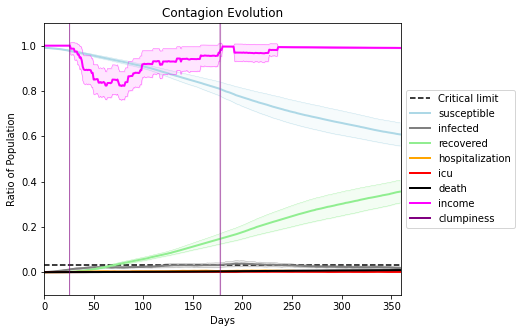

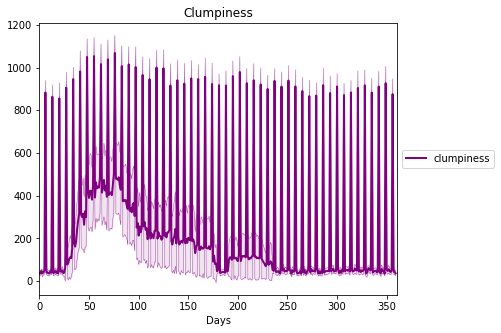

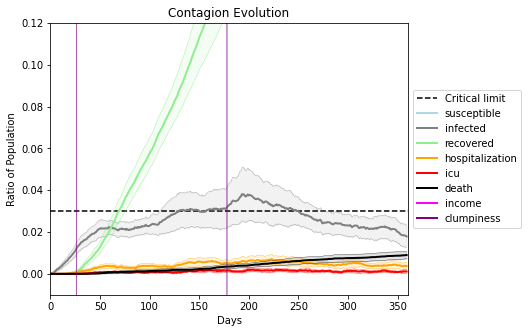

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[7767, 8485, 9248, 1360, 9082, 8205, 4084, 5314, 4882, 2467, 2712, 6501, 7788, 5578, 3052, 2534, 4171, 9206, 2914, 3269]
Average similarity between family members is 0.3026245496676257 at temperature -0.6
Average similarity between family and home is 0.9998624148722286 at temperature -1
Average similarity between students and their classroom is 0.1857631527038353 at temperature -0.6
Average classroom occupancy is 1.6736842105263159 and number classrooms is 190
Average similarity between workers is 0.1334254729155043 at temperature -0.6
Average office occupancy is 3.2142857142857144 and number offices is 196
Average friend similarity for adults: 0.371606529729828 for kids: 0.2367286183966993
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.07267015604270394
avg restaurant similarity 0.09591796648965802
avg restaurant similarity 0.04895298415151337
avg restaurant similarity 0.06632843418987203
avg restaurant similarity 0.10660498557226104
avg restaurant similarity 0.09787188331660165
avg restaurant similarity 0.05318469481438106
avg restaurant similarity 0.07854326745835816
avg restaurant similarity 0.08856024299189798
avg restaurant similarity 0.07913412124531616
avg restaurant similarity 0.07959252648154277
avg restaurant similarity 0.04755408032502849
avg restaurant similarity 0.07293530678842354
avg restaurant similarity 0.12309174213723323
avg restaurant similarity 0.1027596067822301
avg restaurant similarity 0.1566912084545155
avg restaurant similarity 0.11851339284891677
avg restaurant similarity 0.09830703995253302
avg restaurant similarity 0.08192488753017867
avg restaurant similarity 0.10534562868675357
avg restaurant similarity 0.059681856136031275
avg restaurant similarity 0.1328450

avg restaurant similarity 0.12550588021325254
avg restaurant similarity 0.10198273144395208
avg restaurant similarity 0.11656212988406478
avg restaurant similarity 0.16565490022742468
avg restaurant similarity 0.19093023989626468
avg restaurant similarity 0.0312686137166767
avg restaurant similarity 0.07928721651231045
avg restaurant similarity 0.05231405302247013
avg restaurant similarity 0.0644062233242699
avg restaurant similarity 0.0643316835750522
avg restaurant similarity 0.08313232332346013
avg restaurant similarity 0.08101201956899028
avg restaurant similarity 0.10385117727462836
avg restaurant similarity 0.07314327661130686
avg restaurant similarity 0.09892644585405945
avg restaurant similarity 0.07382342518099967
avg restaurant similarity 0.056514440462713096
avg restaurant similarity 0.11111985954132869
avg restaurant similarity 0.04454118333779865
avg restaurant similarity 0.09150979489880387
avg restaurant similarity 0.1176341907099732
avg restaurant similarity 0.138175809

avg restaurant similarity 0.07193796624175469
avg restaurant similarity 0.10128005566663204
Average similarity between family members is 0.3008469682787913 at temperature -0.6
Average similarity between family and home is 0.999858019726463 at temperature -1
Average similarity between students and their classroom is 0.15988248687072726 at temperature -0.6
Average classroom occupancy is 1.5 and number classrooms is 194
Average similarity between workers is 0.14592391706531543 at temperature -0.6
Average office occupancy is 3.3214285714285716 and number offices is 196
Average friend similarity for adults: 0.3707970954420306 for kids: 0.22682457501124173
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a 

avg restaurant similarity 0.06803230689472171
avg restaurant similarity 0.015497565409324936
avg restaurant similarity 0.07208591973482835
avg restaurant similarity 0.05143668438024532
avg restaurant similarity 0.030080611700857136
avg restaurant similarity 0.08393846104861338
avg restaurant similarity 0.07088640853850002
avg restaurant similarity 0.09968820224327683
avg restaurant similarity 0.038569700851872134
avg restaurant similarity 0.027532643053497837
avg restaurant similarity 0.04450644884564346
avg restaurant similarity 0.07375715595207244
avg restaurant similarity 0.07713799052338328
avg restaurant similarity 0.1259106751495095
avg restaurant similarity 0.04114611600431962
avg restaurant similarity 0.04401780652673033
avg restaurant similarity 0.06573903542704852
avg restaurant similarity 0.052139768570135324
avg restaurant similarity 0.12153681419331445
avg restaurant similarity 0.07918396772637933
avg restaurant similarity 0.07922201399764506
avg restaurant similarity 0.05

avg restaurant similarity 0.026910885762585872
avg restaurant similarity 0.11089158380913025
avg restaurant similarity 0.0447321987967985
avg restaurant similarity 0.09723603571587833
avg restaurant similarity 0.0029504124969576793
avg restaurant similarity 0.07708952602761031
avg restaurant similarity 0.07462874191742176
avg restaurant similarity 0.13267598476725587
avg restaurant similarity 0.058257413811832776
avg restaurant similarity 0.09196836477182296
avg restaurant similarity 0.07963735347122941
avg restaurant similarity -0.006542902538602301
avg restaurant similarity 0.07543460764160612
avg restaurant similarity 0.07474078255038931
avg restaurant similarity 0.07392376418565706
avg restaurant similarity 0.037003476968061395
avg restaurant similarity 0.10881664836049271
avg restaurant similarity 0.0627722091443298
avg restaurant similarity 0.14249351807687563
avg restaurant similarity 0.007746277075141983
avg restaurant similarity 0.01967138584300665
avg restaurant similarity 0.

avg restaurant similarity 0.10532114501245288
avg restaurant similarity 0.038947179098232025
avg restaurant similarity 0.06856913624902906
avg restaurant similarity 0.050711902510639034
Average similarity between family members is 0.3073685698160027 at temperature -0.6
Average similarity between family and home is 0.99986308606436 at temperature -1
Average similarity between students and their classroom is 0.14903897950210557 at temperature -0.6
Average classroom occupancy is 1.5303867403314917 and number classrooms is 181
Average similarity between workers is 0.16901358435912525 at temperature -0.6
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.3803515395223673 for kids: 0.20796555777503742
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.0847036274652054
avg restaurant similarity 0.0878942191635154
avg restaurant similarity 0.09649815325611415
avg restaurant similarity 0.07570907884765835
avg restaurant similarity 0.06499589145021689
avg restaurant similarity 0.13453877535408268
avg restaurant similarity 0.12436278240749692
avg restaurant similarity 0.10946506625644406
avg restaurant similarity 0.09155357156023491
avg restaurant similarity 0.041507479416247196
avg restaurant similarity 0.09887174243284766
avg restaurant similarity 0.06891243096195769
avg restaurant similarity 0.0888056510693686
avg restaurant similarity 0.08721500661351865
avg restaurant similarity 0.06390480242413549
avg restaurant similarity 0.04962052441663619
avg restaurant similarity 0.04112488859694034
avg restaurant similarity 0.08115872775035754
avg restaurant similarity 0.062471423947071725
avg restaurant similarity 0.15246791846778782
avg restaurant similarity 0.139825478384195
avg restaurant similarity 0.079078583

avg restaurant similarity 0.0735374511226196
avg restaurant similarity 0.11581688850837328
avg restaurant similarity 0.12458769136098005
avg restaurant similarity 0.05423464136737223
avg restaurant similarity 0.07979081996137065
avg restaurant similarity 0.11873309007954948
avg restaurant similarity 0.12527410668207475
avg restaurant similarity 0.06377018129685008
avg restaurant similarity 0.06813838616956644
avg restaurant similarity 0.11902377244711268
avg restaurant similarity 0.08723545020301282
avg restaurant similarity 0.08838171801077208
avg restaurant similarity 0.05618498554662929
avg restaurant similarity 0.0667702959125606
avg restaurant similarity 0.09859540395279702
avg restaurant similarity 0.09770825553883616
avg restaurant similarity 0.10888542531572963
avg restaurant similarity 0.1121632671113184
avg restaurant similarity 0.12561980247918889
avg restaurant similarity 0.07756545006681523
avg restaurant similarity 0.028930726470910075
avg restaurant similarity 0.07240702

avg restaurant similarity 0.06143514383854208
avg restaurant similarity 0.06722952451693005
Average similarity between family members is 0.3110820383339609 at temperature -0.6
Average similarity between family and home is 0.999852684212011 at temperature -1
Average similarity between students and their classroom is 0.15337629188900856 at temperature -0.6
Average classroom occupancy is 1.694915254237288 and number classrooms is 177
Average similarity between workers is 0.16413009505854012 at temperature -0.6
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.38117720274471556 for kids: 0.23231317985263733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a t

avg restaurant similarity 0.12142250364704675
avg restaurant similarity 0.09008892932086379
avg restaurant similarity 0.10428119607330703
avg restaurant similarity 0.11700695473624685
avg restaurant similarity 0.09570363473206452
avg restaurant similarity 0.1286404340406265
avg restaurant similarity 0.10152145374759389
avg restaurant similarity 0.12591836923336497
avg restaurant similarity 0.057563262852143963
avg restaurant similarity 0.05533421826607666
avg restaurant similarity 0.07735893234982867
avg restaurant similarity 0.04463948760803053
avg restaurant similarity 0.10460601825607257
avg restaurant similarity 0.07896730816392247
avg restaurant similarity 0.10591947930828881
avg restaurant similarity 0.09779716723396115
avg restaurant similarity 0.07920044413603086
avg restaurant similarity 0.13121208908455753
avg restaurant similarity 0.1409877336320236
avg restaurant similarity 0.13811800413100836
avg restaurant similarity 0.06467138971093568
avg restaurant similarity 0.1018645

avg restaurant similarity 0.10243602465738766
avg restaurant similarity 0.05782924007698084
avg restaurant similarity 0.08790427395340211
avg restaurant similarity 0.06271120769567201
avg restaurant similarity 0.0736449068515345
avg restaurant similarity 0.1104720840179956
avg restaurant similarity 0.05055118048674758
avg restaurant similarity 0.08479919452621587
avg restaurant similarity 0.08692482020724841
avg restaurant similarity 0.09646659127976935
avg restaurant similarity 0.04245404574334585
avg restaurant similarity 0.06561724634709148
avg restaurant similarity 0.1347244420157612
avg restaurant similarity 0.10659123456443231
avg restaurant similarity 0.14454050046705033
avg restaurant similarity 0.06366501258102893
avg restaurant similarity 0.07589231597135859
avg restaurant similarity 0.05639993949872126
avg restaurant similarity 0.049926036067086066
avg restaurant similarity 0.08599522210140755
avg restaurant similarity 0.061736580174954314
avg restaurant similarity 0.0961961

avg restaurant similarity 0.0665633169285925
avg restaurant similarity 0.09138321523642967
Average similarity between family members is 0.2975599138163805 at temperature -0.6
Average similarity between family and home is 0.9998503304530403 at temperature -1
Average similarity between students and their classroom is 0.17759886109996878 at temperature -0.6
Average classroom occupancy is 1.6033519553072626 and number classrooms is 179
Average similarity between workers is 0.1587882093345758 at temperature -0.6
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.3710463018675055 for kids: 0.21446178201329197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.05449212670893208
avg restaurant similarity 0.012392478020052741
avg restaurant similarity 0.08936699949864689
avg restaurant similarity 0.05540138086552982
avg restaurant similarity 0.011630122556945495
avg restaurant similarity 0.08920538335200816
avg restaurant similarity 0.131450128091383
avg restaurant similarity 0.08488742576244525
avg restaurant similarity 0.0896747810356375
avg restaurant similarity 0.12320958641952293
avg restaurant similarity 0.04536361647522917
avg restaurant similarity 0.047987441553931406
avg restaurant similarity 0.08041606533268048
avg restaurant similarity 0.08918631512747731
avg restaurant similarity 0.10801908321880649
avg restaurant similarity 0.08035766800480053
avg restaurant similarity 0.07152501929652813
avg restaurant similarity 0.08473446329856717
avg restaurant similarity 0.07577115370722712
avg restaurant similarity 0.11767473588411527
avg restaurant similarity 0.04585145549176221
avg restaurant similarity 0.052572

avg restaurant similarity 0.0011762249669178535
avg restaurant similarity 0.07318037843914132
avg restaurant similarity 0.061677490550885186
avg restaurant similarity 0.04586029010863628
avg restaurant similarity 0.09219666899865486
avg restaurant similarity 0.15225979086859912
avg restaurant similarity 0.06080572967514706
avg restaurant similarity 0.07095298354987047
avg restaurant similarity 0.13145392387759355
avg restaurant similarity 0.10895387460889215
avg restaurant similarity 0.05742477064916373
avg restaurant similarity 0.07902021539067744
avg restaurant similarity 0.07935071370353787
avg restaurant similarity 0.058065435548800955
avg restaurant similarity 0.050063011693812706
avg restaurant similarity 0.11466833092718284
avg restaurant similarity 0.12423369227379377
avg restaurant similarity 0.08082046645014702
avg restaurant similarity 0.05946131205312139
avg restaurant similarity 0.08198843478728755
avg restaurant similarity 0.08557122890743357
avg restaurant similarity 0.1

avg restaurant similarity 0.06626306421345224
avg restaurant similarity 0.1267138287846181
avg restaurant similarity 0.07825695532291076
Average similarity between family members is 0.30404037734400857 at temperature -0.6
Average similarity between family and home is 0.9998484164475497 at temperature -1
Average similarity between students and their classroom is 0.20343153012882362 at temperature -0.6
Average classroom occupancy is 1.7514124293785311 and number classrooms is 177
Average similarity between workers is 0.1558821175098249 at temperature -0.6
Average office occupancy is 3.188775510204082 and number offices is 196
Average friend similarity for adults: 0.3621973777761418 for kids: 0.24691477338871126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.06147661102237472
avg restaurant similarity 0.04455357310157923
avg restaurant similarity 0.07133476994189453
avg restaurant similarity 0.08264198560456266
avg restaurant similarity 0.042150643636917264
avg restaurant similarity 0.019980946806900483
avg restaurant similarity 0.09831867836948163
avg restaurant similarity 0.03079617137143977
avg restaurant similarity 0.05438181461361868
avg restaurant similarity 0.0546528675855559
avg restaurant similarity 0.04936549562316268
avg restaurant similarity 0.026137566746793482
avg restaurant similarity 0.029021201811984983
avg restaurant similarity 0.04699041014960818
avg restaurant similarity 0.07677021333933429
avg restaurant similarity 0.043301022420236535
avg restaurant similarity 0.06740127935737227
avg restaurant similarity 0.053496784866618304
avg restaurant similarity 0.08513203717512129
avg restaurant similarity 0.09141774813347274
avg restaurant similarity 0.0728774109043632
avg restaurant similarity 0.06

avg restaurant similarity 0.06145816831892407
avg restaurant similarity 0.016116495239622598
avg restaurant similarity 0.034777588624102226
avg restaurant similarity 0.09295130846407995
avg restaurant similarity 0.044183171743856116
avg restaurant similarity 0.06898248885937482
avg restaurant similarity 0.015468453440729344
avg restaurant similarity 0.07416565836332355
avg restaurant similarity 0.04902983381392471
avg restaurant similarity 0.04873602481390453
avg restaurant similarity 0.07131018835947209
avg restaurant similarity 0.03379141458134912
avg restaurant similarity 0.06261519998290936
avg restaurant similarity 0.009857740355235628
avg restaurant similarity 0.05642593405444636
avg restaurant similarity 0.05105605157956158
avg restaurant similarity 0.1332373459803045
avg restaurant similarity 0.09182227870008895
avg restaurant similarity 0.05584527099754341
avg restaurant similarity -0.00733718203913864
avg restaurant similarity 0.06659516968452137
avg restaurant similarity 0.0

avg restaurant similarity 0.04388355302039058
avg restaurant similarity 0.07358134012702806
avg restaurant similarity 0.09740228002280878
avg restaurant similarity 0.07978548186006465
Average similarity between family members is 0.3184019212997145 at temperature -0.6
Average similarity between family and home is 0.999860541384649 at temperature -1
Average similarity between students and their classroom is 0.15362236448577016 at temperature -0.6
Average classroom occupancy is 1.6630434782608696 and number classrooms is 184
Average similarity between workers is 0.1597210807976468 at temperature -0.6
Average office occupancy is 3.2261306532663316 and number offices is 199
Average friend similarity for adults: 0.38012845893840796 for kids: 0.23808981220617692
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.04696848394241713
avg restaurant similarity 0.05160513985753831
avg restaurant similarity 0.09842300238836149
avg restaurant similarity 0.0863663311986386
avg restaurant similarity 0.1317907170494729
avg restaurant similarity 0.13517150305041692
avg restaurant similarity 0.09911422305791207
avg restaurant similarity 0.08004515915719448
avg restaurant similarity 0.07513589261236875
avg restaurant similarity 0.06710975526573928
avg restaurant similarity 0.12517177363076654
avg restaurant similarity 0.08396723192873948
avg restaurant similarity 0.09199913378854827
avg restaurant similarity 0.07861122292281447
avg restaurant similarity 0.1611424743003486
avg restaurant similarity 0.06572464917180325
avg restaurant similarity 0.1014668930581699
avg restaurant similarity 0.12931772310425232
avg restaurant similarity 0.05635818380468433
avg restaurant similarity 0.050742805955137214
avg restaurant similarity 0.056332740959399566
avg restaurant similarity 0.11771864

avg restaurant similarity 0.11960483837100028
avg restaurant similarity 0.09934956534032428
avg restaurant similarity 0.0500052681549878
avg restaurant similarity 0.08998990770681958
avg restaurant similarity 0.05062810400729573
avg restaurant similarity 0.08202771583908924
avg restaurant similarity 0.125510740211091
avg restaurant similarity 0.1016232844589159
avg restaurant similarity 0.10007510463894759
avg restaurant similarity 0.10870766677525678
avg restaurant similarity 0.11580764357184159
avg restaurant similarity 0.02997581808078257
avg restaurant similarity 0.1287666145950845
avg restaurant similarity 0.08529819819452547
avg restaurant similarity 0.0942172352158087
avg restaurant similarity 0.05397460786389281
avg restaurant similarity 0.048131030350470255
avg restaurant similarity 0.12823432872178955
avg restaurant similarity 0.10495695614438255
avg restaurant similarity 0.08273081477697089
avg restaurant similarity 0.05001416649723745
avg restaurant similarity 0.09337964634

avg restaurant similarity 0.09547021214353264
avg restaurant similarity 0.08591201571606762
Average similarity between family members is 0.28957310886604976 at temperature -0.6
Average similarity between family and home is 0.9998602992195013 at temperature -1
Average similarity between students and their classroom is 0.14531058578397793 at temperature -0.6
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.15864227496731576 at temperature -0.6
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.36722415463878955 for kids: 0.2210936090983447
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloca

avg restaurant similarity 0.10923020585182748
avg restaurant similarity 0.10008993691503566
avg restaurant similarity 0.08625930284444584
avg restaurant similarity 0.1038467872203027
avg restaurant similarity 0.06005771985538944
avg restaurant similarity 0.09399072673344756
avg restaurant similarity 0.0962675854921131
avg restaurant similarity 0.05503669646042971
avg restaurant similarity 0.07004635234870381
avg restaurant similarity 0.10916233315825281
avg restaurant similarity 0.04383692911190701
avg restaurant similarity 0.06372253045635161
avg restaurant similarity 0.05114017723316128
avg restaurant similarity 0.06241319690588983
avg restaurant similarity 0.08780965316077988
avg restaurant similarity 0.03693995839679082
avg restaurant similarity 0.07195402360661272
avg restaurant similarity 0.08646920239576324
avg restaurant similarity 0.09153614556640276
avg restaurant similarity 0.08504323414275734
avg restaurant similarity 0.08295879975187818
avg restaurant similarity 0.08826520

avg restaurant similarity 0.0397865688409803
avg restaurant similarity 0.08457779985112683
avg restaurant similarity 0.07108602290802774
avg restaurant similarity 0.05906259747197773
avg restaurant similarity 0.09165087679839537
avg restaurant similarity 0.041914374341033435
avg restaurant similarity 0.03910172994529796
avg restaurant similarity 0.10505212595995557
avg restaurant similarity 0.049680709367348655
avg restaurant similarity 0.04290979285818297
avg restaurant similarity 0.044638117876334524
avg restaurant similarity 0.10489613684115724
avg restaurant similarity 0.06137248554613113
avg restaurant similarity 0.13105638402293895
avg restaurant similarity 0.0857331098184752
avg restaurant similarity 0.06230361057415928
avg restaurant similarity 0.1089771019657819
avg restaurant similarity 0.026037965516649032
avg restaurant similarity 0.08354290585592516
avg restaurant similarity 0.08279108618593642
avg restaurant similarity 0.08732890740553018
avg restaurant similarity 0.05722

avg restaurant similarity 0.059668336646512145
avg restaurant similarity 0.0072693586202235705
avg restaurant similarity 0.0886805629117159
Average similarity between family members is 0.3006911367304977 at temperature -0.6
Average similarity between family and home is 0.9998491934163583 at temperature -1
Average similarity between students and their classroom is 0.18566593185238195 at temperature -0.6
Average classroom occupancy is 1.560846560846561 and number classrooms is 189
Average similarity between workers is 0.17468962557980575 at temperature -0.6
Average office occupancy is 3.221105527638191 and number offices is 199
Average friend similarity for adults: 0.3745039755781862 for kids: 0.22614161418368156
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.07607193223869868
avg restaurant similarity 0.07179021794359827
avg restaurant similarity 0.050931176535810384
avg restaurant similarity 0.052258290760231696
avg restaurant similarity 0.08859039425809799
avg restaurant similarity 0.032027380426936
avg restaurant similarity 0.09298673431345578
avg restaurant similarity 0.10246474595438416
avg restaurant similarity 0.10078298666378782
avg restaurant similarity 0.07843516375602046
avg restaurant similarity 0.0793396810634555
avg restaurant similarity 0.04386180143015647
avg restaurant similarity 0.08275687531326077
avg restaurant similarity 0.04418809951915977
avg restaurant similarity 0.07840893604195648
avg restaurant similarity 0.09195447404542785
avg restaurant similarity 0.02716989889361164
avg restaurant similarity 0.09298430286318513
avg restaurant similarity 0.09265361758223345
avg restaurant similarity 0.08264944786531402
avg restaurant similarity 0.014495479011414502
avg restaurant similarity 0.018478

avg restaurant similarity 0.07714400586155992
avg restaurant similarity 0.08202314022000341
avg restaurant similarity 0.16281981171661913
avg restaurant similarity 0.04609075514020979
avg restaurant similarity 0.04172987682344261
avg restaurant similarity 0.037391683535374046
avg restaurant similarity 0.07335793019985237
avg restaurant similarity 0.08751136002942005
avg restaurant similarity 0.07372061889334622
avg restaurant similarity 0.08739329477737351
avg restaurant similarity 0.07694299388120325
avg restaurant similarity 0.06784803959602992
avg restaurant similarity 0.02812313336575707
avg restaurant similarity 0.03242293240414448
avg restaurant similarity 0.08405831700910332
avg restaurant similarity 0.08647716482376358
avg restaurant similarity 0.03130246750072561
avg restaurant similarity 0.032199632066141314
avg restaurant similarity 0.07604363860793731
avg restaurant similarity 0.06297513916194035
avg restaurant similarity 0.09915252380300417
avg restaurant similarity 0.0813

avg restaurant similarity 0.07598782780950199
avg restaurant similarity 0.07228369429107491
avg restaurant similarity 0.07374727793253795
avg restaurant similarity 0.09244988441832414
Average similarity between family members is 0.29748364009980494 at temperature -0.6
Average similarity between family and home is 0.9998509092582317 at temperature -1
Average similarity between students and their classroom is 0.15964380919321638 at temperature -0.6
Average classroom occupancy is 1.5029239766081872 and number classrooms is 171
Average similarity between workers is 0.15571094916516748 at temperature -0.6
Average office occupancy is 3.4693877551020407 and number offices is 196
Average friend similarity for adults: 0.38299554415373216 for kids: 0.21689572303208335
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.07423912163271372
avg restaurant similarity 0.030470336805423364
avg restaurant similarity 0.05328703175805227
avg restaurant similarity 0.06003782500456418
avg restaurant similarity 0.0530879525962004
avg restaurant similarity 0.057991896993286225
avg restaurant similarity 0.05492279911340235
avg restaurant similarity 0.09910857586596694
avg restaurant similarity 0.047286673294525045
avg restaurant similarity 0.09572628563362102
avg restaurant similarity 0.09794940819336227
avg restaurant similarity 0.12397973153212676
avg restaurant similarity 0.08109072594480891
avg restaurant similarity 0.06627390390360458
avg restaurant similarity 0.06206879261347878
avg restaurant similarity 0.10913457954302065
avg restaurant similarity 0.08343697249166386
avg restaurant similarity 0.03530252880320248
avg restaurant similarity 0.027629584874905994
avg restaurant similarity 0.05537424448102198
avg restaurant similarity 0.07037354845727084
avg restaurant similarity 0.067

avg restaurant similarity 0.13110522637409905
avg restaurant similarity 0.017873587937905007
avg restaurant similarity 0.0839966656158662
avg restaurant similarity 0.020375010820604923
avg restaurant similarity 0.08406592995250077
avg restaurant similarity 0.02699093870113809
avg restaurant similarity 0.07838124331352558
avg restaurant similarity 0.07531078514297192
avg restaurant similarity 0.0627985405370118
avg restaurant similarity 0.08144161040556648
avg restaurant similarity 0.05749230937297574
avg restaurant similarity 0.08581437711149748
avg restaurant similarity 0.024232678100244556
avg restaurant similarity 0.04496899696507487
avg restaurant similarity 0.09651714898693158
avg restaurant similarity 0.10076103000042858
avg restaurant similarity 0.07320704623762953
avg restaurant similarity 0.07580557314221396
avg restaurant similarity 0.057412282747507475
avg restaurant similarity 0.06517265284547363
avg restaurant similarity 0.054136353096651366
avg restaurant similarity 0.086

avg restaurant similarity 0.08042884733123858
avg restaurant similarity 0.08743458235445088
avg restaurant similarity 0.06931352403242873
Average similarity between family members is 0.3003938336296158 at temperature -0.6
Average similarity between family and home is 0.9998518505128873 at temperature -1
Average similarity between students and their classroom is 0.1887554262602685 at temperature -0.6
Average classroom occupancy is 1.7348066298342542 and number classrooms is 181
Average similarity between workers is 0.15563891294584592 at temperature -0.6
Average office occupancy is 3.15 and number offices is 200
Average friend similarity for adults: 0.3686927426103035 for kids: 0.23921957892292967
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capa

avg restaurant similarity 0.08060084680122188
avg restaurant similarity 0.09713082777193746
avg restaurant similarity 0.07440990293431402
avg restaurant similarity 0.09474934106120604
avg restaurant similarity 0.09842218434683477
avg restaurant similarity 0.12639584987433566
avg restaurant similarity 0.051937379875750325
avg restaurant similarity 0.1337687879611231
avg restaurant similarity 0.11194255541206871
avg restaurant similarity 0.0877373962351773
avg restaurant similarity 0.0656500315552931
avg restaurant similarity 0.0990728748818269
avg restaurant similarity 0.11458296860556665
avg restaurant similarity 0.1293968333757321
avg restaurant similarity 0.07730355718537872
avg restaurant similarity 0.09936373452424743
avg restaurant similarity 0.0567416023000113
avg restaurant similarity 0.11647495188934757
avg restaurant similarity 0.05614832760607837
avg restaurant similarity 0.13869588349738537
avg restaurant similarity -0.0020195941787888648
avg restaurant similarity 0.11263562

avg restaurant similarity 0.08610844329855677
avg restaurant similarity 0.09406129714062607
avg restaurant similarity 0.07617765921514963
avg restaurant similarity 0.11966187283093589
avg restaurant similarity -0.009392191739428471
avg restaurant similarity 0.08491881060510727
avg restaurant similarity 0.07173697857767625
avg restaurant similarity 0.14532198160068255
avg restaurant similarity 0.11048920523474674
avg restaurant similarity 0.068343502411341
avg restaurant similarity 0.09197775769831715
avg restaurant similarity 0.05673256215433379
avg restaurant similarity 0.06479683269898855
avg restaurant similarity 0.02870421572686048
avg restaurant similarity 0.006855393632320535
avg restaurant similarity 0.057735831752050916
avg restaurant similarity 0.05133262265076346
avg restaurant similarity 0.07050361151460817
avg restaurant similarity 0.058337188333046255
avg restaurant similarity 0.12043578792194029
avg restaurant similarity 0.13099198993112543
avg restaurant similarity 0.066

avg restaurant similarity 0.12652473525891872
avg restaurant similarity 0.0501851929798832
Average similarity between family members is 0.3143501885809769 at temperature -0.6
Average similarity between family and home is 0.9998562217853421 at temperature -1
Average similarity between students and their classroom is 0.15613950283325176 at temperature -0.6
Average classroom occupancy is 1.5505050505050506 and number classrooms is 198
Average similarity between workers is 0.14795484342955573 at temperature -0.6
Average office occupancy is 3.1182266009852215 and number offices is 203
Average friend similarity for adults: 0.3718144684260935 for kids: 0.24612414531818402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity -0.013655803958072433
avg restaurant similarity 0.039294039950243845
avg restaurant similarity 0.0445720338312377
avg restaurant similarity 0.04010308594376384
avg restaurant similarity 0.07765130911335975
avg restaurant similarity 0.10202920691356926
avg restaurant similarity 0.06831379432436757
avg restaurant similarity 0.06865847321532223
avg restaurant similarity 0.08573563072162972
avg restaurant similarity 0.05659883674770142
avg restaurant similarity 0.08750000035689078
avg restaurant similarity 0.037294222825909086
avg restaurant similarity 0.01802836505976379
avg restaurant similarity 0.0520984780133643
avg restaurant similarity 0.07874604523643423
avg restaurant similarity 0.12479984463537086
avg restaurant similarity 0.03631894760020236
avg restaurant similarity 0.022832821732247228
avg restaurant similarity 0.036264817442938774
avg restaurant similarity 0.0796943281785652
avg restaurant similarity 0.06520579466661396
avg restaurant similarity 0.008

avg restaurant similarity 0.04259044207932226
avg restaurant similarity 0.039456458403939625
avg restaurant similarity 0.08154876328810005
avg restaurant similarity 0.06525571494144064
avg restaurant similarity 0.06985640872462248
avg restaurant similarity 0.03081166993074561
avg restaurant similarity 0.027087373967231435
avg restaurant similarity 0.09259794863201144
avg restaurant similarity 0.07919700291717872
avg restaurant similarity 0.031847613807708904
avg restaurant similarity 0.01612203203822915
avg restaurant similarity 0.035889980791895745
avg restaurant similarity 0.05169032585948108
avg restaurant similarity 0.09125121992523719
avg restaurant similarity 0.05809287066242401
avg restaurant similarity 0.056662663563608544
avg restaurant similarity 0.12019950138092884
avg restaurant similarity 0.07104638257249274
avg restaurant similarity 0.06454143804414697
avg restaurant similarity 0.10341478354703534
avg restaurant similarity 0.019006249067380854
avg restaurant similarity 0.

avg restaurant similarity 0.02008876813550285
avg restaurant similarity 0.06766273110926291
avg restaurant similarity 0.033509446799723536
avg restaurant similarity 0.05862002467838775
Average similarity between family members is 0.29372869262213935 at temperature -0.6
Average similarity between family and home is 0.9998574785083605 at temperature -1
Average similarity between students and their classroom is 0.20070550469320936 at temperature -0.6
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.15470102058848542 at temperature -0.6
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.3874193244608523 for kids: 0.23246686729763316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.12439931684891106
avg restaurant similarity 0.13869073789735548
avg restaurant similarity 0.07714105287758424
avg restaurant similarity 0.10315267772499717
avg restaurant similarity 0.07846596036025055
avg restaurant similarity 0.08925123076682433
avg restaurant similarity 0.22030623296269256
avg restaurant similarity 0.11826447856744461
avg restaurant similarity 0.08873393387285411
avg restaurant similarity 0.06624669094794697
avg restaurant similarity 0.0564702549917422
avg restaurant similarity 0.09404594224958343
avg restaurant similarity 0.12186752828149897
avg restaurant similarity 0.11689584320849826
avg restaurant similarity 0.0672338241546441
avg restaurant similarity 0.11276021073174902
avg restaurant similarity 0.11289048966769843
avg restaurant similarity 0.1250399705752987
avg restaurant similarity 0.10748183515652607
avg restaurant similarity 0.12772883953535627
avg restaurant similarity 0.20418798910585093
avg restaurant similarity 0.092973141

avg restaurant similarity 0.1209463814536459
avg restaurant similarity 0.10834040023741767
avg restaurant similarity 0.11740106335041033
avg restaurant similarity 0.06452375294629054
avg restaurant similarity 0.10689600392883995
avg restaurant similarity 0.06402284135648974
avg restaurant similarity 0.10615787252847238
avg restaurant similarity 0.08923264610401589
avg restaurant similarity 0.03880525265996266
avg restaurant similarity 0.1424941598567917
avg restaurant similarity 0.10125797050821081
avg restaurant similarity 0.12581273297128193
avg restaurant similarity 0.11267814813767693
avg restaurant similarity 0.08131719548030283
avg restaurant similarity 0.08082430640344823
avg restaurant similarity 0.11166560657413169
avg restaurant similarity 0.053170394515508285
avg restaurant similarity 0.08874339174257695
avg restaurant similarity 0.09595643310045818
avg restaurant similarity 0.13590460054980472
avg restaurant similarity 0.09386860358303342
avg restaurant similarity 0.1574741

avg restaurant similarity 0.08127115218078333
avg restaurant similarity 0.08426860233471017
Average similarity between family members is 0.3074290106855767 at temperature -0.6
Average similarity between family and home is 0.9998610987279438 at temperature -1
Average similarity between students and their classroom is 0.18239363304487077 at temperature -0.6
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.16970878022721325 at temperature -0.6
Average office occupancy is 3.436548223350254 and number offices is 197
Average friend similarity for adults: 0.39086760923753266 for kids: 0.23860406921091806
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.10872309813162462
avg restaurant similarity 0.11513986296966494
avg restaurant similarity 0.09970509426942822
avg restaurant similarity 0.09772867091928952
avg restaurant similarity 0.13280106645799708
avg restaurant similarity 0.07904504710519092
avg restaurant similarity 0.0828944140871805
avg restaurant similarity 0.07040878257563844
avg restaurant similarity 0.09126741428735206
avg restaurant similarity 0.06341379168133163
avg restaurant similarity 0.11109173688166601
avg restaurant similarity 0.08846797597977281
avg restaurant similarity 0.03739105489286291
avg restaurant similarity 0.07397963572462726
avg restaurant similarity 0.11252168482125491
avg restaurant similarity 0.11105910092636882
avg restaurant similarity 0.07403196323442546
avg restaurant similarity 0.09307732758060865
avg restaurant similarity 0.1067123810093159
avg restaurant similarity 0.0414134467677497
avg restaurant similarity 0.09423098419657772
avg restaurant similarity 0.062722594

avg restaurant similarity 0.0815367861727126
avg restaurant similarity -0.0002645821873398774
avg restaurant similarity 0.08723037585480707
avg restaurant similarity 0.10255318385578423
avg restaurant similarity 0.09764000495068019
avg restaurant similarity 0.08934202606455052
avg restaurant similarity 0.05956293519832789
avg restaurant similarity 0.0741833451321349
avg restaurant similarity 0.039277569519791555
avg restaurant similarity 0.09477512951222256
avg restaurant similarity 0.08799549570945746
avg restaurant similarity 0.06443433009502895
avg restaurant similarity 0.08402002432665134
avg restaurant similarity 0.054258984093704235
avg restaurant similarity 0.09226196303561576
avg restaurant similarity 0.0773469195148423
avg restaurant similarity 0.11270732896831999
avg restaurant similarity 0.11088272136015959
avg restaurant similarity 0.07988642455882543
avg restaurant similarity 0.05344651853690391
avg restaurant similarity 0.011495756789208403
avg restaurant similarity 0.078

avg restaurant similarity 0.090391180097792
avg restaurant similarity 0.09969404613806426
Average similarity between family members is 0.3040427755627091 at temperature -0.6
Average similarity between family and home is 0.9998583519540521 at temperature -1
Average similarity between students and their classroom is 0.19727749175492476 at temperature -0.6
Average classroom occupancy is 1.567251461988304 and number classrooms is 171
Average similarity between workers is 0.14396943260957323 at temperature -0.6
Average office occupancy is 3.357843137254902 and number offices is 204
Average friend similarity for adults: 0.38102738975682476 for kids: 0.23517129024084768
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.07331540649625871
avg restaurant similarity 0.08344430863150543
avg restaurant similarity 0.022226107452200303
avg restaurant similarity 0.1603405167822028
avg restaurant similarity 0.08658880668959765
avg restaurant similarity 0.0923628513158728
avg restaurant similarity 0.09123836208371347
avg restaurant similarity 0.0742489028033955
avg restaurant similarity 0.08153389527444647
avg restaurant similarity 0.1064884030700636
avg restaurant similarity 0.10183187852398312
avg restaurant similarity 0.10072953443923648
avg restaurant similarity 0.11902379257839361
avg restaurant similarity 0.09223893906340792
avg restaurant similarity 0.08553499643287046
avg restaurant similarity 0.13324679098475098
avg restaurant similarity 0.11497987692420528
avg restaurant similarity 0.04268094260200762
avg restaurant similarity 0.06199646019810051
avg restaurant similarity 0.09306054353439248
avg restaurant similarity 0.061101484333641154
avg restaurant similarity 0.11298463

avg restaurant similarity 0.1272339015854945
avg restaurant similarity 0.10903486390518254
avg restaurant similarity 0.07217961973200757
avg restaurant similarity 0.09512913956850495
avg restaurant similarity 0.049498016305391204
avg restaurant similarity 0.12297397535599885
avg restaurant similarity 0.09904959367400415
avg restaurant similarity 0.06614535860816172
avg restaurant similarity 0.054915269296174615
avg restaurant similarity 0.11440931552097819
avg restaurant similarity 0.031831991664450436
avg restaurant similarity 0.07937125806261856
avg restaurant similarity 0.03468412736345528
avg restaurant similarity 0.07056952792697133
avg restaurant similarity 0.05733885602784375
avg restaurant similarity 0.03872805810543784
avg restaurant similarity 0.10714847475329792
avg restaurant similarity 0.10160991959643739
avg restaurant similarity 0.12005284839214178
avg restaurant similarity 0.11032870502619765
avg restaurant similarity 0.06988862101600855
avg restaurant similarity 0.0766

avg restaurant similarity 0.07279958663899472
avg restaurant similarity 0.1426874362440589
Average similarity between family members is 0.3142429370510906 at temperature -0.6
Average similarity between family and home is 0.9998482249511444 at temperature -1
Average similarity between students and their classroom is 0.16570255966606515 at temperature -0.6
Average classroom occupancy is 1.5497076023391814 and number classrooms is 171
Average similarity between workers is 0.15617091183321358 at temperature -0.6
Average office occupancy is 3.3024390243902437 and number offices is 205
Average friend similarity for adults: 0.3821896207017966 for kids: 0.22704091347665994
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.08582762636442112
avg restaurant similarity 0.02608986166975172
avg restaurant similarity 0.062764960949282
avg restaurant similarity 0.1006051650434171
avg restaurant similarity 0.08720833083117674
avg restaurant similarity 0.07412465512601295
avg restaurant similarity 0.02849209317987629
avg restaurant similarity 0.13072748627405553
avg restaurant similarity 0.06361683295172367
avg restaurant similarity 0.11719592093235204
avg restaurant similarity 0.09708312200382628
avg restaurant similarity 0.034786158691310055
avg restaurant similarity 0.05904354013757704
avg restaurant similarity 0.06595854326451345
avg restaurant similarity 0.06170984451532176
avg restaurant similarity 0.09425494945277671
avg restaurant similarity 0.08594076375293722
avg restaurant similarity 0.05671284331498397
avg restaurant similarity 0.07075134240695218
avg restaurant similarity 0.08921483748111153
avg restaurant similarity 0.07315189875979387
avg restaurant similarity 0.10613794

avg restaurant similarity 0.09560306716663051
avg restaurant similarity 0.017453879777460542
avg restaurant similarity 0.07319952765018878
avg restaurant similarity 0.08145710886140817
avg restaurant similarity 0.13330650622847814
avg restaurant similarity 0.07348496148894679
avg restaurant similarity 0.11264646916366973
avg restaurant similarity 0.08940984598398057
avg restaurant similarity 0.0740987686886209
avg restaurant similarity 0.0602823889626289
avg restaurant similarity 0.10380570507127124
avg restaurant similarity 0.09381299995720739
avg restaurant similarity 0.11700702502115289
avg restaurant similarity 0.14625414316186705
avg restaurant similarity 0.10758983590740386
avg restaurant similarity 0.09980787036366885
avg restaurant similarity 0.05201941265810908
avg restaurant similarity 0.08077639365297844
avg restaurant similarity 0.13308389920874963
avg restaurant similarity 0.06568631443409992
avg restaurant similarity 0.060141759486128994
avg restaurant similarity 0.080136

avg restaurant similarity 0.028984186518356648
avg restaurant similarity 0.06862907982136221
Average similarity between family members is 0.2821144409156421 at temperature -0.6
Average similarity between family and home is 0.9998575847945649 at temperature -1
Average similarity between students and their classroom is 0.18634589752684186 at temperature -0.6
Average classroom occupancy is 1.6256983240223464 and number classrooms is 179
Average similarity between workers is 0.16796771666797516 at temperature -0.6
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.36153003701210507 for kids: 0.22587122139600568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.07592784990134124
avg restaurant similarity 0.15380937802710457
avg restaurant similarity 0.08282457186129426
avg restaurant similarity 0.11534938242237541
avg restaurant similarity 0.03694411805258725
avg restaurant similarity 0.13607578123740352
avg restaurant similarity 0.06124038648151655
avg restaurant similarity 0.057920356723025354
avg restaurant similarity 0.0251231466427294
avg restaurant similarity 0.10754577188134509
avg restaurant similarity 0.09094741343681549
avg restaurant similarity 0.04962746554451361
avg restaurant similarity 0.051872521162845325
avg restaurant similarity 0.09275851522249941
avg restaurant similarity 0.08952834755025968
avg restaurant similarity 0.11214624907937852
avg restaurant similarity 0.08025680971631231
avg restaurant similarity 0.10495648825945167
avg restaurant similarity 0.05818606368959084
avg restaurant similarity 0.05134856597019788
avg restaurant similarity 0.0720392140842788
avg restaurant similarity 0.130941

avg restaurant similarity 0.0871349651850955
avg restaurant similarity 0.09766230037056901
avg restaurant similarity 0.1431075596599175
avg restaurant similarity 0.10668444112897445
avg restaurant similarity 0.06106647989162519
avg restaurant similarity 0.150099737285516
avg restaurant similarity 0.0798974646322223
avg restaurant similarity 0.03376985945073052
avg restaurant similarity 0.08810777406609129
avg restaurant similarity 0.13215238854020048
avg restaurant similarity 0.08765068170285023
avg restaurant similarity 0.1148949461346767
avg restaurant similarity 0.08986610133597488
avg restaurant similarity 0.04851221139611021
avg restaurant similarity 0.08230316763354484
avg restaurant similarity 0.09393097298589503
avg restaurant similarity 0.07345185772090826
avg restaurant similarity 0.10158288119017742
avg restaurant similarity 0.03269759669260069
avg restaurant similarity 0.10769971019211495
avg restaurant similarity 0.03947422880335475
avg restaurant similarity 0.098958435075

avg restaurant similarity 0.06821411530732775
avg restaurant similarity 0.083749829323205
Average similarity between family members is 0.3042016315055074 at temperature -0.6
Average similarity between family and home is 0.9998597559682709 at temperature -1
Average similarity between students and their classroom is 0.17816172279053263 at temperature -0.6
Average classroom occupancy is 1.681564245810056 and number classrooms is 179
Average similarity between workers is 0.17877838057680942 at temperature -0.6
Average office occupancy is 3.205 and number offices is 200
Average friend similarity for adults: 0.368491241371515 for kids: 0.22854777128051534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a tot

avg restaurant similarity 0.10354044300375322
avg restaurant similarity 0.07385147262092448
avg restaurant similarity 0.06863113972388846
avg restaurant similarity 0.06647224025539915
avg restaurant similarity 0.04582932948213226
avg restaurant similarity 0.045442933607752554
avg restaurant similarity 0.04047785672380433
avg restaurant similarity 0.04142804082949868
avg restaurant similarity 0.00047382174416553505
avg restaurant similarity 0.06583349643560198
avg restaurant similarity 0.02733828453950865
avg restaurant similarity 0.08589227854073175
avg restaurant similarity 0.01326469251987594
avg restaurant similarity 0.05371866118998854
avg restaurant similarity 0.06121457742668483
avg restaurant similarity 0.05910855553855454
avg restaurant similarity 0.08521483999318334
avg restaurant similarity 0.0795547166937129
avg restaurant similarity 0.10863714859663992
avg restaurant similarity 0.06369925007507525
avg restaurant similarity 0.10582994224584016
avg restaurant similarity 0.074

avg restaurant similarity 0.07758251771892452
avg restaurant similarity 0.03744132582517295
avg restaurant similarity 0.0824728629729092
avg restaurant similarity 0.09856132069784526
avg restaurant similarity 0.07849233981062465
avg restaurant similarity 0.04503427957329901
avg restaurant similarity 0.07335249146889042
avg restaurant similarity 0.08068637587980167
avg restaurant similarity 0.0382216741792383
avg restaurant similarity 0.11025631033672043
avg restaurant similarity 0.11774065616218646
avg restaurant similarity 0.09177325581072733
avg restaurant similarity 0.06044316684185063
avg restaurant similarity 0.07341365372856812
avg restaurant similarity 0.044056166851188565
avg restaurant similarity 0.04280172486750945
avg restaurant similarity 0.0675093533239186
avg restaurant similarity 0.07558053139896251
avg restaurant similarity 0.10174720684975784
avg restaurant similarity 0.030903849085456233
avg restaurant similarity 0.046475720624312336
avg restaurant similarity 0.048981

avg restaurant similarity 0.09271815978652229
avg restaurant similarity 0.02640684401048633
avg restaurant similarity 0.012563883547989515
avg restaurant similarity 0.054909587231965935
Average similarity between family members is 0.28446140855250385 at temperature -0.6
Average similarity between family and home is 0.999853335574735 at temperature -1
Average similarity between students and their classroom is 0.19012420672057218 at temperature -0.6
Average classroom occupancy is 1.649214659685864 and number classrooms is 191
Average similarity between workers is 0.14239911966567115 at temperature -0.6
Average office occupancy is 3.213197969543147 and number offices is 197
Average friend similarity for adults: 0.35976468033726683 for kids: 0.251791514133889
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.042332966036873386
avg restaurant similarity 0.05612984304774162
avg restaurant similarity 0.09903849727122965
avg restaurant similarity 0.09591097174391917
avg restaurant similarity 0.06276982351624139
avg restaurant similarity 0.06523819839598959
avg restaurant similarity 0.07483147299309896
avg restaurant similarity 0.07892454884275878
avg restaurant similarity 0.047494819916306136
avg restaurant similarity 0.07396356486257982
avg restaurant similarity 0.06090978700947813
avg restaurant similarity 0.0668158876682636
avg restaurant similarity 0.10684766703186777
avg restaurant similarity 0.027734170733531623
avg restaurant similarity 0.07573732464294573
avg restaurant similarity 0.03620469887862082
avg restaurant similarity 0.09233957238327752
avg restaurant similarity 0.05330011540795223
avg restaurant similarity 0.027279616041714194
avg restaurant similarity 0.12176878178339365
avg restaurant similarity 0.04861661234453533
avg restaurant similarity 0.073

avg restaurant similarity 0.07949103683022797
avg restaurant similarity 0.007474805455259993
avg restaurant similarity 0.08059867527780766
avg restaurant similarity 0.08790468890008624
avg restaurant similarity 0.1351543689722113
avg restaurant similarity 0.09738635717306728
avg restaurant similarity 0.04270094775754387
avg restaurant similarity 0.08992254266123212
avg restaurant similarity 0.07920711390978186
avg restaurant similarity 0.09810971788919336
avg restaurant similarity 0.10443223987792451
avg restaurant similarity 0.1127224268256559
avg restaurant similarity 0.10633790207595707
avg restaurant similarity 0.08134503554863337
avg restaurant similarity 0.04807235381026371
avg restaurant similarity 0.10063726293567019
avg restaurant similarity 0.017500236662020486
avg restaurant similarity 0.04644819009059319
avg restaurant similarity 0.09835426790641304
avg restaurant similarity 0.06317758344617717
avg restaurant similarity 0.06899176969890126
avg restaurant similarity 0.091153

avg restaurant similarity 0.0423150747664547
avg restaurant similarity 0.07491176883904989
avg restaurant similarity 0.07069389322377659
Average similarity between family members is 0.28723436601002383 at temperature -0.6
Average similarity between family and home is 0.9998523073810841 at temperature -1
Average similarity between students and their classroom is 0.20739403601343936 at temperature -0.6
Average classroom occupancy is 1.652694610778443 and number classrooms is 167
Average similarity between workers is 0.13977991140087953 at temperature -0.6
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.36611370244240204 for kids: 0.2142738750990839
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.08401036114148622
avg restaurant similarity 0.07159522868362507
avg restaurant similarity 0.02768052753770398
avg restaurant similarity 0.07778498696815707
avg restaurant similarity 0.09165999202653169
avg restaurant similarity 0.04689658571100319
avg restaurant similarity 0.11160505771957567
avg restaurant similarity 0.058092406764862624
avg restaurant similarity 0.08963145697537854
avg restaurant similarity 0.07240398863466674
avg restaurant similarity 0.04698508662636795
avg restaurant similarity 0.06762103454749982
avg restaurant similarity 0.06009546855548237
avg restaurant similarity 0.05375739364932061
avg restaurant similarity 0.09860937524656892
avg restaurant similarity 0.11731862822901157
avg restaurant similarity 0.07775029925037172
avg restaurant similarity 0.11366347618965891
avg restaurant similarity 0.0581039984755463
avg restaurant similarity 0.058455015507147504
avg restaurant similarity 0.08130409620677584
avg restaurant similarity 0.07124

avg restaurant similarity 0.14349192453742385
avg restaurant similarity 0.13161604082552011
avg restaurant similarity 0.08856725544154884
avg restaurant similarity 0.044325496280672075
avg restaurant similarity 0.07931825374832047
avg restaurant similarity 0.10506096303941943
avg restaurant similarity 0.06272742840643208
avg restaurant similarity 0.07802207772985292
avg restaurant similarity 0.11875767798640158
avg restaurant similarity 0.08445266646123878
avg restaurant similarity 0.051481881971162394
avg restaurant similarity 0.13347616795116526
avg restaurant similarity 0.017626053503949232
avg restaurant similarity 0.0701373380205005
avg restaurant similarity 0.023391137678656804
avg restaurant similarity 0.0882897302552452
avg restaurant similarity 0.045916549365151986
avg restaurant similarity 0.087221747259102
avg restaurant similarity 0.09089334391221722
avg restaurant similarity 0.060440193734660204
avg restaurant similarity 0.07015961396121131
avg restaurant similarity 0.1210

avg restaurant similarity 0.0921801663309764
avg restaurant similarity 0.09017833668302994
avg restaurant similarity 0.067580827556311
using average of time series:
stats on susceptible:
data: [0.7978222222222221, 0.8015972222222222, 0.7985916666666667, 0.7266222222222221, 0.7889221889221889, 0.8653166666666667, 0.780992260917634, 0.8357027777777777, 0.839111111111111, 0.885436111111111, 0.7761805555555555, 0.8193944444444443, 0.8445361111111112, 0.821588888888889, 0.8581083333333333, 0.7610666666666668, 0.8246725496725497, 0.7930972222222222, 0.7386419136419137, 0.7540638888888888]
min:
0.7266222222222221
max:
0.885436111111111
std:
0.041498850006311615
mean:
0.8055732512132698
median:
0.8000944444444444
95% confidence interval for the mean:
(0.7856466384565775,0.8254998639699622)
using average of time series:
stats on infected:
data: [0.024513888888888887, 0.027288888888888887, 0.027241666666666668, 0.02931666666666666, 0.029018204018204014, 0.016141666666666665, 0.027592592592592592

(<function dict.items>, <function dict.items>, <function dict.items>)

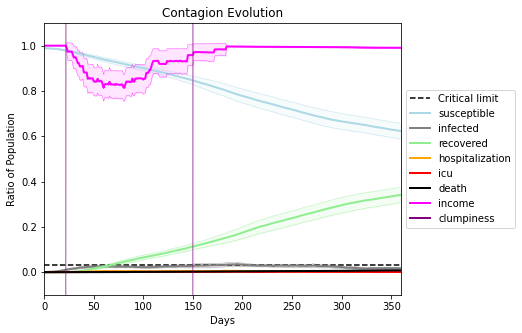

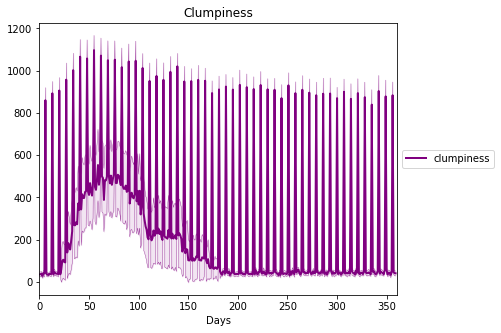

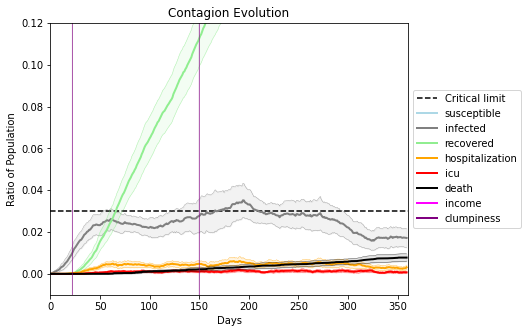

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7758, 2347, 1439, 6388, 6088, 1137, 7198, 7339, 6546, 8458, 2660, 5827, 7888, 3928, 8932, 9906, 2178, 6448, 9925, 4069]
Average similarity between family members is 0.2540562411484869 at temperature -0.5
Average similarity between family and home is 0.9998482533535801 at temperature -1
Average similarity between students and their classroom is 0.1776651140085725 at temperature -0.5
Average classroom occupancy is 1.6777777777777778 and number classrooms is 180
Average similarity between workers is 0.13038854607745465 at temperature -0.5
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.314881568132104 for kids: 0.20507424786860215
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.12893253230521046
avg restaurant similarity 0.10283580336376769
avg restaurant similarity 0.07947216692273058
avg restaurant similarity 0.08188426242472904
avg restaurant similarity 0.07663133356781279
avg restaurant similarity 0.0960933597054213
avg restaurant similarity 0.10899325038901858
avg restaurant similarity 0.016150557211184434
avg restaurant similarity 0.08188370955800853
avg restaurant similarity 0.02097365224596187
avg restaurant similarity 0.13319790920082272
avg restaurant similarity 0.07616933715177282
avg restaurant similarity 0.03727983936308411
avg restaurant similarity 0.07377443067767706
avg restaurant similarity 0.09417436405663676
avg restaurant similarity 0.06160877948139141
avg restaurant similarity 0.05477790555570999
avg restaurant similarity 0.043441656008373256
avg restaurant similarity 0.07341540721429565
avg restaurant similarity 0.05906790284956064
avg restaurant similarity 0.08386877804236659
avg restaurant similarity 0.05160

avg restaurant similarity 0.08308953017398599
avg restaurant similarity 0.09449862919892574
avg restaurant similarity 0.06709776807801905
avg restaurant similarity 0.05114940917655726
avg restaurant similarity 0.09517881984440962
avg restaurant similarity 0.0737516520054286
avg restaurant similarity 0.07977281147648431
avg restaurant similarity 0.056865124952223386
avg restaurant similarity 0.1177801479561133
avg restaurant similarity 0.08400532132868486
avg restaurant similarity 0.08889980011102662
avg restaurant similarity 0.10743698349187515
avg restaurant similarity 0.048171145167882734
avg restaurant similarity 0.09949634452339896
avg restaurant similarity 0.11718533603885917
avg restaurant similarity 0.11298215529074554
avg restaurant similarity 0.02623082881758191
avg restaurant similarity 0.05886566553321883
avg restaurant similarity 0.07247377788827448
avg restaurant similarity 0.013663045101050816
avg restaurant similarity 0.07234154069001279
avg restaurant similarity 0.07368

avg restaurant similarity 0.06849392159804062
avg restaurant similarity 0.0740399753165107
Average similarity between family members is 0.2579837726020082 at temperature -0.5
Average similarity between family and home is 0.9998453642881497 at temperature -1
Average similarity between students and their classroom is 0.14960036034978896 at temperature -0.5
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.15139021160029636 at temperature -0.5
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.32025583182473955 for kids: 0.2208914999947233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.023918177339030563
avg restaurant similarity 0.04694482694386846
avg restaurant similarity 0.07623471325284982
avg restaurant similarity 0.08843559482673062
avg restaurant similarity 0.10344596702915579
avg restaurant similarity 0.09992963307862898
avg restaurant similarity 0.053597002587475705
avg restaurant similarity 0.07821371557667946
avg restaurant similarity 0.017509466597709397
avg restaurant similarity 0.07321334940111285
avg restaurant similarity 0.07304696485082253
avg restaurant similarity 0.06947439920284607
avg restaurant similarity 0.08098788013143073
avg restaurant similarity 0.08788548676729196
avg restaurant similarity 0.06055701772854305
avg restaurant similarity 0.08316913476003016
avg restaurant similarity 0.059177961116728864
avg restaurant similarity 0.06375155269514746
avg restaurant similarity 0.10625330411552837
avg restaurant similarity 0.07815442501460024
avg restaurant similarity 0.07673246716304756
avg restaurant similarity 0.09

avg restaurant similarity 0.06984158943469411
avg restaurant similarity 0.09780769017302264
avg restaurant similarity 0.06967865653584822
avg restaurant similarity 0.05241926742601085
avg restaurant similarity 0.10637165316485978
avg restaurant similarity 0.040179275485514594
avg restaurant similarity 0.08343245884118136
avg restaurant similarity 0.12422672536030391
avg restaurant similarity 0.04854135643993696
avg restaurant similarity 0.10599050466187437
avg restaurant similarity 0.03678775387587159
avg restaurant similarity 0.024978016307978267
avg restaurant similarity 0.13935967543423994
avg restaurant similarity 0.07557309104719809
avg restaurant similarity 0.12439155117486816
avg restaurant similarity 0.13708513100718794
avg restaurant similarity 0.09389182178293284
avg restaurant similarity 0.12322662141073401
avg restaurant similarity 0.05633713766337084
avg restaurant similarity 0.04350332671485763
avg restaurant similarity 0.006322169144394153
avg restaurant similarity 0.063

avg restaurant similarity 0.033502852930852915
avg restaurant similarity 0.00796578773060075
Average similarity between family members is 0.2635348691747046 at temperature -0.5
Average similarity between family and home is 0.999856557802968 at temperature -1
Average similarity between students and their classroom is 0.16147319166492002 at temperature -0.5
Average classroom occupancy is 1.6354166666666667 and number classrooms is 192
Average similarity between workers is 0.15890199728357893 at temperature -0.5
Average office occupancy is 3.1717171717171717 and number offices is 198
Average friend similarity for adults: 0.3184008834033894 for kids: 0.20499142862141725
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.042051842187472155
avg restaurant similarity 0.08431094355012463
avg restaurant similarity 0.07500142016549351
avg restaurant similarity 0.0944553060122651
avg restaurant similarity 0.13337391777960556
avg restaurant similarity 0.1013574018413357
avg restaurant similarity 0.05881667322093395
avg restaurant similarity 0.03330279607772492
avg restaurant similarity 0.04168180038036496
avg restaurant similarity 0.05666389385596524
avg restaurant similarity 0.07974559160329416
avg restaurant similarity 0.08067528109421214
avg restaurant similarity 0.05374529643363626
avg restaurant similarity 0.11609508183924112
avg restaurant similarity 0.05996245233855507
avg restaurant similarity 0.0802937802539211
avg restaurant similarity 0.09244697110861431
avg restaurant similarity 0.05038227577662703
avg restaurant similarity 0.07661887749187217
avg restaurant similarity 0.0765625566359676
avg restaurant similarity 0.09061374270395438
avg restaurant similarity 0.072303727

avg restaurant similarity 0.054003403601764144
avg restaurant similarity 0.11774571182372241
avg restaurant similarity 0.009990676963325057
avg restaurant similarity 0.06399649734443005
avg restaurant similarity 0.10000159311375077
avg restaurant similarity 0.03425321847791699
avg restaurant similarity 0.09075383624242385
avg restaurant similarity 0.08900150865033157
avg restaurant similarity 0.056624640410714154
avg restaurant similarity 0.08516847801955967
avg restaurant similarity 0.06533907128526674
avg restaurant similarity 0.048533609303377495
avg restaurant similarity 0.10695514266534593
avg restaurant similarity 0.10847618874355291
avg restaurant similarity 0.03422407553074312
avg restaurant similarity 0.10858819166238123
avg restaurant similarity 0.08794070980756273
avg restaurant similarity 0.06295211010816296
avg restaurant similarity 0.04425958888319428
avg restaurant similarity 0.07389272777407808
avg restaurant similarity 0.053258771793349466
avg restaurant similarity 0.0

avg restaurant similarity 0.05563197082810073
avg restaurant similarity 0.052704987912287636
avg restaurant similarity 0.09941209347384
avg restaurant similarity 0.052288356468980744
Average similarity between family members is 0.2561492658102726 at temperature -0.5
Average similarity between family and home is 0.9998449453376621 at temperature -1
Average similarity between students and their classroom is 0.1719442347581611 at temperature -0.5
Average classroom occupancy is 1.590643274853801 and number classrooms is 171
Average similarity between workers is 0.15496670025399725 at temperature -0.5
Average office occupancy is 3.37 and number offices is 200
Average friend similarity for adults: 0.34186639458586154 for kids: 0.22283296817840154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.05926694018569288
avg restaurant similarity 0.09602974418228348
avg restaurant similarity 0.08201313681459727
avg restaurant similarity 0.07007690345515374
avg restaurant similarity 0.0674544109489243
avg restaurant similarity 0.09555279542965776
avg restaurant similarity 0.0972180544737205
avg restaurant similarity 0.05174816959661413
avg restaurant similarity 0.07775861007860338
avg restaurant similarity 0.11041929831017018
avg restaurant similarity 0.04742821148245909
avg restaurant similarity 0.08855093601641596
avg restaurant similarity 0.0935883059431343
avg restaurant similarity 0.08590379084891217
avg restaurant similarity 0.058359864167118976
avg restaurant similarity 0.06597649222881324
avg restaurant similarity 0.14644991786032913
avg restaurant similarity 0.09011981019690671
avg restaurant similarity 0.056895495124341076
avg restaurant similarity 0.09870595153201044
avg restaurant similarity 0.09263612081573047
avg restaurant similarity 0.1253335

avg restaurant similarity 0.11575681489978097
avg restaurant similarity 0.11576256344230691
avg restaurant similarity 0.08079554999042997
avg restaurant similarity 0.0757214848102162
avg restaurant similarity 0.0573234552691326
avg restaurant similarity 0.03436072308901242
avg restaurant similarity 0.10554712986135772
avg restaurant similarity 0.09272373760887238
avg restaurant similarity 0.08732743030868398
avg restaurant similarity 0.13047222050665405
avg restaurant similarity 0.0913169256945269
avg restaurant similarity 0.07859507919028498
avg restaurant similarity 0.1144204832059777
avg restaurant similarity 0.0644613798672505
avg restaurant similarity 0.03215689117361422
avg restaurant similarity 0.057648557905438026
avg restaurant similarity 0.059565389310709385
avg restaurant similarity 0.10587540559261396
avg restaurant similarity 0.08773875764288987
avg restaurant similarity 0.08291764736913096
avg restaurant similarity 0.10580963557507217
avg restaurant similarity 0.097631178

avg restaurant similarity 0.12163340964987193
avg restaurant similarity 0.0931247580706983
Average similarity between family members is 0.24848934220089836 at temperature -0.5
Average similarity between family and home is 0.9998590698945156 at temperature -1
Average similarity between students and their classroom is 0.16996364778988146 at temperature -0.5
Average classroom occupancy is 1.6524390243902438 and number classrooms is 164
Average similarity between workers is 0.13641148317152488 at temperature -0.5
Average office occupancy is 3.3694581280788176 and number offices is 203
Average friend similarity for adults: 0.32665635035003965 for kids: 0.20620755938933436
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 9 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity 0.09854295624948554
avg restaurant similarity 0.0964295257246903
avg restaurant similarity 0.07105439046489963
avg restaurant similarity 0.08664796803079816
avg restaurant similarity 0.09473180723045728
avg restaurant similarity 0.08266036501031292
avg restaurant similarity 0.08530223480226296
avg restaurant similarity 0.034925440967080855
avg restaurant similarity 0.07066845596657245
avg restaurant similarity 0.07052677433579509
avg restaurant similarity 0.0712482902064574
avg restaurant similarity 0.07988012790021033
avg restaurant similarity 0.06203114796276072
avg restaurant similarity 0.03250558421965226
avg restaurant similarity 0.06516776148406707
avg restaurant similarity 0.04247333605724079
avg restaurant similarity 0.08205656784082327
avg restaurant similarity 0.05088343524884448
avg restaurant similarity 0.04486473923563884
avg restaurant similarity 0.07350848526644062
avg restaurant similarity 0.09258502255250274
avg restaurant similarity 0.1335717

avg restaurant similarity 0.04664354159072362
avg restaurant similarity 0.03040732300324954
avg restaurant similarity 0.11681681211558459
avg restaurant similarity 0.09945828526068277
avg restaurant similarity 0.04052732964540558
avg restaurant similarity 0.06168215774668091
avg restaurant similarity 0.05075479056433247
avg restaurant similarity 0.09828923249277562
avg restaurant similarity 0.0863966405284786
avg restaurant similarity 0.0748236367938917
avg restaurant similarity 0.033785144860256765
avg restaurant similarity 0.09883949285917704
avg restaurant similarity 0.04133462306449419
avg restaurant similarity 0.07677188673439189
avg restaurant similarity 0.08275234898799193
avg restaurant similarity 0.0970266646429791
avg restaurant similarity 0.03643594556705629
avg restaurant similarity 0.09685734101028967
avg restaurant similarity 0.11104792802074105
avg restaurant similarity 0.07052070542457459
avg restaurant similarity 0.09934995319858253
avg restaurant similarity 0.04426343

avg restaurant similarity 0.08425170934410098
avg restaurant similarity 0.02831094455171905
avg restaurant similarity 0.10639626277856928
avg restaurant similarity 0.05890823117945364
Average similarity between family members is 0.24582200995384987 at temperature -0.5
Average similarity between family and home is 0.9998606204749206 at temperature -1
Average similarity between students and their classroom is 0.1426136751781586 at temperature -0.5
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.1589201260160118 at temperature -0.5
Average office occupancy is 3.225 and number offices is 200
Average friend similarity for adults: 0.3179374973048059 for kids: 0.20526012365278248
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.052269296686351684
avg restaurant similarity 0.08659936554022014
avg restaurant similarity 0.11199817969372548
avg restaurant similarity 0.057337926223556705
avg restaurant similarity 0.08919138788486182
avg restaurant similarity 0.10133413617602537
avg restaurant similarity 0.0581106468835208
avg restaurant similarity 0.05646277923873973
avg restaurant similarity 0.05475922160338267
avg restaurant similarity 0.13459667690009902
avg restaurant similarity 0.09320379994728356
avg restaurant similarity 0.036964459373500395
avg restaurant similarity 0.0703562256181473
avg restaurant similarity 0.0775086024352869
avg restaurant similarity 0.05845426886951078
avg restaurant similarity 0.12953449285532145
avg restaurant similarity 0.07538149673176389
avg restaurant similarity 0.03501204643837121
avg restaurant similarity 0.05332786263650442
avg restaurant similarity 0.09931794875432919
avg restaurant similarity 0.09771142987653653
avg restaurant similarity 0.099202

avg restaurant similarity 0.031336101752084324
avg restaurant similarity 0.07759183840918284
avg restaurant similarity 0.06989060342177575
avg restaurant similarity 0.07010047991848896
avg restaurant similarity 0.09489110885423793
avg restaurant similarity 0.09356656371667257
avg restaurant similarity 0.07308334423230882
avg restaurant similarity 0.0808413433263435
avg restaurant similarity 0.06665129836606906
avg restaurant similarity 0.09041204944572181
avg restaurant similarity 0.07822629961104972
avg restaurant similarity 0.05378212511149354
avg restaurant similarity 0.06412035945295372
avg restaurant similarity 0.10309227047782811
avg restaurant similarity 0.10817546675634197
avg restaurant similarity 0.07136296180042913
avg restaurant similarity 0.054844307239988746
avg restaurant similarity 0.084417996360603
avg restaurant similarity 0.09010550850947846
avg restaurant similarity 0.09778079837047443
avg restaurant similarity 0.13164290815069926
avg restaurant similarity 0.0951943

avg restaurant similarity 0.05143291396884856
avg restaurant similarity 0.06413328307089874
avg restaurant similarity 0.06415645942800968
Average similarity between family members is 0.2688053756700699 at temperature -0.5
Average similarity between family and home is 0.999852823562278 at temperature -1
Average similarity between students and their classroom is 0.1660111346853885 at temperature -0.5
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.16616014395775894 at temperature -0.5
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.3255491478028132 for kids: 0.2078600503919275
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.09678430720377351
avg restaurant similarity 0.11307580757475538
avg restaurant similarity 0.13386049445531056
avg restaurant similarity 0.11611183717091977
avg restaurant similarity 0.10158646015790161
avg restaurant similarity 0.09596003622462818
avg restaurant similarity 0.10827360910836364
avg restaurant similarity 0.13466581762749733
avg restaurant similarity 0.03271305450167029
avg restaurant similarity 0.09468053080683217
avg restaurant similarity 0.06031528439982538
avg restaurant similarity 0.10328135995715826
avg restaurant similarity 0.0869385999181712
avg restaurant similarity 0.06873577031674635
avg restaurant similarity 0.10263996181693041
avg restaurant similarity 0.09748972523465331
avg restaurant similarity 0.09212568380968687
avg restaurant similarity 0.07050286650278376
avg restaurant similarity 0.07999803589561519
avg restaurant similarity 0.0912260129387006
avg restaurant similarity 0.10217737752769551
avg restaurant similarity 0.06673630

avg restaurant similarity 0.03965314896498967
avg restaurant similarity 0.1233993932365882
avg restaurant similarity 0.12044884484023198
avg restaurant similarity 0.0446721978660351
avg restaurant similarity 0.06669076079551317
avg restaurant similarity 0.10405461530913235
avg restaurant similarity 0.10068055624798711
avg restaurant similarity 0.041683831242275746
avg restaurant similarity 0.09518616181469981
avg restaurant similarity 0.09245352947179179
avg restaurant similarity 0.07793440200806723
avg restaurant similarity 0.042547642786689675
avg restaurant similarity 0.11950439611048881
avg restaurant similarity 0.08524816623840904
avg restaurant similarity 0.090235511395514
avg restaurant similarity 0.04010686580251074
avg restaurant similarity 0.08227672221746589
avg restaurant similarity 0.02716236388911019
avg restaurant similarity -0.01228065021531684
avg restaurant similarity 0.07063703083154439
avg restaurant similarity 0.047307424481093874
avg restaurant similarity 0.083504

avg restaurant similarity 0.12669865560248708
avg restaurant similarity 0.04416941191410601
Average similarity between family members is 0.253494277736873 at temperature -0.5
Average similarity between family and home is 0.9998546321249573 at temperature -1
Average similarity between students and their classroom is 0.16644966662163418 at temperature -0.5
Average classroom occupancy is 1.6607142857142858 and number classrooms is 168
Average similarity between workers is 0.12417205548086709 at temperature -0.5
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 0.3257968268578691 for kids: 0.20442634973910284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.00410985046199625
avg restaurant similarity 0.08060788353032268
avg restaurant similarity 0.036303377351030425
avg restaurant similarity 0.09355125049789169
avg restaurant similarity 0.03639182578885353
avg restaurant similarity 0.09330772322883339
avg restaurant similarity 0.055228402015294054
avg restaurant similarity 0.053518795737547226
avg restaurant similarity 0.06572627015488525
avg restaurant similarity 0.06571980689620259
avg restaurant similarity 0.055488958265548845
avg restaurant similarity 0.08994748899442405
avg restaurant similarity 0.07183589299932427
avg restaurant similarity 0.08296336598322016
avg restaurant similarity 0.06195665078887674
avg restaurant similarity 0.06687413420278947
avg restaurant similarity 0.05779920360311855
avg restaurant similarity 0.12483385813781547
avg restaurant similarity 0.09578686561187492
avg restaurant similarity 0.08981029148264774
avg restaurant similarity 0.006057930929680586
avg restaurant similarity 0.1

avg restaurant similarity 0.07173341057019375
avg restaurant similarity 0.088432182107525
avg restaurant similarity 0.05490988301872494
avg restaurant similarity 0.0920386230916777
avg restaurant similarity 0.045307095852701255
avg restaurant similarity 0.01705782769672648
avg restaurant similarity 0.06034612066002374
avg restaurant similarity 0.0999695915056899
avg restaurant similarity 0.14656063256494756
avg restaurant similarity 0.10927796189414433
avg restaurant similarity 0.0750175195972092
avg restaurant similarity 0.08855705546246516
avg restaurant similarity 0.09500878574765027
avg restaurant similarity 0.0906022669971106
avg restaurant similarity 0.0923259973154405
avg restaurant similarity 0.07465457311055343
avg restaurant similarity 0.06364095380333694
avg restaurant similarity 0.05453044769690909
avg restaurant similarity 0.07834111562597665
avg restaurant similarity 0.028932334217551724
avg restaurant similarity 0.05862930655794401
avg restaurant similarity 0.04030734653

avg restaurant similarity 0.11813360601993476
avg restaurant similarity 0.08468154257206977
avg restaurant similarity 0.09131540089284114
Average similarity between family members is 0.23896522882896176 at temperature -0.5
Average similarity between family and home is 0.9998551927880608 at temperature -1
Average similarity between students and their classroom is 0.13195364243661578 at temperature -0.5
Average classroom occupancy is 1.6610169491525424 and number classrooms is 177
Average similarity between workers is 0.17007572288873285 at temperature -0.5
Average office occupancy is 3.226600985221675 and number offices is 203
Average friend similarity for adults: 0.31935550324388406 for kids: 0.2108928380969149
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.0833969576837297
avg restaurant similarity 0.04081776835920503
avg restaurant similarity 0.08740732677680124
avg restaurant similarity 0.041354705018828083
avg restaurant similarity 0.05508324324417431
avg restaurant similarity 0.05613132336587499
avg restaurant similarity 0.03563800531432679
avg restaurant similarity 0.06692438803085918
avg restaurant similarity 0.06055071407137852
avg restaurant similarity 0.013147531885338464
avg restaurant similarity 0.05270980285910277
avg restaurant similarity 0.06805999143957264
avg restaurant similarity 0.09436439355340757
avg restaurant similarity 0.09122377259577784
avg restaurant similarity 0.06586545452218431
avg restaurant similarity 0.049624618230629865
avg restaurant similarity 0.058286227689316565
avg restaurant similarity 0.0743897628677465
avg restaurant similarity 0.01395437029812125
avg restaurant similarity 0.056860503310572054
avg restaurant similarity 0.0043478749217863415
avg restaurant similarity 0.1

avg restaurant similarity 0.018101029734869167
avg restaurant similarity 0.017084160033650663
avg restaurant similarity 0.06710588483787999
avg restaurant similarity 0.06665168898055457
avg restaurant similarity 0.08211084469727074
avg restaurant similarity 0.062430851692072374
avg restaurant similarity 0.10538246851447876
avg restaurant similarity 0.036455842882623726
avg restaurant similarity 0.0906666815170925
avg restaurant similarity 0.07938102157205766
avg restaurant similarity 0.05338835052630917
avg restaurant similarity 0.07455260043171133
avg restaurant similarity 0.03302833513536256
avg restaurant similarity 0.07907657606963502
avg restaurant similarity 0.031147512836540537
avg restaurant similarity 0.05675338769573868
avg restaurant similarity 0.0637913164901383
avg restaurant similarity 0.09049320333552464
avg restaurant similarity 0.05338219342109881
avg restaurant similarity 0.10439933580451004
avg restaurant similarity 0.028541594224595332
avg restaurant similarity 0.04

avg restaurant similarity 0.058570713580994006
avg restaurant similarity 0.022629647247774876
avg restaurant similarity -0.007550528962182174
avg restaurant similarity 0.057431108641571894
Average similarity between family members is 0.24786902903538105 at temperature -0.5
Average similarity between family and home is 0.9998613594455462 at temperature -1
Average similarity between students and their classroom is 0.1639875519913548 at temperature -0.5
Average classroom occupancy is 1.5397727272727273 and number classrooms is 176
Average similarity between workers is 0.14300349181679206 at temperature -0.5
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.3203522139534836 for kids: 0.19890221043103654
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.04597039123905336
avg restaurant similarity 0.050243475639392035
avg restaurant similarity 0.014963861893708163
avg restaurant similarity 0.04349115273553281
avg restaurant similarity 0.06394503085025464
avg restaurant similarity 0.0909959495357099
avg restaurant similarity 0.09304214893758139
avg restaurant similarity 0.05444570991895402
avg restaurant similarity 0.11003619975858439
avg restaurant similarity 0.04437603182956539
avg restaurant similarity 0.058395361848152375
avg restaurant similarity 0.07858465825778216
avg restaurant similarity 0.051447691015349614
avg restaurant similarity 0.04150296438985067
avg restaurant similarity 0.08568411725463114
avg restaurant similarity 0.12059907654827529
avg restaurant similarity 0.08847389340805652
avg restaurant similarity 0.012838197829948524
avg restaurant similarity 0.07717089952635678
avg restaurant similarity 0.10402015072240461
avg restaurant similarity 0.05071813083131423
avg restaurant similarity 0.00

avg restaurant similarity 0.04085320910956066
avg restaurant similarity 0.07407705246361984
avg restaurant similarity 0.041039873559669406
avg restaurant similarity 0.07004607563947819
avg restaurant similarity 0.08414284355259205
avg restaurant similarity 0.039402514671454704
avg restaurant similarity 0.017867955991659874
avg restaurant similarity 0.05180531204012347
avg restaurant similarity 0.04676950373423545
avg restaurant similarity 0.08468502558946103
avg restaurant similarity 0.03458695730341861
avg restaurant similarity 0.12673992648598612
avg restaurant similarity 0.0407537560924305
avg restaurant similarity 0.07594352228534032
avg restaurant similarity 0.06990236504691395
avg restaurant similarity 0.05063842444738107
avg restaurant similarity 0.06496371313540251
avg restaurant similarity 0.08217160154411998
avg restaurant similarity 0.038414997606884646
avg restaurant similarity 0.08621797563457413
avg restaurant similarity 0.07007323261948818
avg restaurant similarity 0.043

avg restaurant similarity 0.07360133823295788
avg restaurant similarity 0.1044254654774746
avg restaurant similarity 0.059742198156531284
avg restaurant similarity 0.09086333678912964
Average similarity between family members is 0.25986567859396703 at temperature -0.5
Average similarity between family and home is 0.9998610085534486 at temperature -1
Average similarity between students and their classroom is 0.14411316435402216 at temperature -0.5
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.15097719043370245 at temperature -0.5
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.32498914073872565 for kids: 0.20770591874319094
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.11333275527688744
avg restaurant similarity 0.11084973312687735
avg restaurant similarity 0.07108008790884207
avg restaurant similarity 0.15149576921867927
avg restaurant similarity 0.09397378880258173
avg restaurant similarity 0.06993133969353722
avg restaurant similarity 0.012496367872704589
avg restaurant similarity 0.04032975116196071
avg restaurant similarity 0.0680254146071808
avg restaurant similarity 0.06139794721132365
avg restaurant similarity 0.06653775968280624
avg restaurant similarity 0.08270641386761658
avg restaurant similarity 0.004900301598226133
avg restaurant similarity 0.07354969635838153
avg restaurant similarity 0.126275105425373
avg restaurant similarity 0.05524944096542025
avg restaurant similarity 0.09354776187158244
avg restaurant similarity 0.06350975382688001
avg restaurant similarity 0.046288546920368455
avg restaurant similarity 0.03792656162703238
avg restaurant similarity 0.027734279036680798
avg restaurant similarity 0.07579

avg restaurant similarity 0.10297533465564916
avg restaurant similarity 0.06374371545147421
avg restaurant similarity 0.04441266255138061
avg restaurant similarity 0.07400633994288465
avg restaurant similarity 0.01300091838375823
avg restaurant similarity 0.04346629097011157
avg restaurant similarity 0.09701002492548189
avg restaurant similarity 0.04518591360339533
avg restaurant similarity 0.028684098981233058
avg restaurant similarity 0.05748724988962671
avg restaurant similarity 0.054154610129467734
avg restaurant similarity 0.10799271263371645
avg restaurant similarity 0.11771223261702529
avg restaurant similarity 0.07393766158620786
avg restaurant similarity 0.004402800312243048
avg restaurant similarity 0.02342009200128663
avg restaurant similarity 0.04853852385427447
avg restaurant similarity 0.0326804059010282
avg restaurant similarity 0.061605995698185735
avg restaurant similarity 0.09398801765202673
avg restaurant similarity 0.05424736715077761
avg restaurant similarity 0.132

avg restaurant similarity 0.09818644499109856
avg restaurant similarity 0.06730407784207001
Average similarity between family members is 0.27304214791337256 at temperature -0.5
Average similarity between family and home is 0.9998617148890279 at temperature -1
Average similarity between students and their classroom is 0.16389935792043553 at temperature -0.5
Average classroom occupancy is 1.615819209039548 and number classrooms is 177
Average similarity between workers is 0.15511962732179815 at temperature -0.5
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.3213135616540929 for kids: 0.21897913682661546
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.04915521127704637
avg restaurant similarity 0.09768554902124059
avg restaurant similarity 0.0712464102498275
avg restaurant similarity 0.03455809511152065
avg restaurant similarity 0.05209063810227857
avg restaurant similarity 0.05597751552931515
avg restaurant similarity 0.09526119291896812
avg restaurant similarity 0.05267487881294675
avg restaurant similarity 0.10419451765405034
avg restaurant similarity 0.07926858176491544
avg restaurant similarity 0.10952368324358032
avg restaurant similarity 0.09530717202754059
avg restaurant similarity 0.0922949582773766
avg restaurant similarity 0.09039091201155743
avg restaurant similarity 0.03562738485352777
avg restaurant similarity 0.09766150803603033
avg restaurant similarity 0.019130795620321734
avg restaurant similarity 0.0353715435689039
avg restaurant similarity 0.07997216785677466
avg restaurant similarity 0.03480574364663619
avg restaurant similarity 0.027152108787193464
avg restaurant similarity 0.1140314

avg restaurant similarity 0.08111620226826402
avg restaurant similarity 0.08628039913572343
avg restaurant similarity 0.0636830591988461
avg restaurant similarity 0.05747122809586268
avg restaurant similarity 0.06906632682471178
avg restaurant similarity 0.03633336128674502
avg restaurant similarity 0.04305021197614949
avg restaurant similarity -0.002580671308701739
avg restaurant similarity 0.07953582603182399
avg restaurant similarity 0.09512490015549104
avg restaurant similarity 0.11123652323291931
avg restaurant similarity 0.08314185314530319
avg restaurant similarity 0.0540350820574726
avg restaurant similarity 0.062147439519849385
avg restaurant similarity 0.02539423598164183
avg restaurant similarity 0.08023814428849838
avg restaurant similarity 0.11890923649108917
avg restaurant similarity 0.024462596396138295
avg restaurant similarity 0.0640137479579915
avg restaurant similarity 0.0656286489490307
avg restaurant similarity 0.0788852003224018
avg restaurant similarity 0.0225618

avg restaurant similarity 0.09295594182172871
avg restaurant similarity 0.07423822491415732
avg restaurant similarity 0.043021661998583385
Average similarity between family members is 0.2580252941764044 at temperature -0.5
Average similarity between family and home is 0.9998607499819765 at temperature -1
Average similarity between students and their classroom is 0.1820744671093682 at temperature -0.5
Average classroom occupancy is 1.650273224043716 and number classrooms is 183
Average similarity between workers is 0.16209009982671327 at temperature -0.5
Average office occupancy is 3.1435643564356437 and number offices is 202
Average friend similarity for adults: 0.3233742719307732 for kids: 0.22134886205763615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.09244607815035018
avg restaurant similarity 0.07205803043238866
avg restaurant similarity 0.0573660029818632
avg restaurant similarity 0.06950411486009556
avg restaurant similarity 0.06102263152892333
avg restaurant similarity 0.10173357171974995
avg restaurant similarity 0.03368898692804587
avg restaurant similarity 0.07855188076036268
avg restaurant similarity 0.0903530076493368
avg restaurant similarity 0.06923953116904336
avg restaurant similarity 0.09170513289489024
avg restaurant similarity 0.09238159296107235
avg restaurant similarity 0.05285416279682001
avg restaurant similarity 0.10073530386176144
avg restaurant similarity 0.1096822860576446
avg restaurant similarity 0.07042633418515153
avg restaurant similarity 0.13082371834489062
avg restaurant similarity 0.05362867741151474
avg restaurant similarity 0.10119504789348009
avg restaurant similarity 0.1062179119261761
avg restaurant similarity 0.11352666661149222
avg restaurant similarity 0.0630933373

avg restaurant similarity 0.10541821697748364
avg restaurant similarity 0.0911243025672997
avg restaurant similarity 0.09023147722356273
avg restaurant similarity 0.008479767504295556
avg restaurant similarity 0.06069735004076198
avg restaurant similarity 0.07557592252452798
avg restaurant similarity 0.06262172699102132
avg restaurant similarity 0.035432032634562884
avg restaurant similarity 0.09742228453608813
avg restaurant similarity 0.03528590414277532
avg restaurant similarity 0.047976627002531705
avg restaurant similarity 0.12526720193599467
avg restaurant similarity 0.05889300799508001
avg restaurant similarity 0.10061972137555081
avg restaurant similarity 0.10115494414809681
avg restaurant similarity 0.022170314652753098
avg restaurant similarity 0.06998173469688936
avg restaurant similarity 0.1533052531198739
avg restaurant similarity 0.0619179817805298
avg restaurant similarity 0.10457597440760255
avg restaurant similarity 0.11224188272558705
avg restaurant similarity 0.09582

avg restaurant similarity 0.04410870714376179
avg restaurant similarity 0.06479226146021698
Average similarity between family members is 0.24884000745309381 at temperature -0.5
Average similarity between family and home is 0.99985828481129 at temperature -1
Average similarity between students and their classroom is 0.1479034114841574 at temperature -0.5
Average classroom occupancy is 1.6153846153846154 and number classrooms is 182
Average similarity between workers is 0.13291587663071794 at temperature -0.5
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.32228388495146043 for kids: 0.19905194991712838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.05735001707342547
avg restaurant similarity 0.0705244520840727
avg restaurant similarity 0.05620865073782866
avg restaurant similarity 0.02234179502455989
avg restaurant similarity 0.07633658509535232
avg restaurant similarity 0.12577032390036533
avg restaurant similarity 0.07053384133206436
avg restaurant similarity 0.059410185496640185
avg restaurant similarity 0.06942139093546741
avg restaurant similarity 0.10595965345567153
avg restaurant similarity 0.07477581407575998
avg restaurant similarity 0.07213028567430067
avg restaurant similarity 0.09978420343151001
avg restaurant similarity -0.013232612762773504
avg restaurant similarity 0.06412889794508225
avg restaurant similarity 0.10645455474733104
avg restaurant similarity 0.06840458529967006
avg restaurant similarity 0.09885258380015745
avg restaurant similarity 0.08820759485275759
avg restaurant similarity 0.0616698949825026
avg restaurant similarity 0.09941032846909358
avg restaurant similarity 0.12231

avg restaurant similarity 0.03213626029542151
avg restaurant similarity 0.10203629779428657
avg restaurant similarity 0.03385348218951303
avg restaurant similarity 0.10161605144335123
avg restaurant similarity 0.10253444999301467
avg restaurant similarity 0.06257364206002275
avg restaurant similarity 0.0032019099650380297
avg restaurant similarity 0.09881056768529503
avg restaurant similarity 0.05474356978112587
avg restaurant similarity 0.07490377905945697
avg restaurant similarity 0.0756506868892758
avg restaurant similarity 0.0749671079406187
avg restaurant similarity 0.057024654402095025
avg restaurant similarity 0.08336084779728165
avg restaurant similarity 0.043870989625161234
avg restaurant similarity 0.11921532903558503
avg restaurant similarity 0.09624759712706496
avg restaurant similarity 0.045849702440228124
avg restaurant similarity 0.08782055926226189
avg restaurant similarity 0.04236240972301358
avg restaurant similarity 0.10499998015245847
avg restaurant similarity 0.064

avg restaurant similarity 0.0965530589207451
avg restaurant similarity 0.10980234167250941
avg restaurant similarity 0.07985866769601374
Average similarity between family members is 0.23605867233536443 at temperature -0.5
Average similarity between family and home is 0.9998509768238509 at temperature -1
Average similarity between students and their classroom is 0.13410678565461276 at temperature -0.5
Average classroom occupancy is 1.516304347826087 and number classrooms is 184
Average similarity between workers is 0.1747887799799591 at temperature -0.5
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.32884419980784513 for kids: 0.2080266865955645
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.027614183540374735
avg restaurant similarity 0.08617905359429609
avg restaurant similarity 0.029926039021117595
avg restaurant similarity 0.04403794575225251
avg restaurant similarity 0.08107708439186044
avg restaurant similarity 0.061002506987294404
avg restaurant similarity 0.08651666500367515
avg restaurant similarity 0.10010459345567571
avg restaurant similarity 0.06918754999746148
avg restaurant similarity 0.06856552294322991
avg restaurant similarity 0.049270561820713286
avg restaurant similarity 0.1146436278976943
avg restaurant similarity 0.03289591942000872
avg restaurant similarity 0.057551635482673225
avg restaurant similarity 0.07552583139377908
avg restaurant similarity 0.0648532033732067
avg restaurant similarity 0.1050544157642789
avg restaurant similarity 0.04834299114502549
avg restaurant similarity 0.04808296530530516
avg restaurant similarity 0.07627762108107979
avg restaurant similarity 0.09619057290121427
avg restaurant similarity 0.0396

avg restaurant similarity 0.07747409511057178
avg restaurant similarity 0.04198019159562687
avg restaurant similarity 0.036511275571500586
avg restaurant similarity 0.06307295359801113
avg restaurant similarity 0.05697064315227472
avg restaurant similarity 0.06613190748891723
avg restaurant similarity 0.023160827746024466
avg restaurant similarity 0.059511262664824635
avg restaurant similarity 0.01635838424993431
avg restaurant similarity 0.058519329248800184
avg restaurant similarity 0.02828262972606255
avg restaurant similarity 0.08806617349382574
avg restaurant similarity 0.09139212229647324
avg restaurant similarity 0.04960133420656012
avg restaurant similarity 0.050592726732661054
avg restaurant similarity 0.025977210438551276
avg restaurant similarity 0.04583548888853054
avg restaurant similarity 0.028532989576365776
avg restaurant similarity 0.04792602903522536
avg restaurant similarity 0.09793878324761005
avg restaurant similarity 0.05925899515555497
avg restaurant similarity 0

avg restaurant similarity 0.07704443533935078
avg restaurant similarity 0.04742949095199902
avg restaurant similarity 0.05967384948283466
avg restaurant similarity 0.0577005155839898
avg restaurant similarity 0.03729068012035906
avg restaurant similarity 0.05854166104903667
Average similarity between family members is 0.2566319260866785 at temperature -0.5
Average similarity between family and home is 0.9998646593150179 at temperature -1
Average similarity between students and their classroom is 0.15419906492757027 at temperature -0.5
Average classroom occupancy is 1.6857142857142857 and number classrooms is 175
Average similarity between workers is 0.15488074415700853 at temperature -0.5
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.33120701460000856 for kids: 0.20884155485895484
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.13688905584517463
avg restaurant similarity 0.026828955551921913
avg restaurant similarity 0.04894676562129643
avg restaurant similarity 0.08621878359404732
avg restaurant similarity 0.04726636805087135
avg restaurant similarity 0.06538051437501813
avg restaurant similarity 0.09152303164720842
avg restaurant similarity 0.08685138936817269
avg restaurant similarity 0.05897713702580108
avg restaurant similarity 0.04569826830965851
avg restaurant similarity 0.11528115871010873
avg restaurant similarity 0.06090084833359225
avg restaurant similarity 0.10964962444125789
avg restaurant similarity 0.07412992515742158
avg restaurant similarity 0.07610712507893494
avg restaurant similarity 0.06437095661293467
avg restaurant similarity 0.09838337714992003
avg restaurant similarity 0.01586999458658793
avg restaurant similarity 0.0628252819718166
avg restaurant similarity 0.09484772979813016
avg restaurant similarity 0.081733779559705
avg restaurant similarity 0.02563567

avg restaurant similarity 0.028222718812790464
avg restaurant similarity 0.09725931379187726
avg restaurant similarity 0.08244039816690836
avg restaurant similarity 0.06351899312464768
avg restaurant similarity 0.06282080844746275
avg restaurant similarity 0.07898873975671954
avg restaurant similarity 0.06766986473668705
avg restaurant similarity 0.10529649335713981
avg restaurant similarity 0.11138254893270631
avg restaurant similarity 0.09646532856708065
avg restaurant similarity 0.05281239607847421
avg restaurant similarity 0.152011742828965
avg restaurant similarity 0.03886380426493061
avg restaurant similarity 0.0790866781748698
avg restaurant similarity 0.03218412310816135
avg restaurant similarity 0.06373528293491296
avg restaurant similarity 0.06942469917700905
avg restaurant similarity 0.06779362455898726
avg restaurant similarity 0.05809417831376513
avg restaurant similarity 0.11889266125470828
avg restaurant similarity 0.1093470754758641
avg restaurant similarity 0.069403825

avg restaurant similarity 0.06494270958634142
avg restaurant similarity 0.024326594246420107
Average similarity between family members is 0.2360055874916 at temperature -0.5
Average similarity between family and home is 0.9998436384111186 at temperature -1
Average similarity between students and their classroom is 0.13362864465985066 at temperature -0.5
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.1553263027480064 at temperature -0.5
Average office occupancy is 3.4791666666666665 and number offices is 192
Average friend similarity for adults: 0.3221924453842226 for kids: 0.20846073888390046
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.005767682098750009
avg restaurant similarity 0.06589237346151217
avg restaurant similarity 0.014906389944793463
avg restaurant similarity 0.10387860715261472
avg restaurant similarity 0.07487483478587328
avg restaurant similarity 0.07051028858272901
avg restaurant similarity 0.024866129727128306
avg restaurant similarity 0.028545721272112957
avg restaurant similarity 0.0668645177939401
avg restaurant similarity 0.14238482256928017
avg restaurant similarity 0.09011790070970899
avg restaurant similarity 0.06569124257473712
avg restaurant similarity 0.03078024670250208
avg restaurant similarity 0.06283479953237503
avg restaurant similarity 0.061374482378011665
avg restaurant similarity 0.08343923257459888
avg restaurant similarity 0.03697436468391497
avg restaurant similarity 0.08299814374313721
avg restaurant similarity 0.023320530867459797
avg restaurant similarity 0.1242478798608163
avg restaurant similarity 0.07653413159142942
avg restaurant similarity 0.04

avg restaurant similarity 0.13102364843408734
avg restaurant similarity 0.04840574229276488
avg restaurant similarity 0.11215771709474677
avg restaurant similarity 0.0578876752601757
avg restaurant similarity 0.05040839098964451
avg restaurant similarity 0.07502816477734199
avg restaurant similarity 0.0957645298236635
avg restaurant similarity 0.009762130268839247
avg restaurant similarity 0.06971975777323805
avg restaurant similarity 0.060658200926031906
avg restaurant similarity 0.09192858945181859
avg restaurant similarity 0.11979087737569757
avg restaurant similarity 0.04220787189293877
avg restaurant similarity 0.10475283990239642
avg restaurant similarity 0.009640342637145657
avg restaurant similarity 0.059733575967894144
avg restaurant similarity 0.09018368628124136
avg restaurant similarity 0.06897320887956053
avg restaurant similarity 0.13215799943276021
avg restaurant similarity 0.12750854316074992
avg restaurant similarity 0.08485032450208072
avg restaurant similarity 0.0825

avg restaurant similarity 0.08567433237179346
avg restaurant similarity 0.0949140875466534
avg restaurant similarity 0.0731495408326639
avg restaurant similarity 0.051492727016285586
Average similarity between family members is 0.25498514424673013 at temperature -0.5
Average similarity between family and home is 0.9998524377876898 at temperature -1
Average similarity between students and their classroom is 0.1572902804464001 at temperature -0.5
Average classroom occupancy is 1.5251396648044693 and number classrooms is 179
Average similarity between workers is 0.15541823231995155 at temperature -0.5
Average office occupancy is 3.353233830845771 and number offices is 201
Average friend similarity for adults: 0.33220665617316114 for kids: 0.2119804014799097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.07992494431774964
avg restaurant similarity 0.08060753219783533
avg restaurant similarity 0.10379073851122853
avg restaurant similarity 0.10514433780423539
avg restaurant similarity 0.030334975382371388
avg restaurant similarity 0.033355478550785175
avg restaurant similarity 0.11464798383671458
avg restaurant similarity 0.11527978343980433
avg restaurant similarity 0.07445551351310385
avg restaurant similarity 0.08054076665610235
avg restaurant similarity 0.08539388639193726
avg restaurant similarity 0.11186304809000681
avg restaurant similarity 0.03379347397998778
avg restaurant similarity 0.08207936312897553
avg restaurant similarity 0.05317166290419546
avg restaurant similarity 0.04741352626218425
avg restaurant similarity 0.055114105399971934
avg restaurant similarity 0.05736001437582529
avg restaurant similarity 0.0433387702211667
avg restaurant similarity 0.052331728419567465
avg restaurant similarity 0.11536896519008027
avg restaurant similarity 0.105

avg restaurant similarity 0.0258119603095644
avg restaurant similarity 0.07093860144463543
avg restaurant similarity 0.05791700229428727
avg restaurant similarity 0.0835262091124694
avg restaurant similarity 0.04952727404469045
avg restaurant similarity 0.12410272978311371
avg restaurant similarity 0.07903895553714925
avg restaurant similarity 0.07330773563003924
avg restaurant similarity 0.13303865913621313
avg restaurant similarity 0.09201770985900169
avg restaurant similarity 0.07312279745018567
avg restaurant similarity 0.05117836836062286
avg restaurant similarity 0.037120761033823634
avg restaurant similarity 0.08464968529272787
avg restaurant similarity 0.08863308595559088
avg restaurant similarity 0.13921277138382368
avg restaurant similarity 0.02121839252121272
avg restaurant similarity 0.11479320815113203
avg restaurant similarity 0.06564755940893087
avg restaurant similarity 0.09725701216265464
avg restaurant similarity 0.0905336672585708
avg restaurant similarity 0.12901430

avg restaurant similarity 0.09182660294025116
avg restaurant similarity 0.07313062111830079
Average similarity between family members is 0.2410561263130687 at temperature -0.5
Average similarity between family and home is 0.9998550430487253 at temperature -1
Average similarity between students and their classroom is 0.1561776384450978 at temperature -0.5
Average classroom occupancy is 1.670520231213873 and number classrooms is 173
Average similarity between workers is 0.15446576872588944 at temperature -0.5
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.3227156478642945 for kids: 0.2091968804501413
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.05713439698316366
avg restaurant similarity 0.0756311669974044
avg restaurant similarity 0.026585473817742834
avg restaurant similarity 0.04328957413834531
avg restaurant similarity 0.03545566860683038
avg restaurant similarity 0.07920243329200753
avg restaurant similarity 0.00949386926449721
avg restaurant similarity 0.025617558173482356
avg restaurant similarity 0.017330049673674564
avg restaurant similarity 0.05161074262902598
avg restaurant similarity 0.04822587922691193
avg restaurant similarity 0.009515300100625238
avg restaurant similarity 0.06514684504851036
avg restaurant similarity 0.008527899753872971
avg restaurant similarity 0.06887938954349376
avg restaurant similarity 0.06783533035128725
avg restaurant similarity 0.004883999364397554
avg restaurant similarity -0.009103672197547224
avg restaurant similarity 0.07002789402415877
avg restaurant similarity 0.05390239833449525
avg restaurant similarity 0.09191292496009425
avg restaurant similarity 0

avg restaurant similarity 0.01405008406992998
avg restaurant similarity 0.03101568114844069
avg restaurant similarity 0.022962089481787237
avg restaurant similarity 0.12334081568143018
avg restaurant similarity 0.03092868820567486
avg restaurant similarity 0.07614682074743742
avg restaurant similarity 0.06830196391890885
avg restaurant similarity 0.08404588471397696
avg restaurant similarity 0.0004508159064611173
avg restaurant similarity 0.0364452771109777
avg restaurant similarity 0.04429461717007021
avg restaurant similarity 0.077582453940585
avg restaurant similarity 0.0610150062274399
avg restaurant similarity 0.023278943017077752
avg restaurant similarity 0.07156611350151194
avg restaurant similarity 0.04328817176907822
avg restaurant similarity 0.09915179568108562
avg restaurant similarity 0.07100259056406884
avg restaurant similarity -0.027806000059418676
avg restaurant similarity 0.03857905660742495
avg restaurant similarity 0.032442656666372145
avg restaurant similarity 0.095

avg restaurant similarity 0.05719097047205742
avg restaurant similarity 0.08322061743721812
avg restaurant similarity 0.08372898193293091
avg restaurant similarity 0.0491231067472641
Average similarity between family members is 0.26551704533589077 at temperature -0.5
Average similarity between family and home is 0.9998649038865528 at temperature -1
Average similarity between students and their classroom is 0.15370171317485298 at temperature -0.5
Average classroom occupancy is 1.5722222222222222 and number classrooms is 180
Average similarity between workers is 0.15822316322591373 at temperature -0.5
Average office occupancy is 3.1699029126213594 and number offices is 206
Average friend similarity for adults: 0.33435776821258667 for kids: 0.22659864922201606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.10505737002927697
avg restaurant similarity 0.025997197704276276
avg restaurant similarity 0.08769155924120883
avg restaurant similarity 0.07558505277456441
avg restaurant similarity 0.06788979559398187
avg restaurant similarity 0.08303042553495495
avg restaurant similarity 0.1276861788172892
avg restaurant similarity 0.023112120194369312
avg restaurant similarity 0.07312656965012755
avg restaurant similarity 0.0692880573324556
avg restaurant similarity 0.13608792777553405
avg restaurant similarity 0.09053782444271674
avg restaurant similarity 0.04701833037839898
avg restaurant similarity 0.11780293289614086
avg restaurant similarity 0.10181928848772374
avg restaurant similarity 0.11998396414165671
avg restaurant similarity 0.07228294449226591
avg restaurant similarity 0.0949238645248464
avg restaurant similarity 0.03741479355337169
avg restaurant similarity 0.07313612039224887
avg restaurant similarity 0.0884216103361053
avg restaurant similarity 0.08960298

avg restaurant similarity 0.14744271392846933
avg restaurant similarity 0.04231107726400932
avg restaurant similarity 0.08666160175234354
avg restaurant similarity 0.023633053449345368
avg restaurant similarity 0.04746198952664283
avg restaurant similarity 0.09320439428593007
avg restaurant similarity 0.11050904497738474
avg restaurant similarity 0.03456440660040898
avg restaurant similarity 0.0729185255422082
avg restaurant similarity 0.05407646344528395
avg restaurant similarity 0.052198098873763366
avg restaurant similarity 0.08297663200301218
avg restaurant similarity 0.02730402262987794
avg restaurant similarity 0.1280632293017691
avg restaurant similarity 0.07922211149683706
avg restaurant similarity 0.1353818069971532
avg restaurant similarity 0.15041042306781335
avg restaurant similarity 0.10361810428246657
avg restaurant similarity 0.06983246642913472
avg restaurant similarity 0.10469800936706487
avg restaurant similarity 0.06241172287715462
avg restaurant similarity 0.0651907

avg restaurant similarity 0.04336629522903162
avg restaurant similarity 0.1308674854538396
using average of time series:
stats on susceptible:
data: [0.780761111111111, 0.8010055555555554, 0.8209359059658461, 0.8398166666666665, 0.803328353253652, 0.8051401351501053, 0.6899160592003535, 0.7453500000000001, 0.8469951257339093, 0.8330222222222223, 0.8170972222222221, 0.8597722222222223, 0.7886638888888888, 0.7898361111111112, 0.8054638888888889, 0.8620222222222221, 0.8608891108891108, 0.8891416666666667, 0.8281333333333333, 0.8889583333333333]
min:
0.6899160592003535
max:
0.8891416666666667
std:
0.04627256371748999
mean:
0.8178124567318712
median:
0.8190165640940341
95% confidence interval for the mean:
(0.7955936372147626,0.8400312762489798)
using average of time series:
stats on infected:
data: [0.027280555555555554, 0.02572777777777778, 0.023638833444222667, 0.020430555555555556, 0.02330953961930057, 0.02340201617370112, 0.03490998453722112, 0.03271666666666667, 0.017597208374875373, 

(<function dict.items>, <function dict.items>, <function dict.items>)

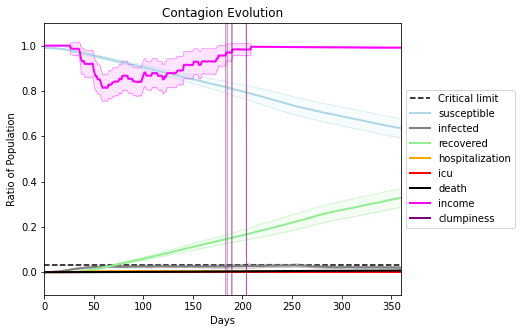

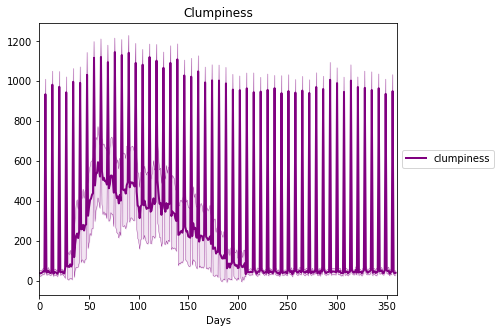

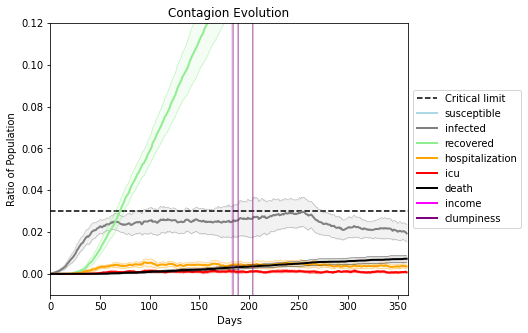

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1893, 8109, 6126, 9013, 1568, 435, 5428, 8935, 8987, 6903, 1428, 2188, 559, 7167, 4016, 5162, 4550, 928, 4099, 2866]
Average similarity between family members is 0.23235445101668353 at temperature -0.4
Average similarity between family and home is 0.9998532699547019 at temperature -1
Average similarity between students and their classroom is 0.17065719085798964 at temperature -0.4
Average classroom occupancy is 1.6375 and number classrooms is 160
Average similarity between workers is 0.16492516836369608 at temperature -0.4
Average office occupancy is 3.3076923076923075 and number offices is 208
Average friend similarity for adults: 0.28761475698188077 for kids: 0.23261904112121742
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.014407654373267922
avg restaurant similarity 0.02829721183707621
avg restaurant similarity 0.023201039199754275
avg restaurant similarity 0.04654340337826246
avg restaurant similarity 0.016417193926416156
avg restaurant similarity 0.07630925289706274
avg restaurant similarity 0.03436908980951692
avg restaurant similarity 0.028479065722044863
avg restaurant similarity 0.02516898453158637
avg restaurant similarity 0.11049740154274586
avg restaurant similarity 0.07828499788457793
avg restaurant similarity 0.07218184072219551
avg restaurant similarity 0.06354667259465609
avg restaurant similarity 0.04366355480539141
avg restaurant similarity 0.04864648007725159
avg restaurant similarity 0.04606499655876509
avg restaurant similarity 0.07744965370432749
avg restaurant similarity 0.08932181820662678
avg restaurant similarity 0.06873621180170876
avg restaurant similarity 0.04099189435306924
avg restaurant similarity 0.03110333781314385
avg restaurant similarity 0.08

avg restaurant similarity 0.05549066003258748
avg restaurant similarity 0.05749567428117141
avg restaurant similarity 0.0447602316510787
avg restaurant similarity 0.05211685257117913
avg restaurant similarity 0.012064526794221625
avg restaurant similarity 0.09807915381760465
avg restaurant similarity 0.02934324082863391
avg restaurant similarity 0.0712277266862781
avg restaurant similarity 0.037158985350565006
avg restaurant similarity -0.004313718743923761
avg restaurant similarity 0.002901849402734813
avg restaurant similarity 0.09761062513865079
avg restaurant similarity 0.06795278328171862
avg restaurant similarity 0.02677377138783022
avg restaurant similarity 0.06390203164450155
avg restaurant similarity 0.11001661943323057
avg restaurant similarity 0.0501148816320278
avg restaurant similarity 0.04655397578913091
avg restaurant similarity 0.08050220460576804
avg restaurant similarity 0.06151160865869187
avg restaurant similarity 0.058925455267852346
avg restaurant similarity 0.005

avg restaurant similarity 0.056894964915225006
avg restaurant similarity 0.06207917739933601
avg restaurant similarity 0.03248947891571437
avg restaurant similarity 0.06621981731190994
avg restaurant similarity 0.02608637477625869
avg restaurant similarity -0.0020754127856292015
Average similarity between family members is 0.21639627229136113 at temperature -0.4
Average similarity between family and home is 0.999859872395792 at temperature -1
Average similarity between students and their classroom is 0.1333093413612287 at temperature -0.4
Average classroom occupancy is 1.7411764705882353 and number classrooms is 170
Average similarity between workers is 0.15457051348611725 at temperature -0.4
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.2890906726605982 for kids: 0.21797028699074883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units w

avg restaurant similarity 0.10429618988600067
avg restaurant similarity 0.1015171898757506
avg restaurant similarity 0.09911135260493308
avg restaurant similarity 0.0224937457302633
avg restaurant similarity 0.032620501460393456
avg restaurant similarity 0.05056561563110082
avg restaurant similarity 0.060465492552348406
avg restaurant similarity 0.058406161919635
avg restaurant similarity 0.08736479082263592
avg restaurant similarity 0.08974906126646642
avg restaurant similarity 0.13039185955543334
avg restaurant similarity 0.11380721321768418
avg restaurant similarity 0.05186276687063709
avg restaurant similarity 0.11238423278654681
avg restaurant similarity 0.031039652590794914
avg restaurant similarity 0.11065505347872259
avg restaurant similarity 0.11160008764854325
avg restaurant similarity 0.084835615207017
avg restaurant similarity 0.0712371036754699
avg restaurant similarity 0.08831473603778392
avg restaurant similarity 0.10807765247984616
avg restaurant similarity 0.0569210352

avg restaurant similarity 0.1057442182217703
avg restaurant similarity 0.056991229433840496
avg restaurant similarity 0.07433569604395661
avg restaurant similarity 0.04087692173986018
avg restaurant similarity 0.031405567395357825
avg restaurant similarity 0.08380806198583911
avg restaurant similarity 0.14083212440009676
avg restaurant similarity 0.07727901293331471
avg restaurant similarity 0.12432094062078705
avg restaurant similarity 0.0613163974031569
avg restaurant similarity 0.07779027049376307
avg restaurant similarity 0.09779883059816574
avg restaurant similarity 0.08112040369464418
avg restaurant similarity 0.10895315165676597
avg restaurant similarity -0.0035051508412922232
avg restaurant similarity 0.06453101496005452
avg restaurant similarity 0.09482660413638484
avg restaurant similarity 0.11494939297875684
avg restaurant similarity 0.06955517906437632
avg restaurant similarity 0.022427118010904606
avg restaurant similarity 0.10455096442483922
avg restaurant similarity 0.10

avg restaurant similarity 0.13075053719890706
avg restaurant similarity 0.04291788250000425
avg restaurant similarity 0.032131782275953404
Average similarity between family members is 0.20884217481556286 at temperature -0.4
Average similarity between family and home is 0.9998576177466048 at temperature -1
Average similarity between students and their classroom is 0.18007111767486483 at temperature -0.4
Average classroom occupancy is 1.5780346820809248 and number classrooms is 173
Average similarity between workers is 0.16666607821857227 at temperature -0.4
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.2924242054075107 for kids: 0.21692219219482534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.079924797413918
avg restaurant similarity 0.05421364908802131
avg restaurant similarity 0.09542077967323837
avg restaurant similarity 0.07216997363956563
avg restaurant similarity 0.06274268435389367
avg restaurant similarity 0.08535851586728403
avg restaurant similarity 0.06426187148462123
avg restaurant similarity 0.07731484640503335
avg restaurant similarity 0.09650824021785319
avg restaurant similarity 0.03908184430595309
avg restaurant similarity 0.06564889471674674
avg restaurant similarity 0.07424881023529771
avg restaurant similarity 0.1052739569246936
avg restaurant similarity 0.06512892668163173
avg restaurant similarity 0.09925896840033548
avg restaurant similarity 0.12815683135594838
avg restaurant similarity 0.042624449151012246
avg restaurant similarity 0.0822180523382564
avg restaurant similarity 0.07335640075466936
avg restaurant similarity 0.07256666832574152
avg restaurant similarity 0.01652865196736932
avg restaurant similarity 0.079063304

avg restaurant similarity 0.07804806386646823
avg restaurant similarity 0.08276135815227893
avg restaurant similarity 0.09015704023730983
avg restaurant similarity 0.06781028754553305
avg restaurant similarity 0.08381177137653305
avg restaurant similarity 0.06688145585045444
avg restaurant similarity 0.07124038731880736
avg restaurant similarity 0.07406579711757412
avg restaurant similarity 0.05240782201860531
avg restaurant similarity 0.0795366962935558
avg restaurant similarity 0.10269151576161571
avg restaurant similarity 0.09789553080707197
avg restaurant similarity 0.10585293225938025
avg restaurant similarity 0.07212021410755229
avg restaurant similarity 0.05826251223306772
avg restaurant similarity 0.07676075306732207
avg restaurant similarity 0.05463667500839111
avg restaurant similarity 0.04315829123247488
avg restaurant similarity 0.09372655038699047
avg restaurant similarity 0.06234520345665967
avg restaurant similarity 0.059412788409300615
avg restaurant similarity 0.075905

avg restaurant similarity 0.09275841503439623
avg restaurant similarity 0.12006497975363493
avg restaurant similarity 0.026674578329169123
Average similarity between family members is 0.22318200757092815 at temperature -0.4
Average similarity between family and home is 0.9998545074970832 at temperature -1
Average similarity between students and their classroom is 0.16521538363903984 at temperature -0.4
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.1615218919310075 at temperature -0.4
Average office occupancy is 3.226600985221675 and number offices is 203
Average friend similarity for adults: 0.2837078015039713 for kids: 0.21265068373661838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.06934170836724893
avg restaurant similarity 0.08517140444897986
avg restaurant similarity 0.10329981623732713
avg restaurant similarity 0.01542790177038268
avg restaurant similarity 0.08785510096105814
avg restaurant similarity 0.06112338586241724
avg restaurant similarity 0.05932323003359911
avg restaurant similarity 0.12071757189349624
avg restaurant similarity 0.06857526988466268
avg restaurant similarity 0.09958893800015776
avg restaurant similarity 0.09818984719919789
avg restaurant similarity 0.15472937562482275
avg restaurant similarity 0.0734689898004191
avg restaurant similarity 0.11848635661050337
avg restaurant similarity 0.11291870166467005
avg restaurant similarity 0.07396594621478922
avg restaurant similarity 0.1446779824455844
avg restaurant similarity 0.07251574047047246
avg restaurant similarity 0.11033179892720575
avg restaurant similarity 0.055585657802501076
avg restaurant similarity 0.09538610781005362
avg restaurant similarity 0.0765920

avg restaurant similarity 0.09150609656381321
avg restaurant similarity 0.047975588638887096
avg restaurant similarity 0.12197661013359044
avg restaurant similarity 0.0876519594914504
avg restaurant similarity 0.08467974236384482
avg restaurant similarity 0.10230267163120232
avg restaurant similarity 0.0921749984916893
avg restaurant similarity 0.04928606849033665
avg restaurant similarity 0.0727538443527494
avg restaurant similarity 0.12068084263086329
avg restaurant similarity 0.0927119961413298
avg restaurant similarity 0.10997009279969083
avg restaurant similarity 0.06424061537437536
avg restaurant similarity 0.10975717653190084
avg restaurant similarity 0.09839027893006182
avg restaurant similarity 0.082561332920603
avg restaurant similarity 0.10122717335873417
avg restaurant similarity 0.11443005737710833
avg restaurant similarity 0.09348281450138386
avg restaurant similarity 0.09601643671441745
avg restaurant similarity 0.10238127191750658
avg restaurant similarity 0.14805675654

avg restaurant similarity 0.08302327990989092
avg restaurant similarity 0.07930048840177645
Average similarity between family members is 0.20284431799459166 at temperature -0.4
Average similarity between family and home is 0.9998594958970368 at temperature -1
Average similarity between students and their classroom is 0.17720784600437933 at temperature -0.4
Average classroom occupancy is 1.5815217391304348 and number classrooms is 184
Average similarity between workers is 0.18316595097802366 at temperature -0.4
Average office occupancy is 3.297979797979798 and number offices is 198
Average friend similarity for adults: 0.2903380155185985 for kids: 0.2185296695650674
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.06507990457998934
avg restaurant similarity 0.033048444567064406
avg restaurant similarity 0.08307362459839775
avg restaurant similarity 0.054707938554298306
avg restaurant similarity 0.08256476886658624
avg restaurant similarity 0.0321281695123857
avg restaurant similarity 0.03295677413372734
avg restaurant similarity 0.032967911820559304
avg restaurant similarity 0.058317523544561746
avg restaurant similarity 0.07628985934262583
avg restaurant similarity 0.06692254008002496
avg restaurant similarity 0.06645328051047049
avg restaurant similarity 0.08031373122114964
avg restaurant similarity 0.06102249453645842
avg restaurant similarity 0.018901624971147474
avg restaurant similarity 0.04945087065343188
avg restaurant similarity 0.11995183499246381
avg restaurant similarity 0.03132811854382641
avg restaurant similarity 0.04175040247001467
avg restaurant similarity 0.04012192007300178
avg restaurant similarity 0.06283227371447862
avg restaurant similarity 0.05

avg restaurant similarity 0.06449841770791168
avg restaurant similarity 0.06133677629309218
avg restaurant similarity 0.06906455070090134
avg restaurant similarity 0.09739004633376291
avg restaurant similarity 0.04779949180097505
avg restaurant similarity 0.0729746995234457
avg restaurant similarity 0.08955720874442377
avg restaurant similarity 0.10092010069847532
avg restaurant similarity 0.03792749111818479
avg restaurant similarity 0.0410322973564482
avg restaurant similarity 0.009796703925496216
avg restaurant similarity 0.014540452873317388
avg restaurant similarity 0.0592372975499665
avg restaurant similarity 0.12552509973293502
avg restaurant similarity 0.0762940659027135
avg restaurant similarity 0.03044495358841409
avg restaurant similarity 0.08880387707576157
avg restaurant similarity 0.06422327237038256
avg restaurant similarity 0.09193902943354271
avg restaurant similarity 0.07955123568043833
avg restaurant similarity 0.07315672463974279
avg restaurant similarity 0.07416766

avg restaurant similarity 0.059046239776332644
avg restaurant similarity 0.04915477344081727
avg restaurant similarity 0.03615531629767341
Average similarity between family members is 0.22262105200928925 at temperature -0.4
Average similarity between family and home is 0.9998608376765296 at temperature -1
Average similarity between students and their classroom is 0.17447588646888967 at temperature -0.4
Average classroom occupancy is 1.6424581005586592 and number classrooms is 179
Average similarity between workers is 0.14632983523651805 at temperature -0.4
Average office occupancy is 3.41025641025641 and number offices is 195
Average friend similarity for adults: 0.2911421243761411 for kids: 0.2218176163078021
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.11128936140198269
avg restaurant similarity 0.1141678000727949
avg restaurant similarity 0.0706633405202876
avg restaurant similarity 0.11413084911674345
avg restaurant similarity 0.08024589510473594
avg restaurant similarity 0.1282986964768253
avg restaurant similarity 0.10765702608593396
avg restaurant similarity 0.0705830101206458
avg restaurant similarity 0.16478976404260715
avg restaurant similarity 0.10134927189587563
avg restaurant similarity 0.06924213909146218
avg restaurant similarity 0.12305554047267031
avg restaurant similarity 0.05754134457546632
avg restaurant similarity 0.07914992033524809
avg restaurant similarity 0.05446447010110137
avg restaurant similarity 0.14088824509812986
avg restaurant similarity 0.12030508311750517
avg restaurant similarity 0.10741795455403996
avg restaurant similarity 0.1516605949838099
avg restaurant similarity 0.12339284263731592
avg restaurant similarity 0.11367180377936163
avg restaurant similarity 0.10811846222

avg restaurant similarity 0.07235699657527725
avg restaurant similarity 0.09047061547765006
avg restaurant similarity 0.09393983326589214
avg restaurant similarity 0.027917242524579274
avg restaurant similarity 0.06775384054104862
avg restaurant similarity 0.034844113899583334
avg restaurant similarity 0.09205036486848393
avg restaurant similarity 0.09515730573841738
avg restaurant similarity 0.0798047663350246
avg restaurant similarity 0.09306612737874122
avg restaurant similarity 0.16085169915187397
avg restaurant similarity 0.02691762564618445
avg restaurant similarity 0.11012663938929276
avg restaurant similarity 0.08133793322209834
avg restaurant similarity 0.15347394311857704
avg restaurant similarity 0.07500273154077396
avg restaurant similarity 0.028075239800180493
avg restaurant similarity 0.05281011104020928
avg restaurant similarity 0.04908881752351884
avg restaurant similarity 0.07423037251339344
avg restaurant similarity 0.007518637117915657
avg restaurant similarity 0.092

avg restaurant similarity 0.1324687617678168
avg restaurant similarity 0.05494545065493486
avg restaurant similarity 0.09908993262025827
Average similarity between family members is 0.22368379404640934 at temperature -0.4
Average similarity between family and home is 0.9998577421392612 at temperature -1
Average similarity between students and their classroom is 0.15147849118155698 at temperature -0.4
Average classroom occupancy is 1.5964912280701755 and number classrooms is 171
Average similarity between workers is 0.14756797092705828 at temperature -0.4
Average office occupancy is 3.2233009708737863 and number offices is 206
Average friend similarity for adults: 0.28424182040754303 for kids: 0.21874352586126583
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.07443972149176027
avg restaurant similarity 0.08151823056555006
avg restaurant similarity 0.0973971524804914
avg restaurant similarity 0.07635924393767476
avg restaurant similarity 0.08704459413254817
avg restaurant similarity 0.08871923420471164
avg restaurant similarity 0.0748938154919093
avg restaurant similarity 0.032798801999954226
avg restaurant similarity 0.09156577513125344
avg restaurant similarity 0.07256394637142531
avg restaurant similarity 0.1114920257603395
avg restaurant similarity 0.046689154551718536
avg restaurant similarity 0.07008686649809465
avg restaurant similarity 0.08431605057091664
avg restaurant similarity 0.06448386501943289
avg restaurant similarity 0.03877727166593811
avg restaurant similarity 0.05354278957258448
avg restaurant similarity 0.04254279677372345
avg restaurant similarity 0.05578606458737737
avg restaurant similarity 0.09786990686291962
avg restaurant similarity 0.10940596616980913
avg restaurant similarity 0.0447719

avg restaurant similarity 0.10466987909705786
avg restaurant similarity 0.08913640120202547
avg restaurant similarity 0.04152864629791089
avg restaurant similarity 0.08178548929900183
avg restaurant similarity 0.07864461324997354
avg restaurant similarity 0.09290963455326538
avg restaurant similarity 0.08843389245530937
avg restaurant similarity 0.04632445911711725
avg restaurant similarity 0.0845193325936053
avg restaurant similarity 0.025980317498549607
avg restaurant similarity 0.10360066118255164
avg restaurant similarity 0.09157064785616398
avg restaurant similarity 0.10351229577581723
avg restaurant similarity 0.08990798224102632
avg restaurant similarity 0.09756481045586221
avg restaurant similarity 0.02863031309897794
avg restaurant similarity 0.05369074087676518
avg restaurant similarity 0.08401270419330113
avg restaurant similarity 0.10222785676791636
avg restaurant similarity 0.1091348395962599
avg restaurant similarity 0.07244442100689151
avg restaurant similarity 0.0894208

avg restaurant similarity 0.12001012189303703
avg restaurant similarity 0.08260760982750487
Average similarity between family members is 0.22778381880673296 at temperature -0.4
Average similarity between family and home is 0.9998587276080109 at temperature -1
Average similarity between students and their classroom is 0.16860448322021715 at temperature -0.4
Average classroom occupancy is 1.532934131736527 and number classrooms is 167
Average similarity between workers is 0.16309106809430746 at temperature -0.4
Average office occupancy is 3.3781094527363185 and number offices is 201
Average friend similarity for adults: 0.291365450437139 for kids: 0.22359227275454194
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.0006362905956787344
avg restaurant similarity 0.09577226576516167
avg restaurant similarity 0.009850925842921842
avg restaurant similarity 0.08653955062854952
avg restaurant similarity 0.03425012502098098
avg restaurant similarity 0.10262619936176402
avg restaurant similarity 0.10945920373917568
avg restaurant similarity 0.07360711190787278
avg restaurant similarity 0.08761412503146858
avg restaurant similarity 0.08116792224029301
avg restaurant similarity 0.10319894601795085
avg restaurant similarity 0.06598591365956738
avg restaurant similarity 0.03895452164582881
avg restaurant similarity 0.052756817602694114
avg restaurant similarity 0.06329581952153662
avg restaurant similarity 0.11140692059052647
avg restaurant similarity 0.03978814366262403
avg restaurant similarity 0.11597279947228047
avg restaurant similarity 0.00579138974553855
avg restaurant similarity 0.017637483376452066
avg restaurant similarity 0.08009473984360663
avg restaurant similarity 0.0

avg restaurant similarity 0.0702871311379678
avg restaurant similarity 0.09310725713037145
avg restaurant similarity 0.10602918347236004
avg restaurant similarity 0.11076453841711849
avg restaurant similarity 0.09075584737053997
avg restaurant similarity 0.08702533852739197
avg restaurant similarity 0.10748402912493538
avg restaurant similarity 0.1202827013276823
avg restaurant similarity 0.14503488518744648
avg restaurant similarity 0.1337857806652911
avg restaurant similarity 0.07175402672168064
avg restaurant similarity 0.0680223909115361
avg restaurant similarity 0.07151841297752337
avg restaurant similarity 0.07521656937647217
avg restaurant similarity 0.0704498115181349
avg restaurant similarity 0.09938956851674584
avg restaurant similarity 0.05156678797774633
avg restaurant similarity 0.0670399129001529
avg restaurant similarity 0.06921384321808802
avg restaurant similarity 0.08681580755150828
avg restaurant similarity 0.09489704577459114
avg restaurant similarity 0.033163089922

avg restaurant similarity 0.05318528618004959
avg restaurant similarity 0.10568023848062356
Average similarity between family members is 0.22634462104183925 at temperature -0.4
Average similarity between family and home is 0.9998582346029505 at temperature -1
Average similarity between students and their classroom is 0.21171667784601245 at temperature -0.4
Average classroom occupancy is 1.6615384615384616 and number classrooms is 195
Average similarity between workers is 0.13292334046800333 at temperature -0.4
Average office occupancy is 3.195 and number offices is 200
Average friend similarity for adults: 0.2731804128779859 for kids: 0.2120261460032408
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with

avg restaurant similarity 0.0026467641362840186
avg restaurant similarity 0.09385244121937296
avg restaurant similarity 0.05790113015339839
avg restaurant similarity 0.12893877334106915
avg restaurant similarity 0.10394317135478544
avg restaurant similarity 0.040594693025708055
avg restaurant similarity 0.049708145547059615
avg restaurant similarity 0.09095124925609804
avg restaurant similarity 0.046672404402385126
avg restaurant similarity 0.026543446921345602
avg restaurant similarity 0.0555616434867389
avg restaurant similarity 0.03963078155410988
avg restaurant similarity 0.047806788425502615
avg restaurant similarity 0.08858967200110823
avg restaurant similarity 0.07706337075407226
avg restaurant similarity 0.0967540242778292
avg restaurant similarity 0.03800059105244941
avg restaurant similarity 0.06123633840362933
avg restaurant similarity 0.04724430936523453
avg restaurant similarity 0.03832551273998438
avg restaurant similarity 0.09135530623441879
avg restaurant similarity 0.0

avg restaurant similarity 0.06282904649362013
avg restaurant similarity 0.05623520127100486
avg restaurant similarity 0.03504849466398484
avg restaurant similarity 0.07484351824930624
avg restaurant similarity 0.04431034416163136
avg restaurant similarity 0.08817552504726694
avg restaurant similarity 0.06446727292531243
avg restaurant similarity 0.06805794752299581
avg restaurant similarity 0.06534053417507345
avg restaurant similarity 0.04718182389128808
avg restaurant similarity 0.09697935227748594
avg restaurant similarity 0.05671248877367293
avg restaurant similarity 0.06354355693914825
avg restaurant similarity 0.033257260484849255
avg restaurant similarity 0.021500804710387428
avg restaurant similarity 0.0395362459645327
avg restaurant similarity 0.07541054202823899
avg restaurant similarity 0.06284324458788472
avg restaurant similarity 0.04105473608079996
avg restaurant similarity 0.04102183331214645
avg restaurant similarity 0.03373808985057191
avg restaurant similarity 0.08890

avg restaurant similarity 0.007438358157527928
avg restaurant similarity 0.02612955946222599
avg restaurant similarity 0.025769840726910836
avg restaurant similarity 0.03391629921707811
avg restaurant similarity 0.07311824479697371
Average similarity between family members is 0.2185572667659004 at temperature -0.4
Average similarity between family and home is 0.9998559026290047 at temperature -1
Average similarity between students and their classroom is 0.13944883190980728 at temperature -0.4
Average classroom occupancy is 1.6436781609195403 and number classrooms is 174
Average similarity between workers is 0.15726234288167212 at temperature -0.4
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.28320761669803823 for kids: 0.2217923153756221
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people all

avg restaurant similarity 0.07034968991333872
avg restaurant similarity 0.08424893836245911
avg restaurant similarity 0.09164565024503916
avg restaurant similarity 0.11719646843710939
avg restaurant similarity 0.07087130838910853
avg restaurant similarity 0.07023798836944956
avg restaurant similarity 0.11276671441717152
avg restaurant similarity 0.05515162569548171
avg restaurant similarity 0.0807758151341602
avg restaurant similarity 0.06522169606057368
avg restaurant similarity 0.09557499536976637
avg restaurant similarity 0.07253812063394592
avg restaurant similarity 0.08714707752123402
avg restaurant similarity 0.0820017872797057
avg restaurant similarity 0.11874245029408954
avg restaurant similarity 0.09499263778525044
avg restaurant similarity 0.06837661294024493
avg restaurant similarity 0.0804052282805568
avg restaurant similarity 0.059956972802995556
avg restaurant similarity 0.03962121761080564
avg restaurant similarity 0.1015941582123012
avg restaurant similarity 0.076161792

avg restaurant similarity 0.09387734660517753
avg restaurant similarity 0.03440186560891355
avg restaurant similarity 0.0776891809616008
avg restaurant similarity 0.1253819104229985
avg restaurant similarity 0.07242783148521062
avg restaurant similarity 0.0358782808918988
avg restaurant similarity 0.07270285941652191
avg restaurant similarity 0.04912238053711404
avg restaurant similarity 0.09247811911147852
avg restaurant similarity 0.0731083263576239
avg restaurant similarity 0.08397841782846541
avg restaurant similarity 0.05051639605460181
avg restaurant similarity 0.0651017017787138
avg restaurant similarity 0.05974597751320229
avg restaurant similarity 0.07772466818054741
avg restaurant similarity 0.08693367724313208
avg restaurant similarity 0.05228238655518747
avg restaurant similarity 0.13326266479544527
avg restaurant similarity 0.03581993011032112
avg restaurant similarity 0.03456580065678793
avg restaurant similarity 0.0922427869031871
avg restaurant similarity 0.031785674879

avg restaurant similarity 0.04670271487687472
avg restaurant similarity 0.07147149658686754
Average similarity between family members is 0.2052112639246244 at temperature -0.4
Average similarity between family and home is 0.9998618646760082 at temperature -1
Average similarity between students and their classroom is 0.1981899532843649 at temperature -0.4
Average classroom occupancy is 1.6031746031746033 and number classrooms is 189
Average similarity between workers is 0.15481327630808261 at temperature -0.4
Average office occupancy is 3.3214285714285716 and number offices is 196
Average friend similarity for adults: 0.2766966030642703 for kids: 0.2117898194118765
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.05775436724047042
avg restaurant similarity 0.10469202183504996
avg restaurant similarity 0.09218901900617088
avg restaurant similarity 0.10130803213092789
avg restaurant similarity 0.05425686929639858
avg restaurant similarity 0.08780307354091275
avg restaurant similarity 0.04684929673066319
avg restaurant similarity 0.061641649115564044
avg restaurant similarity 0.09928110650568625
avg restaurant similarity 0.04735744903225073
avg restaurant similarity 0.0541963861066164
avg restaurant similarity 0.0917759690127124
avg restaurant similarity 0.04702798189848014
avg restaurant similarity 0.05306806644594681
avg restaurant similarity 0.06088990960249733
avg restaurant similarity 0.07250117555003792
avg restaurant similarity 0.0732359937537418
avg restaurant similarity 0.04518296495623192
avg restaurant similarity 0.05267712380086204
avg restaurant similarity 0.08411890746215459
avg restaurant similarity 0.04296515060991078
avg restaurant similarity 0.11335664

avg restaurant similarity 0.08359425337670978
avg restaurant similarity 0.07857178910743905
avg restaurant similarity 0.11388630374421665
avg restaurant similarity 0.06283771254102907
avg restaurant similarity 0.0940675245083198
avg restaurant similarity 0.08806141348395831
avg restaurant similarity 0.05872444361249614
avg restaurant similarity 0.05180121748802961
avg restaurant similarity 0.09145691566280302
avg restaurant similarity 0.1100302586314934
avg restaurant similarity 0.061162196093046364
avg restaurant similarity 0.0328838274022436
avg restaurant similarity 0.06465800043911321
avg restaurant similarity 0.07393103566856904
avg restaurant similarity 0.09156101084013714
avg restaurant similarity 0.03839676102371702
avg restaurant similarity 0.08574661720453382
avg restaurant similarity 0.05311153265967841
avg restaurant similarity 0.04132304811393093
avg restaurant similarity 0.10824578148079297
avg restaurant similarity 0.09450346159296436
avg restaurant similarity 0.07820095

avg restaurant similarity 0.059984601238287444
avg restaurant similarity 0.05887108207748435
avg restaurant similarity 0.06382022066024969
Average similarity between family members is 0.22118010250572304 at temperature -0.4
Average similarity between family and home is 0.9998623811758957 at temperature -1
Average similarity between students and their classroom is 0.16179276816226637 at temperature -0.4
Average classroom occupancy is 1.6312849162011174 and number classrooms is 179
Average similarity between workers is 0.1577208509597437 at temperature -0.4
Average office occupancy is 3.270935960591133 and number offices is 203
Average friend similarity for adults: 0.2925607016532347 for kids: 0.22703003213538778
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.08681191082967343
avg restaurant similarity 0.07164266946474475
avg restaurant similarity 0.1462306893616579
avg restaurant similarity 0.15983705956383326
avg restaurant similarity 0.11617948862045802
avg restaurant similarity 0.14180886731258027
avg restaurant similarity 0.06568144283469411
avg restaurant similarity 0.07786658939573823
avg restaurant similarity 0.09733245273055595
avg restaurant similarity 0.07726628292255588
avg restaurant similarity 0.10761467407648226
avg restaurant similarity 0.11661271580534088
avg restaurant similarity 0.09531717556805798
avg restaurant similarity 0.12517057450265875
avg restaurant similarity 0.08739539569208327
avg restaurant similarity 0.12185912034102063
avg restaurant similarity 0.09287384991728018
avg restaurant similarity 0.13868247134097578
avg restaurant similarity 0.07929895795819775
avg restaurant similarity 0.11793617200911935
avg restaurant similarity 0.10347416456233301
avg restaurant similarity 0.1166483

avg restaurant similarity 0.09102712089423863
avg restaurant similarity 0.15200592035042504
avg restaurant similarity 0.08169481889375536
avg restaurant similarity 0.09118549046448364
avg restaurant similarity 0.1377765350979702
avg restaurant similarity 0.10557994122884776
avg restaurant similarity 0.12013298476425226
avg restaurant similarity 0.11686455645932711
avg restaurant similarity 0.08648239350582854
avg restaurant similarity 0.09364423270715484
avg restaurant similarity 0.06615793729809555
avg restaurant similarity 0.10478658793171089
avg restaurant similarity 0.07923339370253246
avg restaurant similarity 0.11441551011373018
avg restaurant similarity 0.10055076027199669
avg restaurant similarity 0.07475130432572925
avg restaurant similarity 0.1309913648871213
avg restaurant similarity 0.1256480412182624
avg restaurant similarity 0.12026946052076003
avg restaurant similarity 0.10141599491767664
avg restaurant similarity 0.12917664126766726
avg restaurant similarity 0.079155516

avg restaurant similarity 0.13049436463634656
avg restaurant similarity 0.1137765941398571
Average similarity between family members is 0.21178225410185758 at temperature -0.4
Average similarity between family and home is 0.9998543561217533 at temperature -1
Average similarity between students and their classroom is 0.18585534960868047 at temperature -0.4
Average classroom occupancy is 1.545945945945946 and number classrooms is 185
Average similarity between workers is 0.14127018435247643 at temperature -0.4
Average office occupancy is 3.203883495145631 and number offices is 206
Average friend similarity for adults: 0.2840211281775584 for kids: 0.21216800876147618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.07923538730640575
avg restaurant similarity 0.05983272981369915
avg restaurant similarity 0.09208679805929022
avg restaurant similarity 0.11562623681185161
avg restaurant similarity 0.04839463859162104
avg restaurant similarity 0.08889480163032293
avg restaurant similarity 0.045542570573751474
avg restaurant similarity 0.09622915587763241
avg restaurant similarity 0.1525635582670086
avg restaurant similarity 0.04867557805587745
avg restaurant similarity 0.17698215630540617
avg restaurant similarity 0.13894212341403145
avg restaurant similarity 0.04950964778262336
avg restaurant similarity 0.0933233249358471
avg restaurant similarity 0.09781178966273685
avg restaurant similarity 0.1237908667884899
avg restaurant similarity 0.0751721682323225
avg restaurant similarity 0.11760855792910838
avg restaurant similarity 0.07105842371261875
avg restaurant similarity 0.17476146686316985
avg restaurant similarity 0.09175803885776251
avg restaurant similarity 0.127443472

avg restaurant similarity 0.12685351357913058
avg restaurant similarity 0.05821120139683199
avg restaurant similarity 0.0920406228936972
avg restaurant similarity 0.10986847344913818
avg restaurant similarity 0.06534796121329887
avg restaurant similarity 0.0771692692085532
avg restaurant similarity 0.11040949550811828
avg restaurant similarity 0.06044782474913876
avg restaurant similarity 0.061741902142781344
avg restaurant similarity 0.07021294633078934
avg restaurant similarity 0.12176151393168347
avg restaurant similarity 0.05476369372557607
avg restaurant similarity 0.08381882800039657
avg restaurant similarity 0.09160482679786945
avg restaurant similarity 0.036815064116526734
avg restaurant similarity 0.09932906549678382
avg restaurant similarity 0.15328434936456373
avg restaurant similarity 0.05949378489102934
avg restaurant similarity 0.05841649511956848
avg restaurant similarity 0.06631100825535667
avg restaurant similarity 0.10096436279917195
avg restaurant similarity 0.098383

avg restaurant similarity 0.11928326243548913
avg restaurant similarity 0.0935802961674373
Average similarity between family members is 0.22921644802687596 at temperature -0.4
Average similarity between family and home is 0.9998473631082404 at temperature -1
Average similarity between students and their classroom is 0.15708507942391148 at temperature -0.4
Average classroom occupancy is 1.5909090909090908 and number classrooms is 176
Average similarity between workers is 0.16006230817277614 at temperature -0.4
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.2883242049216633 for kids: 0.2189284638143927
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated

avg restaurant similarity 0.0825342840160213
avg restaurant similarity 0.01639279500929986
avg restaurant similarity 0.05785538363792095
avg restaurant similarity 0.10949628624518143
avg restaurant similarity 0.10922073009831111
avg restaurant similarity 0.07311311641169684
avg restaurant similarity 0.08988901823171773
avg restaurant similarity 0.1211700674499473
avg restaurant similarity 0.061891752061726334
avg restaurant similarity 0.07387995582855561
avg restaurant similarity 0.018566096480881197
avg restaurant similarity 0.0417122063494134
avg restaurant similarity 0.11238997301347375
avg restaurant similarity 0.04667049199700657
avg restaurant similarity 0.07305755032560698
avg restaurant similarity 0.03852876128943873
avg restaurant similarity 0.08288447291476951
avg restaurant similarity 0.0578755601827018
avg restaurant similarity 0.07709577655758897
avg restaurant similarity 0.07881503391734611
avg restaurant similarity 0.0867019665067946
avg restaurant similarity 0.080285082

avg restaurant similarity 0.10674322305245831
avg restaurant similarity 0.057172347073789105
avg restaurant similarity 0.041122860822515026
avg restaurant similarity 0.031596874754160245
avg restaurant similarity 0.050334611669367674
avg restaurant similarity 0.05735483310343301
avg restaurant similarity 0.009925440127497687
avg restaurant similarity 0.06751280126265116
avg restaurant similarity 0.07907132640491253
avg restaurant similarity 0.044963057500987016
avg restaurant similarity 0.035771098385658895
avg restaurant similarity 0.10389705759170843
avg restaurant similarity 0.057233135901060314
avg restaurant similarity 0.07281175304118732
avg restaurant similarity 0.11068639281558898
avg restaurant similarity 0.056953035608786055
avg restaurant similarity 0.07965845095221155
avg restaurant similarity 0.08031374530866774
avg restaurant similarity 0.08754812117411225
avg restaurant similarity 0.0996467858669788
avg restaurant similarity 0.09013965736688762
avg restaurant similarity 

avg restaurant similarity 0.05179571953822245
avg restaurant similarity 0.07879735169065295
avg restaurant similarity 0.09440237095561374
avg restaurant similarity 0.07363326821641107
Average similarity between family members is 0.21888376062075457 at temperature -0.4
Average similarity between family and home is 0.9998621762224951 at temperature -1
Average similarity between students and their classroom is 0.15603318274796607 at temperature -0.4
Average classroom occupancy is 1.554945054945055 and number classrooms is 182
Average similarity between workers is 0.14109847604239373 at temperature -0.4
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.2815605170095542 for kids: 0.2147213831260952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.058857616896573414
avg restaurant similarity 0.06666455498787298
avg restaurant similarity 0.035875040489507924
avg restaurant similarity 0.08862305315066132
avg restaurant similarity 0.04961667814647691
avg restaurant similarity 0.033710742430624545
avg restaurant similarity 0.07928045949138286
avg restaurant similarity 0.05564396260897751
avg restaurant similarity 0.06044053285220484
avg restaurant similarity 0.043395104715917454
avg restaurant similarity 0.11344503503514589
avg restaurant similarity 0.02696459680122454
avg restaurant similarity 0.06433465894865358
avg restaurant similarity 0.03566168074530209
avg restaurant similarity 0.06342814585180448
avg restaurant similarity 0.07506661980917484
avg restaurant similarity 0.049856775300608856
avg restaurant similarity 0.05584217236343886
avg restaurant similarity 0.0699737815159736
avg restaurant similarity 0.10819261700143373
avg restaurant similarity 0.010561354370551067
avg restaurant similarity 0.0

avg restaurant similarity 0.05681953258438197
avg restaurant similarity 0.06867217363876478
avg restaurant similarity 0.056099828041655614
avg restaurant similarity 0.04993351103031783
avg restaurant similarity 0.05122175448887428
avg restaurant similarity 0.06791070881724676
avg restaurant similarity 0.011133319060876822
avg restaurant similarity 0.020602573410093337
avg restaurant similarity 0.10532742505314956
avg restaurant similarity 0.0969530010186925
avg restaurant similarity 0.02314295692330875
avg restaurant similarity 0.03441157985303972
avg restaurant similarity 0.06519245128614205
avg restaurant similarity 0.0810803062235586
avg restaurant similarity 0.11012752640838355
avg restaurant similarity 0.021351421873838376
avg restaurant similarity 0.07081917550615192
avg restaurant similarity 0.06278000858971243
avg restaurant similarity 0.07403308875184451
avg restaurant similarity 0.04581130732409538
avg restaurant similarity 0.07721237303202495
avg restaurant similarity 0.1117

avg restaurant similarity 0.003030090705250961
avg restaurant similarity 0.011891011396258295
avg restaurant similarity 0.06685791618959752
avg restaurant similarity 0.12546185350057537
Average similarity between family members is 0.2340389703462904 at temperature -0.4
Average similarity between family and home is 0.9998440843654539 at temperature -1
Average similarity between students and their classroom is 0.20347635423678603 at temperature -0.4
Average classroom occupancy is 1.5485714285714285 and number classrooms is 175
Average similarity between workers is 0.15085092183077217 at temperature -0.4
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.2940974736816505 for kids: 0.2270866600162678
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.07457771108507047
avg restaurant similarity 0.06576799229276233
avg restaurant similarity 0.0861588020009062
avg restaurant similarity 0.05715854896710817
avg restaurant similarity 0.09066472357863013
avg restaurant similarity 0.03353954532497374
avg restaurant similarity 0.014989200912429156
avg restaurant similarity 0.047855737257805446
avg restaurant similarity 0.03340154196671895
avg restaurant similarity 0.03333652466052421
avg restaurant similarity 0.10615668622240887
avg restaurant similarity 0.04397012576385479
avg restaurant similarity 0.06135609369331645
avg restaurant similarity 0.07565535329832469
avg restaurant similarity 0.045859064337073284
avg restaurant similarity 0.07832540134274517
avg restaurant similarity 0.11308780167704988
avg restaurant similarity 0.0327530783515963
avg restaurant similarity 0.06185272795542977
avg restaurant similarity 0.029275887070617738
avg restaurant similarity 0.0536449260343307
avg restaurant similarity 0.04058

avg restaurant similarity 0.009849936923896475
avg restaurant similarity 0.05274110804885183
avg restaurant similarity 0.056078431712559496
avg restaurant similarity 0.04564517197914219
avg restaurant similarity 0.012469911928956148
avg restaurant similarity 0.0447547586891816
avg restaurant similarity 0.03458411801636117
avg restaurant similarity 0.05665139857877286
avg restaurant similarity 0.025316484841392657
avg restaurant similarity 0.08820306230678746
avg restaurant similarity 0.07232414447119836
avg restaurant similarity 0.029756100668668857
avg restaurant similarity 0.08687340831030668
avg restaurant similarity 0.0574949802429735
avg restaurant similarity 0.06227044060912332
avg restaurant similarity 0.05182145559477989
avg restaurant similarity 0.07264956640988357
avg restaurant similarity 0.04758126808090875
avg restaurant similarity 0.008735642106807346
avg restaurant similarity 0.06668511573128742
avg restaurant similarity 0.046055434607392934
avg restaurant similarity 0.0

avg restaurant similarity 0.06065555818009382
avg restaurant similarity 0.02311258863690388
avg restaurant similarity 0.0514093942620266
avg restaurant similarity 0.019220287734739144
Average similarity between family members is 0.24106141856655997 at temperature -0.4
Average similarity between family and home is 0.9998423925188564 at temperature -1
Average similarity between students and their classroom is 0.19138213389242612 at temperature -0.4
Average classroom occupancy is 1.5411764705882354 and number classrooms is 170
Average similarity between workers is 0.16358670736807643 at temperature -0.4
Average office occupancy is 3.45959595959596 and number offices is 198
Average friend similarity for adults: 0.2988638310380085 for kids: 0.2401954416807849
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.05628136057830966
avg restaurant similarity 0.07760529688642957
avg restaurant similarity 0.08723543545823137
avg restaurant similarity 0.09297704901785758
avg restaurant similarity 0.11439737242733496
avg restaurant similarity 0.07016731134483133
avg restaurant similarity 0.08765278876511406
avg restaurant similarity 0.1090476882996886
avg restaurant similarity 0.14051880497079136
avg restaurant similarity 0.11855602998102445
avg restaurant similarity 0.05754745648126185
avg restaurant similarity 0.07078176387670537
avg restaurant similarity 0.0683841901536616
avg restaurant similarity 0.09615252037681549
avg restaurant similarity 0.0727435823943942
avg restaurant similarity 0.10356917990585736
avg restaurant similarity 0.12528454865130748
avg restaurant similarity 0.1088728921466907
avg restaurant similarity 0.11231846877895058
avg restaurant similarity 0.05891255440057062
avg restaurant similarity 0.05730306615381454
avg restaurant similarity 0.0691675807

avg restaurant similarity 0.07517918928122601
avg restaurant similarity 0.10269947358888538
avg restaurant similarity 0.10492817531977021
avg restaurant similarity 0.07749589180934816
avg restaurant similarity 0.04907430857034179
avg restaurant similarity 0.09756300148405514
avg restaurant similarity 0.09595454914027293
avg restaurant similarity 0.0871960505382911
avg restaurant similarity 0.0704689466225717
avg restaurant similarity 0.11250331312233607
avg restaurant similarity 0.1133561976447566
avg restaurant similarity 0.13433394538338853
avg restaurant similarity 0.0879696166158698
avg restaurant similarity 0.13208514651884745
avg restaurant similarity 0.10776226774506013
avg restaurant similarity 0.1301398457307445
avg restaurant similarity 0.10150035128297816
avg restaurant similarity 0.10720627064520237
avg restaurant similarity 0.10444017288937212
avg restaurant similarity 0.07701099163098117
avg restaurant similarity 0.07305914925577237
avg restaurant similarity 0.11026673934

avg restaurant similarity 0.12405921170953593
avg restaurant similarity 0.17532573576208443
Average similarity between family members is 0.21751630958946527 at temperature -0.4
Average similarity between family and home is 0.9998482887943557 at temperature -1
Average similarity between students and their classroom is 0.16962384962447893 at temperature -0.4
Average classroom occupancy is 1.6486486486486487 and number classrooms is 185
Average similarity between workers is 0.14986309676780454 at temperature -0.4
Average office occupancy is 3.251256281407035 and number offices is 199
Average friend similarity for adults: 0.27841111632534954 for kids: 0.21655904721984875
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 alloca

avg restaurant similarity 0.10447810521051167
avg restaurant similarity 0.0668891763877769
avg restaurant similarity 0.10295738861430945
avg restaurant similarity 0.07428565750973394
avg restaurant similarity 0.10264644138302242
avg restaurant similarity 0.031229979904169414
avg restaurant similarity 0.11102597704925384
avg restaurant similarity 0.11066141606392968
avg restaurant similarity 0.05181900613911005
avg restaurant similarity 0.0753005862870035
avg restaurant similarity 0.06465716864088855
avg restaurant similarity 0.09308406880106096
avg restaurant similarity 0.07445740908456248
avg restaurant similarity 0.14845653253457788
avg restaurant similarity 0.09099969685962746
avg restaurant similarity 0.0802228230544313
avg restaurant similarity 0.10858648918611181
avg restaurant similarity 0.12924770985525852
avg restaurant similarity 0.04163818585374735
avg restaurant similarity 0.06677013270451665
avg restaurant similarity 0.08949323253551983
avg restaurant similarity 0.04012527

avg restaurant similarity 0.12094015357655483
avg restaurant similarity 0.08315860040690261
avg restaurant similarity 0.09922670729152137
avg restaurant similarity 0.07863448898668328
avg restaurant similarity 0.09195621611279362
avg restaurant similarity 0.10509572732888627
avg restaurant similarity 0.06956303141085073
avg restaurant similarity 0.09925582396611399
avg restaurant similarity 0.12130813109878676
avg restaurant similarity 0.06317149418669775
avg restaurant similarity 0.06326660981239447
avg restaurant similarity 0.03985161432709873
avg restaurant similarity 0.08899765925655154
avg restaurant similarity 0.07324980038262266
avg restaurant similarity 0.06595054085574491
avg restaurant similarity 0.10113712852073165
avg restaurant similarity 0.10103346208873785
avg restaurant similarity 0.013054618684587545
avg restaurant similarity 0.04671855173943623
avg restaurant similarity 0.057626569725320924
avg restaurant similarity 0.11446114304620603
avg restaurant similarity 0.1221

avg restaurant similarity 0.08447233246474721
avg restaurant similarity 0.06896541843394097
avg restaurant similarity 0.07100509322930111
Average similarity between family members is 0.2149430323697089 at temperature -0.4
Average similarity between family and home is 0.9998524661543894 at temperature -1
Average similarity between students and their classroom is 0.14697694418846693 at temperature -0.4
Average classroom occupancy is 1.6368715083798884 and number classrooms is 179
Average similarity between workers is 0.14664996115753953 at temperature -0.4
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.28188297622215763 for kids: 0.20017887820538494
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.0849640743615026
avg restaurant similarity 0.061972996923242825
avg restaurant similarity 0.036936462098063276
avg restaurant similarity 0.06501114856940154
avg restaurant similarity 0.09611446516847248
avg restaurant similarity 0.08853826964769411
avg restaurant similarity 0.03521699134554007
avg restaurant similarity 0.04492900795633623
avg restaurant similarity 0.04966342514394517
avg restaurant similarity 0.07153316162956953
avg restaurant similarity 0.06231821140111888
avg restaurant similarity 0.0779096402323768
avg restaurant similarity 0.05549062932365079
avg restaurant similarity 0.08253693019180339
avg restaurant similarity 0.044574655599037644
avg restaurant similarity 0.07575045662112584
avg restaurant similarity 0.08493942713884345
avg restaurant similarity 0.029113151796491606
avg restaurant similarity 0.07418133511569792
avg restaurant similarity 0.05576422187536835
avg restaurant similarity 0.04571692004095452
avg restaurant similarity 0.0526

avg restaurant similarity 0.051081107497358544
avg restaurant similarity 0.05292781353438953
avg restaurant similarity 0.04049499798929693
avg restaurant similarity 0.09568518715669298
avg restaurant similarity 0.05531951078195815
avg restaurant similarity 0.07988309155225008
avg restaurant similarity 0.052612786589321885
avg restaurant similarity 0.12478832076423481
avg restaurant similarity 0.08446638376604405
avg restaurant similarity 0.01183296555397964
avg restaurant similarity 0.08562240827458238
avg restaurant similarity 0.0496201466706967
avg restaurant similarity 0.030375027149184372
avg restaurant similarity 0.08099115166059012
avg restaurant similarity 0.041440563302148674
avg restaurant similarity 0.06990915334705478
avg restaurant similarity 0.020084646576854666
avg restaurant similarity 0.06413122334405917
avg restaurant similarity 0.06795464820670992
avg restaurant similarity 0.05189375006757955
avg restaurant similarity 0.05351943987765221
avg restaurant similarity 0.06

avg restaurant similarity 0.01815289579515922
avg restaurant similarity 0.11013417751035698
avg restaurant similarity 0.09843590760449272
avg restaurant similarity 0.01538078412116516
Average similarity between family members is 0.20619926795432206 at temperature -0.4
Average similarity between family and home is 0.9998485668037309 at temperature -1
Average similarity between students and their classroom is 0.16960591352271223 at temperature -0.4
Average classroom occupancy is 1.6388888888888888 and number classrooms is 180
Average similarity between workers is 0.1693312729262057 at temperature -0.4
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.27641988688788094 for kids: 0.20171371508667288
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.050729406506806206
avg restaurant similarity 0.0682087199319485
avg restaurant similarity 0.10663665605561752
avg restaurant similarity 0.07991623248994865
avg restaurant similarity 0.10199709687000111
avg restaurant similarity 0.03344857733199928
avg restaurant similarity 0.11157738533548522
avg restaurant similarity 0.08850432578937624
avg restaurant similarity 0.06254996801405245
avg restaurant similarity 0.026419206492485928
avg restaurant similarity 0.038843842361902296
avg restaurant similarity 0.07318503348334952
avg restaurant similarity 0.05389723960282902
avg restaurant similarity 0.03761762976245594
avg restaurant similarity 0.06656509798136569
avg restaurant similarity 0.03280187392126178
avg restaurant similarity 0.1235526341203367
avg restaurant similarity 0.07646305688058298
avg restaurant similarity 0.10742837550440094
avg restaurant similarity 0.04031664390935457
avg restaurant similarity 0.04741203180312159
avg restaurant similarity 0.06200

avg restaurant similarity 0.07453303183242602
avg restaurant similarity 0.06949691290715
avg restaurant similarity 0.01992886253874174
avg restaurant similarity 0.08453571191023444
avg restaurant similarity 0.06060949071869212
avg restaurant similarity 0.009805703691789392
avg restaurant similarity 0.06590628717440941
avg restaurant similarity 0.061153970087788403
avg restaurant similarity 0.08036457719431261
avg restaurant similarity 0.08326288727275762
avg restaurant similarity 0.06726640127549346
avg restaurant similarity 0.09377979512550849
avg restaurant similarity 0.08204987341453591
avg restaurant similarity 0.03947845695724133
avg restaurant similarity 0.027797422323747028
avg restaurant similarity 0.04554652141921302
avg restaurant similarity 0.0945456289108733
avg restaurant similarity 0.0659196080179699
avg restaurant similarity 0.03686498693663283
avg restaurant similarity 0.10184289884450719
avg restaurant similarity 0.05845755033757589
avg restaurant similarity 0.10774961

avg restaurant similarity 0.06747894460640393
avg restaurant similarity 0.09746308604859993
avg restaurant similarity 0.06471398903170542
using average of time series:
stats on susceptible:
data: [0.7720805555555555, 0.8176055555555556, 0.8225416666666667, 0.7736596736596738, 0.8333887779995564, 0.8673277777777778, 0.8784583333333333, 0.6832277777777779, 0.777482328252706, 0.7610277777777779, 0.843325, 0.7602933022843201, 0.8769472222222223, 0.7958444444444445, 0.8171166666666666, 0.8269369519369519, 0.851725, 0.7774977822133511, 0.7933816183816182, 0.8240103127079176]
min:
0.6832277777777779
max:
0.8784583333333333
std:
0.04625211698860439
mean:
0.8076939262606937
median:
0.8173611111111111
95% confidence interval for the mean:
(0.7854849247035667,0.8299029278178207)
using average of time series:
stats on infected:
data: [0.030002777777777774, 0.02439166666666667, 0.02305277777777778, 0.028943278943278944, 0.024276447105788426, 0.01654444444444444, 0.014808333333333331, 0.033872222222

(<function dict.items>, <function dict.items>, <function dict.items>)

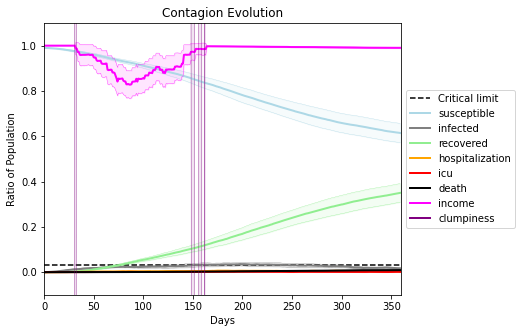

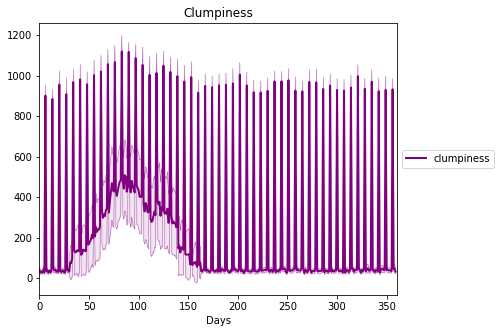

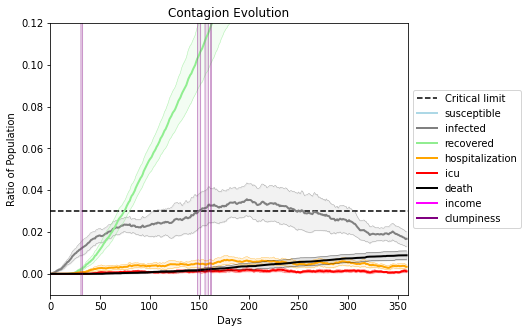

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7162, 9830, 2999, 4641, 6734, 566, 336, 1740, 288, 368, 1949, 9126, 445, 1788, 7612, 9698, 7902, 13, 9763, 5511]
Average similarity between family members is 0.18530577814120305 at temperature -0.3
Average similarity between family and home is 0.9998665392118318 at temperature -1
Average similarity between students and their classroom is 0.15901617777895624 at temperature -0.3
Average classroom occupancy is 1.6507936507936507 and number classrooms is 189
Average similarity between workers is 0.14303117417848796 at temperature -0.3
Average office occupancy is 3.217171717171717 and number offices is 198
Average friend similarity for adults: 0.23784656918805097 for kids: 0.20445586562696905
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.056314582646059805
avg restaurant similarity 0.02777527122862736
avg restaurant similarity 0.03462778968834205
avg restaurant similarity 0.012259600248579935
avg restaurant similarity 0.057674597680685856
avg restaurant similarity 0.10019613654962607
avg restaurant similarity 0.04854711402739991
avg restaurant similarity 0.07876913716582426
avg restaurant similarity 0.03074604571245873
avg restaurant similarity 0.10874497287667192
avg restaurant similarity 0.02407874442962296
avg restaurant similarity 0.05961421845083038
avg restaurant similarity 0.01414677360092456
avg restaurant similarity 0.05526298515701238
avg restaurant similarity 0.09249921827080468
avg restaurant similarity 0.06397532327706794
avg restaurant similarity 0.07119537258910813
avg restaurant similarity 0.04989396567127895
avg restaurant similarity 0.018416234532340245
avg restaurant similarity 0.0667125811836992
avg restaurant similarity 0.07735821225953031
avg restaurant similarity 0.046

avg restaurant similarity 0.07550551903270632
avg restaurant similarity 0.005462781621546769
avg restaurant similarity 0.03593635869273523
avg restaurant similarity 0.034448635620318045
avg restaurant similarity 0.09947172996639857
avg restaurant similarity 0.11789552891140552
avg restaurant similarity 0.10443734883786034
avg restaurant similarity 0.04898010786048462
avg restaurant similarity 0.0609891754989526
avg restaurant similarity 0.07247936264941097
avg restaurant similarity 0.043404188016373406
avg restaurant similarity 0.05481507178451642
avg restaurant similarity 0.0682370020682034
avg restaurant similarity 0.08958318498110451
avg restaurant similarity 0.03354289291368299
avg restaurant similarity 0.09071075950960758
avg restaurant similarity 0.05885413118461487
avg restaurant similarity 0.13123562623547613
avg restaurant similarity 0.09455059328314941
avg restaurant similarity 0.03182865513852992
avg restaurant similarity 0.04022825408807631
avg restaurant similarity 0.05254

avg restaurant similarity 0.03561269223597841
avg restaurant similarity 0.13432557783304333
avg restaurant similarity 0.03782340136939965
avg restaurant similarity 0.07107052542329677
Average similarity between family members is 0.1709078066881874 at temperature -0.3
Average similarity between family and home is 0.9998474779764494 at temperature -1
Average similarity between students and their classroom is 0.1858592345902287 at temperature -0.3
Average classroom occupancy is 1.4912280701754386 and number classrooms is 171
Average similarity between workers is 0.15830139666269574 at temperature -0.3
Average office occupancy is 3.4824120603015074 and number offices is 199
Average friend similarity for adults: 0.24871245922720653 for kids: 0.21888729842835875
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity -0.0034927270522475103
avg restaurant similarity 0.07188166771983184
avg restaurant similarity 0.04059064774700438
avg restaurant similarity 0.038545374904966546
avg restaurant similarity 0.059209630322894946
avg restaurant similarity 0.06629857260915095
avg restaurant similarity 0.0453933652556992
avg restaurant similarity 0.0538654253026913
avg restaurant similarity 0.038970748260943794
avg restaurant similarity 0.0631349106176597
avg restaurant similarity 0.03502952661300914
avg restaurant similarity 0.008129935998761252
avg restaurant similarity 0.019101637464940258
avg restaurant similarity 0.031144772781778227
avg restaurant similarity 0.027549781163258714
avg restaurant similarity 0.045113164077512855
avg restaurant similarity 0.05771406712118569
avg restaurant similarity 0.038773456355295076
avg restaurant similarity 0.0706815288315203
avg restaurant similarity 0.012431273492334211
avg restaurant similarity 0.07271279137589447
avg restaurant similarity

avg restaurant similarity 0.0291159783018108
avg restaurant similarity 0.05572139948023191
avg restaurant similarity 0.015198744456810902
avg restaurant similarity 0.0287785779601814
avg restaurant similarity 0.06861330780486194
avg restaurant similarity 0.029985074695512082
avg restaurant similarity 0.0543733207489255
avg restaurant similarity 0.018037390615193816
avg restaurant similarity 0.06258950958203723
avg restaurant similarity 0.04808496593164642
avg restaurant similarity 0.07583521106330486
avg restaurant similarity 0.020429864400059266
avg restaurant similarity 0.08053773620574017
avg restaurant similarity 0.06393802351897666
avg restaurant similarity 0.006511718085382657
avg restaurant similarity 0.015008793459566488
avg restaurant similarity 0.05285255224724232
avg restaurant similarity 0.11783709324570817
avg restaurant similarity 0.04070138114382152
avg restaurant similarity 0.04459448100807716
avg restaurant similarity 0.0878859455922244
avg restaurant similarity 0.0453

avg restaurant similarity 0.029712978564697658
avg restaurant similarity 0.04335039295411821
avg restaurant similarity 0.009822477595091594
avg restaurant similarity 0.11454822560496057
avg restaurant similarity 0.0023211326706971997
Average similarity between family members is 0.18232647574938518 at temperature -0.3
Average similarity between family and home is 0.9998612601568685 at temperature -1
Average similarity between students and their classroom is 0.2223342931525603 at temperature -0.3
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.1499654257473961 at temperature -0.3
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.23980715255999335 for kids: 0.21370952049005837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people 

avg restaurant similarity 0.025445004686717752
avg restaurant similarity 0.00887302625224372
avg restaurant similarity 0.038605647905291564
avg restaurant similarity 0.08712520820763156
avg restaurant similarity 0.04965696993347867
avg restaurant similarity 0.04528183086368075
avg restaurant similarity 0.014787619805031802
avg restaurant similarity 0.07215661951134225
avg restaurant similarity 0.04993837704232032
avg restaurant similarity 0.07591209670996475
avg restaurant similarity 0.07471488260487466
avg restaurant similarity 0.04805870230800462
avg restaurant similarity 0.09385677087708297
avg restaurant similarity 0.08704638235648669
avg restaurant similarity 0.08187992004031507
avg restaurant similarity 0.08903522518907103
avg restaurant similarity 0.059148645855219485
avg restaurant similarity 0.04432602225457851
avg restaurant similarity 0.01362285057403775
avg restaurant similarity 0.07948771997176966
avg restaurant similarity 0.09072383451773536
avg restaurant similarity 0.08

avg restaurant similarity 0.06539842289165543
avg restaurant similarity 0.06241078317892779
avg restaurant similarity 0.07844796626021508
avg restaurant similarity 0.0761891603428245
avg restaurant similarity 0.0442222527283573
avg restaurant similarity 0.06004591073959851
avg restaurant similarity 0.04720838905309449
avg restaurant similarity 0.010654061227606135
avg restaurant similarity 0.0454886675574511
avg restaurant similarity 0.06862015998737128
avg restaurant similarity 0.07178432931940426
avg restaurant similarity 0.06546611703838195
avg restaurant similarity 0.02011308569291082
avg restaurant similarity 0.057696419754511785
avg restaurant similarity 0.06855340725469063
avg restaurant similarity 0.09118942583166538
avg restaurant similarity 0.06916588943215583
avg restaurant similarity 0.06417193175239105
avg restaurant similarity 0.0507319313881976
avg restaurant similarity 0.07693160149780712
avg restaurant similarity 0.04533023248901764
avg restaurant similarity 0.07168798

avg restaurant similarity 0.052483362552233966
avg restaurant similarity 0.04920987711208946
avg restaurant similarity 0.08099071524640639
avg restaurant similarity 0.06585314709067062
Average similarity between family members is 0.19888017371193795 at temperature -0.3
Average similarity between family and home is 0.9998508070402261 at temperature -1
Average similarity between students and their classroom is 0.14948534253726448 at temperature -0.3
Average classroom occupancy is 1.6153846153846154 and number classrooms is 195
Average similarity between workers is 0.16121856392409234 at temperature -0.3
Average office occupancy is 3.118811881188119 and number offices is 202
Average friend similarity for adults: 0.2402737122922274 for kids: 0.21658435165688006
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.02679180458785152
avg restaurant similarity 0.043874773623277956
avg restaurant similarity 0.02965173295665201
avg restaurant similarity 0.10506198885804353
avg restaurant similarity 0.04177365437755501
avg restaurant similarity 0.044745097481466926
avg restaurant similarity 0.027957138155409785
avg restaurant similarity 0.0667792992729144
avg restaurant similarity 0.09064279450502681
avg restaurant similarity 0.026730910426945604
avg restaurant similarity 0.029196355814461523
avg restaurant similarity 0.05589516496836648
avg restaurant similarity 0.05454151252276976
avg restaurant similarity 0.05606994338645595
avg restaurant similarity 0.024149629945012276
avg restaurant similarity 0.04667197889724196
avg restaurant similarity 0.049920930789978966
avg restaurant similarity 0.030948920940051694
avg restaurant similarity 0.07181466535396289
avg restaurant similarity 0.08091409229997708
avg restaurant similarity 0.03631371309930725
avg restaurant similarity 0

avg restaurant similarity 0.023532926496716077
avg restaurant similarity 0.0710192639043243
avg restaurant similarity 0.03651080149101053
avg restaurant similarity 0.060679764853821906
avg restaurant similarity 0.05776725104755502
avg restaurant similarity 0.0698584548102881
avg restaurant similarity 0.03608786385147813
avg restaurant similarity 0.058947433729497414
avg restaurant similarity 0.05871606213179873
avg restaurant similarity 0.07290666757055547
avg restaurant similarity 0.06134209932998383
avg restaurant similarity 0.04667559697752492
avg restaurant similarity 0.033556620589075103
avg restaurant similarity 0.02355723120108366
avg restaurant similarity 0.06887064454483866
avg restaurant similarity 0.027349894440025287
avg restaurant similarity 0.07807718323512287
avg restaurant similarity 0.011679659467967838
avg restaurant similarity 0.07879693569566651
avg restaurant similarity 0.05877872413288324
avg restaurant similarity 0.05105127840387027
avg restaurant similarity 0.04

avg restaurant similarity 0.07287456186931758
avg restaurant similarity 0.11259670639385712
avg restaurant similarity 0.0887309237782019
avg restaurant similarity 0.0255135611043341
Average similarity between family members is 0.18400812234613587 at temperature -0.3
Average similarity between family and home is 0.9998629112816401 at temperature -1
Average similarity between students and their classroom is 0.14857780505186208 at temperature -0.3
Average classroom occupancy is 1.5941176470588236 and number classrooms is 170
Average similarity between workers is 0.1407904771221448 at temperature -0.3
Average office occupancy is 3.2864077669902914 and number offices is 206
Average friend similarity for adults: 0.24209465861926807 for kids: 0.207516719919222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.051209330789808445
avg restaurant similarity 0.03852246986908407
avg restaurant similarity 0.028344009598783096
avg restaurant similarity 0.00030326423988246207
avg restaurant similarity 0.06339006339203479
avg restaurant similarity 0.026702461140840572
avg restaurant similarity 0.034230406915707015
avg restaurant similarity 0.029694193722186932
avg restaurant similarity 0.03601302216177598
avg restaurant similarity 0.03218564995925306
avg restaurant similarity 0.05540359923262624
avg restaurant similarity 0.008392799710369363
avg restaurant similarity 0.06134210358981228
avg restaurant similarity -0.026706594258205187
avg restaurant similarity 0.04906144021607255
avg restaurant similarity 0.02897234607348122
avg restaurant similarity 0.02754490348559903
avg restaurant similarity 0.04675497229718085
avg restaurant similarity 0.0916656891231314
avg restaurant similarity 0.04943680340866176
avg restaurant similarity -0.006095587241245112
avg restaurant similar

avg restaurant similarity 0.06173374167718084
avg restaurant similarity 0.05838859162685493
avg restaurant similarity 0.06726577605537004
avg restaurant similarity 0.014268898437223329
avg restaurant similarity 0.06792705578674099
avg restaurant similarity 0.010720649309929699
avg restaurant similarity 0.02253394561291331
avg restaurant similarity 0.02710439420215478
avg restaurant similarity 0.06810063818799983
avg restaurant similarity 0.05186228636972047
avg restaurant similarity 0.09202043844513044
avg restaurant similarity 0.053098900546997396
avg restaurant similarity 0.07527371125736086
avg restaurant similarity 0.042132830302195716
avg restaurant similarity 0.033144646131172115
avg restaurant similarity 0.05051908113008771
avg restaurant similarity 0.04351925172454615
avg restaurant similarity 0.032992423929468835
avg restaurant similarity 0.07622395362114485
avg restaurant similarity 0.0058596183354161805
avg restaurant similarity 0.06072411998428467
avg restaurant similarity 

avg restaurant similarity -4.2140167994351225e-05
avg restaurant similarity 0.05236688543515324
avg restaurant similarity 0.0691075093361841
avg restaurant similarity 0.051336479342462375
avg restaurant similarity 0.010471117805303595
avg restaurant similarity 0.02639892418290495
Average similarity between family members is 0.20323917179081794 at temperature -0.3
Average similarity between family and home is 0.9998547447112724 at temperature -1
Average similarity between students and their classroom is 0.18553517909624537 at temperature -0.3
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.1662961573683678 at temperature -0.3
Average office occupancy is 3.239795918367347 and number offices is 196
Average friend similarity for adults: 0.24610525506521222 for kids: 0.21484699137304056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units

avg restaurant similarity 0.03182027831187097
avg restaurant similarity 0.04946131361000917
avg restaurant similarity 0.05182662789057501
avg restaurant similarity 0.01937068170013237
avg restaurant similarity 0.0469199296569322
avg restaurant similarity 0.024130871341103137
avg restaurant similarity 0.059596063842928544
avg restaurant similarity 0.07884044634536692
avg restaurant similarity 0.028576397401522964
avg restaurant similarity 0.06840901540094144
avg restaurant similarity 0.05595715707201651
avg restaurant similarity 0.059140722460039354
avg restaurant similarity 0.06751597502471164
avg restaurant similarity 0.03788756046199103
avg restaurant similarity 0.08751291632230677
avg restaurant similarity 0.09025634858913924
avg restaurant similarity 0.05041007626874065
avg restaurant similarity 0.03859375846893754
avg restaurant similarity 0.07660093782388469
avg restaurant similarity 0.09729029531500634
avg restaurant similarity 0.0746198439168128
avg restaurant similarity 0.0437

avg restaurant similarity 0.09858352655779881
avg restaurant similarity 0.05518686254717694
avg restaurant similarity 0.05761598497043798
avg restaurant similarity 0.0269655919298967
avg restaurant similarity 0.05567583076890319
avg restaurant similarity 0.09375017480374967
avg restaurant similarity 0.08420723258275468
avg restaurant similarity 0.02343749242088781
avg restaurant similarity 0.054589748007669296
avg restaurant similarity 0.021371882491670543
avg restaurant similarity 0.08143610268691229
avg restaurant similarity 0.047938465773596624
avg restaurant similarity 0.05012851280899337
avg restaurant similarity 0.0624181785227611
avg restaurant similarity 0.04548140381889155
avg restaurant similarity 0.04803082054394682
avg restaurant similarity 0.02962359664032442
avg restaurant similarity 0.0731363300552684
avg restaurant similarity 0.06893988229542355
avg restaurant similarity 0.07234163440655336
avg restaurant similarity 0.10021777075832988
avg restaurant similarity 0.079252

avg restaurant similarity 0.027898003927584892
avg restaurant similarity 0.0440303242602184
avg restaurant similarity 0.10040708173121332
Average similarity between family members is 0.21051914536497912 at temperature -0.3
Average similarity between family and home is 0.9998647910959689 at temperature -1
Average similarity between students and their classroom is 0.18274686258058362 at temperature -0.3
Average classroom occupancy is 1.5875706214689265 and number classrooms is 177
Average similarity between workers is 0.16660620975165988 at temperature -0.3
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.24817490973075995 for kids: 0.21197344809555219
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.12234769187953592
avg restaurant similarity 0.10453524412934252
avg restaurant similarity 0.005672751893703893
avg restaurant similarity 0.11236210308798025
avg restaurant similarity 0.09082367209273412
avg restaurant similarity 0.054626801492050556
avg restaurant similarity 0.05596887736872333
avg restaurant similarity 0.08957754051358481
avg restaurant similarity 0.0472671576868975
avg restaurant similarity 0.010954986376273653
avg restaurant similarity 0.10838328632345454
avg restaurant similarity 0.06814141629809398
avg restaurant similarity 0.06165182240023171
avg restaurant similarity 0.10374864652712892
avg restaurant similarity 0.07935307297491072
avg restaurant similarity 0.09968655352800389
avg restaurant similarity -0.007589535852064721
avg restaurant similarity 0.06843195698051734
avg restaurant similarity 0.07772077738269878
avg restaurant similarity 0.05207647924289032
avg restaurant similarity 0.08601858576433984
avg restaurant similarity 0.06

avg restaurant similarity 0.090022766336773
avg restaurant similarity 0.020804928324709735
avg restaurant similarity 0.06996828485493028
avg restaurant similarity 0.05102680077019408
avg restaurant similarity 0.1294685570616351
avg restaurant similarity 0.0767467349631695
avg restaurant similarity 0.1275549872008573
avg restaurant similarity 0.04585161073447852
avg restaurant similarity 0.051544175798441644
avg restaurant similarity 0.05647818154181572
avg restaurant similarity 0.1038023476935772
avg restaurant similarity 0.08466420568943474
avg restaurant similarity 0.1276357866760677
avg restaurant similarity 0.058376603659075495
avg restaurant similarity 0.016729861192754575
avg restaurant similarity 0.05091973891838804
avg restaurant similarity 0.09638546728109859
avg restaurant similarity 0.10317666402539517
avg restaurant similarity 0.084056437646318
avg restaurant similarity 0.11809949370149388
avg restaurant similarity 0.04770334283925908
avg restaurant similarity 0.01385112240

avg restaurant similarity 0.05759141271104374
avg restaurant similarity 0.07031049198957195
Average similarity between family members is 0.17455432907056642 at temperature -0.3
Average similarity between family and home is 0.999842464115631 at temperature -1
Average similarity between students and their classroom is 0.21166124322744803 at temperature -0.3
Average classroom occupancy is 1.6166666666666667 and number classrooms is 180
Average similarity between workers is 0.15407043889000036 at temperature -0.3
Average office occupancy is 3.3575129533678756 and number offices is 193
Average friend similarity for adults: 0.2384469337580822 for kids: 0.22159620519747647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.1069047200656316
avg restaurant similarity 0.07193085470527735
avg restaurant similarity 0.06242755332380347
avg restaurant similarity 0.08787348852306086
avg restaurant similarity 0.05461123687434203
avg restaurant similarity 0.11946103885916574
avg restaurant similarity 0.07066146428975373
avg restaurant similarity 0.0378364466650907
avg restaurant similarity 0.06181963977665569
avg restaurant similarity 0.049804147977747376
avg restaurant similarity -0.023381664816342903
avg restaurant similarity 0.07185027520532913
avg restaurant similarity 0.10126875471261686
avg restaurant similarity 0.049581180859989415
avg restaurant similarity 0.03886074790639115
avg restaurant similarity 0.0956726241693382
avg restaurant similarity 0.057913836666658045
avg restaurant similarity 0.14323533844216244
avg restaurant similarity 0.09596664232647727
avg restaurant similarity 0.0694573255972801
avg restaurant similarity -0.019439310060423348
avg restaurant similarity 0.051

avg restaurant similarity 0.0833274549890517
avg restaurant similarity 0.10033303697318678
avg restaurant similarity 0.08411907620458108
avg restaurant similarity 0.06809012265713728
avg restaurant similarity 0.09699622104446826
avg restaurant similarity 0.08475949727384757
avg restaurant similarity 0.130097872119588
avg restaurant similarity 0.034265937765512115
avg restaurant similarity 0.09116953328097278
avg restaurant similarity 0.04143422303655573
avg restaurant similarity 0.06320292976257255
avg restaurant similarity 0.12197967036455062
avg restaurant similarity 0.04156644081939837
avg restaurant similarity 0.1058137615602235
avg restaurant similarity 0.07241243357209205
avg restaurant similarity 0.10649805128244337
avg restaurant similarity 0.11007029964731804
avg restaurant similarity 0.07936783498647708
avg restaurant similarity -0.01156877241566185
avg restaurant similarity 0.06748673621244806
avg restaurant similarity 0.07047065656298762
avg restaurant similarity 0.09457947

avg restaurant similarity 0.04718903805533791
avg restaurant similarity 0.14156347701615213
avg restaurant similarity 0.09388069235366214
avg restaurant similarity 0.11472018562428424
Average similarity between family members is 0.17305360812425963 at temperature -0.3
Average similarity between family and home is 0.9998581856102094 at temperature -1
Average similarity between students and their classroom is 0.1550664973285756 at temperature -0.3
Average classroom occupancy is 1.5879120879120878 and number classrooms is 182
Average similarity between workers is 0.1297217364474685 at temperature -0.3
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.2344325203434335 for kids: 0.20489136855311765
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.08016743150460617
avg restaurant similarity 0.08053373623738282
avg restaurant similarity 0.06611568854821354
avg restaurant similarity 0.06183230297615535
avg restaurant similarity 0.058185242120693724
avg restaurant similarity 0.05422866490940663
avg restaurant similarity 0.11484267462701518
avg restaurant similarity 0.03860764627571726
avg restaurant similarity 0.050916192560828216
avg restaurant similarity 0.043293850507468645
avg restaurant similarity 0.0363042640516578
avg restaurant similarity 0.049072603750639154
avg restaurant similarity 0.0520072462711792
avg restaurant similarity 0.018067478580326285
avg restaurant similarity 0.06273965986259578
avg restaurant similarity 0.044204270119862686
avg restaurant similarity 0.026933961806438065
avg restaurant similarity 0.0585901534452414
avg restaurant similarity 0.02594051755100864
avg restaurant similarity 0.127661227157633
avg restaurant similarity 0.07473166097161173
avg restaurant similarity 0.0620

avg restaurant similarity 0.04594526978666774
avg restaurant similarity 0.057966763632336354
avg restaurant similarity 0.10661501667538581
avg restaurant similarity 0.034900289858551224
avg restaurant similarity -0.0003926096842700847
avg restaurant similarity 0.08628714859283564
avg restaurant similarity 0.09221611862051704
avg restaurant similarity -0.010912971894135261
avg restaurant similarity 0.08284117068367498
avg restaurant similarity 0.06537627706239763
avg restaurant similarity 0.10800950626534574
avg restaurant similarity 0.05412961566281725
avg restaurant similarity 0.09090965644679515
avg restaurant similarity 0.05656922200756379
avg restaurant similarity 0.049053076612710605
avg restaurant similarity 0.06833496979689906
avg restaurant similarity 0.06278112897513023
avg restaurant similarity 0.0551616227074243
avg restaurant similarity 0.02522835164537779
avg restaurant similarity 0.06479525282959793
avg restaurant similarity 0.024565659128994992
avg restaurant similarity 

avg restaurant similarity 0.03902925570089588
avg restaurant similarity 0.1100945282545276
avg restaurant similarity 0.00874368760402781
avg restaurant similarity 0.059499628984384864
avg restaurant similarity -0.006202260576366698
Average similarity between family members is 0.192299855590723 at temperature -0.3
Average similarity between family and home is 0.9998524605879432 at temperature -1
Average similarity between students and their classroom is 0.12108210415393159 at temperature -0.3
Average classroom occupancy is 1.606936416184971 and number classrooms is 173
Average similarity between workers is 0.1590024350939918 at temperature -0.3
Average office occupancy is 3.2892156862745097 and number offices is 204
Average friend similarity for adults: 0.2515839757129718 for kids: 0.20874565496530637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people alloc

avg restaurant similarity 0.07468194242236434
avg restaurant similarity 0.029205162366750796
avg restaurant similarity 0.08299796354884853
avg restaurant similarity 0.07878310322270704
avg restaurant similarity 0.03380945649718586
avg restaurant similarity 0.045298129733305464
avg restaurant similarity 0.03410842330640413
avg restaurant similarity 0.09520552339514744
avg restaurant similarity 0.054833936342222736
avg restaurant similarity 0.03713298933732126
avg restaurant similarity 0.02612759717939615
avg restaurant similarity 0.0743331699906645
avg restaurant similarity 0.047377461122529295
avg restaurant similarity 0.02272045696810579
avg restaurant similarity 0.06626139319332416
avg restaurant similarity 0.049964262429158315
avg restaurant similarity 0.04413991206689091
avg restaurant similarity 0.09699694168622097
avg restaurant similarity 0.048841709310981155
avg restaurant similarity 0.045435272796752746
avg restaurant similarity 0.10430973824906747
avg restaurant similarity 0.

avg restaurant similarity 0.04382271293050433
avg restaurant similarity 0.04882045230072385
avg restaurant similarity 0.04187137983633247
avg restaurant similarity 0.05868095335823993
avg restaurant similarity 0.018811975309781997
avg restaurant similarity 0.07075132368896635
avg restaurant similarity 0.0618887500403689
avg restaurant similarity 0.06757820022114935
avg restaurant similarity 0.05992098264070621
avg restaurant similarity 0.08480449038960683
avg restaurant similarity 0.02721737202687956
avg restaurant similarity 0.07677453274207431
avg restaurant similarity 0.07536935580693856
avg restaurant similarity 0.0820181369470385
avg restaurant similarity 0.06008832855310293
avg restaurant similarity 0.06987094875471211
avg restaurant similarity 0.07812889915421009
avg restaurant similarity 0.06039469383723933
avg restaurant similarity 0.07096118380711966
avg restaurant similarity 0.0630456135133171
avg restaurant similarity 0.0136554745590427
avg restaurant similarity 0.063629381

avg restaurant similarity 0.022327947634633603
avg restaurant similarity 0.06648812294423485
avg restaurant similarity 0.0574352301628044
avg restaurant similarity 0.06061824020790247
Average similarity between family members is 0.2039820273249825 at temperature -0.3
Average similarity between family and home is 0.999851831858644 at temperature -1
Average similarity between students and their classroom is 0.18058918438443786 at temperature -0.3
Average classroom occupancy is 1.5730994152046784 and number classrooms is 171
Average similarity between workers is 0.15902935540216978 at temperature -0.3
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.24961153482355675 for kids: 0.21835288230705166
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.023006784033214017
avg restaurant similarity 0.0653195183172726
avg restaurant similarity 0.06541735631168016
avg restaurant similarity 0.05679981716650386
avg restaurant similarity 0.09063749165836016
avg restaurant similarity 0.14204309189379097
avg restaurant similarity 0.10874055387564076
avg restaurant similarity 0.05778550369822991
avg restaurant similarity 0.09770659030312612
avg restaurant similarity 0.09586704064150704
avg restaurant similarity 0.0676013610006635
avg restaurant similarity 0.08850691391382186
avg restaurant similarity 0.0866647020272978
avg restaurant similarity 0.0991981966709697
avg restaurant similarity 0.0566677739345775
avg restaurant similarity 0.11960678110201554
avg restaurant similarity 0.04092068355368328
avg restaurant similarity 0.06875580978841518
avg restaurant similarity 0.1195871085116449
avg restaurant similarity 0.10202203019231375
avg restaurant similarity 0.12745115140935914
avg restaurant similarity 0.13523085331

avg restaurant similarity 0.09554820219714281
avg restaurant similarity 0.07614385888300712
avg restaurant similarity 0.09272006694774733
avg restaurant similarity 0.06395892245064926
avg restaurant similarity 0.08790241704416421
avg restaurant similarity 0.0920492616662626
avg restaurant similarity 0.01514825910657938
avg restaurant similarity 0.04744820820832112
avg restaurant similarity 0.18584633737134792
avg restaurant similarity 0.10870675040219643
avg restaurant similarity 0.13106811901764207
avg restaurant similarity 0.06504530330894684
avg restaurant similarity 0.048463093969465174
avg restaurant similarity 0.11270700832463709
avg restaurant similarity 0.07761845510865037
avg restaurant similarity 0.05301210383550869
avg restaurant similarity 0.12337675743383163
avg restaurant similarity 0.07546775446716096
avg restaurant similarity 0.09148301653874683
avg restaurant similarity 0.09729804153481418
avg restaurant similarity 0.03437072998869648
avg restaurant similarity 0.055974

avg restaurant similarity 0.05308658265651957
avg restaurant similarity 0.07877956493412745
Average similarity between family members is 0.17968832138571061 at temperature -0.3
Average similarity between family and home is 0.9998501526798476 at temperature -1
Average similarity between students and their classroom is 0.17234532512674666 at temperature -0.3
Average classroom occupancy is 1.509090909090909 and number classrooms is 165
Average similarity between workers is 0.17294342435896823 at temperature -0.3
Average office occupancy is 3.5024875621890548 and number offices is 201
Average friend similarity for adults: 0.265032208072892 for kids: 0.22471672557071248
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.0656511446915274
avg restaurant similarity 0.06950096773737689
avg restaurant similarity 0.1122434335780827
avg restaurant similarity 0.11506382674037038
avg restaurant similarity 0.12351953436049597
avg restaurant similarity 0.07860648952934171
avg restaurant similarity 0.05888188647521223
avg restaurant similarity 0.10887428704736869
avg restaurant similarity 0.0878967040089842
avg restaurant similarity 0.10114997823332589
avg restaurant similarity 0.03697806266446669
avg restaurant similarity 0.04127013705932346
avg restaurant similarity 0.1046621834067417
avg restaurant similarity 0.10979373151611366
avg restaurant similarity 0.14391113399260144
avg restaurant similarity 0.14754770651763213
avg restaurant similarity 0.08656073121969718
avg restaurant similarity 0.13366124595045845
avg restaurant similarity 0.08760385291363218
avg restaurant similarity 0.059987738898071956
avg restaurant similarity 0.12067516548912484
avg restaurant similarity 0.103173023

avg restaurant similarity 0.09801748321618194
avg restaurant similarity 0.03703768963583802
avg restaurant similarity 0.09068536151574925
avg restaurant similarity 0.07044765484309559
avg restaurant similarity 0.0515076663357524
avg restaurant similarity 0.09976434381810567
avg restaurant similarity 0.07600822743562421
avg restaurant similarity 0.0875126213377921
avg restaurant similarity 0.05778545540748707
avg restaurant similarity 0.11462941635399898
avg restaurant similarity 0.07980922614760241
avg restaurant similarity 0.13750129490477286
avg restaurant similarity 0.060873866757646895
avg restaurant similarity 0.04774007202707938
avg restaurant similarity 0.09546926416278911
avg restaurant similarity 0.06430510111509911
avg restaurant similarity 0.12341633210440865
avg restaurant similarity 0.07863939173044526
avg restaurant similarity 0.10576947336077828
avg restaurant similarity 0.0890952059779254
avg restaurant similarity 0.06681669541763437
avg restaurant similarity 0.05887606

avg restaurant similarity 0.10137179304515329
avg restaurant similarity 0.0685488263680831
Average similarity between family members is 0.16957960311255701 at temperature -0.3
Average similarity between family and home is 0.9998591119296114 at temperature -1
Average similarity between students and their classroom is 0.13889778866566127 at temperature -0.3
Average classroom occupancy is 1.6153846153846154 and number classrooms is 182
Average similarity between workers is 0.1495369850732895 at temperature -0.3
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.23508102761807162 for kids: 0.21173326632020134
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.036209846425578555
avg restaurant similarity 0.01799299670739577
avg restaurant similarity 0.04112878917261435
avg restaurant similarity 0.06635860345290687
avg restaurant similarity 0.09484657262749033
avg restaurant similarity 0.051964165784512135
avg restaurant similarity 0.021698826016393672
avg restaurant similarity 0.07845029526142645
avg restaurant similarity 0.103070543000849
avg restaurant similarity 0.06590268408942485
avg restaurant similarity 0.02970933923077926
avg restaurant similarity 0.09389841876972228
avg restaurant similarity 0.06944404733961639
avg restaurant similarity 0.08043149861705402
avg restaurant similarity 0.06942676968272164
avg restaurant similarity 0.08247124776677332
avg restaurant similarity 0.1144428771416465
avg restaurant similarity 0.06614746318927926
avg restaurant similarity 0.06772517640370566
avg restaurant similarity 0.08568886511514029
avg restaurant similarity 0.10937865167190128
avg restaurant similarity 0.064110

avg restaurant similarity 0.06890639793097646
avg restaurant similarity 0.08633976850956514
avg restaurant similarity 0.08849959966726169
avg restaurant similarity 0.0759399040825681
avg restaurant similarity 0.054089331180492264
avg restaurant similarity 0.09502639801720375
avg restaurant similarity 0.09529661988360798
avg restaurant similarity 0.022857820618033594
avg restaurant similarity 0.06186052711678275
avg restaurant similarity 0.08670337387919291
avg restaurant similarity 0.07535592481415708
avg restaurant similarity 0.08437041639185411
avg restaurant similarity 0.04220574696978983
avg restaurant similarity 0.06248136111140695
avg restaurant similarity 0.05982682387924114
avg restaurant similarity 0.044846811236722815
avg restaurant similarity 0.07239759530314094
avg restaurant similarity 0.11366356236118634
avg restaurant similarity 0.06049383626701124
avg restaurant similarity 0.04599990261291704
avg restaurant similarity 0.06702510959759872
avg restaurant similarity 0.0455

avg restaurant similarity 0.048318409334663324
avg restaurant similarity 0.1142219943096342
avg restaurant similarity 0.03694368006519061
avg restaurant similarity 0.05077376066756384
Average similarity between family members is 0.16857176486142014 at temperature -0.3
Average similarity between family and home is 0.9998453756374767 at temperature -1
Average similarity between students and their classroom is 0.16923502290597123 at temperature -0.3
Average classroom occupancy is 1.6568047337278107 and number classrooms is 169
Average similarity between workers is 0.1248319307456552 at temperature -0.3
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.23676466998023407 for kids: 0.1906288052353862
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.07002424713031319
avg restaurant similarity 0.028148409313485286
avg restaurant similarity 0.06568273041516041
avg restaurant similarity 0.05531317134910484
avg restaurant similarity 0.0707029989924241
avg restaurant similarity 0.06979964956984011
avg restaurant similarity 0.06559272768371494
avg restaurant similarity 0.009643030138370907
avg restaurant similarity 0.026751222078071055
avg restaurant similarity 0.047554518060109054
avg restaurant similarity 0.08385069496541943
avg restaurant similarity 0.08375559215973348
avg restaurant similarity 0.05859614004100394
avg restaurant similarity 0.02926864935178931
avg restaurant similarity 0.06916517971954843
avg restaurant similarity 0.023426285076029858
avg restaurant similarity 0.06432636574505264
avg restaurant similarity 0.051567233870939255
avg restaurant similarity 0.005108048535685126
avg restaurant similarity 0.08415181539853443
avg restaurant similarity 0.03238913381952125
avg restaurant similarity 0.

avg restaurant similarity 0.08355804559707512
avg restaurant similarity 0.04159160644334517
avg restaurant similarity 0.044902033712460106
avg restaurant similarity 0.03052757459174564
avg restaurant similarity 0.08067193389020426
avg restaurant similarity 0.06780188367272806
avg restaurant similarity 0.04333430978343908
avg restaurant similarity 0.0538896324057737
avg restaurant similarity 0.0675700792565061
avg restaurant similarity 0.07957809773076446
avg restaurant similarity 0.07688860833674584
avg restaurant similarity 0.043452427756797786
avg restaurant similarity 0.058548234020721526
avg restaurant similarity 0.03373189815239199
avg restaurant similarity 0.0558051779232371
avg restaurant similarity 0.031141311413473868
avg restaurant similarity 0.05246132177214456
avg restaurant similarity 0.08410297116680909
avg restaurant similarity 0.02710427441026996
avg restaurant similarity 0.05477536079241789
avg restaurant similarity 0.02650943864743455
avg restaurant similarity 0.10470

avg restaurant similarity 0.03291562657335872
avg restaurant similarity 0.06255139431796382
avg restaurant similarity 0.07943049039591743
avg restaurant similarity 0.10643440277443712
avg restaurant similarity 0.044847705172121825
Average similarity between family members is 0.18508159187287646 at temperature -0.3
Average similarity between family and home is 0.9998516009614486 at temperature -1
Average similarity between students and their classroom is 0.18951943685601272 at temperature -0.3
Average classroom occupancy is 1.6023391812865497 and number classrooms is 171
Average similarity between workers is 0.16125099833774217 at temperature -0.3
Average office occupancy is 3.386934673366834 and number offices is 199
Average friend similarity for adults: 0.2488600673458521 for kids: 0.2041746114992009
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people alloca

avg restaurant similarity 0.08647484935800667
avg restaurant similarity 0.011787221020197185
avg restaurant similarity 0.008915313487235578
avg restaurant similarity 0.06753112351852572
avg restaurant similarity 0.06858856196299151
avg restaurant similarity 0.05339112012553388
avg restaurant similarity 0.02356112444704671
avg restaurant similarity 0.03814037124045793
avg restaurant similarity 0.027661940856878276
avg restaurant similarity 0.035839456681568724
avg restaurant similarity 0.045811456118617415
avg restaurant similarity 0.04592232279758952
avg restaurant similarity 0.05859037762505915
avg restaurant similarity 0.06236164263930024
avg restaurant similarity 0.08574692320345816
avg restaurant similarity 0.07997560436293775
avg restaurant similarity 0.0392755364495851
avg restaurant similarity 0.052222490582001166
avg restaurant similarity 0.061907666903381633
avg restaurant similarity 0.03576307863255049
avg restaurant similarity 0.06696525393763009
avg restaurant similarity 0.

avg restaurant similarity 0.05634090917863183
avg restaurant similarity 0.05989485436374909
avg restaurant similarity 0.01516063980308708
avg restaurant similarity 0.054642526295931575
avg restaurant similarity 0.04193066129843287
avg restaurant similarity 0.02005791312604526
avg restaurant similarity 0.06772949736532505
avg restaurant similarity 0.08759755384811262
avg restaurant similarity 0.03500254208856747
avg restaurant similarity 0.058941705685856466
avg restaurant similarity 0.0682512957518731
avg restaurant similarity 0.06716656879353507
avg restaurant similarity 0.08313315416813158
avg restaurant similarity 0.03126377130391228
avg restaurant similarity 0.061133278357384496
avg restaurant similarity 0.08919904075182092
avg restaurant similarity 0.04481900483312359
avg restaurant similarity 0.03796476307287292
avg restaurant similarity 0.018887027379147766
avg restaurant similarity 0.09384322578107329
avg restaurant similarity 0.04810959927474425
avg restaurant similarity 0.039

avg restaurant similarity 0.033103841467710886
avg restaurant similarity 0.05315706783880047
avg restaurant similarity -0.017409237226426642
avg restaurant similarity 0.07257707009251321
avg restaurant similarity 0.01569237711750149
Average similarity between family members is 0.19896327115945361 at temperature -0.3
Average similarity between family and home is 0.9998545296513187 at temperature -1
Average similarity between students and their classroom is 0.15708804554782355 at temperature -0.3
Average classroom occupancy is 1.6910112359550562 and number classrooms is 178
Average similarity between workers is 0.16134417198395937 at temperature -0.3
Average office occupancy is 3.176470588235294 and number offices is 204
Average friend similarity for adults: 0.2334100950385249 for kids: 0.21713465763998566
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people a

avg restaurant similarity 0.09454015990441987
avg restaurant similarity 0.06012552255998945
avg restaurant similarity 0.06277350714827978
avg restaurant similarity 0.05932613796192144
avg restaurant similarity 0.0759105666914734
avg restaurant similarity 0.07828461486465306
avg restaurant similarity 0.03697036797033075
avg restaurant similarity 0.06158691193684579
avg restaurant similarity 0.03624833483338075
avg restaurant similarity 0.07418988849146478
avg restaurant similarity 0.09325280499217098
avg restaurant similarity 0.09196176770090951
avg restaurant similarity 0.08750225741436045
avg restaurant similarity 0.07873854483929917
avg restaurant similarity 0.059976592097038574
avg restaurant similarity 0.03914837746805744
avg restaurant similarity 0.08256347305835789
avg restaurant similarity 0.1053253958332378
avg restaurant similarity 0.05407969967471545
avg restaurant similarity 0.0900714598882213
avg restaurant similarity 0.1259733173645058
avg restaurant similarity 0.073526215

avg restaurant similarity 0.10480827490898992
avg restaurant similarity 0.06646202940794209
avg restaurant similarity 0.06076905221027132
avg restaurant similarity 0.07177399825303749
avg restaurant similarity 0.049703205922615824
avg restaurant similarity 0.06849430699979339
avg restaurant similarity 0.028645492011760705
avg restaurant similarity 0.0489627435637973
avg restaurant similarity 0.09032780618882025
avg restaurant similarity 0.07167432550467841
avg restaurant similarity 0.05294294510088571
avg restaurant similarity 0.09220378904404772
avg restaurant similarity 0.06035009905263741
avg restaurant similarity 0.058387287768236366
avg restaurant similarity 0.07231499229938444
avg restaurant similarity 0.06962379145392132
avg restaurant similarity 0.038094321046717616
avg restaurant similarity 0.07267314247638629
avg restaurant similarity 0.04900117580161451
avg restaurant similarity 0.056010310724869616
avg restaurant similarity 0.03219609275724402
avg restaurant similarity 0.04

avg restaurant similarity 0.04539124907750384
avg restaurant similarity 0.07438828906201181
avg restaurant similarity 0.04407662670927317
avg restaurant similarity 0.004386069222409781
Average similarity between family members is 0.19170421467227045 at temperature -0.3
Average similarity between family and home is 0.9998524594667217 at temperature -1
Average similarity between students and their classroom is 0.17153247336173194 at temperature -0.3
Average classroom occupancy is 1.5176470588235293 and number classrooms is 170
Average similarity between workers is 0.13349582366206672 at temperature -0.3
Average office occupancy is 3.3838383838383836 and number offices is 198
Average friend similarity for adults: 0.2465854751015212 for kids: 0.2158739442481357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.07719023549605111
avg restaurant similarity 0.027481877845404224
avg restaurant similarity 0.015975722854024824
avg restaurant similarity -0.011567766677725657
avg restaurant similarity 0.018085972647786396
avg restaurant similarity 0.03241554341005603
avg restaurant similarity 0.07264715398490916
avg restaurant similarity 0.09164738585540462
avg restaurant similarity 0.0338142290214307
avg restaurant similarity 0.030395073839782127
avg restaurant similarity 0.0001253094388713729
avg restaurant similarity 0.059048382821578524
avg restaurant similarity 0.07408819825081966
avg restaurant similarity 0.05085847675658496
avg restaurant similarity 0.021653802813528727
avg restaurant similarity 0.044968615138749155
avg restaurant similarity 0.0823825600436274
avg restaurant similarity 0.11552946964889672
avg restaurant similarity 0.04183832122277484
avg restaurant similarity 0.05100687430404728
avg restaurant similarity 0.08538363099651013
avg restaurant similarity

avg restaurant similarity 0.06429605558902031
avg restaurant similarity 0.03380473900422004
avg restaurant similarity 0.053020222878938914
avg restaurant similarity 0.04215210814868206
avg restaurant similarity 0.06519009965090752
avg restaurant similarity -0.001910487756438736
avg restaurant similarity 0.028667669516449945
avg restaurant similarity 0.03146879414699942
avg restaurant similarity 0.05862050754392947
avg restaurant similarity 0.019190423801638715
avg restaurant similarity 0.028323871001718848
avg restaurant similarity 0.039967781205444065
avg restaurant similarity 0.0371634821473579
avg restaurant similarity 0.0456268806810379
avg restaurant similarity 0.09735082703064803
avg restaurant similarity 0.04941653497742483
avg restaurant similarity 0.08965599894961514
avg restaurant similarity 0.010992393816277894
avg restaurant similarity 0.05583668357830824
avg restaurant similarity 0.04505982900044839
avg restaurant similarity 0.04881503470894252
avg restaurant similarity 0.

avg restaurant similarity 0.07319321233076931
avg restaurant similarity 0.04801123909533676
avg restaurant similarity 0.06531778760495682
avg restaurant similarity 0.021162252390648017
avg restaurant similarity 0.07980821903128187
Average similarity between family members is 0.1907886231148851 at temperature -0.3
Average similarity between family and home is 0.9998558757972607 at temperature -1
Average similarity between students and their classroom is 0.178804431667408 at temperature -0.3
Average classroom occupancy is 1.6395348837209303 and number classrooms is 172
Average similarity between workers is 0.14451952645859906 at temperature -0.3
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.24434827156257352 for kids: 0.21973650144182966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people alloc

avg restaurant similarity 0.03901946777027655
avg restaurant similarity 0.053467966511030335
avg restaurant similarity 0.10245270099559879
avg restaurant similarity 0.03712073844091697
avg restaurant similarity 0.08050949330144849
avg restaurant similarity 0.06987545603463095
avg restaurant similarity 0.03365245357039597
avg restaurant similarity 0.02135457582481136
avg restaurant similarity 0.005848339672443575
avg restaurant similarity 0.028041514332275985
avg restaurant similarity 0.0580575635497074
avg restaurant similarity 0.04040822402026081
avg restaurant similarity 0.009349948229268646
avg restaurant similarity 0.08903075526612754
avg restaurant similarity 0.07338778704228444
avg restaurant similarity 0.027191079039364397
avg restaurant similarity 0.015193944093559852
avg restaurant similarity 0.022086300828161043
avg restaurant similarity 0.06766827179277526
avg restaurant similarity 0.06995401752124773
avg restaurant similarity 0.10817997179261023
avg restaurant similarity 0.

avg restaurant similarity 0.08090663752895785
avg restaurant similarity 0.09604173427044986
avg restaurant similarity 0.06144077462489524
avg restaurant similarity 0.07862744097181462
avg restaurant similarity 0.04384874986913789
avg restaurant similarity 0.04449194347578058
avg restaurant similarity 0.08010358443914842
avg restaurant similarity 0.0579049887671763
avg restaurant similarity 0.01565798054865897
avg restaurant similarity 0.041048924633057995
avg restaurant similarity 0.07943277169786153
avg restaurant similarity 0.07494998162335957
avg restaurant similarity 0.05563517845275145
avg restaurant similarity 0.09056293027102198
avg restaurant similarity 0.018839931414963883
avg restaurant similarity 0.07680889965391707
avg restaurant similarity 0.027502136211794346
avg restaurant similarity 0.04266678820384929
avg restaurant similarity 0.023059188239853107
avg restaurant similarity 0.039855959675066374
avg restaurant similarity 0.0827311872830476
avg restaurant similarity 0.082

avg restaurant similarity 0.06745599422843526
avg restaurant similarity -0.003318995750977996
avg restaurant similarity 0.06802450032895083
avg restaurant similarity 0.05099601224823507
Average similarity between family members is 0.17236647028812005 at temperature -0.3
Average similarity between family and home is 0.9998489119993181 at temperature -1
Average similarity between students and their classroom is 0.13371649324612492 at temperature -0.3
Average classroom occupancy is 1.6470588235294117 and number classrooms is 170
Average similarity between workers is 0.15866788396844506 at temperature -0.3
Average office occupancy is 3.235294117647059 and number offices is 204
Average friend similarity for adults: 0.23697464300803098 for kids: 0.19421655982804742
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.04857429456424374
avg restaurant similarity 0.06649506178622969
avg restaurant similarity 0.08592845071393515
avg restaurant similarity 0.012270810561428914
avg restaurant similarity 0.03395445154622679
avg restaurant similarity 0.055587886462171096
avg restaurant similarity 0.06310714309433968
avg restaurant similarity 0.11997433184492762
avg restaurant similarity 0.05044910619657053
avg restaurant similarity 0.07251012485453623
avg restaurant similarity 0.013005822192314704
avg restaurant similarity 0.028298747458427632
avg restaurant similarity 0.1347620476416158
avg restaurant similarity 0.02419670992645683
avg restaurant similarity 0.02774453968057903
avg restaurant similarity 0.07922586600766666
avg restaurant similarity 0.026613686214114186
avg restaurant similarity 0.06666651345171289
avg restaurant similarity -0.017102822744287118
avg restaurant similarity 0.04254075557247393
avg restaurant similarity 0.04440920251762571
avg restaurant similarity 0.

avg restaurant similarity 0.06143605005649081
avg restaurant similarity 0.048491611913171785
avg restaurant similarity 0.016769373123028886
avg restaurant similarity 0.022012300068420487
avg restaurant similarity 0.017208316135773526
avg restaurant similarity 0.037679320137530656
avg restaurant similarity 0.06577432971009213
avg restaurant similarity 0.05210147992086499
avg restaurant similarity 0.02442783221903592
avg restaurant similarity 0.07630478239943962
avg restaurant similarity 0.03677074071100497
avg restaurant similarity 0.06833610253029422
avg restaurant similarity 0.07718116576916158
avg restaurant similarity 0.06372281266325783
avg restaurant similarity 0.06210327489643473
avg restaurant similarity 0.029129940249974395
avg restaurant similarity 0.05471137202926082
avg restaurant similarity -0.0052044066325878805
avg restaurant similarity 0.11235065068695956
avg restaurant similarity 0.06542857297540972
avg restaurant similarity 0.03996631537745531
avg restaurant similarity

avg restaurant similarity 0.04637732776136014
avg restaurant similarity 0.008236646000579544
avg restaurant similarity 0.05721608298854264
avg restaurant similarity 0.07014164412085355
avg restaurant similarity 0.04372200925273871
Average similarity between family members is 0.1994725487017594 at temperature -0.3
Average similarity between family and home is 0.9998611800330991 at temperature -1
Average similarity between students and their classroom is 0.1621142355816916 at temperature -0.3
Average classroom occupancy is 1.494047619047619 and number classrooms is 168
Average similarity between workers is 0.1654248882553302 at temperature -0.3
Average office occupancy is 3.399014778325123 and number offices is 203
Average friend similarity for adults: 0.25476508881788545 for kids: 0.22716816428237274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people alloca

avg restaurant similarity 0.01326427281021773
avg restaurant similarity 0.034079589258953345
avg restaurant similarity 0.03799926765656364
avg restaurant similarity 0.07641788535228886
avg restaurant similarity 0.025284436220190987
avg restaurant similarity 0.03655015881751227
avg restaurant similarity 0.04219946139883741
avg restaurant similarity 0.064523525442742
avg restaurant similarity 0.06556571545474081
avg restaurant similarity 0.0390078087135613
avg restaurant similarity 0.04280800939569228
avg restaurant similarity 0.03762288871800723
avg restaurant similarity 0.018342246874766946
avg restaurant similarity 0.08229153167589562
avg restaurant similarity 0.05163722095784912
avg restaurant similarity -0.004734886075114585
avg restaurant similarity 0.05553351483421462
avg restaurant similarity 0.031025953431396115
avg restaurant similarity -0.0014887875006118568
avg restaurant similarity 0.04963956702922855
avg restaurant similarity -0.0011141711413316584
avg restaurant similarity

avg restaurant similarity 0.053765541573257435
avg restaurant similarity -0.008109770586229595
avg restaurant similarity 0.025069037292514765
avg restaurant similarity -0.0023526133900520895
avg restaurant similarity 0.10167463663402844
avg restaurant similarity 0.05052766531730384
avg restaurant similarity 0.06688748849752783
avg restaurant similarity 0.0558382901252521
avg restaurant similarity 0.030839187378214564
avg restaurant similarity 0.04388695908760767
avg restaurant similarity 0.014983973952645606
avg restaurant similarity 0.08406762114088122
avg restaurant similarity 0.0005985775606009427
avg restaurant similarity 0.05887855686442527
avg restaurant similarity 0.05184610871637433
avg restaurant similarity 0.05505062767259449
avg restaurant similarity 0.05048150258978204
avg restaurant similarity 0.0560537020990428
avg restaurant similarity 0.040829466313578096
avg restaurant similarity 0.08291622543341176
avg restaurant similarity 0.06757138943507644
avg restaurant similarit

avg restaurant similarity 0.08295915085331486
avg restaurant similarity 0.06147175398078344
avg restaurant similarity 0.032270427315721745
avg restaurant similarity 0.057897324115295586
using average of time series:
stats on susceptible:
data: [0.8331833333333334, 0.8063055555555556, 0.8520861111111111, 0.8012364160567753, 0.8553583333333332, 0.7942972222222222, 0.8868520368520367, 0.8403222222222221, 0.8182500000000001, 0.7763583333333334, 0.793444666001994, 0.8111388888888889, 0.8079285872699046, 0.8250333333333333, 0.8806719893546241, 0.8238749999999999, 0.8813916666666667, 0.7327527777777776, 0.8499944444444444, 0.8615944444444443]
min:
0.7327527777777776
max:
0.8868520368520367
std:
0.037571975405222835
mean:
0.8266037681101002
median:
0.8244541666666666
95% confidence interval for the mean:
(0.8085627331346736,0.8446448030855267)
using average of time series:
stats on infected:
data: [0.02031388888888889, 0.02522777777777778, 0.01863611111111111, 0.023283987580394763, 0.018933333

(<function dict.items>, <function dict.items>, <function dict.items>)

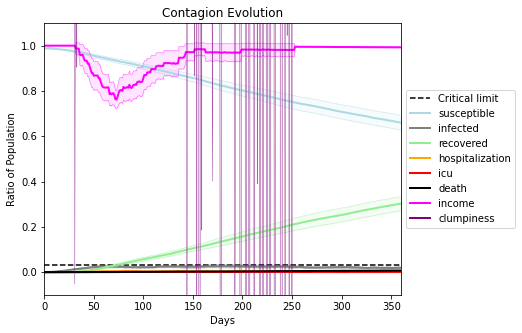

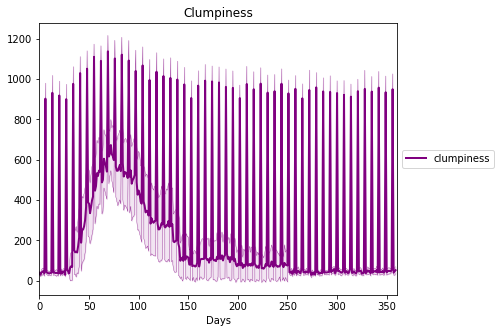

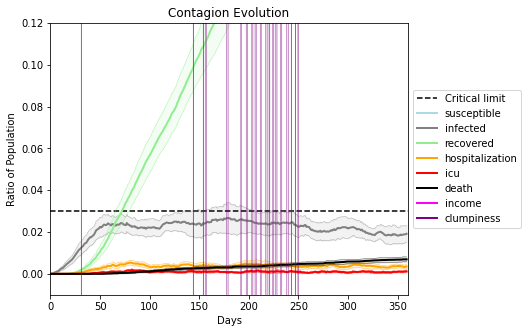

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9498, 5977, 3370, 8120, 4369, 6554, 6619, 21, 5545, 9917, 2752, 686, 6114, 9376, 1867, 7309, 7169, 9049, 7094, 5479]
Average similarity between family members is 0.18877813436102633 at temperature -0.2
Average similarity between family and home is 0.9998339898767803 at temperature -1
Average similarity between students and their classroom is 0.18429345427561808 at temperature -0.2
Average classroom occupancy is 1.6374269005847952 and number classrooms is 171
Average similarity between workers is 0.16099576521093104 at temperature -0.2
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.2073482047975793 for kids: 0.21461646488995947
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.051668609671127096
avg restaurant similarity 0.07154447502834871
avg restaurant similarity 0.051962424394306386
avg restaurant similarity 0.02737724509213997
avg restaurant similarity 0.04716791309471902
avg restaurant similarity 0.07304649690690776
avg restaurant similarity 0.025523334829794506
avg restaurant similarity 0.06913868540510261
avg restaurant similarity 0.090344901960284
avg restaurant similarity 0.07263031828353969
avg restaurant similarity 0.054163026329139545
avg restaurant similarity 0.041609489485436246
avg restaurant similarity 0.07947038087537664
avg restaurant similarity 0.0591868817732151
avg restaurant similarity 0.06941808243293819
avg restaurant similarity 0.059813492665406365
avg restaurant similarity 0.08270153077210839
avg restaurant similarity 0.04293597516808919
avg restaurant similarity 0.0775313440904037
avg restaurant similarity 0.046038701092629385
avg restaurant similarity 0.025013081057312554
avg restaurant similarity 0.09

avg restaurant similarity 0.038139599011341674
avg restaurant similarity 0.08557087303450445
avg restaurant similarity 0.022923830669435576
avg restaurant similarity 0.08457533500120237
avg restaurant similarity 0.07306053449829403
avg restaurant similarity 0.0914794127784492
avg restaurant similarity 0.0795583249699903
avg restaurant similarity 0.07482544427318498
avg restaurant similarity 0.06292238556503753
avg restaurant similarity 0.08803333964167252
avg restaurant similarity 0.06979373814036761
avg restaurant similarity 0.09216927960958293
avg restaurant similarity 0.08200303300536883
avg restaurant similarity 0.08028167055527023
avg restaurant similarity 0.1345824786877751
avg restaurant similarity 0.0614540976992349
avg restaurant similarity 0.09703366214268686
avg restaurant similarity 0.07154414063903125
avg restaurant similarity 0.10163240806730847
avg restaurant similarity 0.0732105545780373
avg restaurant similarity 0.09613784891732692
avg restaurant similarity 0.064959614

avg restaurant similarity 0.0817405234831414
avg restaurant similarity 0.10906591579692504
Average similarity between family members is 0.17921552480017008 at temperature -0.2
Average similarity between family and home is 0.9998487957786384 at temperature -1
Average similarity between students and their classroom is 0.15456843080366905 at temperature -0.2
Average classroom occupancy is 1.5757575757575757 and number classrooms is 165
Average similarity between workers is 0.16056578268234273 at temperature -0.2
Average office occupancy is 3.372549019607843 and number offices is 204
Average friend similarity for adults: 0.20611421425132154 for kids: 0.21039130699436928
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.09421985078588906
avg restaurant similarity 0.03673329742469219
avg restaurant similarity 0.028797752173949056
avg restaurant similarity 0.13703294733641372
avg restaurant similarity 0.078656823120663
avg restaurant similarity 0.06407281456928061
avg restaurant similarity 0.05546544724700823
avg restaurant similarity 0.026415520326039808
avg restaurant similarity 0.08559367332954619
avg restaurant similarity 0.09535820639344682
avg restaurant similarity 0.07364826852768724
avg restaurant similarity 0.06508417190523594
avg restaurant similarity 0.07611369606121027
avg restaurant similarity 0.10170012192142401
avg restaurant similarity 0.07526745808602453
avg restaurant similarity 0.09209260530598382
avg restaurant similarity 0.04380320188556079
avg restaurant similarity 0.06280245971134356
avg restaurant similarity 0.019853387733461618
avg restaurant similarity 0.06629667902039502
avg restaurant similarity 0.05228366911287399
avg restaurant similarity 0.10021

avg restaurant similarity 0.039743697803056775
avg restaurant similarity 0.07954185489215215
avg restaurant similarity 0.12729890784040043
avg restaurant similarity 0.12283148544695012
avg restaurant similarity 0.06848790389189109
avg restaurant similarity 0.11761161119649174
avg restaurant similarity 0.09032334528714418
avg restaurant similarity 0.07439341374793151
avg restaurant similarity 0.09883575832543728
avg restaurant similarity 0.08759056932376208
avg restaurant similarity -0.0005324099275251477
avg restaurant similarity 0.0680380126006723
avg restaurant similarity 0.047112690343966035
avg restaurant similarity 0.06582160290542738
avg restaurant similarity 0.09523956861986918
avg restaurant similarity 0.05792737186028776
avg restaurant similarity 0.033069449368152225
avg restaurant similarity 0.06542239832150884
avg restaurant similarity 0.03402310539207806
avg restaurant similarity 0.06064298029043406
avg restaurant similarity 0.061667228597552276
avg restaurant similarity 0.

avg restaurant similarity 0.07242148963030504
avg restaurant similarity 0.05240649118000444
avg restaurant similarity 0.09412669056485252
avg restaurant similarity 0.07553891666968947
Average similarity between family members is 0.1539172449973552 at temperature -0.2
Average similarity between family and home is 0.9998475937058309 at temperature -1
Average similarity between students and their classroom is 0.12729800043428147 at temperature -0.2
Average classroom occupancy is 1.6416184971098267 and number classrooms is 173
Average similarity between workers is 0.15194912937193428 at temperature -0.2
Average office occupancy is 3.175609756097561 and number offices is 205
Average friend similarity for adults: 0.2058045664076201 for kids: 0.21598265373164605
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.06530060302509527
avg restaurant similarity 0.07479579514526198
avg restaurant similarity 0.08227977102338184
avg restaurant similarity 0.05699369152649117
avg restaurant similarity 0.10007448363889132
avg restaurant similarity 0.06533103821851244
avg restaurant similarity 0.0564999624870802
avg restaurant similarity 0.01627250585290422
avg restaurant similarity 0.02908308601090492
avg restaurant similarity 0.09255098015137592
avg restaurant similarity 0.020321568085715887
avg restaurant similarity 0.03187209451524696
avg restaurant similarity 0.03149215999745413
avg restaurant similarity 0.06955988981174772
avg restaurant similarity 0.06208599001873965
avg restaurant similarity 0.05701269148983164
avg restaurant similarity 0.03225887532646552
avg restaurant similarity 0.06867311349096215
avg restaurant similarity 0.02995534852538527
avg restaurant similarity 0.03642330552041418
avg restaurant similarity 0.05883683064399564
avg restaurant similarity 0.055391

avg restaurant similarity 0.038842819910929846
avg restaurant similarity 0.046373106074783996
avg restaurant similarity 0.0676527702535163
avg restaurant similarity 0.06574082281587908
avg restaurant similarity 0.06481888629307365
avg restaurant similarity 0.05332777261882123
avg restaurant similarity 0.04399005594018381
avg restaurant similarity 0.021534558292736074
avg restaurant similarity 0.06705359744705736
avg restaurant similarity 0.043716453874334184
avg restaurant similarity 0.06672300017577266
avg restaurant similarity 0.06093793226365996
avg restaurant similarity 0.06734973161608972
avg restaurant similarity 0.08714477381163575
avg restaurant similarity 0.08028889990843972
avg restaurant similarity 0.08424203202761621
avg restaurant similarity 0.023401725041620376
avg restaurant similarity 0.07269577032428662
avg restaurant similarity 0.07460130524639993
avg restaurant similarity 0.02715318710459546
avg restaurant similarity 0.039707141310422446
avg restaurant similarity 0.1

avg restaurant similarity 0.06978077794818857
avg restaurant similarity 0.06930474378640021
avg restaurant similarity 0.07260928365176643
avg restaurant similarity 0.11059273867796779
Average similarity between family members is 0.1797195172268679 at temperature -0.2
Average similarity between family and home is 0.9998666429576705 at temperature -1
Average similarity between students and their classroom is 0.20040623477872832 at temperature -0.2
Average classroom occupancy is 1.6319018404907975 and number classrooms is 163
Average similarity between workers is 0.16602952977883506 at temperature -0.2
Average office occupancy is 3.442786069651741 and number offices is 201
Average friend similarity for adults: 0.21793959059252754 for kids: 0.22941080100190656
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.051283604720451285
avg restaurant similarity 0.07498528897584139
avg restaurant similarity 0.09326538244516329
avg restaurant similarity 0.11915321120216789
avg restaurant similarity 0.10118972398516632
avg restaurant similarity 0.056012967139564086
avg restaurant similarity 0.09073394725427811
avg restaurant similarity 0.04821897638939722
avg restaurant similarity 0.08631607812080133
avg restaurant similarity 0.03914228175411795
avg restaurant similarity 0.07636788204167018
avg restaurant similarity 0.11486663941161834
avg restaurant similarity 0.03943853222353607
avg restaurant similarity 0.05321392022681585
avg restaurant similarity 0.056032882464330726
avg restaurant similarity 0.07605665358460008
avg restaurant similarity 0.10667271045356216
avg restaurant similarity 0.10912942516937284
avg restaurant similarity 0.07855051826487307
avg restaurant similarity 0.06571956281860229
avg restaurant similarity 0.09524305129182296
avg restaurant similarity 0.078

avg restaurant similarity 0.05020115927796648
avg restaurant similarity 0.12361436272390744
avg restaurant similarity 0.12602804127721037
avg restaurant similarity 0.06926462056101419
avg restaurant similarity 0.06092683917885115
avg restaurant similarity 0.09459033884515758
avg restaurant similarity 0.059139408036942794
avg restaurant similarity 0.13781715923647211
avg restaurant similarity 0.1249193402383837
avg restaurant similarity 0.0965528625150462
avg restaurant similarity 0.1022012734466077
avg restaurant similarity 0.08972303823510074
avg restaurant similarity 0.12524322943339772
avg restaurant similarity 0.09675603973108653
avg restaurant similarity 0.08412612637136913
avg restaurant similarity 0.08847805719342325
avg restaurant similarity 0.030679578724241922
avg restaurant similarity 0.08333277221132451
avg restaurant similarity 0.07624643994230172
avg restaurant similarity 0.10106380231698003
avg restaurant similarity 0.09595554087574765
avg restaurant similarity 0.0742342

avg restaurant similarity 0.08445443246924123
avg restaurant similarity 0.06914826371036872
Average similarity between family members is 0.18020859176015475 at temperature -0.2
Average similarity between family and home is 0.999847314501182 at temperature -1
Average similarity between students and their classroom is 0.15834061021141943 at temperature -0.2
Average classroom occupancy is 1.5806451612903225 and number classrooms is 186
Average similarity between workers is 0.16242646578065761 at temperature -0.2
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.20480041265429666 for kids: 0.22089157889747604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.08970159480831237
avg restaurant similarity 0.06705667465135025
avg restaurant similarity 0.03005046692990432
avg restaurant similarity 0.07365325455006419
avg restaurant similarity 0.054818021060005766
avg restaurant similarity 0.04650608345870581
avg restaurant similarity 0.07016899041024875
avg restaurant similarity 0.032502842798141945
avg restaurant similarity 0.02344304137882399
avg restaurant similarity 0.04207554845803342
avg restaurant similarity 0.09566774598104591
avg restaurant similarity 0.04326587805414945
avg restaurant similarity 0.044583864467750964
avg restaurant similarity 0.03443171423058913
avg restaurant similarity 0.06123954804353648
avg restaurant similarity 0.06929490313258267
avg restaurant similarity 0.10082404111468819
avg restaurant similarity 0.06399382609155771
avg restaurant similarity 0.08626564172999036
avg restaurant similarity 0.08819884440403201
avg restaurant similarity 0.012099542365696677
avg restaurant similarity 0.05

avg restaurant similarity 0.07121773337417163
avg restaurant similarity 0.04210097618653377
avg restaurant similarity 0.024138278757225257
avg restaurant similarity 0.03697637254493527
avg restaurant similarity 0.050428312798257276
avg restaurant similarity 0.12688947967165398
avg restaurant similarity 0.08851949011800633
avg restaurant similarity 0.06875706358075949
avg restaurant similarity 0.0758032580510338
avg restaurant similarity 0.08648152031885907
avg restaurant similarity 0.05946219832977279
avg restaurant similarity 0.0012003838055346927
avg restaurant similarity 0.07126652626102195
avg restaurant similarity 0.09420471435428614
avg restaurant similarity 0.03818465074960599
avg restaurant similarity 0.031600663966906535
avg restaurant similarity 0.062260753077180826
avg restaurant similarity 0.06734971175468843
avg restaurant similarity 0.07831613642579649
avg restaurant similarity 0.0711222706816684
avg restaurant similarity 0.049329350289721005
avg restaurant similarity 0.0

avg restaurant similarity 0.07041742256962881
avg restaurant similarity 0.06546505859803321
avg restaurant similarity 0.09977851568712251
avg restaurant similarity 0.08683004503890888
Average similarity between family members is 0.1647367205219948 at temperature -0.2
Average similarity between family and home is 0.9998574803556578 at temperature -1
Average similarity between students and their classroom is 0.17987856815144904 at temperature -0.2
Average classroom occupancy is 1.7204301075268817 and number classrooms is 186
Average similarity between workers is 0.16090723965206158 at temperature -0.2
Average office occupancy is 3.1732673267326734 and number offices is 202
Average friend similarity for adults: 0.20984471336091548 for kids: 0.2246344517009673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.06285913231631167
avg restaurant similarity 0.035239938220019286
avg restaurant similarity 0.04389258151763209
avg restaurant similarity 0.08995226978100669
avg restaurant similarity 0.06100560446257128
avg restaurant similarity 0.08956552209649139
avg restaurant similarity 0.07003290571837255
avg restaurant similarity 0.0689605641774871
avg restaurant similarity 0.04999073555679837
avg restaurant similarity 0.07293523165129784
avg restaurant similarity 0.07647278255882606
avg restaurant similarity 0.0663021997183858
avg restaurant similarity 0.02729963623474968
avg restaurant similarity 0.07089503167777261
avg restaurant similarity 0.014942551208126858
avg restaurant similarity 0.05087270914034695
avg restaurant similarity 0.031539468695596984
avg restaurant similarity 0.028367221876080033
avg restaurant similarity 0.07056185019316596
avg restaurant similarity 0.03387309031675997
avg restaurant similarity 0.011858664735603418
avg restaurant similarity 0.090

avg restaurant similarity 0.06045831296199786
avg restaurant similarity 0.07275507032847356
avg restaurant similarity 0.061331024395276094
avg restaurant similarity 0.046172780688479735
avg restaurant similarity 0.05747910238090056
avg restaurant similarity 0.0622847300657642
avg restaurant similarity 0.009957934052001892
avg restaurant similarity 0.0861367709403604
avg restaurant similarity 0.07853550372191696
avg restaurant similarity 0.05475578602015285
avg restaurant similarity 0.028000768680210637
avg restaurant similarity 0.04295801000984381
avg restaurant similarity 0.05730933787818479
avg restaurant similarity 0.013817111093995794
avg restaurant similarity 0.07663404070781654
avg restaurant similarity 0.05431506275672947
avg restaurant similarity 0.05251794877844728
avg restaurant similarity 0.09643839649583467
avg restaurant similarity 0.10484401197921216
avg restaurant similarity 0.019044804117449608
avg restaurant similarity 0.058309031600370424
avg restaurant similarity 0.1

avg restaurant similarity 0.058478303229436916
avg restaurant similarity 0.09702727577762599
avg restaurant similarity 0.03749284362109743
avg restaurant similarity 0.028749279212406158
Average similarity between family members is 0.18726930334279748 at temperature -0.2
Average similarity between family and home is 0.9998560576342396 at temperature -1
Average similarity between students and their classroom is 0.19662175773712695 at temperature -0.2
Average classroom occupancy is 1.5251396648044693 and number classrooms is 179
Average similarity between workers is 0.15603342323391833 at temperature -0.2
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.21695455848633075 for kids: 0.22015748304210458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.07645174363704461
avg restaurant similarity 0.005242684088171355
avg restaurant similarity 0.022175964993454648
avg restaurant similarity 0.05907582575735614
avg restaurant similarity 0.029349033337867127
avg restaurant similarity 0.04833442356521345
avg restaurant similarity 0.07957284076757723
avg restaurant similarity 0.09387270576037668
avg restaurant similarity 0.060953791867852956
avg restaurant similarity 0.12704045636877875
avg restaurant similarity 0.08356277331541184
avg restaurant similarity 0.0676572494667079
avg restaurant similarity 0.03905699679337339
avg restaurant similarity 0.0534504089469566
avg restaurant similarity 0.049844215137916606
avg restaurant similarity 0.08415256137328432
avg restaurant similarity 0.10151864383598995
avg restaurant similarity 0.04315295158693934
avg restaurant similarity 0.06578909010830834
avg restaurant similarity 0.03797931679893883
avg restaurant similarity 0.05375099033917454
avg restaurant similarity 0.030

avg restaurant similarity 0.04998754097607634
avg restaurant similarity 0.02629145239852957
avg restaurant similarity 0.08317579513630939
avg restaurant similarity 0.059242635182271235
avg restaurant similarity 0.07744334131421396
avg restaurant similarity 0.06308643775837902
avg restaurant similarity 0.08731479727130749
avg restaurant similarity 0.09175473618435717
avg restaurant similarity 0.09676202103388433
avg restaurant similarity 0.07802649371601049
avg restaurant similarity 0.06030424028937038
avg restaurant similarity 0.057927779470066144
avg restaurant similarity 0.05719935745755571
avg restaurant similarity 0.10538549386833558
avg restaurant similarity 0.0412479584113904
avg restaurant similarity 0.016114904130679692
avg restaurant similarity 0.07613011299212978
avg restaurant similarity 0.04008130662122381
avg restaurant similarity 0.0077691261904214645
avg restaurant similarity 0.05236590472802806
avg restaurant similarity 0.07210168234977694
avg restaurant similarity 0.03

avg restaurant similarity 0.12850200395009406
avg restaurant similarity 0.04735926657731835
avg restaurant similarity 0.04983124419317374
avg restaurant similarity 0.06340374056738136
Average similarity between family members is 0.18003960514552972 at temperature -0.2
Average similarity between family and home is 0.9998539768952232 at temperature -1
Average similarity between students and their classroom is 0.17185515304940627 at temperature -0.2
Average classroom occupancy is 1.6057142857142856 and number classrooms is 175
Average similarity between workers is 0.16622357479860422 at temperature -0.2
Average office occupancy is 3.1666666666666665 and number offices is 204
Average friend similarity for adults: 0.21476235226865173 for kids: 0.20310460305769618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.059387117294886875
avg restaurant similarity 0.05868397345884394
avg restaurant similarity 0.05752534546703137
avg restaurant similarity 0.0840112858817914
avg restaurant similarity 0.03727039593793702
avg restaurant similarity 0.001958291499598167
avg restaurant similarity 0.046973698034312374
avg restaurant similarity 0.06816494974986834
avg restaurant similarity 0.08280154618168789
avg restaurant similarity 0.04503780048835783
avg restaurant similarity 0.09541692085057864
avg restaurant similarity 0.08620458911817862
avg restaurant similarity 0.04105838836568624
avg restaurant similarity 0.06640055241600466
avg restaurant similarity 0.022185133553598642
avg restaurant similarity 0.0744553667958507
avg restaurant similarity 0.06655943938676759
avg restaurant similarity 0.04714694490154936
avg restaurant similarity 0.08528581340038437
avg restaurant similarity 0.06239174052073151
avg restaurant similarity 0.06431446850338397
avg restaurant similarity 0.0555

avg restaurant similarity 0.053043926603835924
avg restaurant similarity 0.05330423974745649
avg restaurant similarity 0.06901757749088215
avg restaurant similarity 0.05920500810456633
avg restaurant similarity 0.041275106446276834
avg restaurant similarity 0.024699029116241573
avg restaurant similarity 0.09341906567323274
avg restaurant similarity 0.07766941363225614
avg restaurant similarity 0.023670838576476602
avg restaurant similarity 0.01792474597682699
avg restaurant similarity 0.11765977123855145
avg restaurant similarity 0.05389045383556038
avg restaurant similarity 0.04003015590179983
avg restaurant similarity 0.05451452819889827
avg restaurant similarity 0.051400717689706894
avg restaurant similarity 0.05458127444363088
avg restaurant similarity 0.04433831081966015
avg restaurant similarity 0.08251367107118976
avg restaurant similarity 0.03911080975936931
avg restaurant similarity 0.060206042531858774
avg restaurant similarity 0.08432873377372402
avg restaurant similarity 0.

avg restaurant similarity 0.04096649164613458
avg restaurant similarity 0.02820513500004933
avg restaurant similarity 0.08378506427980156
avg restaurant similarity 0.09115929310910288
Average similarity between family members is 0.17816344938938028 at temperature -0.2
Average similarity between family and home is 0.9998410084147902 at temperature -1
Average similarity between students and their classroom is 0.16058657309565233 at temperature -0.2
Average classroom occupancy is 1.5642458100558658 and number classrooms is 179
Average similarity between workers is 0.17398099515691004 at temperature -0.2
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.22262811951839998 for kids: 0.21689406351105744
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.029038974495837346
avg restaurant similarity 0.02783386923603234
avg restaurant similarity 0.06510769239481018
avg restaurant similarity 0.12715805977280564
avg restaurant similarity 0.03831461031229949
avg restaurant similarity 0.08729241715423347
avg restaurant similarity 0.10196006705004343
avg restaurant similarity 0.07516820826264238
avg restaurant similarity 0.04400124733810884
avg restaurant similarity 0.04524071584130487
avg restaurant similarity 0.0006930692343737374
avg restaurant similarity -0.025926476536894633
avg restaurant similarity 0.06899228606459958
avg restaurant similarity 0.0843252818514015
avg restaurant similarity 0.06239386603486679
avg restaurant similarity 0.008357902238918295
avg restaurant similarity 0.061665250745920226
avg restaurant similarity 0.08483304056418706
avg restaurant similarity 0.08502871616998191
avg restaurant similarity 0.031455880267389665
avg restaurant similarity 0.052259145965541313
avg restaurant similarity 

avg restaurant similarity 0.05124674937549395
avg restaurant similarity 0.00026219025285203443
avg restaurant similarity 0.007906745989730055
avg restaurant similarity 0.01974823486736542
avg restaurant similarity 0.06600702196132291
avg restaurant similarity 0.06569709442991042
avg restaurant similarity 0.02401584683571025
avg restaurant similarity 0.007008205030100727
avg restaurant similarity 0.03686549201317513
avg restaurant similarity 0.039475933532372484
avg restaurant similarity 0.13913779903121826
avg restaurant similarity 0.08275691767427643
avg restaurant similarity 0.08190485634182212
avg restaurant similarity 0.009145609102922055
avg restaurant similarity 0.06362011600196649
avg restaurant similarity 0.09354049436078636
avg restaurant similarity 0.059365264542571544
avg restaurant similarity 0.039156184911294474
avg restaurant similarity 0.045617607895768957
avg restaurant similarity -0.018250058693947933
avg restaurant similarity 0.026026020075885302
avg restaurant simila

avg restaurant similarity 0.050115409666906835
avg restaurant similarity 0.04471843541143856
avg restaurant similarity 0.09676112843049416
avg restaurant similarity 0.06716233569468696
avg restaurant similarity 0.07424242442411348
avg restaurant similarity 0.07697969069057152
Average similarity between family members is 0.14343846485724843 at temperature -0.2
Average similarity between family and home is 0.9998516313971982 at temperature -1
Average similarity between students and their classroom is 0.15036026174152173 at temperature -0.2
Average classroom occupancy is 1.7861271676300579 and number classrooms is 173
Average similarity between workers is 0.1442506161811451 at temperature -0.2
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.20581542689869164 for kids: 0.20466243608706308
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wit

avg restaurant similarity 0.07427133780801319
avg restaurant similarity 0.09631105159077497
avg restaurant similarity 0.06846704198806065
avg restaurant similarity 0.07791784253411893
avg restaurant similarity 0.068977566184683
avg restaurant similarity 0.054960195391529486
avg restaurant similarity 0.06434689666802522
avg restaurant similarity 0.06309140747733902
avg restaurant similarity 0.08274743545550046
avg restaurant similarity 0.07140987346227937
avg restaurant similarity 0.058917284330416875
avg restaurant similarity 0.0577220791264939
avg restaurant similarity 0.05351294290969184
avg restaurant similarity 0.023902934039293423
avg restaurant similarity 0.041942496663544555
avg restaurant similarity 0.02948940981349319
avg restaurant similarity 0.05591109230761495
avg restaurant similarity 0.00460604998244384
avg restaurant similarity 0.04409969915985392
avg restaurant similarity 0.07032346982224565
avg restaurant similarity 0.027181581797129914
avg restaurant similarity 0.0314

avg restaurant similarity 0.04225356858480819
avg restaurant similarity 0.10593293452447197
avg restaurant similarity 0.037186328301009035
avg restaurant similarity 0.07242898273273704
avg restaurant similarity 0.04150433043188553
avg restaurant similarity 0.04826749900331045
avg restaurant similarity 0.024231084019424483
avg restaurant similarity 0.07731474265636966
avg restaurant similarity 0.06476826519349735
avg restaurant similarity 0.009433618394459133
avg restaurant similarity 0.049834023984521865
avg restaurant similarity 0.060360232433239354
avg restaurant similarity 0.0593820959815988
avg restaurant similarity 0.05648365321982083
avg restaurant similarity 0.09323602289033438
avg restaurant similarity 0.03825728458580175
avg restaurant similarity 0.035399486790690916
avg restaurant similarity 0.06120915734590772
avg restaurant similarity 0.05672217452048011
avg restaurant similarity 0.11239378499207037
avg restaurant similarity 0.07861865778860998
avg restaurant similarity 0.0

avg restaurant similarity 0.07055870701449343
avg restaurant similarity 0.029110522845391743
avg restaurant similarity 0.02421294338375057
avg restaurant similarity 0.027680538249451166
Average similarity between family members is 0.19878846432025443 at temperature -0.2
Average similarity between family and home is 0.9998523229150448 at temperature -1
Average similarity between students and their classroom is 0.203654275216892 at temperature -0.2
Average classroom occupancy is 1.5232558139534884 and number classrooms is 172
Average similarity between workers is 0.18115182866049462 at temperature -0.2
Average office occupancy is 3.338235294117647 and number offices is 204
Average friend similarity for adults: 0.22356302085422497 for kids: 0.21657254987851576
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.03139681726233662
avg restaurant similarity 0.08409319370510177
avg restaurant similarity 0.05855045179027711
avg restaurant similarity 0.06053885023326498
avg restaurant similarity 0.03024145663821445
avg restaurant similarity 0.0794009344098726
avg restaurant similarity -0.022963186410720295
avg restaurant similarity 0.03458972953272702
avg restaurant similarity 0.06736949477076523
avg restaurant similarity 0.030296240063027873
avg restaurant similarity 0.02979396996308765
avg restaurant similarity 0.024919290205107258
avg restaurant similarity 0.03286444080913318
avg restaurant similarity 0.004022773510362396
avg restaurant similarity 0.06201298148658713
avg restaurant similarity 0.03709543937410182
avg restaurant similarity 0.0234209515870041
avg restaurant similarity 0.04832345842885377
avg restaurant similarity 0.04079094751410554
avg restaurant similarity 0.014869555477460328
avg restaurant similarity 0.03378801470426765
avg restaurant similarity 0.08

avg restaurant similarity 0.056032942027568845
avg restaurant similarity 0.05252825232627413
avg restaurant similarity 0.027277500498592212
avg restaurant similarity 0.017573274026175676
avg restaurant similarity 0.06342573623704108
avg restaurant similarity 0.03034685014586482
avg restaurant similarity 0.03197222433200287
avg restaurant similarity 0.038846089794479566
avg restaurant similarity 0.02622373236442656
avg restaurant similarity 0.00450921279346131
avg restaurant similarity 0.08989629753061369
avg restaurant similarity 0.018094995906348894
avg restaurant similarity 0.03056467662592322
avg restaurant similarity 0.013414628994536005
avg restaurant similarity 0.044157355850139406
avg restaurant similarity 0.02195268956460349
avg restaurant similarity 0.03110008285520535
avg restaurant similarity 0.05131250084364095
avg restaurant similarity 0.05581014314661199
avg restaurant similarity 0.08802719314781525
avg restaurant similarity 0.0005756716471351211
avg restaurant similarity

avg restaurant similarity 0.048933212575151826
avg restaurant similarity 0.030556439251639846
avg restaurant similarity 0.04043421946174933
avg restaurant similarity 0.06992228855816854
avg restaurant similarity 0.06522195290036496
avg restaurant similarity 0.05732992803656833
Average similarity between family members is 0.14978052071731465 at temperature -0.2
Average similarity between family and home is 0.9998480056861399 at temperature -1
Average similarity between students and their classroom is 0.15130886070511532 at temperature -0.2
Average classroom occupancy is 1.6157894736842104 and number classrooms is 190
Average similarity between workers is 0.1628319781321281 at temperature -0.2
Average office occupancy is 3.312820512820513 and number offices is 195
Average friend similarity for adults: 0.21523591575015105 for kids: 0.21171579366333995
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.050413165163208644
avg restaurant similarity 0.02047712291143421
avg restaurant similarity 0.058888519661725924
avg restaurant similarity -0.0072199068769871685
avg restaurant similarity 0.06353987428274564
avg restaurant similarity -0.0010163353585233073
avg restaurant similarity 0.038585847274722036
avg restaurant similarity 0.006211034072926138
avg restaurant similarity 0.0961876422562501
avg restaurant similarity 0.09708015273159898
avg restaurant similarity 0.06928915721630875
avg restaurant similarity 0.06517723816506962
avg restaurant similarity -0.016840688660115365
avg restaurant similarity 0.05692990042139644
avg restaurant similarity 0.05402899190477659
avg restaurant similarity 0.028193197489955493
avg restaurant similarity 0.07387801086850337
avg restaurant similarity 0.013882048560361557
avg restaurant similarity 0.06537172042746499
avg restaurant similarity -0.006948617375639066
avg restaurant similarity 0.0334930240182803
avg restaurant simil

avg restaurant similarity 0.01727441938965957
avg restaurant similarity 0.013891946910858443
avg restaurant similarity 0.08402868251811481
avg restaurant similarity 0.03859188684054958
avg restaurant similarity 0.037020001371844566
avg restaurant similarity 0.0316664800996082
avg restaurant similarity 0.02295005743602548
avg restaurant similarity 0.09429525356054619
avg restaurant similarity 0.07162180461224539
avg restaurant similarity 0.0031119228545820844
avg restaurant similarity 0.021686764905681593
avg restaurant similarity 0.026170924121044003
avg restaurant similarity -0.03439553177228826
avg restaurant similarity 0.041660614911580796
avg restaurant similarity 0.09949062065385664
avg restaurant similarity 0.024480380222113587
avg restaurant similarity 0.05452088315342574
avg restaurant similarity 0.05501396006008842
avg restaurant similarity 0.0672520094897541
avg restaurant similarity 0.011643113176335948
avg restaurant similarity 0.03057264041577369
avg restaurant similarity 

avg restaurant similarity 0.03627943677372532
avg restaurant similarity 0.02929317695521157
avg restaurant similarity 0.06602924453695995
avg restaurant similarity 0.08213702969526625
avg restaurant similarity 0.02201714488146267
avg restaurant similarity 0.046266322364292595
Average similarity between family members is 0.16978537620364373 at temperature -0.2
Average similarity between family and home is 0.9998531287598302 at temperature -1
Average similarity between students and their classroom is 0.1727757244970856 at temperature -0.2
Average classroom occupancy is 1.586021505376344 and number classrooms is 186
Average similarity between workers is 0.14780173778903286 at temperature -0.2
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.20896803862239852 for kids: 0.21032066623909199
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.01546285241423713
avg restaurant similarity 0.040617557324301126
avg restaurant similarity 0.04128299732823944
avg restaurant similarity 0.04362033541776211
avg restaurant similarity 0.0536562068967499
avg restaurant similarity 0.07919412098961186
avg restaurant similarity 0.07462444822286547
avg restaurant similarity 0.0576038569757487
avg restaurant similarity 0.07753581469557709
avg restaurant similarity 0.0711850119665999
avg restaurant similarity 0.05680164855968751
avg restaurant similarity 0.018951071026350654
avg restaurant similarity 0.08840942739652008
avg restaurant similarity 0.06314726870969256
avg restaurant similarity 0.06049883898474824
avg restaurant similarity 0.0462533405770268
avg restaurant similarity 0.05453891912649423
avg restaurant similarity 0.08012379589093169
avg restaurant similarity 0.08822604539304175
avg restaurant similarity 0.056393342951898365
avg restaurant similarity 0.04366319775692095
avg restaurant similarity 0.0701309

avg restaurant similarity 0.07832606173327175
avg restaurant similarity 0.05534261745589795
avg restaurant similarity 0.039274065732189146
avg restaurant similarity 0.04018506638786455
avg restaurant similarity 0.06346016877217031
avg restaurant similarity 0.004020723650976358
avg restaurant similarity 0.06386579133459694
avg restaurant similarity 0.11082236661016345
avg restaurant similarity 0.07422782451903395
avg restaurant similarity 0.08420302020172216
avg restaurant similarity 0.025031223558547148
avg restaurant similarity 0.03130801094541124
avg restaurant similarity 0.052295294383781755
avg restaurant similarity 0.07060854264021471
avg restaurant similarity 0.06020843491083779
avg restaurant similarity 0.060234482435030275
avg restaurant similarity 0.08913967131032664
avg restaurant similarity 0.061842356870125445
avg restaurant similarity 0.057249804606791715
avg restaurant similarity 0.061140327566572984
avg restaurant similarity 0.09960010431032391
avg restaurant similarity 

avg restaurant similarity 0.05313906950138569
avg restaurant similarity 0.0471287529644982
avg restaurant similarity 0.059459340803495374
avg restaurant similarity 0.02550082987669423
Average similarity between family members is 0.16484905056781118 at temperature -0.2
Average similarity between family and home is 0.9998624018394008 at temperature -1
Average similarity between students and their classroom is 0.1777049814566082 at temperature -0.2
Average classroom occupancy is 1.7175141242937852 and number classrooms is 177
Average similarity between workers is 0.15425824473810917 at temperature -0.2
Average office occupancy is 3.1641791044776117 and number offices is 201
Average friend similarity for adults: 0.21766753598726976 for kids: 0.21371136499270674
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.04310629893285998
avg restaurant similarity 0.056395758379601396
avg restaurant similarity 0.02074801319253713
avg restaurant similarity 0.030879745540956304
avg restaurant similarity 0.06715146390749617
avg restaurant similarity 0.10001048659523727
avg restaurant similarity 0.03409726016063072
avg restaurant similarity 0.03639259573222446
avg restaurant similarity 0.039864805594025436
avg restaurant similarity 0.05231696318882748
avg restaurant similarity 0.05517120623140564
avg restaurant similarity 0.08759396811884623
avg restaurant similarity 0.023876945356005045
avg restaurant similarity 0.06773076139013351
avg restaurant similarity 0.0433383312181548
avg restaurant similarity 0.06162919165408504
avg restaurant similarity 0.0601388586896549
avg restaurant similarity 0.0644225795547931
avg restaurant similarity -0.024365972798687695
avg restaurant similarity 0.0456920155164179
avg restaurant similarity 0.025722728110427813
avg restaurant similarity 0.089

avg restaurant similarity 0.04257561578198677
avg restaurant similarity 0.06355365165638828
avg restaurant similarity 0.03099487317995599
avg restaurant similarity 0.04658798721043033
avg restaurant similarity 0.04938110828330402
avg restaurant similarity 0.037870402908883646
avg restaurant similarity 0.03691819200352659
avg restaurant similarity 0.07296390632696588
avg restaurant similarity 0.05886608283946475
avg restaurant similarity 0.07392133910880297
avg restaurant similarity 0.06628560962563015
avg restaurant similarity 0.03383513339976437
avg restaurant similarity 0.06284297050022711
avg restaurant similarity 0.0594830687724555
avg restaurant similarity -0.02506565035166983
avg restaurant similarity 0.08942652466212941
avg restaurant similarity 0.0465452961348528
avg restaurant similarity 0.018425252955610434
avg restaurant similarity 0.08963788041595853
avg restaurant similarity 0.03560572190143922
avg restaurant similarity 0.12154788814441592
avg restaurant similarity 0.07551

avg restaurant similarity 0.03903057765708922
avg restaurant similarity 0.05109920573174357
avg restaurant similarity 0.08222628696335692
avg restaurant similarity 0.05028612470328599
avg restaurant similarity 0.027883957769559597
Average similarity between family members is 0.17120768117427138 at temperature -0.2
Average similarity between family and home is 0.999852253339997 at temperature -1
Average similarity between students and their classroom is 0.160880670601474 at temperature -0.2
Average classroom occupancy is 1.6666666666666667 and number classrooms is 186
Average similarity between workers is 0.1535238240383772 at temperature -0.2
Average office occupancy is 3.1881188118811883 and number offices is 202
Average friend similarity for adults: 0.21162851780966013 for kids: 0.20851777817061906
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people alloc

avg restaurant similarity 0.07478445146647468
avg restaurant similarity 0.07249633422350116
avg restaurant similarity 0.042990876200067994
avg restaurant similarity 0.054978443162558344
avg restaurant similarity 0.07966349748440626
avg restaurant similarity 0.10973880722407547
avg restaurant similarity 0.07398084766475728
avg restaurant similarity 0.011452200455120291
avg restaurant similarity 0.06634655018402848
avg restaurant similarity 0.010195876662461993
avg restaurant similarity 0.01365394192920566
avg restaurant similarity 0.022432830924152884
avg restaurant similarity 0.10267999556802401
avg restaurant similarity 0.07598310030671776
avg restaurant similarity 0.04986665079342896
avg restaurant similarity -0.000552183482841917
avg restaurant similarity 0.0343836110085535
avg restaurant similarity 0.04030204033579915
avg restaurant similarity 0.04974140999950935
avg restaurant similarity 0.01560495426575322
avg restaurant similarity 0.015614768648939261
avg restaurant similarity 0

avg restaurant similarity 0.04969124781933859
avg restaurant similarity 0.005826167197838332
avg restaurant similarity 0.04976363750640616
avg restaurant similarity 0.03162590989266204
avg restaurant similarity 0.055411180464086496
avg restaurant similarity 0.08391377164634181
avg restaurant similarity 0.10349262856640683
avg restaurant similarity 0.07962688264049816
avg restaurant similarity 0.027198232737081655
avg restaurant similarity 0.06952367741315826
avg restaurant similarity 0.051130838361193094
avg restaurant similarity 0.05027025607246471
avg restaurant similarity 0.0529018450525669
avg restaurant similarity 0.06518015840111424
avg restaurant similarity 0.020179055559355417
avg restaurant similarity 0.0699708951116238
avg restaurant similarity 0.03820456153537058
avg restaurant similarity 0.01990339295665043
avg restaurant similarity 0.05673263596262657
avg restaurant similarity 0.026605643460405053
avg restaurant similarity 0.040719634364806793
avg restaurant similarity 0.0

avg restaurant similarity 0.042680456671444045
avg restaurant similarity 0.051530899813763194
avg restaurant similarity 0.07754871147265707
avg restaurant similarity -0.004889439134151143
avg restaurant similarity 0.07591639071875096
avg restaurant similarity 0.08658372040520057
Average similarity between family members is 0.18870209082929726 at temperature -0.2
Average similarity between family and home is 0.9998512010324065 at temperature -1
Average similarity between students and their classroom is 0.16975183463015 at temperature -0.2
Average classroom occupancy is 1.6273291925465838 and number classrooms is 161
Average similarity between workers is 0.1712466125863872 at temperature -0.2
Average office occupancy is 3.2766990291262137 and number offices is 206
Average friend similarity for adults: 0.21324277680015366 for kids: 0.22183250083049394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.06968227140623241
avg restaurant similarity 0.09937166469340113
avg restaurant similarity 0.08022798341905207
avg restaurant similarity 0.07772473119380947
avg restaurant similarity 0.04393146506174373
avg restaurant similarity 0.06345796976334878
avg restaurant similarity 0.0875190618174914
avg restaurant similarity 0.043501047077540836
avg restaurant similarity 0.06360335260564651
avg restaurant similarity 0.1108425886515386
avg restaurant similarity 0.08601277888718202
avg restaurant similarity 0.09756405206773552
avg restaurant similarity 0.07729734660773724
avg restaurant similarity 0.0862113403698532
avg restaurant similarity 0.07062512439522865
avg restaurant similarity 0.09451680871950474
avg restaurant similarity 0.13355916399241524
avg restaurant similarity 0.055302018477251885
avg restaurant similarity 0.0927084973471229
avg restaurant similarity 0.11985844818695027
avg restaurant similarity 0.10375425246048038
avg restaurant similarity 0.09574013

avg restaurant similarity 0.07244562295797491
avg restaurant similarity 0.11762862643294501
avg restaurant similarity 0.07640692789870904
avg restaurant similarity 0.07033910245672524
avg restaurant similarity 0.02528934925010514
avg restaurant similarity 0.08492176990268903
avg restaurant similarity 0.05726496854144687
avg restaurant similarity 0.06737373062268713
avg restaurant similarity 0.07655769140425102
avg restaurant similarity 0.1282063134046263
avg restaurant similarity 0.03481292343676126
avg restaurant similarity 0.09305564218653221
avg restaurant similarity 0.05239008294719
avg restaurant similarity 0.0651880849561653
avg restaurant similarity 0.0836113272573695
avg restaurant similarity 0.07262397976794469
avg restaurant similarity 0.10868275593830874
avg restaurant similarity 0.043880296818345224
avg restaurant similarity 0.10070501217494997
avg restaurant similarity 0.10017609263373851
avg restaurant similarity 0.13560380188660362
avg restaurant similarity 0.06835286513

avg restaurant similarity 0.08634488821287403
avg restaurant similarity 0.13404200560507
Average similarity between family members is 0.17223981910338126 at temperature -0.2
Average similarity between family and home is 0.9998556755264575 at temperature -1
Average similarity between students and their classroom is 0.1542131492779828 at temperature -0.2
Average classroom occupancy is 1.5449438202247192 and number classrooms is 178
Average similarity between workers is 0.16899436200024875 at temperature -0.2
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.22458598143379715 for kids: 0.23400402551294852
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.08109440606898055
avg restaurant similarity 0.057794656456501635
avg restaurant similarity 0.05823332141896169
avg restaurant similarity 0.09206036862687397
avg restaurant similarity 0.12137659273160666
avg restaurant similarity 0.09013383332113896
avg restaurant similarity 0.04385536916370864
avg restaurant similarity 0.1162014582969222
avg restaurant similarity 0.04041482717939152
avg restaurant similarity 0.09973380717591439
avg restaurant similarity 0.1418501120769319
avg restaurant similarity 0.07705420295849878
avg restaurant similarity 0.10287660996894434
avg restaurant similarity 0.05368727035445343
avg restaurant similarity 0.09715180723411439
avg restaurant similarity 0.11195055621098679
avg restaurant similarity 0.12391104356031939
avg restaurant similarity 0.07870333631118041
avg restaurant similarity 0.07242357414700228
avg restaurant similarity 0.1309052707875592
avg restaurant similarity 0.08001040389970698
avg restaurant similarity 0.08745276

avg restaurant similarity 0.07361486268034596
avg restaurant similarity 0.12233099126600185
avg restaurant similarity 0.07352490022503515
avg restaurant similarity 0.05789998126750881
avg restaurant similarity 0.09552811665359268
avg restaurant similarity 0.10701329644255884
avg restaurant similarity 0.13598852844347958
avg restaurant similarity 0.09683923500932363
avg restaurant similarity 0.08445276400467269
avg restaurant similarity 0.07357346831144106
avg restaurant similarity 0.09095876153556802
avg restaurant similarity 0.061236722269686544
avg restaurant similarity 0.10832190500748298
avg restaurant similarity 0.13005614253187506
avg restaurant similarity 0.12686374410136855
avg restaurant similarity 0.12136022388707839
avg restaurant similarity 0.08704189246515256
avg restaurant similarity 0.0807207655711286
avg restaurant similarity 0.1367955161000274
avg restaurant similarity 0.0937094954665266
avg restaurant similarity 0.07121184724120143
avg restaurant similarity 0.07487260

avg restaurant similarity 0.13322352265761633
avg restaurant similarity 0.08618611320658871
Average similarity between family members is 0.17831187695489148 at temperature -0.2
Average similarity between family and home is 0.999853786112751 at temperature -1
Average similarity between students and their classroom is 0.1570249435907045 at temperature -0.2
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.16793373042093968 at temperature -0.2
Average office occupancy is 3.336683417085427 and number offices is 199
Average friend similarity for adults: 0.20505931836065902 for kids: 0.2091016274766156
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.10836257903482349
avg restaurant similarity -0.0015022714698237694
avg restaurant similarity 0.05268808839403599
avg restaurant similarity 0.06944854639633828
avg restaurant similarity 0.050087719085716895
avg restaurant similarity 0.0907981149288826
avg restaurant similarity 0.042831162695698276
avg restaurant similarity 0.03476661231238026
avg restaurant similarity 0.0628947495458062
avg restaurant similarity 0.11242616797334162
avg restaurant similarity 0.06614780665531994
avg restaurant similarity 0.08818326949531917
avg restaurant similarity 0.05236113951096104
avg restaurant similarity 0.07463178218592784
avg restaurant similarity 0.08543587530976672
avg restaurant similarity 0.04872037293273189
avg restaurant similarity 0.03822865460090544
avg restaurant similarity 0.05727157099801495
avg restaurant similarity 0.053837220044527755
avg restaurant similarity 0.07410241249348386
avg restaurant similarity 0.07115975161832003
avg restaurant similarity 0.01

avg restaurant similarity 0.037185960375057205
avg restaurant similarity 0.07772855147039588
avg restaurant similarity 0.0008291193884117379
avg restaurant similarity 0.051724365112659626
avg restaurant similarity 0.05714258774001104
avg restaurant similarity 0.03862356724533075
avg restaurant similarity 0.08022721316422103
avg restaurant similarity 0.0700671981016232
avg restaurant similarity 0.03172505413669403
avg restaurant similarity 0.05012651225878674
avg restaurant similarity -0.015809720538604414
avg restaurant similarity 0.10318560331198398
avg restaurant similarity 0.0593754493980703
avg restaurant similarity 0.10307138110902775
avg restaurant similarity 0.09962293080869296
avg restaurant similarity 0.10383604255080313
avg restaurant similarity 0.08637015208456554
avg restaurant similarity 0.06315131581841328
avg restaurant similarity 0.021344165437342754
avg restaurant similarity 0.073333200378552
avg restaurant similarity 0.08299062702985935
avg restaurant similarity 0.125

avg restaurant similarity 0.06838052491447065
avg restaurant similarity 0.09025908647479819
avg restaurant similarity 0.06143930252214498
Average similarity between family members is 0.16374751148790487 at temperature -0.2
Average similarity between family and home is 0.9998611117106448 at temperature -1
Average similarity between students and their classroom is 0.173577007248269 at temperature -0.2
Average classroom occupancy is 1.646067415730337 and number classrooms is 178
Average similarity between workers is 0.13903662755516652 at temperature -0.2
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.21113548177323332 for kids: 0.2211795887198751
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.04174128728556468
avg restaurant similarity 0.0564053172754537
avg restaurant similarity 0.06045008024291466
avg restaurant similarity 0.043933257226138306
avg restaurant similarity 0.08486199130337489
avg restaurant similarity 0.05112732748803363
avg restaurant similarity 0.0445978814819784
avg restaurant similarity 0.0937514548669752
avg restaurant similarity 0.0762985738979443
avg restaurant similarity 0.010675354096836624
avg restaurant similarity 0.08774352452806171
avg restaurant similarity 0.06833022931056469
avg restaurant similarity 0.0594402604348997
avg restaurant similarity 0.08396453919111874
avg restaurant similarity 0.05045927116727007
avg restaurant similarity 0.029195589749294464
avg restaurant similarity 0.0904104477192864
avg restaurant similarity 0.0725357534217973
avg restaurant similarity 0.06964377210700604
avg restaurant similarity 0.06025625184314611
avg restaurant similarity 0.07370821733583989
avg restaurant similarity 0.0627983053

avg restaurant similarity 0.08512748876455223
avg restaurant similarity 0.09986696459132723
avg restaurant similarity 0.0779097212296838
avg restaurant similarity 0.03210975737028921
avg restaurant similarity 0.0738782145727239
avg restaurant similarity 0.09092737452236635
avg restaurant similarity 0.047820955456855746
avg restaurant similarity 0.07711918683916894
avg restaurant similarity 0.04286427267343856
avg restaurant similarity 0.0496968403421435
avg restaurant similarity 0.010656575057437175
avg restaurant similarity 0.09610555763838
avg restaurant similarity 0.1181558674666211
avg restaurant similarity 0.06521234868702178
avg restaurant similarity 0.10319755342442752
avg restaurant similarity 0.08107873706177475
avg restaurant similarity 0.042305736722061144
avg restaurant similarity 0.06804303547346949
avg restaurant similarity 0.07086098618237797
avg restaurant similarity 0.07954915929600748
avg restaurant similarity 0.0989988153428553
avg restaurant similarity 0.10710311955

avg restaurant similarity 0.06508171446948512
avg restaurant similarity 0.07908638264056361
avg restaurant similarity 0.07145751281906
Average similarity between family members is 0.15629215707421043 at temperature -0.2
Average similarity between family and home is 0.9998443843694749 at temperature -1
Average similarity between students and their classroom is 0.17110468219141575 at temperature -0.2
Average classroom occupancy is 1.5402298850574712 and number classrooms is 174
Average similarity between workers is 0.17825211162321128 at temperature -0.2
Average office occupancy is 3.36 and number offices is 200
Average friend similarity for adults: 0.20932023399608687 for kids: 0.2214839002905695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capac

avg restaurant similarity 0.0808091903837117
avg restaurant similarity 0.05573638977883988
avg restaurant similarity 0.0734464260545248
avg restaurant similarity 0.05573849894986657
avg restaurant similarity 0.04915650480585386
avg restaurant similarity 0.1262457709399129
avg restaurant similarity 0.06720557271310004
avg restaurant similarity 0.07883804566976041
avg restaurant similarity 0.04854961453744708
avg restaurant similarity 0.05312320891668032
avg restaurant similarity 0.045910824819450274
avg restaurant similarity 0.023674855378429883
avg restaurant similarity 0.0636498580287547
avg restaurant similarity 0.0916971564170849
avg restaurant similarity 0.06638745615673716
avg restaurant similarity 0.05059132200413112
avg restaurant similarity 0.054829891287134745
avg restaurant similarity 0.015574024889210298
avg restaurant similarity 0.07529020942963664
avg restaurant similarity 0.02749189825437317
avg restaurant similarity 0.04571664959879944
avg restaurant similarity 0.0417249

avg restaurant similarity 0.07868256232335578
avg restaurant similarity 0.06921756651500517
avg restaurant similarity 0.07750672855064807
avg restaurant similarity 0.02667115417904088
avg restaurant similarity 0.00028777014123526525
avg restaurant similarity 0.07245557861887823
avg restaurant similarity 0.04260630300680845
avg restaurant similarity 0.07250279446223122
avg restaurant similarity 0.046226594792911774
avg restaurant similarity 0.06198860270834408
avg restaurant similarity 0.05564437752964015
avg restaurant similarity 0.0646917766689113
avg restaurant similarity 0.053163730798083154
avg restaurant similarity 0.05125382110580441
avg restaurant similarity 0.06712126116711695
avg restaurant similarity 0.028933634597512078
avg restaurant similarity 0.07962468561330376
avg restaurant similarity 0.0684363452514532
avg restaurant similarity 0.04901190844034646
avg restaurant similarity 0.070207079459478
avg restaurant similarity 0.07817063307997787
avg restaurant similarity 0.0413

avg restaurant similarity 0.04927444646546113
avg restaurant similarity 0.03628101094879561
avg restaurant similarity 0.03489746443676447
avg restaurant similarity 0.06718288804828348
using average of time series:
stats on susceptible:
data: [0.6970834720834721, 0.7739444444444444, 0.8127277777777777, 0.8707277777777778, 0.8360806165446883, 0.7705898627711377, 0.7328555555555555, 0.8255222222222222, 0.7969333333333334, 0.8422833333333333, 0.8010777777777777, 0.8398775894538607, 0.824725, 0.7666527777777777, 0.845892995892996, 0.781161111111111, 0.8114666666666667, 0.8441861111111112, 0.8547488356620091, 0.8045083333333335]
min:
0.6970834720834721
max:
0.8707277777777778
std:
0.042161207544024706
mean:
0.8066522797315192
median:
0.8120972222222222
95% confidence interval for the mean:
(0.7864076210010593,0.8268969384619791)
using average of time series:
stats on infected:
data: [0.03931623931623932, 0.030169444444444447, 0.022050000000000004, 0.013327777777777779, 0.020411953870037705, 

(<function dict.items>, <function dict.items>, <function dict.items>)

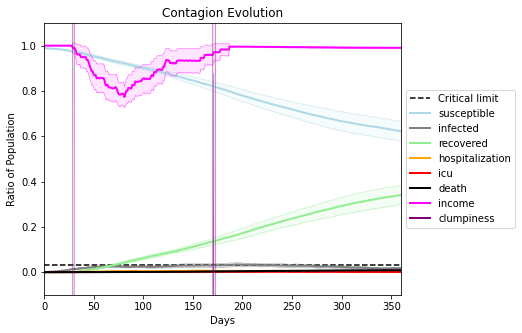

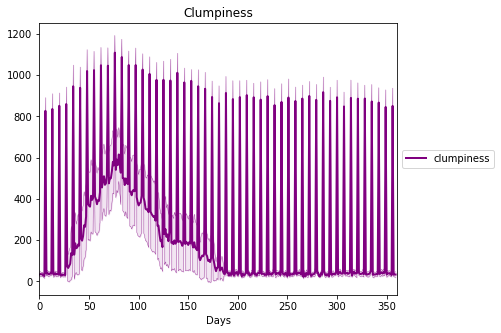

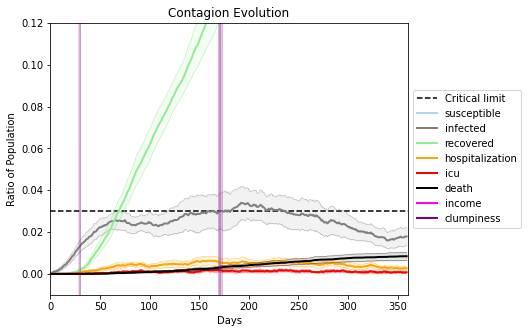

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7009, 2049, 118, 9317, 9627, 3525, 9669, 5226, 5925, 4077, 3117, 6767, 7166, 7367, 9001, 1898, 4958, 8295, 2191, 2874]
Average similarity between family members is 0.1624989287014981 at temperature -0.1
Average similarity between family and home is 0.9998586619922313 at temperature -1
Average similarity between students and their classroom is 0.1387376025540138 at temperature -0.1
Average classroom occupancy is 1.6704545454545454 and number classrooms is 176
Average similarity between workers is 0.15549496427628345 at temperature -0.1
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.21092559059870056 for kids: 0.2177288572604303
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.05516713562037002
avg restaurant similarity 0.04343106836600366
avg restaurant similarity 0.051646606009076765
avg restaurant similarity 0.0461289409189181
avg restaurant similarity 0.01185719273145474
avg restaurant similarity 0.04679528072904185
avg restaurant similarity 0.00495349447815333
avg restaurant similarity 0.05547823519917429
avg restaurant similarity 0.05261932703577179
avg restaurant similarity 0.0611741662607993
avg restaurant similarity 0.040359828164286356
avg restaurant similarity 0.03115051547733833
avg restaurant similarity -0.013340250953166414
avg restaurant similarity 0.07179840971823888
avg restaurant similarity 0.06777831850868657
avg restaurant similarity 0.06646270727964565
avg restaurant similarity 0.06826889359348963
avg restaurant similarity -0.0027770882096242694
avg restaurant similarity 0.04408902948128112
avg restaurant similarity 0.018491165763901134
avg restaurant similarity 0.040443547872673784
avg restaurant similarity 0

avg restaurant similarity 0.051727213717460856
avg restaurant similarity 0.04165506792010649
avg restaurant similarity 0.03454521615877816
avg restaurant similarity 0.06657496776988346
avg restaurant similarity 0.009660446522268327
avg restaurant similarity 0.023500276479222686
avg restaurant similarity 0.06584457174023481
avg restaurant similarity 0.03542426097609084
avg restaurant similarity 0.04807732847714339
avg restaurant similarity 0.05593773700797545
avg restaurant similarity 0.07779295451537646
avg restaurant similarity 0.062185358936470994
avg restaurant similarity 0.06897209331940118
avg restaurant similarity 0.10273930978782725
avg restaurant similarity 0.040891877277694146
avg restaurant similarity 0.09565699533728103
avg restaurant similarity 0.04959034119677587
avg restaurant similarity 0.005035375479136844
avg restaurant similarity 0.034654546762450056
avg restaurant similarity 0.021734697203625763
avg restaurant similarity 0.08083568477510482
avg restaurant similarity 

avg restaurant similarity -0.0005487981759012736
avg restaurant similarity 0.07923763577445742
avg restaurant similarity 0.08466500104506187
avg restaurant similarity 0.10167636040721201
avg restaurant similarity 0.0741629162978455
avg restaurant similarity 0.06705117804942139
Average similarity between family members is 0.1687311102837001 at temperature -0.1
Average similarity between family and home is 0.9998649174617196 at temperature -1
Average similarity between students and their classroom is 0.19082871900470733 at temperature -0.1
Average classroom occupancy is 1.5166666666666666 and number classrooms is 180
Average similarity between workers is 0.15767607779035084 at temperature -0.1
Average office occupancy is 3.388888888888889 and number offices is 198
Average friend similarity for adults: 0.20975184764703247 for kids: 0.22332597033456814
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.04611759707162479
avg restaurant similarity 0.09911348402104087
avg restaurant similarity 0.009159448784870561
avg restaurant similarity 0.07047620797912302
avg restaurant similarity 0.06703377877465126
avg restaurant similarity 0.03993073284434174
avg restaurant similarity 0.013820762802341175
avg restaurant similarity 0.015004951456022146
avg restaurant similarity 0.015968718562208772
avg restaurant similarity 0.06076137668977574
avg restaurant similarity 0.06448924647341903
avg restaurant similarity 0.06574047649685295
avg restaurant similarity 0.027767047758755395
avg restaurant similarity 0.0023725072196240093
avg restaurant similarity 0.03806624495718928
avg restaurant similarity 0.05115604998290877
avg restaurant similarity 0.027111144243565033
avg restaurant similarity 0.07010747601370022
avg restaurant similarity 0.10185866986309841
avg restaurant similarity 0.061002890433782146
avg restaurant similarity 0.0657862046711807
avg restaurant similarity 

avg restaurant similarity 0.10302965455199865
avg restaurant similarity 0.06159894396831325
avg restaurant similarity 0.029581375154510692
avg restaurant similarity 0.07244610800874007
avg restaurant similarity 0.07327412487890697
avg restaurant similarity 0.05425295848700069
avg restaurant similarity 0.07750550856378828
avg restaurant similarity 0.061079062524196905
avg restaurant similarity 0.03446541150501011
avg restaurant similarity 0.06643735069892232
avg restaurant similarity 0.07995331255576185
avg restaurant similarity 0.0756106746870472
avg restaurant similarity 0.05334222945252457
avg restaurant similarity 0.007598009491430546
avg restaurant similarity 0.07967244215469525
avg restaurant similarity 0.06744101751036685
avg restaurant similarity 0.05621632165516465
avg restaurant similarity 0.032806775196693984
avg restaurant similarity 0.04192320953501457
avg restaurant similarity 0.035299189878276814
avg restaurant similarity 0.08031210827823393
avg restaurant similarity 0.00

avg restaurant similarity 0.029329605600017468
avg restaurant similarity 0.05928863109828753
avg restaurant similarity 0.07377642456959375
avg restaurant similarity 0.012856664124753085
Average similarity between family members is 0.16585081622581446 at temperature -0.1
Average similarity between family and home is 0.9998455263245968 at temperature -1
Average similarity between students and their classroom is 0.16422074351362834 at temperature -0.1
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.16785590899562464 at temperature -0.1
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.2103926416449526 for kids: 0.2083555210618237
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.08028412698984058
avg restaurant similarity 0.06669811028729161
avg restaurant similarity 0.04851036964959988
avg restaurant similarity 0.05903442297363001
avg restaurant similarity 0.04754986022517068
avg restaurant similarity 0.07543451125133019
avg restaurant similarity 0.03875422289877424
avg restaurant similarity 0.040169159130844026
avg restaurant similarity 0.04855110704511406
avg restaurant similarity 0.06802058541278344
avg restaurant similarity -0.0009000032379093636
avg restaurant similarity 0.06767769481004095
avg restaurant similarity 0.029968336051033252
avg restaurant similarity 0.0998116529737944
avg restaurant similarity 0.07343823090176195
avg restaurant similarity 0.07434470101940424
avg restaurant similarity 0.035992166043746644
avg restaurant similarity 0.05603687810674554
avg restaurant similarity 0.022914029880628208
avg restaurant similarity 0.04677355980162612
avg restaurant similarity 0.01437090672415978
avg restaurant similarity 0.

avg restaurant similarity 0.0369516397710949
avg restaurant similarity 0.06287552741402096
avg restaurant similarity 0.03465643665653949
avg restaurant similarity 0.08558657435475217
avg restaurant similarity 0.022948096209031387
avg restaurant similarity 0.0237908096303964
avg restaurant similarity 0.03377110321055299
avg restaurant similarity 0.031912750549385895
avg restaurant similarity 0.07347583238976807
avg restaurant similarity 0.03176961521509339
avg restaurant similarity 0.0027435804271186692
avg restaurant similarity 0.0442283553116962
avg restaurant similarity -0.0004035044955990731
avg restaurant similarity 0.0437208957191835
avg restaurant similarity -6.654643959902469e-05
avg restaurant similarity 0.11195046570439324
avg restaurant similarity 0.0142657293139648
avg restaurant similarity 0.028134860123946347
avg restaurant similarity 0.03583659653204078
avg restaurant similarity 0.0015613043997110949
avg restaurant similarity 0.040598766558053924
avg restaurant similarity

avg restaurant similarity 0.0731222590856965
avg restaurant similarity 0.06998916538014775
avg restaurant similarity -0.0004525671163459137
avg restaurant similarity 0.05988448934338939
avg restaurant similarity 0.045929126938473466
avg restaurant similarity 0.0003094917924879679
Average similarity between family members is 0.12645567253887446 at temperature -0.1
Average similarity between family and home is 0.9998507205162319 at temperature -1
Average similarity between students and their classroom is 0.17172045259306623 at temperature -0.1
Average classroom occupancy is 1.5783783783783785 and number classrooms is 185
Average similarity between workers is 0.13452145395716672 at temperature -0.1
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.2043101991579745 for kids: 0.2136148614394535
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units

avg restaurant similarity 0.05754872483158307
avg restaurant similarity 0.004188728924339237
avg restaurant similarity 0.10778257705023575
avg restaurant similarity 0.01634884346607247
avg restaurant similarity -0.004633732888447639
avg restaurant similarity 0.03363602968511584
avg restaurant similarity 0.043226279704908235
avg restaurant similarity 0.04423983841740369
avg restaurant similarity 0.05597879556088627
avg restaurant similarity 0.010534566971319494
avg restaurant similarity 0.06844820662363539
avg restaurant similarity 0.09830830310437651
avg restaurant similarity 0.05042895992246566
avg restaurant similarity 0.02894956526554979
avg restaurant similarity -0.053522874783919275
avg restaurant similarity 0.019697336299671308
avg restaurant similarity 0.04462719401300363
avg restaurant similarity 0.07252672898144445
avg restaurant similarity 0.08022014549914125
avg restaurant similarity 0.11659471228488756
avg restaurant similarity 0.06045650942072958
avg restaurant similarity 

avg restaurant similarity 0.06992847659088598
avg restaurant similarity 0.0691521956796457
avg restaurant similarity 0.010551447210697793
avg restaurant similarity 0.03178243071213788
avg restaurant similarity 0.05326540290192328
avg restaurant similarity 0.027351895788747534
avg restaurant similarity 0.10523180345530297
avg restaurant similarity 0.04184136642376183
avg restaurant similarity 0.06260532083483797
avg restaurant similarity 0.05958049006041056
avg restaurant similarity 0.024290742746421103
avg restaurant similarity 0.09209202692978864
avg restaurant similarity 0.11523608666315283
avg restaurant similarity 0.04455258575431443
avg restaurant similarity 0.09937832374321685
avg restaurant similarity 0.08370797643563684
avg restaurant similarity 0.04316855218322517
avg restaurant similarity 0.08425216153837105
avg restaurant similarity 0.04377959141341335
avg restaurant similarity -0.008285559244138123
avg restaurant similarity 0.060231324002069625
avg restaurant similarity 0.1

avg restaurant similarity 0.023692387584050466
avg restaurant similarity 0.12137013774476145
avg restaurant similarity 0.042418325898117795
avg restaurant similarity 0.1364097323798316
avg restaurant similarity 0.054928606854518
avg restaurant similarity 0.021341831491453533
Average similarity between family members is 0.14315648359176192 at temperature -0.1
Average similarity between family and home is 0.9998513996441903 at temperature -1
Average similarity between students and their classroom is 0.1541765083878419 at temperature -0.1
Average classroom occupancy is 1.5956284153005464 and number classrooms is 183
Average similarity between workers is 0.1464596587539549 at temperature -0.1
Average office occupancy is 3.3248730964467006 and number offices is 197
Average friend similarity for adults: 0.21026609798801382 for kids: 0.20327376477278103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with

avg restaurant similarity 0.03834211322287458
avg restaurant similarity 0.06476513004619401
avg restaurant similarity 0.05053020070932952
avg restaurant similarity 0.0814206426238018
avg restaurant similarity 0.05865550258738507
avg restaurant similarity 0.07621399921563818
avg restaurant similarity 0.10026914077007704
avg restaurant similarity 0.08258406404917526
avg restaurant similarity 0.06823851940744055
avg restaurant similarity 0.06261356098191365
avg restaurant similarity 0.055200397924264746
avg restaurant similarity 0.0644006833243579
avg restaurant similarity 0.03880421173729622
avg restaurant similarity 0.07107929898950303
avg restaurant similarity 0.06345983088560814
avg restaurant similarity 0.03120751972672352
avg restaurant similarity 0.05339001614304963
avg restaurant similarity 0.0696974927172709
avg restaurant similarity 0.05206949879042432
avg restaurant similarity 0.0815682963862682
avg restaurant similarity 0.07038985457247407
avg restaurant similarity 0.054855661

avg restaurant similarity 0.09089507189183414
avg restaurant similarity 0.08721516551061774
avg restaurant similarity 0.09005185301498107
avg restaurant similarity 0.09771387840193377
avg restaurant similarity 0.06382689711862605
avg restaurant similarity 0.025432693047122208
avg restaurant similarity 0.0827265291681688
avg restaurant similarity 0.07115793707645744
avg restaurant similarity 0.034453073985221364
avg restaurant similarity 0.10189680767112731
avg restaurant similarity 0.0243562852443478
avg restaurant similarity 0.11566885539969957
avg restaurant similarity 0.03880505166640611
avg restaurant similarity 0.05925076736853432
avg restaurant similarity 0.08583689670820172
avg restaurant similarity 0.046947362309476916
avg restaurant similarity 0.017383545997823803
avg restaurant similarity 0.04464587357947075
avg restaurant similarity 0.0445910510134412
avg restaurant similarity 0.03291023035030963
avg restaurant similarity 0.04002304801750798
avg restaurant similarity 0.07302

avg restaurant similarity 0.08270027753114445
avg restaurant similarity 0.0858378562930618
avg restaurant similarity 0.03474672178872707
avg restaurant similarity 0.06617629777930747
Average similarity between family members is 0.14338574185133515 at temperature -0.1
Average similarity between family and home is 0.9998569737411345 at temperature -1
Average similarity between students and their classroom is 0.15918056877706924 at temperature -0.1
Average classroom occupancy is 1.6071428571428572 and number classrooms is 168
Average similarity between workers is 0.1516889434279526 at temperature -0.1
Average office occupancy is 3.2745098039215685 and number offices is 204
Average friend similarity for adults: 0.20732091516187323 for kids: 0.22089382396131413
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06953383406598923
avg restaurant similarity 0.06720913254810244
avg restaurant similarity 0.08930560994923263
avg restaurant similarity 0.09286506635108623
avg restaurant similarity 0.04896842936486688
avg restaurant similarity 0.04971791393923014
avg restaurant similarity 0.09751900514150257
avg restaurant similarity 0.09192985237321953
avg restaurant similarity 0.11943612729265557
avg restaurant similarity 0.06395745954513275
avg restaurant similarity 0.07264358188866624
avg restaurant similarity 0.050003495711339226
avg restaurant similarity 0.05609963186788921
avg restaurant similarity 0.0927910151202724
avg restaurant similarity 0.05889034206380524
avg restaurant similarity 0.0329108538684049
avg restaurant similarity 0.04510051445660248
avg restaurant similarity 0.0502750881538215
avg restaurant similarity 0.050761740296656505
avg restaurant similarity 0.07218861159234642
avg restaurant similarity 0.04061523709519685
avg restaurant similarity 0.0367464

avg restaurant similarity 0.05776011484459624
avg restaurant similarity 0.0894542512869005
avg restaurant similarity 0.06472694081715082
avg restaurant similarity 0.0790960964633378
avg restaurant similarity 0.09876303999005785
avg restaurant similarity 0.06924520709571336
avg restaurant similarity 0.05703699093633892
avg restaurant similarity 0.0941711798163979
avg restaurant similarity 0.085938226143484
avg restaurant similarity 0.11485194085898164
avg restaurant similarity 0.08802428500021804
avg restaurant similarity 0.09923609965952827
avg restaurant similarity 0.06610670585775215
avg restaurant similarity 0.13199945165342225
avg restaurant similarity 0.09300611342296014
avg restaurant similarity 0.07314767548630446
avg restaurant similarity 0.06339308571957572
avg restaurant similarity 0.10488534904060642
avg restaurant similarity 0.06438918735517006
avg restaurant similarity 0.05504028526862659
avg restaurant similarity 0.0757229917368314
avg restaurant similarity 0.053543135459

avg restaurant similarity 0.09426399205296297
avg restaurant similarity 0.08054858272191312
avg restaurant similarity 0.0842236917771132
Average similarity between family members is 0.15409568900114057 at temperature -0.1
Average similarity between family and home is 0.9998440170112199 at temperature -1
Average similarity between students and their classroom is 0.16542084927276482 at temperature -0.1
Average classroom occupancy is 1.6954022988505748 and number classrooms is 174
Average similarity between workers is 0.16508831951056901 at temperature -0.1
Average office occupancy is 3.3248730964467006 and number offices is 197
Average friend similarity for adults: 0.2174068422835812 for kids: 0.2183848573552457
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.0585022031636001
avg restaurant similarity 0.05401798629019598
avg restaurant similarity 0.06608906548600127
avg restaurant similarity 0.04739252884343756
avg restaurant similarity 0.0664706253495112
avg restaurant similarity 0.020513676577354548
avg restaurant similarity 0.03631866182012938
avg restaurant similarity 0.06489094957694369
avg restaurant similarity 0.0503783104991401
avg restaurant similarity 0.10222716114881594
avg restaurant similarity 0.05922464546361166
avg restaurant similarity 0.14830603761567338
avg restaurant similarity 0.049161098871747494
avg restaurant similarity 0.05703188450988917
avg restaurant similarity 0.09157171788671993
avg restaurant similarity 0.05790971777944325
avg restaurant similarity -0.02838878990863428
avg restaurant similarity 0.05303396128238899
avg restaurant similarity 0.0822643688043328
avg restaurant similarity 0.03271628923665854
avg restaurant similarity 0.04392403489989442
avg restaurant similarity 0.1095179

avg restaurant similarity 0.03793423730832685
avg restaurant similarity 0.02642439288503709
avg restaurant similarity 0.05623170735683878
avg restaurant similarity 0.07551197774813581
avg restaurant similarity 0.01787731453062803
avg restaurant similarity 0.04056064474564949
avg restaurant similarity 0.03692668840915341
avg restaurant similarity 0.05440701698941431
avg restaurant similarity 0.06882734751824429
avg restaurant similarity 0.12693135358416197
avg restaurant similarity 0.059757007302611284
avg restaurant similarity 0.011164407176893175
avg restaurant similarity 0.11592401753427975
avg restaurant similarity 0.07822355325987168
avg restaurant similarity 0.07728962400818802
avg restaurant similarity 0.07562975145867464
avg restaurant similarity 0.03280372783711178
avg restaurant similarity 0.042408838386476
avg restaurant similarity 0.08351113819706957
avg restaurant similarity 0.10856033387351016
avg restaurant similarity 0.0484284128644962
avg restaurant similarity 0.0376840

avg restaurant similarity 0.04040192898327738
avg restaurant similarity 0.09006089566446747
avg restaurant similarity 0.06786012586923146
avg restaurant similarity 0.04425862391812385
Average similarity between family members is 0.1431611396950324 at temperature -0.1
Average similarity between family and home is 0.9998489769553476 at temperature -1
Average similarity between students and their classroom is 0.16231033406165638 at temperature -0.1
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.14449753257931358 at temperature -0.1
Average office occupancy is 3.35678391959799 and number offices is 199
Average friend similarity for adults: 0.20610026479348742 for kids: 0.21997530095249107
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.07170338905820343
avg restaurant similarity 0.09396073558311191
avg restaurant similarity 0.09836789659288676
avg restaurant similarity 0.03808431234553174
avg restaurant similarity 0.07062235913353444
avg restaurant similarity 0.07567146530323596
avg restaurant similarity 0.038803693603335424
avg restaurant similarity 0.06948709156040145
avg restaurant similarity 0.06386783622268355
avg restaurant similarity 0.08893292204124995
avg restaurant similarity 0.07932007786973437
avg restaurant similarity 0.05496036640117367
avg restaurant similarity 0.05793952083076476
avg restaurant similarity 0.04554206591179359
avg restaurant similarity 0.09930277359612809
avg restaurant similarity 0.03634303116012489
avg restaurant similarity 0.043970075146192895
avg restaurant similarity 0.043455799257793366
avg restaurant similarity 0.08243282976441704
avg restaurant similarity 0.07921175078730057
avg restaurant similarity 0.06943122109064628
avg restaurant similarity 0.054

avg restaurant similarity 0.10022337645910329
avg restaurant similarity 0.09792971257944035
avg restaurant similarity 0.05937808010748553
avg restaurant similarity 0.06983067179093451
avg restaurant similarity 0.07610602219729898
avg restaurant similarity 0.09594214337504478
avg restaurant similarity 0.08218317055762461
avg restaurant similarity 0.09986210169603155
avg restaurant similarity 0.06535139682870282
avg restaurant similarity 0.06736085598789217
avg restaurant similarity 0.08217870967413914
avg restaurant similarity 0.07793828272901136
avg restaurant similarity 0.04529363713505697
avg restaurant similarity 0.08203237198638164
avg restaurant similarity 0.013596551720435685
avg restaurant similarity 0.11655814066103158
avg restaurant similarity 0.11524669841423311
avg restaurant similarity 0.07546204528861071
avg restaurant similarity 0.05330397160653903
avg restaurant similarity 0.029782284761848042
avg restaurant similarity 0.09066294416899551
avg restaurant similarity 0.0784

avg restaurant similarity 0.0641772875225971
avg restaurant similarity 0.04464320846701886
avg restaurant similarity 0.00929347075287832
avg restaurant similarity 0.05913388826633197
Average similarity between family members is 0.148490113429365 at temperature -0.1
Average similarity between family and home is 0.9998551812991837 at temperature -1
Average similarity between students and their classroom is 0.17947040054211869 at temperature -0.1
Average classroom occupancy is 1.6108108108108108 and number classrooms is 185
Average similarity between workers is 0.132425100138942 at temperature -0.1
Average office occupancy is 3.187192118226601 and number offices is 203
Average friend similarity for adults: 0.2113731670341904 for kids: 0.23561636917234932
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.08278557632699138
avg restaurant similarity 0.045026315664593
avg restaurant similarity 0.05676574983865685
avg restaurant similarity 0.08729064980846946
avg restaurant similarity 0.05635628731143177
avg restaurant similarity 0.08038953454271136
avg restaurant similarity 0.013417709044223465
avg restaurant similarity 0.0711400454272564
avg restaurant similarity 0.08958523515023388
avg restaurant similarity 0.08351004512251341
avg restaurant similarity 0.09724056941221702
avg restaurant similarity 0.025416265721519102
avg restaurant similarity 0.05507879458254949
avg restaurant similarity 0.07850664118828721
avg restaurant similarity 0.026318605276297213
avg restaurant similarity 0.04454396929022502
avg restaurant similarity 0.11746481136718684
avg restaurant similarity 0.03759985676298732
avg restaurant similarity 0.03465373625487477
avg restaurant similarity 0.08776079195434554
avg restaurant similarity 0.08434943566460128
avg restaurant similarity 0.065510

avg restaurant similarity 0.060127549841066594
avg restaurant similarity 0.08024338178765099
avg restaurant similarity 0.05689229611802962
avg restaurant similarity 0.056500200627817534
avg restaurant similarity 0.03584651093111284
avg restaurant similarity 0.04590927003618783
avg restaurant similarity 0.03901911013233308
avg restaurant similarity 0.05406259787041017
avg restaurant similarity 0.06178627436975793
avg restaurant similarity 0.036747351531662024
avg restaurant similarity 0.08177987873237266
avg restaurant similarity 0.06126166408357427
avg restaurant similarity 0.06488701846112854
avg restaurant similarity 0.04897940407430305
avg restaurant similarity 0.0459846845296499
avg restaurant similarity 0.05974865286271385
avg restaurant similarity 0.05203816180485461
avg restaurant similarity 0.08769033601076533
avg restaurant similarity 0.10331512146927378
avg restaurant similarity 0.08485934354091859
avg restaurant similarity 0.042730721309602274
avg restaurant similarity 0.069

avg restaurant similarity 0.058485287934321464
avg restaurant similarity 0.012455771389107632
avg restaurant similarity 0.08326536817995867
Average similarity between family members is 0.17787458458264285 at temperature -0.1
Average similarity between family and home is 0.9998503101114017 at temperature -1
Average similarity between students and their classroom is 0.17188747784304456 at temperature -0.1
Average classroom occupancy is 1.6666666666666667 and number classrooms is 174
Average similarity between workers is 0.1620655070926271 at temperature -0.1
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.21869977370432964 for kids: 0.21607866482527543
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.08556067273828757
avg restaurant similarity 0.10812969030065427
avg restaurant similarity 0.09248990204700908
avg restaurant similarity 0.10784917247882422
avg restaurant similarity 0.09609111676638249
avg restaurant similarity 0.0665812656320071
avg restaurant similarity 0.08337716262976222
avg restaurant similarity 0.0669936515130042
avg restaurant similarity 0.09078186245747397
avg restaurant similarity 0.11398458541220555
avg restaurant similarity 0.12672880445365947
avg restaurant similarity 0.08396273850851022
avg restaurant similarity 0.1098336310539241
avg restaurant similarity 0.10372859441946099
avg restaurant similarity 0.06731359324003822
avg restaurant similarity 0.08360123851861079
avg restaurant similarity 0.07173958844913969
avg restaurant similarity 0.06641649345940488
avg restaurant similarity 0.1312781835845446
avg restaurant similarity 0.08013890830396643
avg restaurant similarity 0.12257757332496948
avg restaurant similarity 0.0620768744

avg restaurant similarity 0.10990398826985902
avg restaurant similarity 0.15822719894092868
avg restaurant similarity 0.08998841030874635
avg restaurant similarity 0.06489926564751865
avg restaurant similarity 0.09322144248918295
avg restaurant similarity 0.08384699674318767
avg restaurant similarity 0.07733443438443971
avg restaurant similarity 0.0861914829605588
avg restaurant similarity 0.04767481209507738
avg restaurant similarity 0.1045835865942609
avg restaurant similarity 0.050557862692210756
avg restaurant similarity 0.08306776926610882
avg restaurant similarity 0.11539815987383177
avg restaurant similarity 0.08918310874232126
avg restaurant similarity 0.10377368001827682
avg restaurant similarity 0.11476132313746226
avg restaurant similarity 0.07976080640686743
avg restaurant similarity 0.0751370452038358
avg restaurant similarity 0.11295873194507487
avg restaurant similarity 0.08895540480812897
avg restaurant similarity 0.05885395763263864
avg restaurant similarity 0.13250807

avg restaurant similarity 0.08611067646161263
avg restaurant similarity 0.05637452053734015
Average similarity between family members is 0.14785171314745146 at temperature -0.1
Average similarity between family and home is 0.9998652957259809 at temperature -1
Average similarity between students and their classroom is 0.16171162490951008 at temperature -0.1
Average classroom occupancy is 1.6235955056179776 and number classrooms is 178
Average similarity between workers is 0.17627830092521835 at temperature -0.1
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 0.2066792476812703 for kids: 0.2030360374351795
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.07035997694980699
avg restaurant similarity 0.07268923709390392
avg restaurant similarity 0.0762053115130022
avg restaurant similarity 0.09706804764907387
avg restaurant similarity 0.0638875675193391
avg restaurant similarity 0.06852612070259365
avg restaurant similarity 0.022669132354321404
avg restaurant similarity 0.06377895020186529
avg restaurant similarity 0.13329452190521376
avg restaurant similarity 0.07899036621826089
avg restaurant similarity 0.04665734721645499
avg restaurant similarity 0.07396919053059287
avg restaurant similarity 0.05579132674295442
avg restaurant similarity 0.07155751156692285
avg restaurant similarity 0.09658775854986741
avg restaurant similarity 0.05787304751361003
avg restaurant similarity 0.06300844385239736
avg restaurant similarity 0.06814782672128261
avg restaurant similarity 0.07371183951102919
avg restaurant similarity 0.03408927911341284
avg restaurant similarity 0.08086214427787165
avg restaurant similarity 0.0816045

avg restaurant similarity 0.0494974586279999
avg restaurant similarity 0.06709168918165503
avg restaurant similarity 0.06306742050076156
avg restaurant similarity 0.10540051200768007
avg restaurant similarity 0.04667320362576639
avg restaurant similarity 0.04340360788359659
avg restaurant similarity 0.06168556871829767
avg restaurant similarity 0.10696083118304367
avg restaurant similarity 0.059442041868696234
avg restaurant similarity 0.11286021050169352
avg restaurant similarity 0.04663288425201101
avg restaurant similarity 0.05448808535071259
avg restaurant similarity 0.043435134483890504
avg restaurant similarity 0.1066979080298762
avg restaurant similarity 0.04256562235493744
avg restaurant similarity 0.04725048494497243
avg restaurant similarity 0.08332960319707429
avg restaurant similarity 0.02625180951238013
avg restaurant similarity 0.07882637570487656
avg restaurant similarity 0.05397015777231648
avg restaurant similarity 0.05981070473793389
avg restaurant similarity 0.032047

avg restaurant similarity 0.0833050751642349
avg restaurant similarity 0.07127407304920645
avg restaurant similarity 0.028455086728105396
avg restaurant similarity 0.10207875447430051
Average similarity between family members is 0.12221889824246142 at temperature -0.1
Average similarity between family and home is 0.9998716089029497 at temperature -1
Average similarity between students and their classroom is 0.14862972532444527 at temperature -0.1
Average classroom occupancy is 1.6574585635359116 and number classrooms is 181
Average similarity between workers is 0.14806008652563485 at temperature -0.1
Average office occupancy is 3.217821782178218 and number offices is 202
Average friend similarity for adults: 0.1999824179090078 for kids: 0.20923601746477363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06578293990526429
avg restaurant similarity 0.043627960808590605
avg restaurant similarity 0.10363916641903655
avg restaurant similarity 0.04116711132839494
avg restaurant similarity 0.059952784957225946
avg restaurant similarity 0.06441061630491737
avg restaurant similarity 0.05819573221297624
avg restaurant similarity 0.041173332976088
avg restaurant similarity 0.052299916694452324
avg restaurant similarity 0.08239956628230131
avg restaurant similarity 0.03628776815538641
avg restaurant similarity 0.047576532089709064
avg restaurant similarity 0.08615882603169672
avg restaurant similarity 0.07982344034470583
avg restaurant similarity 0.07411791327724286
avg restaurant similarity 0.05612953232670178
avg restaurant similarity 0.09275138349113836
avg restaurant similarity 0.03356794437055865
avg restaurant similarity 0.04344084716491724
avg restaurant similarity 0.07554311581444506
avg restaurant similarity 0.007814891718468345
avg restaurant similarity 0.037

avg restaurant similarity 0.06291425008692737
avg restaurant similarity 0.07358710117607278
avg restaurant similarity 0.04909737457550639
avg restaurant similarity 0.0143860831061218
avg restaurant similarity 0.05250589166034762
avg restaurant similarity 0.050180065646772784
avg restaurant similarity 0.053550730016353715
avg restaurant similarity 0.03021979764972504
avg restaurant similarity 0.0732283549576055
avg restaurant similarity 0.09510501209276861
avg restaurant similarity 0.07608579168818866
avg restaurant similarity 0.04616344097424402
avg restaurant similarity 0.0462498135952653
avg restaurant similarity 0.0645421707763162
avg restaurant similarity 0.05561714709353002
avg restaurant similarity 0.11587528497874275
avg restaurant similarity 0.09183453356235949
avg restaurant similarity 0.12097043761734332
avg restaurant similarity 0.00878449197146388
avg restaurant similarity 0.07763388707383402
avg restaurant similarity 0.04633729866015884
avg restaurant similarity 0.06839388

avg restaurant similarity 0.044348157642234265
avg restaurant similarity 0.02886419277062034
avg restaurant similarity 0.07182058335980887
avg restaurant similarity 0.07757222395227091
Average similarity between family members is 0.15846425795439276 at temperature -0.1
Average similarity between family and home is 0.9998592320911586 at temperature -1
Average similarity between students and their classroom is 0.1780648683128207 at temperature -0.1
Average classroom occupancy is 1.5865921787709498 and number classrooms is 179
Average similarity between workers is 0.16614098757485002 at temperature -0.1
Average office occupancy is 3.3316326530612246 and number offices is 196
Average friend similarity for adults: 0.2154514377411986 for kids: 0.22500441182934042
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.08150192577477887
avg restaurant similarity 0.04867697745674511
avg restaurant similarity 0.04500855002154349
avg restaurant similarity 0.04231576779786791
avg restaurant similarity 0.06098868453347989
avg restaurant similarity 0.016537603415436003
avg restaurant similarity 0.08012977438665099
avg restaurant similarity 0.03821869536760642
avg restaurant similarity 0.008506985814264966
avg restaurant similarity 0.017811941301275776
avg restaurant similarity 0.0035234592933102156
avg restaurant similarity 0.09424273054836296
avg restaurant similarity 0.07693294092793958
avg restaurant similarity 0.08017942208138962
avg restaurant similarity 0.06236290216196378
avg restaurant similarity 0.04074182650133956
avg restaurant similarity 0.05305939549798437
avg restaurant similarity 0.006587170192960864
avg restaurant similarity 0.0006292201701516152
avg restaurant similarity 0.017314289007119812
avg restaurant similarity 0.0026943425675747005
avg restaurant similari

avg restaurant similarity 0.02997963513806726
avg restaurant similarity -0.0021171208556655737
avg restaurant similarity 0.09628822444254193
avg restaurant similarity 0.05366825333765609
avg restaurant similarity 0.0781753366504975
avg restaurant similarity 0.07455720996517641
avg restaurant similarity 0.05743836311336669
avg restaurant similarity 0.014090769215728686
avg restaurant similarity 0.08254498274760558
avg restaurant similarity 0.05883295344693503
avg restaurant similarity 0.07159819793012574
avg restaurant similarity 0.0730493459119318
avg restaurant similarity 0.09355250440360799
avg restaurant similarity 0.05272264825247561
avg restaurant similarity 0.01540264837257184
avg restaurant similarity 0.05664291137616235
avg restaurant similarity 0.020738986784555852
avg restaurant similarity 0.07394907054692412
avg restaurant similarity 0.051262516199031855
avg restaurant similarity 0.07351154896615159
avg restaurant similarity 0.008723581245536927
avg restaurant similarity 0.0

avg restaurant similarity 0.07978716974160942
avg restaurant similarity 0.02839545937393065
avg restaurant similarity 0.08955249150651197
avg restaurant similarity 0.07270642831934541
avg restaurant similarity 0.06159125538535474
avg restaurant similarity 0.09252469569979763
Average similarity between family members is 0.16314865816877014 at temperature -0.1
Average similarity between family and home is 0.99985938589747 at temperature -1
Average similarity between students and their classroom is 0.15221097870875475 at temperature -0.1
Average classroom occupancy is 1.5511363636363635 and number classrooms is 176
Average similarity between workers is 0.14270205327775703 at temperature -0.1
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.20380575672545617 for kids: 0.21822991775715606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with

avg restaurant similarity 0.046177951097452076
avg restaurant similarity 0.03884115499193787
avg restaurant similarity 0.02856228894564421
avg restaurant similarity 0.035568307904102446
avg restaurant similarity 0.02725556735883942
avg restaurant similarity -0.02366607596267108
avg restaurant similarity -0.0019938535535846953
avg restaurant similarity 0.0010800222604271962
avg restaurant similarity 0.0003560850580322499
avg restaurant similarity 0.029586084027728162
avg restaurant similarity 0.054691397370958246
avg restaurant similarity 0.04892230019303175
avg restaurant similarity 0.08971121323931847
avg restaurant similarity -0.0035341810192140327
avg restaurant similarity 0.07317979291145917
avg restaurant similarity 0.017575647972663904
avg restaurant similarity 0.06743329522042087
avg restaurant similarity 0.006518264451030086
avg restaurant similarity 0.0007388570089018048
avg restaurant similarity 0.058939568299689764
avg restaurant similarity 0.04451044489712179
avg restaurant

avg restaurant similarity 0.023222385698939772
avg restaurant similarity 0.06348394894934692
avg restaurant similarity 0.02902429175351403
avg restaurant similarity -0.0009100695944259775
avg restaurant similarity 0.04242819202950563
avg restaurant similarity 0.08618452937220127
avg restaurant similarity 0.08223067751449092
avg restaurant similarity 0.02101067927725816
avg restaurant similarity 0.05944285351112395
avg restaurant similarity 0.006814429391833745
avg restaurant similarity 0.1069581386801643
avg restaurant similarity 0.0721542024107363
avg restaurant similarity 0.1064379397323242
avg restaurant similarity 0.053908650564920634
avg restaurant similarity 0.014352395109070236
avg restaurant similarity 0.06394598381787107
avg restaurant similarity -0.006319873036405758
avg restaurant similarity 0.08704789907581915
avg restaurant similarity 0.09702500034999863
avg restaurant similarity 0.06175801768944143
avg restaurant similarity 0.044372319862603635
avg restaurant similarity 0

avg restaurant similarity 0.03971990243084869
avg restaurant similarity 0.05306364407357442
avg restaurant similarity 0.04315739591884525
avg restaurant similarity 0.044143400995156325
avg restaurant similarity 0.039883930164294826
avg restaurant similarity -0.0040088256283928704
Average similarity between family members is 0.16362702858942424 at temperature -0.1
Average similarity between family and home is 0.9998526656845429 at temperature -1
Average similarity between students and their classroom is 0.1853049641295271 at temperature -0.1
Average classroom occupancy is 1.6057142857142856 and number classrooms is 175
Average similarity between workers is 0.1578538896845378 at temperature -0.1
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.21496548836164805 for kids: 0.21958576203983904
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units

avg restaurant similarity 0.03338098579352012
avg restaurant similarity 0.016823908807331
avg restaurant similarity 0.07565616242198774
avg restaurant similarity 0.04185274615985031
avg restaurant similarity 0.07762756938715977
avg restaurant similarity 0.04319497291075569
avg restaurant similarity 0.03096948736009026
avg restaurant similarity 0.007040007787994008
avg restaurant similarity 0.02104593085614516
avg restaurant similarity 0.11936246664016785
avg restaurant similarity 0.03582022436069184
avg restaurant similarity 0.07284438932418548
avg restaurant similarity 0.11246665295982791
avg restaurant similarity 0.04336575665761191
avg restaurant similarity 0.06756277282070004
avg restaurant similarity 0.03836971814962311
avg restaurant similarity 0.07234330989920386
avg restaurant similarity 0.0776408125883202
avg restaurant similarity 0.03829059015972093
avg restaurant similarity 0.0805946544553667
avg restaurant similarity 0.056233137262031906
avg restaurant similarity 0.06363712

avg restaurant similarity 0.07773155757475074
avg restaurant similarity 0.06598631773676147
avg restaurant similarity 0.10175834929444887
avg restaurant similarity 0.07740156449310293
avg restaurant similarity 0.042078617961918086
avg restaurant similarity 0.08925171733583996
avg restaurant similarity 0.056064181854569274
avg restaurant similarity 0.0806609150636615
avg restaurant similarity 0.09309455977390685
avg restaurant similarity 0.05430632872865491
avg restaurant similarity 0.07787803175641289
avg restaurant similarity 0.097900605457912
avg restaurant similarity 0.08001568821319513
avg restaurant similarity 0.09236575931655425
avg restaurant similarity 0.10152333014637178
avg restaurant similarity 0.04922706396873637
avg restaurant similarity 0.07452794183712182
avg restaurant similarity 0.08973208598272919
avg restaurant similarity 0.06947659983785812
avg restaurant similarity 0.009248778038027955
avg restaurant similarity 0.05937707646792795
avg restaurant similarity 0.099315

avg restaurant similarity 0.07027167225546818
avg restaurant similarity 0.09966977623729051
avg restaurant similarity 0.08334540939731763
avg restaurant similarity 0.083023756064789
Average similarity between family members is 0.1789765782332512 at temperature -0.1
Average similarity between family and home is 0.999857332806452 at temperature -1
Average similarity between students and their classroom is 0.16805176095279312 at temperature -0.1
Average classroom occupancy is 1.6229508196721312 and number classrooms is 183
Average similarity between workers is 0.16126217781933094 at temperature -0.1
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.21259413092024929 for kids: 0.20286503435187675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.058067190313845864
avg restaurant similarity 0.00655439404941331
avg restaurant similarity 0.042164594791481616
avg restaurant similarity 0.05245957518864866
avg restaurant similarity 0.05827826328524538
avg restaurant similarity 0.03277662441179974
avg restaurant similarity 0.06605115208088458
avg restaurant similarity 0.06566602328324757
avg restaurant similarity 0.036531846435329515
avg restaurant similarity 0.01852265307811808
avg restaurant similarity 0.03070153528181447
avg restaurant similarity 0.10154255666604683
avg restaurant similarity 0.0928307083958156
avg restaurant similarity -0.023432737504204087
avg restaurant similarity 0.09430260863287587
avg restaurant similarity 0.003935516302226592
avg restaurant similarity 0.02503785030657908
avg restaurant similarity 0.0014078026148244172
avg restaurant similarity 0.09258322433317916
avg restaurant similarity 0.021496395673627235
avg restaurant similarity 0.055150077375729044
avg restaurant similarity

avg restaurant similarity 0.02048346418886566
avg restaurant similarity 0.0757801815361337
avg restaurant similarity 0.0395499110625073
avg restaurant similarity 0.035648934666853385
avg restaurant similarity 0.12609097481520687
avg restaurant similarity -0.012731585599538303
avg restaurant similarity 0.042313845027672686
avg restaurant similarity 0.102929973336124
avg restaurant similarity 0.016699576820059018
avg restaurant similarity 0.041360981181323045
avg restaurant similarity 0.04650454104439552
avg restaurant similarity 0.0310209066017139
avg restaurant similarity 0.021052003896220188
avg restaurant similarity 0.00961783554812515
avg restaurant similarity 0.09459973058671757
avg restaurant similarity 0.01662728667223651
avg restaurant similarity 0.04609384465566379
avg restaurant similarity 0.04437876760116716
avg restaurant similarity 0.07648363739798505
avg restaurant similarity 0.01501874138670326
avg restaurant similarity 0.03983452488215287
avg restaurant similarity 0.0744

avg restaurant similarity 0.0012618349178197365
avg restaurant similarity 0.04133806848587763
avg restaurant similarity -0.03318422454523524
avg restaurant similarity 0.04207616805996967
avg restaurant similarity 0.05628576630475411
Average similarity between family members is 0.16122013506358637 at temperature -0.1
Average similarity between family and home is 0.9998473796153653 at temperature -1
Average similarity between students and their classroom is 0.1696399182632212 at temperature -0.1
Average classroom occupancy is 1.6758241758241759 and number classrooms is 182
Average similarity between workers is 0.15852236695495903 at temperature -0.1
Average office occupancy is 3.147783251231527 and number offices is 203
Average friend similarity for adults: 0.20611033394734446 for kids: 0.2085833971802198
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allo

avg restaurant similarity 0.0920545523307554
avg restaurant similarity 0.07312228814183706
avg restaurant similarity 0.07412342929159127
avg restaurant similarity 0.05523910258078703
avg restaurant similarity 0.05645161396088118
avg restaurant similarity 0.05693408125227843
avg restaurant similarity 0.07475493878729877
avg restaurant similarity 0.06253053645700567
avg restaurant similarity 0.07907181494204421
avg restaurant similarity 0.06256448458388396
avg restaurant similarity 0.07374951221001491
avg restaurant similarity 0.1008695588167202
avg restaurant similarity 0.08570331083198224
avg restaurant similarity 0.012607753749134426
avg restaurant similarity 0.08789296763421622
avg restaurant similarity 0.06638500414095073
avg restaurant similarity 0.053411825165616086
avg restaurant similarity 0.00383414583766276
avg restaurant similarity 0.06550164432703445
avg restaurant similarity 0.03460906366053853
avg restaurant similarity 0.07619963538751351
avg restaurant similarity 0.061901

avg restaurant similarity 0.10257874546883877
avg restaurant similarity 0.04068561203303104
avg restaurant similarity 0.1607214959655515
avg restaurant similarity 0.044643833282971446
avg restaurant similarity 0.07491917596438429
avg restaurant similarity 0.06507674884123751
avg restaurant similarity 0.12850817120385533
avg restaurant similarity 0.05747277336758772
avg restaurant similarity 0.07013367904061701
avg restaurant similarity 0.09602937918199092
avg restaurant similarity 0.08303414784596257
avg restaurant similarity 0.05271952763197551
avg restaurant similarity 0.07256872191125767
avg restaurant similarity 0.05129405216394
avg restaurant similarity 0.047450714624354226
avg restaurant similarity 0.0939166611499821
avg restaurant similarity 0.05143877277999231
avg restaurant similarity 0.06833664328873074
avg restaurant similarity 0.07262499903563328
avg restaurant similarity 0.13084863106272002
avg restaurant similarity 0.07102885320270147
avg restaurant similarity 0.107511128

avg restaurant similarity 0.06751530876585642
avg restaurant similarity 0.06708605535897363
avg restaurant similarity 0.06907566088082631
Average similarity between family members is 0.15240369430686612 at temperature -0.1
Average similarity between family and home is 0.9998483974827724 at temperature -1
Average similarity between students and their classroom is 0.16290369018761375 at temperature -0.1
Average classroom occupancy is 1.6368421052631579 and number classrooms is 190
Average similarity between workers is 0.14195032467976845 at temperature -0.1
Average office occupancy is 3.1930693069306932 and number offices is 202
Average friend similarity for adults: 0.20632648843883186 for kids: 0.20444264186528527
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.016355782200632742
avg restaurant similarity 0.06864760256272635
avg restaurant similarity 0.0631271806366455
avg restaurant similarity 0.04264897024820628
avg restaurant similarity 0.03621482641631453
avg restaurant similarity 0.0482729193575034
avg restaurant similarity 0.03587913523059927
avg restaurant similarity 0.05680642118488932
avg restaurant similarity 0.05957430395179889
avg restaurant similarity 0.05477806872537443
avg restaurant similarity 0.05914168427113348
avg restaurant similarity 0.07584927461941818
avg restaurant similarity 0.039075468122162865
avg restaurant similarity 0.09074780061723146
avg restaurant similarity 0.061341706622068816
avg restaurant similarity 0.05848368120338228
avg restaurant similarity 0.0979797706991045
avg restaurant similarity 0.04908257208204482
avg restaurant similarity 0.017655132343423266
avg restaurant similarity 0.06952270803202193
avg restaurant similarity 0.05092910904688928
avg restaurant similarity 0.04462

avg restaurant similarity 0.061692556707612936
avg restaurant similarity 0.05327197389664766
avg restaurant similarity 0.09800285359956867
avg restaurant similarity 0.05468202504211512
avg restaurant similarity 0.0336437494615583
avg restaurant similarity 0.09527744150579466
avg restaurant similarity 0.1405430983606285
avg restaurant similarity 0.047416417356065776
avg restaurant similarity 0.0628289295354247
avg restaurant similarity 0.04539343918262944
avg restaurant similarity 0.06757406915011484
avg restaurant similarity 0.06557178731637829
avg restaurant similarity 0.059493953271490076
avg restaurant similarity 0.06651883358332003
avg restaurant similarity 0.042564181081603286
avg restaurant similarity 0.06982387723442776
avg restaurant similarity 0.07861109864460582
avg restaurant similarity 0.07136009232189078
avg restaurant similarity 0.10492518116902783
avg restaurant similarity 0.08327907472065085
avg restaurant similarity 0.0725939664002236
avg restaurant similarity 0.067968

avg restaurant similarity 0.09060326220291252
avg restaurant similarity 0.04291617020972305
avg restaurant similarity 0.08515296181143493
avg restaurant similarity 0.05808215617294808
Average similarity between family members is 0.1499149932153944 at temperature -0.1
Average similarity between family and home is 0.9998540428009696 at temperature -1
Average similarity between students and their classroom is 0.15574159251926095 at temperature -0.1
Average classroom occupancy is 1.5923913043478262 and number classrooms is 184
Average similarity between workers is 0.1529218884875598 at temperature -0.1
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.2043014305714251 for kids: 0.2058820843889314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.06980106298579052
avg restaurant similarity 0.047288045107141685
avg restaurant similarity 0.06535270573379404
avg restaurant similarity 0.0393915435077156
avg restaurant similarity 0.07473293563728386
avg restaurant similarity 0.050697846245941904
avg restaurant similarity 0.08821922916721095
avg restaurant similarity 0.02298796234787709
avg restaurant similarity 0.0598948739393642
avg restaurant similarity 0.033279292878106624
avg restaurant similarity 0.08350878620514622
avg restaurant similarity 0.044259602270979345
avg restaurant similarity 0.057061654976892355
avg restaurant similarity 0.03467643606642291
avg restaurant similarity 0.034358832849571135
avg restaurant similarity 0.09814117701025335
avg restaurant similarity 0.02997869097323243
avg restaurant similarity 0.07609558513362669
avg restaurant similarity 0.0836900621569856
avg restaurant similarity 0.06256686919359357
avg restaurant similarity 0.07228047104417411
avg restaurant similarity 0.055

avg restaurant similarity 0.07540825429275212
avg restaurant similarity 0.07136975027419895
avg restaurant similarity 0.0782910787301648
avg restaurant similarity 0.06377032697675732
avg restaurant similarity 0.0924784033208004
avg restaurant similarity 0.044000027131704915
avg restaurant similarity 0.008494851653804203
avg restaurant similarity 0.047965998808834454
avg restaurant similarity 0.08776051081876936
avg restaurant similarity 0.059851773556902396
avg restaurant similarity 0.0658678755002368
avg restaurant similarity 0.09120154498131473
avg restaurant similarity 0.07603030176936239
avg restaurant similarity 0.04316665673229926
avg restaurant similarity 0.09291605259835743
avg restaurant similarity 0.09597217460695913
avg restaurant similarity 0.0719645088046478
avg restaurant similarity 0.08665807572350613
avg restaurant similarity 0.03968446657266926
avg restaurant similarity 0.05844102793960522
avg restaurant similarity 0.031775438045722554
avg restaurant similarity 0.03851

avg restaurant similarity 0.025286311362912255
avg restaurant similarity 0.05495085710742836
avg restaurant similarity 0.059900015328369687
avg restaurant similarity 0.07587712642261764
Average similarity between family members is 0.15631257936663748 at temperature -0.1
Average similarity between family and home is 0.9998541507965983 at temperature -1
Average similarity between students and their classroom is 0.14645962157960143 at temperature -0.1
Average classroom occupancy is 1.580110497237569 and number classrooms is 181
Average similarity between workers is 0.1610979347607808 at temperature -0.1
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.2018283567766086 for kids: 0.21088495781839717
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.03882019052561997
avg restaurant similarity 0.02897080676020934
avg restaurant similarity 0.035893033629011487
avg restaurant similarity 0.05067410412759096
avg restaurant similarity 0.08007537420386124
avg restaurant similarity 0.08030740707839357
avg restaurant similarity 0.06661944447041279
avg restaurant similarity 0.06354944403806985
avg restaurant similarity 0.04845144649763327
avg restaurant similarity 0.05974436854820345
avg restaurant similarity 0.10194830454034505
avg restaurant similarity 0.10096460902943544
avg restaurant similarity 0.04137995207549108
avg restaurant similarity 0.028914972402134274
avg restaurant similarity 0.07823415813287475
avg restaurant similarity 0.02822241683381391
avg restaurant similarity 0.12956602176816964
avg restaurant similarity 0.024603228929381268
avg restaurant similarity 0.06582983907817239
avg restaurant similarity -0.003633052963144426
avg restaurant similarity 0.04130152428222301
avg restaurant similarity 0.0

avg restaurant similarity 0.057430738741466356
avg restaurant similarity 0.06588945476830314
avg restaurant similarity 0.08865504595020607
avg restaurant similarity 0.04305145104660006
avg restaurant similarity 0.031367682752763755
avg restaurant similarity 0.03179003619530883
avg restaurant similarity 0.05620460369685986
avg restaurant similarity 0.13701935317379443
avg restaurant similarity 0.011344854574097871
avg restaurant similarity 0.055623265481036833
avg restaurant similarity 0.058339719954306125
avg restaurant similarity 0.07833960657390901
avg restaurant similarity 0.08847094293341481
avg restaurant similarity 0.09489052468350771
avg restaurant similarity 0.04752312427765011
avg restaurant similarity 0.017556125602132308
avg restaurant similarity 0.09220263074768612
avg restaurant similarity 0.06815162586039335
avg restaurant similarity 0.03343741253513268
avg restaurant similarity 0.04228327388394599
avg restaurant similarity 0.014205806632322987
avg restaurant similarity 0

avg restaurant similarity 0.0453278104760069
avg restaurant similarity 0.04925706887365583
avg restaurant similarity 0.11580513657084152
avg restaurant similarity 0.00492030976393295
using average of time series:
stats on susceptible:
data: [0.7575500000000001, 0.8055305555555555, 0.8145548895548895, 0.7817861111111111, 0.9067500000000001, 0.7472249999999999, 0.7851111111111111, 0.8905527777777777, 0.7544833333333334, 0.7417083333333333, 0.7585583333333333, 0.7203657453657453, 0.8397427367487247, 0.8307555555555556, 0.8932222222222223, 0.8101277777777777, 0.7149961149961149, 0.8201611111111112, 0.8129777777777778, 0.8392738451312728]
min:
0.7149961149961149
max:
0.9067500000000001
std:
0.05437652484986618
mean:
0.8012716665898374
median:
0.8078291666666666
95% confidence interval for the mean:
(0.7751615465847493,0.8273817865949255)
using average of time series:
stats on infected:
data: [0.031955555555555556, 0.02342777777777778, 0.024911199911199913, 0.02677777777777778, 0.01319166666

(<function dict.items>, <function dict.items>, <function dict.items>)

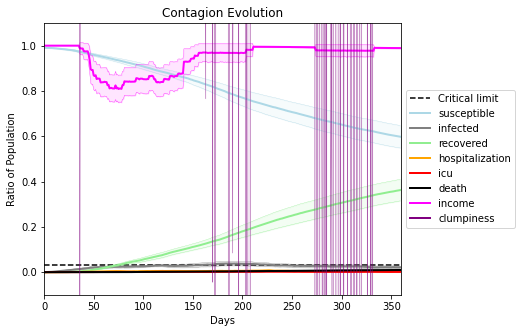

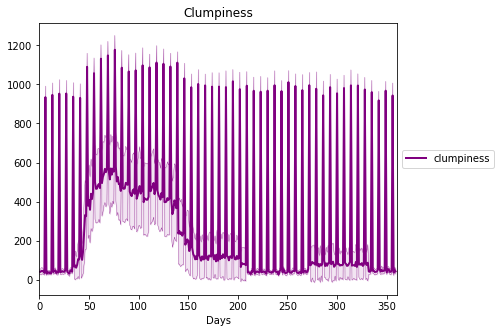

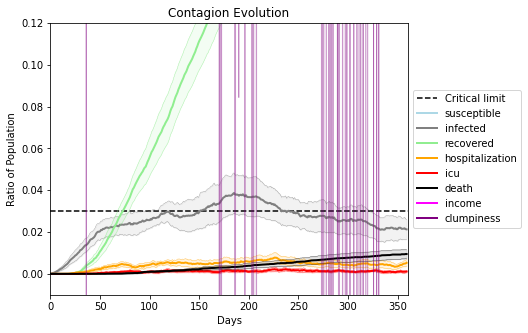

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9031, 4325, 5403, 476, 1510, 5642, 2698, 2154, 4401, 5704, 2933, 5775, 9380, 7867, 5435, 3802, 5450, 6411, 4701, 9821]
Average similarity between family members is 0.17597389571241853 at temperature 0
Average similarity between family and home is 0.9998586113544188 at temperature -1
Average similarity between students and their classroom is 0.12973879250514667 at temperature 0
Average classroom occupancy is 1.6271186440677967 and number classrooms is 177
Average similarity between workers is 0.15147092790318065 at temperature 0
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.20392768627632385 for kids: 0.2115343247267792
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.03850698326007436
avg restaurant similarity 0.04467767589899023
avg restaurant similarity 0.05561054801549847
avg restaurant similarity 0.0021244666744463596
avg restaurant similarity 0.03321569281773307
avg restaurant similarity 0.034363407237929605
avg restaurant similarity 0.060764498204046814
avg restaurant similarity 0.07211354595662975
avg restaurant similarity 0.09242632840104462
avg restaurant similarity 0.031134712130502045
avg restaurant similarity 0.016139015313759105
avg restaurant similarity 0.01914625467646244
avg restaurant similarity -0.00592302782328575
avg restaurant similarity 0.012030871502954564
avg restaurant similarity 0.048176967511001687
avg restaurant similarity 0.040120120394984825
avg restaurant similarity 0.023273387459425088
avg restaurant similarity 0.026001293123092264
avg restaurant similarity 0.011925430945162385
avg restaurant similarity 0.032587088812317866
avg restaurant similarity 0.07225168125605805
avg restaurant simil

avg restaurant similarity 0.049636604167814236
avg restaurant similarity 0.02851359212920458
avg restaurant similarity 0.02644379170868145
avg restaurant similarity 0.022678113281334712
avg restaurant similarity 0.019231929403933156
avg restaurant similarity 0.05549662440310574
avg restaurant similarity 0.022194827039863824
avg restaurant similarity -0.009501924818958188
avg restaurant similarity 0.09783602058598316
avg restaurant similarity 0.08365985909681838
avg restaurant similarity 0.07224785076411801
avg restaurant similarity 0.08133492355663928
avg restaurant similarity -0.026449099311201624
avg restaurant similarity 0.005707055668956362
avg restaurant similarity 0.030875026879803858
avg restaurant similarity 0.06018364985861215
avg restaurant similarity 0.051530906086933996
avg restaurant similarity 0.06816051788714053
avg restaurant similarity 0.07792703784396873
avg restaurant similarity 0.06436069661615743
avg restaurant similarity 0.07913479946050771
avg restaurant similari

avg restaurant similarity -0.0037913294094566214
avg restaurant similarity 0.057042558536171475
avg restaurant similarity 0.05232953698235183
avg restaurant similarity 0.0515500483828006
avg restaurant similarity 0.08110816836781545
avg restaurant similarity -0.011413005991634317
avg restaurant similarity 0.07441859894673065
Average similarity between family members is 0.14104630640072013 at temperature 0
Average similarity between family and home is 0.999865358079959 at temperature -1
Average similarity between students and their classroom is 0.1546560199504482 at temperature 0
Average classroom occupancy is 1.582857142857143 and number classrooms is 175
Average similarity between workers is 0.15327226516621362 at temperature 0
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.19963462190930834 for kids: 0.20634629193363618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capac

avg restaurant similarity 0.07111448370598218
avg restaurant similarity 0.039339188048236974
avg restaurant similarity 0.08680296225492372
avg restaurant similarity -0.00604340678422688
avg restaurant similarity 0.09451703557345321
avg restaurant similarity 0.06062371447767464
avg restaurant similarity 0.025780825761752564
avg restaurant similarity 0.10218642222128516
avg restaurant similarity 0.07464866712278116
avg restaurant similarity 0.027340311153557718
avg restaurant similarity 0.11046087945058919
avg restaurant similarity 0.0927995531370453
avg restaurant similarity 0.08338472280217823
avg restaurant similarity 0.09442407075710009
avg restaurant similarity 0.058112968252108994
avg restaurant similarity 0.026453103069159604
avg restaurant similarity 0.054169609601698185
avg restaurant similarity 0.08583726254424155
avg restaurant similarity 0.0718005023402886
avg restaurant similarity 0.05814878156750082
avg restaurant similarity 0.07196512497082355
avg restaurant similarity 0.0

avg restaurant similarity 0.07086244933997732
avg restaurant similarity 0.03344668109223026
avg restaurant similarity -0.0010350667486754815
avg restaurant similarity 0.042381486441891957
avg restaurant similarity 0.07201511479946777
avg restaurant similarity 0.12732247716740716
avg restaurant similarity 0.12457234579410789
avg restaurant similarity 0.07688984161105096
avg restaurant similarity 0.0763993161245532
avg restaurant similarity 0.05339687356309929
avg restaurant similarity 0.08852716424799305
avg restaurant similarity 0.039806519352434726
avg restaurant similarity 0.10883346133754271
avg restaurant similarity 0.02820768981589453
avg restaurant similarity 0.07433569876171768
avg restaurant similarity 0.06396702742201384
avg restaurant similarity 0.10185726812413357
avg restaurant similarity 0.04964666023566918
avg restaurant similarity 0.09993085538652163
avg restaurant similarity 0.023251836144708642
avg restaurant similarity 0.09722946919534593
avg restaurant similarity 0.0

avg restaurant similarity 0.07765404524224226
avg restaurant similarity 0.04919683584467737
avg restaurant similarity 0.06358456651942627
avg restaurant similarity 0.09342499965164015
Average similarity between family members is 0.14868664393159864 at temperature 0
Average similarity between family and home is 0.9998468992921847 at temperature -1
Average similarity between students and their classroom is 0.15943567846112258 at temperature 0
Average classroom occupancy is 1.5414364640883977 and number classrooms is 181
Average similarity between workers is 0.1699984325035533 at temperature 0
Average office occupancy is 3.2401960784313726 and number offices is 204
Average friend similarity for adults: 0.21193473346276134 for kids: 0.21409153909625064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 24 people.
Total of 24 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.022759232605251437
avg restaurant similarity 0.08996904250934702
avg restaurant similarity 0.06466583296872681
avg restaurant similarity 0.0664778820028047
avg restaurant similarity 0.0706760230755731
avg restaurant similarity 0.031195627574022066
avg restaurant similarity 0.047689380329490175
avg restaurant similarity 0.03648337574007425
avg restaurant similarity 0.03003793511272772
avg restaurant similarity 0.02083019174731208
avg restaurant similarity 0.023384074297674334
avg restaurant similarity 0.06861465493417898
avg restaurant similarity 0.05374118994810728
avg restaurant similarity 0.03125043283827613
avg restaurant similarity 0.06473273694582765
avg restaurant similarity 0.037463424370099425
avg restaurant similarity 0.09722011918712484
avg restaurant similarity 0.0148350307169274
avg restaurant similarity 0.03766129737968465
avg restaurant similarity 0.06824008042782652
avg restaurant similarity 0.04729480034788263
avg restaurant similarity 0.0436

avg restaurant similarity 0.051599830994899704
avg restaurant similarity 0.06861797176329308
avg restaurant similarity 0.07227713150059466
avg restaurant similarity 0.12443847180044043
avg restaurant similarity 0.054526430972212866
avg restaurant similarity 0.05569690256502698
avg restaurant similarity 0.03503121857841289
avg restaurant similarity 0.04389008514567724
avg restaurant similarity 0.06546064393085121
avg restaurant similarity 0.09032523926904108
avg restaurant similarity 0.09154038043243236
avg restaurant similarity 0.07436790454426868
avg restaurant similarity 0.007687446272863899
avg restaurant similarity 0.10541267248580792
avg restaurant similarity 0.04313983262661253
avg restaurant similarity 0.048076704253987496
avg restaurant similarity 0.044560483047377086
avg restaurant similarity 0.001027959424855483
avg restaurant similarity 0.04688114578535411
avg restaurant similarity 0.05624176521522153
avg restaurant similarity 0.08722981012272189
avg restaurant similarity 0.

avg restaurant similarity 0.07516516223675662
avg restaurant similarity 0.0962381985923342
avg restaurant similarity 0.0587348263731967
avg restaurant similarity 0.04207753155987073
Average similarity between family members is 0.1697083632931867 at temperature 0
Average similarity between family and home is 0.9998499107863391 at temperature -1
Average similarity between students and their classroom is 0.18994040624732106 at temperature 0
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.16131632237948967 at temperature 0
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.2020582682078855 for kids: 0.21875948780977006
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.054356072594922644
avg restaurant similarity 0.04399065632753118
avg restaurant similarity 0.06282869702392145
avg restaurant similarity 0.05793644395541914
avg restaurant similarity 0.021633067003177613
avg restaurant similarity 0.06855477459348219
avg restaurant similarity 0.0658482389003468
avg restaurant similarity 0.08332003643763071
avg restaurant similarity 0.08321278288042644
avg restaurant similarity 0.06946202040975928
avg restaurant similarity 0.045554138211947794
avg restaurant similarity 0.04717167295068189
avg restaurant similarity 0.08024470019593218
avg restaurant similarity 0.09254358210932671
avg restaurant similarity 0.07274530516994342
avg restaurant similarity 0.06825047450933847
avg restaurant similarity 0.06646345845988666
avg restaurant similarity 0.04775795309638908
avg restaurant similarity 0.04675894257658367
avg restaurant similarity 0.01049176622066927
avg restaurant similarity 0.05354390051270372
avg restaurant similarity 0.0399

avg restaurant similarity 0.058968115929983626
avg restaurant similarity 0.0845397292903602
avg restaurant similarity 0.034986781083235156
avg restaurant similarity 0.11746247931057355
avg restaurant similarity 0.017799942208522018
avg restaurant similarity 0.04549569578146388
avg restaurant similarity 0.043255898504512544
avg restaurant similarity 0.04403544149264006
avg restaurant similarity 0.00865919106732395
avg restaurant similarity 0.013231303890552985
avg restaurant similarity 0.051834651666343996
avg restaurant similarity 0.04753324967342191
avg restaurant similarity 0.08489501960978596
avg restaurant similarity 0.08702731532772462
avg restaurant similarity 0.06622256081566809
avg restaurant similarity 0.04916074877180697
avg restaurant similarity 0.08368319504904963
avg restaurant similarity 0.07261506524587046
avg restaurant similarity 0.034887893021804714
avg restaurant similarity 0.03318647573086866
avg restaurant similarity 0.06661662788040813
avg restaurant similarity 0.

avg restaurant similarity 0.10530075078381099
avg restaurant similarity 0.05685576342662025
avg restaurant similarity 0.06396016872730316
avg restaurant similarity 0.028853102778148808
avg restaurant similarity 0.008694557008362722
Average similarity between family members is 0.14282092073876942 at temperature 0
Average similarity between family and home is 0.9998712024548633 at temperature -1
Average similarity between students and their classroom is 0.17844565737949625 at temperature 0
Average classroom occupancy is 1.5714285714285714 and number classrooms is 175
Average similarity between workers is 0.1335975980089063 at temperature 0
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.20468490334688555 for kids: 0.2053729609424509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.

avg restaurant similarity 0.1006915842196043
avg restaurant similarity 0.05532940232526914
avg restaurant similarity 0.09436271658936318
avg restaurant similarity 0.11947830175633849
avg restaurant similarity 0.09866256200757612
avg restaurant similarity 0.019765653936298987
avg restaurant similarity 0.09597737830493967
avg restaurant similarity 0.10315359880799008
avg restaurant similarity 0.11435239370940799
avg restaurant similarity 0.06111888013110347
avg restaurant similarity 0.07969147200981913
avg restaurant similarity 0.08908212017930436
avg restaurant similarity 0.08221134084405156
avg restaurant similarity 0.039712851848540634
avg restaurant similarity 0.080499325304671
avg restaurant similarity 0.0579772282854785
avg restaurant similarity 0.09506555519896116
avg restaurant similarity 0.08283887368728254
avg restaurant similarity 0.07935830119515352
avg restaurant similarity 0.05651238593401602
avg restaurant similarity 0.116086469089751
avg restaurant similarity 0.0593187863

avg restaurant similarity 0.1032175614223042
avg restaurant similarity 0.04082224970649708
avg restaurant similarity 0.11105318676741441
avg restaurant similarity 0.04070180776661654
avg restaurant similarity 0.11223989917624917
avg restaurant similarity 0.07379466297041282
avg restaurant similarity 0.09223211384854572
avg restaurant similarity 0.0805434538085974
avg restaurant similarity 0.06093324452405752
avg restaurant similarity 0.05430217620831361
avg restaurant similarity 0.03760750547372576
avg restaurant similarity 0.09826884406737524
avg restaurant similarity 0.09270095409415303
avg restaurant similarity 0.04066912133892906
avg restaurant similarity 0.1178789562397646
avg restaurant similarity 0.03819769509554813
avg restaurant similarity 0.09905073663295647
avg restaurant similarity 0.09642477224495957
avg restaurant similarity 0.1017034349379615
avg restaurant similarity 0.09786901604912607
avg restaurant similarity 0.0670417458301343
avg restaurant similarity 0.05132219721

avg restaurant similarity 0.08927171751776695
avg restaurant similarity 0.06859695597254957
Average similarity between family members is 0.1648194216983077 at temperature 0
Average similarity between family and home is 0.9998588090123832 at temperature -1
Average similarity between students and their classroom is 0.20260734668020425 at temperature 0
Average classroom occupancy is 1.5664739884393064 and number classrooms is 173
Average similarity between workers is 0.18454354421201954 at temperature 0
Average office occupancy is 3.366336633663366 and number offices is 202
Average friend similarity for adults: 0.2182189242891686 for kids: 0.22076285958971387
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.09889883115466229
avg restaurant similarity 0.10265983508675879
avg restaurant similarity 0.06918440472032344
avg restaurant similarity 0.08397205478656763
avg restaurant similarity 0.07985976174279213
avg restaurant similarity 0.09030990345049374
avg restaurant similarity 0.04483173092493989
avg restaurant similarity 0.054914569214016495
avg restaurant similarity 0.09402482130055474
avg restaurant similarity 0.09084664631603186
avg restaurant similarity 0.06694710065671393
avg restaurant similarity 0.07618463034264207
avg restaurant similarity 0.11720567833800113
avg restaurant similarity 0.039202460493334194
avg restaurant similarity 0.07293583764151013
avg restaurant similarity 0.07107603725190956
avg restaurant similarity 0.08126815476189138
avg restaurant similarity 0.07226961581492516
avg restaurant similarity 0.04446500355425638
avg restaurant similarity 0.05769955630516924
avg restaurant similarity 0.09328921736771485
avg restaurant similarity 0.1126

avg restaurant similarity 0.10576442079657489
avg restaurant similarity 0.08698329342105993
avg restaurant similarity 0.1148018608794896
avg restaurant similarity 0.12303387437868384
avg restaurant similarity 0.038997911693420234
avg restaurant similarity 0.05866382971716117
avg restaurant similarity 0.12991090064884694
avg restaurant similarity 0.12174713803947218
avg restaurant similarity 0.10330688468624258
avg restaurant similarity 0.08242917459686093
avg restaurant similarity 0.09350909964607838
avg restaurant similarity 0.0984323239259707
avg restaurant similarity 0.13757710029480047
avg restaurant similarity 0.0767301379665904
avg restaurant similarity 0.07373237009912596
avg restaurant similarity 0.11747635029076703
avg restaurant similarity 0.06474819832966769
avg restaurant similarity 0.14180998956075333
avg restaurant similarity 0.07453300008433206
avg restaurant similarity 0.06667968677416883
avg restaurant similarity 0.13362233343720056
avg restaurant similarity 0.09725283

avg restaurant similarity 0.08391060124255989
avg restaurant similarity 0.07904587622966402
Average similarity between family members is 0.1700697903398675 at temperature 0
Average similarity between family and home is 0.9998515938219351 at temperature -1
Average similarity between students and their classroom is 0.16176281813444476 at temperature 0
Average classroom occupancy is 1.540983606557377 and number classrooms is 183
Average similarity between workers is 0.15259406665223071 at temperature 0
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.20632438318205112 for kids: 0.20933590011398523
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units 

avg restaurant similarity 0.03174826644088053
avg restaurant similarity 0.10134807068838253
avg restaurant similarity 0.07441742789856817
avg restaurant similarity 0.052815210168083916
avg restaurant similarity 0.0717763048548183
avg restaurant similarity 0.05367078406946018
avg restaurant similarity 0.04459888668448408
avg restaurant similarity 0.03309745856179921
avg restaurant similarity 0.0824414968783108
avg restaurant similarity 0.06793140418732381
avg restaurant similarity 0.06852854059082525
avg restaurant similarity 0.06638812687921299
avg restaurant similarity 0.07630695468080904
avg restaurant similarity 0.06318170789304052
avg restaurant similarity 0.0812273076042974
avg restaurant similarity 0.04602735954752956
avg restaurant similarity 0.048263816575041696
avg restaurant similarity 0.0669005361526627
avg restaurant similarity 0.08159969643723601
avg restaurant similarity 0.06883108108705775
avg restaurant similarity 0.055817502407164286
avg restaurant similarity 0.0890295

avg restaurant similarity 0.07925667555172793
avg restaurant similarity 0.08040180563104418
avg restaurant similarity 0.10391709748485906
avg restaurant similarity 0.0762145411739265
avg restaurant similarity 0.10452816020581504
avg restaurant similarity 0.0796419498113002
avg restaurant similarity 0.08888428106938928
avg restaurant similarity 0.08112283633854243
avg restaurant similarity 0.125370182109001
avg restaurant similarity 0.10274653274121456
avg restaurant similarity 0.0885577530299588
avg restaurant similarity 0.08185664358305539
avg restaurant similarity 0.11542186098819074
avg restaurant similarity 0.09915593975839784
avg restaurant similarity 0.06261175039412806
avg restaurant similarity 0.13642893403465783
avg restaurant similarity 0.043456111922625336
avg restaurant similarity 0.056694047125162184
avg restaurant similarity 0.07012401493141493
avg restaurant similarity 0.050118718575809046
avg restaurant similarity 0.06902433185385662
avg restaurant similarity 0.09158210

avg restaurant similarity 0.0909024691869515
avg restaurant similarity 0.06836795801982826
Average similarity between family members is 0.16489674244882163 at temperature 0
Average similarity between family and home is 0.999859286133346 at temperature -1
Average similarity between students and their classroom is 0.12868844929125559 at temperature 0
Average classroom occupancy is 1.558659217877095 and number classrooms is 179
Average similarity between workers is 0.15625337247760795 at temperature 0
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.2106053417809637 for kids: 0.20384317870421795
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wi

avg restaurant similarity 0.06824016187215379
avg restaurant similarity 0.03263930381714902
avg restaurant similarity 0.032320492588775916
avg restaurant similarity 0.042736438685663014
avg restaurant similarity 0.04484917063305212
avg restaurant similarity 0.05002208498605904
avg restaurant similarity 0.08921650343741327
avg restaurant similarity 0.027878468797582538
avg restaurant similarity 0.02160867478646839
avg restaurant similarity 0.004983911403605308
avg restaurant similarity 0.00835014381274212
avg restaurant similarity 0.05754652102754275
avg restaurant similarity 0.01582691059935537
avg restaurant similarity 0.04957602240129711
avg restaurant similarity 0.08592532862847302
avg restaurant similarity 0.07167052805920864
avg restaurant similarity 0.02848276546268473
avg restaurant similarity 0.0574806379784525
avg restaurant similarity 0.05610660590365643
avg restaurant similarity 0.04965377789957627
avg restaurant similarity -0.0016882443884834318
avg restaurant similarity 0.

avg restaurant similarity 0.03297394700001939
avg restaurant similarity 0.08779830911566695
avg restaurant similarity 0.037010950516687055
avg restaurant similarity 0.030551328572399446
avg restaurant similarity 0.09410216046311794
avg restaurant similarity 0.028289547461584925
avg restaurant similarity 0.058701280310122575
avg restaurant similarity 0.09424138535501919
avg restaurant similarity 0.03813589403768081
avg restaurant similarity 0.06246131597046813
avg restaurant similarity 0.03752046798710441
avg restaurant similarity -0.0224821876720742
avg restaurant similarity 0.05625278896982765
avg restaurant similarity 0.04942991379555275
avg restaurant similarity 0.04151591831245217
avg restaurant similarity 0.06046532646817491
avg restaurant similarity 0.02646665966815765
avg restaurant similarity 0.01531272810226119
avg restaurant similarity 0.030071299306075244
avg restaurant similarity 0.045482673217601896
avg restaurant similarity 0.049964756998301024
avg restaurant similarity 0

avg restaurant similarity 0.07741952418691093
avg restaurant similarity 0.05951872870114171
avg restaurant similarity 0.0907620698627488
avg restaurant similarity 0.040953778830150174
avg restaurant similarity 0.08526923660507832
Average similarity between family members is 0.16121384384378434 at temperature 0
Average similarity between family and home is 0.9998522793822181 at temperature -1
Average similarity between students and their classroom is 0.17656056125853506 at temperature 0
Average classroom occupancy is 1.6195652173913044 and number classrooms is 184
Average similarity between workers is 0.1611097204983517 at temperature 0
Average office occupancy is 3.1470588235294117 and number offices is 204
Average friend similarity for adults: 0.20937074494471405 for kids: 0.20675698504011097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in t

avg restaurant similarity 0.10149111370664472
avg restaurant similarity 0.040966130242993753
avg restaurant similarity 0.055280957156526235
avg restaurant similarity -0.004052130709059858
avg restaurant similarity 0.05200028322892241
avg restaurant similarity 0.023846998331552086
avg restaurant similarity 0.05106098294058119
avg restaurant similarity 0.11159634480659615
avg restaurant similarity 0.07347245210945592
avg restaurant similarity 0.08866651362243072
avg restaurant similarity 0.09363233678004604
avg restaurant similarity 0.0873422387062594
avg restaurant similarity 0.024402968360695092
avg restaurant similarity 0.023258327572634376
avg restaurant similarity 0.12137886557480276
avg restaurant similarity 0.021983828473574777
avg restaurant similarity 0.09675544936661681
avg restaurant similarity 0.11906513219852635
avg restaurant similarity 0.07498011404074374
avg restaurant similarity 0.09103317614576552
avg restaurant similarity 0.05119621623501674
avg restaurant similarity 0

avg restaurant similarity 0.05541696188563565
avg restaurant similarity 0.05264487532694641
avg restaurant similarity 0.05386093004758993
avg restaurant similarity 0.06952962353843088
avg restaurant similarity 0.04517438965551085
avg restaurant similarity 0.07830746775267738
avg restaurant similarity 0.05944070063061973
avg restaurant similarity 0.1039906342598304
avg restaurant similarity 0.057619821966439076
avg restaurant similarity 0.03911775083684317
avg restaurant similarity 0.04995984174169266
avg restaurant similarity 0.06805237034591836
avg restaurant similarity 0.07809201797562312
avg restaurant similarity 0.047876177149816304
avg restaurant similarity 0.08519853816545135
avg restaurant similarity 0.04542297409610919
avg restaurant similarity 0.0810070781920321
avg restaurant similarity 0.08612741557318006
avg restaurant similarity 0.09864406674810944
avg restaurant similarity 0.034923224945299466
avg restaurant similarity 0.08476895007378248
avg restaurant similarity 0.05268

avg restaurant similarity 0.09584614790405355
avg restaurant similarity 0.07348097150359871
avg restaurant similarity 0.08843109622831978
avg restaurant similarity 0.0463520742294896
Average similarity between family members is 0.1554143423913513 at temperature 0
Average similarity between family and home is 0.9998609745718012 at temperature -1
Average similarity between students and their classroom is 0.1537250340720669 at temperature 0
Average classroom occupancy is 1.6875 and number classrooms is 176
Average similarity between workers is 0.1620371246708615 at temperature 0
Average office occupancy is 3.1862745098039214 and number offices is 204
Average friend similarity for adults: 0.21386445044285107 for kids: 0.20757052347852947
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.05074251665681678
avg restaurant similarity 0.02387808183829745
avg restaurant similarity 0.03435564415212168
avg restaurant similarity 0.04463599741077972
avg restaurant similarity 0.0631904002447115
avg restaurant similarity 0.002333964318235454
avg restaurant similarity 0.0525148257738498
avg restaurant similarity 0.07555583965901147
avg restaurant similarity 0.05605852109334133
avg restaurant similarity 0.032053606268158806
avg restaurant similarity -0.006779085537937631
avg restaurant similarity 0.07012448473386801
avg restaurant similarity 0.0721425082446375
avg restaurant similarity 0.07455316019594893
avg restaurant similarity 0.017373143321649777
avg restaurant similarity 0.12256844909043826
avg restaurant similarity 0.04695671125692495
avg restaurant similarity 0.009552896046372114
avg restaurant similarity 0.07938704087609194
avg restaurant similarity 0.04121374261691185
avg restaurant similarity 0.0759752718454321
avg restaurant similarity 0.0052

avg restaurant similarity 0.03649173426126978
avg restaurant similarity 0.07287595483291943
avg restaurant similarity 0.036876553992319525
avg restaurant similarity 0.06214860319182929
avg restaurant similarity 0.055052810159173404
avg restaurant similarity 0.07803381845731577
avg restaurant similarity 0.03531461988058833
avg restaurant similarity 0.051491122467707394
avg restaurant similarity 0.062006088348775766
avg restaurant similarity 0.032780683842967284
avg restaurant similarity 0.07445147198893197
avg restaurant similarity 0.028743323842495647
avg restaurant similarity 0.026022284552231163
avg restaurant similarity 0.04254210646310137
avg restaurant similarity 0.0458024164116824
avg restaurant similarity 0.017386689347748473
avg restaurant similarity 0.07444635382625972
avg restaurant similarity 0.09179387444849631
avg restaurant similarity 0.08512179449658988
avg restaurant similarity 0.06118490534610677
avg restaurant similarity 0.0039731105260601505
avg restaurant similarity

avg restaurant similarity 0.04742074840654906
avg restaurant similarity 0.05766151188698694
avg restaurant similarity 0.07302933048072766
avg restaurant similarity 0.05426670546490266
avg restaurant similarity 0.057878838166956666
avg restaurant similarity 0.04863940219180579
Average similarity between family members is 0.15784139553500776 at temperature 0
Average similarity between family and home is 0.999852218864778 at temperature -1
Average similarity between students and their classroom is 0.1965658041705633 at temperature 0
Average classroom occupancy is 1.6344086021505377 and number classrooms is 186
Average similarity between workers is 0.15095529532213017 at temperature 0
Average office occupancy is 3.1822660098522166 and number offices is 203
Average friend similarity for adults: 0.20200018429278987 for kids: 0.20567863475328854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total

avg restaurant similarity 0.04593258200111539
avg restaurant similarity 0.06630183844085388
avg restaurant similarity 0.02061695336854059
avg restaurant similarity 0.04540339926935447
avg restaurant similarity 0.08620878843933198
avg restaurant similarity 0.06434333608927627
avg restaurant similarity 0.03702439393139845
avg restaurant similarity 0.0711134349782905
avg restaurant similarity 0.04281729440259031
avg restaurant similarity 0.07013687725142485
avg restaurant similarity 0.07900312687978327
avg restaurant similarity 0.04750621738198493
avg restaurant similarity 0.06940356545864369
avg restaurant similarity 0.050452625692867
avg restaurant similarity 0.08378287895734589
avg restaurant similarity 0.07020920094941152
avg restaurant similarity 0.03747537860164095
avg restaurant similarity 0.03170085010769951
avg restaurant similarity 0.06092104341196964
avg restaurant similarity 0.04723900958595846
avg restaurant similarity 0.06551315974172113
avg restaurant similarity 0.054725234

avg restaurant similarity 0.05028355348329254
avg restaurant similarity 0.06539374128491617
avg restaurant similarity 0.07671681178383284
avg restaurant similarity 0.009119969580802018
avg restaurant similarity 0.05121710802982802
avg restaurant similarity 0.07552858477128806
avg restaurant similarity 0.05641880622090075
avg restaurant similarity 0.057132760008449864
avg restaurant similarity 0.06723396572430243
avg restaurant similarity 0.017321359926031135
avg restaurant similarity 0.04966552074088375
avg restaurant similarity 0.05057277912404259
avg restaurant similarity 0.03640225333487058
avg restaurant similarity 0.04169904646408767
avg restaurant similarity 0.06147771624444831
avg restaurant similarity 0.048342926928039306
avg restaurant similarity 0.08608290305036555
avg restaurant similarity 0.03963120003863572
avg restaurant similarity 0.06480322473668139
avg restaurant similarity 0.004164558202061905
avg restaurant similarity 0.052597218266189814
avg restaurant similarity 0.

avg restaurant similarity 0.03668167823886078
avg restaurant similarity 0.05443234914118677
avg restaurant similarity 0.027415515356021224
avg restaurant similarity 0.041006540048446324
Average similarity between family members is 0.15158438181728917 at temperature 0
Average similarity between family and home is 0.99985182959944 at temperature -1
Average similarity between students and their classroom is 0.18522894458289074 at temperature 0
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.14942383419978825 at temperature 0
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.2067519582106619 for kids: 0.2060674437000042
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.030570110332145153
avg restaurant similarity 0.10185213418179713
avg restaurant similarity 0.02761478970154722
avg restaurant similarity 0.014326051030911922
avg restaurant similarity 0.05066686116048122
avg restaurant similarity 0.046611038467765924
avg restaurant similarity -0.00039149299684918746
avg restaurant similarity 0.00139338891010825
avg restaurant similarity 0.03720185957164547
avg restaurant similarity 0.10136648572872
avg restaurant similarity 0.015519321771597155
avg restaurant similarity 0.1137840899789265
avg restaurant similarity 0.006891220905974542
avg restaurant similarity 0.021220078470885754
avg restaurant similarity 0.07345993762563766
avg restaurant similarity 0.11895676255408284
avg restaurant similarity 0.07804990240632337
avg restaurant similarity 0.006084061470278059
avg restaurant similarity 0.006358805700938638
avg restaurant similarity 0.017884990657409193
avg restaurant similarity 0.06060698749775452
avg restaurant similarity

avg restaurant similarity 0.07374481465922954
avg restaurant similarity 0.005760329913505812
avg restaurant similarity 0.036224086103144953
avg restaurant similarity 0.02562321581040558
avg restaurant similarity 0.04934692631248565
avg restaurant similarity 0.019185291461429468
avg restaurant similarity 0.0842001043803399
avg restaurant similarity 0.06178243989590237
avg restaurant similarity 0.04322913188757068
avg restaurant similarity 0.0578448617621082
avg restaurant similarity 0.03599730169137403
avg restaurant similarity 0.04520539331538123
avg restaurant similarity 0.011066194245818756
avg restaurant similarity 0.06626492025572178
avg restaurant similarity 0.051620803617550594
avg restaurant similarity 0.04630132675158414
avg restaurant similarity 0.018176354262366284
avg restaurant similarity 0.09362455623600283
avg restaurant similarity 0.06725188505015664
avg restaurant similarity 0.053383365417526446
avg restaurant similarity 0.028310595528797177
avg restaurant similarity 0.

avg restaurant similarity 0.027210476597317464
avg restaurant similarity 0.056236121294909805
avg restaurant similarity 0.11243450301808176
avg restaurant similarity 0.025537723850277024
avg restaurant similarity 0.0468206398898125
avg restaurant similarity 0.06548849687741544
Average similarity between family members is 0.14554672310364006 at temperature 0
Average similarity between family and home is 0.9998473953127517 at temperature -1
Average similarity between students and their classroom is 0.20787950321646936 at temperature 0
Average classroom occupancy is 1.5635359116022098 and number classrooms is 181
Average similarity between workers is 0.13376670956607042 at temperature 0
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.2021116724329527 for kids: 0.21159541016008473
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a tot

avg restaurant similarity 0.03576000072247562
avg restaurant similarity 0.06719377128296959
avg restaurant similarity 0.03754110173229378
avg restaurant similarity 0.03806344529225023
avg restaurant similarity 0.08086901214652749
avg restaurant similarity 0.07337544877881073
avg restaurant similarity 0.033253089662848866
avg restaurant similarity 0.03219375225434071
avg restaurant similarity 0.04207263023258748
avg restaurant similarity 0.04533684411355326
avg restaurant similarity 0.035241026432609554
avg restaurant similarity 0.03884259158659699
avg restaurant similarity 0.06328880036090372
avg restaurant similarity 0.09304712463114635
avg restaurant similarity 0.08062708252623099
avg restaurant similarity 0.05116527826381551
avg restaurant similarity 0.06732970969715295
avg restaurant similarity 0.11949676594727365
avg restaurant similarity 0.051007405552016084
avg restaurant similarity 0.07087140216090125
avg restaurant similarity 0.06910286590275566
avg restaurant similarity 0.014

avg restaurant similarity 0.02890789237426589
avg restaurant similarity 0.015832298916015737
avg restaurant similarity 0.05187329094777704
avg restaurant similarity 0.04494755441896112
avg restaurant similarity 0.08026686797213886
avg restaurant similarity 0.04684966393590587
avg restaurant similarity 0.05181429607930387
avg restaurant similarity 0.03238888455583291
avg restaurant similarity 0.11093596145224219
avg restaurant similarity 0.026132001117041503
avg restaurant similarity 0.07395403049722903
avg restaurant similarity 0.05111297876848185
avg restaurant similarity 0.06194957609258612
avg restaurant similarity 0.05717306787752047
avg restaurant similarity 0.0446989569097658
avg restaurant similarity 0.0498692548193921
avg restaurant similarity 0.0753126586149149
avg restaurant similarity 0.016879724095415882
avg restaurant similarity 0.08843586182571306
avg restaurant similarity 0.04951274911432016
avg restaurant similarity 0.0827930695751851
avg restaurant similarity 0.0432377

avg restaurant similarity 0.06077098822901896
avg restaurant similarity 0.06062930601762303
avg restaurant similarity 0.04784477917438353
avg restaurant similarity 0.05518884382584319
Average similarity between family members is 0.1471697855489176 at temperature 0
Average similarity between family and home is 0.9998658428611211 at temperature -1
Average similarity between students and their classroom is 0.19316444287517517 at temperature 0
Average classroom occupancy is 1.6285714285714286 and number classrooms is 175
Average similarity between workers is 0.14524889045707853 at temperature 0
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.2163116231574457 for kids: 0.23169767767486668
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.020854055073137215
avg restaurant similarity 0.05501495354327101
avg restaurant similarity 0.05365178149004159
avg restaurant similarity 0.11592150311196621
avg restaurant similarity 0.04244865763120747
avg restaurant similarity 0.10173313959552875
avg restaurant similarity 0.011691568526316611
avg restaurant similarity 0.06410498020890862
avg restaurant similarity 0.07629642402130377
avg restaurant similarity 0.10009631934457529
avg restaurant similarity 0.06751606541724796
avg restaurant similarity 0.0863581740336456
avg restaurant similarity 0.025132960548489215
avg restaurant similarity 0.03222710405859033
avg restaurant similarity 0.03703861781623208
avg restaurant similarity 0.05353039415256676
avg restaurant similarity 0.0383829657743287
avg restaurant similarity 0.048188057692175885
avg restaurant similarity 0.07019869741603264
avg restaurant similarity 0.08482409834236826
avg restaurant similarity 0.06133151395334712
avg restaurant similarity 0.0843

avg restaurant similarity 0.07044270422339519
avg restaurant similarity 0.09617498593245893
avg restaurant similarity 0.06522937867122244
avg restaurant similarity 0.06526749865683563
avg restaurant similarity 0.04193607340787077
avg restaurant similarity 0.08559014401488081
avg restaurant similarity 0.0416817701068096
avg restaurant similarity 0.12587521106576383
avg restaurant similarity 0.10875906338934975
avg restaurant similarity 0.03631742233259111
avg restaurant similarity 0.1436779834245903
avg restaurant similarity 0.0405351423334756
avg restaurant similarity 0.025117640208712672
avg restaurant similarity 0.0264971336465481
avg restaurant similarity 0.05964408823473989
avg restaurant similarity 0.07199219924161787
avg restaurant similarity 0.052899395570054665
avg restaurant similarity 0.04030036079363833
avg restaurant similarity 0.06203730525927985
avg restaurant similarity 0.06151301611356827
avg restaurant similarity 0.06307662812175076
avg restaurant similarity 0.08055902

avg restaurant similarity 0.061854224048121055
avg restaurant similarity 0.05857821115697782
avg restaurant similarity 0.05977883835852534
avg restaurant similarity 0.06316184925454504
Average similarity between family members is 0.1553123083769159 at temperature 0
Average similarity between family and home is 0.9998431946223052 at temperature -1
Average similarity between students and their classroom is 0.15092413628199577 at temperature 0
Average classroom occupancy is 1.5380116959064327 and number classrooms is 171
Average similarity between workers is 0.13081456743958292 at temperature 0
Average office occupancy is 3.3448275862068964 and number offices is 203
Average friend similarity for adults: 0.22013901738467914 for kids: 0.21507792777162799
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.07305887386743395
avg restaurant similarity 0.10817444984246488
avg restaurant similarity 0.0983444243885413
avg restaurant similarity 0.11898456212701568
avg restaurant similarity 0.04619905214944114
avg restaurant similarity 0.10164930086265563
avg restaurant similarity 0.03421246609277558
avg restaurant similarity 0.1064405777533716
avg restaurant similarity 0.0720840756666621
avg restaurant similarity 0.08250061255454055
avg restaurant similarity 0.053515141924102304
avg restaurant similarity 0.10408380139409837
avg restaurant similarity 0.09646438458031284
avg restaurant similarity 0.061226057032222274
avg restaurant similarity 0.09606032602654799
avg restaurant similarity 0.08586177735056698
avg restaurant similarity 0.04454078153190096
avg restaurant similarity 0.06851571049353462
avg restaurant similarity 0.05985830603329773
avg restaurant similarity 0.0898876582169644
avg restaurant similarity 0.08795907603860681
avg restaurant similarity 0.05742713

avg restaurant similarity 0.06194909406082597
avg restaurant similarity 0.04249253549879507
avg restaurant similarity 0.09413185241161695
avg restaurant similarity 0.09897762700525134
avg restaurant similarity 0.07145268799008876
avg restaurant similarity 0.07871257895334141
avg restaurant similarity 0.05355559066641439
avg restaurant similarity 0.06937739182942658
avg restaurant similarity 0.05054452267528582
avg restaurant similarity 0.13740307109834438
avg restaurant similarity 0.056778663037892814
avg restaurant similarity 0.05115154667874502
avg restaurant similarity 0.05657108423993685
avg restaurant similarity 0.1019211610130763
avg restaurant similarity 0.09791653312547859
avg restaurant similarity 0.07798952316808806
avg restaurant similarity 0.09843117114033711
avg restaurant similarity 0.0875592990371964
avg restaurant similarity 0.06539853441693022
avg restaurant similarity 0.07956958042405332
avg restaurant similarity 0.07189681912043672
avg restaurant similarity 0.0380616

avg restaurant similarity 0.038032444060651455
avg restaurant similarity 0.08229459266307038
Average similarity between family members is 0.1419188097426597 at temperature 0
Average similarity between family and home is 0.9998482229947334 at temperature -1
Average similarity between students and their classroom is 0.14223910663615277 at temperature 0
Average classroom occupancy is 1.697142857142857 and number classrooms is 175
Average similarity between workers is 0.14938140848275938 at temperature 0
Average office occupancy is 3.1414634146341465 and number offices is 205
Average friend similarity for adults: 0.20688787302670691 for kids: 0.19556807663583073
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units

avg restaurant similarity 0.031894038149469534
avg restaurant similarity 0.0655022374024059
avg restaurant similarity 0.0019579388800713953
avg restaurant similarity 0.025573933041913223
avg restaurant similarity 0.01377074916116645
avg restaurant similarity 0.030855049890704277
avg restaurant similarity 0.046777736314257135
avg restaurant similarity 0.039994601754679886
avg restaurant similarity 0.05780706168063323
avg restaurant similarity 0.002404459946086008
avg restaurant similarity 0.029682596401852005
avg restaurant similarity 0.090693958278156
avg restaurant similarity 0.09975127786115566
avg restaurant similarity 0.03760760045914272
avg restaurant similarity 0.026813527720593994
avg restaurant similarity 0.017411413900715187
avg restaurant similarity 0.07839149903982301
avg restaurant similarity 0.029162279405094242
avg restaurant similarity 0.01597729471297962
avg restaurant similarity 0.05334275574983049
avg restaurant similarity 0.022460343377281772
avg restaurant similarit

avg restaurant similarity 0.051191385523134764
avg restaurant similarity 0.07441651718879633
avg restaurant similarity 0.03679852467454662
avg restaurant similarity 0.0663443767281246
avg restaurant similarity 0.050935811485980254
avg restaurant similarity 0.07959251050251424
avg restaurant similarity 0.008407119362894868
avg restaurant similarity 0.020434565736153817
avg restaurant similarity 0.029103493863134284
avg restaurant similarity 0.026731895972628296
avg restaurant similarity 0.0636589044383803
avg restaurant similarity 0.05561051679270506
avg restaurant similarity 0.02470746289148749
avg restaurant similarity -0.00452666743833863
avg restaurant similarity 0.0359875176424986
avg restaurant similarity 0.06661494661334835
avg restaurant similarity 0.03097817364985421
avg restaurant similarity 0.023601506593151002
avg restaurant similarity 0.06441950424876622
avg restaurant similarity 0.05033828524743504
avg restaurant similarity 0.01054393418360604
avg restaurant similarity -0.

avg restaurant similarity 0.041253286871534
avg restaurant similarity 0.053726488675566765
avg restaurant similarity 0.08929725439186155
avg restaurant similarity -0.00759984458713264
avg restaurant similarity 0.034943271980545206
avg restaurant similarity 0.03720410346179246
Average similarity between family members is 0.12529005227221157 at temperature 0
Average similarity between family and home is 0.9998553820400352 at temperature -1
Average similarity between students and their classroom is 0.1509947796130236 at temperature 0
Average classroom occupancy is 1.6114285714285714 and number classrooms is 175
Average similarity between workers is 0.14289392917741833 at temperature 0
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.2066828010160754 for kids: 0.20821195244010537
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total 

avg restaurant similarity 0.013798950509568935
avg restaurant similarity 0.021536941599981322
avg restaurant similarity 0.08755574297848219
avg restaurant similarity 0.03686556699948567
avg restaurant similarity 0.0411709127412966
avg restaurant similarity 0.05527170223632524
avg restaurant similarity 0.015100426455578107
avg restaurant similarity 0.043654523285300686
avg restaurant similarity 0.041606262459598684
avg restaurant similarity 0.048087290029944635
avg restaurant similarity 0.047120810254991506
avg restaurant similarity 0.02954064164010452
avg restaurant similarity 0.06415800828719118
avg restaurant similarity 0.01380676237290387
avg restaurant similarity 0.08125569949860528
avg restaurant similarity 0.031684215899767755
avg restaurant similarity 0.042421035482170535
avg restaurant similarity 0.10127781955101121
avg restaurant similarity 0.07604583177142665
avg restaurant similarity 0.0479801408583085
avg restaurant similarity -0.005345271358995501
avg restaurant similarity

avg restaurant similarity 0.10846330195449531
avg restaurant similarity 0.08139635920772968
avg restaurant similarity 0.07268998257589242
avg restaurant similarity 0.004665771340459633
avg restaurant similarity 0.07323550287879095
avg restaurant similarity 0.0505706401978924
avg restaurant similarity 0.09041210981683022
avg restaurant similarity 0.0627282292521495
avg restaurant similarity 0.05018580747954275
avg restaurant similarity -0.020679782696213518
avg restaurant similarity 0.03137084562294407
avg restaurant similarity 0.03864130366438028
avg restaurant similarity 0.02504666510569017
avg restaurant similarity 0.02558430550206556
avg restaurant similarity 0.04258173666154819
avg restaurant similarity 0.06626753963100956
avg restaurant similarity -0.00021904806440068794
avg restaurant similarity 0.04303417155783996
avg restaurant similarity 0.10265839842687129
avg restaurant similarity 0.0445840133758133
avg restaurant similarity 0.027478196581613
avg restaurant similarity 0.0988

avg restaurant similarity 0.08541466892540313
avg restaurant similarity 0.03423066475376782
avg restaurant similarity 0.006587323809111682
avg restaurant similarity 0.0037090207134991625
Average similarity between family members is 0.16078741818084308 at temperature 0
Average similarity between family and home is 0.9998424743303619 at temperature -1
Average similarity between students and their classroom is 0.18385769829698229 at temperature 0
Average classroom occupancy is 1.6666666666666667 and number classrooms is 168
Average similarity between workers is 0.14190826360586142 at temperature 0
Average office occupancy is 3.3654822335025383 and number offices is 197
Average friend similarity for adults: 0.2079405922177404 for kids: 0.2160858261232629
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.05740845027042
avg restaurant similarity 0.09749679637624158
avg restaurant similarity 0.09247122125374281
avg restaurant similarity 0.050589642020728104
avg restaurant similarity 0.052953818392323236
avg restaurant similarity 0.054108271480551744
avg restaurant similarity 0.10536124217461391
avg restaurant similarity 0.06159168749978874
avg restaurant similarity 0.02136452960055083
avg restaurant similarity 0.08568680744438059
avg restaurant similarity -0.01145406384221261
avg restaurant similarity 0.08666323954191962
avg restaurant similarity 0.10464142032974637
avg restaurant similarity 0.04823118142369583
avg restaurant similarity 0.11562510138306435
avg restaurant similarity 0.04833224742385784
avg restaurant similarity 0.05591672574999864
avg restaurant similarity 0.06862820433214273
avg restaurant similarity 0.0693459951499697
avg restaurant similarity 0.020828203277330752
avg restaurant similarity 0.047757586499022134
avg restaurant similarity 0.0536

avg restaurant similarity 0.06743742328729857
avg restaurant similarity 0.06639992087094329
avg restaurant similarity 0.09763167693497493
avg restaurant similarity 0.04801452597671474
avg restaurant similarity 0.09279299764577456
avg restaurant similarity 0.041074113853858264
avg restaurant similarity 0.055475508406135084
avg restaurant similarity 0.07331633760750039
avg restaurant similarity 0.04464265332861293
avg restaurant similarity 0.06471480253904469
avg restaurant similarity 0.06143992815358653
avg restaurant similarity 0.08461870155866899
avg restaurant similarity 0.033426093035541164
avg restaurant similarity 0.060193738550916136
avg restaurant similarity 0.07924311512428675
avg restaurant similarity 0.0644736360103653
avg restaurant similarity 0.1407832707270386
avg restaurant similarity 0.012046230083315797
avg restaurant similarity 0.03497477051348688
avg restaurant similarity 0.049643407437821065
avg restaurant similarity 0.06331629286215108
avg restaurant similarity 0.08

avg restaurant similarity 0.0706118624044579
avg restaurant similarity 0.04477768760921959
avg restaurant similarity 0.0519006708965644
avg restaurant similarity 0.1017858925828187
Average similarity between family members is 0.13767243340427227 at temperature 0
Average similarity between family and home is 0.9998641553033999 at temperature -1
Average similarity between students and their classroom is 0.1525742402539244 at temperature 0
Average classroom occupancy is 1.6136363636363635 and number classrooms is 176
Average similarity between workers is 0.14139629099044432 at temperature 0
Average office occupancy is 3.3333333333333335 and number offices is 198
Average friend similarity for adults: 0.19108546278120192 for kids: 0.1990864587775806
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.04764980074168976
avg restaurant similarity 0.04479530350995849
avg restaurant similarity 0.06676845438011828
avg restaurant similarity 0.04546946429910941
avg restaurant similarity 0.10730947818569811
avg restaurant similarity 0.11293498350154241
avg restaurant similarity 0.021465023266536102
avg restaurant similarity 0.10731570744722252
avg restaurant similarity 0.08524567701119462
avg restaurant similarity 0.040965666057796904
avg restaurant similarity 0.09735733588033367
avg restaurant similarity 0.07623031274401398
avg restaurant similarity 0.05557329225095176
avg restaurant similarity 0.0014382589446098931
avg restaurant similarity 0.09603361857744028
avg restaurant similarity 0.0893106830421158
avg restaurant similarity 0.021616020247284276
avg restaurant similarity 0.030920323050137286
avg restaurant similarity 0.06567050002294562
avg restaurant similarity 0.06488254086827952
avg restaurant similarity 0.09462205612931676
avg restaurant similarity 0.0

avg restaurant similarity -0.0025775877882036006
avg restaurant similarity 0.06716000521681674
avg restaurant similarity 0.05261736442713493
avg restaurant similarity 0.06796398220376733
avg restaurant similarity 0.06490526781828292
avg restaurant similarity 0.03730743262136544
avg restaurant similarity 0.040667691018880736
avg restaurant similarity 0.08699859540531779
avg restaurant similarity 0.02935452633535638
avg restaurant similarity 0.04710738552098641
avg restaurant similarity 0.044215087864298966
avg restaurant similarity 0.0477083418052559
avg restaurant similarity 0.027422660041995384
avg restaurant similarity 0.07365185588019844
avg restaurant similarity 0.12044698451758111
avg restaurant similarity 0.02847696669726855
avg restaurant similarity 0.055362309017326666
avg restaurant similarity 0.08597837086432117
avg restaurant similarity 0.06272932663386742
avg restaurant similarity 0.007569916678283643
avg restaurant similarity 0.051854155437192156
avg restaurant similarity 

avg restaurant similarity 0.06300954751710969
avg restaurant similarity 0.0867068399998252
avg restaurant similarity 0.06296215943989567
avg restaurant similarity 0.05280259065860252
Average similarity between family members is 0.13859345507401105 at temperature 0
Average similarity between family and home is 0.9998591538886823 at temperature -1
Average similarity between students and their classroom is 0.15948665452625063 at temperature 0
Average classroom occupancy is 1.5953757225433527 and number classrooms is 173
Average similarity between workers is 0.16710001693982204 at temperature 0
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.21313791227929776 for kids: 0.21269548408434208
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.0388475921071776
avg restaurant similarity 0.10292144716370989
avg restaurant similarity 0.09530729672046706
avg restaurant similarity 0.06691897880794986
avg restaurant similarity 0.07576314627702095
avg restaurant similarity 0.055165080802354986
avg restaurant similarity 0.1223995731481569
avg restaurant similarity 0.11092829958300987
avg restaurant similarity 0.0778181346184249
avg restaurant similarity 0.08373641699073765
avg restaurant similarity 0.09823984546866418
avg restaurant similarity 0.10381201394800246
avg restaurant similarity 0.07890272357199608
avg restaurant similarity 0.0813843389893828
avg restaurant similarity 0.05601680741290261
avg restaurant similarity 0.08891663472321193
avg restaurant similarity 0.11527907403175798
avg restaurant similarity 0.07319350355653902
avg restaurant similarity 0.09937077251335141
avg restaurant similarity 0.07118124717214773
avg restaurant similarity 0.09025444708073785
avg restaurant similarity 0.109377142

avg restaurant similarity 0.10746889815814081
avg restaurant similarity 0.1416000591601258
avg restaurant similarity 0.05707102700001379
avg restaurant similarity 0.13262172925345447
avg restaurant similarity 0.12808765119463242
avg restaurant similarity 0.11632710889963012
avg restaurant similarity 0.06350325503384807
avg restaurant similarity 0.10606782487329862
avg restaurant similarity 0.08014405056482693
avg restaurant similarity 0.0557265675762693
avg restaurant similarity 0.04833166489227419
avg restaurant similarity 0.06601522136757217
avg restaurant similarity 0.09044107543175585
avg restaurant similarity 0.08533998478586421
avg restaurant similarity 0.0635546970354934
avg restaurant similarity 0.08455271826260674
avg restaurant similarity 0.11575885735188418
avg restaurant similarity 0.1275136445473424
avg restaurant similarity 0.08260667898312567
avg restaurant similarity 0.07398318545644068
avg restaurant similarity 0.08175941987545492
avg restaurant similarity 0.0982343794

avg restaurant similarity 0.09502913726725752
avg restaurant similarity 0.10114002153441325
using average of time series:
stats on susceptible:
data: [0.8652138888888888, 0.7720111111111111, 0.8175676424927922, 0.8419583333333334, 0.7904722222222224, 0.7267343767343767, 0.7472833333333332, 0.7681472222222223, 0.8170000000000001, 0.8615666666666666, 0.8903833333333334, 0.8253805555555555, 0.8184111111111112, 0.8719305555555555, 0.8366555555555556, 0.8679583333333333, 0.8282527777777777, 0.8609333333333333, 0.7562694444444444, 0.8813250000000001]
min:
0.7267343767343767
max:
0.8903833333333334
std:
0.04681936085528008
mean:
0.8222727398502473
median:
0.8268166666666665
95% confidence interval for the mean:
(0.7997913633027739,0.8447541163977207)
using average of time series:
stats on infected:
data: [0.013961111111111113, 0.028050000000000005, 0.02493901086715458, 0.020905555555555556, 0.02582777777777778, 0.03326395826395827, 0.033419444444444446, 0.027047222222222226, 0.021608333333333

(<function dict.items>, <function dict.items>, <function dict.items>)

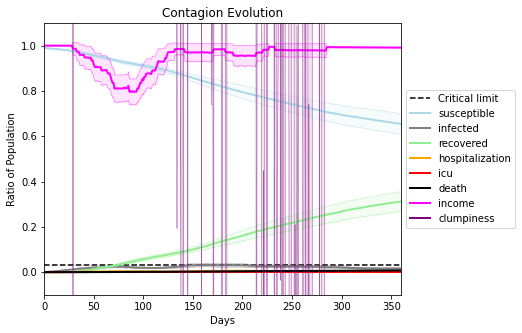

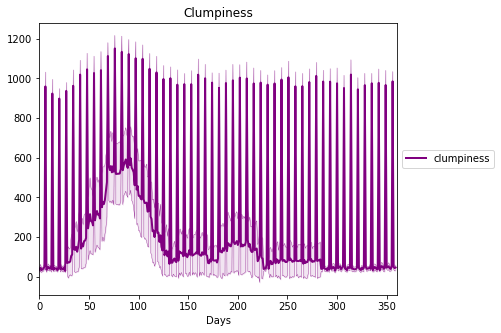

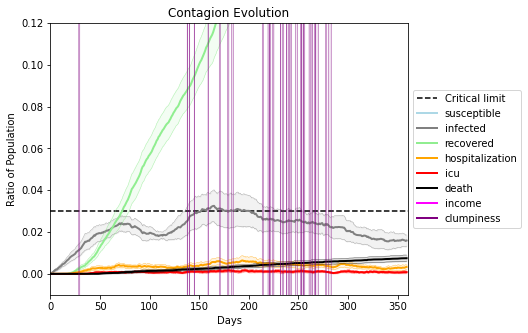

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9386, 9654, 3609, 929, 7431, 6497, 9403, 3199, 799, 6079, 3026, 3321, 9892, 2754, 6515, 657, 5002, 2093, 3459, 7951]
Average similarity between family members is 0.08668036441185882 at temperature 0.33
Average similarity between family and home is 0.9998498752478434 at temperature -1
Average similarity between students and their classroom is 0.1294311709855419 at temperature 0.33
Average classroom occupancy is 1.576271186440678 and number classrooms is 177
Average similarity between workers is 0.10832338022301867 at temperature 0.33
Average office occupancy is 3.310344827586207 and number offices is 203
Average friend similarity for adults: 0.15804089923823592 for kids: 0.17267064799179563
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.03220975482816494
avg restaurant similarity 0.0038333996476472842
avg restaurant similarity 0.044189170470633435
avg restaurant similarity 0.009417823623922418
avg restaurant similarity 0.05143515586450326
avg restaurant similarity -0.0008593937326419927
avg restaurant similarity -0.010732310287314127
avg restaurant similarity 0.05313650484694375
avg restaurant similarity 0.08744083391284196
avg restaurant similarity 0.0741461495851581
avg restaurant similarity 0.045312507743623616
avg restaurant similarity 0.050830435214933356
avg restaurant similarity 0.05138695930826089
avg restaurant similarity 0.07667978565393355
avg restaurant similarity 0.04472325831241325
avg restaurant similarity 0.06336133006366197
avg restaurant similarity 0.1016558090971009
avg restaurant similarity 0.08781794378857462
avg restaurant similarity 0.03914795697990287
avg restaurant similarity 0.05388161852511326
avg restaurant similarity 0.06720293718238453
avg restaurant similarity

avg restaurant similarity -0.001246392092881931
avg restaurant similarity 0.03771382246109825
avg restaurant similarity 0.09476444783098167
avg restaurant similarity -0.013739314944297455
avg restaurant similarity 0.03027121323946074
avg restaurant similarity 0.0577858864456677
avg restaurant similarity 0.09332910772813956
avg restaurant similarity 0.08870910602493669
avg restaurant similarity 0.03583001425912895
avg restaurant similarity 0.07024108643449413
avg restaurant similarity 0.08629721559871702
avg restaurant similarity 0.05127121715613151
avg restaurant similarity 0.04555648440653045
avg restaurant similarity 0.07052845921221348
avg restaurant similarity 0.11209379797119987
avg restaurant similarity 0.02449213106415076
avg restaurant similarity 0.06413090648083065
avg restaurant similarity 0.022083418685149587
avg restaurant similarity 0.0047054541008301285
avg restaurant similarity 0.03799974326349413
avg restaurant similarity 0.028121647064603867
avg restaurant similarity 0

avg restaurant similarity 0.013078796395059773
avg restaurant similarity 0.03615940154537959
avg restaurant similarity 0.017395934378683177
avg restaurant similarity 0.043974838009218524
avg restaurant similarity 0.1254210541058024
avg restaurant similarity 0.02627862972269345
Average similarity between family members is 0.12196313379535545 at temperature 0.33
Average similarity between family and home is 0.9998563393842208 at temperature -1
Average similarity between students and their classroom is 0.1390913838488934 at temperature 0.33
Average classroom occupancy is 1.5617977528089888 and number classrooms is 178
Average similarity between workers is 0.12796827539802214 at temperature 0.33
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.1717992895451347 for kids: 0.17055204504682495
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units wit

avg restaurant similarity 0.03822521242795355
avg restaurant similarity 0.0527493616266578
avg restaurant similarity 0.032061243031908895
avg restaurant similarity 0.03192380262658075
avg restaurant similarity 0.03281142166711722
avg restaurant similarity 0.027093732426567013
avg restaurant similarity 0.07820651469991823
avg restaurant similarity 0.04865027238578756
avg restaurant similarity 0.051022033497264176
avg restaurant similarity 0.06503201127041323
avg restaurant similarity 0.010661058770114263
avg restaurant similarity 0.05542414240098001
avg restaurant similarity 0.07604796631252682
avg restaurant similarity -0.01191115273667321
avg restaurant similarity 0.03783904386845954
avg restaurant similarity 0.0932073213610312
avg restaurant similarity 0.0579829045665114
avg restaurant similarity -0.014713078474100824
avg restaurant similarity -0.0032789533507396624
avg restaurant similarity 0.07220507810579442
avg restaurant similarity 0.061361706995593825
avg restaurant similarity 

avg restaurant similarity 0.0683022517684316
avg restaurant similarity 0.020286793953043326
avg restaurant similarity -0.013099741007156739
avg restaurant similarity 0.04606467196716309
avg restaurant similarity 0.05001053798113415
avg restaurant similarity 0.1310495043066067
avg restaurant similarity 0.03332051115093306
avg restaurant similarity 0.06453385420318913
avg restaurant similarity 0.015095283464273464
avg restaurant similarity 0.0344123462736062
avg restaurant similarity 0.03119971426414522
avg restaurant similarity 0.04178216644477123
avg restaurant similarity 0.054472353366430866
avg restaurant similarity 0.042857165940064376
avg restaurant similarity 0.014779693189484659
avg restaurant similarity 0.04411589355911616
avg restaurant similarity 0.058101332217325934
avg restaurant similarity 0.0693719184382344
avg restaurant similarity 0.04027537322153713
avg restaurant similarity 0.027141114000801582
avg restaurant similarity 0.03954079132296565
avg restaurant similarity 0.0

avg restaurant similarity 0.04839364689943478
avg restaurant similarity 0.01495629265351874
avg restaurant similarity 0.028875077874294938
avg restaurant similarity 0.057443758811962765
avg restaurant similarity 0.07166194128438244
avg restaurant similarity -0.007273885395654495
Average similarity between family members is 0.11316454839226098 at temperature 0.33
Average similarity between family and home is 0.999863577229505 at temperature -1
Average similarity between students and their classroom is 0.09631908119907782 at temperature 0.33
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.08626864313101087 at temperature 0.33
Average office occupancy is 3.287128712871287 and number offices is 202
Average friend similarity for adults: 0.15785843740108746 for kids: 0.1749536720871266
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units w

avg restaurant similarity 0.026728037850603795
avg restaurant similarity 0.056582878412006314
avg restaurant similarity 0.02491440945961368
avg restaurant similarity 0.06521133762098293
avg restaurant similarity 0.033244587848543124
avg restaurant similarity 0.03514612311904294
avg restaurant similarity 0.03470096835228037
avg restaurant similarity 0.006490234882369788
avg restaurant similarity 0.03779905693097953
avg restaurant similarity -0.0074266620092896226
avg restaurant similarity 0.03368249228788435
avg restaurant similarity 0.057489520279895394
avg restaurant similarity -0.008866477695545076
avg restaurant similarity 0.011373908225549711
avg restaurant similarity 0.04490359863202747
avg restaurant similarity 0.017361875092048177
avg restaurant similarity 0.04885866223757162
avg restaurant similarity 0.01988785235366634
avg restaurant similarity 0.03866970535615427
avg restaurant similarity 0.017795565548398257
avg restaurant similarity 0.04886918375927715
avg restaurant simila

avg restaurant similarity 0.02132601812366412
avg restaurant similarity 0.04992144364242078
avg restaurant similarity 0.005913998830849958
avg restaurant similarity 0.03507678589160517
avg restaurant similarity 0.06343387387550543
avg restaurant similarity 0.004884427328729903
avg restaurant similarity 0.010944675725155381
avg restaurant similarity 0.021992480023038514
avg restaurant similarity 0.028060824420000338
avg restaurant similarity 0.04614307514779908
avg restaurant similarity 0.06216976329500205
avg restaurant similarity 0.07381118087964635
avg restaurant similarity 0.013202377505332654
avg restaurant similarity 0.009049463201461482
avg restaurant similarity 0.06007445126772406
avg restaurant similarity 0.032826961065086306
avg restaurant similarity 0.02239613916553443
avg restaurant similarity 0.01196570724700514
avg restaurant similarity 0.08939768223907812
avg restaurant similarity 0.020772109567700366
avg restaurant similarity 0.03602454547667742
avg restaurant similarity

avg restaurant similarity 0.03501421057014089
avg restaurant similarity 0.0005174631401610658
avg restaurant similarity 0.03739689130855488
avg restaurant similarity 0.010669039336181817
avg restaurant similarity 0.017005075458152278
avg restaurant similarity 0.027057538443819154
avg restaurant similarity 0.03790339380599097
Average similarity between family members is 0.11048337955936154 at temperature 0.33
Average similarity between family and home is 0.9998514940495009 at temperature -1
Average similarity between students and their classroom is 0.10580510085974419 at temperature 0.33
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.08776476733346464 at temperature 0.33
Average office occupancy is 3.38659793814433 and number offices is 194
Average friend similarity for adults: 0.17165255433750537 for kids: 0.189592593963634
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.025680137883338366
avg restaurant similarity 0.052589824682877824
avg restaurant similarity 0.012770806256274823
avg restaurant similarity 0.01155434859307491
avg restaurant similarity 0.004512129842859292
avg restaurant similarity 0.001484990532303708
avg restaurant similarity -0.022620137111647398
avg restaurant similarity 0.02376947746857924
avg restaurant similarity 0.01385508006182455
avg restaurant similarity 0.03035478015721671
avg restaurant similarity -0.002890557598213856
avg restaurant similarity 0.005663412252881042
avg restaurant similarity -0.0005237036184119663
avg restaurant similarity 0.014570855036344373
avg restaurant similarity 0.04066746338673631
avg restaurant similarity 0.03631251450949401
avg restaurant similarity 0.030375756515645787
avg restaurant similarity 0.01706658401158066
avg restaurant similarity 0.07068074867336552
avg restaurant similarity 0.03367389077458006
avg restaurant similarity 0.033683861878852084
avg restaurant sim

avg restaurant similarity 0.0107615042329099
avg restaurant similarity 0.0650384010452333
avg restaurant similarity 0.0004732205557346399
avg restaurant similarity 0.06350013316400566
avg restaurant similarity 0.04584902747259022
avg restaurant similarity 0.03211427150086724
avg restaurant similarity -0.001190124188400316
avg restaurant similarity 0.02706838664306192
avg restaurant similarity 0.050994076505731456
avg restaurant similarity 0.04686299174173341
avg restaurant similarity 0.036761139847579505
avg restaurant similarity -0.0006602586705819065
avg restaurant similarity -0.006881206810929341
avg restaurant similarity -0.0032819761970674806
avg restaurant similarity 0.030281910150953717
avg restaurant similarity -0.001924424148071562
avg restaurant similarity -0.029932399033081685
avg restaurant similarity 0.0342602667334503
avg restaurant similarity 0.04954812842320416
avg restaurant similarity 0.004884596203600928
avg restaurant similarity 0.03674052330026292
avg restaurant si

avg restaurant similarity 0.021081534105337744
avg restaurant similarity 0.05718450048065441
avg restaurant similarity 0.047478409037132595
avg restaurant similarity 0.0004909097665539774
avg restaurant similarity 0.03526239794804201
avg restaurant similarity 0.043370791172044135
avg restaurant similarity 0.02223732282869012
avg restaurant similarity 0.0014137538803065122
Average similarity between family members is 0.11045676160963626 at temperature 0.33
Average similarity between family and home is 0.9998562516975225 at temperature -1
Average similarity between students and their classroom is 0.07804140760158013 at temperature 0.33
Average classroom occupancy is 1.621761658031088 and number classrooms is 193
Average similarity between workers is 0.10415884124897584 at temperature 0.33
Average office occupancy is 3.1818181818181817 and number offices is 198
Average friend similarity for adults: 0.16928203873257364 for kids: 0.16619989513117372
home_districts
[
Home (0,0) district with

avg restaurant similarity 0.025177018407775476
avg restaurant similarity 0.07997408956576692
avg restaurant similarity 0.0455672534493696
avg restaurant similarity -0.01019288068561121
avg restaurant similarity 0.04110442113005526
avg restaurant similarity 0.07569385183567703
avg restaurant similarity 0.04685476844154608
avg restaurant similarity 0.10556047593211682
avg restaurant similarity 0.10348350227032031
avg restaurant similarity 0.08241484270576774
avg restaurant similarity 0.04861078282826209
avg restaurant similarity 0.13072568849492802
avg restaurant similarity 0.12066460598856044
avg restaurant similarity 0.06896351376130588
avg restaurant similarity 0.06298315019150609
avg restaurant similarity 0.11075961155204041
avg restaurant similarity 0.04622103986646703
avg restaurant similarity 0.04022948940643387
avg restaurant similarity 0.09905904045849713
avg restaurant similarity 0.05593630944399271
avg restaurant similarity 0.08579519610507551
avg restaurant similarity 0.03553

avg restaurant similarity 0.11085376350069914
avg restaurant similarity 0.033219013314173
avg restaurant similarity 0.07810254146043569
avg restaurant similarity 0.08166701357985112
avg restaurant similarity 0.05599674083213547
avg restaurant similarity 0.09111767297841436
avg restaurant similarity 0.01724111155750645
avg restaurant similarity 0.0762132562439657
avg restaurant similarity 0.07040463684854764
avg restaurant similarity 0.003870035719631132
avg restaurant similarity 0.03392944652435354
avg restaurant similarity 0.08803362997808133
avg restaurant similarity 0.07261939985344296
avg restaurant similarity 0.07108198521485667
avg restaurant similarity 0.02485102829035528
avg restaurant similarity 0.09122359192928928
avg restaurant similarity 0.08239374503474464
avg restaurant similarity 0.0741403027260154
avg restaurant similarity 0.07415007826830798
avg restaurant similarity 0.08282785264926996
avg restaurant similarity 0.0063330867238191105
avg restaurant similarity 0.0308071

avg restaurant similarity 0.07122638322440417
avg restaurant similarity 0.11331147669485739
avg restaurant similarity 0.06448443195178774
avg restaurant similarity 0.0882183609328609
Average similarity between family members is 0.12488361095987466 at temperature 0.33
Average similarity between family and home is 0.999856280526242 at temperature -1
Average similarity between students and their classroom is 0.10168654775479469 at temperature 0.33
Average classroom occupancy is 1.5268817204301075 and number classrooms is 186
Average similarity between workers is 0.12425437675931833 at temperature 0.33
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.16489554309465845 for kids: 0.15868853011303985
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06929482801974321
avg restaurant similarity 0.08109709107123314
avg restaurant similarity 0.038889959784823444
avg restaurant similarity 0.0548394722651852
avg restaurant similarity 0.06142840152721395
avg restaurant similarity 0.08948617935057544
avg restaurant similarity 0.057340395145334455
avg restaurant similarity 0.10508626153154249
avg restaurant similarity 0.03816353731319959
avg restaurant similarity 0.032785263222350876
avg restaurant similarity 0.05200406091540689
avg restaurant similarity 0.12907187014485016
avg restaurant similarity 0.10684091242230614
avg restaurant similarity 0.039862452031305055
avg restaurant similarity 0.06591090058055196
avg restaurant similarity 0.05255061053263213
avg restaurant similarity 0.06280607039916657
avg restaurant similarity 0.077182562331908
avg restaurant similarity 0.04304759859790471
avg restaurant similarity 0.057204701831640094
avg restaurant similarity 0.05818086034421614
avg restaurant similarity 0.0531

avg restaurant similarity 0.06064311569976436
avg restaurant similarity 0.06917339277129243
avg restaurant similarity 0.08265268844795043
avg restaurant similarity 0.03466538429019504
avg restaurant similarity 0.06557934774519683
avg restaurant similarity 0.055592156735316256
avg restaurant similarity 0.029627352719777827
avg restaurant similarity 0.05336997953454176
avg restaurant similarity 0.048093912249265396
avg restaurant similarity 0.07470121627966884
avg restaurant similarity 0.11152771014932576
avg restaurant similarity 0.05091850663802576
avg restaurant similarity 0.0763589922716252
avg restaurant similarity 0.06445110138102658
avg restaurant similarity 0.11659043351526595
avg restaurant similarity 0.07915009417045447
avg restaurant similarity 0.06581628684872053
avg restaurant similarity 0.03854459151085035
avg restaurant similarity 0.08396259470452581
avg restaurant similarity 0.11252831931892678
avg restaurant similarity 0.06541652849468116
avg restaurant similarity 0.1047

avg restaurant similarity 0.04119414272776325
avg restaurant similarity 0.0006390236424941817
avg restaurant similarity 0.022091154073444065
avg restaurant similarity 0.07225605647756886
Average similarity between family members is 0.11408637580245921 at temperature 0.33
Average similarity between family and home is 0.9998540267834264 at temperature -1
Average similarity between students and their classroom is 0.07011791723151653 at temperature 0.33
Average classroom occupancy is 1.6046511627906976 and number classrooms is 172
Average similarity between workers is 0.11074688588345605 at temperature 0.33
Average office occupancy is 3.3266331658291457 and number offices is 199
Average friend similarity for adults: 0.1709252314208857 for kids: 0.17302407106581524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.07695445962237772
avg restaurant similarity 0.06621878980712748
avg restaurant similarity 0.06684998203183165
avg restaurant similarity 0.03199355252196101
avg restaurant similarity 0.02968622389657754
avg restaurant similarity 0.03972047918275821
avg restaurant similarity 0.027068610551124632
avg restaurant similarity 0.025948194119797364
avg restaurant similarity 0.045534695207044285
avg restaurant similarity 0.07329528986403312
avg restaurant similarity 0.013360327127284412
avg restaurant similarity 0.07531783996490761
avg restaurant similarity 0.0314608937797689
avg restaurant similarity 0.01849665142964987
avg restaurant similarity 0.06946966655735688
avg restaurant similarity 0.09525841598354429
avg restaurant similarity 0.009227244009609788
avg restaurant similarity 0.0664612328774666
avg restaurant similarity 0.06440981867021985
avg restaurant similarity 0.020946479411880735
avg restaurant similarity 0.013232534125956865
avg restaurant similarity 0.0

avg restaurant similarity 0.07733654561597908
avg restaurant similarity 0.0020645466515158122
avg restaurant similarity 0.07490760479733971
avg restaurant similarity 0.04424331515988043
avg restaurant similarity 0.018435891870226557
avg restaurant similarity 0.0759685649097061
avg restaurant similarity 0.07628147987130707
avg restaurant similarity 0.038490579650789884
avg restaurant similarity 0.07584816122471962
avg restaurant similarity 0.07058836096571544
avg restaurant similarity 0.08206712846557702
avg restaurant similarity 0.06665061868571827
avg restaurant similarity 0.0705277237696289
avg restaurant similarity 0.010474454085575655
avg restaurant similarity 0.04768848289452478
avg restaurant similarity 0.08283663312103222
avg restaurant similarity 0.011070898754445753
avg restaurant similarity 0.05806317426106028
avg restaurant similarity 0.0346079956495091
avg restaurant similarity 0.07697094632625652
avg restaurant similarity 0.06739546707229438
avg restaurant similarity 0.084

avg restaurant similarity 0.03616610349439075
avg restaurant similarity 0.04453564076512011
avg restaurant similarity 0.05619402650922455
avg restaurant similarity 0.0287264837866153
avg restaurant similarity 0.04099883959643744
avg restaurant similarity 0.07571735423693933
Average similarity between family members is 0.09755220529319532 at temperature 0.33
Average similarity between family and home is 0.9998595315009801 at temperature -1
Average similarity between students and their classroom is 0.1017232483493151 at temperature 0.33
Average classroom occupancy is 1.558011049723757 and number classrooms is 181
Average similarity between workers is 0.10623878152349292 at temperature 0.33
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.16556977710988238 for kids: 0.16840944789951265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.04809984667837761
avg restaurant similarity 0.028063529772845448
avg restaurant similarity 0.03986500116214071
avg restaurant similarity 0.02459628223339996
avg restaurant similarity 0.018232199080425397
avg restaurant similarity 0.07063259585843662
avg restaurant similarity 0.05334551155463358
avg restaurant similarity 0.06726361958629136
avg restaurant similarity 0.040300929370308325
avg restaurant similarity -0.013969466080938598
avg restaurant similarity -0.007818874193034831
avg restaurant similarity 0.0404948117182057
avg restaurant similarity 0.05324678326871815
avg restaurant similarity 0.04264573137594582
avg restaurant similarity 0.03517605599649829
avg restaurant similarity -0.009701429203130607
avg restaurant similarity 0.08477732104917779
avg restaurant similarity 0.0310877768554252
avg restaurant similarity 0.011164014966527082
avg restaurant similarity 0.023971132540695918
avg restaurant similarity 0.05580527339208595
avg restaurant similarity

avg restaurant similarity 0.03984215044377281
avg restaurant similarity 0.02725554236921324
avg restaurant similarity -0.0020865498940846163
avg restaurant similarity 0.013168171519077952
avg restaurant similarity 0.016878010656352586
avg restaurant similarity 0.07642465311629425
avg restaurant similarity 0.07356546224961713
avg restaurant similarity 0.03499589772673371
avg restaurant similarity 0.03553189595069362
avg restaurant similarity 0.02414630405503837
avg restaurant similarity 0.03171390025149164
avg restaurant similarity 0.011908163008324486
avg restaurant similarity 0.018711800882956264
avg restaurant similarity 0.0032163921154909894
avg restaurant similarity 0.012629831018298275
avg restaurant similarity 0.028205049867290007
avg restaurant similarity 0.06691306703350366
avg restaurant similarity 0.022723346932282854
avg restaurant similarity 0.0090022710554719
avg restaurant similarity 0.07325480241129675
avg restaurant similarity 0.005948308770499932
avg restaurant similar

avg restaurant similarity 0.031786807212241475
avg restaurant similarity 0.013146245533923953
avg restaurant similarity 0.08472700353086206
avg restaurant similarity 0.020788277400193154
avg restaurant similarity 0.04393299565013757
avg restaurant similarity 0.005282675510336842
avg restaurant similarity 0.001149774832301417
Average similarity between family members is 0.09986298864980839 at temperature 0.33
Average similarity between family and home is 0.9998615380623492 at temperature -1
Average similarity between students and their classroom is 0.10914298375677428 at temperature 0.33
Average classroom occupancy is 1.6629213483146068 and number classrooms is 178
Average similarity between workers is 0.10629125446197994 at temperature 0.33
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.16747284649826202 for kids: 0.16618561135858945
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capaci

avg restaurant similarity -0.004699509843085977
avg restaurant similarity 0.02301996294302264
avg restaurant similarity 0.031224522307404478
avg restaurant similarity 0.03433849466670167
avg restaurant similarity 0.06382089817542524
avg restaurant similarity 0.006416881131601067
avg restaurant similarity 0.02276231033583473
avg restaurant similarity 0.001850469679863562
avg restaurant similarity 0.05916471491473467
avg restaurant similarity 0.09477425632499337
avg restaurant similarity 0.03491696265240393
avg restaurant similarity 0.07264515488626618
avg restaurant similarity 0.0327132216644575
avg restaurant similarity 0.0651279780858162
avg restaurant similarity 0.03160521027613284
avg restaurant similarity 0.04865960188693856
avg restaurant similarity 0.07074075158085875
avg restaurant similarity 0.0624302719774233
avg restaurant similarity 0.024047777071280668
avg restaurant similarity 0.047136864477376555
avg restaurant similarity 0.008654603921330406
avg restaurant similarity 0.0

avg restaurant similarity 0.03801584785341735
avg restaurant similarity 0.05707351853967833
avg restaurant similarity 0.05294535999582286
avg restaurant similarity 0.032900716308063224
avg restaurant similarity 0.06644529424863069
avg restaurant similarity 0.007832849542432126
avg restaurant similarity 0.015512169705758017
avg restaurant similarity 0.04971423833677168
avg restaurant similarity 0.02203001552019625
avg restaurant similarity 0.05601315967594941
avg restaurant similarity 0.031404861292228116
avg restaurant similarity 0.055855377583838524
avg restaurant similarity 0.017291616446330132
avg restaurant similarity 0.07347021801773256
avg restaurant similarity 0.06209354318060383
avg restaurant similarity 0.044335503978680156
avg restaurant similarity 0.0242383874614411
avg restaurant similarity 0.09073480742214213
avg restaurant similarity 0.04756370124865803
avg restaurant similarity 0.018055429205098176
avg restaurant similarity 0.03948230094700412
avg restaurant similarity 0

avg restaurant similarity 0.024965031290126977
avg restaurant similarity 0.08033926294110441
avg restaurant similarity 0.03282941717362043
avg restaurant similarity 0.00586297115036639
avg restaurant similarity -0.004544619670408314
avg restaurant similarity 0.028153426886455488
avg restaurant similarity -0.005402089304801186
Average similarity between family members is 0.0899358216386688 at temperature 0.33
Average similarity between family and home is 0.9998636051761985 at temperature -1
Average similarity between students and their classroom is 0.1058000947459254 at temperature 0.33
Average classroom occupancy is 1.53475935828877 and number classrooms is 187
Average similarity between workers is 0.1293687796561466 at temperature 0.33
Average office occupancy is 3.2829268292682925 and number offices is 205
Average friend similarity for adults: 0.16602390692934815 for kids: 0.16874210180069568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.05474690473429275
avg restaurant similarity 0.06878150606634677
avg restaurant similarity 0.09625756839935566
avg restaurant similarity 0.05063845842532546
avg restaurant similarity 0.06647735049988805
avg restaurant similarity 0.08331046204646962
avg restaurant similarity 0.07200311489782821
avg restaurant similarity 0.04076557873276062
avg restaurant similarity 0.07851824531759907
avg restaurant similarity 0.020583491165240615
avg restaurant similarity 0.0715920846554948
avg restaurant similarity 0.06265930563116652
avg restaurant similarity 0.0961465221909108
avg restaurant similarity 0.04745067545935686
avg restaurant similarity 0.06093357394832512
avg restaurant similarity 0.03898660542147541
avg restaurant similarity 0.03711954735241531
avg restaurant similarity 0.08159019737772114
avg restaurant similarity 0.06182195760646197
avg restaurant similarity 0.06859539590976224
avg restaurant similarity 0.07454942621918775
avg restaurant similarity 0.0864882

avg restaurant similarity 0.076145014394745
avg restaurant similarity 0.09083343208540687
avg restaurant similarity 0.07066210263908912
avg restaurant similarity 0.05663326314528981
avg restaurant similarity 0.04722979551984162
avg restaurant similarity 0.0238380164773757
avg restaurant similarity 0.05718911038203145
avg restaurant similarity 0.030158875482512223
avg restaurant similarity 0.06495126109436014
avg restaurant similarity 0.05371879076224967
avg restaurant similarity 0.03794930907349812
avg restaurant similarity 0.03964387230307617
avg restaurant similarity 0.05756576408837047
avg restaurant similarity 0.05719961861769273
avg restaurant similarity 0.058079229992655974
avg restaurant similarity 0.11969405138429713
avg restaurant similarity 0.10086210912967211
avg restaurant similarity 0.1032710010660589
avg restaurant similarity 0.09177330771851525
avg restaurant similarity 0.054282597011939465
avg restaurant similarity 0.07006516161929238
avg restaurant similarity 0.0957064

avg restaurant similarity 0.05228255923699519
avg restaurant similarity 0.03133915275768512
avg restaurant similarity 0.09347140962200197
avg restaurant similarity 0.03656171483657168
Average similarity between family members is 0.10807935427014229 at temperature 0.33
Average similarity between family and home is 0.9998501141084696 at temperature -1
Average similarity between students and their classroom is 0.11551255048092449 at temperature 0.33
Average classroom occupancy is 1.5739644970414202 and number classrooms is 169
Average similarity between workers is 0.08715866280059077 at temperature 0.33
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.170377116389055 for kids: 0.17199092216636863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.053488917748564756
avg restaurant similarity 0.09037724498788764
avg restaurant similarity 0.0788642343652984
avg restaurant similarity 0.05111879073781055
avg restaurant similarity 0.0364477116776373
avg restaurant similarity 0.08904632997259364
avg restaurant similarity 0.05683912589024114
avg restaurant similarity 0.10366997975016207
avg restaurant similarity 0.07684277468015913
avg restaurant similarity 0.07294353194526762
avg restaurant similarity 0.042019459944203356
avg restaurant similarity 0.07257821286554576
avg restaurant similarity 0.07197459866357346
avg restaurant similarity 0.0669125124463516
avg restaurant similarity 0.06856208693367279
avg restaurant similarity 0.04925881305246285
avg restaurant similarity 0.03925031199231564
avg restaurant similarity 0.04516719137037275
avg restaurant similarity 0.07145838116989153
avg restaurant similarity 0.11841164007421222
avg restaurant similarity 0.07476410256601779
avg restaurant similarity 0.0493433

avg restaurant similarity 0.06818843101581114
avg restaurant similarity 0.08653599384548191
avg restaurant similarity 0.03836144816516354
avg restaurant similarity 0.058117239951161484
avg restaurant similarity 0.08335705691810673
avg restaurant similarity 0.08259475078801883
avg restaurant similarity 0.03320722032454036
avg restaurant similarity 0.0557002842846445
avg restaurant similarity 0.10665032539133651
avg restaurant similarity 0.059244332475379025
avg restaurant similarity 0.10116749747599124
avg restaurant similarity 0.09099502376816757
avg restaurant similarity 0.07444241379284926
avg restaurant similarity 0.08061495507305809
avg restaurant similarity 0.07429976917228288
avg restaurant similarity 0.04393596194399505
avg restaurant similarity 0.0772554439189603
avg restaurant similarity 0.05796618735531279
avg restaurant similarity 0.03983942817369313
avg restaurant similarity 0.09092598155131007
avg restaurant similarity 0.03937188784745532
avg restaurant similarity 0.063653

avg restaurant similarity 0.08730199399562341
avg restaurant similarity 0.07644727673842727
Average similarity between family members is 0.11820682724692722 at temperature 0.33
Average similarity between family and home is 0.9998626397267185 at temperature -1
Average similarity between students and their classroom is 0.10587579597316334 at temperature 0.33
Average classroom occupancy is 1.625 and number classrooms is 176
Average similarity between workers is 0.09900248791060273 at temperature 0.33
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.17477537000564536 for kids: 0.17079654720003346
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units wit

avg restaurant similarity 0.029544546658817936
avg restaurant similarity 0.06999955691598195
avg restaurant similarity -0.022507439532788692
avg restaurant similarity 0.03314601840188385
avg restaurant similarity 0.05744614675604473
avg restaurant similarity 0.04657361776823432
avg restaurant similarity 0.020198790848817042
avg restaurant similarity 0.05928685157817211
avg restaurant similarity 0.04862567115740924
avg restaurant similarity 0.0412251630828716
avg restaurant similarity 0.026361156951786712
avg restaurant similarity -0.007567089434619807
avg restaurant similarity -0.010323613436835187
avg restaurant similarity 0.06786718137072865
avg restaurant similarity 0.07151241683967502
avg restaurant similarity 0.048878685463601836
avg restaurant similarity -0.0004930693061368807
avg restaurant similarity 0.08685999746706317
avg restaurant similarity 0.005483482638501264
avg restaurant similarity 0.04021903614454304
avg restaurant similarity -0.023758329291722412
avg restaurant simi

avg restaurant similarity 0.03495581778236234
avg restaurant similarity 0.06882979444925859
avg restaurant similarity 0.038943903368621045
avg restaurant similarity 0.009539375342956784
avg restaurant similarity 0.020081170734939768
avg restaurant similarity 0.04769733246065158
avg restaurant similarity 0.03800610330984468
avg restaurant similarity 0.013972456888321442
avg restaurant similarity 0.020362789312956143
avg restaurant similarity 0.013830779955349414
avg restaurant similarity 0.029543954687173895
avg restaurant similarity 0.027801524659042905
avg restaurant similarity 0.017491122205031975
avg restaurant similarity -0.0035685838749038223
avg restaurant similarity 0.07485953281801937
avg restaurant similarity 0.07076237802489399
avg restaurant similarity 0.047259080795742654
avg restaurant similarity -0.0058174109298399414
avg restaurant similarity 0.020678632708700465
avg restaurant similarity 0.03137480239647722
avg restaurant similarity 0.04484877420380986
avg restaurant si

avg restaurant similarity 0.03120759097610968
avg restaurant similarity 0.01543191862417885
avg restaurant similarity 0.05492236995975188
avg restaurant similarity 0.08358205242172002
avg restaurant similarity 0.02950378231743542
avg restaurant similarity 0.022069476085003557
Average similarity between family members is 0.10815700079313058 at temperature 0.33
Average similarity between family and home is 0.9998472247029168 at temperature -1
Average similarity between students and their classroom is 0.12868423222159447 at temperature 0.33
Average classroom occupancy is 1.6033519553072626 and number classrooms is 179
Average similarity between workers is 0.09968262021488318 at temperature 0.33
Average office occupancy is 3.237623762376238 and number offices is 202
Average friend similarity for adults: 0.1678921279807697 for kids: 0.17465231455025942
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.05462934357161841
avg restaurant similarity 0.0956193313696493
avg restaurant similarity 0.05808106187385047
avg restaurant similarity 0.0787524181081614
avg restaurant similarity 0.060434378131049515
avg restaurant similarity 0.05995941595576487
avg restaurant similarity 0.09447309862290076
avg restaurant similarity 0.04574034698688663
avg restaurant similarity 0.08784039635478746
avg restaurant similarity 0.040765033835735286
avg restaurant similarity 0.06815979221404259
avg restaurant similarity 0.05967250186161923
avg restaurant similarity 0.03567012987957129
avg restaurant similarity 0.07665399153210486
avg restaurant similarity 0.0426126469404768
avg restaurant similarity 0.05780565460571699
avg restaurant similarity 0.024691036160024233
avg restaurant similarity 0.06099195256690882
avg restaurant similarity -0.0019183867769712974
avg restaurant similarity 0.018940079692577223
avg restaurant similarity 0.057368802844623853
avg restaurant similarity 0.0

avg restaurant similarity 0.10644907296956362
avg restaurant similarity 0.056820585123143606
avg restaurant similarity 0.07437331153910767
avg restaurant similarity 0.0443438852500581
avg restaurant similarity 0.02730582135935119
avg restaurant similarity 0.0784525407203077
avg restaurant similarity 0.050772900338153466
avg restaurant similarity 0.06818936341575202
avg restaurant similarity 0.07188456286752505
avg restaurant similarity 0.046075974028687794
avg restaurant similarity 0.047202433119183415
avg restaurant similarity 0.07030856134462665
avg restaurant similarity 0.09319974232605957
avg restaurant similarity 0.04142197807721618
avg restaurant similarity 0.09295311221534461
avg restaurant similarity 0.03647843140269116
avg restaurant similarity 0.042105759918161415
avg restaurant similarity 0.04279786313055139
avg restaurant similarity 0.08061348772762922
avg restaurant similarity 0.05772413931977541
avg restaurant similarity 0.04163515679232786
avg restaurant similarity 0.013

avg restaurant similarity 0.03791769910659843
avg restaurant similarity 0.05557871634073449
avg restaurant similarity 0.06347829099285288
avg restaurant similarity 0.1071375464625574
avg restaurant similarity 0.05728145673958342
Average similarity between family members is 0.10493859329520658 at temperature 0.33
Average similarity between family and home is 0.9998490930211275 at temperature -1
Average similarity between students and their classroom is 0.09608687830598006 at temperature 0.33
Average classroom occupancy is 1.6685082872928176 and number classrooms is 181
Average similarity between workers is 0.12401129408221702 at temperature 0.33
Average office occupancy is 3.2562814070351758 and number offices is 199
Average friend similarity for adults: 0.17308539825113958 for kids: 0.1860496268512863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people alloca

avg restaurant similarity 0.07371565599142643
avg restaurant similarity 0.10382322995527386
avg restaurant similarity 0.04028456634281181
avg restaurant similarity 0.06265271775415551
avg restaurant similarity 0.09085481266961878
avg restaurant similarity 0.1313070697020538
avg restaurant similarity 0.09596331755795603
avg restaurant similarity 0.08422115989775433
avg restaurant similarity 0.11212936818281354
avg restaurant similarity 0.0841347558027718
avg restaurant similarity 0.07576829196189197
avg restaurant similarity 0.04802866072232965
avg restaurant similarity 0.04474833717728233
avg restaurant similarity 0.048951905193734636
avg restaurant similarity 0.055956252853215496
avg restaurant similarity 0.047609818072051335
avg restaurant similarity 0.06940520741787957
avg restaurant similarity 0.08933144859643484
avg restaurant similarity 0.11307127840072154
avg restaurant similarity 0.026187774561334958
avg restaurant similarity 0.054649294785548724
avg restaurant similarity 0.098

avg restaurant similarity 0.1014304818152646
avg restaurant similarity 0.08642358375989724
avg restaurant similarity 0.05191680017618444
avg restaurant similarity 0.0604231349302056
avg restaurant similarity 0.11173551840086804
avg restaurant similarity 0.05704701968708741
avg restaurant similarity 0.08336632703071853
avg restaurant similarity 0.06719200810443526
avg restaurant similarity 0.0964152199452188
avg restaurant similarity 0.06872258991391506
avg restaurant similarity 0.09402072442889509
avg restaurant similarity 0.11075342619408335
avg restaurant similarity 0.05709029223231698
avg restaurant similarity 0.045504551261423117
avg restaurant similarity 0.022766443426268865
avg restaurant similarity 0.07767750638531336
avg restaurant similarity 0.08878875364898553
avg restaurant similarity 0.0739264662760456
avg restaurant similarity 0.08433438591166183
avg restaurant similarity 0.12114911056923865
avg restaurant similarity 0.0790678313838966
avg restaurant similarity 0.109013272

avg restaurant similarity 0.11462421098731423
avg restaurant similarity 0.07124052506042591
Average similarity between family members is 0.09378969659575287 at temperature 0.33
Average similarity between family and home is 0.9998530775633664 at temperature -1
Average similarity between students and their classroom is 0.13180650834957483 at temperature 0.33
Average classroom occupancy is 1.6206896551724137 and number classrooms is 174
Average similarity between workers is 0.130261090907845 at temperature 0.33
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.1649575135718432 for kids: 0.17119852065489677
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.005116661563188794
avg restaurant similarity 0.0226440053694087
avg restaurant similarity 0.0030870689780628188
avg restaurant similarity 0.027389268442320844
avg restaurant similarity -0.00556104148566981
avg restaurant similarity -0.002247010401458317
avg restaurant similarity 0.024223643076862623
avg restaurant similarity 0.021468764166636622
avg restaurant similarity 0.005990898718839088
avg restaurant similarity 0.007220335085693194
avg restaurant similarity 0.022598372297300905
avg restaurant similarity 0.07135900996333326
avg restaurant similarity 0.0388744771585886
avg restaurant similarity 0.012562372038782556
avg restaurant similarity 0.0262338927796899
avg restaurant similarity 0.0413598137747104
avg restaurant similarity 0.02072836487111774
avg restaurant similarity 0.044431878359584724
avg restaurant similarity -0.001984214915185414
avg restaurant similarity 0.04425347691920317
avg restaurant similarity 0.021982078465408516
avg restaurant simila

avg restaurant similarity 0.0029760345593100395
avg restaurant similarity 0.016139868496963024
avg restaurant similarity 0.0005105792568521956
avg restaurant similarity 0.03786427328735429
avg restaurant similarity 0.01658679780484714
avg restaurant similarity 0.026873876342171636
avg restaurant similarity 0.043816629804976456
avg restaurant similarity 0.03404142068342549
avg restaurant similarity 0.025515695379165124
avg restaurant similarity 0.0613682982087301
avg restaurant similarity 0.03248570835291737
avg restaurant similarity 0.051059443671221325
avg restaurant similarity 0.042928108817158056
avg restaurant similarity 0.09811389888768232
avg restaurant similarity -0.00013833942572482444
avg restaurant similarity 0.0037582668129405596
avg restaurant similarity 0.027016434455222206
avg restaurant similarity 0.007972760642755192
avg restaurant similarity 0.015360128916785957
avg restaurant similarity -0.025009610570868625
avg restaurant similarity 0.030606621802187487
avg restauran

avg restaurant similarity 0.05212738753720286
avg restaurant similarity 0.0073130841546008955
avg restaurant similarity -0.013158242276290939
avg restaurant similarity 0.03207701596358182
avg restaurant similarity -0.0018109887649097045
avg restaurant similarity 0.007840735798402469
avg restaurant similarity 0.003789476651731009
avg restaurant similarity 0.04699553083380926
Average similarity between family members is 0.11889726584658929 at temperature 0.33
Average similarity between family and home is 0.999847605231836 at temperature -1
Average similarity between students and their classroom is 0.121136635541895 at temperature 0.33
Average classroom occupancy is 1.582010582010582 and number classrooms is 189
Average similarity between workers is 0.12050952307258157 at temperature 0.33
Average office occupancy is 3.206730769230769 and number offices is 208
Average friend similarity for adults: 0.1653457860413914 for kids: 0.16881990359039467
home_districts
[
Home (0,0) district with 1 

avg restaurant similarity 0.014580292318107826
avg restaurant similarity 0.012219876477342687
avg restaurant similarity 0.004321817781262932
avg restaurant similarity 0.04809232896173568
avg restaurant similarity 0.0695531407571125
avg restaurant similarity 0.09816364371563821
avg restaurant similarity 0.05685077033543793
avg restaurant similarity 0.022787034018498274
avg restaurant similarity 0.028346125474935865
avg restaurant similarity 0.031837857883726006
avg restaurant similarity 0.04855027566005048
avg restaurant similarity 0.03706475429459394
avg restaurant similarity 0.01057572675182798
avg restaurant similarity 0.08564847682241548
avg restaurant similarity 0.10839595293533456
avg restaurant similarity 0.0698431016909876
avg restaurant similarity 0.06100188493313716
avg restaurant similarity 0.05735365567198635
avg restaurant similarity 0.039166754992042585
avg restaurant similarity 0.07044088063065983
avg restaurant similarity 0.08093736993536807
avg restaurant similarity 0.0

avg restaurant similarity 0.02994398177421379
avg restaurant similarity 0.02957354077710849
avg restaurant similarity 0.09710139693616175
avg restaurant similarity 0.05871249030367126
avg restaurant similarity 0.048173589894392355
avg restaurant similarity 0.04129876495717968
avg restaurant similarity 0.026856922551006947
avg restaurant similarity 0.056668208265261796
avg restaurant similarity 0.029407114922269172
avg restaurant similarity 0.04771531299799218
avg restaurant similarity 0.1078368201295494
avg restaurant similarity 0.009024679008044214
avg restaurant similarity 0.05806795800002966
avg restaurant similarity 0.017993671047377688
avg restaurant similarity 0.04641403819620208
avg restaurant similarity 0.058960666876465145
avg restaurant similarity 0.07905621793408962
avg restaurant similarity 0.06108999876601805
avg restaurant similarity 0.017923267814269696
avg restaurant similarity 0.08011990512141343
avg restaurant similarity 0.05719260427073401
avg restaurant similarity 0

avg restaurant similarity 0.06149655391129776
avg restaurant similarity 0.03839699780080112
avg restaurant similarity 0.019497384355508414
avg restaurant similarity 0.04699688715755098
Average similarity between family members is 0.09007371569879893 at temperature 0.33
Average similarity between family and home is 0.9998535203708395 at temperature -1
Average similarity between students and their classroom is 0.11559550237629765 at temperature 0.33
Average classroom occupancy is 1.4921465968586387 and number classrooms is 191
Average similarity between workers is 0.07978362133126163 at temperature 0.33
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.1716679021680754 for kids: 0.16318543689702042
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.030079824203609364
avg restaurant similarity 0.043692936435129726
avg restaurant similarity -0.00966722277976095
avg restaurant similarity 0.052427409015874615
avg restaurant similarity 0.02145921468479253
avg restaurant similarity 0.01583884115101492
avg restaurant similarity 0.049695693402916595
avg restaurant similarity 0.0327678683844907
avg restaurant similarity 0.04969747505411027
avg restaurant similarity 0.0029320422928377768
avg restaurant similarity 0.018300033458528278
avg restaurant similarity 0.0609077135980839
avg restaurant similarity 0.012406340343070428
avg restaurant similarity 0.04517918069205478
avg restaurant similarity 0.04204816662537089
avg restaurant similarity -0.01525926771135989
avg restaurant similarity 0.04646104765920087
avg restaurant similarity 0.02206646603449727
avg restaurant similarity 0.01841819035238021
avg restaurant similarity 0.07408954283954344
avg restaurant similarity 0.04008413693041201
avg restaurant similarity 

avg restaurant similarity 0.040468676937836685
avg restaurant similarity 0.05562756168068718
avg restaurant similarity 0.04996484337552217
avg restaurant similarity 0.024122635965029785
avg restaurant similarity 0.06924878808202686
avg restaurant similarity 0.022452607367602552
avg restaurant similarity 0.02112264838376777
avg restaurant similarity 0.034407487595220006
avg restaurant similarity 0.01761877919143285
avg restaurant similarity -0.005546346995621999
avg restaurant similarity 0.03968793543424235
avg restaurant similarity 0.051176877670244626
avg restaurant similarity 0.01760950666027355
avg restaurant similarity 0.03632128262306399
avg restaurant similarity 0.05004827011824838
avg restaurant similarity 0.062226435918399325
avg restaurant similarity 0.035108392697445326
avg restaurant similarity 0.002471242473198605
avg restaurant similarity -0.0027775715034195686
avg restaurant similarity 0.005930092336839731
avg restaurant similarity 0.054364154769700614
avg restaurant simi

avg restaurant similarity 0.03672664714353792
avg restaurant similarity 0.05144271687430852
avg restaurant similarity 0.050333595297905966
avg restaurant similarity 0.0510133087218727
avg restaurant similarity -0.006358844405051257
avg restaurant similarity 0.09575882587527405
Average similarity between family members is 0.13619276669407304 at temperature 0.33
Average similarity between family and home is 0.999859161659489 at temperature -1
Average similarity between students and their classroom is 0.12448773337743906 at temperature 0.33
Average classroom occupancy is 1.651685393258427 and number classrooms is 178
Average similarity between workers is 0.11014558382805881 at temperature 0.33
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.16369838037904352 for kids: 0.165015006476386
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with

avg restaurant similarity 0.03388821467453764
avg restaurant similarity 0.0015624938528489517
avg restaurant similarity 0.036705239444145964
avg restaurant similarity 0.06055139464337582
avg restaurant similarity 0.07342888665077221
avg restaurant similarity 0.0735839700434278
avg restaurant similarity 0.07114408737233535
avg restaurant similarity 0.10228509060594479
avg restaurant similarity 0.09216308652088644
avg restaurant similarity 0.04930414230978711
avg restaurant similarity 0.022403061756335472
avg restaurant similarity 0.04216710498119774
avg restaurant similarity 0.037097814707605724
avg restaurant similarity 0.04157387933686045
avg restaurant similarity 0.04676961644231715
avg restaurant similarity 0.02943853402483689
avg restaurant similarity 0.008232006418993068
avg restaurant similarity 0.007645460893700423
avg restaurant similarity 0.07811717513070737
avg restaurant similarity 0.09305927867841055
avg restaurant similarity 0.11369617608367276
avg restaurant similarity 0.

avg restaurant similarity 0.0662894050688591
avg restaurant similarity 0.039311063311425136
avg restaurant similarity 0.08727186838313862
avg restaurant similarity 0.056595960174702795
avg restaurant similarity 0.0778808042009675
avg restaurant similarity 0.04938476324339515
avg restaurant similarity 0.08900437239651193
avg restaurant similarity 0.05751899484094933
avg restaurant similarity 0.022808024556529725
avg restaurant similarity 0.05848310855036976
avg restaurant similarity 0.050620330305184626
avg restaurant similarity 0.10010187675819457
avg restaurant similarity 0.07050735438518557
avg restaurant similarity 0.02728918146208709
avg restaurant similarity 0.060056887091692164
avg restaurant similarity 0.035180064452445446
avg restaurant similarity 0.08564341343346493
avg restaurant similarity 0.003022222745625961
avg restaurant similarity 0.08605021066568332
avg restaurant similarity 0.056830096670876795
avg restaurant similarity 0.10466384414613511
avg restaurant similarity 0.

avg restaurant similarity 0.0640110541769394
avg restaurant similarity 0.058072428149676676
avg restaurant similarity 0.10164602145271734
avg restaurant similarity 0.07702900918855812
Average similarity between family members is 0.10412426216618519 at temperature 0.33
Average similarity between family and home is 0.9998592834250344 at temperature -1
Average similarity between students and their classroom is 0.09367707630110934 at temperature 0.33
Average classroom occupancy is 1.5988700564971752 and number classrooms is 177
Average similarity between workers is 0.11391384221957074 at temperature 0.33
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.1678646985827547 for kids: 0.1670006981655177
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.026657929010704885
avg restaurant similarity 0.015393458051600634
avg restaurant similarity -0.009772910700169645
avg restaurant similarity 0.04968298767373034
avg restaurant similarity 0.0017736829314199216
avg restaurant similarity 0.014817006282602048
avg restaurant similarity 0.0021643602404851684
avg restaurant similarity 0.05302648303742693
avg restaurant similarity 0.06419505702280784
avg restaurant similarity 0.01787908398312797
avg restaurant similarity 0.04499073939496777
avg restaurant similarity 0.0198928811463703
avg restaurant similarity 0.002210051711134922
avg restaurant similarity -0.0032637282655711745
avg restaurant similarity 0.029275620279064375
avg restaurant similarity 0.003976652118673872
avg restaurant similarity 0.033965484811474586
avg restaurant similarity 0.033918737435202684
avg restaurant similarity -0.004534712311031329
avg restaurant similarity 0.0023252318257426484
avg restaurant similarity 0.018008508042459043
avg restauran

avg restaurant similarity 0.03689707218423073
avg restaurant similarity -0.0036552917384642886
avg restaurant similarity 0.03546517571866027
avg restaurant similarity 0.003793813004302842
avg restaurant similarity 0.045473630914393326
avg restaurant similarity 0.015809400645838887
avg restaurant similarity 0.046922634508823106
avg restaurant similarity -0.0001290081006958398
avg restaurant similarity 0.011555231333232585
avg restaurant similarity 0.06641875711724253
avg restaurant similarity 0.019966367805413204
avg restaurant similarity 0.035303665555520766
avg restaurant similarity -0.006539703729277953
avg restaurant similarity 0.020956167638657885
avg restaurant similarity -0.002895066734335367
avg restaurant similarity 0.04982366915338783
avg restaurant similarity 0.03969423840299265
avg restaurant similarity -0.004880081332336691
avg restaurant similarity 0.021923146691881303
avg restaurant similarity 0.03280716603877458
avg restaurant similarity 0.011247576793735165
avg restaura

avg restaurant similarity 0.009422189708396221
avg restaurant similarity 0.046111486260134504
avg restaurant similarity 0.0253342044892686
avg restaurant similarity 0.05829225368470229
avg restaurant similarity 0.0416864660381063
avg restaurant similarity 0.00017431927618816108
avg restaurant similarity 0.05940785036524665
avg restaurant similarity -0.01704651273739847
avg restaurant similarity 0.03252310271409959
Average similarity between family members is 0.10174233564967243 at temperature 0.33
Average similarity between family and home is 0.9998631002926254 at temperature -1
Average similarity between students and their classroom is 0.14083452716893058 at temperature 0.33
Average classroom occupancy is 1.5333333333333334 and number classrooms is 180
Average similarity between workers is 0.10787710656913037 at temperature 0.33
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.17017828719326647 for kids: 0.174903128372499

avg restaurant similarity 0.04828474405202821
avg restaurant similarity 0.0614180995844142
avg restaurant similarity 0.0451823645806352
avg restaurant similarity 0.04655852118316102
avg restaurant similarity 0.08577911794343257
avg restaurant similarity 0.0346711749056791
avg restaurant similarity 0.04040827820469497
avg restaurant similarity 0.056518879404333845
avg restaurant similarity 0.06623266950702421
avg restaurant similarity 0.05424936424882377
avg restaurant similarity 0.08802827051196822
avg restaurant similarity 0.02787036128224175
avg restaurant similarity 0.05862029732793551
avg restaurant similarity 0.08714734046220513
avg restaurant similarity 0.029280319201677566
avg restaurant similarity 0.038993999563085115
avg restaurant similarity 0.07112419896548584
avg restaurant similarity 0.06168499294836344
avg restaurant similarity 0.08803211315144419
avg restaurant similarity 0.08768442391770405
avg restaurant similarity 0.028507998036791878
avg restaurant similarity 0.06312

avg restaurant similarity 0.08636618879864327
avg restaurant similarity 0.06353867963135199
avg restaurant similarity 0.07066280596398335
avg restaurant similarity 0.09120390888141816
avg restaurant similarity 0.05129608285512051
avg restaurant similarity 0.03318135943799964
avg restaurant similarity 0.03794697592753236
avg restaurant similarity 0.07151536695720341
avg restaurant similarity 0.08522827833879795
avg restaurant similarity 0.05876129623021877
avg restaurant similarity 0.07174485588134395
avg restaurant similarity 0.015104795050414024
avg restaurant similarity 0.03411284992477868
avg restaurant similarity 0.042178255966305166
avg restaurant similarity 0.06259474826033454
avg restaurant similarity 0.04151368261821825
avg restaurant similarity 0.07614187619935023
avg restaurant similarity 0.06430492396892644
avg restaurant similarity 0.049453272950915804
avg restaurant similarity 0.09179962390172948
avg restaurant similarity 0.06534506747352904
avg restaurant similarity 0.028

avg restaurant similarity 0.06583093904756662
avg restaurant similarity 0.05854480974598935
avg restaurant similarity 0.03942395527268151
avg restaurant similarity 0.03796817168137647
using average of time series:
stats on susceptible:
data: [0.7651555555555556, 0.8185472222222221, 0.8519527777777777, 0.8561321800842759, 0.7540305555555554, 0.8876287803256896, 0.8691555555555556, 0.7948159237081392, 0.814811111111111, 0.8141333333333333, 0.8522000000000001, 0.8202852702852703, 0.7901638888888889, 0.8497944444444444, 0.881925, 0.7725861111111111, 0.8011805555555555, 0.8867111111111111, 0.7596805555555556, 0.8049000000000001]
min:
0.7540305555555554
max:
0.8876287803256896
std:
0.0417359353185142
mean:
0.8222894966090577
median:
0.8166791666666666
95% confidence interval for the mean:
(0.8022490419698591,0.8423299512482563)
using average of time series:
stats on infected:
data: [0.029644444444444445, 0.02109166666666667, 0.019694444444444445, 0.016112220004435573, 0.027680555555555555, 0

(<function dict.items>, <function dict.items>, <function dict.items>)

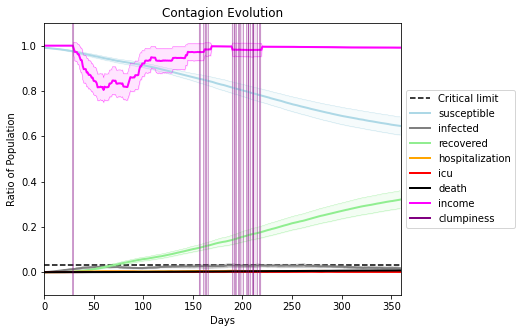

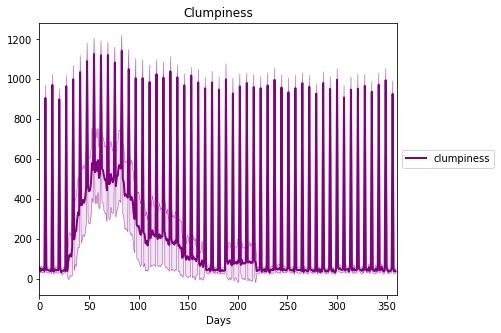

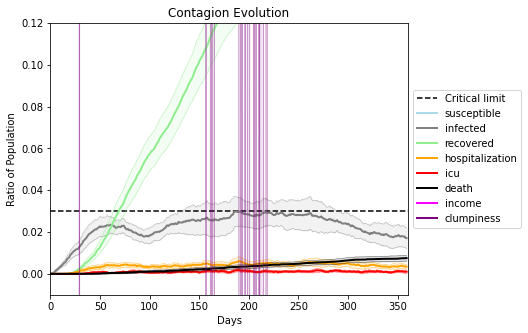

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[350, 25, 990, 2977, 4148, 8292, 2691, 7298, 3561, 3615, 9217, 6988, 8131, 4514, 9174, 7414, 8697, 7041, 145, 9717]
Average similarity between family members is 0.07358838057815312 at temperature 0.66
Average similarity between family and home is 0.9998512828717471 at temperature -1
Average similarity between students and their classroom is 0.0750304092196217 at temperature 0.66
Average classroom occupancy is 1.5405405405405406 and number classrooms is 185
Average similarity between workers is 0.053029553874451296 at temperature 0.66
Average office occupancy is 3.269607843137255 and number offices is 204
Average friend similarity for adults: 0.12439229575275991 for kids: 0.12379128755763084
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.01026603303235848
avg restaurant similarity -0.00464116124759969
avg restaurant similarity 0.010883091577415765
avg restaurant similarity 0.06979007504701219
avg restaurant similarity 0.04480319789912739
avg restaurant similarity -0.0026821866635255726
avg restaurant similarity 0.05421138365902658
avg restaurant similarity 0.08148071343527999
avg restaurant similarity 0.00921005221774534
avg restaurant similarity 0.03547407647852017
avg restaurant similarity 0.08064198103191968
avg restaurant similarity 0.037729927129325484
avg restaurant similarity 0.03766429709060354
avg restaurant similarity 0.05475927940179199
avg restaurant similarity -0.05325587810032302
avg restaurant similarity 0.016556155139827708
avg restaurant similarity 0.08148065133219352
avg restaurant similarity 0.0005673448588984106
avg restaurant similarity 0.054784594813835
avg restaurant similarity 0.054565524246086516
avg restaurant similarity 0.012045907864515188
avg restaurant similarit

avg restaurant similarity 0.008559972251711661
avg restaurant similarity 0.06303172546967556
avg restaurant similarity -0.008279142407277614
avg restaurant similarity 0.036590939360986854
avg restaurant similarity 0.07024658121057482
avg restaurant similarity 0.047040853975802835
avg restaurant similarity -0.0013201836312229393
avg restaurant similarity 0.010190813773881927
avg restaurant similarity 0.025949649778298806
avg restaurant similarity 0.015936918457646547
avg restaurant similarity 0.08182326421759858
avg restaurant similarity 0.002754239710406037
avg restaurant similarity 0.01865206717973012
avg restaurant similarity 0.006274970231910236
avg restaurant similarity 0.06623131126774849
avg restaurant similarity 0.028069017922715114
avg restaurant similarity 0.0003240395473982147
avg restaurant similarity 0.018842296017955756
avg restaurant similarity 0.010917691347919707
avg restaurant similarity -0.0034423682272863884
avg restaurant similarity 0.054979409405801344
avg restaura

avg restaurant similarity 0.00305497761611962
avg restaurant similarity 0.0001870078490842858
avg restaurant similarity 0.011752559939198083
avg restaurant similarity 0.00644862395429928
avg restaurant similarity 0.01732807172111046
avg restaurant similarity -0.004826387667574962
avg restaurant similarity 0.018020735903871262
avg restaurant similarity -0.013191657448472185
Average similarity between family members is 0.06185623440742159 at temperature 0.66
Average similarity between family and home is 0.9998403703837112 at temperature -1
Average similarity between students and their classroom is 0.06506856679469687 at temperature 0.66
Average classroom occupancy is 1.6628571428571428 and number classrooms is 175
Average similarity between workers is 0.056708378694038344 at temperature 0.66
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.1333509763081226 for kids: 0.1354063390157422
home_districts
[
Home (0,0) district with

avg restaurant similarity 0.018533320099025218
avg restaurant similarity 0.04263934572496346
avg restaurant similarity -0.013157868922725557
avg restaurant similarity 0.0038002500310134173
avg restaurant similarity 0.003196854456127537
avg restaurant similarity 0.015328096193254771
avg restaurant similarity 0.011470672771312817
avg restaurant similarity 0.01367788969619653
avg restaurant similarity 0.011770470211685225
avg restaurant similarity 0.0028061984142459524
avg restaurant similarity 0.04584882851302175
avg restaurant similarity 0.036102231153315074
avg restaurant similarity -0.007883578517531553
avg restaurant similarity 0.015652749580444165
avg restaurant similarity -0.04858267120867257
avg restaurant similarity 0.02699740674834107
avg restaurant similarity -0.002179835268830645
avg restaurant similarity 0.035310148843163615
avg restaurant similarity 0.05889141546298681
avg restaurant similarity 0.013690896991662187
avg restaurant similarity 0.03320965030984364
avg restaurant

avg restaurant similarity -0.007290307604603416
avg restaurant similarity 0.02846837567822376
avg restaurant similarity 0.026640753015467037
avg restaurant similarity 0.0049403548344927745
avg restaurant similarity 0.025039859165839205
avg restaurant similarity 0.005482695677455121
avg restaurant similarity 0.0122491533265695
avg restaurant similarity -0.006879233793528012
avg restaurant similarity 0.020868254309166855
avg restaurant similarity 0.026564611615751084
avg restaurant similarity 0.028056660467822635
avg restaurant similarity 0.029076174386950905
avg restaurant similarity -0.005630942531447617
avg restaurant similarity 0.02890923280078373
avg restaurant similarity 0.01959102680621758
avg restaurant similarity -0.05082601252725534
avg restaurant similarity 0.057888796167732536
avg restaurant similarity -0.016482072447898663
avg restaurant similarity 0.02808080801737019
avg restaurant similarity 0.025311396787300145
avg restaurant similarity 0.012538648127159185
avg restaurant

avg restaurant similarity 0.037586866663277714
avg restaurant similarity 0.03999023660634546
avg restaurant similarity 0.04121102683126944
avg restaurant similarity -0.017496223774489096
avg restaurant similarity -0.0012165355135021747
avg restaurant similarity 0.0500404999537429
avg restaurant similarity 0.0019777084279886583
avg restaurant similarity -0.012569816928015606
avg restaurant similarity 0.04469950395668983
avg restaurant similarity -0.011402636741022813
Average similarity between family members is 0.058729375185951775 at temperature 0.66
Average similarity between family and home is 0.9998546964612491 at temperature -1
Average similarity between students and their classroom is 0.086485081509747 at temperature 0.66
Average classroom occupancy is 1.5804597701149425 and number classrooms is 174
Average similarity between workers is 0.09207718752527433 at temperature 0.66
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adu

avg restaurant similarity -0.02670011388928061
avg restaurant similarity -0.013429445378106223
avg restaurant similarity -0.003316675828113797
avg restaurant similarity 0.0043794218661264445
avg restaurant similarity -0.00908694416321058
avg restaurant similarity -0.015408416162639802
avg restaurant similarity -0.01314086577508335
avg restaurant similarity -0.008535857527931096
avg restaurant similarity 0.019039827437074757
avg restaurant similarity 0.017405897014676243
avg restaurant similarity 0.010922800293718579
avg restaurant similarity -0.004024028302466733
avg restaurant similarity -0.027115917422054145
avg restaurant similarity -0.008210275425031539
avg restaurant similarity 0.014986228793891408
avg restaurant similarity 0.044578841376447416
avg restaurant similarity 0.018340530019619813
avg restaurant similarity 0.0034473340935417362
avg restaurant similarity 0.03202334675573242
avg restaurant similarity -0.03019682296718526
avg restaurant similarity -0.02724390917949902
avg r

avg restaurant similarity -0.014318047325535875
avg restaurant similarity 0.008855208137493908
avg restaurant similarity -0.013513267742279686
avg restaurant similarity 0.027736429004766888
avg restaurant similarity -0.02143153451524963
avg restaurant similarity 0.04123868768889748
avg restaurant similarity -0.02201352531873636
avg restaurant similarity 0.013013931416608927
avg restaurant similarity -0.003985446301189802
avg restaurant similarity -0.02103686442978352
avg restaurant similarity -0.005445237098732937
avg restaurant similarity -0.03481723307408729
avg restaurant similarity 0.0010928282851821595
avg restaurant similarity 0.027603234582889102
avg restaurant similarity 0.0007980893515757125
avg restaurant similarity -0.007834116679023588
avg restaurant similarity 0.012888220639114647
avg restaurant similarity -0.012765961795699965
avg restaurant similarity -0.0050193856752500515
avg restaurant similarity 0.0025327811382890417
avg restaurant similarity 0.008410805688316304
avg

avg restaurant similarity -0.001276552698745292
avg restaurant similarity 0.0026723892200251308
avg restaurant similarity 0.00862469242205142
avg restaurant similarity 0.03070684365037311
avg restaurant similarity 0.0029687990238884006
avg restaurant similarity 0.0058047427548014495
avg restaurant similarity 0.00803104885954978
avg restaurant similarity 0.01207807526164246
avg restaurant similarity 0.0013214160054992184
avg restaurant similarity 0.006788214636722704
avg restaurant similarity -0.01423893848104662
avg restaurant similarity 0.0010299404032979072
avg restaurant similarity 0.034797897173327354
Average similarity between family members is 0.04861761879724853 at temperature 0.66
Average similarity between family and home is 0.9998623629204682 at temperature -1
Average similarity between students and their classroom is 0.05023467685744884 at temperature 0.66
Average classroom occupancy is 1.5193370165745856 and number classrooms is 181
Average similarity between workers is 0.0

avg restaurant similarity 0.018241228467148027
avg restaurant similarity 0.03299620837963034
avg restaurant similarity 0.0415638424876864
avg restaurant similarity 0.03189056677651115
avg restaurant similarity 0.0432498488831548
avg restaurant similarity 0.014177018384601545
avg restaurant similarity 0.010209202540264412
avg restaurant similarity 0.06410843838193314
avg restaurant similarity 0.026112519407727634
avg restaurant similarity -0.006955054392296275
avg restaurant similarity 0.07033503535578178
avg restaurant similarity 0.07304930000074902
avg restaurant similarity 0.04702048449978508
avg restaurant similarity 0.04911839564725806
avg restaurant similarity 0.024570807915108517
avg restaurant similarity 0.01896257317122839
avg restaurant similarity 0.013519109278564109
avg restaurant similarity 0.03883225921698884
avg restaurant similarity 0.07468757716382059
avg restaurant similarity 0.03911223230155947
avg restaurant similarity 0.05570619375811487
avg restaurant similarity 0.

avg restaurant similarity 0.027914026694991514
avg restaurant similarity 0.012470720379038252
avg restaurant similarity 0.04863514011318238
avg restaurant similarity 0.040610824377213375
avg restaurant similarity 0.008077711821485764
avg restaurant similarity 0.011238622629549899
avg restaurant similarity 0.017775583598610114
avg restaurant similarity 0.027321705863707562
avg restaurant similarity 0.0478349540648804
avg restaurant similarity 0.05718426157252631
avg restaurant similarity 0.052689107783485
avg restaurant similarity 0.015784092723116042
avg restaurant similarity 0.04168955105669684
avg restaurant similarity -0.010487556801307167
avg restaurant similarity 0.04401686609712714
avg restaurant similarity 0.05002318072310677
avg restaurant similarity -0.006617207104981412
avg restaurant similarity 0.04952494235410255
avg restaurant similarity 0.07804256368329263
avg restaurant similarity 0.006957548488194273
avg restaurant similarity 0.007294641449062913
avg restaurant similari

avg restaurant similarity -0.0068072592715913436
avg restaurant similarity 0.009367604484418353
avg restaurant similarity 0.01814042334580403
avg restaurant similarity 0.02247069022686037
avg restaurant similarity 0.07177230531434103
avg restaurant similarity 0.009952508740600816
avg restaurant similarity 0.03747703128682713
Average similarity between family members is 0.06095901968604055 at temperature 0.66
Average similarity between family and home is 0.9998544868203597 at temperature -1
Average similarity between students and their classroom is 0.08347587932309797 at temperature 0.66
Average classroom occupancy is 1.646341463414634 and number classrooms is 164
Average similarity between workers is 0.06547197622298469 at temperature 0.66
Average office occupancy is 3.386934673366834 and number offices is 199
Average friend similarity for adults: 0.12783281067928476 for kids: 0.12700818018635476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity -0.0433258006898047
avg restaurant similarity 0.023141087089400183
avg restaurant similarity 0.041264887502648916
avg restaurant similarity 0.03534465534659372
avg restaurant similarity 0.001514917369371949
avg restaurant similarity 0.042758685106012835
avg restaurant similarity 0.035707781256719626
avg restaurant similarity 0.030945984319955114
avg restaurant similarity 0.028456368268207254
avg restaurant similarity -0.007728000728785257
avg restaurant similarity 0.0176279814596141
avg restaurant similarity 0.004592181959681635
avg restaurant similarity 0.02405688346925651
avg restaurant similarity 0.001615693687984772
avg restaurant similarity -0.001139111931154698
avg restaurant similarity 0.012608878839936444
avg restaurant similarity 0.01887841335946069
avg restaurant similarity 0.0095179742934656
avg restaurant similarity -0.021643462529743893
avg restaurant similarity -0.022088099137452813
avg restaurant similarity 0.014559208477517384
avg restaurant si

avg restaurant similarity 0.01390035277761666
avg restaurant similarity 0.035447253347050116
avg restaurant similarity -0.004044499033980739
avg restaurant similarity 0.04088746519879958
avg restaurant similarity 0.06661380608766013
avg restaurant similarity 0.03653616982059221
avg restaurant similarity -0.005788459035415797
avg restaurant similarity 0.049842650551864966
avg restaurant similarity 0.02705012265785822
avg restaurant similarity 0.022565371498197727
avg restaurant similarity 0.008362476447947008
avg restaurant similarity -0.008296838641020491
avg restaurant similarity -0.0020743720814799106
avg restaurant similarity 0.02410967572475197
avg restaurant similarity 0.034910769168120616
avg restaurant similarity -0.04278423284074101
avg restaurant similarity 0.019645627846305802
avg restaurant similarity 0.016319405462245074
avg restaurant similarity 0.018489930404176198
avg restaurant similarity 0.004101316000658486
avg restaurant similarity -0.026285665894401913
avg restauran

avg restaurant similarity -0.012541826566539797
avg restaurant similarity 0.0142363486381436
avg restaurant similarity -0.005909848837202077
avg restaurant similarity 0.00929583244492976
avg restaurant similarity 0.0633350783210442
avg restaurant similarity -0.033327464604671564
avg restaurant similarity -0.0026749751903481066
avg restaurant similarity 0.0067757785665923395
avg restaurant similarity 0.016999147877555135
avg restaurant similarity 0.05827554447107532
Average similarity between family members is 0.060518311844113534 at temperature 0.66
Average similarity between family and home is 0.9998558050120357 at temperature -1
Average similarity between students and their classroom is 0.056856309803910494 at temperature 0.66
Average classroom occupancy is 1.6404494382022472 and number classrooms is 178
Average similarity between workers is 0.04662719662220899 at temperature 0.66
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for a

avg restaurant similarity 0.008152767530563994
avg restaurant similarity 0.07361217586267038
avg restaurant similarity 0.056102107230857394
avg restaurant similarity 0.048315524872446884
avg restaurant similarity 0.0712843678712022
avg restaurant similarity 0.04105068456709541
avg restaurant similarity 0.07345568138024104
avg restaurant similarity 0.052097779908260804
avg restaurant similarity 0.047820277372584555
avg restaurant similarity 0.04334108547115155
avg restaurant similarity -0.009796819002549192
avg restaurant similarity 0.032287710712792454
avg restaurant similarity 0.0657678543919925
avg restaurant similarity 0.03707960577821934
avg restaurant similarity 0.021778410963972723
avg restaurant similarity 0.015240402161837469
avg restaurant similarity -0.032052069274205716
avg restaurant similarity 0.040292742630711156
avg restaurant similarity 0.008848802748268722
avg restaurant similarity 0.065847640460153
avg restaurant similarity 0.018883927639695892
avg restaurant similari

avg restaurant similarity 0.026571520554632622
avg restaurant similarity 0.06575907101351289
avg restaurant similarity -0.0008665061162666358
avg restaurant similarity 0.00045589062887423294
avg restaurant similarity -0.020784949051287385
avg restaurant similarity 0.0458771301875745
avg restaurant similarity 0.032977629672599644
avg restaurant similarity 0.049131271920199795
avg restaurant similarity 0.06421797717796837
avg restaurant similarity 0.07271702243878264
avg restaurant similarity 0.07475183563567327
avg restaurant similarity 0.045215226934043465
avg restaurant similarity 0.019722337512856167
avg restaurant similarity 0.051274727641413394
avg restaurant similarity 0.010700161455055023
avg restaurant similarity 0.0427210759411998
avg restaurant similarity 0.012110935811082465
avg restaurant similarity -0.024698445361942357
avg restaurant similarity 0.029895428226293652
avg restaurant similarity 0.014367525247311974
avg restaurant similarity -0.007192845741970046
avg restaurant

avg restaurant similarity 0.03687016952409444
avg restaurant similarity 0.06473663350546419
avg restaurant similarity 0.05881326098428994
avg restaurant similarity 0.012272544128604925
avg restaurant similarity 0.06503129766959982
avg restaurant similarity -0.023056289549299794
Average similarity between family members is 0.0565896647791433 at temperature 0.66
Average similarity between family and home is 0.9998480315723728 at temperature -1
Average similarity between students and their classroom is 0.043098360404316374 at temperature 0.66
Average classroom occupancy is 1.6593406593406594 and number classrooms is 182
Average similarity between workers is 0.05494601700131974 at temperature 0.66
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity for adults: 0.12704136661043902 for kids: 0.12365154616804303
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units

avg restaurant similarity -0.031443310899698595
avg restaurant similarity 0.03172031335801658
avg restaurant similarity 0.052306652858070464
avg restaurant similarity 0.017120939707474286
avg restaurant similarity 0.014358591096868708
avg restaurant similarity 0.01613682512265037
avg restaurant similarity -0.011746793136769481
avg restaurant similarity 0.021361411796101862
avg restaurant similarity 0.013311378707831707
avg restaurant similarity -0.011837008748310035
avg restaurant similarity -0.017426036867327774
avg restaurant similarity -0.00689734143750085
avg restaurant similarity 0.02013502450071035
avg restaurant similarity -0.002302063098562395
avg restaurant similarity -0.02463563380703612
avg restaurant similarity 0.02081916787843133
avg restaurant similarity 0.014568220781115469
avg restaurant similarity 0.0006666104354737958
avg restaurant similarity 0.035062996576371346
avg restaurant similarity 0.008873842145267855
avg restaurant similarity -0.01153704697678939
avg restaur

avg restaurant similarity 0.03352014410694134
avg restaurant similarity -0.02406970495438485
avg restaurant similarity 0.003616595843620808
avg restaurant similarity 0.019463757633610038
avg restaurant similarity 0.07061923750724204
avg restaurant similarity 0.0378135739504216
avg restaurant similarity -0.028896188097268745
avg restaurant similarity 0.03009195716281153
avg restaurant similarity 0.037373156474328637
avg restaurant similarity 0.01702221988407207
avg restaurant similarity 0.01834252024091117
avg restaurant similarity -0.010748558529014874
avg restaurant similarity 0.014864899947006708
avg restaurant similarity 0.04112418031558222
avg restaurant similarity 0.013054970947868162
avg restaurant similarity 0.019933665386177968
avg restaurant similarity -0.0018943262515547503
avg restaurant similarity 0.059078908755355465
avg restaurant similarity -0.011329672465942724
avg restaurant similarity 0.004885223675714579
avg restaurant similarity 0.000480897720565923
avg restaurant s

avg restaurant similarity 0.09574021648352561
avg restaurant similarity -0.033890033836604556
avg restaurant similarity 0.012968492575522631
avg restaurant similarity 0.030151186104579977
avg restaurant similarity -0.0017184688181546334
avg restaurant similarity 0.041891316398440244
avg restaurant similarity 0.029718262721093635
avg restaurant similarity -0.0029656692007697825
avg restaurant similarity -0.006798996163265436
avg restaurant similarity -0.010401234482731798
avg restaurant similarity 0.039200838817176856
Average similarity between family members is 0.07169742706750973 at temperature 0.66
Average similarity between family and home is 0.9998406241512218 at temperature -1
Average similarity between students and their classroom is 0.0811780684296992 at temperature 0.66
Average classroom occupancy is 1.6162790697674418 and number classrooms is 172
Average similarity between workers is 0.061427994776523755 at temperature 0.66
Average office occupancy is 3.2610837438423643 and nu

avg restaurant similarity 0.030653534071428915
avg restaurant similarity 0.03242081507000466
avg restaurant similarity 0.03353990418738465
avg restaurant similarity 0.021934193799978408
avg restaurant similarity 0.0197137042899897
avg restaurant similarity 0.014353331980037149
avg restaurant similarity 0.0007687925429023109
avg restaurant similarity -0.02377151364916073
avg restaurant similarity -0.0014994254709495218
avg restaurant similarity 0.04554876186813927
avg restaurant similarity 0.037435089601445246
avg restaurant similarity 0.021756926571484744
avg restaurant similarity 0.027768865402232015
avg restaurant similarity -0.03623435103528844
avg restaurant similarity -0.0014233139969742135
avg restaurant similarity 0.014346090933958684
avg restaurant similarity -0.02574033966144106
avg restaurant similarity 0.03128287304989781
avg restaurant similarity 0.04044980405237508
avg restaurant similarity 0.011492109485661633
avg restaurant similarity 0.04557507662294807
avg restaurant s

avg restaurant similarity -0.0010467720620028235
avg restaurant similarity 0.04123818165085023
avg restaurant similarity -0.0038362309399475533
avg restaurant similarity 0.02828612571922166
avg restaurant similarity -0.003370282130545194
avg restaurant similarity 0.022954479929965483
avg restaurant similarity -0.0054958346773495105
avg restaurant similarity -0.019706321652339345
avg restaurant similarity -0.0037555789868505044
avg restaurant similarity 0.022259445373973608
avg restaurant similarity 0.017241387658984614
avg restaurant similarity 0.011189883379600571
avg restaurant similarity 0.05905798875589884
avg restaurant similarity 0.03163948510480556
avg restaurant similarity 0.05751008168072957
avg restaurant similarity 0.04377567807490188
avg restaurant similarity 0.026655963325808166
avg restaurant similarity 0.03627728344742292
avg restaurant similarity 0.0007519916348326205
avg restaurant similarity 0.06871352233471183
avg restaurant similarity 0.013699903019754591
avg restau

avg restaurant similarity 0.01784278985853935
avg restaurant similarity -0.03418703962204386
avg restaurant similarity 0.036321716885603615
avg restaurant similarity 0.014092338615279672
avg restaurant similarity 0.030070580470682853
avg restaurant similarity -0.010776179998409786
avg restaurant similarity 0.03582692472234712
avg restaurant similarity 0.06679401848603012
Average similarity between family members is 0.044056783124919216 at temperature 0.66
Average similarity between family and home is 0.9998548612873187 at temperature -1
Average similarity between students and their classroom is 0.04813456567043188 at temperature 0.66
Average classroom occupancy is 1.4943820224719102 and number classrooms is 178
Average similarity between workers is 0.053155464956680706 at temperature 0.66
Average office occupancy is 3.3658536585365852 and number offices is 205
Average friend similarity for adults: 0.12143055526159226 for kids: 0.11711384528193204
home_districts
[
Home (0,0) district wi

avg restaurant similarity 0.013171019228798868
avg restaurant similarity 0.018485051414088453
avg restaurant similarity 0.026983534177336937
avg restaurant similarity 0.005777612120710898
avg restaurant similarity 0.015928095422892603
avg restaurant similarity 0.0031449646956258127
avg restaurant similarity 0.04040597006176017
avg restaurant similarity 0.03974098978305934
avg restaurant similarity 0.03361983193411932
avg restaurant similarity 0.02770893752323103
avg restaurant similarity 0.00943877236490838
avg restaurant similarity 0.02048149621844996
avg restaurant similarity 0.029037194305996775
avg restaurant similarity 0.013257387611462047
avg restaurant similarity 0.028623821076564308
avg restaurant similarity 0.007807531309764058
avg restaurant similarity 0.020372540085008117
avg restaurant similarity 0.027646959780745838
avg restaurant similarity 0.030735705833322396
avg restaurant similarity -0.0173160670750468
avg restaurant similarity 0.036532007696565706
avg restaurant simi

avg restaurant similarity 0.012117060087435337
avg restaurant similarity 0.04537037256614868
avg restaurant similarity 0.014357405441612302
avg restaurant similarity 0.019634383457774473
avg restaurant similarity -0.0024642391778506977
avg restaurant similarity -0.002637759902285562
avg restaurant similarity 0.011067969615214205
avg restaurant similarity -0.014643188687779786
avg restaurant similarity 0.011262406930277611
avg restaurant similarity 0.015796047861361212
avg restaurant similarity 0.0034620495104371717
avg restaurant similarity 0.028591762270801572
avg restaurant similarity 0.014085966591591404
avg restaurant similarity 0.03329085866316786
avg restaurant similarity 0.0714534401893882
avg restaurant similarity 0.011875133104035561
avg restaurant similarity 0.026513844265463982
avg restaurant similarity -0.007000399818910042
avg restaurant similarity 0.012308173565858747
avg restaurant similarity 0.022204963970239685
avg restaurant similarity 0.05568339752150362
avg restaura

avg restaurant similarity -0.005618643929146092
avg restaurant similarity 0.011184662444719053
avg restaurant similarity 0.0058666377651023964
avg restaurant similarity 0.0185560297538486
avg restaurant similarity -0.021221817640328947
avg restaurant similarity 0.03745235907735016
avg restaurant similarity 0.03911731147668224
avg restaurant similarity 0.013949008707425778
avg restaurant similarity 0.020847145521006617
avg restaurant similarity 0.055612755434672166
Average similarity between family members is 0.08987992113460773 at temperature 0.66
Average similarity between family and home is 0.999859965110344 at temperature -1
Average similarity between students and their classroom is 0.038271570330605936 at temperature 0.66
Average classroom occupancy is 1.6011560693641618 and number classrooms is 173
Average similarity between workers is 0.04849008902268051 at temperature 0.66
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adult

avg restaurant similarity -0.0022049669589852684
avg restaurant similarity 0.05687187998461734
avg restaurant similarity 0.07777024860602805
avg restaurant similarity 0.02267678829602142
avg restaurant similarity 0.052080941453353985
avg restaurant similarity 0.04249889644410526
avg restaurant similarity 0.014140854195903513
avg restaurant similarity 0.033744873233515764
avg restaurant similarity 0.001747297210540165
avg restaurant similarity 0.053521480898858546
avg restaurant similarity 0.021012913042902877
avg restaurant similarity 0.02490678992037407
avg restaurant similarity 0.04579695089357174
avg restaurant similarity 0.07509483922817753
avg restaurant similarity 0.06496111614640167
avg restaurant similarity 0.039462701396849195
avg restaurant similarity 0.02885320923249763
avg restaurant similarity 0.03974194748270275
avg restaurant similarity 0.024599827141608025
avg restaurant similarity 0.05423527719055035
avg restaurant similarity 0.03483572390941645
avg restaurant similari

avg restaurant similarity 0.023135109311745488
avg restaurant similarity 0.03754407387807081
avg restaurant similarity 0.04973111058063631
avg restaurant similarity 0.08870308582650059
avg restaurant similarity 0.018454179226216533
avg restaurant similarity 0.056767092501451774
avg restaurant similarity 0.016298269266227815
avg restaurant similarity 0.05625603328468207
avg restaurant similarity 0.029086191509925967
avg restaurant similarity 0.04327709955120616
avg restaurant similarity -0.0020475405885461554
avg restaurant similarity 0.0503321584959837
avg restaurant similarity 0.05768013436040669
avg restaurant similarity 0.02050147090365201
avg restaurant similarity 0.022283243334377992
avg restaurant similarity 0.005088249030940439
avg restaurant similarity 0.039607153797911035
avg restaurant similarity 0.05784614721661249
avg restaurant similarity 0.06473646013268171
avg restaurant similarity 0.022800323893265802
avg restaurant similarity 0.023423785069571032
avg restaurant similar

avg restaurant similarity -0.0019579356926609126
avg restaurant similarity 0.06588801010288789
avg restaurant similarity 0.04667700916256096
avg restaurant similarity 0.007528317686345888
avg restaurant similarity 0.03593566545638445
avg restaurant similarity 0.04094727639878739
avg restaurant similarity 0.0393996204201706
avg restaurant similarity 0.0256296541006376
Average similarity between family members is 0.05930232548593528 at temperature 0.66
Average similarity between family and home is 0.9998498136189022 at temperature -1
Average similarity between students and their classroom is -0.005135353420924194 at temperature 0.66
Average classroom occupancy is 1.5789473684210527 and number classrooms is 190
Average similarity between workers is 0.05250601723921471 at temperature 0.66
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.12399985014323217 for kids: 0.1280947323825781
home_districts
[
Home (0,0) district with 1 Buildings
Homo

avg restaurant similarity -0.020573933729848098
avg restaurant similarity 0.08094949399055111
avg restaurant similarity -0.001204299361157494
avg restaurant similarity 0.013991739992967435
avg restaurant similarity 0.07313369666422628
avg restaurant similarity 0.0065664458424674384
avg restaurant similarity -0.0392163014919681
avg restaurant similarity 0.031511854525392825
avg restaurant similarity 0.017037357668822986
avg restaurant similarity 0.0028355015783590285
avg restaurant similarity 0.003947237076524194
avg restaurant similarity 0.017706357223803884
avg restaurant similarity 0.015151955997418032
avg restaurant similarity 0.04523424062347241
avg restaurant similarity 0.041226579088704716
avg restaurant similarity 0.05897986925106538
avg restaurant similarity 0.07086478742431622
avg restaurant similarity 0.011878118149092974
avg restaurant similarity 0.032215495155628056
avg restaurant similarity 0.014013081481228349
avg restaurant similarity 0.03913554470367717
avg restaurant s

avg restaurant similarity 0.025897802014823734
avg restaurant similarity 0.06267549485142046
avg restaurant similarity -0.014042039108152273
avg restaurant similarity 0.004256789501270593
avg restaurant similarity 0.02634863087317602
avg restaurant similarity 0.017438585572642426
avg restaurant similarity 0.023142530591673
avg restaurant similarity -0.03850240909069758
avg restaurant similarity -0.003119165715740772
avg restaurant similarity 0.017668771217980866
avg restaurant similarity 0.0071550971696221315
avg restaurant similarity 0.005345480762698289
avg restaurant similarity 0.04103253722825489
avg restaurant similarity -0.019647141841973203
avg restaurant similarity 0.04321420002542494
avg restaurant similarity -0.007833978754896017
avg restaurant similarity 0.060432654554930215
avg restaurant similarity 0.004220433617432405
avg restaurant similarity -0.014589234849481034
avg restaurant similarity -0.0324499325984868
avg restaurant similarity 0.012884739871501018
avg restaurant 

avg restaurant similarity 0.02228556508761665
avg restaurant similarity 0.015197016847497318
avg restaurant similarity 0.027674812002895094
avg restaurant similarity 0.0337170758924765
avg restaurant similarity -0.022104495395755236
avg restaurant similarity 0.04070204983372321
avg restaurant similarity 0.026628865791494684
avg restaurant similarity 0.026809102281380472
avg restaurant similarity 0.03316664438399919
Average similarity between family members is 0.08268413816499265 at temperature 0.66
Average similarity between family and home is 0.9998513761796609 at temperature -1
Average similarity between students and their classroom is 0.06330285927258757 at temperature 0.66
Average classroom occupancy is 1.5614973262032086 and number classrooms is 187
Average similarity between workers is 0.03955524167610149 at temperature 0.66
Average office occupancy is 3.1435643564356437 and number offices is 202
Average friend similarity for adults: 0.12775087712409047 for kids: 0.137107690592
h

avg restaurant similarity 0.0476425913152244
avg restaurant similarity 0.030061953648562574
avg restaurant similarity 0.01977839650971992
avg restaurant similarity 0.014537255045458093
avg restaurant similarity 0.03798354281945612
avg restaurant similarity 0.0070168828415279145
avg restaurant similarity 0.023054687463895454
avg restaurant similarity 0.04672051716176939
avg restaurant similarity 0.0603939516989384
avg restaurant similarity 0.0404884606602903
avg restaurant similarity 0.034746910603786485
avg restaurant similarity 0.008372865207344172
avg restaurant similarity 0.06409599447581736
avg restaurant similarity 0.03127121148511913
avg restaurant similarity 0.07328520579761832
avg restaurant similarity 0.018130711937657258
avg restaurant similarity 0.07495528234986998
avg restaurant similarity 0.03580960498801859
avg restaurant similarity 0.06409466381581715
avg restaurant similarity 0.022723506823417356
avg restaurant similarity 0.03735828700194753
avg restaurant similarity -0

avg restaurant similarity 0.06504625160049218
avg restaurant similarity 0.059098584557479
avg restaurant similarity 0.04004273605045969
avg restaurant similarity 0.01931498897786037
avg restaurant similarity 0.0542797505156556
avg restaurant similarity 0.030450902674615744
avg restaurant similarity 0.012107340560477324
avg restaurant similarity 0.028765569514573423
avg restaurant similarity 0.015637074893676134
avg restaurant similarity 0.005502150020238602
avg restaurant similarity 0.07509311075474455
avg restaurant similarity 0.019557592094946428
avg restaurant similarity 0.01573604139132328
avg restaurant similarity 0.05640777544880066
avg restaurant similarity 0.029502429536674157
avg restaurant similarity 0.060801773001801264
avg restaurant similarity 0.01756443356790686
avg restaurant similarity 0.011784527520934469
avg restaurant similarity 0.020303424961682043
avg restaurant similarity 0.04468240677372037
avg restaurant similarity 0.010421505828850756
avg restaurant similarity 

avg restaurant similarity 0.04168293287940222
avg restaurant similarity 0.004430480029227252
avg restaurant similarity 0.05743268146911824
avg restaurant similarity 0.04850968320088128
avg restaurant similarity 0.009895307705802105
avg restaurant similarity 0.03937505459435607
Average similarity between family members is 0.05148041450516912 at temperature 0.66
Average similarity between family and home is 0.9998385623531382 at temperature -1
Average similarity between students and their classroom is 0.03618465749753966 at temperature 0.66
Average classroom occupancy is 1.6047904191616766 and number classrooms is 167
Average similarity between workers is 0.06247363486851761 at temperature 0.66
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.12122599363121404 for kids: 0.12925813007803721
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units 

avg restaurant similarity 0.053674849729777645
avg restaurant similarity 0.04125801080098687
avg restaurant similarity 0.0413389721610796
avg restaurant similarity 0.06099412508681518
avg restaurant similarity 0.06776912429260323
avg restaurant similarity 0.09270552876563537
avg restaurant similarity 0.04647612490627252
avg restaurant similarity 0.009549172582304626
avg restaurant similarity 0.036816338074167884
avg restaurant similarity 0.004268533853707973
avg restaurant similarity 0.020494671438546073
avg restaurant similarity 0.04170361288666577
avg restaurant similarity 0.012865243605898549
avg restaurant similarity 0.039879987710698714
avg restaurant similarity 0.026447504795149582
avg restaurant similarity -0.0020037486069148054
avg restaurant similarity 0.06009398495527234
avg restaurant similarity -0.000486844739645804
avg restaurant similarity -0.018885970235542497
avg restaurant similarity 0.035737225428024245
avg restaurant similarity 0.0299804446644837
avg restaurant simil

avg restaurant similarity 0.04487019060451489
avg restaurant similarity -6.491010124140996e-06
avg restaurant similarity 0.029130037181177952
avg restaurant similarity 0.05911929938648822
avg restaurant similarity 0.05136901968218846
avg restaurant similarity 0.0069215156244334325
avg restaurant similarity 0.04594005859221347
avg restaurant similarity 0.04293005964275133
avg restaurant similarity 0.019433924578013812
avg restaurant similarity 0.05624912273873286
avg restaurant similarity 0.015578677634243046
avg restaurant similarity 0.03218881604126883
avg restaurant similarity 0.017696307815167973
avg restaurant similarity 0.05830057070987475
avg restaurant similarity 0.05658649424469708
avg restaurant similarity 0.000973967600276247
avg restaurant similarity 0.028927010979812543
avg restaurant similarity 0.009734838904049739
avg restaurant similarity 0.08487604170843094
avg restaurant similarity 0.02111344715177582
avg restaurant similarity 0.022822354639673248
avg restaurant simila

avg restaurant similarity 0.04721126006108938
avg restaurant similarity 0.0238331672167594
avg restaurant similarity 0.062088568592130876
avg restaurant similarity 0.02447812070400983
avg restaurant similarity 0.04518350310411388
avg restaurant similarity 0.04089267234831612
avg restaurant similarity 0.005016740916148767
Average similarity between family members is 0.05983342199381454 at temperature 0.66
Average similarity between family and home is 0.9998565441272397 at temperature -1
Average similarity between students and their classroom is 0.10601507070607454 at temperature 0.66
Average classroom occupancy is 1.6257668711656441 and number classrooms is 163
Average similarity between workers is 0.05868255373778922 at temperature 0.66
Average office occupancy is 3.3267326732673266 and number offices is 202
Average friend similarity for adults: 0.12639004454666317 for kids: 0.11472745416018393
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.018057412158688214
avg restaurant similarity 0.010462938556221695
avg restaurant similarity -0.006580375747289889
avg restaurant similarity -0.013823428677443819
avg restaurant similarity 0.03198879849130621
avg restaurant similarity 0.04712457274117182
avg restaurant similarity 0.03417009656806627
avg restaurant similarity 0.02575701438712279
avg restaurant similarity 0.0003820758099577098
avg restaurant similarity 0.05423953749584399
avg restaurant similarity -0.011095475605876644
avg restaurant similarity 0.05623609168258348
avg restaurant similarity 0.037159952316748415
avg restaurant similarity 0.0899700286679833
avg restaurant similarity 0.005690584196196623
avg restaurant similarity 0.06087571401989644
avg restaurant similarity 0.05015508857547169
avg restaurant similarity 0.008150404764268076
avg restaurant similarity -0.0026202870449924314
avg restaurant similarity 0.010816429903483436
avg restaurant similarity -0.009235078225014933
avg restaurant s

avg restaurant similarity -0.002299527408716668
avg restaurant similarity 0.013347180004212157
avg restaurant similarity 0.07093293085157132
avg restaurant similarity 0.013209636453223029
avg restaurant similarity 0.06145731349877966
avg restaurant similarity 0.06232587450712092
avg restaurant similarity 0.055683981863981144
avg restaurant similarity 0.021980936838053276
avg restaurant similarity 0.09312062073426408
avg restaurant similarity -0.017445775474784344
avg restaurant similarity 0.026776955105830426
avg restaurant similarity 0.06336690345314494
avg restaurant similarity 0.036301611681336464
avg restaurant similarity 0.020767308808907033
avg restaurant similarity 0.01664596631387641
avg restaurant similarity 0.014056822473065604
avg restaurant similarity 0.04720865044125664
avg restaurant similarity 0.06287541157628679
avg restaurant similarity 0.062402586413572395
avg restaurant similarity -0.003991719772080899
avg restaurant similarity -0.020181378846011788
avg restaurant si

avg restaurant similarity 0.04566469668415996
avg restaurant similarity 0.03564675333007888
avg restaurant similarity 0.07509553265246147
avg restaurant similarity 0.06806103987654528
avg restaurant similarity 0.016906094760908947
avg restaurant similarity -0.004953322773896116
avg restaurant similarity 0.021915323118819982
avg restaurant similarity 0.057176136243107724
Average similarity between family members is 0.059681288218042076 at temperature 0.66
Average similarity between family and home is 0.9998499742923311 at temperature -1
Average similarity between students and their classroom is 0.07797967950759677 at temperature 0.66
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.0641889086135866 at temperature 0.66
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.12729755632113834 for kids: 0.125804085039684
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.03195985080053058
avg restaurant similarity 0.0315331980890349
avg restaurant similarity 0.04390635585382814
avg restaurant similarity 0.00404560761598669
avg restaurant similarity 0.012390243208906785
avg restaurant similarity -0.009069731852355791
avg restaurant similarity 0.004011831419801017
avg restaurant similarity 0.008191541609947364
avg restaurant similarity -0.002359126630660925
avg restaurant similarity 0.032479423393014996
avg restaurant similarity 0.026392411147096246
avg restaurant similarity 0.026343105541191462
avg restaurant similarity 0.016875691163186327
avg restaurant similarity 0.024742530703213774
avg restaurant similarity 0.08350974376993908
avg restaurant similarity -0.006838502751843546
avg restaurant similarity 0.039475878636490866
avg restaurant similarity -0.00811875299182084
avg restaurant similarity 0.029267958853645536
avg restaurant similarity 0.01819324692529943
avg restaurant similarity 0.01940301628537612
avg restaurant sim

avg restaurant similarity 0.04513584524576167
avg restaurant similarity 0.00616456871421335
avg restaurant similarity 0.03806858916373636
avg restaurant similarity 0.03798993005968902
avg restaurant similarity 0.0265036837975563
avg restaurant similarity 0.013421151406031067
avg restaurant similarity -0.0276915923817799
avg restaurant similarity 0.026001127415478085
avg restaurant similarity 0.01822716788006675
avg restaurant similarity 0.028555720610369074
avg restaurant similarity 0.008117980327480569
avg restaurant similarity -0.001104712990908249
avg restaurant similarity 0.031283411467906454
avg restaurant similarity -0.012644343633194128
avg restaurant similarity 0.022739277062052553
avg restaurant similarity 0.04099641042583153
avg restaurant similarity 0.03481822709007584
avg restaurant similarity 0.025239955684130563
avg restaurant similarity -0.008451011289477233
avg restaurant similarity 0.032508655438543387
avg restaurant similarity 0.026059168831615766
avg restaurant simil

avg restaurant similarity 0.009666345966438686
avg restaurant similarity -0.02405961637061284
avg restaurant similarity 0.058176762779380053
avg restaurant similarity -0.007185693723003609
avg restaurant similarity 0.019226245802584013
avg restaurant similarity 0.054030361149948546
avg restaurant similarity 0.05775108607899802
avg restaurant similarity 0.0516340486714621
avg restaurant similarity -0.0023958180507814963
avg restaurant similarity 0.011643063235206317
Average similarity between family members is 0.062431577608471074 at temperature 0.66
Average similarity between family and home is 0.9998474152596166 at temperature -1
Average similarity between students and their classroom is 0.056252756912851636 at temperature 0.66
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.06440604086618683 at temperature 0.66
Average office occupancy is 3.2794117647058822 and number offices is 204
Average friend similarity for a

avg restaurant similarity -0.009447078614222199
avg restaurant similarity 0.05873774030960681
avg restaurant similarity 0.02739525948410563
avg restaurant similarity -0.01536000855879444
avg restaurant similarity 0.03822752918282771
avg restaurant similarity 0.057224246682372956
avg restaurant similarity 0.05478604629766752
avg restaurant similarity 0.050910552789482616
avg restaurant similarity 0.037459968912726536
avg restaurant similarity 0.029940642714040278
avg restaurant similarity 0.04732091923083303
avg restaurant similarity 0.020460426756403756
avg restaurant similarity 0.06967230803927725
avg restaurant similarity -0.019454462586606994
avg restaurant similarity 0.025875138393792685
avg restaurant similarity -0.03166158995519693
avg restaurant similarity 0.01891594818495257
avg restaurant similarity 0.03540316921868817
avg restaurant similarity 0.038015842030443336
avg restaurant similarity 0.0219193631390422
avg restaurant similarity 0.017517614292882205
avg restaurant simila

avg restaurant similarity 0.016295696605861422
avg restaurant similarity 0.03187043821438143
avg restaurant similarity 0.05278538540683481
avg restaurant similarity 0.007072453568508452
avg restaurant similarity 0.004173485508556177
avg restaurant similarity 0.02043183160564362
avg restaurant similarity 0.014909323897949835
avg restaurant similarity -0.052019747456352385
avg restaurant similarity 0.0625144586916435
avg restaurant similarity 0.004276750240266812
avg restaurant similarity 0.05827927366343055
avg restaurant similarity 0.011576428120979684
avg restaurant similarity 0.04156157305027753
avg restaurant similarity 0.0011773818956370683
avg restaurant similarity 0.03908960878728348
avg restaurant similarity -0.0016597705429941046
avg restaurant similarity 0.05940096260838672
avg restaurant similarity 0.025101802837640137
avg restaurant similarity 0.0005189927082171654
avg restaurant similarity 0.05191104451538516
avg restaurant similarity 0.012820103310940583
avg restaurant sim

avg restaurant similarity -0.0032545785158827694
avg restaurant similarity 0.056216217789742624
avg restaurant similarity 0.014620532910872949
avg restaurant similarity 0.047572365636823655
avg restaurant similarity 0.05678617448163037
avg restaurant similarity -0.008466387738877416
avg restaurant similarity -0.005469672521372371
avg restaurant similarity -0.020278211658957285
avg restaurant similarity 0.015676024830569506
Average similarity between family members is 0.05707083637262156 at temperature 0.66
Average similarity between family and home is 0.9998403448376297 at temperature -1
Average similarity between students and their classroom is 0.08420856184108695 at temperature 0.66
Average classroom occupancy is 1.6793478260869565 and number classrooms is 184
Average similarity between workers is 0.04353155340467946 at temperature 0.66
Average office occupancy is 3.3489583333333335 and number offices is 192
Average friend similarity for adults: 0.12575181953219275 for kids: 0.137390

avg restaurant similarity 0.04663208009291231
avg restaurant similarity 0.06757446190884749
avg restaurant similarity 0.04823762333347185
avg restaurant similarity 0.06155963175039526
avg restaurant similarity -0.00631486994395463
avg restaurant similarity 0.050183827240118356
avg restaurant similarity 0.032611063796240805
avg restaurant similarity 0.038585091750328815
avg restaurant similarity 0.02057665408022357
avg restaurant similarity 0.062107384137382066
avg restaurant similarity 0.01189669555186756
avg restaurant similarity 0.01838212473360024
avg restaurant similarity 0.01298049970544378
avg restaurant similarity 0.020158190846986376
avg restaurant similarity 0.05195062806272961
avg restaurant similarity 0.0437682904780931
avg restaurant similarity 0.024657869594178674
avg restaurant similarity 0.00748143508615496
avg restaurant similarity 0.0009896123369324634
avg restaurant similarity -0.01234549984729094
avg restaurant similarity 0.04616410312603589
avg restaurant similarity

avg restaurant similarity 0.002900143930288151
avg restaurant similarity 0.04989812542795404
avg restaurant similarity -0.01022830126330154
avg restaurant similarity 0.06575683230374556
avg restaurant similarity 0.07207914110482687
avg restaurant similarity 0.0656924043480493
avg restaurant similarity 0.03258795139332679
avg restaurant similarity 0.02357732919462636
avg restaurant similarity 0.003106770534242751
avg restaurant similarity 0.009286597845018318
avg restaurant similarity 0.03138898241422991
avg restaurant similarity 0.07392953401390989
avg restaurant similarity 0.03921999423071508
avg restaurant similarity 0.07491831257300635
avg restaurant similarity -0.0029348470736931223
avg restaurant similarity 0.012598787945913998
avg restaurant similarity 0.046246205943098105
avg restaurant similarity 0.04036474765216756
avg restaurant similarity 0.020749695275947066
avg restaurant similarity 0.0027220615887307994
avg restaurant similarity 0.017307729838288162
avg restaurant similar

avg restaurant similarity -0.022296613291033072
avg restaurant similarity 0.01574833763559626
avg restaurant similarity 0.02745912844973335
avg restaurant similarity 0.05012336924858256
avg restaurant similarity 0.07738462917838629
avg restaurant similarity 0.032500233971401615
avg restaurant similarity -0.0037691839002468273
Average similarity between family members is 0.06580067111255494 at temperature 0.66
Average similarity between family and home is 0.9998636162764676 at temperature -1
Average similarity between students and their classroom is 0.06843583155023367 at temperature 0.66
Average classroom occupancy is 1.5632183908045978 and number classrooms is 174
Average similarity between workers is 0.051797995881631635 at temperature 0.66
Average office occupancy is 3.246376811594203 and number offices is 207
Average friend similarity for adults: 0.1240951169765072 for kids: 0.1269028664527664
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.03732197895058469
avg restaurant similarity 0.025576111130262695
avg restaurant similarity 0.015951146723928014
avg restaurant similarity 0.018268777802783576
avg restaurant similarity -0.025248142582685047
avg restaurant similarity 0.03251597670107625
avg restaurant similarity 0.037978794704395635
avg restaurant similarity -0.0008803722910946242
avg restaurant similarity -0.005612738489212761
avg restaurant similarity 0.002720248467215078
avg restaurant similarity 0.011664711752569125
avg restaurant similarity -0.02472973463390011
avg restaurant similarity 0.05160386658056876
avg restaurant similarity 0.011219373913794043
avg restaurant similarity 0.02215046643467781
avg restaurant similarity 0.0010000780690369142
avg restaurant similarity 0.020120210082242483
avg restaurant similarity -0.003796469481418759
avg restaurant similarity 0.02111669954750311
avg restaurant similarity -0.01834997590426667
avg restaurant similarity 0.036533408040983206
avg restaura

avg restaurant similarity -0.005541642931248574
avg restaurant similarity 0.0207302087597084
avg restaurant similarity -0.014029442733840297
avg restaurant similarity 0.05339196910507296
avg restaurant similarity 0.02231486204641922
avg restaurant similarity 0.06866938013019316
avg restaurant similarity 0.08601166220600193
avg restaurant similarity 0.007883490912245678
avg restaurant similarity 0.03899723640187109
avg restaurant similarity 0.036656175415662934
avg restaurant similarity -0.01849693219439375
avg restaurant similarity 0.06210904722026461
avg restaurant similarity 0.030922751096250856
avg restaurant similarity -0.03337010419101916
avg restaurant similarity 0.01189978847464442
avg restaurant similarity -0.0064230404953228536
avg restaurant similarity 0.053184634781835424
avg restaurant similarity 0.01895383020350446
avg restaurant similarity 0.06878617380970878
avg restaurant similarity 0.015822813983045622
avg restaurant similarity 0.042161888275990524
avg restaurant simil

avg restaurant similarity 0.05720293419328432
avg restaurant similarity 0.04061144124448528
avg restaurant similarity 0.06186367109211076
avg restaurant similarity -0.009995883766017814
avg restaurant similarity 0.034176716853200215
avg restaurant similarity 0.0014532753010835333
avg restaurant similarity -0.002706848179106815
avg restaurant similarity -0.0015802048186544502
avg restaurant similarity 0.03116074480819747
Average similarity between family members is 0.046641327539567665 at temperature 0.66
Average similarity between family and home is 0.9998549561206498 at temperature -1
Average similarity between students and their classroom is 0.09913132160386434 at temperature 0.66
Average classroom occupancy is 1.5555555555555556 and number classrooms is 171
Average similarity between workers is 0.03250040703842517 at temperature 0.66
Average office occupancy is 3.323529411764706 and number offices is 204
Average friend similarity for adults: 0.12548761621063806 for kids: 0.130084645

avg restaurant similarity 0.03799844444841196
avg restaurant similarity -0.022422633410380415
avg restaurant similarity 0.00255421338825414
avg restaurant similarity 0.030362321609675124
avg restaurant similarity 0.03691333448097852
avg restaurant similarity 0.02070485100444523
avg restaurant similarity 0.04107578605342162
avg restaurant similarity 0.009147806811873741
avg restaurant similarity 0.003296804376171506
avg restaurant similarity 0.015624497097265459
avg restaurant similarity 0.0408828042072824
avg restaurant similarity 0.0370006568433025
avg restaurant similarity 0.04145485661039535
avg restaurant similarity -0.017626239254120175
avg restaurant similarity 0.0046620763528366
avg restaurant similarity 0.01828198961956836
avg restaurant similarity 0.03944045426388501
avg restaurant similarity 0.01874863220441782
avg restaurant similarity 0.030880293703130952
avg restaurant similarity 0.01219542354972027
avg restaurant similarity -0.013276780759819808
avg restaurant similarity 

avg restaurant similarity -0.011422205455472104
avg restaurant similarity 0.030418124209333708
avg restaurant similarity -0.02421045330607849
avg restaurant similarity 0.015321534557978337
avg restaurant similarity 0.03474156306066798
avg restaurant similarity 0.054784766637687304
avg restaurant similarity -0.03427790949107316
avg restaurant similarity 0.020541106189586864
avg restaurant similarity 0.04483882066630238
avg restaurant similarity 0.017316922629664305
avg restaurant similarity 0.023880570497144465
avg restaurant similarity 0.008811615213474167
avg restaurant similarity 0.0007328386784015942
avg restaurant similarity 0.02775210145903919
avg restaurant similarity -0.06321946690344228
avg restaurant similarity -0.0025154222762110213
avg restaurant similarity 0.0649537630663347
avg restaurant similarity -0.01140719803811384
avg restaurant similarity -0.0023576464428239365
avg restaurant similarity -0.030138483989949734
avg restaurant similarity 0.0006793805717769408
avg restau

avg restaurant similarity 0.01184015868161404
avg restaurant similarity -0.017548007063068922
avg restaurant similarity -0.009020238903365028
avg restaurant similarity 0.01625269046294247
avg restaurant similarity -0.032339730707194515
avg restaurant similarity -0.019959950236804098
avg restaurant similarity -0.005016466653175874
avg restaurant similarity -0.006430514145453441
avg restaurant similarity 0.01498354174742299
avg restaurant similarity -0.008799583695395212
Average similarity between family members is 0.042592413985699955 at temperature 0.66
Average similarity between family and home is 0.9998605179492959 at temperature -1
Average similarity between students and their classroom is 0.07256695836396848 at temperature 0.66
Average classroom occupancy is 1.6467391304347827 and number classrooms is 184
Average similarity between workers is 0.059464048236163414 at temperature 0.66
Average office occupancy is 3.297979797979798 and number offices is 198
Average friend similarity fo

avg restaurant similarity 0.05379311881348697
avg restaurant similarity 0.08284181858793911
avg restaurant similarity 0.03580337785222884
avg restaurant similarity 0.07167306665362168
avg restaurant similarity 0.03968983291658819
avg restaurant similarity 0.05044764737822748
avg restaurant similarity -0.002865820353628427
avg restaurant similarity 0.04910977540425053
avg restaurant similarity 0.050757407419987494
avg restaurant similarity 0.028691585525766457
avg restaurant similarity -0.004618599949885128
avg restaurant similarity 0.00836181149986947
avg restaurant similarity 0.0423333771844217
avg restaurant similarity 0.02534384446469633
avg restaurant similarity 0.0027510353250149123
avg restaurant similarity 0.07298983072381468
avg restaurant similarity 0.010804963483070784
avg restaurant similarity 0.03332227150672079
avg restaurant similarity -4.1099506796169674e-05
avg restaurant similarity 0.05752855506856421
avg restaurant similarity 0.04813445821038186
avg restaurant similar

avg restaurant similarity -0.0010166097964061501
avg restaurant similarity 0.0718403425056091
avg restaurant similarity 0.08363450844652585
avg restaurant similarity 0.0643621817425398
avg restaurant similarity 0.041222821261253144
avg restaurant similarity 0.037007750130045744
avg restaurant similarity 0.026111742562213044
avg restaurant similarity 0.03430883693688059
avg restaurant similarity 0.07164786614226956
avg restaurant similarity 0.05261052358472609
avg restaurant similarity 0.0642102200950321
avg restaurant similarity 0.025285599003942404
avg restaurant similarity 0.028884965945976292
avg restaurant similarity 0.06083024892209597
avg restaurant similarity 0.04276296607289154
avg restaurant similarity 0.03894633547569302
avg restaurant similarity 0.01945322630027961
avg restaurant similarity 0.04845812013918732
avg restaurant similarity 0.013592328105211422
avg restaurant similarity -0.0012168841224348256
avg restaurant similarity 0.02753597768786541
avg restaurant similarity

avg restaurant similarity 0.0228920323807228
avg restaurant similarity 0.03268870627446914
avg restaurant similarity 0.048153761912408534
avg restaurant similarity 0.044811981659647074
avg restaurant similarity 0.08552013956827503
avg restaurant similarity 0.038286493901596906
avg restaurant similarity 0.041069577992035616
avg restaurant similarity 0.04643609002744986
using average of time series:
stats on susceptible:
data: [0.8152305555555556, 0.8539611111111113, 0.700813888888889, 0.8536777777777778, 0.8035583333333332, 0.7821055555555555, 0.8168, 0.8494638888888889, 0.875011111111111, 0.8547777777777779, 0.8545510045510045, 0.8697972222222221, 0.8694972222222223, 0.8546166666666665, 0.832725, 0.8214805555555555, 0.833971583971584, 0.851286111111111, 0.8620083333333333, 0.8623555555555555]
min:
0.700813888888889
max:
0.875011111111111
std:
0.039056598786152974
mean:
0.8358844627594628
median:
0.8524819444444444
95% confidence interval for the mean:
(0.8171305522417784,0.854638373277

(<function dict.items>, <function dict.items>, <function dict.items>)

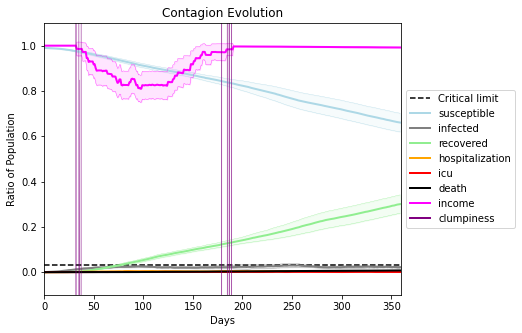

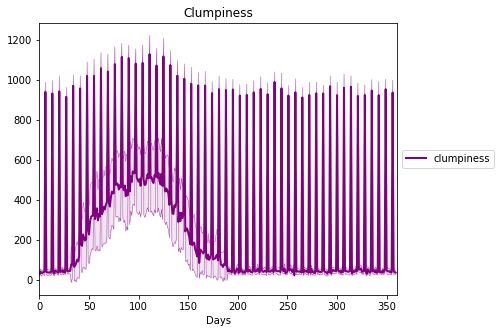

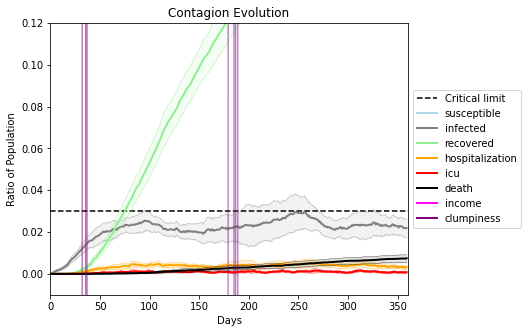

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2063, 6183, 8144, 3067, 8017, 1500, 5309, 1303, 3518, 8118, 9736, 410, 57, 6907, 3478, 9505, 5789, 8233, 2718, 440]
Average similarity between family members is 0.006080201212015914 at temperature 1
Average similarity between family and home is 0.9998600012408523 at temperature -1
Average similarity between students and their classroom is 0.024754074979177056 at temperature 1
Average classroom occupancy is 1.5730337078651686 and number classrooms is 178
Average similarity between workers is 0.010469672723853966 at temperature 1
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.08259629226477586 for kids: 0.07115166035052686
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity -0.0009640720993679751
avg restaurant similarity -0.03163810065308733
avg restaurant similarity 0.04130067220682183
avg restaurant similarity 0.0466781396195943
avg restaurant similarity 0.01157266766169871
avg restaurant similarity -0.030328677299857325
avg restaurant similarity 0.00034142823241391343
avg restaurant similarity -0.022932322551916445
avg restaurant similarity -0.019534077126864696
avg restaurant similarity 0.031624426811674315
avg restaurant similarity -0.014477816925777735
avg restaurant similarity -0.0034791472167123912
avg restaurant similarity -0.02684152383023854
avg restaurant similarity -6.982056147436668e-05
avg restaurant similarity -0.037280706844073294
avg restaurant similarity -0.026365735478354087
avg restaurant similarity 0.0035364626219502324
avg restaurant similarity 0.004091700544222532
avg restaurant similarity 0.02679879543452413
avg restaurant similarity 0.045765020662663136
avg restaurant similarity 0.003834047434536586
avg

avg restaurant similarity -0.02464099618426894
avg restaurant similarity 0.027035191075358025
avg restaurant similarity 0.01682062098602853
avg restaurant similarity 0.026480764279682437
avg restaurant similarity 0.02657749492652868
avg restaurant similarity 0.022331571623112303
avg restaurant similarity -0.0022531137920826817
avg restaurant similarity -0.03529009670996642
avg restaurant similarity 0.0010514607840329138
avg restaurant similarity -0.000647106766450925
avg restaurant similarity 0.02839365672424042
avg restaurant similarity 0.038101675655207945
avg restaurant similarity 0.028314285790544295
avg restaurant similarity 0.03227249083719832
avg restaurant similarity 0.014183394299313312
avg restaurant similarity -0.049825677001042276
avg restaurant similarity -0.006699278827402403
avg restaurant similarity -0.010715288297318909
avg restaurant similarity 0.041548471013668486
avg restaurant similarity -0.03004121555813759
avg restaurant similarity -0.04366098065634939
avg restau

avg restaurant similarity 0.02107608527426256
avg restaurant similarity -0.007902579711472077
avg restaurant similarity 0.00889542142514308
avg restaurant similarity 0.01818714989082885
avg restaurant similarity 0.010763194153050519
avg restaurant similarity 0.053952186254695486
avg restaurant similarity -0.002446475631888895
avg restaurant similarity 0.028918946117651296
avg restaurant similarity 0.008516727332096947
avg restaurant similarity 0.013060531270044605
avg restaurant similarity 0.0773843432193413
Average similarity between family members is -0.01064236847456497 at temperature 1
Average similarity between family and home is 0.9998635342134182 at temperature -1
Average similarity between students and their classroom is 0.05372719303022625 at temperature 1
Average classroom occupancy is 1.5898876404494382 and number classrooms is 178
Average similarity between workers is 0.007715896402585442 at temperature 1
Average office occupancy is 3.375 and number offices is 200
Average f

avg restaurant similarity 0.032842052073557136
avg restaurant similarity -0.0319259828771059
avg restaurant similarity 0.007785458585444041
avg restaurant similarity 0.03042375032770592
avg restaurant similarity 0.015272044291273676
avg restaurant similarity -0.005776797892346504
avg restaurant similarity 0.0017000247162994267
avg restaurant similarity -0.02653208526366076
avg restaurant similarity 0.015657203807694958
avg restaurant similarity -0.012697117165886122
avg restaurant similarity -0.007370655199739813
avg restaurant similarity 0.03877959307474088
avg restaurant similarity 0.02791278394504498
avg restaurant similarity 0.013156279075189578
avg restaurant similarity 0.03153718437408209
avg restaurant similarity 0.009360652369765587
avg restaurant similarity -0.024634078663244116
avg restaurant similarity -0.007934891046974509
avg restaurant similarity 0.017933894852943222
avg restaurant similarity 0.011426363044750353
avg restaurant similarity 0.02043796114435166
avg restauran

avg restaurant similarity 0.018453589797513797
avg restaurant similarity -0.04644285347531213
avg restaurant similarity -0.008599443520858533
avg restaurant similarity -0.03061250131061771
avg restaurant similarity -0.013527564913320345
avg restaurant similarity 0.0036681175205152596
avg restaurant similarity -0.029345175664747855
avg restaurant similarity -0.022110138357396874
avg restaurant similarity -0.03884360709554624
avg restaurant similarity -0.014348193068096522
avg restaurant similarity -0.018284729642219482
avg restaurant similarity 0.02416329752476454
avg restaurant similarity -0.010642317204740034
avg restaurant similarity 0.03470995661642281
avg restaurant similarity -0.018712456087490933
avg restaurant similarity -0.01361798348660845
avg restaurant similarity -0.04858395840304659
avg restaurant similarity -0.015457248554864196
avg restaurant similarity -0.01427980822250638
avg restaurant similarity 0.027652097568489475
avg restaurant similarity -0.03827540763681208
avg r

avg restaurant similarity 0.03415849770165047
avg restaurant similarity -0.05034205541571967
avg restaurant similarity -6.542597998885683e-06
avg restaurant similarity -0.0038965833462329584
avg restaurant similarity 0.008198064369704924
avg restaurant similarity -0.025315331721747658
avg restaurant similarity 0.05617435115134538
avg restaurant similarity 0.01929452286680081
avg restaurant similarity -0.019480897108640587
avg restaurant similarity 0.011610639818854464
avg restaurant similarity 0.02424684429925533
avg restaurant similarity 0.01583563310121295
Average similarity between family members is 0.003287464833053863 at temperature 1
Average similarity between family and home is 0.9998509080612025 at temperature -1
Average similarity between students and their classroom is 0.022795220348631778 at temperature 1
Average classroom occupancy is 1.6758241758241759 and number classrooms is 182
Average similarity between workers is 0.005088738762425332 at temperature 1
Average office oc

avg restaurant similarity -0.05726325138370847
avg restaurant similarity 0.015290300611428335
avg restaurant similarity 0.027495859020704738
avg restaurant similarity 0.0033934500792343275
avg restaurant similarity 0.013507020446717926
avg restaurant similarity 0.05097892928742231
avg restaurant similarity -0.007989738248354531
avg restaurant similarity 0.038807414947483854
avg restaurant similarity -0.04531066761131899
avg restaurant similarity 0.09977497454630745
avg restaurant similarity -0.01464242661927376
avg restaurant similarity 0.04261501725756315
avg restaurant similarity -0.024717482348036102
avg restaurant similarity -0.0066243684648279455
avg restaurant similarity 0.02309137124328374
avg restaurant similarity -0.012778346851772702
avg restaurant similarity 0.03339954415680126
avg restaurant similarity 0.011059654064599184
avg restaurant similarity -0.011942393094921006
avg restaurant similarity -0.02092965244636435
avg restaurant similarity 0.009896256230816415
avg restaur

avg restaurant similarity 0.001859875200919042
avg restaurant similarity 0.0004583901711642805
avg restaurant similarity -0.0038622921037560157
avg restaurant similarity -0.014354333215784613
avg restaurant similarity -0.01371731904067771
avg restaurant similarity -0.03218006719100769
avg restaurant similarity -0.017064157383698333
avg restaurant similarity -0.035394179932219674
avg restaurant similarity 0.015220132375168827
avg restaurant similarity -0.03238280672387506
avg restaurant similarity 0.010731083569551315
avg restaurant similarity 0.00028358607206127443
avg restaurant similarity 0.006471404996514181
avg restaurant similarity -0.004702410952989753
avg restaurant similarity 0.027432572816482932
avg restaurant similarity 0.012722913870841148
avg restaurant similarity -0.014434590835574882
avg restaurant similarity 0.05640080724502772
avg restaurant similarity -0.03984273401554312
avg restaurant similarity 0.03241190290982615
avg restaurant similarity -0.016346263429972144
avg 

avg restaurant similarity -0.00904479237113995
avg restaurant similarity 0.016129419534629538
avg restaurant similarity 0.029675912613082712
avg restaurant similarity 0.005670237840827249
avg restaurant similarity 0.011486915371719319
avg restaurant similarity -0.03659320686402155
avg restaurant similarity 0.00954757006377657
avg restaurant similarity 0.009198262922440425
avg restaurant similarity 0.027155912697921444
avg restaurant similarity -0.021590589179315407
avg restaurant similarity 0.01026234717314426
avg restaurant similarity -0.007863961599401968
Average similarity between family members is 0.04802341929311792 at temperature 1
Average similarity between family and home is 0.9998638791094099 at temperature -1
Average similarity between students and their classroom is 0.019621061969464913 at temperature 1
Average classroom occupancy is 1.5625 and number classrooms is 176
Average similarity between workers is -0.00891776029245857 at temperature 1
Average office occupancy is 3.2

avg restaurant similarity -0.0039406825059235305
avg restaurant similarity 0.0005262069663157525
avg restaurant similarity 0.007443867360576412
avg restaurant similarity 0.033336418675123755
avg restaurant similarity 0.014543640337405055
avg restaurant similarity 0.01247166208255084
avg restaurant similarity -0.02141649277824663
avg restaurant similarity 0.00697246162933228
avg restaurant similarity 0.02738489309357859
avg restaurant similarity -0.0463574293593149
avg restaurant similarity 0.032526899320895725
avg restaurant similarity -0.04686638470519654
avg restaurant similarity 0.022710643044398456
avg restaurant similarity 0.03836845111958388
avg restaurant similarity 0.04499503602356482
avg restaurant similarity 0.02850685826057687
avg restaurant similarity 0.02172925920865189
avg restaurant similarity 0.027092790738143194
avg restaurant similarity -0.009103698228915102
avg restaurant similarity 0.008021859877912763
avg restaurant similarity 0.013035878598839137
avg restaurant si

avg restaurant similarity -0.007673379523900691
avg restaurant similarity -0.020525435878369747
avg restaurant similarity -0.011533173929573232
avg restaurant similarity 0.0156881975942219
avg restaurant similarity -0.010063603268402705
avg restaurant similarity -0.010759116125262726
avg restaurant similarity 0.013690929009319461
avg restaurant similarity -0.010913296363608934
avg restaurant similarity 0.0049325816331886015
avg restaurant similarity 0.012629714183730286
avg restaurant similarity 0.011134989510453813
avg restaurant similarity -0.009019835598995381
avg restaurant similarity 0.0003270323040497433
avg restaurant similarity 0.013295365273385979
avg restaurant similarity 0.016984418669604845
avg restaurant similarity -0.007025073744831626
avg restaurant similarity 0.028382321391888753
avg restaurant similarity 0.00605662631886712
avg restaurant similarity -0.0008591061139467616
avg restaurant similarity -0.024675209706999785
avg restaurant similarity -0.04101769129979531
avg

avg restaurant similarity -0.02490351696070462
avg restaurant similarity -0.03685693936281393
avg restaurant similarity -0.012621027007750266
avg restaurant similarity 0.02301260986727549
avg restaurant similarity -0.02866102811444984
avg restaurant similarity -0.0234271662040452
avg restaurant similarity 0.024480899250292353
avg restaurant similarity 0.01017138779718667
avg restaurant similarity 0.0237301679096717
avg restaurant similarity 0.02627863409310943
avg restaurant similarity -0.017327803849497187
avg restaurant similarity -0.03668395140863457
Average similarity between family members is -0.007882216082915542 at temperature 1
Average similarity between family and home is 0.9998615821729641 at temperature -1
Average similarity between students and their classroom is 0.006919401407409274 at temperature 1
Average classroom occupancy is 1.5824175824175823 and number classrooms is 182
Average similarity between workers is 0.01059233462544272 at temperature 1
Average office occupan

avg restaurant similarity 0.038526260124703886
avg restaurant similarity 0.03609065763957503
avg restaurant similarity -0.0010607354990615787
avg restaurant similarity 0.03452964685282332
avg restaurant similarity 0.03062534792703217
avg restaurant similarity 0.014265296021711322
avg restaurant similarity 0.0021924100208788903
avg restaurant similarity -0.008797954045729275
avg restaurant similarity -0.027032527276099897
avg restaurant similarity 0.00584894792470135
avg restaurant similarity 0.006548691017936653
avg restaurant similarity -0.028675707509037873
avg restaurant similarity -0.027442938621284562
avg restaurant similarity 0.03902090733519725
avg restaurant similarity 0.026142129372025907
avg restaurant similarity -0.013298353251127477
avg restaurant similarity -0.005674219342871586
avg restaurant similarity -0.016799231064742872
avg restaurant similarity 0.00879315187354324
avg restaurant similarity -0.02144779262995577
avg restaurant similarity -0.015070380063277747
avg rest

avg restaurant similarity -0.04401988510471939
avg restaurant similarity -0.008778908935158706
avg restaurant similarity 0.004808030176066624
avg restaurant similarity 0.0051352172925366165
avg restaurant similarity 0.007773072255120702
avg restaurant similarity 0.02371747708180334
avg restaurant similarity -0.022207956021244205
avg restaurant similarity 0.03322128679976003
avg restaurant similarity 0.016648744200953546
avg restaurant similarity -0.023393479115172183
avg restaurant similarity 0.021775295249988003
avg restaurant similarity 0.028539530571042238
avg restaurant similarity -0.03521031236193481
avg restaurant similarity 0.04057641359846272
avg restaurant similarity 0.015126333816334613
avg restaurant similarity 0.0032508751290785936
avg restaurant similarity -0.012761693762417895
avg restaurant similarity -0.012894324129001482
avg restaurant similarity -0.0034994443051698156
avg restaurant similarity -0.02733324379566069
avg restaurant similarity -0.011581560669695911
avg re

avg restaurant similarity 0.03702399765353784
avg restaurant similarity 0.03220159519199145
avg restaurant similarity 0.003666991230675504
avg restaurant similarity 0.014886042706082441
avg restaurant similarity 0.0011585343033628395
avg restaurant similarity -0.04892894683239225
avg restaurant similarity -0.02077804520215188
avg restaurant similarity -0.038277688896934094
avg restaurant similarity -0.0004315889682280347
avg restaurant similarity 0.053377009518958345
avg restaurant similarity -0.005257609316193403
avg restaurant similarity 0.0025554524702317834
Average similarity between family members is -0.009619249667823413 at temperature 1
Average similarity between family and home is 0.9998455548267259 at temperature -1
Average similarity between students and their classroom is 0.024314143186661932 at temperature 1
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.018963337193663485 at temperature 1
Average offic

avg restaurant similarity 0.06179472249292223
avg restaurant similarity 0.02289070434976724
avg restaurant similarity 0.002384169868808508
avg restaurant similarity 0.07137681109494
avg restaurant similarity 0.03232329010394162
avg restaurant similarity 0.013247870568972668
avg restaurant similarity 0.04932283345024456
avg restaurant similarity 0.031568895128442215
avg restaurant similarity 0.04522346132757529
avg restaurant similarity 0.029450091612180287
avg restaurant similarity 0.019554147045038547
avg restaurant similarity -0.0027959124105384862
avg restaurant similarity -0.005788275116681948
avg restaurant similarity 0.037860524169467516
avg restaurant similarity -0.005450346576405802
avg restaurant similarity 0.03532018285532561
avg restaurant similarity -0.017248167005137274
avg restaurant similarity 0.05151326527558356
avg restaurant similarity -0.006465262669140481
avg restaurant similarity 0.01209009693933491
avg restaurant similarity 0.042066032195547054
avg restaurant simi

avg restaurant similarity -0.017875345303714547
avg restaurant similarity -0.016424543932414278
avg restaurant similarity 0.012202376141560866
avg restaurant similarity 0.023365747720019994
avg restaurant similarity 0.03233553603867894
avg restaurant similarity 0.0373300470140422
avg restaurant similarity 0.05585704923625816
avg restaurant similarity -0.005684039919362723
avg restaurant similarity 0.023953237444287023
avg restaurant similarity -0.04163556732046838
avg restaurant similarity 0.048478402778819894
avg restaurant similarity 0.014438288774929349
avg restaurant similarity 0.058424198014485194
avg restaurant similarity -0.013954095146471538
avg restaurant similarity 0.009275174457984911
avg restaurant similarity 0.07297416502832782
avg restaurant similarity 0.0069288388185399395
avg restaurant similarity 0.013855331437239599
avg restaurant similarity -0.010197465840339764
avg restaurant similarity 0.06779031797597201
avg restaurant similarity 0.04647596777855806
avg restaurant

avg restaurant similarity 0.03611374379431211
avg restaurant similarity 0.011260105978032139
avg restaurant similarity 0.015826079330570255
avg restaurant similarity 0.02926081388496744
avg restaurant similarity 0.0028938861893457618
avg restaurant similarity 0.004489001102965659
avg restaurant similarity 0.06122683715360547
avg restaurant similarity 0.03500451002010054
avg restaurant similarity -0.00023917210826400302
Average similarity between family members is 0.02560294156380981 at temperature 1
Average similarity between family and home is 0.9998585825921077 at temperature -1
Average similarity between students and their classroom is 0.013331317116151131 at temperature 1
Average classroom occupancy is 1.6839080459770115 and number classrooms is 174
Average similarity between workers is 0.02002246084979197 at temperature 1
Average office occupancy is 3.186868686868687 and number offices is 198
Average friend similarity for adults: 0.09491263039229836 for kids: 0.1083975089762733
ho

avg restaurant similarity -0.018092331522630657
avg restaurant similarity 0.025908920394916247
avg restaurant similarity 0.012001049261132638
avg restaurant similarity 0.05145277209152358
avg restaurant similarity -0.047161642278889866
avg restaurant similarity 0.012152020672430661
avg restaurant similarity -0.0004970669727320455
avg restaurant similarity 0.06523087403641854
avg restaurant similarity 0.012610681361990795
avg restaurant similarity 0.020283188328173076
avg restaurant similarity 0.0042083176269409875
avg restaurant similarity 0.04582363433157053
avg restaurant similarity 0.026510823491811154
avg restaurant similarity 0.03796479264076449
avg restaurant similarity 0.032411823332488314
avg restaurant similarity 0.023443772279063062
avg restaurant similarity 0.013481513023792458
avg restaurant similarity -0.02823756752094619
avg restaurant similarity 0.015960788013699864
avg restaurant similarity 0.043197545436952284
avg restaurant similarity 0.004330021610924951
avg restaura

avg restaurant similarity 0.05441910661787221
avg restaurant similarity -0.031075124209587284
avg restaurant similarity 0.017769727825452948
avg restaurant similarity 0.04579793542761109
avg restaurant similarity 0.019867538671945437
avg restaurant similarity -0.007470743564047409
avg restaurant similarity -0.010177365898941755
avg restaurant similarity -0.015196915857673148
avg restaurant similarity 0.020680875833465617
avg restaurant similarity 0.016754510639565772
avg restaurant similarity -0.013555637513012432
avg restaurant similarity 0.03400496460940994
avg restaurant similarity 0.014445785510916992
avg restaurant similarity 0.007988688172801081
avg restaurant similarity -0.0011878286185296877
avg restaurant similarity 0.03819064400733103
avg restaurant similarity 0.04966039190154959
avg restaurant similarity 0.010057632564999882
avg restaurant similarity 0.031695917175862426
avg restaurant similarity 0.018345671362089363
avg restaurant similarity 0.01102050001888628
avg restaura

avg restaurant similarity 0.03356015398633235
avg restaurant similarity 0.028309758974977946
avg restaurant similarity 0.015640597054206527
avg restaurant similarity -0.0087028258935721
avg restaurant similarity 0.0011795572530213015
avg restaurant similarity 0.009959439422614794
avg restaurant similarity -0.03660136773728015
avg restaurant similarity -0.010784534934078516
avg restaurant similarity 0.04676505042385331
avg restaurant similarity -0.0071116748539730565
avg restaurant similarity 0.03721606713237598
avg restaurant similarity -0.0024382565511328258
Average similarity between family members is 0.014124188907010421 at temperature 1
Average similarity between family and home is 0.9998610776862065 at temperature -1
Average similarity between students and their classroom is 0.03566854371026013 at temperature 1
Average classroom occupancy is 1.6758241758241759 and number classrooms is 182
Average similarity between workers is 0.018123139937975114 at temperature 1
Average office oc

avg restaurant similarity 0.04213726418013473
avg restaurant similarity 0.02672699819844831
avg restaurant similarity 0.014045966012568962
avg restaurant similarity 0.06288196359254221
avg restaurant similarity 0.035723378737018155
avg restaurant similarity 0.041198778442675915
avg restaurant similarity 0.06233709523188953
avg restaurant similarity 0.0026707675547764445
avg restaurant similarity -0.021695042197570673
avg restaurant similarity 0.027200541525800235
avg restaurant similarity 0.01825534458890632
avg restaurant similarity 0.016968478794190885
avg restaurant similarity 0.015105194881420226
avg restaurant similarity 0.0223767798703117
avg restaurant similarity 0.02917214000177806
avg restaurant similarity 0.01613954985465243
avg restaurant similarity 0.023412556750870825
avg restaurant similarity 0.05294705742124251
avg restaurant similarity 0.03971438149130081
avg restaurant similarity 0.04593749203010901
avg restaurant similarity 0.00899141881506892
avg restaurant similarit

avg restaurant similarity 0.020245804945014975
avg restaurant similarity 0.053648483765722406
avg restaurant similarity 0.021593174272587813
avg restaurant similarity 0.05642136777368286
avg restaurant similarity 0.03383204916577939
avg restaurant similarity -0.005568477170490435
avg restaurant similarity 0.006941521624112796
avg restaurant similarity 0.02860452732539972
avg restaurant similarity 0.02312318674224757
avg restaurant similarity -0.03929107832803155
avg restaurant similarity 0.04804924771910015
avg restaurant similarity 0.000772023160296824
avg restaurant similarity 0.04893874144697062
avg restaurant similarity 0.006314696711020677
avg restaurant similarity 0.022919947412385913
avg restaurant similarity -0.00493355607957716
avg restaurant similarity 0.022465932965105198
avg restaurant similarity 0.020892909565999603
avg restaurant similarity 0.011192681005090653
avg restaurant similarity 0.0282606870289637
avg restaurant similarity 0.005870070855733447
avg restaurant simil

avg restaurant similarity 0.047739963953819166
avg restaurant similarity 0.01061859077870844
avg restaurant similarity 0.06992626277794023
avg restaurant similarity -0.0044917444049624436
avg restaurant similarity -0.017160291948065443
avg restaurant similarity 0.02879802489487631
avg restaurant similarity 0.01465509934906206
avg restaurant similarity -0.006346195469528965
avg restaurant similarity 0.025554292826887773
Average similarity between family members is 0.005530589431905483 at temperature 1
Average similarity between family and home is 0.9998625543366072 at temperature -1
Average similarity between students and their classroom is 0.03380107943254519 at temperature 1
Average classroom occupancy is 1.596774193548387 and number classrooms is 186
Average similarity between workers is -0.00257345225659214 at temperature 1
Average office occupancy is 3.151219512195122 and number offices is 205
Average friend similarity for adults: 0.07619020525211778 for kids: 0.09561977539553593
h

avg restaurant similarity 0.06195162130273802
avg restaurant similarity -0.026756605501681886
avg restaurant similarity -0.02919560144655919
avg restaurant similarity -0.017697533430156277
avg restaurant similarity -0.015608725519111272
avg restaurant similarity 0.001054192714096141
avg restaurant similarity 0.03544561105740228
avg restaurant similarity 0.02161430851604439
avg restaurant similarity 0.009151806366698004
avg restaurant similarity -0.020164560336901848
avg restaurant similarity -0.01221054969811651
avg restaurant similarity -0.031173687544958677
avg restaurant similarity 0.026999575058534012
avg restaurant similarity 0.024021843259017926
avg restaurant similarity 0.04178197434122526
avg restaurant similarity 0.015447326927379056
avg restaurant similarity 0.03228398513514911
avg restaurant similarity 0.027125976043048325
avg restaurant similarity 0.027039119389691422
avg restaurant similarity -0.01211948171631585
avg restaurant similarity 0.02078465812041574
avg restaurant

avg restaurant similarity -0.014813033844033445
avg restaurant similarity 0.006488508604229733
avg restaurant similarity 0.03208961323319799
avg restaurant similarity 0.021195055384590777
avg restaurant similarity -0.012504422469608631
avg restaurant similarity 0.0469655049403382
avg restaurant similarity 0.031899514498353765
avg restaurant similarity -0.039298796068548456
avg restaurant similarity -0.028590146687210407
avg restaurant similarity -0.022047029412855038
avg restaurant similarity -0.00016055227023214642
avg restaurant similarity 0.009003483123716518
avg restaurant similarity -0.02082879703458114
avg restaurant similarity -0.014000770262538473
avg restaurant similarity -0.0030234570233840957
avg restaurant similarity 0.061692090305658455
avg restaurant similarity -0.02247917493604895
avg restaurant similarity 0.013745425568815516
avg restaurant similarity 0.0039936763197024865
avg restaurant similarity -0.008600112073035715
avg restaurant similarity 0.02307218635423018
avg 

avg restaurant similarity 0.04067982056047486
avg restaurant similarity -0.0028405209978845467
avg restaurant similarity 0.014517889718027362
avg restaurant similarity -0.01680771216178818
avg restaurant similarity 0.00830591062064074
avg restaurant similarity -0.0014435821280819583
avg restaurant similarity 0.009565427202737665
avg restaurant similarity 0.02228751644918591
avg restaurant similarity -0.026037840433496242
avg restaurant similarity 0.005045313935008677
avg restaurant similarity -0.005600900072223722
Average similarity between family members is 0.021519403168059004 at temperature 1
Average similarity between family and home is 0.9998565499443364 at temperature -1
Average similarity between students and their classroom is 0.015546593273692537 at temperature 1
Average classroom occupancy is 1.6272189349112427 and number classrooms is 169
Average similarity between workers is 0.009806180173466655 at temperature 1
Average office occupancy is 3.32 and number offices is 200
Ave

avg restaurant similarity 0.023319509456513076
avg restaurant similarity 0.0018196425985710688
avg restaurant similarity -0.00984211473353781
avg restaurant similarity 0.00013301158675909307
avg restaurant similarity 0.01865302906231517
avg restaurant similarity 0.03323540474367163
avg restaurant similarity 0.0034976536710516564
avg restaurant similarity 0.03370626652766342
avg restaurant similarity 0.004327268968621472
avg restaurant similarity 0.020891952099177657
avg restaurant similarity -0.027898377792283595
avg restaurant similarity -0.02468398346588573
avg restaurant similarity 0.024746842702395817
avg restaurant similarity 0.014760099287907062
avg restaurant similarity 0.03877235612068983
avg restaurant similarity -0.00939779670286979
avg restaurant similarity -0.0065052559561753764
avg restaurant similarity -0.007885113515932123
avg restaurant similarity 0.015567708130387875
avg restaurant similarity -0.022275833788976445
avg restaurant similarity 0.03663936985487734
avg resta

avg restaurant similarity -0.019099463388240992
avg restaurant similarity 0.04715972709855649
avg restaurant similarity -0.00762448557315312
avg restaurant similarity 0.01955323099885782
avg restaurant similarity -0.014362134057710047
avg restaurant similarity 0.011832921368933687
avg restaurant similarity -0.014456629088228598
avg restaurant similarity 0.007755512045066161
avg restaurant similarity 0.011539702792275026
avg restaurant similarity -0.00013327815907063727
avg restaurant similarity -0.008567984029805591
avg restaurant similarity 0.06860042598834848
avg restaurant similarity -0.008971796095935236
avg restaurant similarity 0.05647649870314308
avg restaurant similarity 0.015842318967318563
avg restaurant similarity 0.06324071827884024
avg restaurant similarity 0.02144873963069162
avg restaurant similarity 0.012795961514246562
avg restaurant similarity 0.02929284445201933
avg restaurant similarity -0.005478843669887464
avg restaurant similarity 0.006671063860360832
avg restaur

avg restaurant similarity 0.013302666775233113
avg restaurant similarity -0.006953432667978811
avg restaurant similarity -0.0009138472656475577
avg restaurant similarity 0.02865383700025488
avg restaurant similarity 0.026557506231887722
avg restaurant similarity 0.01158626087112741
avg restaurant similarity 0.02711972063897148
avg restaurant similarity -0.02355759695816397
avg restaurant similarity 0.001074367490594451
avg restaurant similarity -0.0003093789477034432
avg restaurant similarity -0.005869737534286155
avg restaurant similarity -0.005609678005372589
Average similarity between family members is 0.016125462953717546 at temperature 1
Average similarity between family and home is 0.9998585168838331 at temperature -1
Average similarity between students and their classroom is 0.01540559407545125 at temperature 1
Average classroom occupancy is 1.6310160427807487 and number classrooms is 187
Average similarity between workers is -0.007714144070678019 at temperature 1
Average office

avg restaurant similarity 0.017119123934446263
avg restaurant similarity -0.01165861069370037
avg restaurant similarity 0.018326687948546413
avg restaurant similarity 0.04903793837922617
avg restaurant similarity 0.02313085788535295
avg restaurant similarity 0.03622439791228969
avg restaurant similarity -0.013829082178106267
avg restaurant similarity -0.010183815265343834
avg restaurant similarity -0.00511379124010401
avg restaurant similarity 0.030040769542233933
avg restaurant similarity -0.03187963384667871
avg restaurant similarity -0.024773204761809345
avg restaurant similarity -0.009768223760962692
avg restaurant similarity 0.02817402587799514
avg restaurant similarity 0.03753280062785377
avg restaurant similarity 0.022305699032547532
avg restaurant similarity 0.020925687612566402
avg restaurant similarity 0.04358517608137161
avg restaurant similarity 0.05839345701095565
avg restaurant similarity 0.00932008615173651
avg restaurant similarity -0.002043566862638004
avg restaurant s

avg restaurant similarity -0.0670905066057276
avg restaurant similarity 0.011296257051832764
avg restaurant similarity -0.004008321946683149
avg restaurant similarity 0.013062830128600655
avg restaurant similarity -0.01982192949768024
avg restaurant similarity 0.01746331376321621
avg restaurant similarity 0.0168090513688006
avg restaurant similarity 0.07301492533717109
avg restaurant similarity 0.012770604457087737
avg restaurant similarity 0.024366789229450948
avg restaurant similarity 0.008629142776765904
avg restaurant similarity 0.012012295586550056
avg restaurant similarity -0.013787914854650756
avg restaurant similarity 0.017774861201945304
avg restaurant similarity -0.03150782967502826
avg restaurant similarity -0.009818637318097631
avg restaurant similarity -0.07463283120666445
avg restaurant similarity -0.010671541320191534
avg restaurant similarity -0.013057692317918082
avg restaurant similarity 0.011485863188935071
avg restaurant similarity 0.06878012843279724
avg restaurant

avg restaurant similarity 0.002332422273563352
avg restaurant similarity -0.0016873639084038548
avg restaurant similarity 0.023397775761976474
avg restaurant similarity 0.009859866927893791
avg restaurant similarity 0.010647061881209011
avg restaurant similarity 0.003679263952674447
avg restaurant similarity 0.006209786369301513
avg restaurant similarity 0.00935146116132909
avg restaurant similarity -0.019716005442980578
avg restaurant similarity 0.019394031849633706
avg restaurant similarity -0.0007216365478531623
avg restaurant similarity 0.015681592887181503
Average similarity between family members is -0.009130932314986948 at temperature 1
Average similarity between family and home is 0.999855482275072 at temperature -1
Average similarity between students and their classroom is 0.017616611560845548 at temperature 1
Average classroom occupancy is 1.6444444444444444 and number classrooms is 180
Average similarity between workers is -0.005757387514342578 at temperature 1
Average offic

avg restaurant similarity 0.020385914705652694
avg restaurant similarity 0.009306773832054076
avg restaurant similarity 0.0068272888663492405
avg restaurant similarity -0.0004094343261222448
avg restaurant similarity -0.024180749269391306
avg restaurant similarity -0.013468449517105668
avg restaurant similarity -0.04141700218203703
avg restaurant similarity 0.014517278466392091
avg restaurant similarity 0.0006211450400556444
avg restaurant similarity 0.004966505769964892
avg restaurant similarity 0.037352104326059725
avg restaurant similarity 0.0012261542337765195
avg restaurant similarity -0.01755277972229608
avg restaurant similarity -0.0047749804344586365
avg restaurant similarity 0.05072224830139019
avg restaurant similarity -0.025336601268429477
avg restaurant similarity 0.03893011594291329
avg restaurant similarity 0.020043432337019492
avg restaurant similarity -0.009770968388549267
avg restaurant similarity 0.027806246457882464
avg restaurant similarity -0.03138492825696691
avg 

avg restaurant similarity 0.024951827299117258
avg restaurant similarity -0.006185262614387192
avg restaurant similarity -0.002561983537464655
avg restaurant similarity 0.001899618449092572
avg restaurant similarity 0.020254994652060397
avg restaurant similarity 0.018141700729261342
avg restaurant similarity 0.035215397074589073
avg restaurant similarity -0.012853471185583706
avg restaurant similarity 0.004785928118625104
avg restaurant similarity 0.007739304135110282
avg restaurant similarity 0.0321438013048818
avg restaurant similarity -0.032395262309385615
avg restaurant similarity 0.015911509290205423
avg restaurant similarity 0.016284477094401735
avg restaurant similarity 0.017733516847141
avg restaurant similarity 0.020324928982541166
avg restaurant similarity 0.01002015163190015
avg restaurant similarity 0.0014797095323466946
avg restaurant similarity 0.014445951663546003
avg restaurant similarity 0.016413532999498565
avg restaurant similarity -0.022226089523527146
avg restauran

avg restaurant similarity -0.024984438896323777
avg restaurant similarity 0.0016342529299675156
avg restaurant similarity 0.022677658130947822
avg restaurant similarity -0.006118097427691128
avg restaurant similarity 0.002138908688176675
avg restaurant similarity 0.0015114081229490187
avg restaurant similarity -0.004537147511521048
avg restaurant similarity 0.010247384291794552
avg restaurant similarity 0.016172014222851333
avg restaurant similarity 0.015258899501907041
avg restaurant similarity 0.014171426812805695
avg restaurant similarity 0.020174461189958273
Average similarity between family members is 0.0043094945622786235 at temperature 1
Average similarity between family and home is 0.9998485812500822 at temperature -1
Average similarity between students and their classroom is -0.006728327891050092 at temperature 1
Average classroom occupancy is 1.5795454545454546 and number classrooms is 176
Average similarity between workers is 0.005017194381835799 at temperature 1
Average off

avg restaurant similarity -0.0020355589514273642
avg restaurant similarity -0.019995095099925475
avg restaurant similarity 0.013940786984273656
avg restaurant similarity -0.006478178219420894
avg restaurant similarity -0.03362279774787967
avg restaurant similarity -0.012097896411106944
avg restaurant similarity -0.028950073285546992
avg restaurant similarity 0.0337291280528538
avg restaurant similarity 0.0594926005925544
avg restaurant similarity -0.04167257268881471
avg restaurant similarity 0.024311710323221585
avg restaurant similarity 0.029673943995116657
avg restaurant similarity 0.008156118251147643
avg restaurant similarity 0.0018743929454225529
avg restaurant similarity -0.01091919527806402
avg restaurant similarity -0.004249769021783454
avg restaurant similarity -0.00013669054617165626
avg restaurant similarity -0.014164999801607353
avg restaurant similarity -0.009244744181327418
avg restaurant similarity -0.034947493201363616
avg restaurant similarity 0.007795228136563716
avg

avg restaurant similarity 0.01544993407168069
avg restaurant similarity -0.0041414063352423845
avg restaurant similarity 0.006838771077565504
avg restaurant similarity 0.022016800525121703
avg restaurant similarity 0.046533362291027565
avg restaurant similarity -0.001752306345666018
avg restaurant similarity -0.034854652371370795
avg restaurant similarity 0.01168995915155118
avg restaurant similarity -0.034990311765725285
avg restaurant similarity -0.02066752971683562
avg restaurant similarity 0.029734094808253602
avg restaurant similarity -0.004219510203201633
avg restaurant similarity -0.03281355371709528
avg restaurant similarity 0.002420420936507252
avg restaurant similarity 0.0261897868674452
avg restaurant similarity 0.017742374689533325
avg restaurant similarity -0.00047321548912812795
avg restaurant similarity 0.020975068265951028
avg restaurant similarity -0.01676602784951012
avg restaurant similarity -0.02217625111126903
avg restaurant similarity -0.020005081361847487
avg res

avg restaurant similarity -0.008857635028282638
avg restaurant similarity -0.043597372994798156
avg restaurant similarity 0.01580120832818562
avg restaurant similarity -0.027884763237780174
avg restaurant similarity 0.010021365918376029
avg restaurant similarity -0.010885747923759804
avg restaurant similarity 0.007164227530857699
avg restaurant similarity -0.014870411694479104
avg restaurant similarity 0.025682696552194968
avg restaurant similarity -0.0089150831733927
avg restaurant similarity -0.005381915515587792
avg restaurant similarity 0.029544577214683104
Average similarity between family members is 0.009049976457800396 at temperature 1
Average similarity between family and home is 0.9998499130434384 at temperature -1
Average similarity between students and their classroom is -0.012853884907075314 at temperature 1
Average classroom occupancy is 1.562874251497006 and number classrooms is 167
Average similarity between workers is 0.011264928252260054 at temperature 1
Average office

avg restaurant similarity 0.026071370248626588
avg restaurant similarity 0.028002791188741376
avg restaurant similarity 0.036529473727740444
avg restaurant similarity -0.0051969151323276765
avg restaurant similarity 0.004641445153542228
avg restaurant similarity -0.01874499925803352
avg restaurant similarity -0.010140344897592996
avg restaurant similarity -0.019624692290591834
avg restaurant similarity -0.025612821866657087
avg restaurant similarity 0.014174014422388855
avg restaurant similarity 0.001401105127182205
avg restaurant similarity 0.04208353693014437
avg restaurant similarity 0.010038504046829638
avg restaurant similarity -0.011702345581135235
avg restaurant similarity -0.026101540844413344
avg restaurant similarity 0.015705555064147985
avg restaurant similarity 0.0136138510321692
avg restaurant similarity -0.01955520492375695
avg restaurant similarity 0.008165655470518344
avg restaurant similarity -0.024579202599179808
avg restaurant similarity -0.0036785331432124518
avg re

avg restaurant similarity -0.007384676209133667
avg restaurant similarity 0.007910079692233306
avg restaurant similarity 0.024636908836288846
avg restaurant similarity -0.005780629678792803
avg restaurant similarity 0.022001836219108922
avg restaurant similarity -0.010725580548059699
avg restaurant similarity 0.002672840585770652
avg restaurant similarity -0.028734739738912708
avg restaurant similarity -0.004146417851718039
avg restaurant similarity 0.026121393681600633
avg restaurant similarity -0.02903895731454818
avg restaurant similarity -0.0021248759224992662
avg restaurant similarity -0.001349359165205063
avg restaurant similarity -0.01631577536005773
avg restaurant similarity 0.025057014215429843
avg restaurant similarity 0.011462454264027885
avg restaurant similarity -0.03531502312053287
avg restaurant similarity -0.018119776778528506
avg restaurant similarity -0.018387012424457387
avg restaurant similarity 0.05272207197455749
avg restaurant similarity -0.010657995238391612
avg

avg restaurant similarity 0.012971017067236492
avg restaurant similarity -0.01067555250251226
avg restaurant similarity 0.023781666594876714
avg restaurant similarity -0.013078263908492888
avg restaurant similarity -0.005941187754155807
avg restaurant similarity 0.010456737106561743
avg restaurant similarity 0.011596434869913396
avg restaurant similarity -0.037703993004321354
avg restaurant similarity 0.025222164031522096
avg restaurant similarity -0.0038166236838121114
avg restaurant similarity 0.02105219873510724
avg restaurant similarity 0.005266286410360502
Average similarity between family members is -0.0011691758407243193 at temperature 1
Average similarity between family and home is 0.9998522605794047 at temperature -1
Average similarity between students and their classroom is 0.017552678407442495 at temperature 1
Average classroom occupancy is 1.6141304347826086 and number classrooms is 184
Average similarity between workers is 0.017447096423292757 at temperature 1
Average offi

avg restaurant similarity 0.015185197887737574
avg restaurant similarity 0.08324713714809762
avg restaurant similarity 0.02671935020547603
avg restaurant similarity 0.04365591843209879
avg restaurant similarity 0.02060639131045371
avg restaurant similarity 0.028158951828464566
avg restaurant similarity 0.06010788965013926
avg restaurant similarity 0.051307651539782104
avg restaurant similarity 0.017308742536624594
avg restaurant similarity 0.025447856097530135
avg restaurant similarity 0.039001792603233186
avg restaurant similarity -0.005417162928375294
avg restaurant similarity 0.016789817856431997
avg restaurant similarity 0.05219963077018626
avg restaurant similarity 0.016357970360598426
avg restaurant similarity 0.03521940010385116
avg restaurant similarity 0.029110683164751443
avg restaurant similarity 0.0433273018799552
avg restaurant similarity -7.656616320290425e-05
avg restaurant similarity 0.07624015284911914
avg restaurant similarity 0.044311896340974766
avg restaurant simil

avg restaurant similarity 0.026473613287811396
avg restaurant similarity 0.004988863541755473
avg restaurant similarity 0.004270068495664044
avg restaurant similarity 0.03583723405234677
avg restaurant similarity -3.936958870830354e-05
avg restaurant similarity 0.08562102354166101
avg restaurant similarity 0.05351694204003267
avg restaurant similarity 0.00801275407652701
avg restaurant similarity 0.011107448766888467
avg restaurant similarity 0.02486152420671525
avg restaurant similarity -0.037976605607518664
avg restaurant similarity 0.012622614330864122
avg restaurant similarity 0.009081582357578477
avg restaurant similarity -0.0283482163330987
avg restaurant similarity 0.02447430483405299
avg restaurant similarity 0.01677826100601425
avg restaurant similarity 0.02680049917743073
avg restaurant similarity 0.0229768554127761
avg restaurant similarity 0.021916853956606433
avg restaurant similarity 0.04178415436275522
avg restaurant similarity 0.02768780909095777
avg restaurant similari

avg restaurant similarity 0.04161505159846745
avg restaurant similarity 0.05164034156040968
avg restaurant similarity 0.01886815837999529
avg restaurant similarity 0.01822401245897018
avg restaurant similarity 0.027242512993616595
avg restaurant similarity 0.005525155402134209
avg restaurant similarity 0.0219589351996944
avg restaurant similarity 0.04142195315256476
avg restaurant similarity -0.005778218296634032
Average similarity between family members is 0.01646359851031486 at temperature 1
Average similarity between family and home is 0.9998639797142139 at temperature -1
Average similarity between students and their classroom is 0.023105736960406676 at temperature 1
Average classroom occupancy is 1.6280487804878048 and number classrooms is 164
Average similarity between workers is 0.02942732717841759 at temperature 1
Average office occupancy is 3.414141414141414 and number offices is 198
Average friend similarity for adults: 0.08092247058083381 for kids: 0.09105245247955693
home_di

avg restaurant similarity 0.023877556887698624
avg restaurant similarity -0.02597478521927954
avg restaurant similarity 0.02348669066566672
avg restaurant similarity 0.02019310200702998
avg restaurant similarity -0.0063198426631978465
avg restaurant similarity -0.0074702920722867485
avg restaurant similarity 0.005975893969142303
avg restaurant similarity -0.01924794764644578
avg restaurant similarity -0.008043456116173544
avg restaurant similarity -0.036066837413266904
avg restaurant similarity -0.008708111264387312
avg restaurant similarity -0.0016211166240746044
avg restaurant similarity -0.005417182421715117
avg restaurant similarity -0.008483219843069073
avg restaurant similarity -0.013859594337298005
avg restaurant similarity -0.023423521560196923
avg restaurant similarity -0.016489673228981122
avg restaurant similarity 0.020286933755567452
avg restaurant similarity 0.02436923698216521
avg restaurant similarity -0.02855674277855488
avg restaurant similarity -0.019318665631261483
a

avg restaurant similarity 0.06539890548055542
avg restaurant similarity -0.0005961223949785433
avg restaurant similarity -0.0039306174818526255
avg restaurant similarity 0.029865351943136272
avg restaurant similarity 0.0034545682054479506
avg restaurant similarity 0.008827802756087362
avg restaurant similarity -0.006638846945461502
avg restaurant similarity 0.040150022710922294
avg restaurant similarity 0.007673834876348943
avg restaurant similarity 0.026268354950827962
avg restaurant similarity -0.00657019233095164
avg restaurant similarity -0.04608655421246058
avg restaurant similarity 0.02125892689080424
avg restaurant similarity 0.0046803243867679645
avg restaurant similarity 0.02109977399551634
avg restaurant similarity 0.007380086552737594
avg restaurant similarity -0.0220254768876277
avg restaurant similarity 0.009077354346544561
avg restaurant similarity 0.02832544310978817
avg restaurant similarity -7.642943055009821e-06
avg restaurant similarity 0.00010436648131535783
avg res

avg restaurant similarity 0.023730231102471838
avg restaurant similarity 0.026585255057724164
avg restaurant similarity -0.001514929248610501
avg restaurant similarity -0.014570434261262016
avg restaurant similarity -0.0017291628819394072
avg restaurant similarity 0.007569634454350986
avg restaurant similarity 0.001058809819875741
avg restaurant similarity -0.033128504113779704
avg restaurant similarity 0.008359947592666372
avg restaurant similarity -0.021118656533263683
avg restaurant similarity 0.004258963241873081
avg restaurant similarity 0.017079524499611885
Average similarity between family members is 0.03416029154443424 at temperature 1
Average similarity between family and home is 0.9998550585127929 at temperature -1
Average similarity between students and their classroom is 0.02497204502098006 at temperature 1
Average classroom occupancy is 1.603448275862069 and number classrooms is 174
Average similarity between workers is 0.019606674559507195 at temperature 1
Average office 

avg restaurant similarity 0.04744310499871066
avg restaurant similarity 0.05344900203788099
avg restaurant similarity 0.025938614488873
avg restaurant similarity 0.005809428931603881
avg restaurant similarity 0.005680474771258105
avg restaurant similarity 0.024001504255755403
avg restaurant similarity 0.03369738398519682
avg restaurant similarity -0.008935458529869156
avg restaurant similarity 0.008794528778298701
avg restaurant similarity -0.023775835973040515
avg restaurant similarity 0.04608929472887015
avg restaurant similarity -0.02173282520001043
avg restaurant similarity -0.006542329992454152
avg restaurant similarity 0.03966857531076156
avg restaurant similarity -0.011903234843043125
avg restaurant similarity 0.018346049566594354
avg restaurant similarity -0.012192060911068328
avg restaurant similarity 0.05691107874222468
avg restaurant similarity 0.015791829865537548
avg restaurant similarity 0.02646323713135938
avg restaurant similarity 0.03341380225956685
avg restaurant simi

avg restaurant similarity 0.04374627142226819
avg restaurant similarity 0.0021256138938273742
avg restaurant similarity -0.03359098783935789
avg restaurant similarity 0.016947982821807185
avg restaurant similarity 0.011178945173788203
avg restaurant similarity 0.0038438298786151715
avg restaurant similarity 0.01883312461243742
avg restaurant similarity -0.010135552885783366
avg restaurant similarity -0.03223446359243189
avg restaurant similarity 0.02288535361359197
avg restaurant similarity 0.021583219950273735
avg restaurant similarity 0.032308801812969065
avg restaurant similarity 0.005968856885435129
avg restaurant similarity -0.01829451867555351
avg restaurant similarity 0.04903487716801986
avg restaurant similarity -0.003478560884322799
avg restaurant similarity 0.028656883342032702
avg restaurant similarity -0.02617183102321013
avg restaurant similarity -0.017374901825540807
avg restaurant similarity 0.019901161755751035
avg restaurant similarity -0.0245244827494531
avg restauran

avg restaurant similarity 0.02593945352749711
avg restaurant similarity -0.0013150068744218263
avg restaurant similarity -0.005542623426195759
avg restaurant similarity 0.030330377889174948
avg restaurant similarity 0.007013136820296565
avg restaurant similarity -0.00480846324899883
avg restaurant similarity 0.0501828438529263
avg restaurant similarity 0.009717367485628228
avg restaurant similarity 0.07321897729855442
avg restaurant similarity 0.03422412121806982
Average similarity between family members is 0.04191742976584513 at temperature 1
Average similarity between family and home is 0.9998628916516258 at temperature -1
Average similarity between students and their classroom is 0.012167079195636048 at temperature 1
Average classroom occupancy is 1.6740331491712708 and number classrooms is 181
Average similarity between workers is 0.0017764129748337138 at temperature 1
Average office occupancy is 3.2060301507537687 and number offices is 199
Average friend similarity for adults: 0.0

avg restaurant similarity 0.026202100854240223
avg restaurant similarity 0.05207876351815433
avg restaurant similarity 0.024533677561582142
avg restaurant similarity -0.0038666168601495295
avg restaurant similarity 0.009478009608262854
avg restaurant similarity 0.03790090960288451
avg restaurant similarity 0.02143593772791111
avg restaurant similarity 0.045275568747314816
avg restaurant similarity 0.05726418705262831
avg restaurant similarity 0.02275229975272508
avg restaurant similarity 0.02989990592430719
avg restaurant similarity 0.06115813991419033
avg restaurant similarity 0.08389783304633049
avg restaurant similarity -0.005107393269372483
avg restaurant similarity 0.02031580617252204
avg restaurant similarity 0.0069283495214493614
avg restaurant similarity 0.02604411070861545
avg restaurant similarity 0.04515526544530807
avg restaurant similarity 0.0791128192920682
avg restaurant similarity 0.0038219640471688194
avg restaurant similarity 0.02446104697164791
avg restaurant similar

avg restaurant similarity 0.024556355321167966
avg restaurant similarity 0.02943269537235129
avg restaurant similarity 0.028992345802820483
avg restaurant similarity 0.011826293019540066
avg restaurant similarity 0.04695485285936064
avg restaurant similarity -0.010504174782090522
avg restaurant similarity 0.03050893892075795
avg restaurant similarity -0.015024533688264003
avg restaurant similarity 0.04948612034907876
avg restaurant similarity 0.07580131704307656
avg restaurant similarity 0.0005864711677111697
avg restaurant similarity 0.02721488222126823
avg restaurant similarity 0.04617567258762396
avg restaurant similarity 0.020121590613326207
avg restaurant similarity 0.01825651148439188
avg restaurant similarity 0.026735375389960247
avg restaurant similarity 0.06214529888218211
avg restaurant similarity -0.012707592199440279
avg restaurant similarity 0.012164495390919287
avg restaurant similarity 0.02126937079442633
avg restaurant similarity 0.02728714565763611
avg restaurant simil

avg restaurant similarity 0.0047464745183168995
avg restaurant similarity 0.008729489940958861
avg restaurant similarity 0.03120296898172266
avg restaurant similarity 0.043871771766628584
avg restaurant similarity 0.05605755203794106
avg restaurant similarity 0.054579189810326785
avg restaurant similarity 0.020923474712788524
avg restaurant similarity 0.015809588623470167
Average similarity between family members is 0.026595904162484325 at temperature 1
Average similarity between family and home is 0.999856109765663 at temperature -1
Average similarity between students and their classroom is 0.02677035958676452 at temperature 1
Average classroom occupancy is 1.5842105263157895 and number classrooms is 190
Average similarity between workers is 0.0009929011517412082 at temperature 1
Average office occupancy is 3.238578680203046 and number offices is 197
Average friend similarity for adults: 0.08756369970642808 for kids: 0.08800095912174191
home_districts
[
Home (0,0) district with 1 Buil

avg restaurant similarity -0.034745591270659355
avg restaurant similarity 0.023757488570147808
avg restaurant similarity -0.039834628259023806
avg restaurant similarity -0.0025915191608779785
avg restaurant similarity 0.006012075521686157
avg restaurant similarity 0.016648331857473424
avg restaurant similarity -0.0021187785759715755
avg restaurant similarity 0.016430819679868952
avg restaurant similarity 0.002014594477118035
avg restaurant similarity -0.05370563717791027
avg restaurant similarity 0.027393476575127192
avg restaurant similarity 0.04138411722988734
avg restaurant similarity -0.006976247348398673
avg restaurant similarity 0.03726577358430923
avg restaurant similarity 0.01257866797379129
avg restaurant similarity 0.00010220478074081931
avg restaurant similarity 0.0072401377940212
avg restaurant similarity 0.006775768464498455
avg restaurant similarity -0.025795323155004324
avg restaurant similarity -0.024694712958741854
avg restaurant similarity 0.016396836336826984
avg res

avg restaurant similarity 0.024415175925207904
avg restaurant similarity 0.015811571809035002
avg restaurant similarity -0.008420210889057946
avg restaurant similarity 0.013735582254653699
avg restaurant similarity 0.020550428066028185
avg restaurant similarity -0.0039054363078225465
avg restaurant similarity -0.014464086642730785
avg restaurant similarity 0.011484099167318145
avg restaurant similarity 0.0346741088875903
avg restaurant similarity 0.017410651020338553
avg restaurant similarity -0.003047072539946183
avg restaurant similarity 0.012500751468915954
avg restaurant similarity 0.02568244295425827
avg restaurant similarity -0.015703526294744447
avg restaurant similarity 0.015741723745249726
avg restaurant similarity 0.04418318732329059
avg restaurant similarity 0.0056063909234698875
avg restaurant similarity 0.028464241937807565
avg restaurant similarity 0.016612418412526284
avg restaurant similarity 0.018269587327978776
avg restaurant similarity -0.02986907897975621
avg restau

avg restaurant similarity 0.004552170168086275
avg restaurant similarity -0.0077794205321189865
avg restaurant similarity 0.02062032676076789
avg restaurant similarity -0.02040193579036422
avg restaurant similarity 0.034420911850929395
avg restaurant similarity 0.021608273326981387
avg restaurant similarity 0.029325101769896236
avg restaurant similarity 0.022473060753257126
avg restaurant similarity -0.008963252353748319
avg restaurant similarity 0.0017474283135557034
avg restaurant similarity -0.023340835821706606
avg restaurant similarity -0.01626004387015647
Average similarity between family members is -0.0038568708358285315 at temperature 1
Average similarity between family and home is 0.9998530479629459 at temperature -1
Average similarity between students and their classroom is 0.011179980597779644 at temperature 1
Average classroom occupancy is 1.582010582010582 and number classrooms is 189
Average similarity between workers is -0.002922975144366965 at temperature 1
Average offi

avg restaurant similarity 0.010251834050909384
avg restaurant similarity 0.024617442797645172
avg restaurant similarity 0.03785355095398517
avg restaurant similarity 0.03758356122435003
avg restaurant similarity 0.042559136404052844
avg restaurant similarity 0.03262316147035772
avg restaurant similarity 0.006570825990115678
avg restaurant similarity 0.06995916994748912
avg restaurant similarity 0.057180170773391305
avg restaurant similarity 0.011079236552874813
avg restaurant similarity 0.025224098238597715
avg restaurant similarity 0.021968415349841532
avg restaurant similarity 0.0059502121567862045
avg restaurant similarity 0.05508045527253608
avg restaurant similarity 0.03233934159050522
avg restaurant similarity 0.018598687408758658
avg restaurant similarity 0.03768300410470541
avg restaurant similarity 0.008050001958831932
avg restaurant similarity 0.01253035274968324
avg restaurant similarity 0.020890417496832903
avg restaurant similarity 0.04439400754614712
avg restaurant simila

avg restaurant similarity 0.0667261996532859
avg restaurant similarity 0.03660739700235162
avg restaurant similarity 0.052918817047818666
avg restaurant similarity 0.03891594660982147
avg restaurant similarity 0.04767622057109147
avg restaurant similarity 0.00018404352207048737
avg restaurant similarity 0.04302855130603033
avg restaurant similarity 0.02417639232999548
avg restaurant similarity 0.01552674869209979
avg restaurant similarity 0.01575921543955987
avg restaurant similarity 0.05663899184732068
avg restaurant similarity 0.04802477900944317
avg restaurant similarity 0.03726019172730177
avg restaurant similarity 0.04187432784773784
avg restaurant similarity 0.04207672479820414
avg restaurant similarity 0.006946969453964967
avg restaurant similarity 0.023239198080375497
avg restaurant similarity -0.004312091061659522
avg restaurant similarity 0.05395159624624097
avg restaurant similarity -0.0201025226791584
avg restaurant similarity 0.07084599261857595
avg restaurant similarity 0

avg restaurant similarity 0.029316298896840783
avg restaurant similarity 0.03548427982358736
avg restaurant similarity 0.011545028495516819
avg restaurant similarity 0.03942810342344741
avg restaurant similarity 0.029282717505259948
avg restaurant similarity -0.020577092525312497
avg restaurant similarity 0.0665062724607381
avg restaurant similarity 0.0466421783250826
using average of time series:
stats on susceptible:
data: [0.8397380397380396, 0.8042833333333335, 0.8216972222222223, 0.8549055555555555, 0.8003916666666667, 0.8660834715312327, 0.8776999999999999, 0.8866272616272617, 0.8729805555555556, 0.7722722222222222, 0.751311111111111, 0.8324683965402528, 0.8728888888888889, 0.811036111111111, 0.8218249999999999, 0.8376055555555556, 0.7859222222222223, 0.7593027777777779, 0.8578754578754579, 0.8490666888224214]
min:
0.751311111111111
max:
0.8866272616272617
std:
0.0392812354077364
mean:
0.8287990769178444
median:
0.8350369760479042
95% confidence interval for the mean:
(0.80993730

(<function dict.items>, <function dict.items>, <function dict.items>)

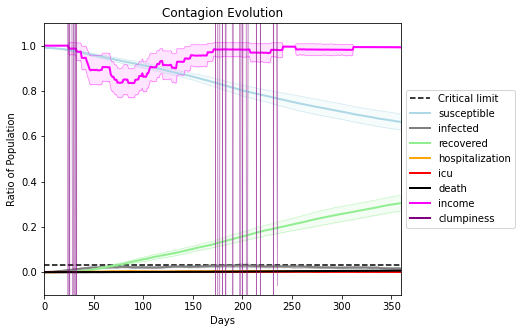

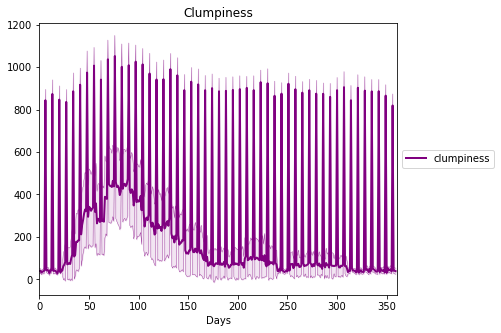

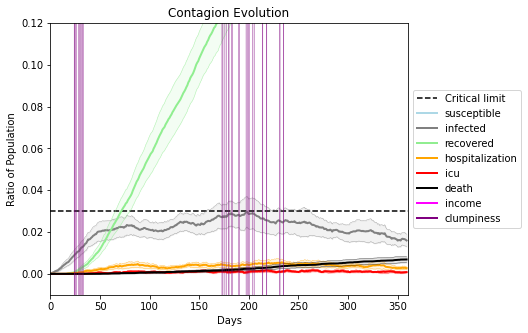

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)